In [1]:
import numpy as np
import pandas as pd
import os, cv2
from matplotlib import pyplot as plt
from glob import glob
from tqdm import tqdm
from PIL import Image as Img
from keras.optimizers import RMSprop, Adam
import keras.backend as K
from tensorflow.keras import Input, Model
from tensorflow.keras.layers import Dense, Reshape, LeakyReLU, Conv2D, Conv2DTranspose, BatchNormalization
from tensorflow.keras.optimizers import RMSprop
from tensorflow.keras.optimizers.schedules import ExponentialDecay

/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.23.5
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


In [2]:
image_list = glob('/kaggle/input/celeba-dataset/img_align_celeba/img_align_celeba/*')
len(image_list)

202599

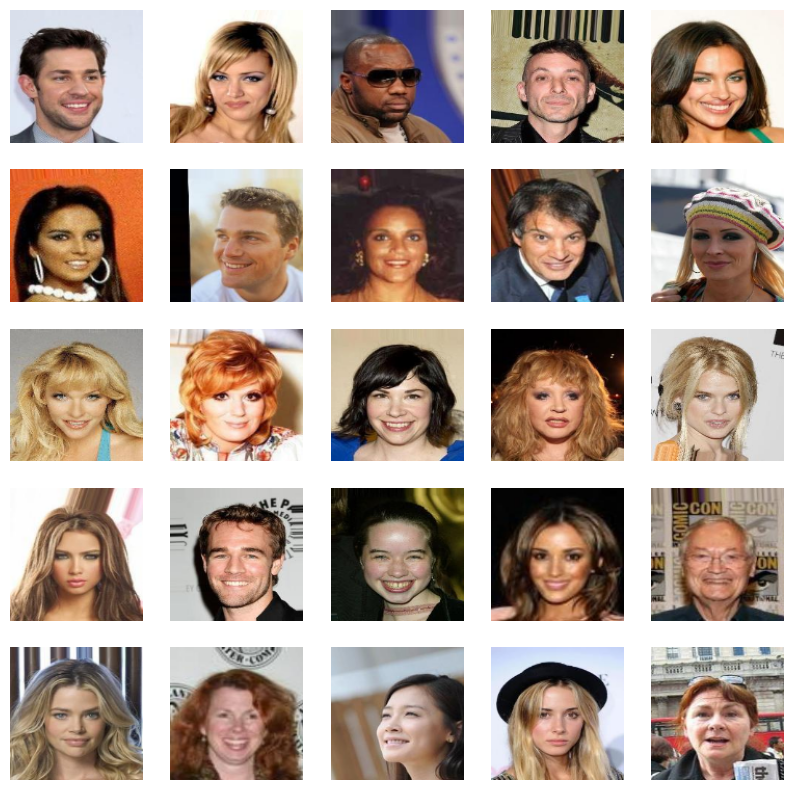

In [3]:
plt.figure(1, figsize=(10, 10))
for i in range(25):
    plt.subplot(5, 5, i+1)
    img = cv2.imread(image_list[i])[:,:,::-1]
    img = cv2.resize(img, (128, 128))
#     img = (img - 127.5)/127.5
    plt.imshow(img)
    plt.axis('off')
plt.show()

In [4]:
img.shape

(128, 128, 3)

In [5]:
images = []
for i in tqdm(image_list[:10000]):
    img = cv2.imread(i)[:,:,::-1]
    img = cv2.resize(img, (128, 128))
    img = (img - 127.5)/127.5
    images.append(img)

100%|██████████| 10000/10000 [01:38<00:00, 101.14it/s]


In [6]:
# images.pop()
images = np.asarray(images)
images.shape

(10000, 128, 128, 3)

In [7]:
LATENT_DIM = 100
CHANNELS = 3
WIDTH = 128
HEIGHT = 128

def create_generator():
    gen_input = Input(shape=(LATENT_DIM, ))

    x = Dense(128 * 16 * 16)(gen_input)
    x = BatchNormalization()(x)
    x = LeakyReLU(alpha=0.2)(x)  # Ajusta el alpha
    x = Reshape((16, 16, 128))(x)

    x = Conv2DTranspose(256, 5, strides=2, padding='same')(x)
    x = BatchNormalization()(x)
    x = LeakyReLU(alpha=0.2)(x)

    x = Conv2DTranspose(256, 5, strides=2, padding='same')(x)
    x = BatchNormalization()(x)
    x = LeakyReLU(alpha=0.2)(x)

    x = Conv2DTranspose(CHANNELS, 5, strides=2, padding='same', activation='tanh')(x)
    
    generator = Model(gen_input, x, name='Generator')
    return generator


In [8]:
def create_discriminator():
    disc_input = Input(shape=(HEIGHT, WIDTH, CHANNELS))

    x = Conv2D(256, 5, strides=2, padding='same')(disc_input)
    x = LeakyReLU()(x)
    x = Dropout(0.3)(x)  # Agrega Dropout

    x = Conv2D(256, 5, strides=2, padding='same')(x)
    x = LeakyReLU()(x)
    x = Dropout(0.3)(x)  # Agrega Dropout
    
    x = Flatten()(x)
    x = Dense(1, activation='sigmoid')(x)

    discriminator = Model(disc_input, x, name='Discriminator')
    
    optimizer = Adam(learning_rate=0.0002, beta_1=0.5)  # Cambia a Adam como optimizador
    
    discriminator.compile(optimizer=optimizer, loss='binary_crossentropy')
    return discriminator


In [9]:
from keras.layers import Activation, MaxPooling2D, Concatenate, GlobalAveragePooling2D, Conv2DTranspose
from keras.layers import Dense, Reshape, LeakyReLU, Conv2D, UpSampling2D, Flatten, Dropout, BatchNormalization

In [10]:
# Creando los modelos
generator = create_generator()
discriminator = create_discriminator()

In [11]:
generator.summary()
discriminator.summary()


Model: "Generator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 100)]             0         
                                                                 
 dense (Dense)               (None, 32768)             3309568   
                                                                 
 batch_normalization (BatchN  (None, 32768)            131072    
 ormalization)                                                   
                                                                 
 leaky_re_lu (LeakyReLU)     (None, 32768)             0         
                                                                 
 reshape (Reshape)           (None, 16, 16, 128)       0         
                                                                 
 conv2d_transpose (Conv2DTra  (None, 32, 32, 256)      819456    
 nspose)                                                 

In [12]:
discriminator.trainable = False
gan_input = Input(shape=(LATENT_DIM, ))
generated_image = generator(gan_input)
gan_output = discriminator(generated_image)
gan = Model(gan_input, gan_output, name='GAN')
gan.compile(optimizer=RMSprop(learning_rate=ExponentialDecay(1e-4, decay_steps=10000, decay_rate=0.9)), 
            loss='binary_crossentropy')

In [13]:
import os
import numpy as np
import time

iters = 15000
batch_size = 32

RES_DIR = '/kaggle/working/res2'
FILE_PATH = '%s/generated_%d.png'

# Changed to os.makedirs to create parent directories if needed
os.makedirs(RES_DIR, exist_ok=True)

# Added check to create a file if it doesn't exist
# Assuming `images_saved` is the identifier/index for the file name
images_saved = 0  # Should be defined before its use
generated_file_path = FILE_PATH % (RES_DIR, images_saved)
if not os.path.exists(generated_file_path):
    with open(generated_file_path, 'w') as f:  # 'w' will create the file if it doesn't exist
        pass  # Empty block, the file is created/overwritten with no content.

CONTROL_SIZE_SQRT = 6
control_vectors = np.random.normal(size=(CONTROL_SIZE_SQRT**2, LATENT_DIM)) / 2
WIDTH, HEIGHT = 128, 128
start = 0
d_losses = []
a_losses = []
# images_saved = 0  # Moved this above, before its first usage


In [14]:
!pip install tqdm

Training Progress:   0%|          | 0/15000 [00:00<?, ?step/s]

1/1 [==============================] - 6s 6s/step


2023-10-09 16:06:23.088239: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:954] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape inDiscriminator/dropout/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer
2023-10-09 16:06:25.613306: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:954] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape inGAN/Discriminator/dropout/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer
Training Progress:   0%|          | 1/15000 [00:16<69:27:14, 16.67s/step]

1/1 [==============================] - 0s 17ms/step


Training Progress:   0%|          | 2/15000 [00:16<29:22:37,  7.05s/step]

1/1 [==============================] - 0s 16ms/step


Training Progress:   0%|          | 3/15000 [00:17<16:32:45,  3.97s/step]

1/1 [==============================] - 0s 16ms/step


Training Progress:   0%|          | 4/15000 [00:17<10:31:14,  2.53s/step]

1/1 [==============================] - 0s 17ms/step


Training Progress:   0%|          | 5/15000 [00:17<7:11:23,  1.73s/step] 

1/1 [==============================] - 0s 16ms/step


Training Progress:   0%|          | 6/15000 [00:18<5:10:53,  1.24s/step]

1/1 [==============================] - 0s 16ms/step


Training Progress:   0%|          | 7/15000 [00:18<3:54:11,  1.07step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   0%|          | 8/15000 [00:18<3:04:11,  1.36step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   0%|          | 9/15000 [00:19<2:30:31,  1.66step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   0%|          | 10/15000 [00:19<2:08:00,  1.95step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   0%|          | 11/15000 [00:19<1:52:12,  2.23step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:   0%|          | 12/15000 [00:20<1:42:18,  2.44step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   0%|          | 13/15000 [00:20<1:34:33,  2.64step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   0%|          | 14/15000 [00:20<1:29:19,  2.80step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   0%|          | 15/15000 [00:21<1:26:12,  2.90step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   0%|          | 16/15000 [00:21<1:23:48,  2.98step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   0%|          | 17/15000 [00:21<1:21:35,  3.06step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   0%|          | 18/15000 [00:21<1:20:26,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   0%|          | 19/15000 [00:22<1:19:12,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   0%|          | 20/15000 [00:22<1:18:23,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   0%|          | 21/15000 [00:22<1:18:49,  3.17step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   0%|          | 22/15000 [00:23<1:18:26,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   0%|          | 23/15000 [00:23<1:18:02,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   0%|          | 24/15000 [00:23<1:17:38,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   0%|          | 25/15000 [00:24<1:17:21,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   0%|          | 26/15000 [00:24<1:17:02,  3.24step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:   0%|          | 27/15000 [00:24<1:16:56,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   0%|          | 28/15000 [00:25<1:16:45,  3.25step/s]

1/1 [==============================] - 0s 34ms/step


Training Progress:   0%|          | 29/15000 [00:25<1:18:02,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   0%|          | 30/15000 [00:25<1:17:57,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   0%|          | 31/15000 [00:25<1:17:29,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   0%|          | 32/15000 [00:26<1:17:04,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   0%|          | 33/15000 [00:26<1:16:45,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   0%|          | 34/15000 [00:26<1:19:10,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   0%|          | 35/15000 [00:27<1:21:01,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   0%|          | 36/15000 [00:27<1:19:40,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   0%|          | 37/15000 [00:27<1:18:38,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   0%|          | 38/15000 [00:28<1:20:34,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   0%|          | 39/15000 [00:28<1:19:29,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   0%|          | 40/15000 [00:28<1:18:29,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   0%|          | 41/15000 [00:29<1:17:47,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   0%|          | 42/15000 [00:29<1:17:15,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   0%|          | 43/15000 [00:29<1:17:22,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   0%|          | 44/15000 [00:30<1:17:15,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   0%|          | 45/15000 [00:30<1:17:10,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   0%|          | 46/15000 [00:30<1:17:12,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   0%|          | 47/15000 [00:30<1:17:10,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   0%|          | 48/15000 [00:31<1:17:23,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   0%|          | 49/15000 [00:31<1:17:22,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   0%|          | 50/15000 [00:31<1:17:17,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   0%|          | 51/15000 [00:32<1:19:50,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   0%|          | 52/15000 [00:32<1:22:17,  3.03step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   0%|          | 53/15000 [00:32<1:23:22,  2.99step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   0%|          | 54/15000 [00:33<1:21:20,  3.06step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   0%|          | 55/15000 [00:33<1:22:39,  3.01step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   0%|          | 56/15000 [00:33<1:20:50,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   0%|          | 57/15000 [00:34<1:19:37,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   0%|          | 58/15000 [00:34<1:19:04,  3.15step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   0%|          | 59/15000 [00:34<1:18:34,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   0%|          | 60/15000 [00:35<1:20:41,  3.09step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   0%|          | 61/15000 [00:35<1:19:51,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   0%|          | 62/15000 [00:35<1:19:01,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   0%|          | 63/15000 [00:36<1:18:22,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   0%|          | 64/15000 [00:36<1:17:52,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   0%|          | 65/15000 [00:36<1:17:31,  3.21step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:   0%|          | 66/15000 [00:37<1:17:17,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   0%|          | 67/15000 [00:37<1:17:28,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   0%|          | 68/15000 [00:37<1:17:16,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   0%|          | 69/15000 [00:37<1:17:07,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   0%|          | 70/15000 [00:38<1:16:52,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   0%|          | 71/15000 [00:38<1:16:52,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   0%|          | 72/15000 [00:38<1:16:46,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   0%|          | 73/15000 [00:39<1:16:34,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   0%|          | 74/15000 [00:39<1:16:37,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   0%|          | 75/15000 [00:39<1:16:34,  3.25step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:   1%|          | 76/15000 [00:40<1:17:41,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|          | 77/15000 [00:40<1:17:23,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|          | 78/15000 [00:40<1:17:12,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|          | 79/15000 [00:41<1:17:03,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|          | 80/15000 [00:41<1:16:50,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|          | 81/15000 [00:41<1:16:41,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   1%|          | 82/15000 [00:42<1:16:43,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|          | 83/15000 [00:42<1:16:29,  3.25step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:   1%|          | 84/15000 [00:42<1:16:18,  3.26step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   1%|          | 85/15000 [00:42<1:19:33,  3.12step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   1%|          | 86/15000 [00:43<1:18:47,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|          | 87/15000 [00:43<1:18:05,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|          | 88/15000 [00:43<1:17:32,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|          | 89/15000 [00:44<1:17:14,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|          | 90/15000 [00:44<1:16:57,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|          | 91/15000 [00:44<1:16:50,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|          | 92/15000 [00:45<1:16:49,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   1%|          | 93/15000 [00:45<1:16:43,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|          | 94/15000 [00:45<1:16:50,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   1%|          | 95/15000 [00:46<1:17:34,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|          | 96/15000 [00:46<1:17:44,  3.19step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:   1%|          | 97/15000 [00:46<1:24:54,  2.93step/s]

1/1 [==============================] - 0s 28ms/step


Training Progress:   1%|          | 98/15000 [00:47<1:30:57,  2.73step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:   1%|          | 99/15000 [00:47<1:34:56,  2.62step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|          | 100/15000 [00:47<1:29:35,  2.77step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|          | 101/15000 [00:48<1:28:23,  2.81step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|          | 102/15000 [00:48<1:25:27,  2.91step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|          | 103/15000 [00:48<1:22:42,  3.00step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|          | 104/15000 [00:49<1:21:17,  3.05step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|          | 105/15000 [00:49<1:19:51,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   1%|          | 106/15000 [00:49<1:19:07,  3.14step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   1%|          | 107/15000 [00:50<1:18:32,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|          | 108/15000 [00:50<1:18:00,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   1%|          | 109/15000 [00:50<1:17:50,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   1%|          | 110/15000 [00:51<1:18:15,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   1%|          | 111/15000 [00:51<1:17:57,  3.18step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   1%|          | 112/15000 [00:51<1:20:46,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   1%|          | 113/15000 [00:52<1:20:04,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   1%|          | 114/15000 [00:52<1:19:06,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|          | 115/15000 [00:52<1:18:52,  3.15step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:   1%|          | 116/15000 [00:53<1:20:23,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|          | 117/15000 [00:53<1:19:12,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|          | 118/15000 [00:53<1:18:24,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|          | 119/15000 [00:53<1:17:50,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   1%|          | 120/15000 [00:54<1:17:34,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|          | 121/15000 [00:54<1:17:16,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   1%|          | 122/15000 [00:54<1:17:43,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   1%|          | 123/15000 [00:55<1:17:44,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   1%|          | 124/15000 [00:55<1:17:38,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   1%|          | 125/15000 [00:55<1:17:32,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|          | 126/15000 [00:56<1:17:12,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|          | 127/15000 [00:56<1:16:55,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|          | 128/15000 [00:56<1:16:43,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   1%|          | 129/15000 [00:57<1:16:39,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|          | 130/15000 [00:57<1:16:39,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|          | 131/15000 [00:57<1:16:40,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|          | 132/15000 [00:57<1:17:01,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|          | 133/15000 [00:58<1:16:53,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|          | 134/15000 [00:58<1:16:42,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|          | 135/15000 [00:58<1:16:37,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|          | 136/15000 [00:59<1:16:25,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   1%|          | 137/15000 [00:59<1:16:26,  3.24step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:   1%|          | 138/15000 [00:59<1:16:39,  3.23step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:   1%|          | 139/15000 [01:00<1:17:04,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   1%|          | 140/15000 [01:00<1:16:54,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   1%|          | 141/15000 [01:00<1:17:07,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   1%|          | 142/15000 [01:01<1:17:01,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|          | 143/15000 [01:01<1:16:42,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|          | 144/15000 [01:01<1:16:26,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|          | 145/15000 [01:02<1:16:21,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|          | 146/15000 [01:02<1:16:25,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|          | 147/15000 [01:02<1:16:18,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|          | 148/15000 [01:02<1:16:16,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|          | 149/15000 [01:03<1:16:05,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   1%|          | 150/15000 [01:03<1:16:31,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   1%|          | 151/15000 [01:03<1:16:32,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|          | 152/15000 [01:04<1:16:23,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|          | 153/15000 [01:04<1:16:08,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|          | 154/15000 [01:04<1:16:08,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|          | 155/15000 [01:05<1:16:02,  3.25step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:   1%|          | 156/15000 [01:05<1:16:01,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   1%|          | 157/15000 [01:05<1:16:14,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|          | 158/15000 [01:06<1:16:19,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|          | 159/15000 [01:06<1:16:37,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|          | 160/15000 [01:06<1:16:32,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   1%|          | 161/15000 [01:06<1:16:17,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|          | 162/15000 [01:07<1:16:12,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|          | 163/15000 [01:07<1:15:59,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   1%|          | 164/15000 [01:07<1:16:02,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|          | 165/15000 [01:08<1:15:47,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|          | 166/15000 [01:08<1:15:43,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|          | 167/15000 [01:08<1:15:37,  3.27step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   1%|          | 168/15000 [01:09<1:15:47,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|          | 169/15000 [01:09<1:16:03,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|          | 170/15000 [01:09<1:16:05,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   1%|          | 171/15000 [01:10<1:15:54,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|          | 172/15000 [01:10<1:15:49,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|          | 173/15000 [01:10<1:15:41,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|          | 174/15000 [01:10<1:15:42,  3.26step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   1%|          | 175/15000 [01:11<1:15:44,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|          | 176/15000 [01:11<1:15:50,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|          | 177/15000 [01:11<1:15:58,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|          | 178/15000 [01:12<1:16:25,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   1%|          | 179/15000 [01:12<1:16:18,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|          | 180/15000 [01:12<1:16:18,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|          | 181/15000 [01:13<1:17:08,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|          | 182/15000 [01:13<1:19:28,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|          | 183/15000 [01:13<1:18:18,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   1%|          | 184/15000 [01:14<1:17:39,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   1%|          | 185/15000 [01:14<1:17:12,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|          | 186/15000 [01:14<1:16:51,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   1%|          | 187/15000 [01:15<1:17:05,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|▏         | 188/15000 [01:15<1:16:52,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|▏         | 189/15000 [01:15<1:16:33,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|▏         | 190/15000 [01:15<1:16:34,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|▏         | 191/15000 [01:16<1:16:16,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|▏         | 192/15000 [01:16<1:16:09,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|▏         | 193/15000 [01:16<1:15:59,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   1%|▏         | 194/15000 [01:17<1:16:08,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|▏         | 195/15000 [01:17<1:16:10,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   1%|▏         | 196/15000 [01:17<1:17:11,  3.20step/s]

1/1 [==============================] - 0s 30ms/step


Training Progress:   1%|▏         | 197/15000 [01:18<1:24:51,  2.91step/s]

1/1 [==============================] - 0s 37ms/step


Training Progress:   1%|▏         | 198/15000 [01:18<1:31:24,  2.70step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:   1%|▏         | 199/15000 [01:19<1:34:25,  2.61step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|▏         | 200/15000 [01:19<1:29:08,  2.77step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|▏         | 201/15000 [01:19<1:25:14,  2.89step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|▏         | 202/15000 [01:19<1:22:30,  2.99step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|▏         | 203/15000 [01:20<1:20:26,  3.07step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|▏         | 204/15000 [01:20<1:18:49,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|▏         | 205/15000 [01:20<1:20:31,  3.06step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   1%|▏         | 206/15000 [01:21<1:19:57,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|▏         | 207/15000 [01:21<1:18:40,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   1%|▏         | 208/15000 [01:21<1:17:58,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   1%|▏         | 209/15000 [01:22<1:17:38,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   1%|▏         | 210/15000 [01:22<1:17:09,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|▏         | 211/15000 [01:22<1:19:18,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|▏         | 212/15000 [01:23<1:18:23,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   1%|▏         | 213/15000 [01:23<1:17:38,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   1%|▏         | 214/15000 [01:23<1:17:04,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   1%|▏         | 215/15000 [01:24<1:17:08,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   1%|▏         | 216/15000 [01:24<1:16:49,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|▏         | 217/15000 [01:24<1:16:35,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|▏         | 218/15000 [01:24<1:16:19,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|▏         | 219/15000 [01:25<1:16:11,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|▏         | 220/15000 [01:25<1:16:08,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|▏         | 221/15000 [01:25<1:16:02,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|▏         | 222/15000 [01:26<1:15:47,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   1%|▏         | 223/15000 [01:26<1:15:46,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   1%|▏         | 224/15000 [01:26<1:16:17,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   2%|▏         | 225/15000 [01:27<1:16:17,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 226/15000 [01:27<1:16:10,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 227/15000 [01:27<1:15:52,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 228/15000 [01:28<1:15:55,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 229/15000 [01:28<1:15:47,  3.25step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:   2%|▏         | 230/15000 [01:28<1:15:37,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 231/15000 [01:29<1:15:24,  3.26step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:   2%|▏         | 232/15000 [01:29<1:15:20,  3.27step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   2%|▏         | 233/15000 [01:29<1:15:40,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   2%|▏         | 234/15000 [01:29<1:16:01,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   2%|▏         | 235/15000 [01:30<1:15:45,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 236/15000 [01:30<1:15:28,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 237/15000 [01:30<1:15:21,  3.27step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 238/15000 [01:31<1:18:11,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 239/15000 [01:31<1:17:12,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 240/15000 [01:31<1:16:45,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 241/15000 [01:32<1:16:49,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 242/15000 [01:32<1:19:05,  3.11step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:   2%|▏         | 243/15000 [01:32<1:22:54,  2.97step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 244/15000 [01:33<1:20:44,  3.05step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 245/15000 [01:33<1:21:33,  3.02step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   2%|▏         | 246/15000 [01:33<1:19:51,  3.08step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   2%|▏         | 247/15000 [01:34<1:18:37,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 248/15000 [01:34<1:17:45,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 249/15000 [01:34<1:17:07,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 250/15000 [01:35<1:16:43,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 251/15000 [01:35<1:16:22,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   2%|▏         | 252/15000 [01:35<1:16:44,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   2%|▏         | 253/15000 [01:35<1:16:57,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   2%|▏         | 254/15000 [01:36<1:16:44,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 255/15000 [01:36<1:18:53,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   2%|▏         | 256/15000 [01:36<1:18:03,  3.15step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   2%|▏         | 257/15000 [01:37<1:17:45,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 258/15000 [01:37<1:17:03,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 259/15000 [01:37<1:16:23,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 260/15000 [01:38<1:15:59,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 261/15000 [01:38<1:16:07,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   2%|▏         | 262/15000 [01:38<1:16:04,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   2%|▏         | 263/15000 [01:39<1:18:30,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 264/15000 [01:39<1:17:36,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 265/15000 [01:39<1:16:55,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 266/15000 [01:40<1:16:26,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 267/15000 [01:40<1:16:05,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 268/15000 [01:40<1:15:58,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 269/15000 [01:40<1:16:16,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 270/15000 [01:41<1:16:15,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   2%|▏         | 271/15000 [01:41<1:16:08,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 272/15000 [01:41<1:15:57,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 273/15000 [01:42<1:15:53,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 274/15000 [01:42<1:15:47,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 275/15000 [01:42<1:18:19,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   2%|▏         | 276/15000 [01:43<1:17:27,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   2%|▏         | 277/15000 [01:43<1:17:03,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   2%|▏         | 278/15000 [01:43<1:16:38,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   2%|▏         | 279/15000 [01:44<1:16:21,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   2%|▏         | 280/15000 [01:44<1:16:32,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 281/15000 [01:44<1:16:17,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   2%|▏         | 282/15000 [01:45<1:16:02,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 283/15000 [01:45<1:15:51,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 284/15000 [01:45<1:15:44,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 285/15000 [01:45<1:15:31,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   2%|▏         | 286/15000 [01:46<1:15:26,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 287/15000 [01:46<1:15:09,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 288/15000 [01:46<1:15:06,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 289/15000 [01:47<1:15:24,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   2%|▏         | 290/15000 [01:47<1:15:34,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 291/15000 [01:47<1:15:28,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 292/15000 [01:48<1:15:15,  3.26step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:   2%|▏         | 293/15000 [01:48<1:18:31,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 294/15000 [01:48<1:17:47,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 295/15000 [01:49<1:17:09,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 296/15000 [01:49<1:19:18,  3.09step/s]

1/1 [==============================] - 0s 38ms/step


Training Progress:   2%|▏         | 297/15000 [01:49<1:24:15,  2.91step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:   2%|▏         | 298/15000 [01:50<1:29:52,  2.73step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:   2%|▏         | 299/15000 [01:50<1:30:36,  2.70step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 300/15000 [01:50<1:26:08,  2.84step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 301/15000 [01:51<1:25:27,  2.87step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   2%|▏         | 302/15000 [01:51<1:22:32,  2.97step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 303/15000 [01:51<1:20:34,  3.04step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 304/15000 [01:52<1:19:04,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 305/15000 [01:52<1:17:57,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 306/15000 [01:52<1:19:45,  3.07step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   2%|▏         | 307/15000 [01:53<1:19:15,  3.09step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   2%|▏         | 308/15000 [01:53<1:18:12,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   2%|▏         | 309/15000 [01:53<1:17:31,  3.16step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:   2%|▏         | 310/15000 [01:54<1:17:06,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   2%|▏         | 311/15000 [01:54<1:16:45,  3.19step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:   2%|▏         | 312/15000 [01:54<1:16:16,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 313/15000 [01:54<1:16:11,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 314/15000 [01:55<1:15:49,  3.23step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:   2%|▏         | 315/15000 [01:55<1:15:38,  3.24step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:   2%|▏         | 316/15000 [01:55<1:16:55,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 317/15000 [01:56<1:16:41,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 318/15000 [01:56<1:16:11,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 319/15000 [01:56<1:15:45,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 320/15000 [01:57<1:15:28,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 321/15000 [01:57<1:18:08,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 322/15000 [01:57<1:17:16,  3.17step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   2%|▏         | 323/15000 [01:58<1:16:48,  3.18step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:   2%|▏         | 324/15000 [01:58<1:16:15,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 325/15000 [01:58<1:18:28,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   2%|▏         | 326/15000 [01:59<1:18:01,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 327/15000 [01:59<1:16:56,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 328/15000 [01:59<1:16:18,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   2%|▏         | 329/15000 [02:00<1:16:24,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 330/15000 [02:00<1:15:48,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   2%|▏         | 331/15000 [02:00<1:15:42,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 332/15000 [02:00<1:15:32,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   2%|▏         | 333/15000 [02:01<1:15:17,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 334/15000 [02:01<1:14:59,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 335/15000 [02:01<1:15:24,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   2%|▏         | 336/15000 [02:02<1:15:17,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 337/15000 [02:02<1:17:52,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 338/15000 [02:02<1:17:30,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 339/15000 [02:03<1:16:58,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 340/15000 [02:03<1:16:18,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 341/15000 [02:03<1:15:50,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 342/15000 [02:04<1:15:54,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   2%|▏         | 343/15000 [02:04<1:15:59,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   2%|▏         | 344/15000 [02:04<1:16:33,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 345/15000 [02:04<1:16:01,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 346/15000 [02:05<1:16:00,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 347/15000 [02:05<1:15:34,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 348/15000 [02:05<1:15:29,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 349/15000 [02:06<1:15:08,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 350/15000 [02:06<1:14:57,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 351/15000 [02:06<1:14:59,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 352/15000 [02:07<1:15:01,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   2%|▏         | 353/15000 [02:07<1:15:04,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   2%|▏         | 354/15000 [02:07<1:15:40,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   2%|▏         | 355/15000 [02:08<1:15:37,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 356/15000 [02:08<1:15:28,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 357/15000 [02:08<1:15:10,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 358/15000 [02:08<1:15:07,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 359/15000 [02:09<1:17:36,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 360/15000 [02:09<1:17:03,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 361/15000 [02:09<1:19:03,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 362/15000 [02:10<1:17:58,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 363/15000 [02:10<1:19:50,  3.06step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 364/15000 [02:10<1:18:37,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 365/15000 [02:11<1:17:26,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 366/15000 [02:11<1:16:47,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   2%|▏         | 367/15000 [02:11<1:16:12,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   2%|▏         | 368/15000 [02:12<1:16:23,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 369/15000 [02:12<1:16:11,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 370/15000 [02:12<1:18:29,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 371/15000 [02:13<1:17:35,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 372/15000 [02:13<1:17:13,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 373/15000 [02:13<1:16:24,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▏         | 374/15000 [02:14<1:16:15,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   2%|▎         | 375/15000 [02:14<1:15:49,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   3%|▎         | 376/15000 [02:14<1:15:31,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 377/15000 [02:15<1:15:18,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 378/15000 [02:15<1:15:13,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 379/15000 [02:15<1:15:13,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 380/15000 [02:15<1:15:07,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   3%|▎         | 381/15000 [02:16<1:15:28,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 382/15000 [02:16<1:15:14,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 383/15000 [02:16<1:15:05,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 384/15000 [02:17<1:14:54,  3.25step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:   3%|▎         | 385/15000 [02:17<1:15:03,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 386/15000 [02:17<1:14:57,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 387/15000 [02:18<1:15:59,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   3%|▎         | 388/15000 [02:18<1:15:49,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   3%|▎         | 389/15000 [02:18<1:15:30,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 390/15000 [02:19<1:15:14,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   3%|▎         | 391/15000 [02:19<1:15:30,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   3%|▎         | 392/15000 [02:19<1:18:13,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   3%|▎         | 393/15000 [02:20<1:20:01,  3.04step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 394/15000 [02:20<1:18:37,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 395/15000 [02:20<1:18:33,  3.10step/s]

1/1 [==============================] - 0s 37ms/step


Training Progress:   3%|▎         | 396/15000 [02:21<1:23:38,  2.91step/s]

1/1 [==============================] - 0s 30ms/step


Training Progress:   3%|▎         | 397/15000 [02:21<1:28:59,  2.73step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:   3%|▎         | 398/15000 [02:21<1:32:35,  2.63step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 399/15000 [02:22<1:27:49,  2.77step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   3%|▎         | 400/15000 [02:22<1:24:52,  2.87step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 401/15000 [02:22<1:21:52,  2.97step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 402/15000 [02:23<1:22:41,  2.94step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 403/15000 [02:23<1:20:25,  3.02step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 404/15000 [02:23<1:18:35,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 405/15000 [02:24<1:17:29,  3.14step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:   3%|▎         | 406/15000 [02:24<1:16:57,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 407/15000 [02:24<1:16:16,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 408/15000 [02:25<1:16:00,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   3%|▎         | 409/15000 [02:25<1:15:58,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   3%|▎         | 410/15000 [02:25<1:15:42,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 411/15000 [02:25<1:15:19,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 412/15000 [02:26<1:15:10,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 413/15000 [02:26<1:15:01,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   3%|▎         | 414/15000 [02:26<1:14:45,  3.25step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   3%|▎         | 415/15000 [02:27<1:14:59,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   3%|▎         | 416/15000 [02:27<1:14:56,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   3%|▎         | 417/15000 [02:27<1:17:44,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 418/15000 [02:28<1:17:28,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   3%|▎         | 419/15000 [02:28<1:16:44,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   3%|▎         | 420/15000 [02:28<1:16:10,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 421/15000 [02:29<1:15:48,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 422/15000 [02:29<1:18:03,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   3%|▎         | 423/15000 [02:29<1:17:07,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 424/15000 [02:30<1:16:22,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 425/15000 [02:30<1:15:40,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 426/15000 [02:30<1:15:30,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 427/15000 [02:30<1:15:18,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 428/15000 [02:31<1:15:34,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 429/15000 [02:31<1:15:25,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 430/15000 [02:31<1:15:13,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   3%|▎         | 431/15000 [02:32<1:15:11,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 432/15000 [02:32<1:17:29,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   3%|▎         | 433/15000 [02:32<1:17:06,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 434/15000 [02:33<1:16:33,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 435/15000 [02:33<1:15:50,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 436/15000 [02:33<1:15:21,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   3%|▎         | 437/15000 [02:34<1:15:47,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   3%|▎         | 438/15000 [02:34<1:15:26,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 439/15000 [02:34<1:15:19,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 440/15000 [02:35<1:15:11,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 441/15000 [02:35<1:17:43,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   3%|▎         | 442/15000 [02:35<1:16:37,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 443/15000 [02:35<1:16:01,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 444/15000 [02:36<1:15:40,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 445/15000 [02:36<1:15:26,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   3%|▎         | 446/15000 [02:36<1:15:35,  3.21step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:   3%|▎         | 447/15000 [02:37<1:15:34,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   3%|▎         | 448/15000 [02:37<1:15:15,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 449/15000 [02:37<1:15:13,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 450/15000 [02:38<1:15:04,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 451/15000 [02:38<1:15:03,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 452/15000 [02:38<1:17:32,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 453/15000 [02:39<1:16:26,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 454/15000 [02:39<1:15:43,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   3%|▎         | 455/15000 [02:39<1:16:15,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 456/15000 [02:40<1:15:46,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 457/15000 [02:40<1:15:27,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 458/15000 [02:40<1:15:00,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 459/15000 [02:40<1:14:53,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 460/15000 [02:41<1:14:56,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 461/15000 [02:41<1:14:36,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 462/15000 [02:41<1:16:55,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 463/15000 [02:42<1:15:59,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 464/15000 [02:42<1:15:30,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   3%|▎         | 465/15000 [02:42<1:15:43,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   3%|▎         | 466/15000 [02:43<1:15:25,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   3%|▎         | 467/15000 [02:43<1:15:06,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 468/15000 [02:43<1:14:48,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 469/15000 [02:44<1:14:29,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 470/15000 [02:44<1:14:33,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 471/15000 [02:44<1:17:18,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   3%|▎         | 472/15000 [02:45<1:19:08,  3.06step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 473/15000 [02:45<1:17:44,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 474/15000 [02:45<1:17:05,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   3%|▎         | 475/15000 [02:45<1:16:21,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 476/15000 [02:46<1:15:37,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 477/15000 [02:46<1:15:10,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 478/15000 [02:46<1:14:48,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 479/15000 [02:47<1:17:16,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 480/15000 [02:47<1:16:30,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 481/15000 [02:47<1:15:45,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 482/15000 [02:48<1:15:15,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 483/15000 [02:48<1:15:06,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 484/15000 [02:48<1:14:56,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 485/15000 [02:49<1:14:37,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   3%|▎         | 486/15000 [02:49<1:17:20,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 487/15000 [02:49<1:16:26,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 488/15000 [02:50<1:15:40,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 489/15000 [02:50<1:15:12,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 490/15000 [02:50<1:15:02,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 491/15000 [02:50<1:14:53,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   3%|▎         | 492/15000 [02:51<1:15:22,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   3%|▎         | 493/15000 [02:51<1:15:29,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   3%|▎         | 494/15000 [02:51<1:15:25,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   3%|▎         | 495/15000 [02:52<1:22:00,  2.95step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:   3%|▎         | 496/15000 [02:52<1:28:02,  2.75step/s]

1/1 [==============================] - 0s 53ms/step


Training Progress:   3%|▎         | 497/15000 [02:53<1:34:49,  2.55step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:   3%|▎         | 498/15000 [02:53<1:33:57,  2.57step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 499/15000 [02:53<1:28:26,  2.73step/s]

1/1 [==============================] - 0s 16ms/step
****************************************************************************************************
500/15000: d_loss: 0.244804,  g_loss: 4.800756
2/2 [==============================] - 0s 33ms/step


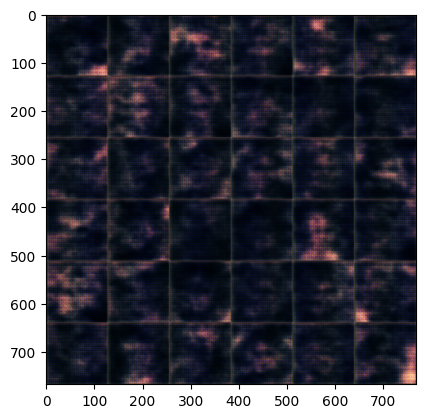

Training Progress:   3%|▎         | 500/15000 [02:54<2:06:19,  1.91step/s]

****************************************************************************************************
1/1 [==============================] - 0s 17ms/step


Training Progress:   3%|▎         | 501/15000 [02:55<1:51:38,  2.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 502/15000 [02:55<1:40:16,  2.41step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 503/15000 [02:55<1:32:46,  2.60step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   3%|▎         | 504/15000 [02:56<1:27:09,  2.77step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   3%|▎         | 505/15000 [02:56<1:23:22,  2.90step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 506/15000 [02:56<1:23:09,  2.91step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   3%|▎         | 507/15000 [02:56<1:20:35,  3.00step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   3%|▎         | 508/15000 [02:57<1:19:01,  3.06step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   3%|▎         | 509/15000 [02:57<1:17:40,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 510/15000 [02:57<1:16:40,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 511/15000 [02:58<1:18:42,  3.07step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   3%|▎         | 512/15000 [02:58<1:20:20,  3.01step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   3%|▎         | 513/15000 [02:58<1:18:40,  3.07step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 514/15000 [02:59<1:17:16,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 515/15000 [02:59<1:16:25,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 516/15000 [02:59<1:15:45,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 517/15000 [03:00<1:15:21,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 518/15000 [03:00<1:15:43,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 519/15000 [03:00<1:15:20,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 520/15000 [03:01<1:17:47,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   3%|▎         | 521/15000 [03:01<1:17:05,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   3%|▎         | 522/15000 [03:01<1:16:18,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   3%|▎         | 523/15000 [03:02<1:15:42,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   3%|▎         | 524/15000 [03:02<1:15:14,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   4%|▎         | 525/15000 [03:02<1:14:51,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   4%|▎         | 526/15000 [03:03<1:18:57,  3.06step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   4%|▎         | 527/15000 [03:03<1:17:49,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   4%|▎         | 528/15000 [03:03<1:16:44,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   4%|▎         | 529/15000 [03:03<1:16:08,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   4%|▎         | 530/15000 [03:04<1:16:09,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   4%|▎         | 531/15000 [03:04<1:15:31,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   4%|▎         | 532/15000 [03:04<1:15:07,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   4%|▎         | 533/15000 [03:05<1:14:46,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   4%|▎         | 534/15000 [03:05<1:14:50,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   4%|▎         | 535/15000 [03:05<1:14:35,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   4%|▎         | 536/15000 [03:06<1:14:35,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   4%|▎         | 537/15000 [03:06<1:14:30,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   4%|▎         | 538/15000 [03:06<1:14:24,  3.24step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   4%|▎         | 539/15000 [03:07<1:14:26,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   4%|▎         | 540/15000 [03:07<1:17:31,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   4%|▎         | 541/15000 [03:07<1:16:41,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   4%|▎         | 542/15000 [03:08<1:15:57,  3.17step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   4%|▎         | 543/15000 [03:08<1:15:29,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   4%|▎         | 544/15000 [03:08<1:14:59,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   4%|▎         | 545/15000 [03:08<1:14:41,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   4%|▎         | 546/15000 [03:09<1:14:27,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   4%|▎         | 547/15000 [03:09<1:14:26,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   4%|▎         | 548/15000 [03:09<1:14:27,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   4%|▎         | 549/15000 [03:10<1:14:50,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   4%|▎         | 550/15000 [03:10<1:14:49,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   4%|▎         | 551/15000 [03:10<1:14:39,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   4%|▎         | 552/15000 [03:11<1:14:31,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   4%|▎         | 553/15000 [03:11<1:14:22,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   4%|▎         | 554/15000 [03:11<1:14:14,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   4%|▎         | 555/15000 [03:12<1:14:06,  3.25step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:   4%|▎         | 556/15000 [03:12<1:14:19,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   4%|▎         | 557/15000 [03:12<1:14:14,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   4%|▎         | 558/15000 [03:12<1:15:40,  3.18step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   4%|▎         | 559/15000 [03:13<1:18:08,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   4%|▎         | 560/15000 [03:13<1:16:59,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   4%|▎         | 561/15000 [03:13<1:16:07,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   4%|▎         | 562/15000 [03:14<1:15:27,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   4%|▍         | 563/15000 [03:14<1:14:52,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   4%|▍         | 564/15000 [03:14<1:14:36,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   4%|▍         | 565/15000 [03:15<1:14:21,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   4%|▍         | 566/15000 [03:15<1:14:08,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   4%|▍         | 567/15000 [03:15<1:16:52,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   4%|▍         | 568/15000 [03:16<1:16:13,  3.16step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   4%|▍         | 569/15000 [03:16<1:15:39,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   4%|▍         | 570/15000 [03:16<1:15:10,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   4%|▍         | 571/15000 [03:17<1:14:48,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   4%|▍         | 572/15000 [03:17<1:14:56,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   4%|▍         | 573/15000 [03:17<1:14:33,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   4%|▍         | 574/15000 [03:17<1:14:31,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   4%|▍         | 575/15000 [03:18<1:14:12,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   4%|▍         | 576/15000 [03:18<1:14:07,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   4%|▍         | 577/15000 [03:18<1:14:26,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   4%|▍         | 578/15000 [03:19<1:14:33,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   4%|▍         | 579/15000 [03:19<1:14:26,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   4%|▍         | 580/15000 [03:19<1:14:24,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   4%|▍         | 581/15000 [03:20<1:14:13,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   4%|▍         | 582/15000 [03:20<1:14:09,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   4%|▍         | 583/15000 [03:20<1:13:58,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   4%|▍         | 584/15000 [03:21<1:14:23,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   4%|▍         | 585/15000 [03:21<1:14:27,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   4%|▍         | 586/15000 [03:21<1:14:48,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   4%|▍         | 587/15000 [03:22<1:14:31,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   4%|▍         | 588/15000 [03:22<1:14:32,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   4%|▍         | 589/15000 [03:22<1:14:25,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   4%|▍         | 590/15000 [03:22<1:14:19,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   4%|▍         | 591/15000 [03:23<1:14:19,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   4%|▍         | 592/15000 [03:23<1:14:20,  3.23step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:   4%|▍         | 593/15000 [03:23<1:19:57,  3.00step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:   4%|▍         | 594/15000 [03:24<1:26:48,  2.77step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:   4%|▍         | 595/15000 [03:24<1:33:11,  2.58step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   4%|▍         | 596/15000 [03:25<1:47:05,  2.24step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:   4%|▍         | 597/15000 [03:25<1:37:40,  2.46step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:   4%|▍         | 598/15000 [03:26<1:33:39,  2.56step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:   4%|▍         | 599/15000 [03:26<1:28:26,  2.71step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:   4%|▍         | 600/15000 [03:26<1:24:24,  2.84step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:   4%|▍         | 601/15000 [03:27<1:21:48,  2.93step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:   4%|▍         | 602/15000 [03:27<1:19:51,  3.00step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:   4%|▍         | 603/15000 [03:27<1:18:38,  3.05step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:   4%|▍         | 604/15000 [03:27<1:17:31,  3.10step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:   4%|▍         | 605/15000 [03:28<1:17:24,  3.10step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:   4%|▍         | 606/15000 [03:28<1:16:40,  3.13step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:   4%|▍         | 607/15000 [03:28<1:16:19,  3.14step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:   4%|▍         | 608/15000 [03:29<1:16:00,  3.16step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:   4%|▍         | 609/15000 [03:29<1:16:02,  3.15step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:   4%|▍         | 610/15000 [03:29<1:15:47,  3.16step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:   4%|▍         | 611/15000 [03:30<1:15:46,  3.16step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:   4%|▍         | 612/15000 [03:30<1:15:30,  3.18step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:   4%|▍         | 613/15000 [03:30<1:15:39,  3.17step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:   4%|▍         | 614/15000 [03:31<1:16:00,  3.15step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:   4%|▍         | 615/15000 [03:31<1:15:55,  3.16step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:   4%|▍         | 616/15000 [03:31<1:15:33,  3.17step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:   4%|▍         | 617/15000 [03:32<1:15:27,  3.18step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:   4%|▍         | 618/15000 [03:32<1:15:23,  3.18step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:   4%|▍         | 619/15000 [03:32<1:17:29,  3.09step/s]

1/1 [==============================] - 0s 40ms/step


Training Progress:   4%|▍         | 620/15000 [03:33<1:21:53,  2.93step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:   4%|▍         | 621/15000 [03:33<1:20:09,  2.99step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:   4%|▍         | 622/15000 [03:33<1:18:33,  3.05step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:   4%|▍         | 623/15000 [03:34<1:18:02,  3.07step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:   4%|▍         | 624/15000 [03:34<1:17:13,  3.10step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:   4%|▍         | 625/15000 [03:34<1:16:37,  3.13step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:   4%|▍         | 626/15000 [03:35<1:16:06,  3.15step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:   4%|▍         | 627/15000 [03:35<1:15:59,  3.15step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:   4%|▍         | 628/15000 [03:35<1:15:36,  3.17step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:   4%|▍         | 629/15000 [03:35<1:15:29,  3.17step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   4%|▍         | 630/15000 [03:36<1:15:11,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   4%|▍         | 631/15000 [03:36<1:15:00,  3.19step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:   4%|▍         | 632/15000 [03:36<1:15:15,  3.18step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   4%|▍         | 633/15000 [03:37<1:15:13,  3.18step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   4%|▍         | 634/15000 [03:37<1:14:55,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   4%|▍         | 635/15000 [03:37<1:14:59,  3.19step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:   4%|▍         | 636/15000 [03:38<1:14:49,  3.20step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:   4%|▍         | 637/15000 [03:38<1:15:06,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   4%|▍         | 638/15000 [03:38<1:17:25,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   4%|▍         | 639/15000 [03:39<1:16:32,  3.13step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   4%|▍         | 640/15000 [03:39<1:15:58,  3.15step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   4%|▍         | 641/15000 [03:39<1:15:58,  3.15step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   4%|▍         | 642/15000 [03:40<1:15:28,  3.17step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:   4%|▍         | 643/15000 [03:40<1:15:34,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   4%|▍         | 644/15000 [03:40<1:14:59,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   4%|▍         | 645/15000 [03:40<1:14:48,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   4%|▍         | 646/15000 [03:41<1:14:22,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   4%|▍         | 647/15000 [03:41<1:14:21,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   4%|▍         | 648/15000 [03:41<1:14:07,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   4%|▍         | 649/15000 [03:42<1:14:01,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   4%|▍         | 650/15000 [03:42<1:14:17,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   4%|▍         | 651/15000 [03:42<1:14:20,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   4%|▍         | 652/15000 [03:43<1:16:50,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   4%|▍         | 653/15000 [03:43<1:16:16,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   4%|▍         | 654/15000 [03:43<1:15:35,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   4%|▍         | 655/15000 [03:44<1:15:20,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   4%|▍         | 656/15000 [03:44<1:15:00,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   4%|▍         | 657/15000 [03:44<1:17:20,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   4%|▍         | 658/15000 [03:45<1:16:13,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   4%|▍         | 659/15000 [03:45<1:16:08,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   4%|▍         | 660/15000 [03:45<1:15:26,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   4%|▍         | 661/15000 [03:46<1:15:09,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   4%|▍         | 662/15000 [03:46<1:14:38,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   4%|▍         | 663/15000 [03:46<1:14:20,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   4%|▍         | 664/15000 [03:46<1:14:03,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   4%|▍         | 665/15000 [03:47<1:14:01,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   4%|▍         | 666/15000 [03:47<1:14:01,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   4%|▍         | 667/15000 [03:47<1:16:31,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   4%|▍         | 668/15000 [03:48<1:16:17,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   4%|▍         | 669/15000 [03:48<1:15:30,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   4%|▍         | 670/15000 [03:48<1:15:16,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   4%|▍         | 671/15000 [03:49<1:14:45,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   4%|▍         | 672/15000 [03:49<1:14:33,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   4%|▍         | 673/15000 [03:49<1:14:16,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   4%|▍         | 674/15000 [03:50<1:14:03,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   4%|▍         | 675/15000 [03:50<1:13:46,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   5%|▍         | 676/15000 [03:50<1:13:48,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   5%|▍         | 677/15000 [03:51<1:14:07,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   5%|▍         | 678/15000 [03:51<1:14:06,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   5%|▍         | 679/15000 [03:51<1:13:52,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   5%|▍         | 680/15000 [03:51<1:13:49,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   5%|▍         | 681/15000 [03:52<1:13:37,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   5%|▍         | 682/15000 [03:52<1:13:42,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   5%|▍         | 683/15000 [03:52<1:16:25,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   5%|▍         | 684/15000 [03:53<1:15:43,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   5%|▍         | 685/15000 [03:53<1:15:05,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   5%|▍         | 686/15000 [03:53<1:14:44,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   5%|▍         | 687/15000 [03:54<1:14:50,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   5%|▍         | 688/15000 [03:54<1:14:52,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   5%|▍         | 689/15000 [03:54<1:14:25,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   5%|▍         | 690/15000 [03:55<1:14:37,  3.20step/s]

1/1 [==============================] - 0s 29ms/step


Training Progress:   5%|▍         | 691/15000 [03:55<1:19:43,  2.99step/s]

1/1 [==============================] - 0s 27ms/step


Training Progress:   5%|▍         | 692/15000 [03:55<1:24:06,  2.84step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:   5%|▍         | 693/15000 [03:56<1:28:27,  2.70step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   5%|▍         | 694/15000 [03:56<1:24:15,  2.83step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   5%|▍         | 695/15000 [03:56<1:21:31,  2.92step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   5%|▍         | 696/15000 [03:57<1:19:40,  2.99step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   5%|▍         | 697/15000 [03:57<1:18:13,  3.05step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   5%|▍         | 698/15000 [03:57<1:17:14,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   5%|▍         | 699/15000 [03:58<1:16:10,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   5%|▍         | 700/15000 [03:58<1:15:35,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   5%|▍         | 701/15000 [03:58<1:14:59,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   5%|▍         | 702/15000 [03:59<1:14:39,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   5%|▍         | 703/15000 [03:59<1:14:22,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   5%|▍         | 704/15000 [03:59<1:14:16,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   5%|▍         | 705/15000 [04:00<1:14:50,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   5%|▍         | 706/15000 [04:00<1:14:43,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   5%|▍         | 707/15000 [04:00<1:14:35,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   5%|▍         | 708/15000 [04:00<1:14:29,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   5%|▍         | 709/15000 [04:01<1:14:19,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   5%|▍         | 710/15000 [04:01<1:14:09,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   5%|▍         | 711/15000 [04:01<1:13:54,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   5%|▍         | 712/15000 [04:02<1:13:50,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   5%|▍         | 713/15000 [04:02<1:13:46,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   5%|▍         | 714/15000 [04:02<1:14:08,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   5%|▍         | 715/15000 [04:03<1:14:08,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   5%|▍         | 716/15000 [04:03<1:14:03,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   5%|▍         | 717/15000 [04:03<1:13:52,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   5%|▍         | 718/15000 [04:04<1:13:47,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   5%|▍         | 719/15000 [04:04<1:13:36,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   5%|▍         | 720/15000 [04:04<1:13:37,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   5%|▍         | 721/15000 [04:04<1:13:37,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   5%|▍         | 722/15000 [04:05<1:13:27,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   5%|▍         | 723/15000 [04:05<1:13:06,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   5%|▍         | 724/15000 [04:05<1:13:26,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   5%|▍         | 725/15000 [04:06<1:15:55,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   5%|▍         | 726/15000 [04:06<1:17:40,  3.06step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   5%|▍         | 727/15000 [04:06<1:16:06,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   5%|▍         | 728/15000 [04:07<1:15:18,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   5%|▍         | 729/15000 [04:07<1:14:31,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   5%|▍         | 730/15000 [04:07<1:14:21,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   5%|▍         | 731/15000 [04:08<1:13:57,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   5%|▍         | 732/15000 [04:08<1:13:54,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   5%|▍         | 733/15000 [04:08<1:14:01,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   5%|▍         | 734/15000 [04:09<1:14:02,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   5%|▍         | 735/15000 [04:09<1:13:42,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   5%|▍         | 736/15000 [04:09<1:13:41,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   5%|▍         | 737/15000 [04:10<1:13:39,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   5%|▍         | 738/15000 [04:10<1:13:36,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   5%|▍         | 739/15000 [04:10<1:13:24,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   5%|▍         | 740/15000 [04:10<1:13:28,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   5%|▍         | 741/15000 [04:11<1:13:20,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   5%|▍         | 742/15000 [04:11<1:13:51,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   5%|▍         | 743/15000 [04:11<1:16:26,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   5%|▍         | 744/15000 [04:12<1:15:43,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   5%|▍         | 745/15000 [04:12<1:15:08,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   5%|▍         | 746/15000 [04:12<1:14:38,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   5%|▍         | 747/15000 [04:13<1:14:07,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   5%|▍         | 748/15000 [04:13<1:14:01,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   5%|▍         | 749/15000 [04:13<1:13:48,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   5%|▌         | 750/15000 [04:14<1:13:47,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   5%|▌         | 751/15000 [04:14<1:13:58,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   5%|▌         | 752/15000 [04:14<1:13:54,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   5%|▌         | 753/15000 [04:15<1:13:41,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   5%|▌         | 754/15000 [04:15<1:16:15,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   5%|▌         | 755/15000 [04:15<1:15:15,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   5%|▌         | 756/15000 [04:15<1:14:45,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   5%|▌         | 757/15000 [04:16<1:14:07,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   5%|▌         | 758/15000 [04:16<1:14:05,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   5%|▌         | 759/15000 [04:16<1:13:43,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   5%|▌         | 760/15000 [04:17<1:13:50,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   5%|▌         | 761/15000 [04:17<1:14:12,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   5%|▌         | 762/15000 [04:17<1:14:09,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   5%|▌         | 763/15000 [04:18<1:14:15,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   5%|▌         | 764/15000 [04:18<1:14:05,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   5%|▌         | 765/15000 [04:18<1:13:44,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   5%|▌         | 766/15000 [04:19<1:13:45,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   5%|▌         | 767/15000 [04:19<1:16:04,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   5%|▌         | 768/15000 [04:19<1:15:17,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   5%|▌         | 769/15000 [04:20<1:14:40,  3.18step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   5%|▌         | 770/15000 [04:20<1:14:53,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   5%|▌         | 771/15000 [04:20<1:14:19,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   5%|▌         | 772/15000 [04:20<1:14:12,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   5%|▌         | 773/15000 [04:21<1:13:44,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   5%|▌         | 774/15000 [04:21<1:16:10,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   5%|▌         | 775/15000 [04:21<1:15:14,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   5%|▌         | 776/15000 [04:22<1:14:40,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   5%|▌         | 777/15000 [04:22<1:14:15,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   5%|▌         | 778/15000 [04:22<1:16:56,  3.08step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   5%|▌         | 779/15000 [04:23<1:16:07,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   5%|▌         | 780/15000 [04:23<1:15:26,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   5%|▌         | 781/15000 [04:23<1:14:41,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   5%|▌         | 782/15000 [04:24<1:14:22,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   5%|▌         | 783/15000 [04:24<1:13:52,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   5%|▌         | 784/15000 [04:24<1:13:39,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   5%|▌         | 785/15000 [04:25<1:13:29,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   5%|▌         | 786/15000 [04:25<1:13:38,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   5%|▌         | 787/15000 [04:25<1:13:27,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   5%|▌         | 788/15000 [04:26<1:13:46,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   5%|▌         | 789/15000 [04:26<1:15:55,  3.12step/s]

1/1 [==============================] - 0s 30ms/step


Training Progress:   5%|▌         | 790/15000 [04:26<1:22:39,  2.87step/s]

1/1 [==============================] - 0s 33ms/step


Training Progress:   5%|▌         | 791/15000 [04:27<1:29:14,  2.65step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:   5%|▌         | 792/15000 [04:27<1:32:16,  2.57step/s]

1/1 [==============================] - 0s 23ms/step


Training Progress:   5%|▌         | 793/15000 [04:27<1:30:14,  2.62step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   5%|▌         | 794/15000 [04:28<1:25:01,  2.78step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   5%|▌         | 795/15000 [04:28<1:21:15,  2.91step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   5%|▌         | 796/15000 [04:28<1:18:48,  3.00step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   5%|▌         | 797/15000 [04:29<1:16:54,  3.08step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   5%|▌         | 798/15000 [04:29<1:16:11,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   5%|▌         | 799/15000 [04:29<1:15:06,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   5%|▌         | 800/15000 [04:30<1:14:31,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   5%|▌         | 801/15000 [04:30<1:13:57,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   5%|▌         | 802/15000 [04:30<1:13:42,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   5%|▌         | 803/15000 [04:31<1:13:25,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   5%|▌         | 804/15000 [04:31<1:13:25,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   5%|▌         | 805/15000 [04:31<1:13:18,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   5%|▌         | 806/15000 [04:32<1:13:25,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   5%|▌         | 807/15000 [04:32<1:13:44,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   5%|▌         | 808/15000 [04:32<1:13:50,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   5%|▌         | 809/15000 [04:32<1:13:46,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   5%|▌         | 810/15000 [04:33<1:13:34,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   5%|▌         | 811/15000 [04:33<1:13:19,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   5%|▌         | 812/15000 [04:33<1:13:15,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   5%|▌         | 813/15000 [04:34<1:15:41,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   5%|▌         | 814/15000 [04:34<1:14:51,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   5%|▌         | 815/15000 [04:34<1:14:17,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   5%|▌         | 816/15000 [04:35<1:14:22,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   5%|▌         | 817/15000 [04:35<1:14:06,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   5%|▌         | 818/15000 [04:35<1:13:51,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   5%|▌         | 819/15000 [04:36<1:13:41,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   5%|▌         | 820/15000 [04:36<1:13:46,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   5%|▌         | 821/15000 [04:36<1:13:27,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   5%|▌         | 822/15000 [04:37<1:15:56,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   5%|▌         | 823/15000 [04:37<1:15:07,  3.15step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:   5%|▌         | 824/15000 [04:37<1:14:49,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▌         | 825/15000 [04:37<1:14:41,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   6%|▌         | 826/15000 [04:38<1:14:18,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   6%|▌         | 827/15000 [04:38<1:13:56,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   6%|▌         | 828/15000 [04:38<1:13:39,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▌         | 829/15000 [04:39<1:13:28,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   6%|▌         | 830/15000 [04:39<1:15:51,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   6%|▌         | 831/15000 [04:39<1:14:59,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   6%|▌         | 832/15000 [04:40<1:14:11,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▌         | 833/15000 [04:40<1:13:56,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   6%|▌         | 834/15000 [04:40<1:13:29,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▌         | 835/15000 [04:41<1:13:56,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▌         | 836/15000 [04:41<1:13:35,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   6%|▌         | 837/15000 [04:41<1:13:26,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   6%|▌         | 838/15000 [04:42<1:13:11,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   6%|▌         | 839/15000 [04:42<1:13:06,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   6%|▌         | 840/15000 [04:42<1:12:51,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   6%|▌         | 841/15000 [04:42<1:14:03,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   6%|▌         | 842/15000 [04:43<1:13:46,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▌         | 843/15000 [04:43<1:13:37,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▌         | 844/15000 [04:43<1:13:43,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   6%|▌         | 845/15000 [04:44<1:13:41,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   6%|▌         | 846/15000 [04:44<1:13:26,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   6%|▌         | 847/15000 [04:44<1:13:17,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▌         | 848/15000 [04:45<1:13:04,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▌         | 849/15000 [04:45<1:13:12,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▌         | 850/15000 [04:45<1:13:03,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   6%|▌         | 851/15000 [04:46<1:13:04,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▌         | 852/15000 [04:46<1:12:58,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▌         | 853/15000 [04:46<1:13:37,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▌         | 854/15000 [04:47<1:13:28,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▌         | 855/15000 [04:47<1:13:21,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   6%|▌         | 856/15000 [04:47<1:13:21,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   6%|▌         | 857/15000 [04:47<1:13:13,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   6%|▌         | 858/15000 [04:48<1:13:03,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   6%|▌         | 859/15000 [04:48<1:13:08,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   6%|▌         | 860/15000 [04:48<1:12:56,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   6%|▌         | 861/15000 [04:49<1:12:59,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▌         | 862/15000 [04:49<1:13:22,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▌         | 863/15000 [04:49<1:13:21,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   6%|▌         | 864/15000 [04:50<1:12:59,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   6%|▌         | 865/15000 [04:50<1:12:56,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   6%|▌         | 866/15000 [04:50<1:12:52,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▌         | 867/15000 [04:51<1:13:00,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   6%|▌         | 868/15000 [04:51<1:12:49,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▌         | 869/15000 [04:51<1:13:00,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▌         | 870/15000 [04:51<1:12:56,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▌         | 871/15000 [04:52<1:12:59,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▌         | 872/15000 [04:52<1:13:22,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   6%|▌         | 873/15000 [04:52<1:15:50,  3.10step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:   6%|▌         | 874/15000 [04:53<1:15:19,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   6%|▌         | 875/15000 [04:53<1:14:28,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   6%|▌         | 876/15000 [04:53<1:13:41,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▌         | 877/15000 [04:54<1:13:16,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   6%|▌         | 878/15000 [04:54<1:12:51,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   6%|▌         | 879/15000 [04:54<1:12:28,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   6%|▌         | 880/15000 [04:55<1:12:11,  3.26step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▌         | 881/15000 [04:55<1:12:43,  3.24step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:   6%|▌         | 882/15000 [04:55<1:12:52,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▌         | 883/15000 [04:56<1:12:59,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   6%|▌         | 884/15000 [04:56<1:12:46,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   6%|▌         | 885/15000 [04:56<1:15:40,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▌         | 886/15000 [04:57<1:14:41,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▌         | 887/15000 [04:57<1:14:05,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▌         | 888/15000 [04:57<1:13:45,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   6%|▌         | 889/15000 [04:57<1:14:00,  3.18step/s]

1/1 [==============================] - 0s 29ms/step


Training Progress:   6%|▌         | 890/15000 [04:58<1:22:32,  2.85step/s]

1/1 [==============================] - 0s 27ms/step


Training Progress:   6%|▌         | 891/15000 [04:58<1:27:19,  2.69step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:   6%|▌         | 892/15000 [04:59<1:29:57,  2.61step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   6%|▌         | 893/15000 [04:59<1:24:49,  2.77step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   6%|▌         | 894/15000 [04:59<1:21:09,  2.90step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   6%|▌         | 895/15000 [05:00<1:18:34,  2.99step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   6%|▌         | 896/15000 [05:00<1:16:46,  3.06step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   6%|▌         | 897/15000 [05:00<1:18:16,  3.00step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   6%|▌         | 898/15000 [05:01<1:16:41,  3.06step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▌         | 899/15000 [05:01<1:15:46,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▌         | 900/15000 [05:01<1:17:28,  3.03step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▌         | 901/15000 [05:02<1:15:56,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   6%|▌         | 902/15000 [05:02<1:14:59,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▌         | 903/15000 [05:02<1:14:54,  3.14step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:   6%|▌         | 904/15000 [05:03<1:17:47,  3.02step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▌         | 905/15000 [05:03<1:16:15,  3.08step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▌         | 906/15000 [05:03<1:15:12,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   6%|▌         | 907/15000 [05:03<1:14:31,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   6%|▌         | 908/15000 [05:04<1:13:56,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   6%|▌         | 909/15000 [05:04<1:13:45,  3.18step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   6%|▌         | 910/15000 [05:04<1:13:34,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   6%|▌         | 911/15000 [05:05<1:13:16,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▌         | 912/15000 [05:05<1:13:18,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   6%|▌         | 913/15000 [05:05<1:13:16,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▌         | 914/15000 [05:06<1:13:04,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   6%|▌         | 915/15000 [05:06<1:13:05,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▌         | 916/15000 [05:06<1:13:09,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   6%|▌         | 917/15000 [05:07<1:13:01,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▌         | 918/15000 [05:07<1:13:28,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▌         | 919/15000 [05:07<1:13:32,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▌         | 920/15000 [05:08<1:13:24,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▌         | 921/15000 [05:08<1:13:19,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▌         | 922/15000 [05:08<1:13:12,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▌         | 923/15000 [05:08<1:13:05,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   6%|▌         | 924/15000 [05:09<1:15:37,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▌         | 925/15000 [05:09<1:14:46,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   6%|▌         | 926/15000 [05:09<1:14:08,  3.16step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   6%|▌         | 927/15000 [05:10<1:16:40,  3.06step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▌         | 928/15000 [05:10<1:15:39,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▌         | 929/15000 [05:10<1:14:54,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▌         | 930/15000 [05:11<1:14:09,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▌         | 931/15000 [05:11<1:13:46,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▌         | 932/15000 [05:11<1:13:33,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▌         | 933/15000 [05:12<1:13:16,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▌         | 934/15000 [05:12<1:13:11,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   6%|▌         | 935/15000 [05:12<1:13:27,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   6%|▌         | 936/15000 [05:13<1:15:04,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▌         | 937/15000 [05:13<1:17:04,  3.04step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▋         | 938/15000 [05:13<1:15:58,  3.08step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▋         | 939/15000 [05:14<1:15:14,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   6%|▋         | 940/15000 [05:14<1:14:28,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▋         | 941/15000 [05:14<1:14:03,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▋         | 942/15000 [05:15<1:13:39,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   6%|▋         | 943/15000 [05:15<1:13:20,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▋         | 944/15000 [05:15<1:13:07,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   6%|▋         | 945/15000 [05:15<1:13:00,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▋         | 946/15000 [05:16<1:13:17,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▋         | 947/15000 [05:16<1:13:11,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▋         | 948/15000 [05:16<1:12:59,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   6%|▋         | 949/15000 [05:17<1:13:01,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▋         | 950/15000 [05:17<1:12:52,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▋         | 951/15000 [05:17<1:13:13,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▋         | 952/15000 [05:18<1:15:49,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   6%|▋         | 953/15000 [05:18<1:14:55,  3.12step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:   6%|▋         | 954/15000 [05:18<1:14:21,  3.15step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   6%|▋         | 955/15000 [05:19<1:14:28,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▋         | 956/15000 [05:19<1:13:53,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▋         | 957/15000 [05:19<1:13:36,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   6%|▋         | 958/15000 [05:20<1:13:13,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▋         | 959/15000 [05:20<1:13:02,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▋         | 960/15000 [05:20<1:12:42,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▋         | 961/15000 [05:20<1:12:57,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▋         | 962/15000 [05:21<1:13:03,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▋         | 963/15000 [05:21<1:13:00,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▋         | 964/15000 [05:21<1:13:21,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   6%|▋         | 965/15000 [05:22<1:13:21,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▋         | 966/15000 [05:22<1:13:19,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▋         | 967/15000 [05:22<1:13:40,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▋         | 968/15000 [05:23<1:13:33,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▋         | 969/15000 [05:23<1:13:28,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▋         | 970/15000 [05:23<1:13:17,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   6%|▋         | 971/15000 [05:24<1:13:10,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▋         | 972/15000 [05:24<1:13:09,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   6%|▋         | 973/15000 [05:24<1:13:21,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   6%|▋         | 974/15000 [05:25<1:13:22,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   6%|▋         | 975/15000 [05:25<1:13:12,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   7%|▋         | 976/15000 [05:25<1:12:54,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   7%|▋         | 977/15000 [05:26<1:12:56,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   7%|▋         | 978/15000 [05:26<1:12:47,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   7%|▋         | 979/15000 [05:26<1:12:38,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   7%|▋         | 980/15000 [05:26<1:12:43,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   7%|▋         | 981/15000 [05:27<1:12:49,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   7%|▋         | 982/15000 [05:27<1:12:41,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   7%|▋         | 983/15000 [05:27<1:13:08,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   7%|▋         | 984/15000 [05:28<1:13:09,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   7%|▋         | 985/15000 [05:28<1:12:54,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   7%|▋         | 986/15000 [05:28<1:13:18,  3.19step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:   7%|▋         | 987/15000 [05:29<1:13:21,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   7%|▋         | 988/15000 [05:29<1:15:38,  3.09step/s]

1/1 [==============================] - 0s 27ms/step


Training Progress:   7%|▋         | 989/15000 [05:29<1:20:46,  2.89step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:   7%|▋         | 990/15000 [05:30<1:27:57,  2.65step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:   7%|▋         | 991/15000 [05:30<1:27:48,  2.66step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   7%|▋         | 992/15000 [05:31<1:23:35,  2.79step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   7%|▋         | 993/15000 [05:31<1:20:07,  2.91step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   7%|▋         | 994/15000 [05:31<1:17:45,  3.00step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   7%|▋         | 995/15000 [05:31<1:16:09,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   7%|▋         | 996/15000 [05:32<1:14:56,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   7%|▋         | 997/15000 [05:32<1:14:08,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   7%|▋         | 998/15000 [05:32<1:14:00,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   7%|▋         | 999/15000 [05:33<1:13:26,  3.18step/s]

1/1 [==============================] - 0s 16ms/step
****************************************************************************************************
1000/15000: d_loss: 0.145178,  g_loss: 2.400863
2/2 [==============================] - 0s 20ms/step


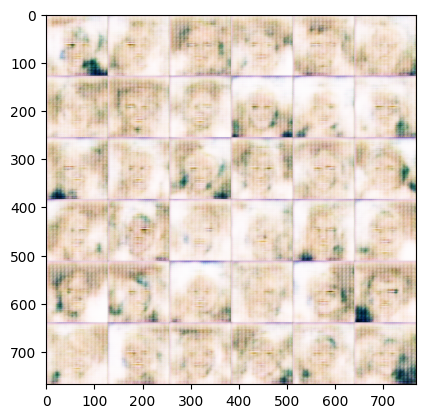

Training Progress:   7%|▋         | 1000/15000 [05:33<1:46:36,  2.19step/s]

****************************************************************************************************
1/1 [==============================] - 0s 16ms/step


Training Progress:   7%|▋         | 1001/15000 [05:34<1:36:45,  2.41step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   7%|▋         | 1002/15000 [05:34<1:29:09,  2.62step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   7%|▋         | 1003/15000 [05:34<1:24:47,  2.75step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   7%|▋         | 1004/15000 [05:35<1:21:11,  2.87step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   7%|▋         | 1005/15000 [05:35<1:18:41,  2.96step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   7%|▋         | 1006/15000 [05:35<1:16:34,  3.05step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   7%|▋         | 1007/15000 [05:36<1:17:50,  3.00step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   7%|▋         | 1008/15000 [05:36<1:15:58,  3.07step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   7%|▋         | 1009/15000 [05:36<1:14:46,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   7%|▋         | 1010/15000 [05:37<1:13:49,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   7%|▋         | 1011/15000 [05:37<1:13:17,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   7%|▋         | 1012/15000 [05:37<1:12:49,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   7%|▋         | 1013/15000 [05:38<1:12:50,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   7%|▋         | 1014/15000 [05:38<1:12:27,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   7%|▋         | 1015/15000 [05:38<1:12:23,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   7%|▋         | 1016/15000 [05:38<1:12:13,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   7%|▋         | 1017/15000 [05:39<1:12:11,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   7%|▋         | 1018/15000 [05:39<1:11:57,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   7%|▋         | 1019/15000 [05:39<1:12:04,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   7%|▋         | 1020/15000 [05:40<1:11:51,  3.24step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   7%|▋         | 1021/15000 [05:40<1:12:15,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   7%|▋         | 1022/15000 [05:40<1:14:43,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   7%|▋         | 1023/15000 [05:41<1:17:03,  3.02step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   7%|▋         | 1024/15000 [05:41<1:15:27,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   7%|▋         | 1025/15000 [05:41<1:14:53,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   7%|▋         | 1026/15000 [05:42<1:13:56,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   7%|▋         | 1027/15000 [05:42<1:13:24,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   7%|▋         | 1028/15000 [05:42<1:13:23,  3.17step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:   7%|▋         | 1029/15000 [05:43<1:14:42,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   7%|▋         | 1030/15000 [05:43<1:13:54,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   7%|▋         | 1031/15000 [05:43<1:13:22,  3.17step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   7%|▋         | 1032/15000 [05:44<1:13:17,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   7%|▋         | 1033/15000 [05:44<1:15:36,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   7%|▋         | 1034/15000 [05:44<1:14:25,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   7%|▋         | 1035/15000 [05:45<1:13:48,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   7%|▋         | 1036/15000 [05:45<1:13:01,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   7%|▋         | 1037/15000 [05:45<1:12:42,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   7%|▋         | 1038/15000 [05:45<1:12:21,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   7%|▋         | 1039/15000 [05:46<1:12:17,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   7%|▋         | 1040/15000 [05:46<1:14:35,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   7%|▋         | 1041/15000 [05:46<1:14:15,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   7%|▋         | 1042/15000 [05:47<1:13:32,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   7%|▋         | 1043/15000 [05:47<1:13:07,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   7%|▋         | 1044/15000 [05:47<1:12:40,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   7%|▋         | 1045/15000 [05:48<1:12:27,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   7%|▋         | 1046/15000 [05:48<1:12:11,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   7%|▋         | 1047/15000 [05:48<1:12:11,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   7%|▋         | 1048/15000 [05:49<1:11:55,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   7%|▋         | 1049/15000 [05:49<1:11:55,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   7%|▋         | 1050/15000 [05:49<1:12:04,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   7%|▋         | 1051/15000 [05:50<1:14:37,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   7%|▋         | 1052/15000 [05:50<1:13:39,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   7%|▋         | 1053/15000 [05:50<1:13:03,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   7%|▋         | 1054/15000 [05:50<1:12:45,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   7%|▋         | 1055/15000 [05:51<1:12:32,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   7%|▋         | 1056/15000 [05:51<1:12:12,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   7%|▋         | 1057/15000 [05:51<1:12:15,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   7%|▋         | 1058/15000 [05:52<1:11:51,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   7%|▋         | 1059/15000 [05:52<1:12:05,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   7%|▋         | 1060/15000 [05:52<1:15:03,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   7%|▋         | 1061/15000 [05:53<1:14:15,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   7%|▋         | 1062/15000 [05:53<1:13:30,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   7%|▋         | 1063/15000 [05:53<1:12:59,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   7%|▋         | 1064/15000 [05:54<1:12:35,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   7%|▋         | 1065/15000 [05:54<1:12:22,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   7%|▋         | 1066/15000 [05:54<1:12:00,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   7%|▋         | 1067/15000 [05:55<1:12:07,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   7%|▋         | 1068/15000 [05:55<1:11:49,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   7%|▋         | 1069/15000 [05:55<1:12:17,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   7%|▋         | 1070/15000 [05:55<1:12:14,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   7%|▋         | 1071/15000 [05:56<1:14:36,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   7%|▋         | 1072/15000 [05:56<1:13:37,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   7%|▋         | 1073/15000 [05:56<1:13:16,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   7%|▋         | 1074/15000 [05:57<1:12:43,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   7%|▋         | 1075/15000 [05:57<1:12:24,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   7%|▋         | 1076/15000 [05:57<1:14:36,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   7%|▋         | 1077/15000 [05:58<1:13:42,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   7%|▋         | 1078/15000 [05:58<1:15:48,  3.06step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   7%|▋         | 1079/15000 [05:58<1:14:44,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   7%|▋         | 1080/15000 [05:59<1:13:58,  3.14step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:   7%|▋         | 1081/15000 [05:59<1:13:59,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   7%|▋         | 1082/15000 [05:59<1:13:31,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   7%|▋         | 1083/15000 [06:00<1:13:07,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   7%|▋         | 1084/15000 [06:00<1:12:34,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   7%|▋         | 1085/15000 [06:00<1:14:55,  3.10step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:   7%|▋         | 1086/15000 [06:01<1:18:50,  2.94step/s]

1/1 [==============================] - 0s 27ms/step


Training Progress:   7%|▋         | 1087/15000 [06:01<1:22:18,  2.82step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:   7%|▋         | 1088/15000 [06:01<1:28:50,  2.61step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   7%|▋         | 1089/15000 [06:02<1:23:55,  2.76step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   7%|▋         | 1090/15000 [06:02<1:20:04,  2.90step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   7%|▋         | 1091/15000 [06:02<1:20:39,  2.87step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   7%|▋         | 1092/15000 [06:03<1:17:49,  2.98step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   7%|▋         | 1093/15000 [06:03<1:16:14,  3.04step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   7%|▋         | 1094/15000 [06:03<1:14:57,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   7%|▋         | 1095/15000 [06:04<1:13:58,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   7%|▋         | 1096/15000 [06:04<1:13:07,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   7%|▋         | 1097/15000 [06:04<1:13:18,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   7%|▋         | 1098/15000 [06:05<1:12:48,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   7%|▋         | 1099/15000 [06:05<1:12:33,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   7%|▋         | 1100/15000 [06:05<1:12:15,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   7%|▋         | 1101/15000 [06:06<1:12:09,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   7%|▋         | 1102/15000 [06:06<1:11:57,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   7%|▋         | 1103/15000 [06:06<1:11:58,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   7%|▋         | 1104/15000 [06:07<1:14:23,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   7%|▋         | 1105/15000 [06:07<1:13:29,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   7%|▋         | 1106/15000 [06:07<1:13:09,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   7%|▋         | 1107/15000 [06:07<1:12:47,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   7%|▋         | 1108/15000 [06:08<1:14:37,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   7%|▋         | 1109/15000 [06:08<1:13:46,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   7%|▋         | 1110/15000 [06:08<1:13:11,  3.16step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   7%|▋         | 1111/15000 [06:09<1:13:06,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   7%|▋         | 1112/15000 [06:09<1:12:39,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   7%|▋         | 1113/15000 [06:09<1:15:01,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   7%|▋         | 1114/15000 [06:10<1:13:57,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   7%|▋         | 1115/15000 [06:10<1:13:48,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   7%|▋         | 1116/15000 [06:10<1:13:15,  3.16step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   7%|▋         | 1117/15000 [06:11<1:13:05,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   7%|▋         | 1118/15000 [06:11<1:12:30,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   7%|▋         | 1119/15000 [06:11<1:12:21,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   7%|▋         | 1120/15000 [06:12<1:11:59,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   7%|▋         | 1121/15000 [06:12<1:11:50,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   7%|▋         | 1122/15000 [06:12<1:11:54,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   7%|▋         | 1123/15000 [06:13<1:15:54,  3.05step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   7%|▋         | 1124/15000 [06:13<1:15:02,  3.08step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   8%|▊         | 1125/15000 [06:13<1:14:11,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   8%|▊         | 1126/15000 [06:13<1:13:32,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   8%|▊         | 1127/15000 [06:14<1:13:05,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   8%|▊         | 1128/15000 [06:14<1:12:30,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   8%|▊         | 1129/15000 [06:14<1:12:11,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   8%|▊         | 1130/15000 [06:15<1:11:48,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   8%|▊         | 1131/15000 [06:15<1:11:31,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   8%|▊         | 1132/15000 [06:15<1:11:18,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   8%|▊         | 1133/15000 [06:16<1:13:36,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   8%|▊         | 1134/15000 [06:16<1:13:06,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   8%|▊         | 1135/15000 [06:16<1:12:28,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   8%|▊         | 1136/15000 [06:17<1:11:55,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   8%|▊         | 1137/15000 [06:17<1:11:33,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   8%|▊         | 1138/15000 [06:17<1:11:24,  3.24step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   8%|▊         | 1139/15000 [06:18<1:11:20,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   8%|▊         | 1140/15000 [06:18<1:13:39,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   8%|▊         | 1141/15000 [06:18<1:12:52,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   8%|▊         | 1142/15000 [06:18<1:12:23,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   8%|▊         | 1143/15000 [06:19<1:12:21,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   8%|▊         | 1144/15000 [06:19<1:12:00,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   8%|▊         | 1145/15000 [06:19<1:14:13,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   8%|▊         | 1146/15000 [06:20<1:13:12,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   8%|▊         | 1147/15000 [06:20<1:14:56,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   8%|▊         | 1148/15000 [06:20<1:13:43,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   8%|▊         | 1149/15000 [06:21<1:12:58,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   8%|▊         | 1150/15000 [06:21<1:12:24,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   8%|▊         | 1151/15000 [06:21<1:12:35,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   8%|▊         | 1152/15000 [06:22<1:12:38,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   8%|▊         | 1153/15000 [06:22<1:14:39,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   8%|▊         | 1154/15000 [06:22<1:16:15,  3.03step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   8%|▊         | 1155/15000 [06:23<1:14:45,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   8%|▊         | 1156/15000 [06:23<1:13:48,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   8%|▊         | 1157/15000 [06:23<1:12:52,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   8%|▊         | 1158/15000 [06:24<1:12:40,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   8%|▊         | 1159/15000 [06:24<1:14:35,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   8%|▊         | 1160/15000 [06:24<1:13:38,  3.13step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:   8%|▊         | 1161/15000 [06:25<1:13:22,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   8%|▊         | 1162/15000 [06:25<1:12:50,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   8%|▊         | 1163/15000 [06:25<1:12:15,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   8%|▊         | 1164/15000 [06:25<1:12:04,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   8%|▊         | 1165/15000 [06:26<1:11:40,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   8%|▊         | 1166/15000 [06:26<1:11:32,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   8%|▊         | 1167/15000 [06:26<1:11:21,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   8%|▊         | 1168/15000 [06:27<1:11:24,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   8%|▊         | 1169/15000 [06:27<1:11:13,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   8%|▊         | 1170/15000 [06:27<1:11:11,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   8%|▊         | 1171/15000 [06:28<1:14:32,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   8%|▊         | 1172/15000 [06:28<1:13:44,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   8%|▊         | 1173/15000 [06:28<1:12:55,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   8%|▊         | 1174/15000 [06:29<1:12:31,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   8%|▊         | 1175/15000 [06:29<1:12:00,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   8%|▊         | 1176/15000 [06:29<1:14:16,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   8%|▊         | 1177/15000 [06:30<1:13:30,  3.13step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   8%|▊         | 1178/15000 [06:30<1:13:15,  3.14step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   8%|▊         | 1179/15000 [06:30<1:15:17,  3.06step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   8%|▊         | 1180/15000 [06:31<1:14:29,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   8%|▊         | 1181/15000 [06:31<1:13:26,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   8%|▊         | 1182/15000 [06:31<1:12:46,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   8%|▊         | 1183/15000 [06:31<1:12:15,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   8%|▊         | 1184/15000 [06:32<1:20:30,  2.86step/s]

1/1 [==============================] - 0s 59ms/step


Training Progress:   8%|▊         | 1185/15000 [06:32<1:25:57,  2.68step/s]

1/1 [==============================] - 0s 27ms/step


Training Progress:   8%|▊         | 1186/15000 [06:33<1:29:46,  2.56step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:   8%|▊         | 1187/15000 [06:33<1:26:10,  2.67step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   8%|▊         | 1188/15000 [06:33<1:21:49,  2.81step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:   8%|▊         | 1189/15000 [06:34<1:19:06,  2.91step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   8%|▊         | 1190/15000 [06:34<1:16:45,  3.00step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   8%|▊         | 1191/15000 [06:34<1:15:07,  3.06step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   8%|▊         | 1192/15000 [06:35<1:13:55,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   8%|▊         | 1193/15000 [06:35<1:13:03,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   8%|▊         | 1194/15000 [06:35<1:12:28,  3.18step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   8%|▊         | 1195/15000 [06:36<1:14:52,  3.07step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   8%|▊         | 1196/15000 [06:36<1:13:37,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   8%|▊         | 1197/15000 [06:36<1:12:39,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   8%|▊         | 1198/15000 [06:37<1:15:03,  3.06step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   8%|▊         | 1199/15000 [06:37<1:16:33,  3.00step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   8%|▊         | 1200/15000 [06:37<1:17:26,  2.97step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   8%|▊         | 1201/15000 [06:38<1:15:32,  3.04step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   8%|▊         | 1202/15000 [06:38<1:14:13,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   8%|▊         | 1203/15000 [06:38<1:15:45,  3.04step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   8%|▊         | 1204/15000 [06:39<1:14:25,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   8%|▊         | 1205/15000 [06:39<1:13:15,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   8%|▊         | 1206/15000 [06:39<1:12:33,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   8%|▊         | 1207/15000 [06:40<1:12:10,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   8%|▊         | 1208/15000 [06:40<1:12:16,  3.18step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   8%|▊         | 1209/15000 [06:40<1:12:09,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   8%|▊         | 1210/15000 [06:40<1:11:55,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   8%|▊         | 1211/15000 [06:41<1:11:41,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   8%|▊         | 1212/15000 [06:41<1:11:40,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   8%|▊         | 1213/15000 [06:41<1:11:27,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   8%|▊         | 1214/15000 [06:42<1:11:16,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   8%|▊         | 1215/15000 [06:42<1:11:09,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   8%|▊         | 1216/15000 [06:42<1:13:36,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   8%|▊         | 1217/15000 [06:43<1:13:44,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   8%|▊         | 1218/15000 [06:43<1:13:01,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   8%|▊         | 1219/15000 [06:43<1:12:29,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   8%|▊         | 1220/15000 [06:44<1:12:09,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   8%|▊         | 1221/15000 [06:44<1:11:44,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   8%|▊         | 1222/15000 [06:44<1:11:25,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   8%|▊         | 1223/15000 [06:45<1:11:18,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   8%|▊         | 1224/15000 [06:45<1:11:13,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   8%|▊         | 1225/15000 [06:45<1:11:07,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   8%|▊         | 1226/15000 [06:45<1:11:26,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   8%|▊         | 1227/15000 [06:46<1:11:22,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   8%|▊         | 1228/15000 [06:46<1:11:14,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   8%|▊         | 1229/15000 [06:46<1:11:12,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   8%|▊         | 1230/15000 [06:47<1:11:08,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   8%|▊         | 1231/15000 [06:47<1:11:02,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   8%|▊         | 1232/15000 [06:47<1:11:00,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   8%|▊         | 1233/15000 [06:48<1:11:04,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   8%|▊         | 1234/15000 [06:48<1:11:00,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   8%|▊         | 1235/15000 [06:48<1:11:23,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   8%|▊         | 1236/15000 [06:49<1:11:17,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   8%|▊         | 1237/15000 [06:49<1:11:11,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   8%|▊         | 1238/15000 [06:49<1:13:39,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   8%|▊         | 1239/15000 [06:50<1:12:45,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   8%|▊         | 1240/15000 [06:50<1:12:04,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   8%|▊         | 1241/15000 [06:50<1:11:39,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   8%|▊         | 1242/15000 [06:50<1:11:31,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   8%|▊         | 1243/15000 [06:51<1:11:21,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   8%|▊         | 1244/15000 [06:51<1:13:44,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   8%|▊         | 1245/15000 [06:51<1:13:27,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   8%|▊         | 1246/15000 [06:52<1:15:12,  3.05step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   8%|▊         | 1247/15000 [06:52<1:13:55,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   8%|▊         | 1248/15000 [06:52<1:13:46,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   8%|▊         | 1249/15000 [06:53<1:12:57,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   8%|▊         | 1250/15000 [06:53<1:12:18,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   8%|▊         | 1251/15000 [06:53<1:11:53,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   8%|▊         | 1252/15000 [06:54<1:11:39,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   8%|▊         | 1253/15000 [06:54<1:11:12,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   8%|▊         | 1254/15000 [06:54<1:11:18,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   8%|▊         | 1255/15000 [06:55<1:11:08,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   8%|▊         | 1256/15000 [06:55<1:10:54,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   8%|▊         | 1257/15000 [06:55<1:10:48,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   8%|▊         | 1258/15000 [06:55<1:10:47,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   8%|▊         | 1259/15000 [06:56<1:10:40,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   8%|▊         | 1260/15000 [06:56<1:10:37,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   8%|▊         | 1261/15000 [06:56<1:10:37,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   8%|▊         | 1262/15000 [06:57<1:10:33,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   8%|▊         | 1263/15000 [06:57<1:11:06,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   8%|▊         | 1264/15000 [06:57<1:10:53,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   8%|▊         | 1265/15000 [06:58<1:11:13,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   8%|▊         | 1266/15000 [06:58<1:10:58,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   8%|▊         | 1267/15000 [06:58<1:10:55,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   8%|▊         | 1268/15000 [06:59<1:10:40,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   8%|▊         | 1269/15000 [06:59<1:10:35,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   8%|▊         | 1270/15000 [06:59<1:10:30,  3.25step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   8%|▊         | 1271/15000 [06:59<1:10:53,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   8%|▊         | 1272/15000 [07:00<1:11:01,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   8%|▊         | 1273/15000 [07:00<1:11:08,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   8%|▊         | 1274/15000 [07:00<1:11:16,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   8%|▊         | 1275/15000 [07:01<1:11:18,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   9%|▊         | 1276/15000 [07:01<1:10:58,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   9%|▊         | 1277/15000 [07:01<1:10:56,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   9%|▊         | 1278/15000 [07:02<1:10:41,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   9%|▊         | 1279/15000 [07:02<1:13:06,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   9%|▊         | 1280/15000 [07:02<1:12:19,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   9%|▊         | 1281/15000 [07:03<1:11:59,  3.18step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   9%|▊         | 1282/15000 [07:03<1:11:58,  3.18step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   9%|▊         | 1283/15000 [07:03<1:14:30,  3.07step/s]

1/1 [==============================] - 0s 38ms/step


Training Progress:   9%|▊         | 1284/15000 [07:04<1:21:25,  2.81step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:   9%|▊         | 1285/15000 [07:04<1:28:12,  2.59step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:   9%|▊         | 1286/15000 [07:05<1:27:19,  2.62step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   9%|▊         | 1287/15000 [07:05<1:22:13,  2.78step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   9%|▊         | 1288/15000 [07:05<1:18:31,  2.91step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   9%|▊         | 1289/15000 [07:05<1:15:57,  3.01step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   9%|▊         | 1290/15000 [07:06<1:14:14,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   9%|▊         | 1291/15000 [07:06<1:13:18,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   9%|▊         | 1292/15000 [07:06<1:12:23,  3.16step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:   9%|▊         | 1293/15000 [07:07<1:11:53,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   9%|▊         | 1294/15000 [07:07<1:11:23,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   9%|▊         | 1295/15000 [07:07<1:11:01,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   9%|▊         | 1296/15000 [07:08<1:10:45,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   9%|▊         | 1297/15000 [07:08<1:12:53,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   9%|▊         | 1298/15000 [07:08<1:12:06,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   9%|▊         | 1299/15000 [07:09<1:11:27,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   9%|▊         | 1300/15000 [07:09<1:11:20,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   9%|▊         | 1301/15000 [07:09<1:10:59,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   9%|▊         | 1302/15000 [07:10<1:10:47,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   9%|▊         | 1303/15000 [07:10<1:10:31,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   9%|▊         | 1304/15000 [07:10<1:10:15,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   9%|▊         | 1305/15000 [07:10<1:10:10,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   9%|▊         | 1306/15000 [07:11<1:10:13,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   9%|▊         | 1307/15000 [07:11<1:10:06,  3.26step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   9%|▊         | 1308/15000 [07:11<1:10:11,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   9%|▊         | 1309/15000 [07:12<1:10:46,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   9%|▊         | 1310/15000 [07:12<1:10:56,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   9%|▊         | 1311/15000 [07:12<1:13:18,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   9%|▊         | 1312/15000 [07:13<1:12:22,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   9%|▉         | 1313/15000 [07:13<1:11:40,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   9%|▉         | 1314/15000 [07:13<1:11:10,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   9%|▉         | 1315/15000 [07:14<1:10:45,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   9%|▉         | 1316/15000 [07:14<1:11:03,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   9%|▉         | 1317/15000 [07:14<1:10:41,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   9%|▉         | 1318/15000 [07:14<1:10:34,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   9%|▉         | 1319/15000 [07:15<1:10:45,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   9%|▉         | 1320/15000 [07:15<1:10:32,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   9%|▉         | 1321/15000 [07:15<1:10:21,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   9%|▉         | 1322/15000 [07:16<1:10:11,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   9%|▉         | 1323/15000 [07:16<1:10:04,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   9%|▉         | 1324/15000 [07:16<1:10:07,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   9%|▉         | 1325/15000 [07:17<1:10:05,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   9%|▉         | 1326/15000 [07:17<1:10:04,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   9%|▉         | 1327/15000 [07:17<1:10:02,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   9%|▉         | 1328/15000 [07:18<1:10:20,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   9%|▉         | 1329/15000 [07:18<1:10:07,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   9%|▉         | 1330/15000 [07:18<1:09:58,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   9%|▉         | 1331/15000 [07:18<1:09:48,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   9%|▉         | 1332/15000 [07:19<1:09:51,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   9%|▉         | 1333/15000 [07:19<1:09:44,  3.27step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   9%|▉         | 1334/15000 [07:19<1:09:40,  3.27step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   9%|▉         | 1335/15000 [07:20<1:09:42,  3.27step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   9%|▉         | 1336/15000 [07:20<1:12:03,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   9%|▉         | 1337/15000 [07:20<1:11:55,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   9%|▉         | 1338/15000 [07:21<1:14:06,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   9%|▉         | 1339/15000 [07:21<1:12:52,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   9%|▉         | 1340/15000 [07:21<1:12:15,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   9%|▉         | 1341/15000 [07:22<1:12:10,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   9%|▉         | 1342/15000 [07:22<1:11:30,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   9%|▉         | 1343/15000 [07:22<1:15:04,  3.03step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   9%|▉         | 1344/15000 [07:23<1:14:04,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   9%|▉         | 1345/15000 [07:23<1:12:59,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   9%|▉         | 1346/15000 [07:23<1:12:26,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   9%|▉         | 1347/15000 [07:24<1:11:56,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   9%|▉         | 1348/15000 [07:24<1:13:56,  3.08step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   9%|▉         | 1349/15000 [07:24<1:12:55,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   9%|▉         | 1350/15000 [07:25<1:12:03,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   9%|▉         | 1351/15000 [07:25<1:11:28,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   9%|▉         | 1352/15000 [07:25<1:10:55,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   9%|▉         | 1353/15000 [07:25<1:10:48,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   9%|▉         | 1354/15000 [07:26<1:10:36,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   9%|▉         | 1355/15000 [07:26<1:10:33,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   9%|▉         | 1356/15000 [07:26<1:10:46,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   9%|▉         | 1357/15000 [07:27<1:10:45,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   9%|▉         | 1358/15000 [07:27<1:10:26,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   9%|▉         | 1359/15000 [07:27<1:10:25,  3.23step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:   9%|▉         | 1360/15000 [07:28<1:10:32,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   9%|▉         | 1361/15000 [07:28<1:10:29,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   9%|▉         | 1362/15000 [07:28<1:10:14,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   9%|▉         | 1363/15000 [07:29<1:10:20,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   9%|▉         | 1364/15000 [07:29<1:10:11,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   9%|▉         | 1365/15000 [07:29<1:10:40,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   9%|▉         | 1366/15000 [07:29<1:10:23,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   9%|▉         | 1367/15000 [07:30<1:10:44,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   9%|▉         | 1368/15000 [07:30<1:10:23,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   9%|▉         | 1369/15000 [07:30<1:10:22,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   9%|▉         | 1370/15000 [07:31<1:10:10,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   9%|▉         | 1371/15000 [07:31<1:10:17,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   9%|▉         | 1372/15000 [07:31<1:10:37,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   9%|▉         | 1373/15000 [07:32<1:10:29,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   9%|▉         | 1374/15000 [07:32<1:13:20,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   9%|▉         | 1375/15000 [07:32<1:13:06,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   9%|▉         | 1376/15000 [07:33<1:12:13,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   9%|▉         | 1377/15000 [07:33<1:11:43,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   9%|▉         | 1378/15000 [07:33<1:11:24,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   9%|▉         | 1379/15000 [07:34<1:11:08,  3.19step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:   9%|▉         | 1380/15000 [07:34<1:11:22,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   9%|▉         | 1381/15000 [07:34<1:11:06,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   9%|▉         | 1382/15000 [07:35<1:13:08,  3.10step/s]

1/1 [==============================] - 0s 36ms/step


Training Progress:   9%|▉         | 1383/15000 [07:35<1:22:56,  2.74step/s]

1/1 [==============================] - 0s 27ms/step


Training Progress:   9%|▉         | 1384/15000 [07:35<1:26:00,  2.64step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:   9%|▉         | 1385/15000 [07:36<1:28:36,  2.56step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   9%|▉         | 1386/15000 [07:36<1:22:55,  2.74step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   9%|▉         | 1387/15000 [07:36<1:19:07,  2.87step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   9%|▉         | 1388/15000 [07:37<1:16:18,  2.97step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   9%|▉         | 1389/15000 [07:37<1:14:19,  3.05step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   9%|▉         | 1390/15000 [07:37<1:12:46,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   9%|▉         | 1391/15000 [07:38<1:11:54,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   9%|▉         | 1392/15000 [07:38<1:11:08,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   9%|▉         | 1393/15000 [07:38<1:11:04,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   9%|▉         | 1394/15000 [07:39<1:10:34,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   9%|▉         | 1395/15000 [07:39<1:10:23,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   9%|▉         | 1396/15000 [07:39<1:10:30,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   9%|▉         | 1397/15000 [07:40<1:10:23,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   9%|▉         | 1398/15000 [07:40<1:10:35,  3.21step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:   9%|▉         | 1399/15000 [07:40<1:10:59,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   9%|▉         | 1400/15000 [07:40<1:10:52,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   9%|▉         | 1401/15000 [07:41<1:10:37,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   9%|▉         | 1402/15000 [07:41<1:10:54,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   9%|▉         | 1403/15000 [07:41<1:10:36,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   9%|▉         | 1404/15000 [07:42<1:10:31,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   9%|▉         | 1405/15000 [07:42<1:10:05,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   9%|▉         | 1406/15000 [07:42<1:10:00,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   9%|▉         | 1407/15000 [07:43<1:09:47,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   9%|▉         | 1408/15000 [07:43<1:09:46,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   9%|▉         | 1409/15000 [07:43<1:09:42,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   9%|▉         | 1410/15000 [07:44<1:09:51,  3.24step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   9%|▉         | 1411/15000 [07:44<1:10:20,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   9%|▉         | 1412/15000 [07:44<1:10:33,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   9%|▉         | 1413/15000 [07:45<1:10:22,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   9%|▉         | 1414/15000 [07:45<1:10:26,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   9%|▉         | 1415/15000 [07:45<1:10:11,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   9%|▉         | 1416/15000 [07:45<1:10:16,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:   9%|▉         | 1417/15000 [07:46<1:10:01,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   9%|▉         | 1418/15000 [07:46<1:10:05,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   9%|▉         | 1419/15000 [07:46<1:10:00,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   9%|▉         | 1420/15000 [07:47<1:10:31,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   9%|▉         | 1421/15000 [07:47<1:10:18,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:   9%|▉         | 1422/15000 [07:47<1:10:23,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   9%|▉         | 1423/15000 [07:48<1:10:07,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:   9%|▉         | 1424/15000 [07:48<1:10:11,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  10%|▉         | 1425/15000 [07:48<1:09:58,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  10%|▉         | 1426/15000 [07:49<1:10:05,  3.23step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  10%|▉         | 1427/15000 [07:49<1:12:36,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  10%|▉         | 1428/15000 [07:49<1:11:46,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  10%|▉         | 1429/15000 [07:49<1:11:07,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  10%|▉         | 1430/15000 [07:50<1:11:08,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  10%|▉         | 1431/15000 [07:50<1:10:34,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  10%|▉         | 1432/15000 [07:50<1:10:27,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  10%|▉         | 1433/15000 [07:51<1:10:11,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  10%|▉         | 1434/15000 [07:51<1:10:00,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  10%|▉         | 1435/15000 [07:51<1:09:46,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  10%|▉         | 1436/15000 [07:52<1:09:43,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  10%|▉         | 1437/15000 [07:52<1:09:30,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  10%|▉         | 1438/15000 [07:52<1:12:31,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  10%|▉         | 1439/15000 [07:53<1:14:58,  3.01step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  10%|▉         | 1440/15000 [07:53<1:13:49,  3.06step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  10%|▉         | 1441/15000 [07:53<1:12:32,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  10%|▉         | 1442/15000 [07:54<1:11:51,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  10%|▉         | 1443/15000 [07:54<1:11:04,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  10%|▉         | 1444/15000 [07:54<1:10:51,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  10%|▉         | 1445/15000 [07:55<1:10:23,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  10%|▉         | 1446/15000 [07:55<1:10:18,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  10%|▉         | 1447/15000 [07:55<1:10:09,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  10%|▉         | 1448/15000 [07:56<1:12:43,  3.11step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  10%|▉         | 1449/15000 [07:56<1:12:41,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  10%|▉         | 1450/15000 [07:56<1:11:50,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  10%|▉         | 1451/15000 [07:56<1:11:18,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  10%|▉         | 1452/15000 [07:57<1:13:18,  3.08step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  10%|▉         | 1453/15000 [07:57<1:12:15,  3.12step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  10%|▉         | 1454/15000 [07:57<1:11:39,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  10%|▉         | 1455/15000 [07:58<1:11:15,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  10%|▉         | 1456/15000 [07:58<1:10:48,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  10%|▉         | 1457/15000 [07:58<1:10:50,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  10%|▉         | 1458/15000 [07:59<1:10:36,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  10%|▉         | 1459/15000 [07:59<1:10:20,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  10%|▉         | 1460/15000 [07:59<1:10:16,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  10%|▉         | 1461/15000 [08:00<1:10:12,  3.21step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  10%|▉         | 1462/15000 [08:00<1:10:14,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  10%|▉         | 1463/15000 [08:00<1:10:24,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  10%|▉         | 1464/15000 [08:01<1:10:18,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  10%|▉         | 1465/15000 [08:01<1:10:09,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  10%|▉         | 1466/15000 [08:01<1:10:03,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  10%|▉         | 1467/15000 [08:01<1:10:33,  3.20step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  10%|▉         | 1468/15000 [08:02<1:10:32,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  10%|▉         | 1469/15000 [08:02<1:13:06,  3.08step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  10%|▉         | 1470/15000 [08:02<1:14:44,  3.02step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  10%|▉         | 1471/15000 [08:03<1:15:55,  2.97step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  10%|▉         | 1472/15000 [08:03<1:14:02,  3.04step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  10%|▉         | 1473/15000 [08:03<1:12:52,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  10%|▉         | 1474/15000 [08:04<1:11:57,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  10%|▉         | 1475/15000 [08:04<1:11:19,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  10%|▉         | 1476/15000 [08:04<1:11:16,  3.16step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  10%|▉         | 1477/15000 [08:05<1:10:59,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  10%|▉         | 1478/15000 [08:05<1:10:50,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  10%|▉         | 1479/15000 [08:05<1:10:31,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  10%|▉         | 1480/15000 [08:06<1:10:25,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  10%|▉         | 1481/15000 [08:06<1:12:49,  3.09step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  10%|▉         | 1482/15000 [08:06<1:19:16,  2.84step/s]

1/1 [==============================] - 0s 32ms/step


Training Progress:  10%|▉         | 1483/15000 [08:07<1:26:20,  2.61step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  10%|▉         | 1484/15000 [08:07<1:28:45,  2.54step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  10%|▉         | 1485/15000 [08:08<1:23:36,  2.69step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  10%|▉         | 1486/15000 [08:08<1:22:00,  2.75step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  10%|▉         | 1487/15000 [08:08<1:18:11,  2.88step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  10%|▉         | 1488/15000 [08:09<1:15:33,  2.98step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  10%|▉         | 1489/15000 [08:09<1:16:16,  2.95step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  10%|▉         | 1490/15000 [08:09<1:14:33,  3.02step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  10%|▉         | 1491/15000 [08:10<1:12:57,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  10%|▉         | 1492/15000 [08:10<1:11:56,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  10%|▉         | 1493/15000 [08:10<1:13:34,  3.06step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  10%|▉         | 1494/15000 [08:10<1:13:02,  3.08step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  10%|▉         | 1495/15000 [08:11<1:12:02,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  10%|▉         | 1496/15000 [08:11<1:11:15,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  10%|▉         | 1497/15000 [08:11<1:10:27,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  10%|▉         | 1498/15000 [08:12<1:09:59,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  10%|▉         | 1499/15000 [08:12<1:09:32,  3.24step/s]

1/1 [==============================] - 0s 16ms/step
****************************************************************************************************
1500/15000: d_loss: 0.348511,  g_loss: 0.113594
2/2 [==============================] - 0s 20ms/step


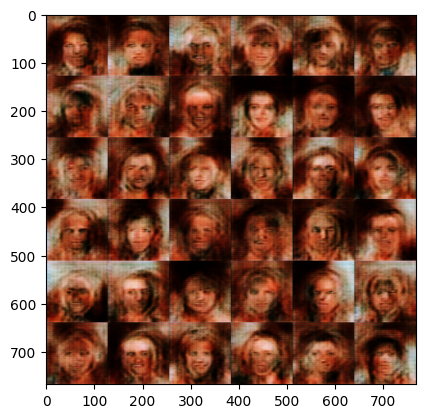

Training Progress:  10%|█         | 1500/15000 [08:13<1:38:56,  2.27step/s]

****************************************************************************************************
1/1 [==============================] - 0s 17ms/step


Training Progress:  10%|█         | 1501/15000 [08:13<1:30:12,  2.49step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  10%|█         | 1502/15000 [08:13<1:23:46,  2.69step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  10%|█         | 1503/15000 [08:14<1:19:11,  2.84step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  10%|█         | 1504/15000 [08:14<1:16:03,  2.96step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  10%|█         | 1505/15000 [08:14<1:13:48,  3.05step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  10%|█         | 1506/15000 [08:15<1:14:56,  3.00step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  10%|█         | 1507/15000 [08:15<1:13:34,  3.06step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  10%|█         | 1508/15000 [08:15<1:12:12,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  10%|█         | 1509/15000 [08:16<1:11:12,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  10%|█         | 1510/15000 [08:16<1:10:27,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  10%|█         | 1511/15000 [08:16<1:09:57,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  10%|█         | 1512/15000 [08:16<1:09:51,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  10%|█         | 1513/15000 [08:17<1:09:37,  3.23step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  10%|█         | 1514/15000 [08:17<1:09:41,  3.23step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  10%|█         | 1515/15000 [08:17<1:09:40,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  10%|█         | 1516/15000 [08:18<1:12:23,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  10%|█         | 1517/15000 [08:18<1:11:22,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  10%|█         | 1518/15000 [08:18<1:10:42,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  10%|█         | 1519/15000 [08:19<1:10:12,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  10%|█         | 1520/15000 [08:19<1:12:17,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  10%|█         | 1521/15000 [08:19<1:11:20,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  10%|█         | 1522/15000 [08:20<1:13:12,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  10%|█         | 1523/15000 [08:20<1:12:11,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  10%|█         | 1524/15000 [08:20<1:11:19,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  10%|█         | 1525/15000 [08:21<1:11:16,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  10%|█         | 1526/15000 [08:21<1:10:59,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  10%|█         | 1527/15000 [08:21<1:10:31,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  10%|█         | 1528/15000 [08:22<1:12:32,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  10%|█         | 1529/15000 [08:22<1:11:31,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  10%|█         | 1530/15000 [08:22<1:11:12,  3.15step/s]

1/1 [==============================] - 0s 29ms/step


Training Progress:  10%|█         | 1531/15000 [08:23<1:14:24,  3.02step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  10%|█         | 1532/15000 [08:23<1:12:54,  3.08step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  10%|█         | 1533/15000 [08:23<1:14:15,  3.02step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  10%|█         | 1534/15000 [08:24<1:12:52,  3.08step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  10%|█         | 1535/15000 [08:24<1:12:13,  3.11step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  10%|█         | 1536/15000 [08:24<1:11:23,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  10%|█         | 1537/15000 [08:24<1:10:41,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  10%|█         | 1538/15000 [08:25<1:10:48,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  10%|█         | 1539/15000 [08:25<1:10:13,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  10%|█         | 1540/15000 [08:25<1:09:50,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  10%|█         | 1541/15000 [08:26<1:09:34,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  10%|█         | 1542/15000 [08:26<1:09:34,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  10%|█         | 1543/15000 [08:26<1:09:33,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  10%|█         | 1544/15000 [08:27<1:10:01,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  10%|█         | 1545/15000 [08:27<1:09:47,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  10%|█         | 1546/15000 [08:27<1:09:43,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  10%|█         | 1547/15000 [08:28<1:10:04,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  10%|█         | 1548/15000 [08:28<1:09:48,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  10%|█         | 1549/15000 [08:28<1:09:28,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  10%|█         | 1550/15000 [08:29<1:09:23,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  10%|█         | 1551/15000 [08:29<1:09:11,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  10%|█         | 1552/15000 [08:29<1:09:13,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  10%|█         | 1553/15000 [08:29<1:09:35,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  10%|█         | 1554/15000 [08:30<1:09:40,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  10%|█         | 1555/15000 [08:30<1:09:32,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  10%|█         | 1556/15000 [08:30<1:11:56,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  10%|█         | 1557/15000 [08:31<1:11:06,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  10%|█         | 1558/15000 [08:31<1:10:40,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  10%|█         | 1559/15000 [08:31<1:10:09,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  10%|█         | 1560/15000 [08:32<1:09:54,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  10%|█         | 1561/15000 [08:32<1:09:43,  3.21step/s]

1/1 [==============================] - 0s 31ms/step


Training Progress:  10%|█         | 1562/15000 [08:32<1:14:26,  3.01step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  10%|█         | 1563/15000 [08:33<1:13:24,  3.05step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  10%|█         | 1564/15000 [08:33<1:14:52,  2.99step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  10%|█         | 1565/15000 [08:33<1:12:57,  3.07step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  10%|█         | 1566/15000 [08:34<1:14:12,  3.02step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  10%|█         | 1567/15000 [08:34<1:12:45,  3.08step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  10%|█         | 1568/15000 [08:34<1:11:26,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  10%|█         | 1569/15000 [08:35<1:10:44,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  10%|█         | 1570/15000 [08:35<1:10:21,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  10%|█         | 1571/15000 [08:35<1:09:40,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  10%|█         | 1572/15000 [08:35<1:09:43,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  10%|█         | 1573/15000 [08:36<1:09:27,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  10%|█         | 1574/15000 [08:36<1:09:06,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  10%|█         | 1575/15000 [08:36<1:08:58,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  11%|█         | 1576/15000 [08:37<1:09:06,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  11%|█         | 1577/15000 [08:37<1:09:10,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  11%|█         | 1578/15000 [08:37<1:11:25,  3.13step/s]

1/1 [==============================] - 0s 27ms/step


Training Progress:  11%|█         | 1579/15000 [08:38<1:16:28,  2.93step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  11%|█         | 1580/15000 [08:38<1:19:05,  2.83step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  11%|█         | 1581/15000 [08:39<1:25:36,  2.61step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  11%|█         | 1582/15000 [08:39<1:24:24,  2.65step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  11%|█         | 1583/15000 [08:39<1:19:39,  2.81step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  11%|█         | 1584/15000 [08:40<1:16:17,  2.93step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  11%|█         | 1585/15000 [08:40<1:13:58,  3.02step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  11%|█         | 1586/15000 [08:40<1:12:30,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  11%|█         | 1587/15000 [08:41<1:11:20,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  11%|█         | 1588/15000 [08:41<1:10:41,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  11%|█         | 1589/15000 [08:41<1:10:03,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  11%|█         | 1590/15000 [08:41<1:10:05,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  11%|█         | 1591/15000 [08:42<1:09:54,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  11%|█         | 1592/15000 [08:42<1:09:58,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  11%|█         | 1593/15000 [08:42<1:12:22,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  11%|█         | 1594/15000 [08:43<1:11:15,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  11%|█         | 1595/15000 [08:43<1:10:20,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  11%|█         | 1596/15000 [08:43<1:09:50,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  11%|█         | 1597/15000 [08:44<1:09:20,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  11%|█         | 1598/15000 [08:44<1:09:07,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  11%|█         | 1599/15000 [08:44<1:09:20,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  11%|█         | 1600/15000 [08:45<1:09:14,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  11%|█         | 1601/15000 [08:45<1:09:06,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  11%|█         | 1602/15000 [08:45<1:08:55,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  11%|█         | 1603/15000 [08:45<1:08:56,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  11%|█         | 1604/15000 [08:46<1:08:50,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  11%|█         | 1605/15000 [08:46<1:08:41,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  11%|█         | 1606/15000 [08:46<1:08:34,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  11%|█         | 1607/15000 [08:47<1:08:33,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  11%|█         | 1608/15000 [08:47<1:11:10,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  11%|█         | 1609/15000 [08:47<1:10:53,  3.15step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  11%|█         | 1610/15000 [08:48<1:29:49,  2.48step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  11%|█         | 1611/15000 [08:48<1:23:53,  2.66step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  11%|█         | 1612/15000 [08:49<1:19:46,  2.80step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  11%|█         | 1613/15000 [08:49<1:16:57,  2.90step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  11%|█         | 1614/15000 [08:49<1:14:52,  2.98step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  11%|█         | 1615/15000 [08:50<1:13:29,  3.04step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  11%|█         | 1616/15000 [08:50<1:12:32,  3.08step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  11%|█         | 1617/15000 [08:50<1:11:49,  3.11step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  11%|█         | 1618/15000 [08:50<1:11:24,  3.12step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  11%|█         | 1619/15000 [08:51<1:11:28,  3.12step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  11%|█         | 1620/15000 [08:51<1:13:40,  3.03step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  11%|█         | 1621/15000 [08:51<1:12:39,  3.07step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  11%|█         | 1622/15000 [08:52<1:11:54,  3.10step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  11%|█         | 1623/15000 [08:52<1:11:23,  3.12step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  11%|█         | 1624/15000 [08:52<1:13:25,  3.04step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  11%|█         | 1625/15000 [08:53<1:12:31,  3.07step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  11%|█         | 1626/15000 [08:53<1:14:25,  2.99step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  11%|█         | 1627/15000 [08:53<1:13:14,  3.04step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  11%|█         | 1628/15000 [08:54<1:12:53,  3.06step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  11%|█         | 1629/15000 [08:54<1:12:17,  3.08step/s]

1/1 [==============================] - 0s 23ms/step


Training Progress:  11%|█         | 1630/15000 [08:54<1:12:09,  3.09step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  11%|█         | 1631/15000 [08:55<1:11:40,  3.11step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  11%|█         | 1632/15000 [08:55<1:11:18,  3.12step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  11%|█         | 1633/15000 [08:55<1:13:31,  3.03step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  11%|█         | 1634/15000 [08:56<1:12:28,  3.07step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  11%|█         | 1635/15000 [08:56<1:12:02,  3.09step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  11%|█         | 1636/15000 [08:56<1:11:25,  3.12step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  11%|█         | 1637/15000 [08:57<1:11:22,  3.12step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  11%|█         | 1638/15000 [08:57<1:13:29,  3.03step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  11%|█         | 1639/15000 [08:57<1:12:22,  3.08step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  11%|█         | 1640/15000 [08:58<1:11:41,  3.11step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  11%|█         | 1641/15000 [08:58<1:11:10,  3.13step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  11%|█         | 1642/15000 [08:58<1:10:46,  3.15step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  11%|█         | 1643/15000 [08:59<1:10:27,  3.16step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  11%|█         | 1644/15000 [08:59<1:10:13,  3.17step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  11%|█         | 1645/15000 [08:59<1:10:05,  3.18step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  11%|█         | 1646/15000 [09:00<1:10:43,  3.15step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  11%|█         | 1647/15000 [09:00<1:10:36,  3.15step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  11%|█         | 1648/15000 [09:00<1:10:30,  3.16step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  11%|█         | 1649/15000 [09:00<1:10:22,  3.16step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  11%|█         | 1650/15000 [09:01<1:10:13,  3.17step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  11%|█         | 1651/15000 [09:01<1:10:18,  3.16step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  11%|█         | 1652/15000 [09:01<1:10:22,  3.16step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  11%|█         | 1653/15000 [09:02<1:12:44,  3.06step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  11%|█         | 1654/15000 [09:02<1:12:18,  3.08step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  11%|█         | 1655/15000 [09:02<1:14:33,  2.98step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  11%|█         | 1656/15000 [09:03<1:13:24,  3.03step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  11%|█         | 1657/15000 [09:03<1:12:29,  3.07step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  11%|█         | 1658/15000 [09:03<1:11:50,  3.09step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  11%|█         | 1659/15000 [09:04<1:11:19,  3.12step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  11%|█         | 1660/15000 [09:04<1:10:58,  3.13step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  11%|█         | 1661/15000 [09:04<1:10:40,  3.15step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  11%|█         | 1662/15000 [09:05<1:10:40,  3.15step/s]

1/1 [==============================] - 0s 23ms/step


Training Progress:  11%|█         | 1663/15000 [09:05<1:10:55,  3.13step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  11%|█         | 1664/15000 [09:05<1:11:04,  3.13step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  11%|█         | 1665/15000 [09:06<1:10:46,  3.14step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  11%|█         | 1666/15000 [09:06<1:10:44,  3.14step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  11%|█         | 1667/15000 [09:06<1:10:35,  3.15step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  11%|█         | 1668/15000 [09:07<1:10:33,  3.15step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  11%|█         | 1669/15000 [09:07<1:10:24,  3.16step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  11%|█         | 1670/15000 [09:07<1:10:16,  3.16step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  11%|█         | 1671/15000 [09:08<1:10:12,  3.16step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  11%|█         | 1672/15000 [09:08<1:09:59,  3.17step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  11%|█         | 1673/15000 [09:08<1:10:45,  3.14step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  11%|█         | 1674/15000 [09:08<1:10:36,  3.15step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  11%|█         | 1675/15000 [09:09<1:12:45,  3.05step/s]

1/1 [==============================] - 0s 30ms/step


Training Progress:  11%|█         | 1676/15000 [09:09<1:19:55,  2.78step/s]

1/1 [==============================] - 0s 42ms/step


Training Progress:  11%|█         | 1677/15000 [09:10<1:22:15,  2.70step/s]

1/1 [==============================] - 0s 29ms/step


Training Progress:  11%|█         | 1678/15000 [09:10<1:25:05,  2.61step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  11%|█         | 1679/15000 [09:10<1:23:36,  2.66step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  11%|█         | 1680/15000 [09:11<1:19:22,  2.80step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  11%|█         | 1681/15000 [09:11<1:16:22,  2.91step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  11%|█         | 1682/15000 [09:11<1:14:36,  2.98step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  11%|█         | 1683/15000 [09:12<1:12:55,  3.04step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  11%|█         | 1684/15000 [09:12<1:11:49,  3.09step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  11%|█         | 1685/15000 [09:12<1:11:04,  3.12step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  11%|█         | 1686/15000 [09:13<1:10:31,  3.15step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  11%|█         | 1687/15000 [09:13<1:10:12,  3.16step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  11%|█▏        | 1688/15000 [09:13<1:09:59,  3.17step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  11%|█▏        | 1689/15000 [09:14<1:09:41,  3.18step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  11%|█▏        | 1690/15000 [09:14<1:09:35,  3.19step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  11%|█▏        | 1691/15000 [09:14<1:09:56,  3.17step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  11%|█▏        | 1692/15000 [09:15<1:09:41,  3.18step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  11%|█▏        | 1693/15000 [09:15<1:09:36,  3.19step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  11%|█▏        | 1694/15000 [09:15<1:09:30,  3.19step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  11%|█▏        | 1695/15000 [09:15<1:09:18,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  11%|█▏        | 1696/15000 [09:16<1:09:07,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  11%|█▏        | 1697/15000 [09:16<1:09:03,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  11%|█▏        | 1698/15000 [09:16<1:08:58,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  11%|█▏        | 1699/15000 [09:17<1:08:54,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  11%|█▏        | 1700/15000 [09:17<1:09:26,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  11%|█▏        | 1701/15000 [09:17<1:09:22,  3.19step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  11%|█▏        | 1702/15000 [09:18<1:09:23,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  11%|█▏        | 1703/15000 [09:18<1:09:18,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  11%|█▏        | 1704/15000 [09:18<1:11:34,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  11%|█▏        | 1705/15000 [09:19<1:10:34,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  11%|█▏        | 1706/15000 [09:19<1:09:48,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  11%|█▏        | 1707/15000 [09:19<1:09:21,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  11%|█▏        | 1708/15000 [09:20<1:08:56,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  11%|█▏        | 1709/15000 [09:20<1:08:36,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  11%|█▏        | 1710/15000 [09:20<1:08:51,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  11%|█▏        | 1711/15000 [09:20<1:08:43,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  11%|█▏        | 1712/15000 [09:21<1:08:31,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  11%|█▏        | 1713/15000 [09:21<1:08:19,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  11%|█▏        | 1714/15000 [09:21<1:08:13,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  11%|█▏        | 1715/15000 [09:22<1:08:08,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  11%|█▏        | 1716/15000 [09:22<1:08:36,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  11%|█▏        | 1717/15000 [09:22<1:10:51,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  11%|█▏        | 1718/15000 [09:23<1:12:19,  3.06step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  11%|█▏        | 1719/15000 [09:23<1:11:32,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  11%|█▏        | 1720/15000 [09:23<1:10:33,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  11%|█▏        | 1721/15000 [09:24<1:09:55,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  11%|█▏        | 1722/15000 [09:24<1:09:22,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  11%|█▏        | 1723/15000 [09:24<1:08:56,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  11%|█▏        | 1724/15000 [09:25<1:08:42,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  12%|█▏        | 1725/15000 [09:25<1:10:50,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  12%|█▏        | 1726/15000 [09:25<1:10:08,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  12%|█▏        | 1727/15000 [09:26<1:09:33,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  12%|█▏        | 1728/15000 [09:26<1:09:30,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  12%|█▏        | 1729/15000 [09:26<1:09:09,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  12%|█▏        | 1730/15000 [09:26<1:08:50,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  12%|█▏        | 1731/15000 [09:27<1:08:42,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  12%|█▏        | 1732/15000 [09:27<1:10:54,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  12%|█▏        | 1733/15000 [09:27<1:10:02,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  12%|█▏        | 1734/15000 [09:28<1:09:22,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  12%|█▏        | 1735/15000 [09:28<1:11:23,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  12%|█▏        | 1736/15000 [09:28<1:10:18,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  12%|█▏        | 1737/15000 [09:29<1:10:00,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  12%|█▏        | 1738/15000 [09:29<1:09:28,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  12%|█▏        | 1739/15000 [09:29<1:09:02,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  12%|█▏        | 1740/15000 [09:30<1:08:46,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  12%|█▏        | 1741/15000 [09:30<1:08:35,  3.22step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  12%|█▏        | 1742/15000 [09:30<1:08:34,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  12%|█▏        | 1743/15000 [09:31<1:08:17,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  12%|█▏        | 1744/15000 [09:31<1:08:04,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  12%|█▏        | 1745/15000 [09:31<1:08:00,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  12%|█▏        | 1746/15000 [09:31<1:08:04,  3.25step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  12%|█▏        | 1747/15000 [09:32<1:08:45,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  12%|█▏        | 1748/15000 [09:32<1:08:41,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  12%|█▏        | 1749/15000 [09:32<1:11:46,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  12%|█▏        | 1750/15000 [09:33<1:10:37,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  12%|█▏        | 1751/15000 [09:33<1:09:56,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  12%|█▏        | 1752/15000 [09:33<1:09:22,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  12%|█▏        | 1753/15000 [09:34<1:09:05,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  12%|█▏        | 1754/15000 [09:34<1:09:09,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  12%|█▏        | 1755/15000 [09:34<1:09:05,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  12%|█▏        | 1756/15000 [09:35<1:09:06,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  12%|█▏        | 1757/15000 [09:35<1:09:06,  3.19step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  12%|█▏        | 1758/15000 [09:35<1:09:00,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  12%|█▏        | 1759/15000 [09:36<1:08:43,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  12%|█▏        | 1760/15000 [09:36<1:08:28,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  12%|█▏        | 1761/15000 [09:36<1:08:28,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  12%|█▏        | 1762/15000 [09:36<1:08:17,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  12%|█▏        | 1763/15000 [09:37<1:08:12,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  12%|█▏        | 1764/15000 [09:37<1:08:05,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  12%|█▏        | 1765/15000 [09:37<1:08:26,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  12%|█▏        | 1766/15000 [09:38<1:08:27,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  12%|█▏        | 1767/15000 [09:38<1:08:26,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  12%|█▏        | 1768/15000 [09:38<1:08:17,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  12%|█▏        | 1769/15000 [09:39<1:08:11,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  12%|█▏        | 1770/15000 [09:39<1:07:54,  3.25step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  12%|█▏        | 1771/15000 [09:39<1:08:01,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  12%|█▏        | 1772/15000 [09:40<1:07:59,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  12%|█▏        | 1773/15000 [09:40<1:07:58,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  12%|█▏        | 1774/15000 [09:40<1:10:44,  3.12step/s]

1/1 [==============================] - 0s 31ms/step


Training Progress:  12%|█▏        | 1775/15000 [09:41<1:18:03,  2.82step/s]

1/1 [==============================] - 0s 28ms/step


Training Progress:  12%|█▏        | 1776/15000 [09:41<1:24:33,  2.61step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  12%|█▏        | 1777/15000 [09:42<1:26:18,  2.55step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  12%|█▏        | 1778/15000 [09:42<1:23:41,  2.63step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  12%|█▏        | 1779/15000 [09:42<1:18:52,  2.79step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  12%|█▏        | 1780/15000 [09:42<1:16:07,  2.89step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  12%|█▏        | 1781/15000 [09:43<1:13:40,  2.99step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  12%|█▏        | 1782/15000 [09:43<1:11:38,  3.07step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:  12%|█▏        | 1783/15000 [09:43<1:10:17,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  12%|█▏        | 1784/15000 [09:44<1:09:38,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  12%|█▏        | 1785/15000 [09:44<1:09:03,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  12%|█▏        | 1786/15000 [09:44<1:08:38,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  12%|█▏        | 1787/15000 [09:45<1:10:56,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  12%|█▏        | 1788/15000 [09:45<1:09:54,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  12%|█▏        | 1789/15000 [09:45<1:09:25,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  12%|█▏        | 1790/15000 [09:46<1:08:51,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  12%|█▏        | 1791/15000 [09:46<1:08:34,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  12%|█▏        | 1792/15000 [09:46<1:08:37,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  12%|█▏        | 1793/15000 [09:47<1:08:48,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  12%|█▏        | 1794/15000 [09:47<1:08:30,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  12%|█▏        | 1795/15000 [09:47<1:08:25,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  12%|█▏        | 1796/15000 [09:47<1:08:11,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  12%|█▏        | 1797/15000 [09:48<1:12:50,  3.02step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  12%|█▏        | 1798/15000 [09:48<1:11:14,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  12%|█▏        | 1799/15000 [09:48<1:10:11,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  12%|█▏        | 1800/15000 [09:49<1:09:21,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  12%|█▏        | 1801/15000 [09:49<1:08:56,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  12%|█▏        | 1802/15000 [09:49<1:08:49,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  12%|█▏        | 1803/15000 [09:50<1:08:39,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  12%|█▏        | 1804/15000 [09:50<1:08:24,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  12%|█▏        | 1805/15000 [09:50<1:08:54,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  12%|█▏        | 1806/15000 [09:51<1:10:59,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  12%|█▏        | 1807/15000 [09:51<1:10:13,  3.13step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  12%|█▏        | 1808/15000 [09:51<1:09:35,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  12%|█▏        | 1809/15000 [09:52<1:09:10,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  12%|█▏        | 1810/15000 [09:52<1:08:42,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  12%|█▏        | 1811/15000 [09:52<1:09:10,  3.18step/s]

1/1 [==============================] - 0s 35ms/step


Training Progress:  12%|█▏        | 1812/15000 [09:53<1:11:26,  3.08step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  12%|█▏        | 1813/15000 [09:53<1:10:38,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  12%|█▏        | 1814/15000 [09:53<1:09:40,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  12%|█▏        | 1815/15000 [09:53<1:09:11,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  12%|█▏        | 1816/15000 [09:54<1:08:48,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  12%|█▏        | 1817/15000 [09:54<1:10:49,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  12%|█▏        | 1818/15000 [09:54<1:09:54,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  12%|█▏        | 1819/15000 [09:55<1:09:25,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  12%|█▏        | 1820/15000 [09:55<1:08:48,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  12%|█▏        | 1821/15000 [09:55<1:09:01,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  12%|█▏        | 1822/15000 [09:56<1:08:42,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  12%|█▏        | 1823/15000 [09:56<1:08:38,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  12%|█▏        | 1824/15000 [09:56<1:10:46,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  12%|█▏        | 1825/15000 [09:57<1:10:00,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  12%|█▏        | 1826/15000 [09:57<1:09:10,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  12%|█▏        | 1827/15000 [09:57<1:08:45,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  12%|█▏        | 1828/15000 [09:58<1:08:30,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  12%|█▏        | 1829/15000 [09:58<1:10:44,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  12%|█▏        | 1830/15000 [09:58<1:10:35,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  12%|█▏        | 1831/15000 [09:59<1:09:40,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  12%|█▏        | 1832/15000 [09:59<1:11:40,  3.06step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  12%|█▏        | 1833/15000 [09:59<1:10:45,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  12%|█▏        | 1834/15000 [10:00<1:10:01,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  12%|█▏        | 1835/15000 [10:00<1:09:31,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  12%|█▏        | 1836/15000 [10:00<1:09:02,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  12%|█▏        | 1837/15000 [10:00<1:08:39,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  12%|█▏        | 1838/15000 [10:01<1:08:14,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  12%|█▏        | 1839/15000 [10:01<1:10:38,  3.11step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  12%|█▏        | 1840/15000 [10:01<1:09:55,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  12%|█▏        | 1841/15000 [10:02<1:09:15,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  12%|█▏        | 1842/15000 [10:02<1:08:49,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  12%|█▏        | 1843/15000 [10:02<1:11:14,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  12%|█▏        | 1844/15000 [10:03<1:10:01,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  12%|█▏        | 1845/15000 [10:03<1:09:23,  3.16step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  12%|█▏        | 1846/15000 [10:03<1:09:06,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  12%|█▏        | 1847/15000 [10:04<1:10:47,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  12%|█▏        | 1848/15000 [10:04<1:10:11,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  12%|█▏        | 1849/15000 [10:04<1:09:34,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  12%|█▏        | 1850/15000 [10:05<1:08:56,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  12%|█▏        | 1851/15000 [10:05<1:08:34,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  12%|█▏        | 1852/15000 [10:05<1:08:11,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  12%|█▏        | 1853/15000 [10:06<1:07:59,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  12%|█▏        | 1854/15000 [10:06<1:07:35,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  12%|█▏        | 1855/15000 [10:06<1:07:20,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  12%|█▏        | 1856/15000 [10:06<1:07:18,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  12%|█▏        | 1857/15000 [10:07<1:07:13,  3.26step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  12%|█▏        | 1858/15000 [10:07<1:10:21,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  12%|█▏        | 1859/15000 [10:07<1:09:55,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  12%|█▏        | 1860/15000 [10:08<1:09:14,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  12%|█▏        | 1861/15000 [10:08<1:08:43,  3.19step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  12%|█▏        | 1862/15000 [10:08<1:08:43,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  12%|█▏        | 1863/15000 [10:09<1:10:50,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  12%|█▏        | 1864/15000 [10:09<1:09:56,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  12%|█▏        | 1865/15000 [10:09<1:11:32,  3.06step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  12%|█▏        | 1866/15000 [10:10<1:10:14,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  12%|█▏        | 1867/15000 [10:10<1:09:47,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  12%|█▏        | 1868/15000 [10:10<1:09:06,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  12%|█▏        | 1869/15000 [10:11<1:08:46,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  12%|█▏        | 1870/15000 [10:11<1:08:27,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  12%|█▏        | 1871/15000 [10:11<1:08:10,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  12%|█▏        | 1872/15000 [10:12<1:08:02,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  12%|█▏        | 1873/15000 [10:12<1:10:16,  3.11step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  12%|█▏        | 1874/15000 [10:12<1:15:15,  2.91step/s]

1/1 [==============================] - 0s 32ms/step


Training Progress:  12%|█▎        | 1875/15000 [10:13<1:20:00,  2.73step/s]

1/1 [==============================] - 0s 28ms/step


Training Progress:  13%|█▎        | 1876/15000 [10:13<1:23:22,  2.62step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  13%|█▎        | 1877/15000 [10:13<1:18:43,  2.78step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  13%|█▎        | 1878/15000 [10:14<1:15:18,  2.90step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 1879/15000 [10:14<1:13:00,  3.00step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 1880/15000 [10:14<1:13:39,  2.97step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 1881/15000 [10:15<1:11:53,  3.04step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  13%|█▎        | 1882/15000 [10:15<1:10:52,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 1883/15000 [10:15<1:10:03,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 1884/15000 [10:16<1:09:08,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  13%|█▎        | 1885/15000 [10:16<1:09:02,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  13%|█▎        | 1886/15000 [10:16<1:08:36,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  13%|█▎        | 1887/15000 [10:17<1:08:15,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  13%|█▎        | 1888/15000 [10:17<1:08:03,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 1889/15000 [10:17<1:10:03,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 1890/15000 [10:18<1:09:07,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 1891/15000 [10:18<1:08:27,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 1892/15000 [10:18<1:08:03,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 1893/15000 [10:18<1:07:48,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 1894/15000 [10:19<1:12:18,  3.02step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  13%|█▎        | 1895/15000 [10:19<1:11:14,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  13%|█▎        | 1896/15000 [10:19<1:10:08,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 1897/15000 [10:20<1:09:25,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  13%|█▎        | 1898/15000 [10:20<1:08:46,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  13%|█▎        | 1899/15000 [10:20<1:08:34,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  13%|█▎        | 1900/15000 [10:21<1:08:05,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 1901/15000 [10:21<1:07:50,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  13%|█▎        | 1902/15000 [10:21<1:10:02,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  13%|█▎        | 1903/15000 [10:22<1:09:18,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  13%|█▎        | 1904/15000 [10:22<1:09:15,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  13%|█▎        | 1905/15000 [10:22<1:09:28,  3.14step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  13%|█▎        | 1906/15000 [10:23<1:10:59,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  13%|█▎        | 1907/15000 [10:23<1:12:21,  3.02step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 1908/15000 [10:23<1:10:51,  3.08step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  13%|█▎        | 1909/15000 [10:24<1:09:54,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 1910/15000 [10:24<1:09:11,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 1911/15000 [10:24<1:08:36,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  13%|█▎        | 1912/15000 [10:25<1:08:14,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  13%|█▎        | 1913/15000 [10:25<1:08:23,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 1914/15000 [10:25<1:07:55,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 1915/15000 [10:25<1:10:09,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 1916/15000 [10:26<1:09:05,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 1917/15000 [10:26<1:10:56,  3.07step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 1918/15000 [10:26<1:09:54,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 1919/15000 [10:27<1:08:58,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 1920/15000 [10:27<1:08:09,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 1921/15000 [10:27<1:07:45,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 1922/15000 [10:28<1:07:53,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 1923/15000 [10:28<1:07:38,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 1924/15000 [10:28<1:07:24,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  13%|█▎        | 1925/15000 [10:29<1:07:24,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 1926/15000 [10:29<1:07:32,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 1927/15000 [10:29<1:07:24,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 1928/15000 [10:30<1:07:22,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  13%|█▎        | 1929/15000 [10:30<1:07:30,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  13%|█▎        | 1930/15000 [10:30<1:07:32,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 1931/15000 [10:30<1:07:36,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  13%|█▎        | 1932/15000 [10:31<1:08:02,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 1933/15000 [10:31<1:07:51,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 1934/15000 [10:31<1:07:47,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  13%|█▎        | 1935/15000 [10:32<1:07:49,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  13%|█▎        | 1936/15000 [10:32<1:08:05,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  13%|█▎        | 1937/15000 [10:32<1:08:18,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 1938/15000 [10:33<1:08:16,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  13%|█▎        | 1939/15000 [10:33<1:08:03,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  13%|█▎        | 1940/15000 [10:33<1:07:51,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  13%|█▎        | 1941/15000 [10:34<1:07:56,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  13%|█▎        | 1942/15000 [10:34<1:07:56,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  13%|█▎        | 1943/15000 [10:34<1:07:49,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  13%|█▎        | 1944/15000 [10:35<1:07:40,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  13%|█▎        | 1945/15000 [10:35<1:07:38,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  13%|█▎        | 1946/15000 [10:35<1:07:36,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 1947/15000 [10:35<1:07:29,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 1948/15000 [10:36<1:07:33,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 1949/15000 [10:36<1:07:25,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  13%|█▎        | 1950/15000 [10:36<1:07:51,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  13%|█▎        | 1951/15000 [10:37<1:07:42,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  13%|█▎        | 1952/15000 [10:37<1:07:38,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  13%|█▎        | 1953/15000 [10:37<1:07:32,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  13%|█▎        | 1954/15000 [10:38<1:07:29,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  13%|█▎        | 1955/15000 [10:38<1:07:25,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  13%|█▎        | 1956/15000 [10:38<1:07:30,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 1957/15000 [10:39<1:07:27,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 1958/15000 [10:39<1:07:19,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  13%|█▎        | 1959/15000 [10:39<1:07:36,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  13%|█▎        | 1960/15000 [10:40<1:10:08,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 1961/15000 [10:40<1:09:14,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  13%|█▎        | 1962/15000 [10:40<1:08:39,  3.17step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  13%|█▎        | 1963/15000 [10:40<1:08:53,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  13%|█▎        | 1964/15000 [10:41<1:08:21,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 1965/15000 [10:41<1:10:22,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 1966/15000 [10:41<1:09:41,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 1967/15000 [10:42<1:11:18,  3.05step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 1968/15000 [10:42<1:10:24,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  13%|█▎        | 1969/15000 [10:42<1:10:43,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  13%|█▎        | 1970/15000 [10:43<1:09:49,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 1971/15000 [10:43<1:09:04,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 1972/15000 [10:43<1:08:55,  3.15step/s]

1/1 [==============================] - 0s 27ms/step


Training Progress:  13%|█▎        | 1973/15000 [10:44<1:15:26,  2.88step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  13%|█▎        | 1974/15000 [10:44<1:17:33,  2.80step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  13%|█▎        | 1975/15000 [10:45<1:23:12,  2.61step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 1976/15000 [10:45<1:18:20,  2.77step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 1977/15000 [10:45<1:14:56,  2.90step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  13%|█▎        | 1978/15000 [10:46<1:13:06,  2.97step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  13%|█▎        | 1979/15000 [10:46<1:11:21,  3.04step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  13%|█▎        | 1980/15000 [10:46<1:10:02,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 1981/15000 [10:46<1:11:29,  3.03step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 1982/15000 [10:47<1:10:08,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  13%|█▎        | 1983/15000 [10:47<1:09:14,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  13%|█▎        | 1984/15000 [10:47<1:08:39,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 1985/15000 [10:48<1:08:13,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  13%|█▎        | 1986/15000 [10:48<1:07:57,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  13%|█▎        | 1987/15000 [10:48<1:08:06,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  13%|█▎        | 1988/15000 [10:49<1:07:53,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  13%|█▎        | 1989/15000 [10:49<1:07:44,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 1990/15000 [10:49<1:07:29,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 1991/15000 [10:50<1:09:34,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 1992/15000 [10:50<1:08:39,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 1993/15000 [10:50<1:07:54,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 1994/15000 [10:51<1:07:30,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 1995/15000 [10:51<1:07:10,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  13%|█▎        | 1996/15000 [10:51<1:07:27,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  13%|█▎        | 1997/15000 [10:51<1:07:28,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  13%|█▎        | 1998/15000 [10:52<1:07:18,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 1999/15000 [10:52<1:07:04,  3.23step/s]

1/1 [==============================] - 0s 16ms/step
****************************************************************************************************
2000/15000: d_loss: 0.132914,  g_loss: 0.022632
2/2 [==============================] - 0s 20ms/step


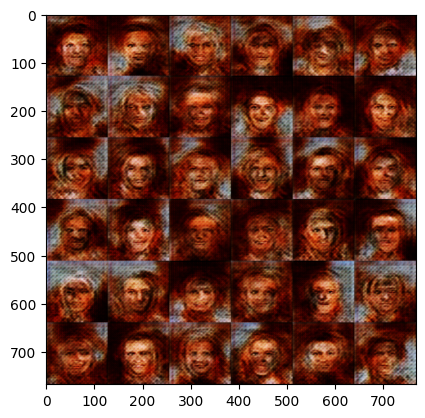

Training Progress:  13%|█▎        | 2000/15000 [10:53<1:38:11,  2.21step/s]

****************************************************************************************************
1/1 [==============================] - 0s 17ms/step


Training Progress:  13%|█▎        | 2001/15000 [10:53<1:29:22,  2.42step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 2002/15000 [10:54<1:24:57,  2.55step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 2003/15000 [10:54<1:19:33,  2.72step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 2004/15000 [10:54<1:15:40,  2.86step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 2005/15000 [10:54<1:13:03,  2.96step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 2006/15000 [10:55<1:11:06,  3.05step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 2007/15000 [10:55<1:09:47,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 2008/15000 [10:55<1:08:49,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  13%|█▎        | 2009/15000 [10:56<1:11:18,  3.04step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  13%|█▎        | 2010/15000 [10:56<1:10:03,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  13%|█▎        | 2011/15000 [10:56<1:09:19,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 2012/15000 [10:57<1:08:36,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 2013/15000 [10:57<1:08:09,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  13%|█▎        | 2014/15000 [10:57<1:10:08,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 2015/15000 [10:58<1:09:28,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 2016/15000 [10:58<1:08:40,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 2017/15000 [10:58<1:10:26,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  13%|█▎        | 2018/15000 [10:59<1:12:06,  3.00step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 2019/15000 [10:59<1:10:34,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  13%|█▎        | 2020/15000 [10:59<1:09:28,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 2021/15000 [11:00<1:08:45,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 2022/15000 [11:00<1:08:13,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 2023/15000 [11:00<1:07:50,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  13%|█▎        | 2024/15000 [11:01<1:07:39,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  14%|█▎        | 2025/15000 [11:01<1:07:25,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  14%|█▎        | 2026/15000 [11:01<1:07:14,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  14%|█▎        | 2027/15000 [11:01<1:07:27,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  14%|█▎        | 2028/15000 [11:02<1:07:22,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  14%|█▎        | 2029/15000 [11:02<1:07:15,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  14%|█▎        | 2030/15000 [11:02<1:07:50,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  14%|█▎        | 2031/15000 [11:03<1:09:59,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  14%|█▎        | 2032/15000 [11:03<1:11:19,  3.03step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  14%|█▎        | 2033/15000 [11:03<1:10:04,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  14%|█▎        | 2034/15000 [11:04<1:08:58,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  14%|█▎        | 2035/15000 [11:04<1:08:14,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  14%|█▎        | 2036/15000 [11:04<1:08:00,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  14%|█▎        | 2037/15000 [11:05<1:07:36,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  14%|█▎        | 2038/15000 [11:05<1:07:19,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  14%|█▎        | 2039/15000 [11:05<1:07:06,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  14%|█▎        | 2040/15000 [11:06<1:07:10,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  14%|█▎        | 2041/15000 [11:06<1:07:23,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  14%|█▎        | 2042/15000 [11:06<1:07:09,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  14%|█▎        | 2043/15000 [11:06<1:07:01,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  14%|█▎        | 2044/15000 [11:07<1:06:46,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  14%|█▎        | 2045/15000 [11:07<1:06:44,  3.24step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  14%|█▎        | 2046/15000 [11:07<1:06:54,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  14%|█▎        | 2047/15000 [11:08<1:07:03,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  14%|█▎        | 2048/15000 [11:08<1:06:57,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  14%|█▎        | 2049/15000 [11:08<1:07:02,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  14%|█▎        | 2050/15000 [11:09<1:06:48,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  14%|█▎        | 2051/15000 [11:09<1:06:45,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  14%|█▎        | 2052/15000 [11:09<1:06:41,  3.24step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  14%|█▎        | 2053/15000 [11:10<1:06:56,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  14%|█▎        | 2054/15000 [11:10<1:06:45,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  14%|█▎        | 2055/15000 [11:10<1:07:08,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  14%|█▎        | 2056/15000 [11:11<1:09:16,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  14%|█▎        | 2057/15000 [11:11<1:08:39,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  14%|█▎        | 2058/15000 [11:11<1:07:54,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  14%|█▎        | 2059/15000 [11:11<1:07:37,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  14%|█▎        | 2060/15000 [11:12<1:07:15,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  14%|█▎        | 2061/15000 [11:12<1:07:07,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  14%|█▎        | 2062/15000 [11:12<1:09:22,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  14%|█▍        | 2063/15000 [11:13<1:08:29,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  14%|█▍        | 2064/15000 [11:13<1:08:12,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  14%|█▍        | 2065/15000 [11:13<1:07:37,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  14%|█▍        | 2066/15000 [11:14<1:07:19,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  14%|█▍        | 2067/15000 [11:14<1:07:06,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  14%|█▍        | 2068/15000 [11:14<1:06:44,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  14%|█▍        | 2069/15000 [11:15<1:06:47,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  14%|█▍        | 2070/15000 [11:15<1:13:07,  2.95step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  14%|█▍        | 2071/15000 [11:15<1:19:59,  2.69step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  14%|█▍        | 2072/15000 [11:16<1:24:57,  2.54step/s]

1/1 [==============================] - 0s 23ms/step


Training Progress:  14%|█▍        | 2073/15000 [11:16<1:21:06,  2.66step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  14%|█▍        | 2074/15000 [11:17<1:16:52,  2.80step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  14%|█▍        | 2075/15000 [11:17<1:13:53,  2.92step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  14%|█▍        | 2076/15000 [11:17<1:11:48,  3.00step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  14%|█▍        | 2077/15000 [11:17<1:10:01,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  14%|█▍        | 2078/15000 [11:18<1:08:48,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  14%|█▍        | 2079/15000 [11:18<1:08:08,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  14%|█▍        | 2080/15000 [11:18<1:07:28,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  14%|█▍        | 2081/15000 [11:19<1:07:10,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  14%|█▍        | 2082/15000 [11:19<1:06:57,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  14%|█▍        | 2083/15000 [11:19<1:07:08,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  14%|█▍        | 2084/15000 [11:20<1:07:05,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  14%|█▍        | 2085/15000 [11:20<1:07:01,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  14%|█▍        | 2086/15000 [11:20<1:06:48,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  14%|█▍        | 2087/15000 [11:21<1:06:53,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  14%|█▍        | 2088/15000 [11:21<1:06:42,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  14%|█▍        | 2089/15000 [11:21<1:06:28,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  14%|█▍        | 2090/15000 [11:22<1:06:33,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  14%|█▍        | 2091/15000 [11:22<1:06:53,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  14%|█▍        | 2092/15000 [11:22<1:07:09,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  14%|█▍        | 2093/15000 [11:22<1:09:19,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  14%|█▍        | 2094/15000 [11:23<1:08:33,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  14%|█▍        | 2095/15000 [11:23<1:07:58,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  14%|█▍        | 2096/15000 [11:23<1:07:34,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  14%|█▍        | 2097/15000 [11:24<1:07:26,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  14%|█▍        | 2098/15000 [11:24<1:07:13,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  14%|█▍        | 2099/15000 [11:24<1:07:03,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  14%|█▍        | 2100/15000 [11:25<1:09:18,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  14%|█▍        | 2101/15000 [11:25<1:08:55,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  14%|█▍        | 2102/15000 [11:25<1:10:38,  3.04step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  14%|█▍        | 2103/15000 [11:26<1:09:28,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  14%|█▍        | 2104/15000 [11:26<1:08:38,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  14%|█▍        | 2105/15000 [11:26<1:07:56,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  14%|█▍        | 2106/15000 [11:27<1:07:43,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  14%|█▍        | 2107/15000 [11:27<1:07:20,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  14%|█▍        | 2108/15000 [11:27<1:07:06,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  14%|█▍        | 2109/15000 [11:28<1:06:58,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  14%|█▍        | 2110/15000 [11:28<1:07:08,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  14%|█▍        | 2111/15000 [11:28<1:06:57,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  14%|█▍        | 2112/15000 [11:28<1:09:13,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  14%|█▍        | 2113/15000 [11:29<1:08:23,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  14%|█▍        | 2114/15000 [11:29<1:07:59,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  14%|█▍        | 2115/15000 [11:29<1:07:25,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  14%|█▍        | 2116/15000 [11:30<1:07:13,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  14%|█▍        | 2117/15000 [11:30<1:06:53,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  14%|█▍        | 2118/15000 [11:30<1:06:36,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  14%|█▍        | 2119/15000 [11:31<1:06:47,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  14%|█▍        | 2120/15000 [11:31<1:06:51,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  14%|█▍        | 2121/15000 [11:31<1:06:32,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  14%|█▍        | 2122/15000 [11:32<1:06:22,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  14%|█▍        | 2123/15000 [11:32<1:06:07,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  14%|█▍        | 2124/15000 [11:32<1:07:05,  3.20step/s]

1/1 [==============================] - 0s 41ms/step


Training Progress:  14%|█▍        | 2125/15000 [11:33<1:09:15,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  14%|█▍        | 2126/15000 [11:33<1:08:29,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  14%|█▍        | 2127/15000 [11:33<1:07:41,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  14%|█▍        | 2128/15000 [11:33<1:07:27,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  14%|█▍        | 2129/15000 [11:34<1:07:21,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  14%|█▍        | 2130/15000 [11:34<1:07:06,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  14%|█▍        | 2131/15000 [11:34<1:06:44,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  14%|█▍        | 2132/15000 [11:35<1:06:40,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  14%|█▍        | 2133/15000 [11:35<1:06:28,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  14%|█▍        | 2134/15000 [11:35<1:06:26,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  14%|█▍        | 2135/15000 [11:36<1:06:20,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  14%|█▍        | 2136/15000 [11:36<1:06:25,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  14%|█▍        | 2137/15000 [11:36<1:06:18,  3.23step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  14%|█▍        | 2138/15000 [11:37<1:09:32,  3.08step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  14%|█▍        | 2139/15000 [11:37<1:10:58,  3.02step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  14%|█▍        | 2140/15000 [11:37<1:09:47,  3.07step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  14%|█▍        | 2141/15000 [11:38<1:08:39,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  14%|█▍        | 2142/15000 [11:38<1:10:15,  3.05step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  14%|█▍        | 2143/15000 [11:38<1:08:54,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  14%|█▍        | 2144/15000 [11:39<1:07:59,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  14%|█▍        | 2145/15000 [11:39<1:09:34,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  14%|█▍        | 2146/15000 [11:39<1:08:36,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  14%|█▍        | 2147/15000 [11:40<1:08:20,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  14%|█▍        | 2148/15000 [11:40<1:07:39,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  14%|█▍        | 2149/15000 [11:40<1:07:13,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  14%|█▍        | 2150/15000 [11:40<1:06:58,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  14%|█▍        | 2151/15000 [11:41<1:06:49,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  14%|█▍        | 2152/15000 [11:41<1:06:31,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  14%|█▍        | 2153/15000 [11:41<1:06:23,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  14%|█▍        | 2154/15000 [11:42<1:06:17,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  14%|█▍        | 2155/15000 [11:42<1:06:20,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  14%|█▍        | 2156/15000 [11:42<1:08:27,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  14%|█▍        | 2157/15000 [11:43<1:08:18,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  14%|█▍        | 2158/15000 [11:43<1:07:37,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  14%|█▍        | 2159/15000 [11:43<1:07:16,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  14%|█▍        | 2160/15000 [11:44<1:06:49,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  14%|█▍        | 2161/15000 [11:44<1:06:40,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  14%|█▍        | 2162/15000 [11:44<1:06:23,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  14%|█▍        | 2163/15000 [11:45<1:06:19,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  14%|█▍        | 2164/15000 [11:45<1:06:10,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  14%|█▍        | 2165/15000 [11:45<1:06:11,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  14%|█▍        | 2166/15000 [11:45<1:06:39,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  14%|█▍        | 2167/15000 [11:46<1:06:40,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  14%|█▍        | 2168/15000 [11:46<1:06:30,  3.22step/s]

1/1 [==============================] - 0s 33ms/step


Training Progress:  14%|█▍        | 2169/15000 [11:46<1:11:47,  2.98step/s]

1/1 [==============================] - 0s 34ms/step


Training Progress:  14%|█▍        | 2170/15000 [11:47<1:17:01,  2.78step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  14%|█▍        | 2171/15000 [11:47<1:18:08,  2.74step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  14%|█▍        | 2172/15000 [11:48<1:17:51,  2.75step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  14%|█▍        | 2173/15000 [11:48<1:14:14,  2.88step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  14%|█▍        | 2174/15000 [11:48<1:13:58,  2.89step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  14%|█▍        | 2175/15000 [11:49<1:11:57,  2.97step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  15%|█▍        | 2176/15000 [11:49<1:12:21,  2.95step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  15%|█▍        | 2177/15000 [11:49<1:10:30,  3.03step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  15%|█▍        | 2178/15000 [11:50<1:09:07,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  15%|█▍        | 2179/15000 [11:50<1:08:08,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  15%|█▍        | 2180/15000 [11:50<1:07:15,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  15%|█▍        | 2181/15000 [11:50<1:06:55,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  15%|█▍        | 2182/15000 [11:51<1:08:44,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  15%|█▍        | 2183/15000 [11:51<1:10:09,  3.04step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  15%|█▍        | 2184/15000 [11:51<1:09:03,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  15%|█▍        | 2185/15000 [11:52<1:08:16,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  15%|█▍        | 2186/15000 [11:52<1:09:42,  3.06step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  15%|█▍        | 2187/15000 [11:52<1:08:41,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  15%|█▍        | 2188/15000 [11:53<1:07:52,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  15%|█▍        | 2189/15000 [11:53<1:07:14,  3.18step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  15%|█▍        | 2190/15000 [11:53<1:06:47,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  15%|█▍        | 2191/15000 [11:54<1:06:43,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  15%|█▍        | 2192/15000 [11:54<1:06:18,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  15%|█▍        | 2193/15000 [11:54<1:06:10,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  15%|█▍        | 2194/15000 [11:55<1:08:38,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  15%|█▍        | 2195/15000 [11:55<1:07:53,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  15%|█▍        | 2196/15000 [11:55<1:07:13,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  15%|█▍        | 2197/15000 [11:56<1:06:54,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  15%|█▍        | 2198/15000 [11:56<1:06:30,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  15%|█▍        | 2199/15000 [11:56<1:06:19,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  15%|█▍        | 2200/15000 [11:56<1:06:10,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  15%|█▍        | 2201/15000 [11:57<1:09:02,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  15%|█▍        | 2202/15000 [11:57<1:08:08,  3.13step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  15%|█▍        | 2203/15000 [11:58<1:10:10,  3.04step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  15%|█▍        | 2204/15000 [11:58<1:09:01,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  15%|█▍        | 2205/15000 [11:58<1:08:06,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  15%|█▍        | 2206/15000 [11:58<1:07:22,  3.16step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  15%|█▍        | 2207/15000 [11:59<1:06:57,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  15%|█▍        | 2208/15000 [11:59<1:06:34,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  15%|█▍        | 2209/15000 [11:59<1:06:13,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  15%|█▍        | 2210/15000 [12:00<1:06:00,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  15%|█▍        | 2211/15000 [12:00<1:05:43,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  15%|█▍        | 2212/15000 [12:00<1:06:02,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  15%|█▍        | 2213/15000 [12:01<1:05:59,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  15%|█▍        | 2214/15000 [12:01<1:06:03,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  15%|█▍        | 2215/15000 [12:01<1:05:53,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  15%|█▍        | 2216/15000 [12:02<1:05:53,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  15%|█▍        | 2217/15000 [12:02<1:05:43,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  15%|█▍        | 2218/15000 [12:02<1:05:46,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  15%|█▍        | 2219/15000 [12:02<1:05:37,  3.25step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  15%|█▍        | 2220/15000 [12:03<1:05:56,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  15%|█▍        | 2221/15000 [12:03<1:06:11,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  15%|█▍        | 2222/15000 [12:03<1:06:12,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  15%|█▍        | 2223/15000 [12:04<1:06:01,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  15%|█▍        | 2224/15000 [12:04<1:06:19,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  15%|█▍        | 2225/15000 [12:04<1:08:25,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  15%|█▍        | 2226/15000 [12:05<1:07:36,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  15%|█▍        | 2227/15000 [12:05<1:07:08,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  15%|█▍        | 2228/15000 [12:05<1:06:48,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  15%|█▍        | 2229/15000 [12:06<1:06:28,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  15%|█▍        | 2230/15000 [12:06<1:06:15,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  15%|█▍        | 2231/15000 [12:06<1:06:23,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  15%|█▍        | 2232/15000 [12:07<1:06:22,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  15%|█▍        | 2233/15000 [12:07<1:06:18,  3.21step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  15%|█▍        | 2234/15000 [12:07<1:06:39,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  15%|█▍        | 2235/15000 [12:07<1:08:34,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  15%|█▍        | 2236/15000 [12:08<1:07:54,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  15%|█▍        | 2237/15000 [12:08<1:07:08,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  15%|█▍        | 2238/15000 [12:08<1:06:49,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  15%|█▍        | 2239/15000 [12:09<1:08:43,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  15%|█▍        | 2240/15000 [12:09<1:08:17,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  15%|█▍        | 2241/15000 [12:09<1:07:28,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  15%|█▍        | 2242/15000 [12:10<1:07:07,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  15%|█▍        | 2243/15000 [12:10<1:06:35,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  15%|█▍        | 2244/15000 [12:10<1:06:24,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  15%|█▍        | 2245/15000 [12:11<1:06:03,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  15%|█▍        | 2246/15000 [12:11<1:05:59,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  15%|█▍        | 2247/15000 [12:11<1:05:40,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  15%|█▍        | 2248/15000 [12:12<1:05:43,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  15%|█▍        | 2249/15000 [12:12<1:05:59,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  15%|█▌        | 2250/15000 [12:12<1:05:56,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  15%|█▌        | 2251/15000 [12:13<1:08:51,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  15%|█▌        | 2252/15000 [12:13<1:07:57,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  15%|█▌        | 2253/15000 [12:13<1:06:57,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  15%|█▌        | 2254/15000 [12:13<1:06:29,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  15%|█▌        | 2255/15000 [12:14<1:06:16,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  15%|█▌        | 2256/15000 [12:14<1:06:05,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  15%|█▌        | 2257/15000 [12:14<1:06:10,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  15%|█▌        | 2258/15000 [12:15<1:06:20,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  15%|█▌        | 2259/15000 [12:15<1:06:09,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  15%|█▌        | 2260/15000 [12:15<1:06:03,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  15%|█▌        | 2261/15000 [12:16<1:05:50,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  15%|█▌        | 2262/15000 [12:16<1:05:47,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  15%|█▌        | 2263/15000 [12:16<1:05:41,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  15%|█▌        | 2264/15000 [12:17<1:05:37,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  15%|█▌        | 2265/15000 [12:17<1:05:27,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  15%|█▌        | 2266/15000 [12:17<1:05:30,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  15%|█▌        | 2267/15000 [12:17<1:05:15,  3.25step/s]

1/1 [==============================] - 0s 34ms/step


Training Progress:  15%|█▌        | 2268/15000 [12:18<1:09:22,  3.06step/s]

1/1 [==============================] - 0s 27ms/step


Training Progress:  15%|█▌        | 2269/15000 [12:18<1:14:40,  2.84step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  15%|█▌        | 2270/15000 [12:19<1:21:01,  2.62step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  15%|█▌        | 2271/15000 [12:19<1:19:44,  2.66step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  15%|█▌        | 2272/15000 [12:19<1:15:25,  2.81step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  15%|█▌        | 2273/15000 [12:20<1:12:43,  2.92step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  15%|█▌        | 2274/15000 [12:20<1:10:28,  3.01step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  15%|█▌        | 2275/15000 [12:20<1:09:04,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  15%|█▌        | 2276/15000 [12:21<1:07:55,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  15%|█▌        | 2277/15000 [12:21<1:07:36,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  15%|█▌        | 2278/15000 [12:21<1:07:00,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  15%|█▌        | 2279/15000 [12:22<1:06:39,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  15%|█▌        | 2280/15000 [12:22<1:06:25,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  15%|█▌        | 2281/15000 [12:22<1:06:10,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  15%|█▌        | 2282/15000 [12:23<1:09:46,  3.04step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  15%|█▌        | 2283/15000 [12:23<1:08:50,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  15%|█▌        | 2284/15000 [12:23<1:07:46,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  15%|█▌        | 2285/15000 [12:23<1:06:56,  3.17step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  15%|█▌        | 2286/15000 [12:24<1:07:05,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  15%|█▌        | 2287/15000 [12:24<1:06:51,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  15%|█▌        | 2288/15000 [12:24<1:06:34,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  15%|█▌        | 2289/15000 [12:25<1:06:09,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  15%|█▌        | 2290/15000 [12:25<1:05:47,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  15%|█▌        | 2291/15000 [12:25<1:05:35,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  15%|█▌        | 2292/15000 [12:26<1:05:19,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  15%|█▌        | 2293/15000 [12:26<1:07:32,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  15%|█▌        | 2294/15000 [12:26<1:06:43,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  15%|█▌        | 2295/15000 [12:27<1:06:29,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  15%|█▌        | 2296/15000 [12:27<1:06:14,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  15%|█▌        | 2297/15000 [12:27<1:06:03,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  15%|█▌        | 2298/15000 [12:28<1:05:44,  3.22step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  15%|█▌        | 2299/15000 [12:28<1:05:55,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  15%|█▌        | 2300/15000 [12:28<1:05:47,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  15%|█▌        | 2301/15000 [12:28<1:05:37,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  15%|█▌        | 2302/15000 [12:29<1:05:27,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  15%|█▌        | 2303/15000 [12:29<1:07:26,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  15%|█▌        | 2304/15000 [12:29<1:06:27,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  15%|█▌        | 2305/15000 [12:30<1:06:24,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  15%|█▌        | 2306/15000 [12:30<1:06:01,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  15%|█▌        | 2307/15000 [12:30<1:05:40,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  15%|█▌        | 2308/15000 [12:31<1:08:02,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  15%|█▌        | 2309/15000 [12:31<1:09:19,  3.05step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  15%|█▌        | 2310/15000 [12:31<1:07:59,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  15%|█▌        | 2311/15000 [12:32<1:07:11,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  15%|█▌        | 2312/15000 [12:32<1:06:46,  3.17step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  15%|█▌        | 2313/15000 [12:32<1:10:13,  3.01step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  15%|█▌        | 2314/15000 [12:33<1:09:06,  3.06step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  15%|█▌        | 2315/15000 [12:33<1:08:11,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  15%|█▌        | 2316/15000 [12:33<1:07:33,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  15%|█▌        | 2317/15000 [12:34<1:06:39,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  15%|█▌        | 2318/15000 [12:34<1:06:13,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  15%|█▌        | 2319/15000 [12:34<1:06:07,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  15%|█▌        | 2320/15000 [12:35<1:05:48,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  15%|█▌        | 2321/15000 [12:35<1:05:43,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  15%|█▌        | 2322/15000 [12:35<1:05:46,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  15%|█▌        | 2323/15000 [12:35<1:05:42,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  15%|█▌        | 2324/15000 [12:36<1:05:46,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  16%|█▌        | 2325/15000 [12:36<1:05:47,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  16%|█▌        | 2326/15000 [12:36<1:05:42,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  16%|█▌        | 2327/15000 [12:37<1:05:28,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  16%|█▌        | 2328/15000 [12:37<1:05:11,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  16%|█▌        | 2329/15000 [12:37<1:05:24,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  16%|█▌        | 2330/15000 [12:38<1:05:13,  3.24step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  16%|█▌        | 2331/15000 [12:38<1:05:33,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  16%|█▌        | 2332/15000 [12:38<1:05:33,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  16%|█▌        | 2333/15000 [12:39<1:05:39,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  16%|█▌        | 2334/15000 [12:39<1:05:29,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  16%|█▌        | 2335/15000 [12:39<1:05:34,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  16%|█▌        | 2336/15000 [12:39<1:05:12,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  16%|█▌        | 2337/15000 [12:40<1:05:09,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  16%|█▌        | 2338/15000 [12:40<1:05:03,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  16%|█▌        | 2339/15000 [12:40<1:05:10,  3.24step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  16%|█▌        | 2340/15000 [12:41<1:05:30,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  16%|█▌        | 2341/15000 [12:41<1:05:20,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  16%|█▌        | 2342/15000 [12:41<1:05:39,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  16%|█▌        | 2343/15000 [12:42<1:05:47,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  16%|█▌        | 2344/15000 [12:42<1:05:20,  3.23step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  16%|█▌        | 2345/15000 [12:42<1:05:39,  3.21step/s]

1/1 [==============================] - 0s 30ms/step


Training Progress:  16%|█▌        | 2346/15000 [12:43<1:07:32,  3.12step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  16%|█▌        | 2347/15000 [12:43<1:07:04,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  16%|█▌        | 2348/15000 [12:43<1:06:13,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  16%|█▌        | 2349/15000 [12:44<1:05:45,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  16%|█▌        | 2350/15000 [12:44<1:05:18,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  16%|█▌        | 2351/15000 [12:44<1:05:44,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  16%|█▌        | 2352/15000 [12:44<1:05:44,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  16%|█▌        | 2353/15000 [12:45<1:05:39,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  16%|█▌        | 2354/15000 [12:45<1:05:31,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  16%|█▌        | 2355/15000 [12:45<1:05:36,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  16%|█▌        | 2356/15000 [12:46<1:05:31,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  16%|█▌        | 2357/15000 [12:46<1:05:12,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  16%|█▌        | 2358/15000 [12:46<1:04:56,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  16%|█▌        | 2359/15000 [12:47<1:04:48,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  16%|█▌        | 2360/15000 [12:47<1:05:39,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  16%|█▌        | 2361/15000 [12:47<1:07:47,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  16%|█▌        | 2362/15000 [12:48<1:09:08,  3.05step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  16%|█▌        | 2363/15000 [12:48<1:08:03,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  16%|█▌        | 2364/15000 [12:48<1:07:11,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  16%|█▌        | 2365/15000 [12:49<1:06:24,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  16%|█▌        | 2366/15000 [12:49<1:05:55,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  16%|█▌        | 2367/15000 [12:49<1:08:55,  3.05step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  16%|█▌        | 2368/15000 [12:50<1:16:53,  2.74step/s]

1/1 [==============================] - 0s 28ms/step


Training Progress:  16%|█▌        | 2369/15000 [12:50<1:18:01,  2.70step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  16%|█▌        | 2370/15000 [12:50<1:18:11,  2.69step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  16%|█▌        | 2371/15000 [12:51<1:14:18,  2.83step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  16%|█▌        | 2372/15000 [12:51<1:11:40,  2.94step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  16%|█▌        | 2373/15000 [12:51<1:09:26,  3.03step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  16%|█▌        | 2374/15000 [12:52<1:07:50,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  16%|█▌        | 2375/15000 [12:52<1:09:06,  3.04step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  16%|█▌        | 2376/15000 [12:52<1:09:57,  3.01step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  16%|█▌        | 2377/15000 [12:53<1:10:27,  2.99step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  16%|█▌        | 2378/15000 [12:53<1:08:45,  3.06step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  16%|█▌        | 2379/15000 [12:53<1:07:45,  3.10step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  16%|█▌        | 2380/15000 [12:54<1:07:04,  3.14step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  16%|█▌        | 2381/15000 [12:54<1:06:39,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  16%|█▌        | 2382/15000 [12:54<1:06:09,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  16%|█▌        | 2383/15000 [12:55<1:05:37,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  16%|█▌        | 2384/15000 [12:55<1:07:38,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  16%|█▌        | 2385/15000 [12:55<1:06:52,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  16%|█▌        | 2386/15000 [12:56<1:06:21,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  16%|█▌        | 2387/15000 [12:56<1:05:42,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  16%|█▌        | 2388/15000 [12:56<1:05:34,  3.21step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  16%|█▌        | 2389/15000 [12:56<1:05:48,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  16%|█▌        | 2390/15000 [12:57<1:05:40,  3.20step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  16%|█▌        | 2391/15000 [12:57<1:05:48,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  16%|█▌        | 2392/15000 [12:57<1:05:19,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  16%|█▌        | 2393/15000 [12:58<1:04:57,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  16%|█▌        | 2394/15000 [12:58<1:04:44,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  16%|█▌        | 2395/15000 [12:58<1:04:39,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  16%|█▌        | 2396/15000 [12:59<1:04:41,  3.25step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  16%|█▌        | 2397/15000 [12:59<1:07:42,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  16%|█▌        | 2398/15000 [12:59<1:09:00,  3.04step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  16%|█▌        | 2399/15000 [13:00<1:07:58,  3.09step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  16%|█▌        | 2400/15000 [13:00<1:10:01,  3.00step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  16%|█▌        | 2401/15000 [13:00<1:08:20,  3.07step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  16%|█▌        | 2402/15000 [13:01<1:07:04,  3.13step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  16%|█▌        | 2403/15000 [13:01<1:06:48,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  16%|█▌        | 2404/15000 [13:01<1:08:20,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  16%|█▌        | 2405/15000 [13:02<1:07:06,  3.13step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  16%|█▌        | 2406/15000 [13:02<1:06:46,  3.14step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  16%|█▌        | 2407/15000 [13:02<1:06:14,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  16%|█▌        | 2408/15000 [13:02<1:06:31,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  16%|█▌        | 2409/15000 [13:03<1:06:26,  3.16step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  16%|█▌        | 2410/15000 [13:03<1:08:43,  3.05step/s]

1/1 [==============================] - 0s 30ms/step


Training Progress:  16%|█▌        | 2411/15000 [13:04<1:11:15,  2.94step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  16%|█▌        | 2412/15000 [13:04<1:09:29,  3.02step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  16%|█▌        | 2413/15000 [13:04<1:10:37,  2.97step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  16%|█▌        | 2414/15000 [13:05<1:09:04,  3.04step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  16%|█▌        | 2415/15000 [13:05<1:07:51,  3.09step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  16%|█▌        | 2416/15000 [13:05<1:07:39,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  16%|█▌        | 2417/15000 [13:05<1:06:48,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  16%|█▌        | 2418/15000 [13:06<1:06:14,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  16%|█▌        | 2419/15000 [13:06<1:05:36,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  16%|█▌        | 2420/15000 [13:06<1:05:19,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  16%|█▌        | 2421/15000 [13:07<1:04:55,  3.23step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  16%|█▌        | 2422/15000 [13:07<1:05:15,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  16%|█▌        | 2423/15000 [13:07<1:05:07,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  16%|█▌        | 2424/15000 [13:08<1:05:07,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  16%|█▌        | 2425/15000 [13:08<1:05:26,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  16%|█▌        | 2426/15000 [13:08<1:05:25,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  16%|█▌        | 2427/15000 [13:09<1:05:23,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  16%|█▌        | 2428/15000 [13:09<1:05:19,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  16%|█▌        | 2429/15000 [13:09<1:04:58,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  16%|█▌        | 2430/15000 [13:09<1:04:55,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  16%|█▌        | 2431/15000 [13:10<1:04:38,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  16%|█▌        | 2432/15000 [13:10<1:04:41,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  16%|█▌        | 2433/15000 [13:10<1:04:33,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  16%|█▌        | 2434/15000 [13:11<1:05:01,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  16%|█▌        | 2435/15000 [13:11<1:05:12,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  16%|█▌        | 2436/15000 [13:11<1:07:45,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  16%|█▌        | 2437/15000 [13:12<1:06:49,  3.13step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  16%|█▋        | 2438/15000 [13:12<1:06:25,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  16%|█▋        | 2439/15000 [13:12<1:08:02,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  16%|█▋        | 2440/15000 [13:13<1:07:15,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  16%|█▋        | 2441/15000 [13:13<1:06:42,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  16%|█▋        | 2442/15000 [13:13<1:06:08,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  16%|█▋        | 2443/15000 [13:14<1:05:56,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  16%|█▋        | 2444/15000 [13:14<1:05:48,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  16%|█▋        | 2445/15000 [13:14<1:05:37,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  16%|█▋        | 2446/15000 [13:15<1:05:19,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  16%|█▋        | 2447/15000 [13:15<1:05:14,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  16%|█▋        | 2448/15000 [13:15<1:05:06,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  16%|█▋        | 2449/15000 [13:15<1:04:55,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  16%|█▋        | 2450/15000 [13:16<1:04:55,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  16%|█▋        | 2451/15000 [13:16<1:04:44,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  16%|█▋        | 2452/15000 [13:16<1:04:43,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  16%|█▋        | 2453/15000 [13:17<1:05:08,  3.21step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  16%|█▋        | 2454/15000 [13:17<1:05:28,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  16%|█▋        | 2455/15000 [13:17<1:05:11,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  16%|█▋        | 2456/15000 [13:18<1:05:17,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  16%|█▋        | 2457/15000 [13:18<1:04:57,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  16%|█▋        | 2458/15000 [13:18<1:04:56,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  16%|█▋        | 2459/15000 [13:19<1:04:36,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  16%|█▋        | 2460/15000 [13:19<1:04:38,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  16%|█▋        | 2461/15000 [13:19<1:04:22,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  16%|█▋        | 2462/15000 [13:19<1:04:45,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  16%|█▋        | 2463/15000 [13:20<1:04:37,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  16%|█▋        | 2464/15000 [13:20<1:06:46,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  16%|█▋        | 2465/15000 [13:21<1:10:31,  2.96step/s]

1/1 [==============================] - 0s 27ms/step


Training Progress:  16%|█▋        | 2466/15000 [13:21<1:15:45,  2.76step/s]

1/1 [==============================] - 0s 27ms/step


Training Progress:  16%|█▋        | 2467/15000 [13:21<1:16:36,  2.73step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  16%|█▋        | 2468/15000 [13:22<1:19:26,  2.63step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  16%|█▋        | 2469/15000 [13:22<1:15:06,  2.78step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  16%|█▋        | 2470/15000 [13:22<1:14:47,  2.79step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  16%|█▋        | 2471/15000 [13:23<1:11:53,  2.90step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  16%|█▋        | 2472/15000 [13:23<1:09:50,  2.99step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  16%|█▋        | 2473/15000 [13:23<1:08:03,  3.07step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  16%|█▋        | 2474/15000 [13:24<1:07:01,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  16%|█▋        | 2475/15000 [13:24<1:06:03,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  17%|█▋        | 2476/15000 [13:24<1:05:35,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  17%|█▋        | 2477/15000 [13:25<1:05:15,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  17%|█▋        | 2478/15000 [13:25<1:05:08,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  17%|█▋        | 2479/15000 [13:25<1:07:12,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  17%|█▋        | 2480/15000 [13:26<1:06:47,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  17%|█▋        | 2481/15000 [13:26<1:06:04,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  17%|█▋        | 2482/15000 [13:26<1:05:51,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  17%|█▋        | 2483/15000 [13:26<1:07:45,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  17%|█▋        | 2484/15000 [13:27<1:06:44,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  17%|█▋        | 2485/15000 [13:27<1:05:51,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  17%|█▋        | 2486/15000 [13:27<1:07:38,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  17%|█▋        | 2487/15000 [13:28<1:06:28,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  17%|█▋        | 2488/15000 [13:28<1:05:50,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  17%|█▋        | 2489/15000 [13:28<1:07:28,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  17%|█▋        | 2490/15000 [13:29<1:06:55,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  17%|█▋        | 2491/15000 [13:29<1:06:08,  3.15step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  17%|█▋        | 2492/15000 [13:29<1:05:48,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  17%|█▋        | 2493/15000 [13:30<1:05:17,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  17%|█▋        | 2494/15000 [13:30<1:05:03,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  17%|█▋        | 2495/15000 [13:30<1:04:43,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  17%|█▋        | 2496/15000 [13:31<1:04:42,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  17%|█▋        | 2497/15000 [13:31<1:04:28,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  17%|█▋        | 2498/15000 [13:31<1:04:18,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  17%|█▋        | 2499/15000 [13:32<1:06:36,  3.13step/s]

1/1 [==============================] - 0s 16ms/step
****************************************************************************************************
2500/15000: d_loss: 0.147966,  g_loss: 0.000688
2/2 [==============================] - 0s 20ms/step


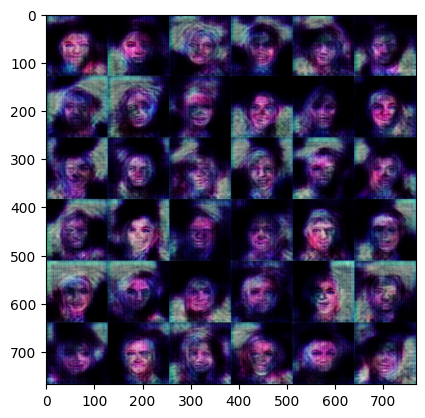

Training Progress:  17%|█▋        | 2500/15000 [13:32<1:38:13,  2.12step/s]

****************************************************************************************************
1/1 [==============================] - 0s 16ms/step


Training Progress:  17%|█▋        | 2501/15000 [13:33<1:28:29,  2.35step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  17%|█▋        | 2502/15000 [13:33<1:21:36,  2.55step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  17%|█▋        | 2503/15000 [13:33<1:16:18,  2.73step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  17%|█▋        | 2504/15000 [13:34<1:12:48,  2.86step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  17%|█▋        | 2505/15000 [13:34<1:10:14,  2.96step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  17%|█▋        | 2506/15000 [13:34<1:08:35,  3.04step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  17%|█▋        | 2507/15000 [13:35<1:07:11,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  17%|█▋        | 2508/15000 [13:35<1:06:23,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  17%|█▋        | 2509/15000 [13:35<1:05:53,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  17%|█▋        | 2510/15000 [13:35<1:05:35,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  17%|█▋        | 2511/15000 [13:36<1:05:27,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  17%|█▋        | 2512/15000 [13:36<1:05:20,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  17%|█▋        | 2513/15000 [13:36<1:04:58,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  17%|█▋        | 2514/15000 [13:37<1:04:44,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  17%|█▋        | 2515/15000 [13:37<1:04:30,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  17%|█▋        | 2516/15000 [13:37<1:04:25,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  17%|█▋        | 2517/15000 [13:38<1:04:04,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  17%|█▋        | 2518/15000 [13:38<1:04:10,  3.24step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  17%|█▋        | 2519/15000 [13:38<1:04:16,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  17%|█▋        | 2520/15000 [13:39<1:04:23,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  17%|█▋        | 2521/15000 [13:39<1:04:32,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  17%|█▋        | 2522/15000 [13:39<1:04:28,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  17%|█▋        | 2523/15000 [13:39<1:04:24,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  17%|█▋        | 2524/15000 [13:40<1:04:29,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  17%|█▋        | 2525/15000 [13:40<1:06:37,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  17%|█▋        | 2526/15000 [13:40<1:05:42,  3.16step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  17%|█▋        | 2527/15000 [13:41<1:05:28,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  17%|█▋        | 2528/15000 [13:41<1:05:06,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  17%|█▋        | 2529/15000 [13:41<1:04:49,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  17%|█▋        | 2530/15000 [13:42<1:04:57,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  17%|█▋        | 2531/15000 [13:42<1:04:42,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  17%|█▋        | 2532/15000 [13:42<1:07:05,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  17%|█▋        | 2533/15000 [13:43<1:06:15,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  17%|█▋        | 2534/15000 [13:43<1:05:39,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  17%|█▋        | 2535/15000 [13:43<1:05:03,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  17%|█▋        | 2536/15000 [13:44<1:07:07,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  17%|█▋        | 2537/15000 [13:44<1:06:18,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  17%|█▋        | 2538/15000 [13:44<1:05:34,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  17%|█▋        | 2539/15000 [13:45<1:05:16,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  17%|█▋        | 2540/15000 [13:45<1:04:58,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  17%|█▋        | 2541/15000 [13:45<1:06:48,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  17%|█▋        | 2542/15000 [13:46<1:05:56,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  17%|█▋        | 2543/15000 [13:46<1:05:09,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  17%|█▋        | 2544/15000 [13:46<1:04:53,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  17%|█▋        | 2545/15000 [13:46<1:04:41,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  17%|█▋        | 2546/15000 [13:47<1:06:50,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  17%|█▋        | 2547/15000 [13:47<1:05:53,  3.15step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  17%|█▋        | 2548/15000 [13:47<1:08:17,  3.04step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  17%|█▋        | 2549/15000 [13:48<1:07:18,  3.08step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  17%|█▋        | 2550/15000 [13:48<1:06:26,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  17%|█▋        | 2551/15000 [13:48<1:05:41,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  17%|█▋        | 2552/15000 [13:49<1:07:31,  3.07step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  17%|█▋        | 2553/15000 [13:49<1:06:16,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  17%|█▋        | 2554/15000 [13:49<1:05:34,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  17%|█▋        | 2555/15000 [13:50<1:04:57,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  17%|█▋        | 2556/15000 [13:50<1:04:50,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  17%|█▋        | 2557/15000 [13:50<1:04:39,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  17%|█▋        | 2558/15000 [13:51<1:04:56,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  17%|█▋        | 2559/15000 [13:51<1:04:48,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  17%|█▋        | 2560/15000 [13:51<1:04:38,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  17%|█▋        | 2561/15000 [13:52<1:04:35,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  17%|█▋        | 2562/15000 [13:52<1:04:30,  3.21step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  17%|█▋        | 2563/15000 [13:52<1:14:03,  2.80step/s]

1/1 [==============================] - 0s 36ms/step


Training Progress:  17%|█▋        | 2564/15000 [13:53<1:18:14,  2.65step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  17%|█▋        | 2565/15000 [13:53<1:20:40,  2.57step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  17%|█▋        | 2566/15000 [13:53<1:15:45,  2.74step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  17%|█▋        | 2567/15000 [13:54<1:12:27,  2.86step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  17%|█▋        | 2568/15000 [13:54<1:09:49,  2.97step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  17%|█▋        | 2569/15000 [13:54<1:07:53,  3.05step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  17%|█▋        | 2570/15000 [13:55<1:06:41,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  17%|█▋        | 2571/15000 [13:55<1:05:44,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  17%|█▋        | 2572/15000 [13:55<1:05:23,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  17%|█▋        | 2573/15000 [13:56<1:04:50,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  17%|█▋        | 2574/15000 [13:56<1:04:38,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  17%|█▋        | 2575/15000 [13:56<1:06:37,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  17%|█▋        | 2576/15000 [13:57<1:06:15,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  17%|█▋        | 2577/15000 [13:57<1:05:28,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  17%|█▋        | 2578/15000 [13:57<1:04:58,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  17%|█▋        | 2579/15000 [13:58<1:04:27,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  17%|█▋        | 2580/15000 [13:58<1:04:07,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  17%|█▋        | 2581/15000 [13:58<1:04:09,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  17%|█▋        | 2582/15000 [13:58<1:04:06,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  17%|█▋        | 2583/15000 [13:59<1:03:59,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  17%|█▋        | 2584/15000 [13:59<1:06:13,  3.12step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  17%|█▋        | 2585/15000 [13:59<1:06:11,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  17%|█▋        | 2586/15000 [14:00<1:05:45,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  17%|█▋        | 2587/15000 [14:00<1:07:17,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  17%|█▋        | 2588/15000 [14:00<1:06:23,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  17%|█▋        | 2589/15000 [14:01<1:05:34,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  17%|█▋        | 2590/15000 [14:01<1:04:52,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  17%|█▋        | 2591/15000 [14:01<1:04:20,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  17%|█▋        | 2592/15000 [14:02<1:04:06,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  17%|█▋        | 2593/15000 [14:02<1:03:48,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  17%|█▋        | 2594/15000 [14:02<1:04:15,  3.22step/s]

1/1 [==============================] - 0s 40ms/step


Training Progress:  17%|█▋        | 2595/15000 [14:03<1:07:01,  3.08step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  17%|█▋        | 2596/15000 [14:03<1:06:12,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  17%|█▋        | 2597/15000 [14:03<1:05:39,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  17%|█▋        | 2598/15000 [14:04<1:05:18,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  17%|█▋        | 2599/15000 [14:04<1:04:50,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  17%|█▋        | 2600/15000 [14:04<1:04:34,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  17%|█▋        | 2601/15000 [14:04<1:04:16,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  17%|█▋        | 2602/15000 [14:05<1:04:21,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  17%|█▋        | 2603/15000 [14:05<1:04:19,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  17%|█▋        | 2604/15000 [14:05<1:04:31,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  17%|█▋        | 2605/15000 [14:06<1:06:23,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  17%|█▋        | 2606/15000 [14:06<1:05:40,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  17%|█▋        | 2607/15000 [14:06<1:07:06,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  17%|█▋        | 2608/15000 [14:07<1:06:02,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  17%|█▋        | 2609/15000 [14:07<1:07:31,  3.06step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  17%|█▋        | 2610/15000 [14:07<1:06:27,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  17%|█▋        | 2611/15000 [14:08<1:05:30,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  17%|█▋        | 2612/15000 [14:08<1:05:07,  3.17step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  17%|█▋        | 2613/15000 [14:08<1:05:01,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  17%|█▋        | 2614/15000 [14:09<1:04:41,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  17%|█▋        | 2615/15000 [14:09<1:04:11,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  17%|█▋        | 2616/15000 [14:09<1:04:17,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  17%|█▋        | 2617/15000 [14:09<1:04:09,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  17%|█▋        | 2618/15000 [14:10<1:04:05,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  17%|█▋        | 2619/15000 [14:10<1:03:43,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  17%|█▋        | 2620/15000 [14:10<1:03:40,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  17%|█▋        | 2621/15000 [14:11<1:03:25,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  17%|█▋        | 2622/15000 [14:11<1:03:43,  3.24step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  17%|█▋        | 2623/15000 [14:12<1:21:46,  2.52step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  17%|█▋        | 2624/15000 [14:12<1:17:03,  2.68step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  18%|█▊        | 2625/15000 [14:12<1:16:10,  2.71step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  18%|█▊        | 2626/15000 [14:13<1:13:39,  2.80step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  18%|█▊        | 2627/15000 [14:13<1:11:05,  2.90step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  18%|█▊        | 2628/15000 [14:13<1:09:18,  2.98step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  18%|█▊        | 2629/15000 [14:14<1:07:57,  3.03step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  18%|█▊        | 2630/15000 [14:14<1:07:18,  3.06step/s]

1/1 [==============================] - 0s 23ms/step


Training Progress:  18%|█▊        | 2631/15000 [14:14<1:06:33,  3.10step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  18%|█▊        | 2632/15000 [14:15<1:08:40,  3.00step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  18%|█▊        | 2633/15000 [14:15<1:07:20,  3.06step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  18%|█▊        | 2634/15000 [14:15<1:06:35,  3.09step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  18%|█▊        | 2635/15000 [14:16<1:05:57,  3.12step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  18%|█▊        | 2636/15000 [14:16<1:08:00,  3.03step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  18%|█▊        | 2637/15000 [14:16<1:09:20,  2.97step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  18%|█▊        | 2638/15000 [14:17<1:10:20,  2.93step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  18%|█▊        | 2639/15000 [14:17<1:08:56,  2.99step/s]

1/1 [==============================] - 0s 23ms/step


Training Progress:  18%|█▊        | 2640/15000 [14:17<1:08:17,  3.02step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  18%|█▊        | 2641/15000 [14:18<1:07:44,  3.04step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  18%|█▊        | 2642/15000 [14:18<1:07:08,  3.07step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  18%|█▊        | 2643/15000 [14:18<1:06:44,  3.09step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  18%|█▊        | 2644/15000 [14:18<1:06:16,  3.11step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  18%|█▊        | 2645/15000 [14:19<1:05:55,  3.12step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  18%|█▊        | 2646/15000 [14:19<1:08:05,  3.02step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  18%|█▊        | 2647/15000 [14:19<1:07:14,  3.06step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  18%|█▊        | 2648/15000 [14:20<1:06:56,  3.08step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  18%|█▊        | 2649/15000 [14:20<1:06:18,  3.10step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  18%|█▊        | 2650/15000 [14:20<1:06:26,  3.10step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  18%|█▊        | 2651/15000 [14:21<1:08:19,  3.01step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  18%|█▊        | 2652/15000 [14:21<1:07:52,  3.03step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  18%|█▊        | 2653/15000 [14:21<1:07:09,  3.06step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  18%|█▊        | 2654/15000 [14:22<1:06:35,  3.09step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  18%|█▊        | 2655/15000 [14:22<1:06:41,  3.09step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  18%|█▊        | 2656/15000 [14:22<1:09:10,  2.97step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  18%|█▊        | 2657/15000 [14:23<1:08:01,  3.02step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  18%|█▊        | 2658/15000 [14:23<1:07:30,  3.05step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  18%|█▊        | 2659/15000 [14:23<1:09:38,  2.95step/s]

1/1 [==============================] - 0s 32ms/step


Training Progress:  18%|█▊        | 2660/15000 [14:24<1:18:12,  2.63step/s]

1/1 [==============================] - 0s 32ms/step


Training Progress:  18%|█▊        | 2661/15000 [14:24<1:22:49,  2.48step/s]

1/1 [==============================] - 0s 31ms/step


Training Progress:  18%|█▊        | 2662/15000 [14:25<1:21:40,  2.52step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  18%|█▊        | 2663/15000 [14:25<1:16:31,  2.69step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  18%|█▊        | 2664/15000 [14:25<1:13:11,  2.81step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  18%|█▊        | 2665/15000 [14:26<1:12:52,  2.82step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  18%|█▊        | 2666/15000 [14:26<1:10:29,  2.92step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  18%|█▊        | 2667/15000 [14:26<1:08:43,  2.99step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  18%|█▊        | 2668/15000 [14:27<1:08:00,  3.02step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  18%|█▊        | 2669/15000 [14:27<1:06:53,  3.07step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  18%|█▊        | 2670/15000 [14:27<1:06:19,  3.10step/s]

1/1 [==============================] - 0s 23ms/step


Training Progress:  18%|█▊        | 2671/15000 [14:28<1:06:13,  3.10step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  18%|█▊        | 2672/15000 [14:28<1:05:50,  3.12step/s]

1/1 [==============================] - 0s 23ms/step


Training Progress:  18%|█▊        | 2673/15000 [14:28<1:05:59,  3.11step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  18%|█▊        | 2674/15000 [14:29<1:07:59,  3.02step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  18%|█▊        | 2675/15000 [14:29<1:09:05,  2.97step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  18%|█▊        | 2676/15000 [14:29<1:08:08,  3.01step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  18%|█▊        | 2677/15000 [14:30<1:07:27,  3.04step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  18%|█▊        | 2678/15000 [14:30<1:06:49,  3.07step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  18%|█▊        | 2679/15000 [14:30<1:06:23,  3.09step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  18%|█▊        | 2680/15000 [14:31<1:06:08,  3.10step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  18%|█▊        | 2681/15000 [14:31<1:05:51,  3.12step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  18%|█▊        | 2682/15000 [14:31<1:06:07,  3.10step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  18%|█▊        | 2683/15000 [14:32<1:05:41,  3.12step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  18%|█▊        | 2684/15000 [14:32<1:05:30,  3.13step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  18%|█▊        | 2685/15000 [14:32<1:05:34,  3.13step/s]

1/1 [==============================] - 0s 31ms/step


Training Progress:  18%|█▊        | 2686/15000 [14:33<1:09:41,  2.95step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  18%|█▊        | 2687/15000 [14:33<1:10:21,  2.92step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  18%|█▊        | 2688/15000 [14:33<1:08:49,  2.98step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  18%|█▊        | 2689/15000 [14:34<1:07:36,  3.03step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  18%|█▊        | 2690/15000 [14:34<1:06:51,  3.07step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  18%|█▊        | 2691/15000 [14:34<1:06:09,  3.10step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  18%|█▊        | 2692/15000 [14:35<1:05:38,  3.12step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  18%|█▊        | 2693/15000 [14:35<1:05:15,  3.14step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  18%|█▊        | 2694/15000 [14:35<1:05:17,  3.14step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  18%|█▊        | 2695/15000 [14:35<1:07:05,  3.06step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  18%|█▊        | 2696/15000 [14:36<1:06:47,  3.07step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  18%|█▊        | 2697/15000 [14:36<1:05:54,  3.11step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  18%|█▊        | 2698/15000 [14:36<1:05:34,  3.13step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  18%|█▊        | 2699/15000 [14:37<1:05:05,  3.15step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  18%|█▊        | 2700/15000 [14:37<1:04:54,  3.16step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  18%|█▊        | 2701/15000 [14:37<1:04:45,  3.17step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  18%|█▊        | 2702/15000 [14:38<1:05:03,  3.15step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  18%|█▊        | 2703/15000 [14:38<1:04:42,  3.17step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  18%|█▊        | 2704/15000 [14:38<1:05:06,  3.15step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  18%|█▊        | 2705/15000 [14:39<1:05:11,  3.14step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  18%|█▊        | 2706/15000 [14:39<1:04:52,  3.16step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  18%|█▊        | 2707/15000 [14:39<1:04:34,  3.17step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  18%|█▊        | 2708/15000 [14:40<1:04:25,  3.18step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  18%|█▊        | 2709/15000 [14:40<1:04:09,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  18%|█▊        | 2710/15000 [14:40<1:04:06,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  18%|█▊        | 2711/15000 [14:41<1:03:57,  3.20step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  18%|█▊        | 2712/15000 [14:41<1:04:16,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  18%|█▊        | 2713/15000 [14:41<1:03:56,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  18%|█▊        | 2714/15000 [14:41<1:04:23,  3.18step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  18%|█▊        | 2715/15000 [14:42<1:04:05,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  18%|█▊        | 2716/15000 [14:42<1:04:11,  3.19step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  18%|█▊        | 2717/15000 [14:42<1:04:25,  3.18step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  18%|█▊        | 2718/15000 [14:43<1:04:37,  3.17step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  18%|█▊        | 2719/15000 [14:43<1:04:14,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  18%|█▊        | 2720/15000 [14:43<1:04:11,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  18%|█▊        | 2721/15000 [14:44<1:06:02,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  18%|█▊        | 2722/15000 [14:44<1:05:19,  3.13step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  18%|█▊        | 2723/15000 [14:44<1:05:09,  3.14step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  18%|█▊        | 2724/15000 [14:45<1:04:51,  3.15step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  18%|█▊        | 2725/15000 [14:45<1:04:24,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  18%|█▊        | 2726/15000 [14:45<1:04:10,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  18%|█▊        | 2727/15000 [14:46<1:03:56,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  18%|█▊        | 2728/15000 [14:46<1:05:52,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  18%|█▊        | 2729/15000 [14:46<1:04:53,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  18%|█▊        | 2730/15000 [14:47<1:04:22,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  18%|█▊        | 2731/15000 [14:47<1:03:46,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  18%|█▊        | 2732/15000 [14:47<1:03:31,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  18%|█▊        | 2733/15000 [14:47<1:03:42,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  18%|█▊        | 2734/15000 [14:48<1:03:29,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  18%|█▊        | 2735/15000 [14:48<1:03:05,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  18%|█▊        | 2736/15000 [14:48<1:03:07,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  18%|█▊        | 2737/15000 [14:49<1:02:59,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  18%|█▊        | 2738/15000 [14:49<1:03:00,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  18%|█▊        | 2739/15000 [14:49<1:03:01,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  18%|█▊        | 2740/15000 [14:50<1:03:03,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  18%|█▊        | 2741/15000 [14:50<1:02:55,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  18%|█▊        | 2742/15000 [14:50<1:03:27,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  18%|█▊        | 2743/15000 [14:51<1:03:14,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  18%|█▊        | 2744/15000 [14:51<1:03:13,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  18%|█▊        | 2745/15000 [14:51<1:03:01,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  18%|█▊        | 2746/15000 [14:51<1:03:00,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  18%|█▊        | 2747/15000 [14:52<1:02:46,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  18%|█▊        | 2748/15000 [14:52<1:03:09,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  18%|█▊        | 2749/15000 [14:52<1:03:37,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  18%|█▊        | 2750/15000 [14:53<1:03:29,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  18%|█▊        | 2751/15000 [14:53<1:03:36,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  18%|█▊        | 2752/15000 [14:53<1:03:39,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  18%|█▊        | 2753/15000 [14:54<1:03:19,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  18%|█▊        | 2754/15000 [14:54<1:03:14,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  18%|█▊        | 2755/15000 [14:54<1:03:03,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  18%|█▊        | 2756/15000 [14:55<1:03:01,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  18%|█▊        | 2757/15000 [14:55<1:05:13,  3.13step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  18%|█▊        | 2758/15000 [14:55<1:10:55,  2.88step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  18%|█▊        | 2759/15000 [14:56<1:14:50,  2.73step/s]

1/1 [==============================] - 0s 27ms/step


Training Progress:  18%|█▊        | 2760/15000 [14:56<1:13:43,  2.77step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  18%|█▊        | 2761/15000 [14:56<1:10:43,  2.88step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  18%|█▊        | 2762/15000 [14:57<1:10:47,  2.88step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  18%|█▊        | 2763/15000 [14:57<1:08:22,  2.98step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  18%|█▊        | 2764/15000 [14:57<1:06:56,  3.05step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  18%|█▊        | 2765/15000 [14:58<1:05:29,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  18%|█▊        | 2766/15000 [14:58<1:04:41,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  18%|█▊        | 2767/15000 [14:58<1:06:06,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  18%|█▊        | 2768/15000 [14:59<1:05:11,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  18%|█▊        | 2769/15000 [14:59<1:04:13,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  18%|█▊        | 2770/15000 [14:59<1:04:11,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  18%|█▊        | 2771/15000 [15:00<1:03:58,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  18%|█▊        | 2772/15000 [15:00<1:05:54,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  18%|█▊        | 2773/15000 [15:00<1:07:11,  3.03step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  18%|█▊        | 2774/15000 [15:01<1:06:00,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  18%|█▊        | 2775/15000 [15:01<1:04:55,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▊        | 2776/15000 [15:01<1:04:20,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▊        | 2777/15000 [15:01<1:03:43,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▊        | 2778/15000 [15:02<1:03:31,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▊        | 2779/15000 [15:02<1:03:29,  3.21step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  19%|█▊        | 2780/15000 [15:02<1:03:59,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  19%|█▊        | 2781/15000 [15:03<1:03:37,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▊        | 2782/15000 [15:03<1:03:20,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▊        | 2783/15000 [15:03<1:02:58,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▊        | 2784/15000 [15:04<1:02:49,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▊        | 2785/15000 [15:04<1:02:33,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▊        | 2786/15000 [15:04<1:02:32,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▊        | 2787/15000 [15:05<1:02:26,  3.26step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  19%|█▊        | 2788/15000 [15:05<1:02:54,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  19%|█▊        | 2789/15000 [15:05<1:02:47,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▊        | 2790/15000 [15:06<1:05:02,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▊        | 2791/15000 [15:06<1:06:16,  3.07step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▊        | 2792/15000 [15:06<1:05:11,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▊        | 2793/15000 [15:06<1:04:10,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▊        | 2794/15000 [15:07<1:03:39,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▊        | 2795/15000 [15:07<1:03:08,  3.22step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  19%|█▊        | 2796/15000 [15:07<1:03:04,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▊        | 2797/15000 [15:08<1:03:07,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▊        | 2798/15000 [15:08<1:02:58,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▊        | 2799/15000 [15:08<1:02:48,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▊        | 2800/15000 [15:09<1:04:59,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▊        | 2801/15000 [15:09<1:03:59,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▊        | 2802/15000 [15:09<1:03:30,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▊        | 2803/15000 [15:10<1:02:59,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  19%|█▊        | 2804/15000 [15:10<1:02:57,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▊        | 2805/15000 [15:10<1:02:36,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▊        | 2806/15000 [15:11<1:02:29,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  19%|█▊        | 2807/15000 [15:11<1:02:40,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  19%|█▊        | 2808/15000 [15:11<1:02:39,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  19%|█▊        | 2809/15000 [15:11<1:02:31,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▊        | 2810/15000 [15:12<1:02:32,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  19%|█▊        | 2811/15000 [15:12<1:04:54,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▊        | 2812/15000 [15:12<1:06:42,  3.05step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  19%|█▉        | 2813/15000 [15:13<1:05:42,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  19%|█▉        | 2814/15000 [15:13<1:04:55,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  19%|█▉        | 2815/15000 [15:13<1:04:10,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▉        | 2816/15000 [15:14<1:04:00,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▉        | 2817/15000 [15:14<1:03:29,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▉        | 2818/15000 [15:14<1:03:09,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  19%|█▉        | 2819/15000 [15:15<1:02:46,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  19%|█▉        | 2820/15000 [15:15<1:02:39,  3.24step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:  19%|█▉        | 2821/15000 [15:15<1:02:23,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▉        | 2822/15000 [15:16<1:02:21,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▉        | 2823/15000 [15:16<1:02:13,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▉        | 2824/15000 [15:16<1:02:15,  3.26step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  19%|█▉        | 2825/15000 [15:16<1:02:33,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▉        | 2826/15000 [15:17<1:02:35,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  19%|█▉        | 2827/15000 [15:17<1:02:34,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▉        | 2828/15000 [15:17<1:02:38,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▉        | 2829/15000 [15:18<1:02:19,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▉        | 2830/15000 [15:18<1:02:20,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  19%|█▉        | 2831/15000 [15:18<1:04:32,  3.14step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  19%|█▉        | 2832/15000 [15:19<1:04:10,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▉        | 2833/15000 [15:19<1:03:23,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▉        | 2834/15000 [15:19<1:03:28,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  19%|█▉        | 2835/15000 [15:20<1:03:06,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  19%|█▉        | 2836/15000 [15:20<1:03:06,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▉        | 2837/15000 [15:20<1:02:47,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▉        | 2838/15000 [15:20<1:02:47,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▉        | 2839/15000 [15:21<1:02:31,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▉        | 2840/15000 [15:21<1:02:25,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▉        | 2841/15000 [15:21<1:02:24,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▉        | 2842/15000 [15:22<1:02:27,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▉        | 2843/15000 [15:22<1:02:16,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  19%|█▉        | 2844/15000 [15:22<1:02:44,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  19%|█▉        | 2845/15000 [15:23<1:02:50,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  19%|█▉        | 2846/15000 [15:23<1:03:07,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  19%|█▉        | 2847/15000 [15:23<1:02:57,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▉        | 2848/15000 [15:24<1:02:55,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▉        | 2849/15000 [15:24<1:02:41,  3.23step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:  19%|█▉        | 2850/15000 [15:24<1:02:30,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▉        | 2851/15000 [15:25<1:02:21,  3.25step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:  19%|█▉        | 2852/15000 [15:25<1:02:19,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▉        | 2853/15000 [15:25<1:04:51,  3.12step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  19%|█▉        | 2854/15000 [15:25<1:04:16,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▉        | 2855/15000 [15:26<1:03:38,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▉        | 2856/15000 [15:26<1:03:14,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  19%|█▉        | 2857/15000 [15:26<1:09:00,  2.93step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  19%|█▉        | 2858/15000 [15:27<1:15:54,  2.67step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  19%|█▉        | 2859/15000 [15:27<1:17:56,  2.60step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  19%|█▉        | 2860/15000 [15:28<1:16:33,  2.64step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▉        | 2861/15000 [15:28<1:12:12,  2.80step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▉        | 2862/15000 [15:28<1:09:30,  2.91step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▉        | 2863/15000 [15:29<1:07:17,  3.01step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▉        | 2864/15000 [15:29<1:05:46,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▉        | 2865/15000 [15:29<1:04:39,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▉        | 2866/15000 [15:30<1:03:52,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▉        | 2867/15000 [15:30<1:03:17,  3.20step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:  19%|█▉        | 2868/15000 [15:30<1:02:59,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  19%|█▉        | 2869/15000 [15:30<1:02:45,  3.22step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:  19%|█▉        | 2870/15000 [15:31<1:02:19,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▉        | 2871/15000 [15:31<1:02:28,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▉        | 2872/15000 [15:31<1:02:13,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▉        | 2873/15000 [15:32<1:02:11,  3.25step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:  19%|█▉        | 2874/15000 [15:32<1:04:05,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▉        | 2875/15000 [15:32<1:04:02,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▉        | 2876/15000 [15:33<1:03:21,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▉        | 2877/15000 [15:33<1:05:15,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▉        | 2878/15000 [15:33<1:04:16,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▉        | 2879/15000 [15:34<1:03:36,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▉        | 2880/15000 [15:34<1:03:08,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  19%|█▉        | 2881/15000 [15:34<1:03:16,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▉        | 2882/15000 [15:35<1:02:47,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▉        | 2883/15000 [15:35<1:02:31,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▉        | 2884/15000 [15:35<1:02:11,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▉        | 2885/15000 [15:36<1:04:18,  3.14step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:  19%|█▉        | 2886/15000 [15:36<1:05:31,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▉        | 2887/15000 [15:36<1:04:21,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▉        | 2888/15000 [15:37<1:05:39,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  19%|█▉        | 2889/15000 [15:37<1:04:34,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  19%|█▉        | 2890/15000 [15:37<1:04:03,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▉        | 2891/15000 [15:37<1:03:31,  3.18step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  19%|█▉        | 2892/15000 [15:38<1:03:23,  3.18step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  19%|█▉        | 2893/15000 [15:38<1:03:22,  3.18step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  19%|█▉        | 2894/15000 [15:38<1:02:57,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▉        | 2895/15000 [15:39<1:02:38,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▉        | 2896/15000 [15:39<1:02:13,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▉        | 2897/15000 [15:39<1:02:05,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▉        | 2898/15000 [15:40<1:02:15,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▉        | 2899/15000 [15:40<1:02:32,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▉        | 2900/15000 [15:40<1:04:42,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▉        | 2901/15000 [15:41<1:03:54,  3.16step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  19%|█▉        | 2902/15000 [15:41<1:03:52,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▉        | 2903/15000 [15:41<1:03:16,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▉        | 2904/15000 [15:41<1:02:57,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▉        | 2905/15000 [15:42<1:02:35,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▉        | 2906/15000 [15:42<1:02:22,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  19%|█▉        | 2907/15000 [15:42<1:04:32,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  19%|█▉        | 2908/15000 [15:43<1:04:09,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  19%|█▉        | 2909/15000 [15:43<1:03:31,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▉        | 2910/15000 [15:43<1:03:06,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▉        | 2911/15000 [15:44<1:02:46,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  19%|█▉        | 2912/15000 [15:44<1:02:57,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  19%|█▉        | 2913/15000 [15:44<1:02:43,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▉        | 2914/15000 [15:45<1:02:27,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▉        | 2915/15000 [15:45<1:02:09,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▉        | 2916/15000 [15:45<1:02:01,  3.25step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  19%|█▉        | 2917/15000 [15:46<1:02:02,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  19%|█▉        | 2918/15000 [15:46<1:02:24,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▉        | 2919/15000 [15:46<1:02:13,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  19%|█▉        | 2920/15000 [15:46<1:02:10,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▉        | 2921/15000 [15:47<1:01:57,  3.25step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:  19%|█▉        | 2922/15000 [15:47<1:01:53,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▉        | 2923/15000 [15:47<1:03:59,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  19%|█▉        | 2924/15000 [15:48<1:03:23,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|█▉        | 2925/15000 [15:48<1:03:04,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|█▉        | 2926/15000 [15:48<1:02:38,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|█▉        | 2927/15000 [15:49<1:02:42,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  20%|█▉        | 2928/15000 [15:49<1:02:20,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|█▉        | 2929/15000 [15:49<1:02:10,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|█▉        | 2930/15000 [15:50<1:02:04,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|█▉        | 2931/15000 [15:50<1:01:55,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|█▉        | 2932/15000 [15:50<1:01:46,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|█▉        | 2933/15000 [15:50<1:01:45,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|█▉        | 2934/15000 [15:51<1:01:36,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|█▉        | 2935/15000 [15:51<1:01:33,  3.27step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|█▉        | 2936/15000 [15:51<1:01:43,  3.26step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  20%|█▉        | 2937/15000 [15:52<1:01:47,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|█▉        | 2938/15000 [15:52<1:01:37,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|█▉        | 2939/15000 [15:52<1:01:39,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|█▉        | 2940/15000 [15:53<1:01:33,  3.27step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|█▉        | 2941/15000 [15:53<1:03:49,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|█▉        | 2942/15000 [15:53<1:03:02,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  20%|█▉        | 2943/15000 [15:54<1:02:48,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|█▉        | 2944/15000 [15:54<1:02:18,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|█▉        | 2945/15000 [15:54<1:02:26,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  20%|█▉        | 2946/15000 [15:55<1:02:20,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|█▉        | 2947/15000 [15:55<1:02:09,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|█▉        | 2948/15000 [15:55<1:01:50,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|█▉        | 2949/15000 [15:55<1:01:43,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|█▉        | 2950/15000 [15:56<1:01:30,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|█▉        | 2951/15000 [15:56<1:01:26,  3.27step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|█▉        | 2952/15000 [15:56<1:01:25,  3.27step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|█▉        | 2953/15000 [15:57<1:01:30,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|█▉        | 2954/15000 [15:57<1:01:35,  3.26step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  20%|█▉        | 2955/15000 [15:57<1:02:07,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  20%|█▉        | 2956/15000 [15:58<1:04:31,  3.11step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  20%|█▉        | 2957/15000 [15:58<1:08:08,  2.95step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  20%|█▉        | 2958/15000 [15:58<1:14:55,  2.68step/s]

1/1 [==============================] - 0s 23ms/step


Training Progress:  20%|█▉        | 2959/15000 [15:59<1:17:06,  2.60step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  20%|█▉        | 2960/15000 [15:59<1:15:42,  2.65step/s]

1/1 [==============================] - 0s 27ms/step


Training Progress:  20%|█▉        | 2961/15000 [16:00<1:14:53,  2.68step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|█▉        | 2962/15000 [16:00<1:10:48,  2.83step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|█▉        | 2963/15000 [16:00<1:08:07,  2.94step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|█▉        | 2964/15000 [16:01<1:06:24,  3.02step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|█▉        | 2965/15000 [16:01<1:05:00,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|█▉        | 2966/15000 [16:01<1:03:55,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|█▉        | 2967/15000 [16:01<1:03:18,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  20%|█▉        | 2968/15000 [16:02<1:02:46,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|█▉        | 2969/15000 [16:02<1:02:34,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|█▉        | 2970/15000 [16:02<1:02:45,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|█▉        | 2971/15000 [16:03<1:02:31,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|█▉        | 2972/15000 [16:03<1:02:14,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  20%|█▉        | 2973/15000 [16:03<1:02:26,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|█▉        | 2974/15000 [16:04<1:02:26,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|█▉        | 2975/15000 [16:04<1:02:14,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|█▉        | 2976/15000 [16:04<1:01:59,  3.23step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:  20%|█▉        | 2977/15000 [16:05<1:01:48,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|█▉        | 2978/15000 [16:05<1:01:46,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|█▉        | 2979/15000 [16:05<1:01:33,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|█▉        | 2980/15000 [16:05<1:01:36,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|█▉        | 2981/15000 [16:06<1:01:26,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|█▉        | 2982/15000 [16:06<1:01:32,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|█▉        | 2983/15000 [16:06<1:01:28,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|█▉        | 2984/15000 [16:07<1:01:18,  3.27step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|█▉        | 2985/15000 [16:07<1:01:22,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|█▉        | 2986/15000 [16:07<1:01:26,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|█▉        | 2987/15000 [16:08<1:01:22,  3.26step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  20%|█▉        | 2988/15000 [16:08<1:01:29,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|█▉        | 2989/15000 [16:08<1:01:28,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|█▉        | 2990/15000 [16:09<1:01:21,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|█▉        | 2991/15000 [16:09<1:01:20,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|█▉        | 2992/15000 [16:09<1:03:49,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  20%|█▉        | 2993/15000 [16:09<1:03:15,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|█▉        | 2994/15000 [16:10<1:02:34,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|█▉        | 2995/15000 [16:10<1:02:08,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|█▉        | 2996/15000 [16:10<1:01:57,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|█▉        | 2997/15000 [16:11<1:01:42,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|█▉        | 2998/15000 [16:11<1:01:25,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|█▉        | 2999/15000 [16:11<1:01:21,  3.26step/s]

1/1 [==============================] - 0s 20ms/step
****************************************************************************************************
3000/15000: d_loss: 0.133063,  g_loss: 0.077575
2/2 [==============================] - 0s 20ms/step


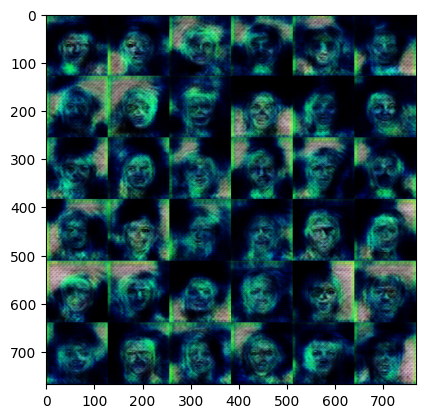

Training Progress:  20%|██        | 3000/15000 [16:12<1:30:13,  2.22step/s]

****************************************************************************************************
1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|██        | 3001/15000 [16:12<1:22:08,  2.43step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|██        | 3002/15000 [16:13<1:16:15,  2.62step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|██        | 3003/15000 [16:13<1:11:43,  2.79step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|██        | 3004/15000 [16:13<1:08:43,  2.91step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|██        | 3005/15000 [16:14<1:06:38,  3.00step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|██        | 3006/15000 [16:14<1:05:15,  3.06step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  20%|██        | 3007/15000 [16:14<1:04:08,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  20%|██        | 3008/15000 [16:15<1:03:36,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|██        | 3009/15000 [16:15<1:02:56,  3.17step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:  20%|██        | 3010/15000 [16:15<1:02:17,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|██        | 3011/15000 [16:16<1:02:00,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|██        | 3012/15000 [16:16<1:01:43,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  20%|██        | 3013/15000 [16:16<1:01:50,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|██        | 3014/15000 [16:16<1:01:46,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|██        | 3015/15000 [16:17<1:01:39,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|██        | 3016/15000 [16:17<1:01:24,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|██        | 3017/15000 [16:17<1:01:22,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|██        | 3018/15000 [16:18<1:01:26,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|██        | 3019/15000 [16:18<1:01:12,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|██        | 3020/15000 [16:18<1:01:13,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|██        | 3021/15000 [16:19<1:01:05,  3.27step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|██        | 3022/15000 [16:19<1:01:10,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|██        | 3023/15000 [16:19<1:01:22,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  20%|██        | 3024/15000 [16:20<1:01:25,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  20%|██        | 3025/15000 [16:20<1:01:18,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|██        | 3026/15000 [16:20<1:01:20,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|██        | 3027/15000 [16:20<1:01:17,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|██        | 3028/15000 [16:21<1:01:16,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|██        | 3029/15000 [16:21<1:01:05,  3.27step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|██        | 3030/15000 [16:21<1:01:05,  3.27step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  20%|██        | 3031/15000 [16:22<1:00:58,  3.27step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|██        | 3032/15000 [16:22<1:03:25,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|██        | 3033/15000 [16:22<1:02:55,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|██        | 3034/15000 [16:23<1:03:03,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|██        | 3035/15000 [16:23<1:02:33,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|██        | 3036/15000 [16:23<1:02:05,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|██        | 3037/15000 [16:24<1:01:41,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|██        | 3038/15000 [16:24<1:01:34,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|██        | 3039/15000 [16:24<1:01:16,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|██        | 3040/15000 [16:24<1:01:09,  3.26step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  20%|██        | 3041/15000 [16:25<1:01:19,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  20%|██        | 3042/15000 [16:25<1:01:21,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|██        | 3043/15000 [16:25<1:01:10,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|██        | 3044/15000 [16:26<1:01:13,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|██        | 3045/15000 [16:26<1:01:02,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|██        | 3046/15000 [16:26<1:00:59,  3.27step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|██        | 3047/15000 [16:27<1:00:56,  3.27step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|██        | 3048/15000 [16:27<1:00:50,  3.27step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|██        | 3049/15000 [16:27<1:00:51,  3.27step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|██        | 3050/15000 [16:28<1:01:12,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|██        | 3051/15000 [16:28<1:01:07,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|██        | 3052/15000 [16:28<1:03:09,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|██        | 3053/15000 [16:29<1:04:34,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|██        | 3054/15000 [16:29<1:03:22,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|██        | 3055/15000 [16:29<1:02:40,  3.18step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  20%|██        | 3056/15000 [16:30<1:10:45,  2.81step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  20%|██        | 3057/15000 [16:30<1:13:59,  2.69step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  20%|██        | 3058/15000 [16:30<1:15:54,  2.62step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  20%|██        | 3059/15000 [16:31<1:11:24,  2.79step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|██        | 3060/15000 [16:31<1:08:29,  2.91step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|██        | 3061/15000 [16:31<1:06:06,  3.01step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|██        | 3062/15000 [16:32<1:04:26,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|██        | 3063/15000 [16:32<1:03:15,  3.15step/s]

1/1 [==============================] - 0s 28ms/step


Training Progress:  20%|██        | 3064/15000 [16:32<1:06:52,  2.97step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|██        | 3065/15000 [16:33<1:07:37,  2.94step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|██        | 3066/15000 [16:33<1:05:31,  3.04step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|██        | 3067/15000 [16:33<1:04:00,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  20%|██        | 3068/15000 [16:34<1:03:00,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|██        | 3069/15000 [16:34<1:02:38,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  20%|██        | 3070/15000 [16:34<1:02:05,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|██        | 3071/15000 [16:34<1:01:40,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|██        | 3072/15000 [16:35<1:03:36,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  20%|██        | 3073/15000 [16:35<1:02:46,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|██        | 3074/15000 [16:35<1:02:11,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  20%|██        | 3075/15000 [16:36<1:01:49,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3076/15000 [16:36<1:01:30,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3077/15000 [16:36<1:01:11,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3078/15000 [16:37<1:03:32,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3079/15000 [16:37<1:02:44,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3080/15000 [16:37<1:02:07,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3081/15000 [16:38<1:01:33,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3082/15000 [16:38<1:01:11,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3083/15000 [16:38<1:01:09,  3.25step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:  21%|██        | 3084/15000 [16:39<1:01:34,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3085/15000 [16:39<1:01:22,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3086/15000 [16:39<1:01:31,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  21%|██        | 3087/15000 [16:39<1:01:44,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3088/15000 [16:40<1:01:32,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3089/15000 [16:40<1:01:23,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3090/15000 [16:40<1:01:14,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3091/15000 [16:41<1:01:15,  3.24step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  21%|██        | 3092/15000 [16:41<1:01:26,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3093/15000 [16:41<1:01:13,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3094/15000 [16:42<1:01:04,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3095/15000 [16:42<1:03:02,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3096/15000 [16:42<1:04:41,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  21%|██        | 3097/15000 [16:43<1:03:56,  3.10step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  21%|██        | 3098/15000 [16:43<1:03:13,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3099/15000 [16:43<1:02:32,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3100/15000 [16:44<1:01:57,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  21%|██        | 3101/15000 [16:44<1:01:43,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3102/15000 [16:44<1:01:26,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3103/15000 [16:44<1:01:23,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  21%|██        | 3104/15000 [16:45<1:01:36,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3105/15000 [16:45<1:01:25,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  21%|██        | 3106/15000 [16:45<1:01:50,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3107/15000 [16:46<1:01:35,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3108/15000 [16:46<1:05:32,  3.02step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3109/15000 [16:46<1:04:09,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3110/15000 [16:47<1:03:12,  3.14step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:  21%|██        | 3111/15000 [16:47<1:02:26,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3112/15000 [16:47<1:01:56,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3113/15000 [16:48<1:01:31,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3114/15000 [16:48<1:01:12,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3115/15000 [16:48<1:01:23,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3116/15000 [16:49<1:01:16,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3117/15000 [16:49<1:01:06,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3118/15000 [16:49<1:01:02,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3119/15000 [16:49<1:00:54,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3120/15000 [16:50<1:00:59,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3121/15000 [16:50<1:00:42,  3.26step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:  21%|██        | 3122/15000 [16:50<1:00:43,  3.26step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:  21%|██        | 3123/15000 [16:51<1:00:28,  3.27step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3124/15000 [16:51<1:02:49,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3125/15000 [16:51<1:02:07,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3126/15000 [16:52<1:01:34,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  21%|██        | 3127/15000 [16:52<1:03:13,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3128/15000 [16:52<1:04:53,  3.05step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  21%|██        | 3129/15000 [16:53<1:03:39,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  21%|██        | 3130/15000 [16:53<1:02:48,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  21%|██        | 3131/15000 [16:53<1:02:13,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3132/15000 [16:54<1:01:38,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3133/15000 [16:54<1:01:14,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3134/15000 [16:54<1:01:17,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3135/15000 [16:55<1:01:06,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3136/15000 [16:55<1:00:58,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3137/15000 [16:55<1:00:50,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3138/15000 [16:55<1:00:41,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3139/15000 [16:56<1:00:41,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3140/15000 [16:56<1:02:40,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3141/15000 [16:56<1:02:06,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3142/15000 [16:57<1:01:35,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  21%|██        | 3143/15000 [16:57<1:01:39,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  21%|██        | 3144/15000 [16:57<1:01:19,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  21%|██        | 3145/15000 [16:58<1:01:15,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  21%|██        | 3146/15000 [16:58<1:03:11,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3147/15000 [16:58<1:02:28,  3.16step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  21%|██        | 3148/15000 [16:59<1:02:25,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3149/15000 [16:59<1:01:49,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3150/15000 [16:59<1:01:28,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  21%|██        | 3151/15000 [17:00<1:01:23,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  21%|██        | 3152/15000 [17:00<1:01:37,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3153/15000 [17:00<1:01:13,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3154/15000 [17:00<1:03:16,  3.12step/s]

1/1 [==============================] - 0s 27ms/step


Training Progress:  21%|██        | 3155/15000 [17:01<1:09:35,  2.84step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  21%|██        | 3156/15000 [17:01<1:13:05,  2.70step/s]

1/1 [==============================] - 0s 23ms/step


Training Progress:  21%|██        | 3157/15000 [17:02<1:15:15,  2.62step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  21%|██        | 3158/15000 [17:02<1:11:35,  2.76step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3159/15000 [17:02<1:08:09,  2.90step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3160/15000 [17:03<1:05:55,  2.99step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  21%|██        | 3161/15000 [17:03<1:04:30,  3.06step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3162/15000 [17:03<1:03:25,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3163/15000 [17:04<1:02:25,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3164/15000 [17:04<1:01:57,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3165/15000 [17:04<1:01:34,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  21%|██        | 3166/15000 [17:04<1:01:18,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  21%|██        | 3167/15000 [17:05<1:01:12,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  21%|██        | 3168/15000 [17:05<1:01:22,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3169/15000 [17:05<1:00:59,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3170/15000 [17:06<1:00:49,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3171/15000 [17:06<1:00:51,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3172/15000 [17:06<1:03:07,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3173/15000 [17:07<1:02:14,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  21%|██        | 3174/15000 [17:07<1:02:13,  3.17step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  21%|██        | 3175/15000 [17:07<1:01:57,  3.18step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  21%|██        | 3176/15000 [17:08<1:01:54,  3.18step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  21%|██        | 3177/15000 [17:08<1:01:45,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3178/15000 [17:08<1:01:21,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3179/15000 [17:09<1:01:09,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  21%|██        | 3180/15000 [17:09<1:01:20,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3181/15000 [17:09<1:01:12,  3.22step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  21%|██        | 3182/15000 [17:09<1:01:26,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3183/15000 [17:10<1:01:20,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3184/15000 [17:10<1:01:07,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3185/15000 [17:10<1:01:01,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██        | 3186/15000 [17:11<1:00:57,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  21%|██        | 3187/15000 [17:11<1:01:00,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██▏       | 3188/15000 [17:11<1:00:53,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  21%|██▏       | 3189/15000 [17:12<1:01:10,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  21%|██▏       | 3190/15000 [17:12<1:01:06,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██▏       | 3191/15000 [17:12<1:03:23,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  21%|██▏       | 3192/15000 [17:13<1:02:43,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  21%|██▏       | 3193/15000 [17:13<1:02:16,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██▏       | 3194/15000 [17:13<1:01:41,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██▏       | 3195/15000 [17:14<1:01:23,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  21%|██▏       | 3196/15000 [17:14<1:01:18,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██▏       | 3197/15000 [17:14<1:01:04,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  21%|██▏       | 3198/15000 [17:14<1:01:23,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  21%|██▏       | 3199/15000 [17:15<1:01:23,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██▏       | 3200/15000 [17:15<1:01:11,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  21%|██▏       | 3201/15000 [17:15<1:01:18,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██▏       | 3202/15000 [17:16<1:01:11,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██▏       | 3203/15000 [17:16<1:00:59,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  21%|██▏       | 3204/15000 [17:16<1:01:02,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  21%|██▏       | 3205/15000 [17:17<1:01:02,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██▏       | 3206/15000 [17:17<1:00:50,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  21%|██▏       | 3207/15000 [17:17<1:00:51,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  21%|██▏       | 3208/15000 [17:18<1:03:20,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  21%|██▏       | 3209/15000 [17:18<1:02:40,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██▏       | 3210/15000 [17:18<1:02:01,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██▏       | 3211/15000 [17:19<1:01:35,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██▏       | 3212/15000 [17:19<1:01:14,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██▏       | 3213/15000 [17:19<1:00:57,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██▏       | 3214/15000 [17:19<1:00:45,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  21%|██▏       | 3215/15000 [17:20<1:00:45,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██▏       | 3216/15000 [17:20<1:00:35,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██▏       | 3217/15000 [17:20<1:00:52,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██▏       | 3218/15000 [17:21<1:00:45,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██▏       | 3219/15000 [17:21<1:00:38,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██▏       | 3220/15000 [17:21<1:00:37,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  21%|██▏       | 3221/15000 [17:22<1:00:38,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  21%|██▏       | 3222/15000 [17:22<1:00:37,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  21%|██▏       | 3223/15000 [17:22<1:03:42,  3.08step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  21%|██▏       | 3224/15000 [17:23<1:03:28,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  22%|██▏       | 3225/15000 [17:23<1:02:32,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  22%|██▏       | 3226/15000 [17:23<1:02:05,  3.16step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  22%|██▏       | 3227/15000 [17:24<1:02:08,  3.16step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  22%|██▏       | 3228/15000 [17:24<1:02:39,  3.13step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  22%|██▏       | 3229/15000 [17:24<1:02:27,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  22%|██▏       | 3230/15000 [17:25<1:01:58,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  22%|██▏       | 3231/15000 [17:25<1:01:46,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  22%|██▏       | 3232/15000 [17:25<1:03:15,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  22%|██▏       | 3233/15000 [17:26<1:04:37,  3.03step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  22%|██▏       | 3234/15000 [17:26<1:03:22,  3.09step/s]

1/1 [==============================] - 0s 34ms/step


Training Progress:  22%|██▏       | 3235/15000 [17:26<1:07:30,  2.90step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  22%|██▏       | 3236/15000 [17:27<1:07:37,  2.90step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  22%|██▏       | 3237/15000 [17:27<1:08:05,  2.88step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  22%|██▏       | 3238/15000 [17:27<1:05:47,  2.98step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  22%|██▏       | 3239/15000 [17:28<1:04:24,  3.04step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  22%|██▏       | 3240/15000 [17:28<1:03:05,  3.11step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  22%|██▏       | 3241/15000 [17:28<1:02:42,  3.12step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  22%|██▏       | 3242/15000 [17:29<1:04:24,  3.04step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  22%|██▏       | 3243/15000 [17:29<1:03:27,  3.09step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  22%|██▏       | 3244/15000 [17:29<1:02:38,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  22%|██▏       | 3245/15000 [17:29<1:02:19,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  22%|██▏       | 3246/15000 [17:30<1:01:45,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  22%|██▏       | 3247/15000 [17:30<1:01:20,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  22%|██▏       | 3248/15000 [17:30<1:00:49,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  22%|██▏       | 3249/15000 [17:31<1:00:39,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  22%|██▏       | 3250/15000 [17:31<1:00:15,  3.25step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:  22%|██▏       | 3251/15000 [17:31<1:00:09,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  22%|██▏       | 3252/15000 [17:32<1:00:01,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  22%|██▏       | 3253/15000 [17:32<1:00:05,  3.26step/s]

1/1 [==============================] - 0s 59ms/step


Training Progress:  22%|██▏       | 3254/15000 [17:32<1:09:13,  2.83step/s]

1/1 [==============================] - 0s 32ms/step


Training Progress:  22%|██▏       | 3255/15000 [17:33<1:14:20,  2.63step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  22%|██▏       | 3256/15000 [17:33<1:16:15,  2.57step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  22%|██▏       | 3257/15000 [17:34<1:14:40,  2.62step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  22%|██▏       | 3258/15000 [17:34<1:10:24,  2.78step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  22%|██▏       | 3259/15000 [17:34<1:07:44,  2.89step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  22%|██▏       | 3260/15000 [17:35<1:05:24,  2.99step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  22%|██▏       | 3261/15000 [17:35<1:04:00,  3.06step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  22%|██▏       | 3262/15000 [17:35<1:02:56,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  22%|██▏       | 3263/15000 [17:35<1:02:20,  3.14step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  22%|██▏       | 3264/15000 [17:36<1:02:01,  3.15step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  22%|██▏       | 3265/15000 [17:36<1:01:53,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  22%|██▏       | 3266/15000 [17:36<1:01:33,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  22%|██▏       | 3267/15000 [17:37<1:01:07,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  22%|██▏       | 3268/15000 [17:37<1:00:57,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  22%|██▏       | 3269/15000 [17:37<1:00:54,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  22%|██▏       | 3270/15000 [17:38<1:00:48,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  22%|██▏       | 3271/15000 [17:38<1:00:47,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  22%|██▏       | 3272/15000 [17:38<1:01:07,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  22%|██▏       | 3273/15000 [17:39<1:01:09,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  22%|██▏       | 3274/15000 [17:39<1:00:49,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  22%|██▏       | 3275/15000 [17:39<1:00:54,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  22%|██▏       | 3276/15000 [17:39<1:00:38,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  22%|██▏       | 3277/15000 [17:40<1:00:28,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  22%|██▏       | 3278/15000 [17:40<1:00:17,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  22%|██▏       | 3279/15000 [17:40<1:00:06,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  22%|██▏       | 3280/15000 [17:41<1:00:00,  3.26step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  22%|██▏       | 3281/15000 [17:41<1:00:17,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  22%|██▏       | 3282/15000 [17:41<1:00:32,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  22%|██▏       | 3283/15000 [17:42<1:00:30,  3.23step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  22%|██▏       | 3284/15000 [17:42<1:00:39,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  22%|██▏       | 3285/15000 [17:42<1:03:09,  3.09step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  22%|██▏       | 3286/15000 [17:43<1:02:31,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  22%|██▏       | 3287/15000 [17:43<1:01:54,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  22%|██▏       | 3288/15000 [17:43<1:01:17,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  22%|██▏       | 3289/15000 [17:44<1:00:48,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  22%|██▏       | 3290/15000 [17:44<1:00:24,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  22%|██▏       | 3291/15000 [17:44<1:00:35,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  22%|██▏       | 3292/15000 [17:44<1:00:29,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  22%|██▏       | 3293/15000 [17:45<1:00:38,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  22%|██▏       | 3294/15000 [17:45<1:00:26,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  22%|██▏       | 3295/15000 [17:45<1:00:18,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  22%|██▏       | 3296/15000 [17:46<1:00:16,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  22%|██▏       | 3297/15000 [17:46<1:00:09,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  22%|██▏       | 3298/15000 [17:46<1:00:19,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  22%|██▏       | 3299/15000 [17:47<1:00:46,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  22%|██▏       | 3300/15000 [17:47<1:01:04,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  22%|██▏       | 3301/15000 [17:47<1:00:46,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  22%|██▏       | 3302/15000 [17:48<1:00:38,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  22%|██▏       | 3303/15000 [17:48<1:00:37,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  22%|██▏       | 3304/15000 [17:48<1:00:22,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  22%|██▏       | 3305/15000 [17:49<1:00:20,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  22%|██▏       | 3306/15000 [17:49<1:00:35,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  22%|██▏       | 3307/15000 [17:49<1:00:27,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  22%|██▏       | 3308/15000 [17:49<1:00:22,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  22%|██▏       | 3309/15000 [17:50<1:00:43,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  22%|██▏       | 3310/15000 [17:50<1:00:41,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  22%|██▏       | 3311/15000 [17:50<1:00:42,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  22%|██▏       | 3312/15000 [17:51<1:00:25,  3.22step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  22%|██▏       | 3313/15000 [17:51<1:00:32,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  22%|██▏       | 3314/15000 [17:51<1:00:18,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  22%|██▏       | 3315/15000 [17:52<1:00:23,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  22%|██▏       | 3316/15000 [17:52<1:03:15,  3.08step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  22%|██▏       | 3317/15000 [17:52<1:04:44,  3.01step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  22%|██▏       | 3318/15000 [17:53<1:03:41,  3.06step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  22%|██▏       | 3319/15000 [17:53<1:03:33,  3.06step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  22%|██▏       | 3320/15000 [17:53<1:02:48,  3.10step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  22%|██▏       | 3321/15000 [17:54<1:02:47,  3.10step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  22%|██▏       | 3322/15000 [17:54<1:02:09,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  22%|██▏       | 3323/15000 [17:54<1:01:41,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  22%|██▏       | 3324/15000 [17:55<1:01:08,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  22%|██▏       | 3325/15000 [17:55<1:03:06,  3.08step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  22%|██▏       | 3326/15000 [17:55<1:02:03,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  22%|██▏       | 3327/15000 [17:55<1:01:27,  3.17step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  22%|██▏       | 3328/15000 [17:56<1:01:36,  3.16step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  22%|██▏       | 3329/15000 [17:56<1:01:29,  3.16step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  22%|██▏       | 3330/15000 [17:56<1:01:18,  3.17step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  22%|██▏       | 3331/15000 [17:57<1:01:21,  3.17step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  22%|██▏       | 3332/15000 [17:57<1:01:17,  3.17step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  22%|██▏       | 3333/15000 [17:57<1:01:28,  3.16step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  22%|██▏       | 3334/15000 [17:58<1:01:18,  3.17step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  22%|██▏       | 3335/15000 [17:58<1:01:28,  3.16step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  22%|██▏       | 3336/15000 [17:58<1:01:28,  3.16step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  22%|██▏       | 3337/15000 [17:59<1:01:57,  3.14step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  22%|██▏       | 3338/15000 [17:59<1:03:56,  3.04step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  22%|██▏       | 3339/15000 [17:59<1:03:11,  3.08step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  22%|██▏       | 3340/15000 [18:00<1:02:35,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  22%|██▏       | 3341/15000 [18:00<1:01:49,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  22%|██▏       | 3342/15000 [18:00<1:01:02,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  22%|██▏       | 3343/15000 [18:01<1:01:09,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  22%|██▏       | 3344/15000 [18:01<1:02:36,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  22%|██▏       | 3345/15000 [18:01<1:01:43,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  22%|██▏       | 3346/15000 [18:02<1:01:30,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  22%|██▏       | 3347/15000 [18:02<1:01:06,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  22%|██▏       | 3348/15000 [18:02<1:00:33,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  22%|██▏       | 3349/15000 [18:02<1:01:02,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  22%|██▏       | 3350/15000 [18:03<1:00:38,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  22%|██▏       | 3351/15000 [18:03<1:00:26,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  22%|██▏       | 3352/15000 [18:03<1:00:00,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  22%|██▏       | 3353/15000 [18:04<1:04:57,  2.99step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  22%|██▏       | 3354/15000 [18:04<1:09:39,  2.79step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  22%|██▏       | 3355/15000 [18:05<1:14:52,  2.59step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  22%|██▏       | 3356/15000 [18:05<1:13:57,  2.62step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  22%|██▏       | 3357/15000 [18:05<1:11:49,  2.70step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  22%|██▏       | 3358/15000 [18:06<1:10:14,  2.76step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  22%|██▏       | 3359/15000 [18:06<1:07:10,  2.89step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  22%|██▏       | 3360/15000 [18:06<1:06:54,  2.90step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  22%|██▏       | 3361/15000 [18:07<1:04:45,  3.00step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  22%|██▏       | 3362/15000 [18:07<1:03:08,  3.07step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  22%|██▏       | 3363/15000 [18:07<1:02:07,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  22%|██▏       | 3364/15000 [18:08<1:01:19,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  22%|██▏       | 3365/15000 [18:08<1:01:08,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  22%|██▏       | 3366/15000 [18:08<1:00:34,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  22%|██▏       | 3367/15000 [18:09<1:00:11,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  22%|██▏       | 3368/15000 [18:09<59:49,  3.24step/s]  

1/1 [==============================] - 0s 17ms/step


Training Progress:  22%|██▏       | 3369/15000 [18:09<59:39,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  22%|██▏       | 3370/15000 [18:09<59:34,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  22%|██▏       | 3371/15000 [18:10<59:33,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  22%|██▏       | 3372/15000 [18:10<59:24,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  22%|██▏       | 3373/15000 [18:10<59:20,  3.27step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  22%|██▏       | 3374/15000 [18:11<1:01:45,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  22%|██▎       | 3375/15000 [18:11<1:01:03,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  23%|██▎       | 3376/15000 [18:11<1:00:47,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  23%|██▎       | 3377/15000 [18:12<1:00:40,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  23%|██▎       | 3378/15000 [18:12<1:00:40,  3.19step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  23%|██▎       | 3379/15000 [18:12<1:03:11,  3.07step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  23%|██▎       | 3380/15000 [18:13<1:03:43,  3.04step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  23%|██▎       | 3381/15000 [18:13<1:04:58,  2.98step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  23%|██▎       | 3382/15000 [18:13<1:03:32,  3.05step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  23%|██▎       | 3383/15000 [18:14<1:03:10,  3.06step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  23%|██▎       | 3384/15000 [18:14<1:02:19,  3.11step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  23%|██▎       | 3385/15000 [18:14<1:01:40,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  23%|██▎       | 3386/15000 [18:15<1:01:06,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  23%|██▎       | 3387/15000 [18:15<1:00:47,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  23%|██▎       | 3388/15000 [18:15<1:00:34,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  23%|██▎       | 3389/15000 [18:15<1:00:23,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  23%|██▎       | 3390/15000 [18:16<1:00:13,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  23%|██▎       | 3391/15000 [18:16<1:00:08,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  23%|██▎       | 3392/15000 [18:16<59:58,  3.23step/s]  

1/1 [==============================] - 0s 19ms/step


Training Progress:  23%|██▎       | 3393/15000 [18:17<1:00:27,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  23%|██▎       | 3394/15000 [18:17<1:02:48,  3.08step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  23%|██▎       | 3395/15000 [18:17<1:02:07,  3.11step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  23%|██▎       | 3396/15000 [18:18<1:01:34,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  23%|██▎       | 3397/15000 [18:18<1:01:04,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  23%|██▎       | 3398/15000 [18:18<1:00:39,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  23%|██▎       | 3399/15000 [18:19<1:00:20,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  23%|██▎       | 3400/15000 [18:19<1:00:11,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  23%|██▎       | 3401/15000 [18:19<1:02:07,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  23%|██▎       | 3402/15000 [18:20<1:01:51,  3.12step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  23%|██▎       | 3403/15000 [18:20<1:01:22,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  23%|██▎       | 3404/15000 [18:20<1:00:52,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  23%|██▎       | 3405/15000 [18:21<1:00:29,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  23%|██▎       | 3406/15000 [18:21<1:00:11,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  23%|██▎       | 3407/15000 [18:21<59:55,  3.22step/s]  

1/1 [==============================] - 0s 16ms/step


Training Progress:  23%|██▎       | 3408/15000 [18:21<59:54,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  23%|██▎       | 3409/15000 [18:22<59:52,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  23%|██▎       | 3410/15000 [18:22<1:00:09,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  23%|██▎       | 3411/15000 [18:22<1:02:34,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  23%|██▎       | 3412/15000 [18:23<1:01:42,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  23%|██▎       | 3413/15000 [18:23<1:01:10,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  23%|██▎       | 3414/15000 [18:23<1:00:41,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  23%|██▎       | 3415/15000 [18:24<1:02:26,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  23%|██▎       | 3416/15000 [18:24<1:01:28,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  23%|██▎       | 3417/15000 [18:24<1:00:54,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  23%|██▎       | 3418/15000 [18:25<1:00:21,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  23%|██▎       | 3419/15000 [18:25<1:00:00,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  23%|██▎       | 3420/15000 [18:25<1:00:08,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  23%|██▎       | 3421/15000 [18:26<1:00:00,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  23%|██▎       | 3422/15000 [18:26<59:42,  3.23step/s]  

1/1 [==============================] - 0s 16ms/step


Training Progress:  23%|██▎       | 3423/15000 [18:26<59:48,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  23%|██▎       | 3424/15000 [18:26<59:39,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  23%|██▎       | 3425/15000 [18:27<59:42,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  23%|██▎       | 3426/15000 [18:27<1:01:43,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  23%|██▎       | 3427/15000 [18:27<1:01:02,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  23%|██▎       | 3428/15000 [18:28<1:00:23,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  23%|██▎       | 3429/15000 [18:28<1:00:08,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  23%|██▎       | 3430/15000 [18:28<1:00:12,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  23%|██▎       | 3431/15000 [18:29<1:00:08,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  23%|██▎       | 3432/15000 [18:29<59:54,  3.22step/s]  

1/1 [==============================] - 0s 17ms/step


Training Progress:  23%|██▎       | 3433/15000 [18:29<59:48,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  23%|██▎       | 3434/15000 [18:30<59:38,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  23%|██▎       | 3435/15000 [18:30<59:31,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  23%|██▎       | 3436/15000 [18:30<1:01:23,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  23%|██▎       | 3437/15000 [18:31<1:00:45,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  23%|██▎       | 3438/15000 [18:31<1:00:12,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  23%|██▎       | 3439/15000 [18:31<1:00:16,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  23%|██▎       | 3440/15000 [18:31<1:00:03,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  23%|██▎       | 3441/15000 [18:32<59:52,  3.22step/s]  

1/1 [==============================] - 0s 16ms/step


Training Progress:  23%|██▎       | 3442/15000 [18:32<1:00:12,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  23%|██▎       | 3443/15000 [18:32<1:00:28,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  23%|██▎       | 3444/15000 [18:33<1:00:08,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  23%|██▎       | 3445/15000 [18:33<1:00:03,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  23%|██▎       | 3446/15000 [18:33<59:49,  3.22step/s]  

1/1 [==============================] - 0s 16ms/step


Training Progress:  23%|██▎       | 3447/15000 [18:34<59:38,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  23%|██▎       | 3448/15000 [18:34<59:56,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  23%|██▎       | 3449/15000 [18:34<59:49,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  23%|██▎       | 3450/15000 [18:35<59:38,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  23%|██▎       | 3451/15000 [18:35<1:01:40,  3.12step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  23%|██▎       | 3452/15000 [18:35<1:09:08,  2.78step/s]

1/1 [==============================] - 0s 27ms/step


Training Progress:  23%|██▎       | 3453/15000 [18:36<1:10:18,  2.74step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  23%|██▎       | 3454/15000 [18:36<1:11:00,  2.71step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  23%|██▎       | 3455/15000 [18:36<1:07:56,  2.83step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  23%|██▎       | 3456/15000 [18:37<1:05:16,  2.95step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  23%|██▎       | 3457/15000 [18:37<1:04:00,  3.01step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  23%|██▎       | 3458/15000 [18:37<1:02:40,  3.07step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  23%|██▎       | 3459/15000 [18:38<1:01:40,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  23%|██▎       | 3460/15000 [18:38<1:00:46,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  23%|██▎       | 3461/15000 [18:38<1:00:23,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  23%|██▎       | 3462/15000 [18:39<59:57,  3.21step/s]  

1/1 [==============================] - 0s 16ms/step


Training Progress:  23%|██▎       | 3463/15000 [18:39<59:53,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  23%|██▎       | 3464/15000 [18:39<59:34,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  23%|██▎       | 3465/15000 [18:40<59:34,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  23%|██▎       | 3466/15000 [18:40<59:25,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  23%|██▎       | 3467/15000 [18:40<1:02:04,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  23%|██▎       | 3468/15000 [18:41<1:01:17,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  23%|██▎       | 3469/15000 [18:41<1:00:48,  3.16step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  23%|██▎       | 3470/15000 [18:41<1:00:35,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  23%|██▎       | 3471/15000 [18:42<1:02:19,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  23%|██▎       | 3472/15000 [18:42<1:01:20,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  23%|██▎       | 3473/15000 [18:42<1:00:59,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  23%|██▎       | 3474/15000 [18:42<1:00:38,  3.17step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  23%|██▎       | 3475/15000 [18:43<1:00:38,  3.17step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  23%|██▎       | 3476/15000 [18:43<1:00:42,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  23%|██▎       | 3477/15000 [18:43<1:00:23,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  23%|██▎       | 3478/15000 [18:44<59:55,  3.20step/s]  

1/1 [==============================] - 0s 17ms/step


Training Progress:  23%|██▎       | 3479/15000 [18:44<59:48,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  23%|██▎       | 3480/15000 [18:44<59:38,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  23%|██▎       | 3481/15000 [18:45<59:36,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  23%|██▎       | 3482/15000 [18:45<59:24,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  23%|██▎       | 3483/15000 [18:45<1:01:29,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  23%|██▎       | 3484/15000 [18:46<1:00:51,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  23%|██▎       | 3485/15000 [18:46<1:00:40,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  23%|██▎       | 3486/15000 [18:46<1:00:22,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  23%|██▎       | 3487/15000 [18:47<1:00:04,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  23%|██▎       | 3488/15000 [18:47<59:39,  3.22step/s]  

1/1 [==============================] - 0s 17ms/step


Training Progress:  23%|██▎       | 3489/15000 [18:47<59:33,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  23%|██▎       | 3490/15000 [18:47<59:37,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  23%|██▎       | 3491/15000 [18:48<59:30,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  23%|██▎       | 3492/15000 [18:48<1:01:47,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  23%|██▎       | 3493/15000 [18:48<1:01:06,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  23%|██▎       | 3494/15000 [18:49<1:00:59,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  23%|██▎       | 3495/15000 [18:49<1:00:32,  3.17step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  23%|██▎       | 3496/15000 [18:49<1:00:25,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  23%|██▎       | 3497/15000 [18:50<1:00:01,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  23%|██▎       | 3498/15000 [18:50<59:39,  3.21step/s]  

1/1 [==============================] - 0s 17ms/step


Training Progress:  23%|██▎       | 3499/15000 [18:50<59:25,  3.23step/s]

1/1 [==============================] - 0s 17ms/step
****************************************************************************************************
3500/15000: d_loss: 0.122476,  g_loss: 0.001905
2/2 [==============================] - 0s 20ms/step


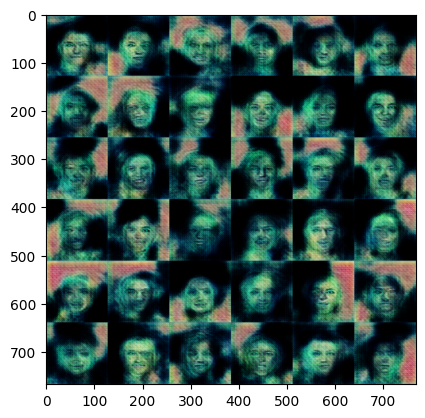

Training Progress:  23%|██▎       | 3500/15000 [18:51<1:23:20,  2.30step/s]

****************************************************************************************************
1/1 [==============================] - 0s 17ms/step


Training Progress:  23%|██▎       | 3501/15000 [18:51<1:18:32,  2.44step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  23%|██▎       | 3502/15000 [18:52<1:12:40,  2.64step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  23%|██▎       | 3503/15000 [18:52<1:10:58,  2.70step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  23%|██▎       | 3504/15000 [18:52<1:07:38,  2.83step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  23%|██▎       | 3505/15000 [18:53<1:07:24,  2.84step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  23%|██▎       | 3506/15000 [18:53<1:05:09,  2.94step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  23%|██▎       | 3507/15000 [18:53<1:03:49,  3.00step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  23%|██▎       | 3508/15000 [18:54<1:02:35,  3.06step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  23%|██▎       | 3509/15000 [18:54<1:03:53,  3.00step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  23%|██▎       | 3510/15000 [18:54<1:02:39,  3.06step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  23%|██▎       | 3511/15000 [18:55<1:03:55,  3.00step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  23%|██▎       | 3512/15000 [18:55<1:02:31,  3.06step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  23%|██▎       | 3513/15000 [18:55<1:01:46,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  23%|██▎       | 3514/15000 [18:56<1:01:09,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  23%|██▎       | 3515/15000 [18:56<1:00:35,  3.16step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  23%|██▎       | 3516/15000 [18:56<1:00:41,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  23%|██▎       | 3517/15000 [18:56<1:00:20,  3.17step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  23%|██▎       | 3518/15000 [18:57<1:00:17,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  23%|██▎       | 3519/15000 [18:57<1:00:02,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  23%|██▎       | 3520/15000 [18:57<59:52,  3.20step/s]  

1/1 [==============================] - 0s 16ms/step


Training Progress:  23%|██▎       | 3521/15000 [18:58<59:35,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  23%|██▎       | 3522/15000 [18:58<59:29,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  23%|██▎       | 3523/15000 [18:58<59:26,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  23%|██▎       | 3524/15000 [18:59<59:20,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  24%|██▎       | 3525/15000 [18:59<59:22,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  24%|██▎       | 3526/15000 [18:59<59:26,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  24%|██▎       | 3527/15000 [19:00<59:25,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  24%|██▎       | 3528/15000 [19:00<59:20,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  24%|██▎       | 3529/15000 [19:00<1:01:13,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  24%|██▎       | 3530/15000 [19:01<1:00:31,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  24%|██▎       | 3531/15000 [19:01<59:53,  3.19step/s]  

1/1 [==============================] - 0s 16ms/step


Training Progress:  24%|██▎       | 3532/15000 [19:01<59:35,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  24%|██▎       | 3533/15000 [19:01<59:17,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  24%|██▎       | 3534/15000 [19:02<59:06,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  24%|██▎       | 3535/15000 [19:02<1:01:22,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  24%|██▎       | 3536/15000 [19:02<1:02:46,  3.04step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  24%|██▎       | 3537/15000 [19:03<1:03:36,  3.00step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  24%|██▎       | 3538/15000 [19:03<1:02:21,  3.06step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  24%|██▎       | 3539/15000 [19:03<1:01:15,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  24%|██▎       | 3540/15000 [19:04<1:00:31,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  24%|██▎       | 3541/15000 [19:04<1:02:01,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  24%|██▎       | 3542/15000 [19:04<1:01:07,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  24%|██▎       | 3543/15000 [19:05<1:00:28,  3.16step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  24%|██▎       | 3544/15000 [19:05<1:00:42,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  24%|██▎       | 3545/15000 [19:05<1:00:19,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  24%|██▎       | 3546/15000 [19:06<59:58,  3.18step/s]  

1/1 [==============================] - 0s 16ms/step


Training Progress:  24%|██▎       | 3547/15000 [19:06<59:31,  3.21step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  24%|██▎       | 3548/15000 [19:06<1:00:01,  3.18step/s]

1/1 [==============================] - 0s 45ms/step


Training Progress:  24%|██▎       | 3549/15000 [19:07<1:06:53,  2.85step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  24%|██▎       | 3550/15000 [19:07<1:13:18,  2.60step/s]

1/1 [==============================] - 0s 28ms/step


Training Progress:  24%|██▎       | 3551/15000 [19:08<1:17:16,  2.47step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  24%|██▎       | 3552/15000 [19:08<1:12:27,  2.63step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  24%|██▎       | 3553/15000 [19:08<1:09:03,  2.76step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  24%|██▎       | 3554/15000 [19:09<1:06:31,  2.87step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  24%|██▎       | 3555/15000 [19:09<1:04:18,  2.97step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  24%|██▎       | 3556/15000 [19:09<1:02:54,  3.03step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  24%|██▎       | 3557/15000 [19:10<1:01:38,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  24%|██▎       | 3558/15000 [19:10<1:00:56,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  24%|██▎       | 3559/15000 [19:10<1:00:16,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  24%|██▎       | 3560/15000 [19:10<59:59,  3.18step/s]  

1/1 [==============================] - 0s 17ms/step


Training Progress:  24%|██▎       | 3561/15000 [19:11<59:41,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  24%|██▎       | 3562/15000 [19:11<1:00:00,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  24%|██▍       | 3563/15000 [19:11<59:39,  3.20step/s]  

1/1 [==============================] - 0s 17ms/step


Training Progress:  24%|██▍       | 3564/15000 [19:12<59:34,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  24%|██▍       | 3565/15000 [19:12<59:15,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  24%|██▍       | 3566/15000 [19:12<1:02:12,  3.06step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  24%|██▍       | 3567/15000 [19:13<1:01:07,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  24%|██▍       | 3568/15000 [19:13<1:00:36,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  24%|██▍       | 3569/15000 [19:13<1:00:06,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  24%|██▍       | 3570/15000 [19:14<59:46,  3.19step/s]  

1/1 [==============================] - 0s 16ms/step


Training Progress:  24%|██▍       | 3571/15000 [19:14<59:17,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  24%|██▍       | 3572/15000 [19:14<59:28,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  24%|██▍       | 3573/15000 [19:15<59:13,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  24%|██▍       | 3574/15000 [19:15<59:08,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  24%|██▍       | 3575/15000 [19:15<58:56,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  24%|██▍       | 3576/15000 [19:15<58:57,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  24%|██▍       | 3577/15000 [19:16<58:48,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  24%|██▍       | 3578/15000 [19:16<58:47,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  24%|██▍       | 3579/15000 [19:16<59:11,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  24%|██▍       | 3580/15000 [19:17<59:00,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  24%|██▍       | 3581/15000 [19:17<59:50,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  24%|██▍       | 3582/15000 [19:17<59:45,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  24%|██▍       | 3583/15000 [19:18<59:43,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  24%|██▍       | 3584/15000 [19:18<59:27,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  24%|██▍       | 3585/15000 [19:18<59:21,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  24%|██▍       | 3586/15000 [19:19<59:32,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  24%|██▍       | 3587/15000 [19:19<59:44,  3.18step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  24%|██▍       | 3588/15000 [19:19<59:47,  3.18step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  24%|██▍       | 3589/15000 [19:20<1:00:02,  3.17step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  24%|██▍       | 3590/15000 [19:20<1:00:13,  3.16step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  24%|██▍       | 3591/15000 [19:20<1:00:08,  3.16step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  24%|██▍       | 3592/15000 [19:21<1:01:50,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  24%|██▍       | 3593/15000 [19:21<1:03:08,  3.01step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  24%|██▍       | 3594/15000 [19:21<1:01:44,  3.08step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  24%|██▍       | 3595/15000 [19:21<1:01:01,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  24%|██▍       | 3596/15000 [19:22<1:00:19,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  24%|██▍       | 3597/15000 [19:22<59:53,  3.17step/s]  

1/1 [==============================] - 0s 18ms/step


Training Progress:  24%|██▍       | 3598/15000 [19:22<1:01:36,  3.08step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  24%|██▍       | 3599/15000 [19:23<1:01:18,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  24%|██▍       | 3600/15000 [19:23<1:00:35,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  24%|██▍       | 3601/15000 [19:23<1:00:12,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  24%|██▍       | 3602/15000 [19:24<59:42,  3.18step/s]  

1/1 [==============================] - 0s 16ms/step


Training Progress:  24%|██▍       | 3603/15000 [19:24<59:28,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  24%|██▍       | 3604/15000 [19:24<59:16,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  24%|██▍       | 3605/15000 [19:25<59:09,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  24%|██▍       | 3606/15000 [19:25<58:51,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  24%|██▍       | 3607/15000 [19:25<58:55,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  24%|██▍       | 3608/15000 [19:26<1:00:48,  3.12step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  24%|██▍       | 3609/15000 [19:26<1:00:34,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  24%|██▍       | 3610/15000 [19:26<59:50,  3.17step/s]  

1/1 [==============================] - 0s 16ms/step


Training Progress:  24%|██▍       | 3611/15000 [19:27<59:26,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  24%|██▍       | 3612/15000 [19:27<58:57,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  24%|██▍       | 3613/15000 [19:27<58:51,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  24%|██▍       | 3614/15000 [19:27<1:00:40,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  24%|██▍       | 3615/15000 [19:28<59:58,  3.16step/s]  

1/1 [==============================] - 0s 16ms/step


Training Progress:  24%|██▍       | 3616/15000 [19:28<59:21,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  24%|██▍       | 3617/15000 [19:28<59:07,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  24%|██▍       | 3618/15000 [19:29<59:04,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  24%|██▍       | 3619/15000 [19:29<58:57,  3.22step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  24%|██▍       | 3620/15000 [19:29<58:53,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  24%|██▍       | 3621/15000 [19:30<58:49,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  24%|██▍       | 3622/15000 [19:30<58:34,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  24%|██▍       | 3623/15000 [19:30<58:27,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  24%|██▍       | 3624/15000 [19:31<58:15,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  24%|██▍       | 3625/15000 [19:31<58:19,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  24%|██▍       | 3626/15000 [19:31<58:17,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  24%|██▍       | 3627/15000 [19:31<58:39,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  24%|██▍       | 3628/15000 [19:32<58:31,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  24%|██▍       | 3629/15000 [19:32<58:52,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  24%|██▍       | 3630/15000 [19:32<1:00:51,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  24%|██▍       | 3631/15000 [19:33<1:02:10,  3.05step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  24%|██▍       | 3632/15000 [19:33<1:00:58,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  24%|██▍       | 3633/15000 [19:33<1:00:16,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  24%|██▍       | 3634/15000 [19:34<59:39,  3.18step/s]  

1/1 [==============================] - 0s 17ms/step


Training Progress:  24%|██▍       | 3635/15000 [19:34<59:15,  3.20step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  24%|██▍       | 3636/15000 [19:34<59:21,  3.19step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  24%|██▍       | 3637/15000 [19:35<1:16:10,  2.49step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  24%|██▍       | 3638/15000 [19:35<1:11:03,  2.66step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  24%|██▍       | 3639/15000 [19:36<1:07:46,  2.79step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  24%|██▍       | 3640/15000 [19:36<1:05:19,  2.90step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  24%|██▍       | 3641/15000 [19:36<1:03:39,  2.97step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  24%|██▍       | 3642/15000 [19:37<1:02:16,  3.04step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  24%|██▍       | 3643/15000 [19:37<1:01:26,  3.08step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  24%|██▍       | 3644/15000 [19:37<1:00:47,  3.11step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  24%|██▍       | 3645/15000 [19:37<1:00:29,  3.13step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  24%|██▍       | 3646/15000 [19:38<1:02:32,  3.03step/s]

1/1 [==============================] - 0s 30ms/step


Training Progress:  24%|██▍       | 3647/15000 [19:38<1:08:49,  2.75step/s]

1/1 [==============================] - 0s 31ms/step


Training Progress:  24%|██▍       | 3648/15000 [19:39<1:12:18,  2.62step/s]

1/1 [==============================] - 0s 31ms/step


Training Progress:  24%|██▍       | 3649/15000 [19:39<1:14:40,  2.53step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  24%|██▍       | 3650/15000 [19:39<1:10:11,  2.69step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  24%|██▍       | 3651/15000 [19:40<1:07:04,  2.82step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  24%|██▍       | 3652/15000 [19:40<1:05:02,  2.91step/s]

1/1 [==============================] - 0s 23ms/step


Training Progress:  24%|██▍       | 3653/15000 [19:40<1:03:53,  2.96step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  24%|██▍       | 3654/15000 [19:41<1:02:50,  3.01step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  24%|██▍       | 3655/15000 [19:41<1:02:20,  3.03step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  24%|██▍       | 3656/15000 [19:41<1:01:48,  3.06step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  24%|██▍       | 3657/15000 [19:42<1:01:09,  3.09step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  24%|██▍       | 3658/15000 [19:42<1:00:36,  3.12step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  24%|██▍       | 3659/15000 [19:42<1:02:45,  3.01step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  24%|██▍       | 3660/15000 [19:43<1:01:47,  3.06step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  24%|██▍       | 3661/15000 [19:43<1:01:21,  3.08step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  24%|██▍       | 3662/15000 [19:43<1:00:42,  3.11step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  24%|██▍       | 3663/15000 [19:44<1:00:27,  3.13step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  24%|██▍       | 3664/15000 [19:44<1:00:25,  3.13step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  24%|██▍       | 3665/15000 [19:44<1:02:20,  3.03step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  24%|██▍       | 3666/15000 [19:45<1:01:22,  3.08step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  24%|██▍       | 3667/15000 [19:45<1:00:57,  3.10step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  24%|██▍       | 3668/15000 [19:45<1:00:23,  3.13step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  24%|██▍       | 3669/15000 [19:46<1:00:11,  3.14step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  24%|██▍       | 3670/15000 [19:46<59:57,  3.15step/s]  

1/1 [==============================] - 0s 21ms/step


Training Progress:  24%|██▍       | 3671/15000 [19:46<59:57,  3.15step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  24%|██▍       | 3672/15000 [19:46<59:42,  3.16step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  24%|██▍       | 3673/15000 [19:47<1:00:12,  3.14step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  24%|██▍       | 3674/15000 [19:47<59:57,  3.15step/s]  

1/1 [==============================] - 0s 21ms/step


Training Progress:  24%|██▍       | 3675/15000 [19:47<59:55,  3.15step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  25%|██▍       | 3676/15000 [19:48<59:34,  3.17step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  25%|██▍       | 3677/15000 [19:48<59:29,  3.17step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  25%|██▍       | 3678/15000 [19:48<1:01:28,  3.07step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  25%|██▍       | 3679/15000 [19:49<1:01:16,  3.08step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  25%|██▍       | 3680/15000 [19:49<1:00:46,  3.10step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  25%|██▍       | 3681/15000 [19:49<1:00:46,  3.10step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  25%|██▍       | 3682/15000 [19:50<1:00:36,  3.11step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  25%|██▍       | 3683/15000 [19:50<1:00:17,  3.13step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  25%|██▍       | 3684/15000 [19:50<59:52,  3.15step/s]  

1/1 [==============================] - 0s 20ms/step


Training Progress:  25%|██▍       | 3685/15000 [19:51<59:47,  3.15step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  25%|██▍       | 3686/15000 [19:51<59:29,  3.17step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  25%|██▍       | 3687/15000 [19:51<59:25,  3.17step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  25%|██▍       | 3688/15000 [19:52<59:21,  3.18step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  25%|██▍       | 3689/15000 [19:52<59:20,  3.18step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  25%|██▍       | 3690/15000 [19:52<1:03:21,  2.98step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  25%|██▍       | 3691/15000 [19:53<1:03:15,  2.98step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  25%|██▍       | 3692/15000 [19:53<1:02:01,  3.04step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  25%|██▍       | 3693/15000 [19:53<1:01:19,  3.07step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  25%|██▍       | 3694/15000 [19:54<1:00:41,  3.11step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  25%|██▍       | 3695/15000 [19:54<1:00:30,  3.11step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  25%|██▍       | 3696/15000 [19:54<1:00:00,  3.14step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  25%|██▍       | 3697/15000 [19:55<1:01:54,  3.04step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  25%|██▍       | 3698/15000 [19:55<1:01:05,  3.08step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  25%|██▍       | 3699/15000 [19:55<1:00:32,  3.11step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  25%|██▍       | 3700/15000 [19:56<1:00:22,  3.12step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  25%|██▍       | 3701/15000 [19:56<1:00:10,  3.13step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  25%|██▍       | 3702/15000 [19:56<1:01:52,  3.04step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  25%|██▍       | 3703/15000 [19:56<1:01:04,  3.08step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  25%|██▍       | 3704/15000 [19:57<1:00:32,  3.11step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  25%|██▍       | 3705/15000 [19:57<1:00:06,  3.13step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  25%|██▍       | 3706/15000 [19:57<1:01:43,  3.05step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  25%|██▍       | 3707/15000 [19:58<1:00:43,  3.10step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  25%|██▍       | 3708/15000 [19:58<1:00:06,  3.13step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  25%|██▍       | 3709/15000 [19:58<59:47,  3.15step/s]  

1/1 [==============================] - 0s 19ms/step


Training Progress:  25%|██▍       | 3710/15000 [19:59<59:58,  3.14step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  25%|██▍       | 3711/15000 [19:59<59:38,  3.16step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  25%|██▍       | 3712/15000 [19:59<59:20,  3.17step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  25%|██▍       | 3713/15000 [20:00<58:57,  3.19step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  25%|██▍       | 3714/15000 [20:00<58:45,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  25%|██▍       | 3715/15000 [20:00<1:00:38,  3.10step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  25%|██▍       | 3716/15000 [20:01<59:56,  3.14step/s]  

1/1 [==============================] - 0s 18ms/step


Training Progress:  25%|██▍       | 3717/15000 [20:01<59:19,  3.17step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  25%|██▍       | 3718/15000 [20:01<58:56,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  25%|██▍       | 3719/15000 [20:02<59:06,  3.18step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  25%|██▍       | 3720/15000 [20:02<58:52,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  25%|██▍       | 3721/15000 [20:02<58:38,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  25%|██▍       | 3722/15000 [20:02<59:30,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  25%|██▍       | 3723/15000 [20:03<1:01:04,  3.08step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  25%|██▍       | 3724/15000 [20:03<1:00:13,  3.12step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  25%|██▍       | 3725/15000 [20:03<59:38,  3.15step/s]  

1/1 [==============================] - 0s 17ms/step


Training Progress:  25%|██▍       | 3726/15000 [20:04<59:04,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  25%|██▍       | 3727/15000 [20:04<58:41,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  25%|██▍       | 3728/15000 [20:04<58:55,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  25%|██▍       | 3729/15000 [20:05<58:35,  3.21step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  25%|██▍       | 3730/15000 [20:05<58:26,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  25%|██▍       | 3731/15000 [20:05<58:16,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  25%|██▍       | 3732/15000 [20:06<58:07,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  25%|██▍       | 3733/15000 [20:06<57:57,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  25%|██▍       | 3734/15000 [20:06<57:53,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  25%|██▍       | 3735/15000 [20:07<57:39,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  25%|██▍       | 3736/15000 [20:07<57:30,  3.26step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  25%|██▍       | 3737/15000 [20:07<57:54,  3.24step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  25%|██▍       | 3738/15000 [20:07<58:04,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  25%|██▍       | 3739/15000 [20:08<57:57,  3.24step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  25%|██▍       | 3740/15000 [20:08<57:58,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  25%|██▍       | 3741/15000 [20:08<57:53,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  25%|██▍       | 3742/15000 [20:09<57:44,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  25%|██▍       | 3743/15000 [20:09<57:36,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  25%|██▍       | 3744/15000 [20:09<1:00:34,  3.10step/s]

1/1 [==============================] - 0s 27ms/step


Training Progress:  25%|██▍       | 3745/15000 [20:10<1:03:32,  2.95step/s]

1/1 [==============================] - 0s 23ms/step


Training Progress:  25%|██▍       | 3746/15000 [20:10<1:07:36,  2.77step/s]

1/1 [==============================] - 0s 28ms/step


Training Progress:  25%|██▍       | 3747/15000 [20:11<1:09:09,  2.71step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  25%|██▍       | 3748/15000 [20:11<1:05:43,  2.85step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  25%|██▍       | 3749/15000 [20:11<1:05:09,  2.88step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  25%|██▌       | 3750/15000 [20:11<1:02:51,  2.98step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:  25%|██▌       | 3751/15000 [20:12<1:01:01,  3.07step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  25%|██▌       | 3752/15000 [20:12<59:48,  3.13step/s]  

1/1 [==============================] - 0s 18ms/step


Training Progress:  25%|██▌       | 3753/15000 [20:12<1:01:20,  3.06step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  25%|██▌       | 3754/15000 [20:13<1:00:13,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  25%|██▌       | 3755/15000 [20:13<59:24,  3.15step/s]  

1/1 [==============================] - 0s 17ms/step


Training Progress:  25%|██▌       | 3756/15000 [20:13<59:09,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  25%|██▌       | 3757/15000 [20:14<1:00:43,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  25%|██▌       | 3758/15000 [20:14<59:40,  3.14step/s]  

1/1 [==============================] - 0s 16ms/step


Training Progress:  25%|██▌       | 3759/15000 [20:14<1:00:55,  3.07step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  25%|██▌       | 3760/15000 [20:15<59:49,  3.13step/s]  

1/1 [==============================] - 0s 16ms/step


Training Progress:  25%|██▌       | 3761/15000 [20:15<1:01:07,  3.06step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  25%|██▌       | 3762/15000 [20:15<1:00:00,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  25%|██▌       | 3763/15000 [20:16<59:15,  3.16step/s]  

1/1 [==============================] - 0s 16ms/step


Training Progress:  25%|██▌       | 3764/15000 [20:16<1:00:39,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  25%|██▌       | 3765/15000 [20:16<1:00:02,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  25%|██▌       | 3766/15000 [20:17<59:16,  3.16step/s]  

1/1 [==============================] - 0s 16ms/step


Training Progress:  25%|██▌       | 3767/15000 [20:17<58:42,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  25%|██▌       | 3768/15000 [20:17<58:13,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  25%|██▌       | 3769/15000 [20:18<58:02,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  25%|██▌       | 3770/15000 [20:18<57:38,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  25%|██▌       | 3771/15000 [20:18<57:25,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  25%|██▌       | 3772/15000 [20:18<57:18,  3.27step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  25%|██▌       | 3773/15000 [20:19<57:16,  3.27step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  25%|██▌       | 3774/15000 [20:19<57:30,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  25%|██▌       | 3775/15000 [20:19<57:32,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  25%|██▌       | 3776/15000 [20:20<57:33,  3.25step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  25%|██▌       | 3777/15000 [20:20<57:48,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  25%|██▌       | 3778/15000 [20:20<57:45,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  25%|██▌       | 3779/15000 [20:21<57:27,  3.25step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:  25%|██▌       | 3780/15000 [20:21<57:14,  3.27step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:  25%|██▌       | 3781/15000 [20:21<59:10,  3.16step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  25%|██▌       | 3782/15000 [20:22<58:54,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  25%|██▌       | 3783/15000 [20:22<1:00:20,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  25%|██▌       | 3784/15000 [20:22<1:00:05,  3.11step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  25%|██▌       | 3785/15000 [20:23<1:00:02,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  25%|██▌       | 3786/15000 [20:23<59:08,  3.16step/s]  

1/1 [==============================] - 0s 16ms/step


Training Progress:  25%|██▌       | 3787/15000 [20:23<58:28,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  25%|██▌       | 3788/15000 [20:23<58:17,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  25%|██▌       | 3789/15000 [20:24<57:59,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  25%|██▌       | 3790/15000 [20:24<59:36,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  25%|██▌       | 3791/15000 [20:24<58:49,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  25%|██▌       | 3792/15000 [20:25<58:21,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  25%|██▌       | 3793/15000 [20:25<58:24,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  25%|██▌       | 3794/15000 [20:25<58:00,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  25%|██▌       | 3795/15000 [20:26<57:46,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  25%|██▌       | 3796/15000 [20:26<57:34,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  25%|██▌       | 3797/15000 [20:26<57:20,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  25%|██▌       | 3798/15000 [20:27<57:27,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  25%|██▌       | 3799/15000 [20:27<57:15,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  25%|██▌       | 3800/15000 [20:27<57:09,  3.27step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  25%|██▌       | 3801/15000 [20:27<57:15,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  25%|██▌       | 3802/15000 [20:28<57:23,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  25%|██▌       | 3803/15000 [20:28<57:22,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  25%|██▌       | 3804/15000 [20:28<57:22,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  25%|██▌       | 3805/15000 [20:29<59:24,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  25%|██▌       | 3806/15000 [20:29<58:41,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  25%|██▌       | 3807/15000 [20:29<58:18,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  25%|██▌       | 3808/15000 [20:30<57:54,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  25%|██▌       | 3809/15000 [20:30<57:33,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  25%|██▌       | 3810/15000 [20:30<57:31,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  25%|██▌       | 3811/15000 [20:31<57:46,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  25%|██▌       | 3812/15000 [20:31<57:30,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  25%|██▌       | 3813/15000 [20:31<57:29,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  25%|██▌       | 3814/15000 [20:31<57:29,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  25%|██▌       | 3815/15000 [20:32<57:22,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  25%|██▌       | 3816/15000 [20:32<57:30,  3.24step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  25%|██▌       | 3817/15000 [20:32<59:33,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  25%|██▌       | 3818/15000 [20:33<58:54,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  25%|██▌       | 3819/15000 [20:33<58:20,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  25%|██▌       | 3820/15000 [20:33<57:51,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  25%|██▌       | 3821/15000 [20:34<58:01,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  25%|██▌       | 3822/15000 [20:34<57:50,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  25%|██▌       | 3823/15000 [20:34<57:40,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  25%|██▌       | 3824/15000 [20:35<57:32,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  26%|██▌       | 3825/15000 [20:35<57:28,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  26%|██▌       | 3826/15000 [20:35<57:11,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  26%|██▌       | 3827/15000 [20:36<57:14,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  26%|██▌       | 3828/15000 [20:36<57:06,  3.26step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:  26%|██▌       | 3829/15000 [20:36<57:03,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  26%|██▌       | 3830/15000 [20:36<57:20,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  26%|██▌       | 3831/15000 [20:37<59:14,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  26%|██▌       | 3832/15000 [20:37<58:31,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  26%|██▌       | 3833/15000 [20:37<58:25,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  26%|██▌       | 3834/15000 [20:38<57:54,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  26%|██▌       | 3835/15000 [20:38<57:51,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  26%|██▌       | 3836/15000 [20:38<57:42,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  26%|██▌       | 3837/15000 [20:39<57:28,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  26%|██▌       | 3838/15000 [20:39<57:26,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  26%|██▌       | 3839/15000 [20:39<57:41,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  26%|██▌       | 3840/15000 [20:40<57:37,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  26%|██▌       | 3841/15000 [20:40<57:25,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  26%|██▌       | 3842/15000 [20:40<57:20,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  26%|██▌       | 3843/15000 [20:40<57:07,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  26%|██▌       | 3844/15000 [20:41<1:01:12,  3.04step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  26%|██▌       | 3845/15000 [20:41<1:06:02,  2.82step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  26%|██▌       | 3846/15000 [20:42<1:11:04,  2.62step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  26%|██▌       | 3847/15000 [20:42<1:10:41,  2.63step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  26%|██▌       | 3848/15000 [20:42<1:07:00,  2.77step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  26%|██▌       | 3849/15000 [20:43<1:04:11,  2.90step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  26%|██▌       | 3850/15000 [20:43<1:02:07,  2.99step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  26%|██▌       | 3851/15000 [20:43<1:00:46,  3.06step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  26%|██▌       | 3852/15000 [20:44<59:42,  3.11step/s]  

1/1 [==============================] - 0s 17ms/step


Training Progress:  26%|██▌       | 3853/15000 [20:44<1:00:52,  3.05step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  26%|██▌       | 3854/15000 [20:44<1:01:39,  3.01step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  26%|██▌       | 3855/15000 [20:45<1:00:18,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  26%|██▌       | 3856/15000 [20:45<59:16,  3.13step/s]  

1/1 [==============================] - 0s 16ms/step


Training Progress:  26%|██▌       | 3857/15000 [20:45<58:32,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  26%|██▌       | 3858/15000 [20:46<1:00:25,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  26%|██▌       | 3859/15000 [20:46<59:29,  3.12step/s]  

1/1 [==============================] - 0s 17ms/step


Training Progress:  26%|██▌       | 3860/15000 [20:46<58:42,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  26%|██▌       | 3861/15000 [20:47<58:13,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  26%|██▌       | 3862/15000 [20:47<57:48,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  26%|██▌       | 3863/15000 [20:47<57:38,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  26%|██▌       | 3864/15000 [20:47<57:26,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  26%|██▌       | 3865/15000 [20:48<57:13,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  26%|██▌       | 3866/15000 [20:48<56:58,  3.26step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  26%|██▌       | 3867/15000 [20:48<57:22,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  26%|██▌       | 3868/15000 [20:49<57:11,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  26%|██▌       | 3869/15000 [20:49<59:04,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  26%|██▌       | 3870/15000 [20:49<58:30,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  26%|██▌       | 3871/15000 [20:50<58:12,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  26%|██▌       | 3872/15000 [20:50<59:42,  3.11step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  26%|██▌       | 3873/15000 [20:50<59:11,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  26%|██▌       | 3874/15000 [20:51<58:31,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  26%|██▌       | 3875/15000 [20:51<58:07,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  26%|██▌       | 3876/15000 [20:51<58:05,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  26%|██▌       | 3877/15000 [20:52<57:48,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  26%|██▌       | 3878/15000 [20:52<57:28,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  26%|██▌       | 3879/15000 [20:52<57:19,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  26%|██▌       | 3880/15000 [20:52<57:25,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  26%|██▌       | 3881/15000 [20:53<57:19,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  26%|██▌       | 3882/15000 [20:53<57:04,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  26%|██▌       | 3883/15000 [20:53<57:00,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  26%|██▌       | 3884/15000 [20:54<56:57,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  26%|██▌       | 3885/15000 [20:54<57:15,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  26%|██▌       | 3886/15000 [20:54<57:06,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  26%|██▌       | 3887/15000 [20:55<57:05,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  26%|██▌       | 3888/15000 [20:55<58:53,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  26%|██▌       | 3889/15000 [20:55<58:17,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  26%|██▌       | 3890/15000 [20:56<57:44,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  26%|██▌       | 3891/15000 [20:56<57:32,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  26%|██▌       | 3892/15000 [20:56<59:14,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  26%|██▌       | 3893/15000 [20:57<58:35,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  26%|██▌       | 3894/15000 [20:57<58:01,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  26%|██▌       | 3895/15000 [20:57<58:01,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  26%|██▌       | 3896/15000 [20:57<57:47,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  26%|██▌       | 3897/15000 [20:58<57:47,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  26%|██▌       | 3898/15000 [20:58<57:28,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  26%|██▌       | 3899/15000 [20:58<57:15,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  26%|██▌       | 3900/15000 [20:59<57:02,  3.24step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  26%|██▌       | 3901/15000 [20:59<57:25,  3.22step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  26%|██▌       | 3902/15000 [20:59<57:37,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  26%|██▌       | 3903/15000 [21:00<57:27,  3.22step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  26%|██▌       | 3904/15000 [21:00<58:01,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  26%|██▌       | 3905/15000 [21:00<57:41,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  26%|██▌       | 3906/15000 [21:01<57:33,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  26%|██▌       | 3907/15000 [21:01<57:54,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  26%|██▌       | 3908/15000 [21:01<57:42,  3.20step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  26%|██▌       | 3909/15000 [21:02<57:49,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  26%|██▌       | 3910/15000 [21:02<57:29,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  26%|██▌       | 3911/15000 [21:02<57:26,  3.22step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  26%|██▌       | 3912/15000 [21:02<59:36,  3.10step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  26%|██▌       | 3913/15000 [21:03<59:29,  3.11step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  26%|██▌       | 3914/15000 [21:03<59:07,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  26%|██▌       | 3915/15000 [21:03<58:40,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  26%|██▌       | 3916/15000 [21:04<58:08,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  26%|██▌       | 3917/15000 [21:04<57:49,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  26%|██▌       | 3918/15000 [21:04<57:28,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  26%|██▌       | 3919/15000 [21:05<57:22,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  26%|██▌       | 3920/15000 [21:05<59:19,  3.11step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  26%|██▌       | 3921/15000 [21:05<59:11,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  26%|██▌       | 3922/15000 [21:06<58:51,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  26%|██▌       | 3923/15000 [21:06<58:29,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  26%|██▌       | 3924/15000 [21:06<58:03,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  26%|██▌       | 3925/15000 [21:07<57:47,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  26%|██▌       | 3926/15000 [21:07<57:27,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  26%|██▌       | 3927/15000 [21:07<57:35,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  26%|██▌       | 3928/15000 [21:07<57:30,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  26%|██▌       | 3929/15000 [21:08<57:30,  3.21step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  26%|██▌       | 3930/15000 [21:08<57:36,  3.20step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  26%|██▌       | 3931/15000 [21:08<57:53,  3.19step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  26%|██▌       | 3932/15000 [21:09<58:17,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  26%|██▌       | 3933/15000 [21:09<58:12,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  26%|██▌       | 3934/15000 [21:09<57:49,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  26%|██▌       | 3935/15000 [21:10<57:52,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  26%|██▌       | 3936/15000 [21:10<57:34,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  26%|██▌       | 3937/15000 [21:10<59:26,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  26%|██▋       | 3938/15000 [21:11<58:35,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  26%|██▋       | 3939/15000 [21:11<58:07,  3.17step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  26%|██▋       | 3940/15000 [21:11<57:51,  3.19step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  26%|██▋       | 3941/15000 [21:12<58:08,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  26%|██▋       | 3942/15000 [21:12<57:45,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  26%|██▋       | 3943/15000 [21:12<1:03:53,  2.88step/s]

1/1 [==============================] - 0s 37ms/step


Training Progress:  26%|██▋       | 3944/15000 [21:13<1:07:28,  2.73step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  26%|██▋       | 3945/15000 [21:13<1:10:31,  2.61step/s]

1/1 [==============================] - 0s 31ms/step


Training Progress:  26%|██▋       | 3946/15000 [21:14<1:10:40,  2.61step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  26%|██▋       | 3947/15000 [21:14<1:06:33,  2.77step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  26%|██▋       | 3948/15000 [21:14<1:03:29,  2.90step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  26%|██▋       | 3949/15000 [21:14<1:01:23,  3.00step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  26%|██▋       | 3950/15000 [21:15<1:00:21,  3.05step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  26%|██▋       | 3951/15000 [21:15<59:19,  3.10step/s]  

1/1 [==============================] - 0s 17ms/step


Training Progress:  26%|██▋       | 3952/15000 [21:15<58:38,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  26%|██▋       | 3953/15000 [21:16<58:08,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  26%|██▋       | 3954/15000 [21:16<57:48,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  26%|██▋       | 3955/15000 [21:16<57:33,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  26%|██▋       | 3956/15000 [21:17<57:27,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  26%|██▋       | 3957/15000 [21:17<57:31,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  26%|██▋       | 3958/15000 [21:17<57:25,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  26%|██▋       | 3959/15000 [21:18<57:30,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  26%|██▋       | 3960/15000 [21:18<57:30,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  26%|██▋       | 3961/15000 [21:18<57:18,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  26%|██▋       | 3962/15000 [21:19<57:13,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  26%|██▋       | 3963/15000 [21:19<56:59,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  26%|██▋       | 3964/15000 [21:19<56:50,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  26%|██▋       | 3965/15000 [21:19<56:47,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  26%|██▋       | 3966/15000 [21:20<56:51,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  26%|██▋       | 3967/15000 [21:20<56:51,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  26%|██▋       | 3968/15000 [21:20<58:51,  3.12step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  26%|██▋       | 3969/15000 [21:21<58:32,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  26%|██▋       | 3970/15000 [21:21<58:07,  3.16step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  26%|██▋       | 3971/15000 [21:21<58:03,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  26%|██▋       | 3972/15000 [21:22<57:54,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  26%|██▋       | 3973/15000 [21:22<59:30,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  26%|██▋       | 3974/15000 [21:22<58:38,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  26%|██▋       | 3975/15000 [21:23<58:28,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  27%|██▋       | 3976/15000 [21:23<59:54,  3.07step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  27%|██▋       | 3977/15000 [21:23<58:52,  3.12step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  27%|██▋       | 3978/15000 [21:24<58:48,  3.12step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  27%|██▋       | 3979/15000 [21:24<58:26,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  27%|██▋       | 3980/15000 [21:24<59:56,  3.06step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  27%|██▋       | 3981/15000 [21:25<59:04,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  27%|██▋       | 3982/15000 [21:25<58:16,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  27%|██▋       | 3983/15000 [21:25<57:54,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  27%|██▋       | 3984/15000 [21:25<57:34,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  27%|██▋       | 3985/15000 [21:26<57:16,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  27%|██▋       | 3986/15000 [21:26<57:03,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  27%|██▋       | 3987/15000 [21:26<59:16,  3.10step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  27%|██▋       | 3988/15000 [21:27<58:41,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  27%|██▋       | 3989/15000 [21:27<58:14,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  27%|██▋       | 3990/15000 [21:27<57:54,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  27%|██▋       | 3991/15000 [21:28<57:53,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  27%|██▋       | 3992/15000 [21:28<57:29,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  27%|██▋       | 3993/15000 [21:28<57:40,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  27%|██▋       | 3994/15000 [21:29<57:34,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  27%|██▋       | 3995/15000 [21:29<57:23,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  27%|██▋       | 3996/15000 [21:29<57:46,  3.17step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  27%|██▋       | 3997/15000 [21:30<57:52,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  27%|██▋       | 3998/15000 [21:30<57:39,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  27%|██▋       | 3999/15000 [21:30<57:31,  3.19step/s]

1/1 [==============================] - 0s 19ms/step
****************************************************************************************************
4000/15000: d_loss: 0.139719,  g_loss: 0.007404
2/2 [==============================] - 0s 20ms/step


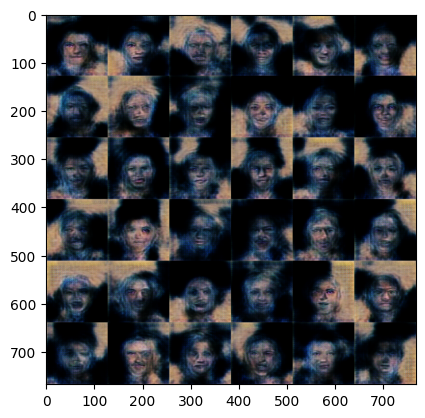

Training Progress:  27%|██▋       | 4000/15000 [21:31<1:22:27,  2.22step/s]

****************************************************************************************************
1/1 [==============================] - 0s 19ms/step


Training Progress:  27%|██▋       | 4001/15000 [21:31<1:15:12,  2.44step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  27%|██▋       | 4002/15000 [21:32<1:09:46,  2.63step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  27%|██▋       | 4003/15000 [21:32<1:07:50,  2.70step/s]

1/1 [==============================] - 0s 23ms/step


Training Progress:  27%|██▋       | 4004/15000 [21:32<1:06:10,  2.77step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  27%|██▋       | 4005/15000 [21:33<1:04:36,  2.84step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  27%|██▋       | 4006/15000 [21:33<1:02:07,  2.95step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  27%|██▋       | 4007/15000 [21:33<1:00:39,  3.02step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  27%|██▋       | 4008/15000 [21:34<59:29,  3.08step/s]  

1/1 [==============================] - 0s 17ms/step


Training Progress:  27%|██▋       | 4009/15000 [21:34<59:03,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  27%|██▋       | 4010/15000 [21:34<58:18,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  27%|██▋       | 4011/15000 [21:35<59:46,  3.06step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  27%|██▋       | 4012/15000 [21:35<1:00:51,  3.01step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  27%|██▋       | 4013/15000 [21:35<59:49,  3.06step/s]  

1/1 [==============================] - 0s 17ms/step


Training Progress:  27%|██▋       | 4014/15000 [21:36<58:45,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  27%|██▋       | 4015/15000 [21:36<1:00:10,  3.04step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  27%|██▋       | 4016/15000 [21:36<59:22,  3.08step/s]  

1/1 [==============================] - 0s 16ms/step


Training Progress:  27%|██▋       | 4017/15000 [21:37<1:00:31,  3.02step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  27%|██▋       | 4018/15000 [21:37<59:44,  3.06step/s]  

1/1 [==============================] - 0s 17ms/step


Training Progress:  27%|██▋       | 4019/15000 [21:37<58:55,  3.11step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  27%|██▋       | 4020/15000 [21:37<58:19,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  27%|██▋       | 4021/15000 [21:38<59:46,  3.06step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  27%|██▋       | 4022/15000 [21:38<59:04,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  27%|██▋       | 4023/15000 [21:38<58:17,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  27%|██▋       | 4024/15000 [21:39<59:44,  3.06step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  27%|██▋       | 4025/15000 [21:39<58:43,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  27%|██▋       | 4026/15000 [21:39<58:12,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  27%|██▋       | 4027/15000 [21:40<58:00,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  27%|██▋       | 4028/15000 [21:40<57:33,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  27%|██▋       | 4029/15000 [21:40<57:11,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  27%|██▋       | 4030/15000 [21:41<56:54,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  27%|██▋       | 4031/15000 [21:41<56:41,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  27%|██▋       | 4032/15000 [21:41<56:40,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  27%|██▋       | 4033/15000 [21:42<56:44,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  27%|██▋       | 4034/15000 [21:42<56:38,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  27%|██▋       | 4035/15000 [21:42<56:29,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  27%|██▋       | 4036/15000 [21:42<57:43,  3.17step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  27%|██▋       | 4037/15000 [21:43<57:25,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  27%|██▋       | 4038/15000 [21:43<57:09,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  27%|██▋       | 4039/15000 [21:43<56:51,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  27%|██▋       | 4040/15000 [21:44<56:43,  3.22step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  27%|██▋       | 4041/15000 [21:44<1:00:50,  3.00step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  27%|██▋       | 4042/15000 [21:45<1:03:21,  2.88step/s]

1/1 [==============================] - 0s 27ms/step


Training Progress:  27%|██▋       | 4043/15000 [21:45<1:07:12,  2.72step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  27%|██▋       | 4044/15000 [21:45<1:04:57,  2.81step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  27%|██▋       | 4045/15000 [21:46<1:02:13,  2.93step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  27%|██▋       | 4046/15000 [21:46<1:00:49,  3.00step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  27%|██▋       | 4047/15000 [21:46<59:22,  3.07step/s]  

1/1 [==============================] - 0s 17ms/step


Training Progress:  27%|██▋       | 4048/15000 [21:47<1:00:30,  3.02step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  27%|██▋       | 4049/15000 [21:47<59:21,  3.07step/s]  

1/1 [==============================] - 0s 17ms/step


Training Progress:  27%|██▋       | 4050/15000 [21:47<58:32,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  27%|██▋       | 4051/15000 [21:47<57:48,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  27%|██▋       | 4052/15000 [21:48<57:21,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  27%|██▋       | 4053/15000 [21:48<56:50,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  27%|██▋       | 4054/15000 [21:48<56:44,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  27%|██▋       | 4055/15000 [21:49<56:42,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  27%|██▋       | 4056/15000 [21:49<56:34,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  27%|██▋       | 4057/15000 [21:49<56:31,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  27%|██▋       | 4058/15000 [21:50<56:24,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  27%|██▋       | 4059/15000 [21:50<56:12,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  27%|██▋       | 4060/15000 [21:50<56:08,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  27%|██▋       | 4061/15000 [21:51<56:00,  3.26step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  27%|██▋       | 4062/15000 [21:51<56:09,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  27%|██▋       | 4063/15000 [21:51<55:58,  3.26step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  27%|██▋       | 4064/15000 [21:51<56:28,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  27%|██▋       | 4065/15000 [21:52<56:22,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  27%|██▋       | 4066/15000 [21:52<58:36,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  27%|██▋       | 4067/15000 [21:52<58:16,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  27%|██▋       | 4068/15000 [21:53<57:35,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  27%|██▋       | 4069/15000 [21:53<57:09,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  27%|██▋       | 4070/15000 [21:53<57:05,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  27%|██▋       | 4071/15000 [21:54<56:56,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  27%|██▋       | 4072/15000 [21:54<56:44,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  27%|██▋       | 4073/15000 [21:54<58:53,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  27%|██▋       | 4074/15000 [21:55<58:12,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  27%|██▋       | 4075/15000 [21:55<57:38,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  27%|██▋       | 4076/15000 [21:55<59:17,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  27%|██▋       | 4077/15000 [21:56<58:22,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  27%|██▋       | 4078/15000 [21:56<57:39,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  27%|██▋       | 4079/15000 [21:56<57:10,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  27%|██▋       | 4080/15000 [21:57<56:53,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  27%|██▋       | 4081/15000 [21:57<56:41,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  27%|██▋       | 4082/15000 [21:57<56:32,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  27%|██▋       | 4083/15000 [21:57<56:54,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  27%|██▋       | 4084/15000 [21:58<56:52,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  27%|██▋       | 4085/15000 [21:58<56:48,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  27%|██▋       | 4086/15000 [21:58<56:33,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  27%|██▋       | 4087/15000 [21:59<58:21,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  27%|██▋       | 4088/15000 [21:59<57:40,  3.15step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  27%|██▋       | 4089/15000 [21:59<57:31,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  27%|██▋       | 4090/15000 [22:00<57:13,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  27%|██▋       | 4091/15000 [22:00<56:53,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  27%|██▋       | 4092/15000 [22:00<56:52,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  27%|██▋       | 4093/15000 [22:01<56:42,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  27%|██▋       | 4094/15000 [22:01<56:28,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  27%|██▋       | 4095/15000 [22:01<56:25,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  27%|██▋       | 4096/15000 [22:02<58:15,  3.12step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  27%|██▋       | 4097/15000 [22:02<57:49,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  27%|██▋       | 4098/15000 [22:02<59:26,  3.06step/s]

1/1 [==============================] - 0s 30ms/step


Training Progress:  27%|██▋       | 4099/15000 [22:03<1:02:27,  2.91step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  27%|██▋       | 4100/15000 [22:03<1:00:31,  3.00step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  27%|██▋       | 4101/15000 [22:03<59:38,  3.05step/s]  

1/1 [==============================] - 0s 18ms/step


Training Progress:  27%|██▋       | 4102/15000 [22:04<1:00:41,  2.99step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  27%|██▋       | 4103/15000 [22:04<59:51,  3.03step/s]  

1/1 [==============================] - 0s 18ms/step


Training Progress:  27%|██▋       | 4104/15000 [22:04<58:58,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  27%|██▋       | 4105/15000 [22:05<58:05,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  27%|██▋       | 4106/15000 [22:05<57:44,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  27%|██▋       | 4107/15000 [22:05<57:10,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  27%|██▋       | 4108/15000 [22:05<57:00,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  27%|██▋       | 4109/15000 [22:06<56:40,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  27%|██▋       | 4110/15000 [22:06<56:43,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  27%|██▋       | 4111/15000 [22:06<56:34,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  27%|██▋       | 4112/15000 [22:07<56:21,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  27%|██▋       | 4113/15000 [22:07<56:20,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  27%|██▋       | 4114/15000 [22:07<56:23,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  27%|██▋       | 4115/15000 [22:08<58:26,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  27%|██▋       | 4116/15000 [22:08<57:53,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  27%|██▋       | 4117/15000 [22:08<57:17,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  27%|██▋       | 4118/15000 [22:09<56:56,  3.19step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  27%|██▋       | 4119/15000 [22:09<56:57,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  27%|██▋       | 4120/15000 [22:09<57:11,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  27%|██▋       | 4121/15000 [22:10<57:02,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  27%|██▋       | 4122/15000 [22:10<56:53,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  27%|██▋       | 4123/15000 [22:10<56:37,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  27%|██▋       | 4124/15000 [22:10<56:25,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  28%|██▊       | 4125/15000 [22:11<56:16,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  28%|██▊       | 4126/15000 [22:11<56:04,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  28%|██▊       | 4127/15000 [22:11<56:02,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  28%|██▊       | 4128/15000 [22:12<55:54,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  28%|██▊       | 4129/15000 [22:12<58:06,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  28%|██▊       | 4130/15000 [22:12<59:43,  3.03step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  28%|██▊       | 4131/15000 [22:13<58:34,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  28%|██▊       | 4132/15000 [22:13<57:49,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  28%|██▊       | 4133/15000 [22:13<57:18,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  28%|██▊       | 4134/15000 [22:14<56:54,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  28%|██▊       | 4135/15000 [22:14<56:35,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  28%|██▊       | 4136/15000 [22:14<56:19,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  28%|██▊       | 4137/15000 [22:15<56:12,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  28%|██▊       | 4138/15000 [22:15<56:31,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  28%|██▊       | 4139/15000 [22:15<56:27,  3.21step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  28%|██▊       | 4140/15000 [22:16<1:02:05,  2.92step/s]

1/1 [==============================] - 0s 28ms/step


Training Progress:  28%|██▊       | 4141/15000 [22:16<1:02:07,  2.91step/s]

1/1 [==============================] - 0s 27ms/step


Training Progress:  28%|██▊       | 4142/15000 [22:16<1:07:40,  2.67step/s]

1/1 [==============================] - 0s 27ms/step


Training Progress:  28%|██▊       | 4143/15000 [22:17<1:06:56,  2.70step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  28%|██▊       | 4144/15000 [22:17<1:03:36,  2.84step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  28%|██▊       | 4145/15000 [22:17<1:01:19,  2.95step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  28%|██▊       | 4146/15000 [22:18<59:51,  3.02step/s]  

1/1 [==============================] - 0s 17ms/step


Training Progress:  28%|██▊       | 4147/15000 [22:18<58:53,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  28%|██▊       | 4148/15000 [22:18<1:00:03,  3.01step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  28%|██▊       | 4149/15000 [22:19<58:50,  3.07step/s]  

1/1 [==============================] - 0s 17ms/step


Training Progress:  28%|██▊       | 4150/15000 [22:19<58:12,  3.11step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  28%|██▊       | 4151/15000 [22:19<57:36,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  28%|██▊       | 4152/15000 [22:20<57:10,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  28%|██▊       | 4153/15000 [22:20<57:01,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  28%|██▊       | 4154/15000 [22:20<56:46,  3.18step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  28%|██▊       | 4155/15000 [22:21<56:34,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  28%|██▊       | 4156/15000 [22:21<56:29,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  28%|██▊       | 4157/15000 [22:21<56:32,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  28%|██▊       | 4158/15000 [22:21<56:30,  3.20step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  28%|██▊       | 4159/15000 [22:22<56:43,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  28%|██▊       | 4160/15000 [22:22<56:52,  3.18step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  28%|██▊       | 4161/15000 [22:22<58:44,  3.08step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  28%|██▊       | 4162/15000 [22:23<58:05,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  28%|██▊       | 4163/15000 [22:23<57:30,  3.14step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  28%|██▊       | 4164/15000 [22:23<56:57,  3.17step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  28%|██▊       | 4165/15000 [22:24<56:39,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  28%|██▊       | 4166/15000 [22:24<56:36,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  28%|██▊       | 4167/15000 [22:24<56:20,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  28%|██▊       | 4168/15000 [22:25<56:12,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  28%|██▊       | 4169/15000 [22:25<56:02,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  28%|██▊       | 4170/15000 [22:25<55:48,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  28%|██▊       | 4171/15000 [22:26<55:44,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  28%|██▊       | 4172/15000 [22:26<55:47,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  28%|██▊       | 4173/15000 [22:26<55:38,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  28%|██▊       | 4174/15000 [22:26<55:37,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  28%|██▊       | 4175/15000 [22:27<55:52,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  28%|██▊       | 4176/15000 [22:27<55:54,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  28%|██▊       | 4177/15000 [22:27<56:08,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  28%|██▊       | 4178/15000 [22:28<58:05,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  28%|██▊       | 4179/15000 [22:28<57:19,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  28%|██▊       | 4180/15000 [22:28<56:59,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  28%|██▊       | 4181/15000 [22:29<56:29,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  28%|██▊       | 4182/15000 [22:29<56:26,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  28%|██▊       | 4183/15000 [22:29<56:23,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  28%|██▊       | 4184/15000 [22:30<56:39,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  28%|██▊       | 4185/15000 [22:30<56:36,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  28%|██▊       | 4186/15000 [22:30<56:26,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  28%|██▊       | 4187/15000 [22:31<56:20,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  28%|██▊       | 4188/15000 [22:31<56:02,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  28%|██▊       | 4189/15000 [22:31<55:55,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  28%|██▊       | 4190/15000 [22:31<55:47,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  28%|██▊       | 4191/15000 [22:32<55:48,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  28%|██▊       | 4192/15000 [22:32<56:14,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  28%|██▊       | 4193/15000 [22:32<56:43,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  28%|██▊       | 4194/15000 [22:33<56:38,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  28%|██▊       | 4195/15000 [22:33<56:26,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  28%|██▊       | 4196/15000 [22:33<56:12,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  28%|██▊       | 4197/15000 [22:34<55:59,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  28%|██▊       | 4198/15000 [22:34<55:53,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  28%|██▊       | 4199/15000 [22:34<55:47,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  28%|██▊       | 4200/15000 [22:35<55:45,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  28%|██▊       | 4201/15000 [22:35<55:45,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  28%|██▊       | 4202/15000 [22:35<55:53,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  28%|██▊       | 4203/15000 [22:36<56:06,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  28%|██▊       | 4204/15000 [22:36<56:01,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  28%|██▊       | 4205/15000 [22:36<55:46,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  28%|██▊       | 4206/15000 [22:36<55:45,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  28%|██▊       | 4207/15000 [22:37<55:37,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  28%|██▊       | 4208/15000 [22:37<55:46,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  28%|██▊       | 4209/15000 [22:37<55:49,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  28%|██▊       | 4210/15000 [22:38<55:50,  3.22step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  28%|██▊       | 4211/15000 [22:38<55:46,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  28%|██▊       | 4212/15000 [22:38<56:01,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  28%|██▊       | 4213/15000 [22:39<55:46,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  28%|██▊       | 4214/15000 [22:39<55:40,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  28%|██▊       | 4215/15000 [22:39<55:48,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  28%|██▊       | 4216/15000 [22:40<55:47,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  28%|██▊       | 4217/15000 [22:40<55:33,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  28%|██▊       | 4218/15000 [22:40<55:52,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  28%|██▊       | 4219/15000 [22:41<55:44,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  28%|██▊       | 4220/15000 [22:41<55:44,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  28%|██▊       | 4221/15000 [22:41<55:54,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  28%|██▊       | 4222/15000 [22:41<55:54,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  28%|██▊       | 4223/15000 [22:42<55:43,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  28%|██▊       | 4224/15000 [22:42<55:41,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  28%|██▊       | 4225/15000 [22:42<56:09,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  28%|██▊       | 4226/15000 [22:43<57:59,  3.10step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  28%|██▊       | 4227/15000 [22:43<57:25,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  28%|██▊       | 4228/15000 [22:43<56:49,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  28%|██▊       | 4229/15000 [22:44<56:15,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  28%|██▊       | 4230/15000 [22:44<56:14,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  28%|██▊       | 4231/15000 [22:44<56:11,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  28%|██▊       | 4232/15000 [22:45<56:01,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  28%|██▊       | 4233/15000 [22:45<57:36,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  28%|██▊       | 4234/15000 [22:45<56:55,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  28%|██▊       | 4235/15000 [22:46<56:17,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  28%|██▊       | 4236/15000 [22:46<55:56,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  28%|██▊       | 4237/15000 [22:46<55:34,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  28%|██▊       | 4238/15000 [22:46<55:29,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  28%|██▊       | 4239/15000 [22:47<59:11,  3.03step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  28%|██▊       | 4240/15000 [22:47<1:06:06,  2.71step/s]

1/1 [==============================] - 0s 27ms/step


Training Progress:  28%|██▊       | 4241/15000 [22:48<1:08:17,  2.63step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  28%|██▊       | 4242/15000 [22:48<1:07:34,  2.65step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  28%|██▊       | 4243/15000 [22:48<1:03:47,  2.81step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  28%|██▊       | 4244/15000 [22:49<1:01:13,  2.93step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  28%|██▊       | 4245/15000 [22:49<59:21,  3.02step/s]  

1/1 [==============================] - 0s 17ms/step


Training Progress:  28%|██▊       | 4246/15000 [22:49<58:11,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  28%|██▊       | 4247/15000 [22:50<57:06,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  28%|██▊       | 4248/15000 [22:50<56:26,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  28%|██▊       | 4249/15000 [22:50<56:06,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  28%|██▊       | 4250/15000 [22:51<57:42,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  28%|██▊       | 4251/15000 [22:51<56:48,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  28%|██▊       | 4252/15000 [22:51<56:14,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  28%|██▊       | 4253/15000 [22:51<55:49,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  28%|██▊       | 4254/15000 [22:52<55:34,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  28%|██▊       | 4255/15000 [22:52<55:28,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  28%|██▊       | 4256/15000 [22:52<57:25,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  28%|██▊       | 4257/15000 [22:53<56:35,  3.16step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  28%|██▊       | 4258/15000 [22:53<56:40,  3.16step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  28%|██▊       | 4259/15000 [22:53<56:40,  3.16step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  28%|██▊       | 4260/15000 [22:54<56:28,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  28%|██▊       | 4261/15000 [22:54<56:05,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  28%|██▊       | 4262/15000 [22:54<55:50,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  28%|██▊       | 4263/15000 [22:55<55:25,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  28%|██▊       | 4264/15000 [22:55<55:16,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  28%|██▊       | 4265/15000 [22:55<55:09,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  28%|██▊       | 4266/15000 [22:56<54:58,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  28%|██▊       | 4267/15000 [22:56<54:51,  3.26step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  28%|██▊       | 4268/15000 [22:56<55:14,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  28%|██▊       | 4269/15000 [22:56<55:12,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  28%|██▊       | 4270/15000 [22:57<55:06,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  28%|██▊       | 4271/15000 [22:57<55:01,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  28%|██▊       | 4272/15000 [22:57<54:58,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  28%|██▊       | 4273/15000 [22:58<55:02,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  28%|██▊       | 4274/15000 [22:58<54:58,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  28%|██▊       | 4275/15000 [22:58<54:58,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  29%|██▊       | 4276/15000 [22:59<55:00,  3.25step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  29%|██▊       | 4277/15000 [22:59<55:26,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  29%|██▊       | 4278/15000 [22:59<55:29,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  29%|██▊       | 4279/15000 [23:00<55:24,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  29%|██▊       | 4280/15000 [23:00<55:11,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  29%|██▊       | 4281/15000 [23:00<55:03,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  29%|██▊       | 4282/15000 [23:00<54:58,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  29%|██▊       | 4283/15000 [23:01<57:00,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  29%|██▊       | 4284/15000 [23:01<56:34,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  29%|██▊       | 4285/15000 [23:01<56:02,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  29%|██▊       | 4286/15000 [23:02<55:53,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  29%|██▊       | 4287/15000 [23:02<55:54,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  29%|██▊       | 4288/15000 [23:02<57:47,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  29%|██▊       | 4289/15000 [23:03<56:56,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  29%|██▊       | 4290/15000 [23:03<56:19,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  29%|██▊       | 4291/15000 [23:03<55:59,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  29%|██▊       | 4292/15000 [23:04<55:42,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  29%|██▊       | 4293/15000 [23:04<55:36,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  29%|██▊       | 4294/15000 [23:04<55:15,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  29%|██▊       | 4295/15000 [23:05<55:34,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  29%|██▊       | 4296/15000 [23:05<55:23,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  29%|██▊       | 4297/15000 [23:05<55:29,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  29%|██▊       | 4298/15000 [23:06<55:21,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  29%|██▊       | 4299/15000 [23:06<55:26,  3.22step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  29%|██▊       | 4300/15000 [23:06<55:31,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  29%|██▊       | 4301/15000 [23:06<55:24,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  29%|██▊       | 4302/15000 [23:07<55:18,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  29%|██▊       | 4303/15000 [23:07<55:06,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  29%|██▊       | 4304/15000 [23:07<55:06,  3.24step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  29%|██▊       | 4305/15000 [23:08<55:36,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  29%|██▊       | 4306/15000 [23:08<57:21,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  29%|██▊       | 4307/15000 [23:08<56:40,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  29%|██▊       | 4308/15000 [23:09<56:12,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  29%|██▊       | 4309/15000 [23:09<55:52,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  29%|██▊       | 4310/15000 [23:09<55:36,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  29%|██▊       | 4311/15000 [23:10<55:19,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  29%|██▊       | 4312/15000 [23:10<55:13,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  29%|██▉       | 4313/15000 [23:10<55:11,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  29%|██▉       | 4314/15000 [23:11<55:17,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  29%|██▉       | 4315/15000 [23:11<55:13,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  29%|██▉       | 4316/15000 [23:11<55:05,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  29%|██▉       | 4317/15000 [23:11<55:06,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  29%|██▉       | 4318/15000 [23:12<55:02,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  29%|██▉       | 4319/15000 [23:12<54:57,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  29%|██▉       | 4320/15000 [23:12<57:15,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  29%|██▉       | 4321/15000 [23:13<56:28,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  29%|██▉       | 4322/15000 [23:13<55:59,  3.18step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  29%|██▉       | 4323/15000 [23:13<57:50,  3.08step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  29%|██▉       | 4324/15000 [23:14<56:53,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  29%|██▉       | 4325/15000 [23:14<56:08,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  29%|██▉       | 4326/15000 [23:14<55:41,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  29%|██▉       | 4327/15000 [23:15<55:13,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  29%|██▉       | 4328/15000 [23:15<54:59,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  29%|██▉       | 4329/15000 [23:15<55:09,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  29%|██▉       | 4330/15000 [23:16<55:00,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  29%|██▉       | 4331/15000 [23:16<54:49,  3.24step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  29%|██▉       | 4332/15000 [23:16<55:07,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  29%|██▉       | 4333/15000 [23:16<55:09,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  29%|██▉       | 4334/15000 [23:17<55:04,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  29%|██▉       | 4335/15000 [23:17<54:57,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  29%|██▉       | 4336/15000 [23:17<54:54,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  29%|██▉       | 4337/15000 [23:18<54:53,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  29%|██▉       | 4338/15000 [23:18<54:50,  3.24step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  29%|██▉       | 4339/15000 [23:18<1:00:54,  2.92step/s]

1/1 [==============================] - 0s 30ms/step


Training Progress:  29%|██▉       | 4340/15000 [23:19<1:03:18,  2.81step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  29%|██▉       | 4341/15000 [23:19<1:06:13,  2.68step/s]

1/1 [==============================] - 0s 27ms/step


Training Progress:  29%|██▉       | 4342/15000 [23:20<1:04:15,  2.76step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  29%|██▉       | 4343/15000 [23:20<1:01:31,  2.89step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  29%|██▉       | 4344/15000 [23:20<59:41,  2.98step/s]  

1/1 [==============================] - 0s 16ms/step


Training Progress:  29%|██▉       | 4345/15000 [23:20<58:16,  3.05step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  29%|██▉       | 4346/15000 [23:21<57:15,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  29%|██▉       | 4347/15000 [23:21<56:27,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  29%|██▉       | 4348/15000 [23:21<55:59,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  29%|██▉       | 4349/15000 [23:22<55:41,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  29%|██▉       | 4350/15000 [23:22<55:33,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  29%|██▉       | 4351/15000 [23:22<56:02,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  29%|██▉       | 4352/15000 [23:23<55:48,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  29%|██▉       | 4353/15000 [23:23<55:32,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  29%|██▉       | 4354/15000 [23:23<55:44,  3.18step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  29%|██▉       | 4355/15000 [23:24<55:58,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  29%|██▉       | 4356/15000 [23:24<55:40,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  29%|██▉       | 4357/15000 [23:24<55:26,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  29%|██▉       | 4358/15000 [23:25<55:16,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  29%|██▉       | 4359/15000 [23:25<55:07,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  29%|██▉       | 4360/15000 [23:25<55:39,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  29%|██▉       | 4361/15000 [23:25<55:38,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  29%|██▉       | 4362/15000 [23:26<57:10,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  29%|██▉       | 4363/15000 [23:26<56:29,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  29%|██▉       | 4364/15000 [23:26<56:07,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  29%|██▉       | 4365/15000 [23:27<55:33,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  29%|██▉       | 4366/15000 [23:27<55:26,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  29%|██▉       | 4367/15000 [23:27<55:25,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  29%|██▉       | 4368/15000 [23:28<55:17,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  29%|██▉       | 4369/15000 [23:28<57:17,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  29%|██▉       | 4370/15000 [23:28<56:41,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  29%|██▉       | 4371/15000 [23:29<56:02,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  29%|██▉       | 4372/15000 [23:29<55:40,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  29%|██▉       | 4373/15000 [23:29<55:17,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  29%|██▉       | 4374/15000 [23:30<55:10,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  29%|██▉       | 4375/15000 [23:30<55:00,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  29%|██▉       | 4376/15000 [23:30<55:21,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  29%|██▉       | 4377/15000 [23:31<55:10,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  29%|██▉       | 4378/15000 [23:31<55:04,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  29%|██▉       | 4379/15000 [23:31<55:14,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  29%|██▉       | 4380/15000 [23:31<57:09,  3.10step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  29%|██▉       | 4381/15000 [23:32<56:28,  3.13step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  29%|██▉       | 4382/15000 [23:32<58:06,  3.05step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  29%|██▉       | 4383/15000 [23:32<57:18,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  29%|██▉       | 4384/15000 [23:33<56:32,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  29%|██▉       | 4385/15000 [23:33<56:04,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  29%|██▉       | 4386/15000 [23:33<55:53,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  29%|██▉       | 4387/15000 [23:34<55:25,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  29%|██▉       | 4388/15000 [23:34<55:31,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  29%|██▉       | 4389/15000 [23:34<55:17,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  29%|██▉       | 4390/15000 [23:35<55:08,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  29%|██▉       | 4391/15000 [23:35<54:59,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  29%|██▉       | 4392/15000 [23:35<54:56,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  29%|██▉       | 4393/15000 [23:36<54:45,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  29%|██▉       | 4394/15000 [23:36<54:47,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  29%|██▉       | 4395/15000 [23:36<54:43,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  29%|██▉       | 4396/15000 [23:36<54:49,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  29%|██▉       | 4397/15000 [23:37<55:05,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  29%|██▉       | 4398/15000 [23:37<55:06,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  29%|██▉       | 4399/15000 [23:37<54:57,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  29%|██▉       | 4400/15000 [23:38<54:52,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  29%|██▉       | 4401/15000 [23:38<54:34,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  29%|██▉       | 4402/15000 [23:38<54:44,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  29%|██▉       | 4403/15000 [23:39<54:32,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  29%|██▉       | 4404/15000 [23:39<54:39,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  29%|██▉       | 4405/15000 [23:39<56:28,  3.13step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  29%|██▉       | 4406/15000 [23:40<56:17,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  29%|██▉       | 4407/15000 [23:40<57:48,  3.05step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  29%|██▉       | 4408/15000 [23:40<56:53,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  29%|██▉       | 4409/15000 [23:41<58:00,  3.04step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  29%|██▉       | 4410/15000 [23:41<58:59,  2.99step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  29%|██▉       | 4411/15000 [23:41<57:40,  3.06step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  29%|██▉       | 4412/15000 [23:42<58:50,  3.00step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  29%|██▉       | 4413/15000 [23:42<57:20,  3.08step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  29%|██▉       | 4414/15000 [23:42<57:14,  3.08step/s]

1/1 [==============================] - 0s 23ms/step


Training Progress:  29%|██▉       | 4415/15000 [23:43<58:42,  3.00step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  29%|██▉       | 4416/15000 [23:43<58:15,  3.03step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  29%|██▉       | 4417/15000 [23:43<59:04,  2.99step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  29%|██▉       | 4418/15000 [23:44<57:46,  3.05step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  29%|██▉       | 4419/15000 [23:44<56:41,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  29%|██▉       | 4420/15000 [23:44<56:04,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  29%|██▉       | 4421/15000 [23:45<55:26,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  29%|██▉       | 4422/15000 [23:45<55:29,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  29%|██▉       | 4423/15000 [23:45<55:12,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  29%|██▉       | 4424/15000 [23:45<54:48,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  30%|██▉       | 4425/15000 [23:46<54:58,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  30%|██▉       | 4426/15000 [23:46<54:42,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  30%|██▉       | 4427/15000 [23:46<54:46,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  30%|██▉       | 4428/15000 [23:47<54:28,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  30%|██▉       | 4429/15000 [23:47<54:25,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  30%|██▉       | 4430/15000 [23:47<54:15,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  30%|██▉       | 4431/15000 [23:48<54:16,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  30%|██▉       | 4432/15000 [23:48<54:06,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  30%|██▉       | 4433/15000 [23:48<54:11,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  30%|██▉       | 4434/15000 [23:49<54:21,  3.24step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  30%|██▉       | 4435/15000 [23:49<54:29,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  30%|██▉       | 4436/15000 [23:49<54:22,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  30%|██▉       | 4437/15000 [23:49<54:23,  3.24step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  30%|██▉       | 4438/15000 [23:50<59:34,  2.95step/s]

1/1 [==============================] - 0s 29ms/step


Training Progress:  30%|██▉       | 4439/15000 [23:50<1:06:06,  2.66step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  30%|██▉       | 4440/15000 [23:51<1:07:52,  2.59step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  30%|██▉       | 4441/15000 [23:51<1:03:52,  2.76step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  30%|██▉       | 4442/15000 [23:51<1:00:52,  2.89step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  30%|██▉       | 4443/15000 [23:52<59:11,  2.97step/s]  

1/1 [==============================] - 0s 18ms/step


Training Progress:  30%|██▉       | 4444/15000 [23:52<57:42,  3.05step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  30%|██▉       | 4445/15000 [23:52<58:46,  2.99step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  30%|██▉       | 4446/15000 [23:53<57:21,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  30%|██▉       | 4447/15000 [23:53<56:34,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  30%|██▉       | 4448/15000 [23:53<57:41,  3.05step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  30%|██▉       | 4449/15000 [23:54<56:42,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  30%|██▉       | 4450/15000 [23:54<57:52,  3.04step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  30%|██▉       | 4451/15000 [23:54<56:48,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  30%|██▉       | 4452/15000 [23:55<55:57,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  30%|██▉       | 4453/15000 [23:55<55:38,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  30%|██▉       | 4454/15000 [23:55<55:08,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  30%|██▉       | 4455/15000 [23:55<54:52,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  30%|██▉       | 4456/15000 [23:56<54:34,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  30%|██▉       | 4457/15000 [23:56<54:24,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  30%|██▉       | 4458/15000 [23:56<54:14,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  30%|██▉       | 4459/15000 [23:57<54:08,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  30%|██▉       | 4460/15000 [23:57<54:11,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  30%|██▉       | 4461/15000 [23:57<54:18,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  30%|██▉       | 4462/15000 [23:58<54:33,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  30%|██▉       | 4463/15000 [23:58<54:26,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  30%|██▉       | 4464/15000 [23:58<54:21,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  30%|██▉       | 4465/15000 [23:59<54:18,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  30%|██▉       | 4466/15000 [23:59<54:09,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  30%|██▉       | 4467/15000 [23:59<54:06,  3.24step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  30%|██▉       | 4468/15000 [24:00<54:19,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  30%|██▉       | 4469/15000 [24:00<54:12,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  30%|██▉       | 4470/15000 [24:00<54:03,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  30%|██▉       | 4471/15000 [24:00<54:23,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  30%|██▉       | 4472/15000 [24:01<56:08,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  30%|██▉       | 4473/15000 [24:01<55:38,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  30%|██▉       | 4474/15000 [24:01<55:03,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  30%|██▉       | 4475/15000 [24:02<54:44,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  30%|██▉       | 4476/15000 [24:02<54:19,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  30%|██▉       | 4477/15000 [24:02<54:27,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  30%|██▉       | 4478/15000 [24:03<54:44,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  30%|██▉       | 4479/15000 [24:03<56:19,  3.11step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  30%|██▉       | 4480/15000 [24:03<57:55,  3.03step/s]

1/1 [==============================] - 0s 27ms/step


Training Progress:  30%|██▉       | 4481/15000 [24:04<57:32,  3.05step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  30%|██▉       | 4482/15000 [24:04<56:27,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  30%|██▉       | 4483/15000 [24:04<55:34,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  30%|██▉       | 4484/15000 [24:05<55:03,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  30%|██▉       | 4485/15000 [24:05<56:38,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  30%|██▉       | 4486/15000 [24:05<55:51,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  30%|██▉       | 4487/15000 [24:06<55:09,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  30%|██▉       | 4488/15000 [24:06<54:37,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  30%|██▉       | 4489/15000 [24:06<54:13,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  30%|██▉       | 4490/15000 [24:06<54:13,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  30%|██▉       | 4491/15000 [24:07<54:02,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  30%|██▉       | 4492/15000 [24:07<55:54,  3.13step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  30%|██▉       | 4493/15000 [24:07<55:30,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  30%|██▉       | 4494/15000 [24:08<54:58,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  30%|██▉       | 4495/15000 [24:08<56:40,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  30%|██▉       | 4496/15000 [24:08<56:04,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  30%|██▉       | 4497/15000 [24:09<55:26,  3.16step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  30%|██▉       | 4498/15000 [24:09<55:08,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  30%|██▉       | 4499/15000 [24:09<55:02,  3.18step/s]

1/1 [==============================] - 0s 17ms/step
****************************************************************************************************
4500/15000: d_loss: 0.129026,  g_loss: 0.008590
2/2 [==============================] - 0s 20ms/step


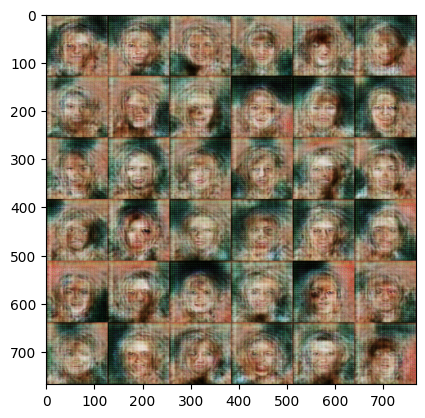

Training Progress:  30%|███       | 4500/15000 [24:10<1:18:02,  2.24step/s]

****************************************************************************************************
1/1 [==============================] - 0s 16ms/step


Training Progress:  30%|███       | 4501/15000 [24:10<1:11:27,  2.45step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  30%|███       | 4502/15000 [24:11<1:06:27,  2.63step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  30%|███       | 4503/15000 [24:11<1:02:44,  2.79step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  30%|███       | 4504/15000 [24:11<1:02:02,  2.82step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  30%|███       | 4505/15000 [24:12<59:37,  2.93step/s]  

1/1 [==============================] - 0s 17ms/step


Training Progress:  30%|███       | 4506/15000 [24:12<59:52,  2.92step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  30%|███       | 4507/15000 [24:12<58:23,  2.99step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  30%|███       | 4508/15000 [24:13<57:18,  3.05step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  30%|███       | 4509/15000 [24:13<56:33,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  30%|███       | 4510/15000 [24:13<55:53,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  30%|███       | 4511/15000 [24:14<55:49,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  30%|███       | 4512/15000 [24:14<55:21,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  30%|███       | 4513/15000 [24:14<54:59,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  30%|███       | 4514/15000 [24:15<54:51,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  30%|███       | 4515/15000 [24:15<54:38,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  30%|███       | 4516/15000 [24:15<54:21,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  30%|███       | 4517/15000 [24:15<56:08,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  30%|███       | 4518/15000 [24:16<55:32,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  30%|███       | 4519/15000 [24:16<55:03,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  30%|███       | 4520/15000 [24:16<56:41,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  30%|███       | 4521/15000 [24:17<58:04,  3.01step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  30%|███       | 4522/15000 [24:17<58:53,  2.97step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  30%|███       | 4523/15000 [24:17<57:36,  3.03step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  30%|███       | 4524/15000 [24:18<56:30,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  30%|███       | 4525/15000 [24:18<57:33,  3.03step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  30%|███       | 4526/15000 [24:18<56:35,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  30%|███       | 4527/15000 [24:19<55:43,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  30%|███       | 4528/15000 [24:19<55:10,  3.16step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  30%|███       | 4529/15000 [24:19<54:55,  3.18step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  30%|███       | 4530/15000 [24:20<54:55,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  30%|███       | 4531/15000 [24:20<54:42,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  30%|███       | 4532/15000 [24:20<54:31,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  30%|███       | 4533/15000 [24:21<54:17,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  30%|███       | 4534/15000 [24:21<58:03,  3.00step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  30%|███       | 4535/15000 [24:21<1:02:37,  2.78step/s]

1/1 [==============================] - 0s 28ms/step


Training Progress:  30%|███       | 4536/15000 [24:22<1:05:47,  2.65step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  30%|███       | 4537/15000 [24:22<1:05:33,  2.66step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  30%|███       | 4538/15000 [24:23<1:03:11,  2.76step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  30%|███       | 4539/15000 [24:23<1:02:31,  2.79step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  30%|███       | 4540/15000 [24:23<1:00:02,  2.90step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  30%|███       | 4541/15000 [24:23<58:08,  3.00step/s]  

1/1 [==============================] - 0s 17ms/step


Training Progress:  30%|███       | 4542/15000 [24:24<56:59,  3.06step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  30%|███       | 4543/15000 [24:24<55:48,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  30%|███       | 4544/15000 [24:24<55:19,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  30%|███       | 4545/15000 [24:25<54:49,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  30%|███       | 4546/15000 [24:25<54:29,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  30%|███       | 4547/15000 [24:25<54:13,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  30%|███       | 4548/15000 [24:26<54:30,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  30%|███       | 4549/15000 [24:26<54:24,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  30%|███       | 4550/15000 [24:26<54:18,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  30%|███       | 4551/15000 [24:27<54:02,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  30%|███       | 4552/15000 [24:27<55:51,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  30%|███       | 4553/15000 [24:27<57:04,  3.05step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  30%|███       | 4554/15000 [24:28<56:41,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  30%|███       | 4555/15000 [24:28<55:49,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  30%|███       | 4556/15000 [24:28<55:11,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  30%|███       | 4557/15000 [24:29<54:39,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  30%|███       | 4558/15000 [24:29<54:48,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  30%|███       | 4559/15000 [24:29<56:21,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  30%|███       | 4560/15000 [24:29<55:39,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  30%|███       | 4561/15000 [24:30<55:07,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  30%|███       | 4562/15000 [24:30<54:47,  3.18step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  30%|███       | 4563/15000 [24:30<54:26,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  30%|███       | 4564/15000 [24:31<54:08,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  30%|███       | 4565/15000 [24:31<53:50,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  30%|███       | 4566/15000 [24:31<53:40,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  30%|███       | 4567/15000 [24:32<53:59,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  30%|███       | 4568/15000 [24:32<53:47,  3.23step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  30%|███       | 4569/15000 [24:32<55:10,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  30%|███       | 4570/15000 [24:33<55:30,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  30%|███       | 4571/15000 [24:33<54:47,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  30%|███       | 4572/15000 [24:33<54:15,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  30%|███       | 4573/15000 [24:34<53:54,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  30%|███       | 4574/15000 [24:34<55:35,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  30%|███       | 4575/15000 [24:34<54:48,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  31%|███       | 4576/15000 [24:34<54:31,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  31%|███       | 4577/15000 [24:35<54:12,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  31%|███       | 4578/15000 [24:35<53:59,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  31%|███       | 4579/15000 [24:35<55:34,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  31%|███       | 4580/15000 [24:36<55:02,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  31%|███       | 4581/15000 [24:36<54:24,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  31%|███       | 4582/15000 [24:36<54:08,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  31%|███       | 4583/15000 [24:37<53:47,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  31%|███       | 4584/15000 [24:37<53:41,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  31%|███       | 4585/15000 [24:37<53:48,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  31%|███       | 4586/15000 [24:38<53:46,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  31%|███       | 4587/15000 [24:38<53:34,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  31%|███       | 4588/15000 [24:38<55:22,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  31%|███       | 4589/15000 [24:39<54:38,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  31%|███       | 4590/15000 [24:39<54:15,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  31%|███       | 4591/15000 [24:39<53:53,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  31%|███       | 4592/15000 [24:39<53:57,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  31%|███       | 4593/15000 [24:40<53:40,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  31%|███       | 4594/15000 [24:40<53:40,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  31%|███       | 4595/15000 [24:40<53:56,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  31%|███       | 4596/15000 [24:41<53:49,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  31%|███       | 4597/15000 [24:41<55:27,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  31%|███       | 4598/15000 [24:41<54:51,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  31%|███       | 4599/15000 [24:42<54:26,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  31%|███       | 4600/15000 [24:42<54:07,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  31%|███       | 4601/15000 [24:42<53:49,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  31%|███       | 4602/15000 [24:43<54:17,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  31%|███       | 4603/15000 [24:43<55:53,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  31%|███       | 4604/15000 [24:43<55:29,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  31%|███       | 4605/15000 [24:44<54:47,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  31%|███       | 4606/15000 [24:44<54:27,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  31%|███       | 4607/15000 [24:44<55:50,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  31%|███       | 4608/15000 [24:45<55:08,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  31%|███       | 4609/15000 [24:45<54:32,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  31%|███       | 4610/15000 [24:45<56:05,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  31%|███       | 4611/15000 [24:46<55:34,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  31%|███       | 4612/15000 [24:46<55:07,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  31%|███       | 4613/15000 [24:46<54:48,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  31%|███       | 4614/15000 [24:46<54:27,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  31%|███       | 4615/15000 [24:47<54:03,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  31%|███       | 4616/15000 [24:47<53:54,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  31%|███       | 4617/15000 [24:47<53:49,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  31%|███       | 4618/15000 [24:48<53:43,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  31%|███       | 4619/15000 [24:48<53:37,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  31%|███       | 4620/15000 [24:48<53:32,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  31%|███       | 4621/15000 [24:49<53:29,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  31%|███       | 4622/15000 [24:49<53:57,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  31%|███       | 4623/15000 [24:49<54:04,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  31%|███       | 4624/15000 [24:50<53:58,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  31%|███       | 4625/15000 [24:50<53:51,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  31%|███       | 4626/15000 [24:50<53:44,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  31%|███       | 4627/15000 [24:50<53:32,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  31%|███       | 4628/15000 [24:51<53:32,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  31%|███       | 4629/15000 [24:51<53:27,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  31%|███       | 4630/15000 [24:51<53:31,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  31%|███       | 4631/15000 [24:52<53:31,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  31%|███       | 4632/15000 [24:52<53:49,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  31%|███       | 4633/15000 [24:52<58:01,  2.98step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  31%|███       | 4634/15000 [24:53<1:04:39,  2.67step/s]

1/1 [==============================] - 0s 27ms/step


Training Progress:  31%|███       | 4635/15000 [24:53<1:04:52,  2.66step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  31%|███       | 4636/15000 [24:54<1:06:54,  2.58step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  31%|███       | 4637/15000 [24:54<1:02:56,  2.74step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  31%|███       | 4638/15000 [24:54<1:00:06,  2.87step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  31%|███       | 4639/15000 [24:55<57:58,  2.98step/s]  

1/1 [==============================] - 0s 16ms/step


Training Progress:  31%|███       | 4640/15000 [24:55<56:36,  3.05step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  31%|███       | 4641/15000 [24:55<55:53,  3.09step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  31%|███       | 4642/15000 [24:56<55:22,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  31%|███       | 4643/15000 [24:56<54:49,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  31%|███       | 4644/15000 [24:56<54:28,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  31%|███       | 4645/15000 [24:56<54:10,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  31%|███       | 4646/15000 [24:57<53:54,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  31%|███       | 4647/15000 [24:57<53:45,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  31%|███       | 4648/15000 [24:57<53:39,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  31%|███       | 4649/15000 [24:58<53:34,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  31%|███       | 4650/15000 [24:58<53:51,  3.20step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  31%|███       | 4651/15000 [24:59<1:09:04,  2.50step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  31%|███       | 4652/15000 [24:59<1:04:42,  2.67step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  31%|███       | 4653/15000 [24:59<1:01:46,  2.79step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  31%|███       | 4654/15000 [25:00<59:43,  2.89step/s]  

1/1 [==============================] - 0s 20ms/step


Training Progress:  31%|███       | 4655/15000 [25:00<58:08,  2.97step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  31%|███       | 4656/15000 [25:00<56:57,  3.03step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  31%|███       | 4657/15000 [25:01<56:14,  3.07step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  31%|███       | 4658/15000 [25:01<55:48,  3.09step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  31%|███       | 4659/15000 [25:01<55:20,  3.11step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  31%|███       | 4660/15000 [25:01<55:25,  3.11step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  31%|███       | 4661/15000 [25:02<55:05,  3.13step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  31%|███       | 4662/15000 [25:02<54:54,  3.14step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  31%|███       | 4663/15000 [25:03<57:55,  2.97step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  31%|███       | 4664/15000 [25:03<57:03,  3.02step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  31%|███       | 4665/15000 [25:03<56:25,  3.05step/s]

1/1 [==============================] - 0s 23ms/step


Training Progress:  31%|███       | 4666/15000 [25:03<56:19,  3.06step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  31%|███       | 4667/15000 [25:04<55:59,  3.08step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  31%|███       | 4668/15000 [25:04<55:29,  3.10step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  31%|███       | 4669/15000 [25:04<55:27,  3.10step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  31%|███       | 4670/15000 [25:05<57:03,  3.02step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  31%|███       | 4671/15000 [25:05<56:19,  3.06step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  31%|███       | 4672/15000 [25:05<55:45,  3.09step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  31%|███       | 4673/15000 [25:06<55:16,  3.11step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  31%|███       | 4674/15000 [25:06<55:00,  3.13step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  31%|███       | 4675/15000 [25:06<54:47,  3.14step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  31%|███       | 4676/15000 [25:07<54:37,  3.15step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  31%|███       | 4677/15000 [25:07<54:31,  3.16step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  31%|███       | 4678/15000 [25:07<54:54,  3.13step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  31%|███       | 4679/15000 [25:08<54:43,  3.14step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  31%|███       | 4680/15000 [25:08<54:43,  3.14step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  31%|███       | 4681/15000 [25:08<54:34,  3.15step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  31%|███       | 4682/15000 [25:09<54:40,  3.14step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  31%|███       | 4683/15000 [25:09<54:31,  3.15step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  31%|███       | 4684/15000 [25:09<54:33,  3.15step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  31%|███       | 4685/15000 [25:10<54:44,  3.14step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  31%|███       | 4686/15000 [25:10<54:33,  3.15step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  31%|███       | 4687/15000 [25:10<54:51,  3.13step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  31%|███▏      | 4688/15000 [25:10<54:39,  3.14step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  31%|███▏      | 4689/15000 [25:11<54:37,  3.15step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  31%|███▏      | 4690/15000 [25:11<54:40,  3.14step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  31%|███▏      | 4691/15000 [25:11<54:28,  3.15step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  31%|███▏      | 4692/15000 [25:12<54:31,  3.15step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  31%|███▏      | 4693/15000 [25:12<54:43,  3.14step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  31%|███▏      | 4694/15000 [25:12<54:52,  3.13step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  31%|███▏      | 4695/15000 [25:13<54:34,  3.15step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  31%|███▏      | 4696/15000 [25:13<54:59,  3.12step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  31%|███▏      | 4697/15000 [25:13<54:44,  3.14step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  31%|███▏      | 4698/15000 [25:14<54:33,  3.15step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  31%|███▏      | 4699/15000 [25:14<54:34,  3.15step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  31%|███▏      | 4700/15000 [25:14<54:35,  3.14step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  31%|███▏      | 4701/15000 [25:15<54:27,  3.15step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  31%|███▏      | 4702/15000 [25:15<54:37,  3.14step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  31%|███▏      | 4703/15000 [25:15<54:39,  3.14step/s]

1/1 [==============================] - 0s 23ms/step


Training Progress:  31%|███▏      | 4704/15000 [25:16<54:47,  3.13step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  31%|███▏      | 4705/15000 [25:16<55:06,  3.11step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  31%|███▏      | 4706/15000 [25:16<54:54,  3.12step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  31%|███▏      | 4707/15000 [25:17<54:49,  3.13step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  31%|███▏      | 4708/15000 [25:17<54:43,  3.13step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  31%|███▏      | 4709/15000 [25:17<54:40,  3.14step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  31%|███▏      | 4710/15000 [25:17<54:41,  3.14step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  31%|███▏      | 4711/15000 [25:18<54:42,  3.13step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  31%|███▏      | 4712/15000 [25:18<54:36,  3.14step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  31%|███▏      | 4713/15000 [25:18<54:21,  3.15step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  31%|███▏      | 4714/15000 [25:19<54:35,  3.14step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  31%|███▏      | 4715/15000 [25:19<54:38,  3.14step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  31%|███▏      | 4716/15000 [25:19<54:40,  3.14step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  31%|███▏      | 4717/15000 [25:20<54:39,  3.14step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  31%|███▏      | 4718/15000 [25:20<54:26,  3.15step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  31%|███▏      | 4719/15000 [25:20<54:13,  3.16step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  31%|███▏      | 4720/15000 [25:21<53:59,  3.17step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  31%|███▏      | 4721/15000 [25:21<53:50,  3.18step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  31%|███▏      | 4722/15000 [25:21<53:44,  3.19step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  31%|███▏      | 4723/15000 [25:22<54:04,  3.17step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  31%|███▏      | 4724/15000 [25:22<54:30,  3.14step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  32%|███▏      | 4725/15000 [25:22<54:58,  3.12step/s]

1/1 [==============================] - 0s 27ms/step


Training Progress:  32%|███▏      | 4726/15000 [25:23<56:18,  3.04step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  32%|███▏      | 4727/15000 [25:23<55:37,  3.08step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  32%|███▏      | 4728/15000 [25:23<55:07,  3.11step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  32%|███▏      | 4729/15000 [25:24<54:53,  3.12step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  32%|███▏      | 4730/15000 [25:24<57:07,  3.00step/s]

1/1 [==============================] - 0s 27ms/step


Training Progress:  32%|███▏      | 4731/15000 [25:24<1:01:54,  2.76step/s]

1/1 [==============================] - 0s 29ms/step


Training Progress:  32%|███▏      | 4732/15000 [25:25<1:03:23,  2.70step/s]

1/1 [==============================] - 0s 32ms/step


Training Progress:  32%|███▏      | 4733/15000 [25:25<1:06:16,  2.58step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  32%|███▏      | 4734/15000 [25:25<1:02:42,  2.73step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  32%|███▏      | 4735/15000 [25:26<59:55,  2.85step/s]  

1/1 [==============================] - 0s 18ms/step


Training Progress:  32%|███▏      | 4736/15000 [25:26<57:58,  2.95step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  32%|███▏      | 4737/15000 [25:26<56:42,  3.02step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  32%|███▏      | 4738/15000 [25:27<57:43,  2.96step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  32%|███▏      | 4739/15000 [25:27<56:26,  3.03step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  32%|███▏      | 4740/15000 [25:27<55:37,  3.07step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  32%|███▏      | 4741/15000 [25:28<56:47,  3.01step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  32%|███▏      | 4742/15000 [25:28<56:03,  3.05step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  32%|███▏      | 4743/15000 [25:28<55:19,  3.09step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  32%|███▏      | 4744/15000 [25:29<54:47,  3.12step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  32%|███▏      | 4745/15000 [25:29<54:40,  3.13step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  32%|███▏      | 4746/15000 [25:29<54:28,  3.14step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  32%|███▏      | 4747/15000 [25:30<54:20,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  32%|███▏      | 4748/15000 [25:30<54:00,  3.16step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  32%|███▏      | 4749/15000 [25:30<53:44,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  32%|███▏      | 4750/15000 [25:31<53:40,  3.18step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  32%|███▏      | 4751/15000 [25:31<54:07,  3.16step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  32%|███▏      | 4752/15000 [25:31<54:06,  3.16step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  32%|███▏      | 4753/15000 [25:32<53:57,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  32%|███▏      | 4754/15000 [25:32<53:47,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  32%|███▏      | 4755/15000 [25:32<53:37,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  32%|███▏      | 4756/15000 [25:32<54:25,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  32%|███▏      | 4757/15000 [25:33<54:01,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  32%|███▏      | 4758/15000 [25:33<53:45,  3.18step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  32%|███▏      | 4759/15000 [25:33<53:40,  3.18step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  32%|███▏      | 4760/15000 [25:34<53:56,  3.16step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  32%|███▏      | 4761/15000 [25:34<53:53,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  32%|███▏      | 4762/15000 [25:34<55:29,  3.07step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  32%|███▏      | 4763/15000 [25:35<54:45,  3.12step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  32%|███▏      | 4764/15000 [25:35<54:25,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  32%|███▏      | 4765/15000 [25:35<53:55,  3.16step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  32%|███▏      | 4766/15000 [25:36<53:34,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  32%|███▏      | 4767/15000 [25:36<53:16,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  32%|███▏      | 4768/15000 [25:36<53:05,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  32%|███▏      | 4769/15000 [25:37<53:18,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  32%|███▏      | 4770/15000 [25:37<53:16,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  32%|███▏      | 4771/15000 [25:37<53:03,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  32%|███▏      | 4772/15000 [25:38<52:50,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  32%|███▏      | 4773/15000 [25:38<54:34,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  32%|███▏      | 4774/15000 [25:38<53:54,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  32%|███▏      | 4775/15000 [25:38<53:25,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  32%|███▏      | 4776/15000 [25:39<55:03,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  32%|███▏      | 4777/15000 [25:39<54:27,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  32%|███▏      | 4778/15000 [25:39<55:43,  3.06step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  32%|███▏      | 4779/15000 [25:40<55:01,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  32%|███▏      | 4780/15000 [25:40<54:19,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  32%|███▏      | 4781/15000 [25:40<53:33,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  32%|███▏      | 4782/15000 [25:41<53:17,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  32%|███▏      | 4783/15000 [25:41<52:53,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  32%|███▏      | 4784/15000 [25:41<53:05,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  32%|███▏      | 4785/15000 [25:42<55:09,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  32%|███▏      | 4786/15000 [25:42<54:35,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  32%|███▏      | 4787/15000 [25:42<55:44,  3.05step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  32%|███▏      | 4788/15000 [25:43<55:11,  3.08step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  32%|███▏      | 4789/15000 [25:43<56:31,  3.01step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  32%|███▏      | 4790/15000 [25:43<55:29,  3.07step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  32%|███▏      | 4791/15000 [25:44<54:41,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  32%|███▏      | 4792/15000 [25:44<54:06,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  32%|███▏      | 4793/15000 [25:44<53:33,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  32%|███▏      | 4794/15000 [25:45<53:14,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  32%|███▏      | 4795/15000 [25:45<53:02,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  32%|███▏      | 4796/15000 [25:45<52:52,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  32%|███▏      | 4797/15000 [25:45<52:58,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  32%|███▏      | 4798/15000 [25:46<52:59,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  32%|███▏      | 4799/15000 [25:46<52:51,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  32%|███▏      | 4800/15000 [25:46<54:37,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  32%|███▏      | 4801/15000 [25:47<56:00,  3.04step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  32%|███▏      | 4802/15000 [25:47<55:02,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  32%|███▏      | 4803/15000 [25:47<56:03,  3.03step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  32%|███▏      | 4804/15000 [25:48<55:07,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  32%|███▏      | 4805/15000 [25:48<54:14,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  32%|███▏      | 4806/15000 [25:48<53:58,  3.15step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  32%|███▏      | 4807/15000 [25:49<53:36,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  32%|███▏      | 4808/15000 [25:49<53:20,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  32%|███▏      | 4809/15000 [25:49<54:59,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  32%|███▏      | 4810/15000 [25:50<56:11,  3.02step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  32%|███▏      | 4811/15000 [25:50<55:07,  3.08step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  32%|███▏      | 4812/15000 [25:50<56:15,  3.02step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  32%|███▏      | 4813/15000 [25:51<55:09,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  32%|███▏      | 4814/15000 [25:51<54:27,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  32%|███▏      | 4815/15000 [25:51<55:39,  3.05step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  32%|███▏      | 4816/15000 [25:52<54:57,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  32%|███▏      | 4817/15000 [25:52<54:14,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  32%|███▏      | 4818/15000 [25:52<54:12,  3.13step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  32%|███▏      | 4819/15000 [25:53<55:09,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  32%|███▏      | 4820/15000 [25:53<54:23,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  32%|███▏      | 4821/15000 [25:53<53:49,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  32%|███▏      | 4822/15000 [25:54<53:37,  3.16step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  32%|███▏      | 4823/15000 [25:54<53:29,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  32%|███▏      | 4824/15000 [25:54<53:12,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  32%|███▏      | 4825/15000 [25:54<53:08,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  32%|███▏      | 4826/15000 [25:55<53:07,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  32%|███▏      | 4827/15000 [25:55<52:48,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  32%|███▏      | 4828/15000 [25:55<56:25,  3.01step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  32%|███▏      | 4829/15000 [25:56<1:02:46,  2.70step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  32%|███▏      | 4830/15000 [25:56<1:06:57,  2.53step/s]

1/1 [==============================] - 0s 28ms/step


Training Progress:  32%|███▏      | 4831/15000 [25:57<1:05:22,  2.59step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  32%|███▏      | 4832/15000 [25:57<1:01:35,  2.75step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  32%|███▏      | 4833/15000 [25:57<58:59,  2.87step/s]  

1/1 [==============================] - 0s 17ms/step


Training Progress:  32%|███▏      | 4834/15000 [25:58<57:27,  2.95step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  32%|███▏      | 4835/15000 [25:58<56:01,  3.02step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  32%|███▏      | 4836/15000 [25:58<56:50,  2.98step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  32%|███▏      | 4837/15000 [25:59<55:28,  3.05step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  32%|███▏      | 4838/15000 [25:59<54:37,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  32%|███▏      | 4839/15000 [25:59<53:59,  3.14step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  32%|███▏      | 4840/15000 [26:00<53:47,  3.15step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  32%|███▏      | 4841/15000 [26:00<55:27,  3.05step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  32%|███▏      | 4842/15000 [26:00<54:55,  3.08step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  32%|███▏      | 4843/15000 [26:01<54:22,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  32%|███▏      | 4844/15000 [26:01<53:53,  3.14step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  32%|███▏      | 4845/15000 [26:01<53:29,  3.16step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  32%|███▏      | 4846/15000 [26:02<53:24,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  32%|███▏      | 4847/15000 [26:02<52:59,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  32%|███▏      | 4848/15000 [26:02<52:44,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  32%|███▏      | 4849/15000 [26:02<52:28,  3.22step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  32%|███▏      | 4850/15000 [26:03<52:30,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  32%|███▏      | 4851/15000 [26:03<52:20,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  32%|███▏      | 4852/15000 [26:03<52:19,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  32%|███▏      | 4853/15000 [26:04<52:31,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  32%|███▏      | 4854/15000 [26:04<52:33,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  32%|███▏      | 4855/15000 [26:04<52:30,  3.22step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  32%|███▏      | 4856/15000 [26:05<53:18,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  32%|███▏      | 4857/15000 [26:05<53:00,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  32%|███▏      | 4858/15000 [26:05<52:43,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  32%|███▏      | 4859/15000 [26:06<52:30,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  32%|███▏      | 4860/15000 [26:06<52:22,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  32%|███▏      | 4861/15000 [26:06<52:09,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  32%|███▏      | 4862/15000 [26:06<52:23,  3.23step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  32%|███▏      | 4863/15000 [26:07<52:35,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  32%|███▏      | 4864/15000 [26:07<52:36,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  32%|███▏      | 4865/15000 [26:07<52:30,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  32%|███▏      | 4866/15000 [26:08<52:32,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  32%|███▏      | 4867/15000 [26:08<52:19,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  32%|███▏      | 4868/15000 [26:08<52:26,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  32%|███▏      | 4869/15000 [26:09<52:28,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  32%|███▏      | 4870/15000 [26:09<52:31,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  32%|███▏      | 4871/15000 [26:09<52:42,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  32%|███▏      | 4872/15000 [26:10<52:29,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  32%|███▏      | 4873/15000 [26:10<52:33,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  32%|███▏      | 4874/15000 [26:10<52:30,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  32%|███▎      | 4875/15000 [26:11<52:23,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  33%|███▎      | 4876/15000 [26:11<52:24,  3.22step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  33%|███▎      | 4877/15000 [26:11<52:30,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  33%|███▎      | 4878/15000 [26:11<52:27,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 4879/15000 [26:12<52:16,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  33%|███▎      | 4880/15000 [26:12<54:22,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  33%|███▎      | 4881/15000 [26:12<55:34,  3.03step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  33%|███▎      | 4882/15000 [26:13<54:40,  3.08step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  33%|███▎      | 4883/15000 [26:13<54:03,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  33%|███▎      | 4884/15000 [26:13<53:30,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 4885/15000 [26:14<55:10,  3.06step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  33%|███▎      | 4886/15000 [26:14<56:13,  3.00step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  33%|███▎      | 4887/15000 [26:14<55:07,  3.06step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 4888/15000 [26:15<56:05,  3.00step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  33%|███▎      | 4889/15000 [26:15<55:03,  3.06step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  33%|███▎      | 4890/15000 [26:15<54:34,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  33%|███▎      | 4891/15000 [26:16<53:45,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  33%|███▎      | 4892/15000 [26:16<53:23,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 4893/15000 [26:16<52:51,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  33%|███▎      | 4894/15000 [26:17<52:32,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 4895/15000 [26:17<52:22,  3.22step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  33%|███▎      | 4896/15000 [26:17<52:35,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  33%|███▎      | 4897/15000 [26:18<52:33,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  33%|███▎      | 4898/15000 [26:18<52:24,  3.21step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  33%|███▎      | 4899/15000 [26:18<54:54,  3.07step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 4900/15000 [26:19<53:58,  3.12step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  33%|███▎      | 4901/15000 [26:19<53:35,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  33%|███▎      | 4902/15000 [26:19<54:52,  3.07step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  33%|███▎      | 4903/15000 [26:20<54:02,  3.11step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  33%|███▎      | 4904/15000 [26:20<53:28,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 4905/15000 [26:20<53:02,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 4906/15000 [26:20<52:32,  3.20step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:  33%|███▎      | 4907/15000 [26:21<52:15,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  33%|███▎      | 4908/15000 [26:21<52:14,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  33%|███▎      | 4909/15000 [26:21<52:13,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  33%|███▎      | 4910/15000 [26:22<52:15,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 4911/15000 [26:22<52:04,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 4912/15000 [26:22<53:46,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 4913/15000 [26:23<53:38,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 4914/15000 [26:23<55:00,  3.06step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  33%|███▎      | 4915/15000 [26:23<54:08,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 4916/15000 [26:24<55:17,  3.04step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  33%|███▎      | 4917/15000 [26:24<55:02,  3.05step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  33%|███▎      | 4918/15000 [26:24<54:22,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  33%|███▎      | 4919/15000 [26:25<53:47,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  33%|███▎      | 4920/15000 [26:25<53:16,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  33%|███▎      | 4921/15000 [26:25<52:56,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  33%|███▎      | 4922/15000 [26:26<52:39,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 4923/15000 [26:26<54:28,  3.08step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  33%|███▎      | 4924/15000 [26:26<55:43,  3.01step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  33%|███▎      | 4925/15000 [26:27<54:35,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 4926/15000 [26:27<55:54,  3.00step/s]

1/1 [==============================] - 0s 27ms/step


Training Progress:  33%|███▎      | 4927/15000 [26:27<1:01:02,  2.75step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  33%|███▎      | 4928/15000 [26:28<1:02:15,  2.70step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  33%|███▎      | 4929/15000 [26:28<1:02:31,  2.68step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 4930/15000 [26:28<59:18,  2.83step/s]  

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 4931/15000 [26:29<57:02,  2.94step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 4932/15000 [26:29<55:27,  3.03step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  33%|███▎      | 4933/15000 [26:29<54:23,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 4934/15000 [26:30<55:22,  3.03step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 4935/15000 [26:30<54:13,  3.09step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  33%|███▎      | 4936/15000 [26:30<53:54,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  33%|███▎      | 4937/15000 [26:31<53:25,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  33%|███▎      | 4938/15000 [26:31<53:05,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  33%|███▎      | 4939/15000 [26:31<52:40,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 4940/15000 [26:32<52:24,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 4941/15000 [26:32<52:08,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 4942/15000 [26:32<53:50,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 4943/15000 [26:33<55:53,  3.00step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 4944/15000 [26:33<56:28,  2.97step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 4945/15000 [26:33<55:14,  3.03step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  33%|███▎      | 4946/15000 [26:34<54:19,  3.08step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  33%|███▎      | 4947/15000 [26:34<55:26,  3.02step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 4948/15000 [26:34<54:18,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 4949/15000 [26:34<53:27,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 4950/15000 [26:35<52:57,  3.16step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  33%|███▎      | 4951/15000 [26:35<52:45,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 4952/15000 [26:35<52:18,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 4953/15000 [26:36<52:01,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  33%|███▎      | 4954/15000 [26:36<52:13,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  33%|███▎      | 4955/15000 [26:36<52:00,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 4956/15000 [26:37<51:56,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  33%|███▎      | 4957/15000 [26:37<51:50,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 4958/15000 [26:37<53:33,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 4959/15000 [26:38<52:47,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 4960/15000 [26:38<52:32,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 4961/15000 [26:38<52:05,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 4962/15000 [26:39<51:52,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  33%|███▎      | 4963/15000 [26:39<51:42,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  33%|███▎      | 4964/15000 [26:39<51:58,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  33%|███▎      | 4965/15000 [26:39<53:35,  3.12step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  33%|███▎      | 4966/15000 [26:40<53:08,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 4967/15000 [26:40<52:35,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 4968/15000 [26:40<52:17,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 4969/15000 [26:41<51:57,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 4970/15000 [26:41<51:53,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 4971/15000 [26:41<51:38,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  33%|███▎      | 4972/15000 [26:42<51:38,  3.24step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  33%|███▎      | 4973/15000 [26:42<52:18,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  33%|███▎      | 4974/15000 [26:42<54:16,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 4975/15000 [26:43<53:46,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 4976/15000 [26:43<53:14,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 4977/15000 [26:43<52:32,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 4978/15000 [26:44<52:09,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 4979/15000 [26:44<52:10,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 4980/15000 [26:44<51:45,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 4981/15000 [26:44<51:42,  3.23step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  33%|███▎      | 4982/15000 [26:45<52:21,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  33%|███▎      | 4983/15000 [26:45<52:15,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 4984/15000 [26:45<51:53,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 4985/15000 [26:46<51:47,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 4986/15000 [26:46<51:32,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 4987/15000 [26:46<51:29,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 4988/15000 [26:47<51:21,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  33%|███▎      | 4989/15000 [26:47<51:25,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 4990/15000 [26:47<51:19,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  33%|███▎      | 4991/15000 [26:48<51:40,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  33%|███▎      | 4992/15000 [26:48<51:45,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 4993/15000 [26:48<51:45,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  33%|███▎      | 4994/15000 [26:48<51:32,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 4995/15000 [26:49<51:34,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 4996/15000 [26:49<51:20,  3.25step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  33%|███▎      | 4997/15000 [26:49<51:45,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 4998/15000 [26:50<51:30,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  33%|███▎      | 4999/15000 [26:50<51:33,  3.23step/s]

1/1 [==============================] - 0s 16ms/step
****************************************************************************************************
5000/15000: d_loss: 0.146054,  g_loss: 0.372339
2/2 [==============================] - 0s 20ms/step


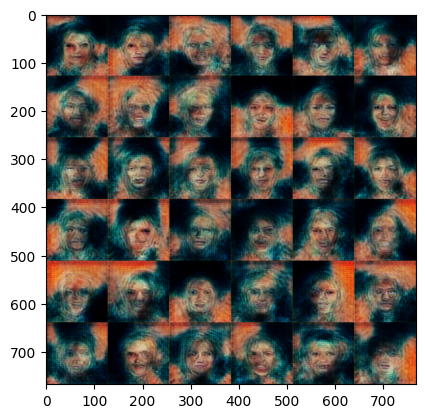

Training Progress:  33%|███▎      | 5000/15000 [26:51<1:13:09,  2.28step/s]

****************************************************************************************************
1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 5001/15000 [26:51<1:06:53,  2.49step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 5002/15000 [26:51<1:02:43,  2.66step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 5003/15000 [26:52<59:10,  2.82step/s]  

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 5004/15000 [26:52<57:00,  2.92step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 5005/15000 [26:52<55:20,  3.01step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 5006/15000 [26:53<54:09,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 5007/15000 [26:53<53:21,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  33%|███▎      | 5008/15000 [26:53<52:42,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  33%|███▎      | 5009/15000 [26:54<52:15,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  33%|███▎      | 5010/15000 [26:54<52:16,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 5011/15000 [26:54<51:50,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 5012/15000 [26:55<51:36,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 5013/15000 [26:55<51:42,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 5014/15000 [26:55<51:39,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 5015/15000 [26:55<51:29,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 5016/15000 [26:56<51:25,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  33%|███▎      | 5017/15000 [26:56<51:18,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 5018/15000 [26:56<51:17,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 5019/15000 [26:57<51:08,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  33%|███▎      | 5020/15000 [26:57<51:24,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 5021/15000 [26:57<51:16,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 5022/15000 [26:58<53:20,  3.12step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  33%|███▎      | 5023/15000 [26:58<52:47,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  33%|███▎      | 5024/15000 [26:58<54:16,  3.06step/s]

1/1 [==============================] - 0s 42ms/step


Training Progress:  34%|███▎      | 5025/15000 [26:59<55:32,  2.99step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  34%|███▎      | 5026/15000 [26:59<1:01:14,  2.71step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  34%|███▎      | 5027/15000 [26:59<1:03:12,  2.63step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  34%|███▎      | 5028/15000 [27:00<1:00:01,  2.77step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▎      | 5029/15000 [27:00<57:18,  2.90step/s]  

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▎      | 5030/15000 [27:00<55:27,  3.00step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  34%|███▎      | 5031/15000 [27:01<54:18,  3.06step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  34%|███▎      | 5032/15000 [27:01<53:48,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  34%|███▎      | 5033/15000 [27:01<52:59,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  34%|███▎      | 5034/15000 [27:02<52:29,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  34%|███▎      | 5035/15000 [27:02<52:11,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▎      | 5036/15000 [27:02<53:43,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▎      | 5037/15000 [27:03<52:52,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  34%|███▎      | 5038/15000 [27:03<52:28,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▎      | 5039/15000 [27:03<53:52,  3.08step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  34%|███▎      | 5040/15000 [27:04<53:09,  3.12step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  34%|███▎      | 5041/15000 [27:04<53:20,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  34%|███▎      | 5042/15000 [27:04<54:42,  3.03step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▎      | 5043/15000 [27:05<55:20,  3.00step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▎      | 5044/15000 [27:05<54:14,  3.06step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▎      | 5045/15000 [27:05<53:07,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  34%|███▎      | 5046/15000 [27:06<52:34,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▎      | 5047/15000 [27:06<51:58,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  34%|███▎      | 5048/15000 [27:06<51:43,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▎      | 5049/15000 [27:06<51:26,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▎      | 5050/15000 [27:07<51:40,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  34%|███▎      | 5051/15000 [27:07<51:31,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▎      | 5052/15000 [27:07<51:25,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  34%|███▎      | 5053/15000 [27:08<51:13,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▎      | 5054/15000 [27:08<51:13,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▎      | 5055/15000 [27:08<51:04,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▎      | 5056/15000 [27:09<52:45,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▎      | 5057/15000 [27:09<52:09,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▎      | 5058/15000 [27:09<51:51,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▎      | 5059/15000 [27:10<51:47,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▎      | 5060/15000 [27:10<51:37,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▎      | 5061/15000 [27:10<51:16,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▎      | 5062/15000 [27:11<51:14,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▍      | 5063/15000 [27:11<51:03,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▍      | 5064/15000 [27:11<51:10,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▍      | 5065/15000 [27:11<50:58,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▍      | 5066/15000 [27:12<52:47,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  34%|███▍      | 5067/15000 [27:12<52:26,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▍      | 5068/15000 [27:12<54:08,  3.06step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  34%|███▍      | 5069/15000 [27:13<53:29,  3.09step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  34%|███▍      | 5070/15000 [27:13<52:59,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▍      | 5071/15000 [27:13<52:15,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▍      | 5072/15000 [27:14<51:50,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  34%|███▍      | 5073/15000 [27:14<51:28,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▍      | 5074/15000 [27:14<51:23,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▍      | 5075/15000 [27:15<51:08,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▍      | 5076/15000 [27:15<51:05,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  34%|███▍      | 5077/15000 [27:15<51:03,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  34%|███▍      | 5078/15000 [27:16<51:21,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▍      | 5079/15000 [27:16<51:09,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  34%|███▍      | 5080/15000 [27:16<51:12,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▍      | 5081/15000 [27:16<51:02,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▍      | 5082/15000 [27:17<51:05,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▍      | 5083/15000 [27:17<50:56,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▍      | 5084/15000 [27:17<50:55,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▍      | 5085/15000 [27:18<50:46,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▍      | 5086/15000 [27:18<50:48,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▍      | 5087/15000 [27:18<50:54,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  34%|███▍      | 5088/15000 [27:19<51:00,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▍      | 5089/15000 [27:19<50:52,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▍      | 5090/15000 [27:19<50:50,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  34%|███▍      | 5091/15000 [27:20<50:54,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▍      | 5092/15000 [27:20<50:52,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▍      | 5093/15000 [27:20<50:56,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▍      | 5094/15000 [27:20<50:53,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▍      | 5095/15000 [27:21<50:53,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  34%|███▍      | 5096/15000 [27:21<51:16,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▍      | 5097/15000 [27:21<51:12,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▍      | 5098/15000 [27:22<51:04,  3.23step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  34%|███▍      | 5099/15000 [27:22<51:41,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▍      | 5100/15000 [27:22<53:24,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▍      | 5101/15000 [27:23<52:39,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  34%|███▍      | 5102/15000 [27:23<52:07,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▍      | 5103/15000 [27:23<51:43,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  34%|███▍      | 5104/15000 [27:24<51:34,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▍      | 5105/15000 [27:24<51:22,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▍      | 5106/15000 [27:24<51:28,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  34%|███▍      | 5107/15000 [27:25<51:21,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  34%|███▍      | 5108/15000 [27:25<51:15,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▍      | 5109/15000 [27:25<51:08,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▍      | 5110/15000 [27:25<50:56,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▍      | 5111/15000 [27:26<50:55,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▍      | 5112/15000 [27:26<50:52,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▍      | 5113/15000 [27:26<50:50,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▍      | 5114/15000 [27:27<50:45,  3.25step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  34%|███▍      | 5115/15000 [27:27<51:13,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  34%|███▍      | 5116/15000 [27:27<51:07,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  34%|███▍      | 5117/15000 [27:28<51:04,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▍      | 5118/15000 [27:28<50:57,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▍      | 5119/15000 [27:28<50:53,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▍      | 5120/15000 [27:29<50:48,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▍      | 5121/15000 [27:29<50:53,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  34%|███▍      | 5122/15000 [27:29<50:54,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▍      | 5123/15000 [27:29<50:55,  3.23step/s]

1/1 [==============================] - 0s 34ms/step


Training Progress:  34%|███▍      | 5124/15000 [27:30<57:05,  2.88step/s]

1/1 [==============================] - 0s 27ms/step


Training Progress:  34%|███▍      | 5125/15000 [27:30<1:00:35,  2.72step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  34%|███▍      | 5126/15000 [27:31<1:02:46,  2.62step/s]

1/1 [==============================] - 0s 23ms/step


Training Progress:  34%|███▍      | 5127/15000 [27:31<1:00:17,  2.73step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▍      | 5128/15000 [27:31<57:22,  2.87step/s]  

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▍      | 5129/15000 [27:32<55:27,  2.97step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  34%|███▍      | 5130/15000 [27:32<56:18,  2.92step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  34%|███▍      | 5131/15000 [27:32<55:05,  2.99step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▍      | 5132/15000 [27:33<55:32,  2.96step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  34%|███▍      | 5133/15000 [27:33<54:27,  3.02step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  34%|███▍      | 5134/15000 [27:33<53:18,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▍      | 5135/15000 [27:34<52:31,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  34%|███▍      | 5136/15000 [27:34<51:59,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▍      | 5137/15000 [27:34<51:35,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▍      | 5138/15000 [27:35<51:16,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▍      | 5139/15000 [27:35<51:06,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  34%|███▍      | 5140/15000 [27:35<51:10,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▍      | 5141/15000 [27:35<51:02,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▍      | 5142/15000 [27:36<51:00,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  34%|███▍      | 5143/15000 [27:36<51:15,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  34%|███▍      | 5144/15000 [27:36<50:56,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▍      | 5145/15000 [27:37<50:54,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▍      | 5146/15000 [27:37<50:47,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▍      | 5147/15000 [27:37<50:46,  3.23step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:  34%|███▍      | 5148/15000 [27:38<50:27,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▍      | 5149/15000 [27:38<50:23,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▍      | 5150/15000 [27:38<50:15,  3.27step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▍      | 5151/15000 [27:39<50:17,  3.26step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  34%|███▍      | 5152/15000 [27:39<50:36,  3.24step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  34%|███▍      | 5153/15000 [27:39<51:00,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▍      | 5154/15000 [27:40<50:51,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  34%|███▍      | 5155/15000 [27:40<50:44,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▍      | 5156/15000 [27:40<50:29,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▍      | 5157/15000 [27:40<50:29,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▍      | 5158/15000 [27:41<50:16,  3.26step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  34%|███▍      | 5159/15000 [27:41<50:23,  3.25step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:  34%|███▍      | 5160/15000 [27:41<50:12,  3.27step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▍      | 5161/15000 [27:42<52:09,  3.14step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  34%|███▍      | 5162/15000 [27:42<52:06,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▍      | 5163/15000 [27:42<53:21,  3.07step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▍      | 5164/15000 [27:43<52:24,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▍      | 5165/15000 [27:43<51:53,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▍      | 5166/15000 [27:43<51:18,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▍      | 5167/15000 [27:44<50:59,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▍      | 5168/15000 [27:44<50:40,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▍      | 5169/15000 [27:44<50:33,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  34%|███▍      | 5170/15000 [27:45<50:41,  3.23step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  34%|███▍      | 5171/15000 [27:45<51:05,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▍      | 5172/15000 [27:45<50:58,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  34%|███▍      | 5173/15000 [27:45<51:02,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  34%|███▍      | 5174/15000 [27:46<50:42,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  34%|███▍      | 5175/15000 [27:46<52:24,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▍      | 5176/15000 [27:46<51:49,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▍      | 5177/15000 [27:47<51:18,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  35%|███▍      | 5178/15000 [27:47<51:04,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▍      | 5179/15000 [27:47<52:38,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  35%|███▍      | 5180/15000 [27:48<52:19,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  35%|███▍      | 5181/15000 [27:48<51:45,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▍      | 5182/15000 [27:48<52:57,  3.09step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  35%|███▍      | 5183/15000 [27:49<52:16,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▍      | 5184/15000 [27:49<51:34,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▍      | 5185/15000 [27:49<51:09,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  35%|███▍      | 5186/15000 [27:50<50:55,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▍      | 5187/15000 [27:50<50:41,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▍      | 5188/15000 [27:50<50:25,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▍      | 5189/15000 [27:50<50:38,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▍      | 5190/15000 [27:51<50:28,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▍      | 5191/15000 [27:51<50:31,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▍      | 5192/15000 [27:51<50:17,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▍      | 5193/15000 [27:52<50:10,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▍      | 5194/15000 [27:52<50:14,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▍      | 5195/15000 [27:52<50:12,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▍      | 5196/15000 [27:53<50:12,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▍      | 5197/15000 [27:53<50:16,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  35%|███▍      | 5198/15000 [27:53<50:30,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  35%|███▍      | 5199/15000 [27:54<50:35,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  35%|███▍      | 5200/15000 [27:54<50:40,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▍      | 5201/15000 [27:54<50:29,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▍      | 5202/15000 [27:54<50:15,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▍      | 5203/15000 [27:55<50:15,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▍      | 5204/15000 [27:55<50:15,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▍      | 5205/15000 [27:55<50:15,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▍      | 5206/15000 [27:56<50:14,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  35%|███▍      | 5207/15000 [27:56<50:29,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  35%|███▍      | 5208/15000 [27:56<50:28,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  35%|███▍      | 5209/15000 [27:57<50:34,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  35%|███▍      | 5210/15000 [27:57<50:24,  3.24step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  35%|███▍      | 5211/15000 [27:57<50:32,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▍      | 5212/15000 [27:58<50:30,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▍      | 5213/15000 [27:58<50:22,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▍      | 5214/15000 [27:58<50:15,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▍      | 5215/15000 [27:58<50:14,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▍      | 5216/15000 [27:59<50:11,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  35%|███▍      | 5217/15000 [27:59<50:38,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▍      | 5218/15000 [27:59<50:38,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▍      | 5219/15000 [28:00<50:32,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▍      | 5220/15000 [28:00<50:24,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▍      | 5221/15000 [28:00<50:18,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  35%|███▍      | 5222/15000 [28:01<50:18,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▍      | 5223/15000 [28:01<51:55,  3.14step/s]

1/1 [==============================] - 0s 27ms/step


Training Progress:  35%|███▍      | 5224/15000 [28:01<56:35,  2.88step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  35%|███▍      | 5225/15000 [28:02<59:56,  2.72step/s]

1/1 [==============================] - 0s 32ms/step


Training Progress:  35%|███▍      | 5226/15000 [28:02<1:03:02,  2.58step/s]

1/1 [==============================] - 0s 28ms/step


Training Progress:  35%|███▍      | 5227/15000 [28:03<1:02:46,  2.59step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  35%|███▍      | 5228/15000 [28:03<59:09,  2.75step/s]  

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▍      | 5229/15000 [28:03<56:30,  2.88step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▍      | 5230/15000 [28:04<54:39,  2.98step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▍      | 5231/15000 [28:04<53:24,  3.05step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▍      | 5232/15000 [28:04<52:26,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▍      | 5233/15000 [28:05<51:55,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▍      | 5234/15000 [28:05<51:35,  3.15step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  35%|███▍      | 5235/15000 [28:05<51:35,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▍      | 5236/15000 [28:05<53:05,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  35%|███▍      | 5237/15000 [28:06<52:13,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  35%|███▍      | 5238/15000 [28:06<51:40,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▍      | 5239/15000 [28:06<51:07,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▍      | 5240/15000 [28:07<50:43,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▍      | 5241/15000 [28:07<50:26,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▍      | 5242/15000 [28:07<50:19,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▍      | 5243/15000 [28:08<50:02,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  35%|███▍      | 5244/15000 [28:08<50:19,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  35%|███▍      | 5245/15000 [28:08<50:11,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  35%|███▍      | 5246/15000 [28:09<50:12,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▍      | 5247/15000 [28:09<50:02,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▍      | 5248/15000 [28:09<50:03,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▍      | 5249/15000 [28:09<49:58,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  35%|███▌      | 5250/15000 [28:10<50:02,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  35%|███▌      | 5251/15000 [28:10<50:02,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▌      | 5252/15000 [28:10<51:48,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▌      | 5253/15000 [28:11<51:07,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  35%|███▌      | 5254/15000 [28:11<51:10,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▌      | 5255/15000 [28:11<50:42,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▌      | 5256/15000 [28:12<50:33,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▌      | 5257/15000 [28:12<50:18,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▌      | 5258/15000 [28:12<50:12,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▌      | 5259/15000 [28:13<50:50,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▌      | 5260/15000 [28:13<50:42,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  35%|███▌      | 5261/15000 [28:13<50:33,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▌      | 5262/15000 [28:14<50:21,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  35%|███▌      | 5263/15000 [28:14<50:28,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  35%|███▌      | 5264/15000 [28:14<50:30,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▌      | 5265/15000 [28:14<50:19,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▌      | 5266/15000 [28:15<50:10,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▌      | 5267/15000 [28:15<50:01,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▌      | 5268/15000 [28:15<49:55,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▌      | 5269/15000 [28:16<51:33,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▌      | 5270/15000 [28:16<51:04,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▌      | 5271/15000 [28:16<50:38,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  35%|███▌      | 5272/15000 [28:17<52:22,  3.10step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  35%|███▌      | 5273/15000 [28:17<51:52,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  35%|███▌      | 5274/15000 [28:17<51:32,  3.14step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  35%|███▌      | 5275/15000 [28:18<51:05,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▌      | 5276/15000 [28:18<50:43,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  35%|███▌      | 5277/15000 [28:18<50:36,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  35%|███▌      | 5278/15000 [28:19<50:25,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  35%|███▌      | 5279/15000 [28:19<50:21,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  35%|███▌      | 5280/15000 [28:19<50:28,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  35%|███▌      | 5281/15000 [28:20<50:29,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  35%|███▌      | 5282/15000 [28:20<50:26,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  35%|███▌      | 5283/15000 [28:20<51:55,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▌      | 5284/15000 [28:20<51:13,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  35%|███▌      | 5285/15000 [28:21<50:50,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▌      | 5286/15000 [28:21<50:34,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▌      | 5287/15000 [28:21<50:09,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▌      | 5288/15000 [28:22<50:06,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▌      | 5289/15000 [28:22<50:08,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▌      | 5290/15000 [28:22<50:13,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  35%|███▌      | 5291/15000 [28:23<50:45,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  35%|███▌      | 5292/15000 [28:23<50:36,  3.20step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  35%|███▌      | 5293/15000 [28:23<50:31,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▌      | 5294/15000 [28:24<50:26,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▌      | 5295/15000 [28:24<50:20,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▌      | 5296/15000 [28:24<50:19,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▌      | 5297/15000 [28:24<50:08,  3.23step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  35%|███▌      | 5298/15000 [28:25<52:06,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▌      | 5299/15000 [28:25<51:24,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  35%|███▌      | 5300/15000 [28:25<51:13,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▌      | 5301/15000 [28:26<50:48,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▌      | 5302/15000 [28:26<50:32,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▌      | 5303/15000 [28:26<50:17,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▌      | 5304/15000 [28:27<51:56,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▌      | 5305/15000 [28:27<51:16,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▌      | 5306/15000 [28:27<50:50,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▌      | 5307/15000 [28:28<52:17,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▌      | 5308/15000 [28:28<51:39,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▌      | 5309/15000 [28:28<51:18,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  35%|███▌      | 5310/15000 [28:29<50:59,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▌      | 5311/15000 [28:29<52:29,  3.08step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  35%|███▌      | 5312/15000 [28:29<51:55,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▌      | 5313/15000 [28:30<51:15,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▌      | 5314/15000 [28:30<52:29,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▌      | 5315/15000 [28:30<53:21,  3.03step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▌      | 5316/15000 [28:31<52:17,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▌      | 5317/15000 [28:31<51:24,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  35%|███▌      | 5318/15000 [28:31<51:02,  3.16step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  35%|███▌      | 5319/15000 [28:32<50:43,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  35%|███▌      | 5320/15000 [28:32<50:30,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  35%|███▌      | 5321/15000 [28:32<50:10,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  35%|███▌      | 5322/15000 [28:32<50:20,  3.20step/s]

1/1 [==============================] - 0s 27ms/step


Training Progress:  35%|███▌      | 5323/15000 [28:33<53:27,  3.02step/s]

1/1 [==============================] - 0s 23ms/step


Training Progress:  35%|███▌      | 5324/15000 [28:33<57:31,  2.80step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  36%|███▌      | 5325/15000 [28:34<1:00:30,  2.66step/s]

1/1 [==============================] - 0s 23ms/step


Training Progress:  36%|███▌      | 5326/15000 [28:34<59:50,  2.69step/s]  

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▌      | 5327/15000 [28:34<56:36,  2.85step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  36%|███▌      | 5328/15000 [28:35<54:51,  2.94step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  36%|███▌      | 5329/15000 [28:35<53:28,  3.01step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▌      | 5330/15000 [28:35<52:30,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  36%|███▌      | 5331/15000 [28:36<51:37,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  36%|███▌      | 5332/15000 [28:36<52:56,  3.04step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▌      | 5333/15000 [28:36<51:48,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▌      | 5334/15000 [28:37<51:07,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▌      | 5335/15000 [28:37<50:28,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▌      | 5336/15000 [28:37<51:56,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▌      | 5337/15000 [28:37<51:20,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▌      | 5338/15000 [28:38<50:50,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▌      | 5339/15000 [28:38<50:19,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  36%|███▌      | 5340/15000 [28:38<50:07,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▌      | 5341/15000 [28:39<49:48,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  36%|███▌      | 5342/15000 [28:39<49:47,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▌      | 5343/15000 [28:39<49:43,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▌      | 5344/15000 [28:40<51:23,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▌      | 5345/15000 [28:40<52:26,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  36%|███▌      | 5346/15000 [28:40<51:59,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▌      | 5347/15000 [28:41<51:08,  3.15step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  36%|███▌      | 5348/15000 [28:41<50:45,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▌      | 5349/15000 [28:41<50:27,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  36%|███▌      | 5350/15000 [28:42<50:15,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▌      | 5351/15000 [28:42<49:55,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▌      | 5352/15000 [28:42<50:11,  3.20step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  36%|███▌      | 5353/15000 [28:43<52:53,  3.04step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  36%|███▌      | 5354/15000 [28:43<52:02,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▌      | 5355/15000 [28:43<53:14,  3.02step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  36%|███▌      | 5356/15000 [28:44<52:15,  3.08step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  36%|███▌      | 5357/15000 [28:44<51:20,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▌      | 5358/15000 [28:44<50:49,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▌      | 5359/15000 [28:44<50:17,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▌      | 5360/15000 [28:45<50:00,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  36%|███▌      | 5361/15000 [28:45<49:46,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▌      | 5362/15000 [28:45<49:45,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▌      | 5363/15000 [28:46<49:26,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▌      | 5364/15000 [28:46<49:22,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▌      | 5365/15000 [28:46<49:37,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▌      | 5366/15000 [28:47<49:35,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▌      | 5367/15000 [28:47<49:27,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▌      | 5368/15000 [28:47<49:28,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▌      | 5369/15000 [28:48<49:20,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▌      | 5370/15000 [28:48<49:19,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▌      | 5371/15000 [28:48<49:12,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▌      | 5372/15000 [28:48<49:17,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▌      | 5373/15000 [28:49<49:08,  3.26step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  36%|███▌      | 5374/15000 [28:49<49:35,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  36%|███▌      | 5375/15000 [28:49<49:32,  3.24step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  36%|███▌      | 5376/15000 [28:50<51:23,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▌      | 5377/15000 [28:50<50:40,  3.17step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  36%|███▌      | 5378/15000 [28:50<50:21,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▌      | 5379/15000 [28:51<49:58,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▌      | 5380/15000 [28:51<49:47,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▌      | 5381/15000 [28:51<49:33,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▌      | 5382/15000 [28:52<49:32,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  36%|███▌      | 5383/15000 [28:52<51:22,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▌      | 5384/15000 [28:52<52:40,  3.04step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  36%|███▌      | 5385/15000 [28:53<53:02,  3.02step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  36%|███▌      | 5386/15000 [28:53<52:04,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▌      | 5387/15000 [28:53<52:48,  3.03step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▌      | 5388/15000 [28:54<51:53,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▌      | 5389/15000 [28:54<51:00,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▌      | 5390/15000 [28:54<50:28,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▌      | 5391/15000 [28:54<50:02,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  36%|███▌      | 5392/15000 [28:55<50:06,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  36%|███▌      | 5393/15000 [28:55<49:49,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▌      | 5394/15000 [28:55<49:41,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▌      | 5395/15000 [28:56<49:26,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▌      | 5396/15000 [28:56<49:22,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▌      | 5397/15000 [28:56<49:17,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▌      | 5398/15000 [28:57<49:18,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  36%|███▌      | 5399/15000 [28:57<49:15,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▌      | 5400/15000 [28:57<49:14,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  36%|███▌      | 5401/15000 [28:58<49:14,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  36%|███▌      | 5402/15000 [28:58<49:33,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  36%|███▌      | 5403/15000 [28:58<49:25,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▌      | 5404/15000 [28:58<49:21,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▌      | 5405/15000 [28:59<49:12,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▌      | 5406/15000 [28:59<49:11,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▌      | 5407/15000 [28:59<49:16,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  36%|███▌      | 5408/15000 [29:00<49:21,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▌      | 5409/15000 [29:00<49:11,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▌      | 5410/15000 [29:00<49:14,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▌      | 5411/15000 [29:01<49:18,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  36%|███▌      | 5412/15000 [29:01<49:19,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▌      | 5413/15000 [29:01<50:55,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▌      | 5414/15000 [29:02<50:22,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▌      | 5415/15000 [29:02<51:35,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▌      | 5416/15000 [29:02<51:14,  3.12step/s]

1/1 [==============================] - 0s 27ms/step


Training Progress:  36%|███▌      | 5417/15000 [29:03<52:13,  3.06step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▌      | 5418/15000 [29:03<51:17,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▌      | 5419/15000 [29:03<52:20,  3.05step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  36%|███▌      | 5420/15000 [29:04<51:38,  3.09step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  36%|███▌      | 5421/15000 [29:04<52:47,  3.02step/s]

1/1 [==============================] - 0s 27ms/step


Training Progress:  36%|███▌      | 5422/15000 [29:04<55:38,  2.87step/s]

1/1 [==============================] - 0s 36ms/step


Training Progress:  36%|███▌      | 5423/15000 [29:05<56:53,  2.81step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  36%|███▌      | 5424/15000 [29:05<1:00:02,  2.66step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  36%|███▌      | 5425/15000 [29:05<59:45,  2.67step/s]  

1/1 [==============================] - 0s 19ms/step


Training Progress:  36%|███▌      | 5426/15000 [29:06<57:02,  2.80step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▌      | 5427/15000 [29:06<54:37,  2.92step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  36%|███▌      | 5428/15000 [29:06<53:16,  2.99step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  36%|███▌      | 5429/15000 [29:07<52:14,  3.05step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  36%|███▌      | 5430/15000 [29:07<51:25,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  36%|███▌      | 5431/15000 [29:07<50:43,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▌      | 5432/15000 [29:08<50:15,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▌      | 5433/15000 [29:08<51:34,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▌      | 5434/15000 [29:08<50:55,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▌      | 5435/15000 [29:09<50:13,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▌      | 5436/15000 [29:09<49:54,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▌      | 5437/15000 [29:09<49:34,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▋      | 5438/15000 [29:10<49:24,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  36%|███▋      | 5439/15000 [29:10<49:34,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  36%|███▋      | 5440/15000 [29:10<49:29,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▋      | 5441/15000 [29:10<49:14,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▋      | 5442/15000 [29:11<49:10,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▋      | 5443/15000 [29:11<49:01,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▋      | 5444/15000 [29:11<50:45,  3.14step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  36%|███▋      | 5445/15000 [29:12<50:15,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▋      | 5446/15000 [29:12<49:52,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▋      | 5447/15000 [29:12<49:55,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▋      | 5448/15000 [29:13<49:52,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  36%|███▋      | 5449/15000 [29:13<49:41,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▋      | 5450/15000 [29:13<49:31,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▋      | 5451/15000 [29:14<49:34,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▋      | 5452/15000 [29:14<49:22,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▋      | 5453/15000 [29:14<50:56,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▋      | 5454/15000 [29:15<50:25,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▋      | 5455/15000 [29:15<50:00,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  36%|███▋      | 5456/15000 [29:15<49:37,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  36%|███▋      | 5457/15000 [29:15<49:32,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  36%|███▋      | 5458/15000 [29:16<49:25,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▋      | 5459/15000 [29:16<49:14,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▋      | 5460/15000 [29:16<49:10,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  36%|███▋      | 5461/15000 [29:17<49:07,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▋      | 5462/15000 [29:17<49:05,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▋      | 5463/15000 [29:17<49:00,  3.24step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  36%|███▋      | 5464/15000 [29:18<49:13,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  36%|███▋      | 5465/15000 [29:18<51:06,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  36%|███▋      | 5466/15000 [29:18<50:41,  3.13step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  36%|███▋      | 5467/15000 [29:19<50:19,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  36%|███▋      | 5468/15000 [29:19<49:54,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  36%|███▋      | 5469/15000 [29:19<49:35,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▋      | 5470/15000 [29:20<49:26,  3.21step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  36%|███▋      | 5471/15000 [29:20<49:33,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  36%|███▋      | 5472/15000 [29:20<49:23,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▋      | 5473/15000 [29:20<49:19,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  36%|███▋      | 5474/15000 [29:21<49:15,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  36%|███▋      | 5475/15000 [29:21<49:05,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  37%|███▋      | 5476/15000 [29:21<49:32,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  37%|███▋      | 5477/15000 [29:22<51:13,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  37%|███▋      | 5478/15000 [29:22<50:37,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  37%|███▋      | 5479/15000 [29:22<50:14,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  37%|███▋      | 5480/15000 [29:23<49:57,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  37%|███▋      | 5481/15000 [29:23<49:38,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  37%|███▋      | 5482/15000 [29:23<49:24,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  37%|███▋      | 5483/15000 [29:24<49:16,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  37%|███▋      | 5484/15000 [29:24<49:10,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  37%|███▋      | 5485/15000 [29:24<49:17,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  37%|███▋      | 5486/15000 [29:25<49:18,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  37%|███▋      | 5487/15000 [29:25<49:13,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  37%|███▋      | 5488/15000 [29:25<49:00,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  37%|███▋      | 5489/15000 [29:25<49:01,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  37%|███▋      | 5490/15000 [29:26<48:57,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  37%|███▋      | 5491/15000 [29:26<48:53,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  37%|███▋      | 5492/15000 [29:26<48:46,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  37%|███▋      | 5493/15000 [29:27<49:01,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  37%|███▋      | 5494/15000 [29:27<49:09,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  37%|███▋      | 5495/15000 [29:27<50:54,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  37%|███▋      | 5496/15000 [29:28<51:59,  3.05step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  37%|███▋      | 5497/15000 [29:28<51:05,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  37%|███▋      | 5498/15000 [29:28<50:23,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  37%|███▋      | 5499/15000 [29:29<49:54,  3.17step/s]

1/1 [==============================] - 0s 16ms/step
****************************************************************************************************
5500/15000: d_loss: 0.174251,  g_loss: 0.000565
2/2 [==============================] - 0s 20ms/step


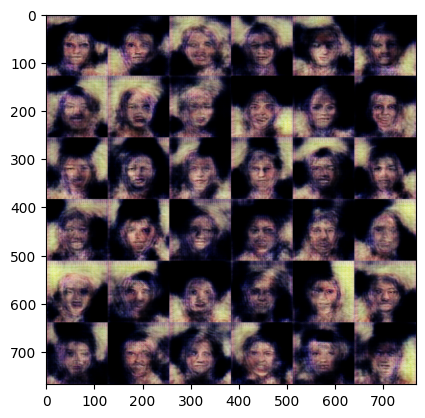

Training Progress:  37%|███▋      | 5500/15000 [29:29<1:09:15,  2.29step/s]

****************************************************************************************************
1/1 [==============================] - 0s 17ms/step


Training Progress:  37%|███▋      | 5501/15000 [29:30<1:03:20,  2.50step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  37%|███▋      | 5502/15000 [29:30<59:13,  2.67step/s]  

1/1 [==============================] - 0s 16ms/step


Training Progress:  37%|███▋      | 5503/15000 [29:30<56:04,  2.82step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  37%|███▋      | 5504/15000 [29:31<53:51,  2.94step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  37%|███▋      | 5505/15000 [29:31<54:01,  2.93step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  37%|███▋      | 5506/15000 [29:31<52:25,  3.02step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  37%|███▋      | 5507/15000 [29:32<51:34,  3.07step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  37%|███▋      | 5508/15000 [29:32<50:43,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  37%|███▋      | 5509/15000 [29:32<50:15,  3.15step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  37%|███▋      | 5510/15000 [29:33<52:12,  3.03step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  37%|███▋      | 5511/15000 [29:33<51:13,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  37%|███▋      | 5512/15000 [29:33<50:33,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  37%|███▋      | 5513/15000 [29:33<50:04,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  37%|███▋      | 5514/15000 [29:34<49:39,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  37%|███▋      | 5515/15000 [29:34<49:25,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  37%|███▋      | 5516/15000 [29:34<49:36,  3.19step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  37%|███▋      | 5517/15000 [29:35<49:35,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  37%|███▋      | 5518/15000 [29:35<51:17,  3.08step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  37%|███▋      | 5519/15000 [29:35<52:26,  3.01step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  37%|███▋      | 5520/15000 [29:36<56:32,  2.79step/s]

1/1 [==============================] - 0s 32ms/step


Training Progress:  37%|███▋      | 5521/15000 [29:36<59:38,  2.65step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  37%|███▋      | 5522/15000 [29:37<1:01:16,  2.58step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  37%|███▋      | 5523/15000 [29:37<57:28,  2.75step/s]  

1/1 [==============================] - 0s 16ms/step


Training Progress:  37%|███▋      | 5524/15000 [29:37<54:53,  2.88step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  37%|███▋      | 5525/15000 [29:38<53:18,  2.96step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  37%|███▋      | 5526/15000 [29:38<52:01,  3.04step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  37%|███▋      | 5527/15000 [29:38<51:10,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  37%|███▋      | 5528/15000 [29:39<50:34,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  37%|███▋      | 5529/15000 [29:39<50:03,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  37%|███▋      | 5530/15000 [29:39<49:31,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  37%|███▋      | 5531/15000 [29:39<49:23,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  37%|███▋      | 5532/15000 [29:40<49:02,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  37%|███▋      | 5533/15000 [29:40<48:57,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  37%|███▋      | 5534/15000 [29:40<49:05,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  37%|███▋      | 5535/15000 [29:41<49:02,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  37%|███▋      | 5536/15000 [29:41<48:55,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  37%|███▋      | 5537/15000 [29:41<48:49,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  37%|███▋      | 5538/15000 [29:42<48:41,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  37%|███▋      | 5539/15000 [29:42<48:44,  3.24step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  37%|███▋      | 5540/15000 [29:42<50:49,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  37%|███▋      | 5541/15000 [29:43<51:03,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  37%|███▋      | 5542/15000 [29:43<50:17,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  37%|███▋      | 5543/15000 [29:43<49:45,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  37%|███▋      | 5544/15000 [29:44<49:42,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  37%|███▋      | 5545/15000 [29:44<49:25,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  37%|███▋      | 5546/15000 [29:44<49:07,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  37%|███▋      | 5547/15000 [29:44<49:04,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  37%|███▋      | 5548/15000 [29:45<48:50,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  37%|███▋      | 5549/15000 [29:45<48:50,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  37%|███▋      | 5550/15000 [29:45<48:37,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  37%|███▋      | 5551/15000 [29:46<48:47,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  37%|███▋      | 5552/15000 [29:46<48:58,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  37%|███▋      | 5553/15000 [29:46<49:09,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  37%|███▋      | 5554/15000 [29:47<49:03,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  37%|███▋      | 5555/15000 [29:47<50:48,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  37%|███▋      | 5556/15000 [29:47<51:52,  3.03step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  37%|███▋      | 5557/15000 [29:48<50:51,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  37%|███▋      | 5558/15000 [29:48<50:02,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  37%|███▋      | 5559/15000 [29:48<49:48,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  37%|███▋      | 5560/15000 [29:49<49:26,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  37%|███▋      | 5561/15000 [29:49<49:17,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  37%|███▋      | 5562/15000 [29:49<49:16,  3.19step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  37%|███▋      | 5563/15000 [29:50<49:40,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  37%|███▋      | 5564/15000 [29:50<49:15,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  37%|███▋      | 5565/15000 [29:50<50:44,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  37%|███▋      | 5566/15000 [29:50<49:53,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  37%|███▋      | 5567/15000 [29:51<49:35,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  37%|███▋      | 5568/15000 [29:51<49:17,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  37%|███▋      | 5569/15000 [29:51<49:18,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  37%|███▋      | 5570/15000 [29:52<49:02,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  37%|███▋      | 5571/15000 [29:52<49:05,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  37%|███▋      | 5572/15000 [29:52<49:14,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  37%|███▋      | 5573/15000 [29:53<50:45,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  37%|███▋      | 5574/15000 [29:53<50:06,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  37%|███▋      | 5575/15000 [29:53<49:40,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  37%|███▋      | 5576/15000 [29:54<49:25,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  37%|███▋      | 5577/15000 [29:54<49:15,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  37%|███▋      | 5578/15000 [29:54<49:00,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  37%|███▋      | 5579/15000 [29:55<48:40,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  37%|███▋      | 5580/15000 [29:55<48:34,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  37%|███▋      | 5581/15000 [29:55<50:39,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  37%|███▋      | 5582/15000 [29:56<51:46,  3.03step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  37%|███▋      | 5583/15000 [29:56<50:58,  3.08step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  37%|███▋      | 5584/15000 [29:56<50:09,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  37%|███▋      | 5585/15000 [29:56<49:42,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  37%|███▋      | 5586/15000 [29:57<49:26,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  37%|███▋      | 5587/15000 [29:57<49:07,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  37%|███▋      | 5588/15000 [29:57<49:10,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  37%|███▋      | 5589/15000 [29:58<48:55,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  37%|███▋      | 5590/15000 [29:58<49:01,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  37%|███▋      | 5591/15000 [29:58<48:54,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  37%|███▋      | 5592/15000 [29:59<48:38,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  37%|███▋      | 5593/15000 [29:59<48:28,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  37%|███▋      | 5594/15000 [29:59<48:21,  3.24step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  37%|███▋      | 5595/15000 [30:00<49:18,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  37%|███▋      | 5596/15000 [30:00<48:57,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  37%|███▋      | 5597/15000 [30:00<48:53,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  37%|███▋      | 5598/15000 [30:01<48:45,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  37%|███▋      | 5599/15000 [30:01<48:55,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  37%|███▋      | 5600/15000 [30:01<48:45,  3.21step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  37%|███▋      | 5601/15000 [30:01<48:57,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  37%|███▋      | 5602/15000 [30:02<48:35,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  37%|███▋      | 5603/15000 [30:02<50:19,  3.11step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  37%|███▋      | 5604/15000 [30:02<50:03,  3.13step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  37%|███▋      | 5605/15000 [30:03<50:09,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  37%|███▋      | 5606/15000 [30:03<49:37,  3.16step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  37%|███▋      | 5607/15000 [30:03<49:38,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  37%|███▋      | 5608/15000 [30:04<49:22,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  37%|███▋      | 5609/15000 [30:04<49:07,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  37%|███▋      | 5610/15000 [30:04<48:51,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  37%|███▋      | 5611/15000 [30:05<49:21,  3.17step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  37%|███▋      | 5612/15000 [30:05<50:11,  3.12step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  37%|███▋      | 5613/15000 [30:05<50:00,  3.13step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  37%|███▋      | 5614/15000 [30:06<49:55,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  37%|███▋      | 5615/15000 [30:06<49:40,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  37%|███▋      | 5616/15000 [30:06<49:10,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  37%|███▋      | 5617/15000 [30:07<49:02,  3.19step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  37%|███▋      | 5618/15000 [30:07<53:05,  2.95step/s]

1/1 [==============================] - 0s 27ms/step


Training Progress:  37%|███▋      | 5619/15000 [30:07<59:05,  2.65step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  37%|███▋      | 5620/15000 [30:08<1:00:52,  2.57step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  37%|███▋      | 5621/15000 [30:08<1:01:56,  2.52step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  37%|███▋      | 5622/15000 [30:09<57:48,  2.70step/s]  

1/1 [==============================] - 0s 16ms/step


Training Progress:  37%|███▋      | 5623/15000 [30:09<55:04,  2.84step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  37%|███▋      | 5624/15000 [30:09<54:40,  2.86step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  38%|███▊      | 5625/15000 [30:10<52:54,  2.95step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  38%|███▊      | 5626/15000 [30:10<51:47,  3.02step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  38%|███▊      | 5627/15000 [30:10<52:39,  2.97step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  38%|███▊      | 5628/15000 [30:11<52:59,  2.95step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  38%|███▊      | 5629/15000 [30:11<51:35,  3.03step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  38%|███▊      | 5630/15000 [30:11<50:36,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  38%|███▊      | 5631/15000 [30:11<49:55,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  38%|███▊      | 5632/15000 [30:12<49:20,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  38%|███▊      | 5633/15000 [30:12<50:54,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  38%|███▊      | 5634/15000 [30:12<51:49,  3.01step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  38%|███▊      | 5635/15000 [30:13<52:50,  2.95step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  38%|███▊      | 5636/15000 [30:13<51:42,  3.02step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  38%|███▊      | 5637/15000 [30:13<52:30,  2.97step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  38%|███▊      | 5638/15000 [30:14<51:17,  3.04step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  38%|███▊      | 5639/15000 [30:14<50:26,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  38%|███▊      | 5640/15000 [30:14<49:49,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  38%|███▊      | 5641/15000 [30:15<49:29,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  38%|███▊      | 5642/15000 [30:15<50:50,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  38%|███▊      | 5643/15000 [30:15<50:06,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  38%|███▊      | 5644/15000 [30:16<49:28,  3.15step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  38%|███▊      | 5645/15000 [30:16<49:36,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  38%|███▊      | 5646/15000 [30:16<49:16,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  38%|███▊      | 5647/15000 [30:17<49:06,  3.17step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  38%|███▊      | 5648/15000 [30:17<48:53,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  38%|███▊      | 5649/15000 [30:17<48:51,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  38%|███▊      | 5650/15000 [30:18<48:39,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  38%|███▊      | 5651/15000 [30:18<48:39,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  38%|███▊      | 5652/15000 [30:18<48:33,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  38%|███▊      | 5653/15000 [30:19<50:15,  3.10step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  38%|███▊      | 5654/15000 [30:19<49:44,  3.13step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  38%|███▊      | 5655/15000 [30:19<51:35,  3.02step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  38%|███▊      | 5656/15000 [30:20<50:38,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  38%|███▊      | 5657/15000 [30:20<49:59,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  38%|███▊      | 5658/15000 [30:20<49:24,  3.15step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  38%|███▊      | 5659/15000 [30:20<49:11,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  38%|███▊      | 5660/15000 [30:21<48:51,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  38%|███▊      | 5661/15000 [30:21<48:46,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  38%|███▊      | 5662/15000 [30:21<50:11,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  38%|███▊      | 5663/15000 [30:22<51:09,  3.04step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  38%|███▊      | 5664/15000 [30:22<50:20,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  38%|███▊      | 5665/15000 [30:22<50:04,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  38%|███▊      | 5666/15000 [30:23<49:32,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  38%|███▊      | 5667/15000 [30:23<49:13,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  38%|███▊      | 5668/15000 [30:23<48:54,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  38%|███▊      | 5669/15000 [30:24<48:47,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  38%|███▊      | 5670/15000 [30:24<48:38,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  38%|███▊      | 5671/15000 [30:24<48:26,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  38%|███▊      | 5672/15000 [30:25<48:24,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  38%|███▊      | 5673/15000 [30:25<48:44,  3.19step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  38%|███▊      | 5674/15000 [30:25<1:02:51,  2.47step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  38%|███▊      | 5675/15000 [30:26<58:50,  2.64step/s]  

1/1 [==============================] - 0s 20ms/step


Training Progress:  38%|███▊      | 5676/15000 [30:26<57:36,  2.70step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  38%|███▊      | 5677/15000 [30:26<55:11,  2.82step/s]

1/1 [==============================] - 0s 23ms/step


Training Progress:  38%|███▊      | 5678/15000 [30:27<53:41,  2.89step/s]

1/1 [==============================] - 0s 23ms/step


Training Progress:  38%|███▊      | 5679/15000 [30:27<54:24,  2.86step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  38%|███▊      | 5680/15000 [30:28<54:33,  2.85step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  38%|███▊      | 5681/15000 [30:28<53:03,  2.93step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  38%|███▊      | 5682/15000 [30:28<51:54,  2.99step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  38%|███▊      | 5683/15000 [30:28<51:33,  3.01step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  38%|███▊      | 5684/15000 [30:29<50:52,  3.05step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  38%|███▊      | 5685/15000 [30:29<50:29,  3.08step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  38%|███▊      | 5686/15000 [30:29<50:06,  3.10step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  38%|███▊      | 5687/15000 [30:30<50:00,  3.10step/s]

1/1 [==============================] - 0s 23ms/step


Training Progress:  38%|███▊      | 5688/15000 [30:30<50:10,  3.09step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  38%|███▊      | 5689/15000 [30:30<50:11,  3.09step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  38%|███▊      | 5690/15000 [30:31<51:50,  2.99step/s]

1/1 [==============================] - 0s 23ms/step


Training Progress:  38%|███▊      | 5691/15000 [30:31<53:10,  2.92step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  38%|███▊      | 5692/15000 [30:31<52:39,  2.95step/s]

1/1 [==============================] - 0s 23ms/step


Training Progress:  38%|███▊      | 5693/15000 [30:32<52:01,  2.98step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  38%|███▊      | 5694/15000 [30:32<53:10,  2.92step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  38%|███▊      | 5695/15000 [30:32<53:08,  2.92step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  38%|███▊      | 5696/15000 [30:33<52:09,  2.97step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  38%|███▊      | 5697/15000 [30:33<51:18,  3.02step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  38%|███▊      | 5698/15000 [30:33<50:43,  3.06step/s]

1/1 [==============================] - 0s 23ms/step


Training Progress:  38%|███▊      | 5699/15000 [30:34<50:47,  3.05step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  38%|███▊      | 5700/15000 [30:34<50:45,  3.05step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  38%|███▊      | 5701/15000 [30:34<51:06,  3.03step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  38%|███▊      | 5702/15000 [30:35<50:59,  3.04step/s]

1/1 [==============================] - 0s 23ms/step


Training Progress:  38%|███▊      | 5703/15000 [30:35<50:52,  3.05step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  38%|███▊      | 5704/15000 [30:35<50:51,  3.05step/s]

1/1 [==============================] - 0s 23ms/step


Training Progress:  38%|███▊      | 5705/15000 [30:36<50:53,  3.04step/s]

1/1 [==============================] - 0s 23ms/step


Training Progress:  38%|███▊      | 5706/15000 [30:36<50:43,  3.05step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  38%|███▊      | 5707/15000 [30:36<52:11,  2.97step/s]

1/1 [==============================] - 0s 23ms/step


Training Progress:  38%|███▊      | 5708/15000 [30:37<51:46,  2.99step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  38%|███▊      | 5709/15000 [30:37<51:04,  3.03step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  38%|███▊      | 5710/15000 [30:37<50:59,  3.04step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  38%|███▊      | 5711/15000 [30:38<50:31,  3.06step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  38%|███▊      | 5712/15000 [30:38<50:05,  3.09step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  38%|███▊      | 5713/15000 [30:38<51:43,  2.99step/s]

1/1 [==============================] - 0s 34ms/step


Training Progress:  38%|███▊      | 5714/15000 [30:39<56:42,  2.73step/s]

1/1 [==============================] - 0s 29ms/step


Training Progress:  38%|███▊      | 5715/15000 [30:39<1:00:48,  2.55step/s]

1/1 [==============================] - 0s 30ms/step


Training Progress:  38%|███▊      | 5716/15000 [30:40<1:00:24,  2.56step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  38%|███▊      | 5717/15000 [30:40<56:58,  2.72step/s]  

1/1 [==============================] - 0s 20ms/step


Training Progress:  38%|███▊      | 5718/15000 [30:40<54:33,  2.84step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  38%|███▊      | 5719/15000 [30:41<53:11,  2.91step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  38%|███▊      | 5720/15000 [30:41<51:57,  2.98step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  38%|███▊      | 5721/15000 [30:41<51:06,  3.03step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  38%|███▊      | 5722/15000 [30:42<50:25,  3.07step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  38%|███▊      | 5723/15000 [30:42<50:07,  3.08step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  38%|███▊      | 5724/15000 [30:42<53:18,  2.90step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  38%|███▊      | 5725/15000 [30:43<52:28,  2.95step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  38%|███▊      | 5726/15000 [30:43<51:29,  3.00step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  38%|███▊      | 5727/15000 [30:43<50:42,  3.05step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  38%|███▊      | 5728/15000 [30:44<50:28,  3.06step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  38%|███▊      | 5729/15000 [30:44<49:59,  3.09step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  38%|███▊      | 5730/15000 [30:44<49:36,  3.11step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  38%|███▊      | 5731/15000 [30:45<49:27,  3.12step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  38%|███▊      | 5732/15000 [30:45<49:20,  3.13step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  38%|███▊      | 5733/15000 [30:45<49:14,  3.14step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  38%|███▊      | 5734/15000 [30:45<49:09,  3.14step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  38%|███▊      | 5735/15000 [30:46<49:06,  3.14step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  38%|███▊      | 5736/15000 [30:46<48:57,  3.15step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  38%|███▊      | 5737/15000 [30:46<49:14,  3.14step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  38%|███▊      | 5738/15000 [30:47<49:17,  3.13step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  38%|███▊      | 5739/15000 [30:47<49:10,  3.14step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  38%|███▊      | 5740/15000 [30:47<49:27,  3.12step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  38%|███▊      | 5741/15000 [30:48<49:09,  3.14step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  38%|███▊      | 5742/15000 [30:48<50:39,  3.05step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  38%|███▊      | 5743/15000 [30:48<49:59,  3.09step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  38%|███▊      | 5744/15000 [30:49<51:12,  3.01step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  38%|███▊      | 5745/15000 [30:49<50:27,  3.06step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  38%|███▊      | 5746/15000 [30:49<50:29,  3.05step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  38%|███▊      | 5747/15000 [30:50<50:11,  3.07step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  38%|███▊      | 5748/15000 [30:50<49:53,  3.09step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  38%|███▊      | 5749/15000 [30:50<49:39,  3.10step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  38%|███▊      | 5750/15000 [30:51<49:21,  3.12step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  38%|███▊      | 5751/15000 [30:51<49:15,  3.13step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  38%|███▊      | 5752/15000 [30:51<49:11,  3.13step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  38%|███▊      | 5753/15000 [30:52<49:00,  3.15step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  38%|███▊      | 5754/15000 [30:52<48:50,  3.16step/s]

1/1 [==============================] - 0s 28ms/step


Training Progress:  38%|███▊      | 5755/15000 [30:52<51:10,  3.01step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  38%|███▊      | 5756/15000 [30:53<51:07,  3.01step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  38%|███▊      | 5757/15000 [30:53<50:24,  3.06step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  38%|███▊      | 5758/15000 [30:53<49:51,  3.09step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  38%|███▊      | 5759/15000 [30:54<49:28,  3.11step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  38%|███▊      | 5760/15000 [30:54<49:09,  3.13step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  38%|███▊      | 5761/15000 [30:54<48:53,  3.15step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  38%|███▊      | 5762/15000 [30:55<48:45,  3.16step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  38%|███▊      | 5763/15000 [30:55<48:45,  3.16step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  38%|███▊      | 5764/15000 [30:55<48:34,  3.17step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  38%|███▊      | 5765/15000 [30:55<48:55,  3.15step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  38%|███▊      | 5766/15000 [30:56<48:53,  3.15step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  38%|███▊      | 5767/15000 [30:56<48:56,  3.14step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  38%|███▊      | 5768/15000 [30:56<48:47,  3.15step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  38%|███▊      | 5769/15000 [30:57<48:46,  3.15step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  38%|███▊      | 5770/15000 [30:57<48:31,  3.17step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  38%|███▊      | 5771/15000 [30:57<50:02,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  38%|███▊      | 5772/15000 [30:58<49:23,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  38%|███▊      | 5773/15000 [30:58<49:01,  3.14step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  38%|███▊      | 5774/15000 [30:58<49:00,  3.14step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  38%|███▊      | 5775/15000 [30:59<48:49,  3.15step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  39%|███▊      | 5776/15000 [30:59<48:37,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  39%|███▊      | 5777/15000 [30:59<50:06,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  39%|███▊      | 5778/15000 [31:00<49:25,  3.11step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  39%|███▊      | 5779/15000 [31:00<48:59,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  39%|███▊      | 5780/15000 [31:00<48:37,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  39%|███▊      | 5781/15000 [31:01<48:19,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  39%|███▊      | 5782/15000 [31:01<48:03,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  39%|███▊      | 5783/15000 [31:01<48:18,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  39%|███▊      | 5784/15000 [31:01<48:14,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  39%|███▊      | 5785/15000 [31:02<48:13,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  39%|███▊      | 5786/15000 [31:02<47:59,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  39%|███▊      | 5787/15000 [31:02<48:06,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  39%|███▊      | 5788/15000 [31:03<48:04,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  39%|███▊      | 5789/15000 [31:03<47:58,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  39%|███▊      | 5790/15000 [31:03<47:49,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  39%|███▊      | 5791/15000 [31:04<47:44,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  39%|███▊      | 5792/15000 [31:04<48:08,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  39%|███▊      | 5793/15000 [31:04<48:04,  3.19step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  39%|███▊      | 5794/15000 [31:05<48:02,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  39%|███▊      | 5795/15000 [31:05<48:00,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  39%|███▊      | 5796/15000 [31:05<47:50,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  39%|███▊      | 5797/15000 [31:06<47:51,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  39%|███▊      | 5798/15000 [31:06<47:51,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  39%|███▊      | 5799/15000 [31:06<47:53,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  39%|███▊      | 5800/15000 [31:07<48:01,  3.19step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  39%|███▊      | 5801/15000 [31:07<48:14,  3.18step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  39%|███▊      | 5802/15000 [31:07<48:24,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  39%|███▊      | 5803/15000 [31:07<48:09,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  39%|███▊      | 5804/15000 [31:08<48:00,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  39%|███▊      | 5805/15000 [31:08<47:49,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  39%|███▊      | 5806/15000 [31:08<47:40,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  39%|███▊      | 5807/15000 [31:09<47:36,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  39%|███▊      | 5808/15000 [31:09<47:33,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  39%|███▊      | 5809/15000 [31:09<47:32,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  39%|███▊      | 5810/15000 [31:10<49:03,  3.12step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  39%|███▊      | 5811/15000 [31:10<54:05,  2.83step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  39%|███▊      | 5812/15000 [31:11<57:18,  2.67step/s]

1/1 [==============================] - 0s 32ms/step


Training Progress:  39%|███▉      | 5813/15000 [31:11<59:36,  2.57step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  39%|███▉      | 5814/15000 [31:11<56:30,  2.71step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  39%|███▉      | 5815/15000 [31:12<53:43,  2.85step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  39%|███▉      | 5816/15000 [31:12<51:46,  2.96step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  39%|███▉      | 5817/15000 [31:12<52:14,  2.93step/s]

1/1 [==============================] - 0s 32ms/step


Training Progress:  39%|███▉      | 5818/15000 [31:13<53:19,  2.87step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  39%|███▉      | 5819/15000 [31:13<51:37,  2.96step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  39%|███▉      | 5820/15000 [31:13<52:14,  2.93step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  39%|███▉      | 5821/15000 [31:14<50:53,  3.01step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  39%|███▉      | 5822/15000 [31:14<49:54,  3.06step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  39%|███▉      | 5823/15000 [31:14<49:05,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  39%|███▉      | 5824/15000 [31:14<48:37,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  39%|███▉      | 5825/15000 [31:15<48:16,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  39%|███▉      | 5826/15000 [31:15<47:59,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  39%|███▉      | 5827/15000 [31:15<47:38,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  39%|███▉      | 5828/15000 [31:16<47:38,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  39%|███▉      | 5829/15000 [31:16<47:42,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  39%|███▉      | 5830/15000 [31:16<47:44,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  39%|███▉      | 5831/15000 [31:17<47:29,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  39%|███▉      | 5832/15000 [31:17<47:24,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  39%|███▉      | 5833/15000 [31:17<48:50,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  39%|███▉      | 5834/15000 [31:18<48:26,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  39%|███▉      | 5835/15000 [31:18<47:59,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  39%|███▉      | 5836/15000 [31:18<47:42,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  39%|███▉      | 5837/15000 [31:19<47:29,  3.22step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  39%|███▉      | 5838/15000 [31:19<47:31,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  39%|███▉      | 5839/15000 [31:19<47:34,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  39%|███▉      | 5840/15000 [31:19<47:48,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  39%|███▉      | 5841/15000 [31:20<47:34,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  39%|███▉      | 5842/15000 [31:20<47:30,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  39%|███▉      | 5843/15000 [31:20<47:17,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  39%|███▉      | 5844/15000 [31:21<47:15,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  39%|███▉      | 5845/15000 [31:21<48:48,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  39%|███▉      | 5846/15000 [31:21<48:09,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  39%|███▉      | 5847/15000 [31:22<47:50,  3.19step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  39%|███▉      | 5848/15000 [31:22<47:50,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  39%|███▉      | 5849/15000 [31:22<49:14,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  39%|███▉      | 5850/15000 [31:23<48:37,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  39%|███▉      | 5851/15000 [31:23<48:06,  3.17step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  39%|███▉      | 5852/15000 [31:23<47:59,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  39%|███▉      | 5853/15000 [31:24<47:59,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  39%|███▉      | 5854/15000 [31:24<47:55,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  39%|███▉      | 5855/15000 [31:24<47:36,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  39%|███▉      | 5856/15000 [31:25<47:30,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  39%|███▉      | 5857/15000 [31:25<47:49,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  39%|███▉      | 5858/15000 [31:25<47:46,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  39%|███▉      | 5859/15000 [31:25<47:44,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  39%|███▉      | 5860/15000 [31:26<47:35,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  39%|███▉      | 5861/15000 [31:26<47:36,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  39%|███▉      | 5862/15000 [31:26<47:28,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  39%|███▉      | 5863/15000 [31:27<47:17,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  39%|███▉      | 5864/15000 [31:27<47:14,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  39%|███▉      | 5865/15000 [31:27<47:09,  3.23step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  39%|███▉      | 5866/15000 [31:28<49:13,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  39%|███▉      | 5867/15000 [31:28<48:31,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  39%|███▉      | 5868/15000 [31:28<48:08,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  39%|███▉      | 5869/15000 [31:29<47:50,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  39%|███▉      | 5870/15000 [31:29<47:39,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  39%|███▉      | 5871/15000 [31:29<47:27,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  39%|███▉      | 5872/15000 [31:30<47:24,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  39%|███▉      | 5873/15000 [31:30<47:19,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  39%|███▉      | 5874/15000 [31:30<47:10,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  39%|███▉      | 5875/15000 [31:30<47:09,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  39%|███▉      | 5876/15000 [31:31<47:25,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  39%|███▉      | 5877/15000 [31:31<47:20,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  39%|███▉      | 5878/15000 [31:31<47:12,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  39%|███▉      | 5879/15000 [31:32<47:11,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  39%|███▉      | 5880/15000 [31:32<49:12,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  39%|███▉      | 5881/15000 [31:32<50:22,  3.02step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  39%|███▉      | 5882/15000 [31:33<49:17,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  39%|███▉      | 5883/15000 [31:33<48:35,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  39%|███▉      | 5884/15000 [31:33<47:58,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  39%|███▉      | 5885/15000 [31:34<49:32,  3.07step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  39%|███▉      | 5886/15000 [31:34<48:48,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  39%|███▉      | 5887/15000 [31:34<48:21,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  39%|███▉      | 5888/15000 [31:35<47:59,  3.16step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  39%|███▉      | 5889/15000 [31:35<47:52,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  39%|███▉      | 5890/15000 [31:35<47:38,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  39%|███▉      | 5891/15000 [31:36<49:08,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  39%|███▉      | 5892/15000 [31:36<48:34,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  39%|███▉      | 5893/15000 [31:36<48:08,  3.15step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  39%|███▉      | 5894/15000 [31:37<49:43,  3.05step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  39%|███▉      | 5895/15000 [31:37<49:04,  3.09step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  39%|███▉      | 5896/15000 [31:37<48:37,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  39%|███▉      | 5897/15000 [31:37<48:11,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  39%|███▉      | 5898/15000 [31:38<47:49,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  39%|███▉      | 5899/15000 [31:38<47:33,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  39%|███▉      | 5900/15000 [31:38<47:11,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  39%|███▉      | 5901/15000 [31:39<47:10,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  39%|███▉      | 5902/15000 [31:39<47:04,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  39%|███▉      | 5903/15000 [31:39<47:23,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  39%|███▉      | 5904/15000 [31:40<48:48,  3.11step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  39%|███▉      | 5905/15000 [31:40<50:01,  3.03step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  39%|███▉      | 5906/15000 [31:40<50:39,  2.99step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  39%|███▉      | 5907/15000 [31:41<49:33,  3.06step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  39%|███▉      | 5908/15000 [31:41<48:39,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  39%|███▉      | 5909/15000 [31:41<53:45,  2.82step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  39%|███▉      | 5910/15000 [31:42<53:02,  2.86step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  39%|███▉      | 5911/15000 [31:42<55:59,  2.71step/s]

1/1 [==============================] - 0s 32ms/step


Training Progress:  39%|███▉      | 5912/15000 [31:43<59:15,  2.56step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  39%|███▉      | 5913/15000 [31:43<57:43,  2.62step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  39%|███▉      | 5914/15000 [31:43<54:32,  2.78step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  39%|███▉      | 5915/15000 [31:44<52:10,  2.90step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  39%|███▉      | 5916/15000 [31:44<50:33,  3.00step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  39%|███▉      | 5917/15000 [31:44<49:21,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  39%|███▉      | 5918/15000 [31:45<48:37,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  39%|███▉      | 5919/15000 [31:45<48:03,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  39%|███▉      | 5920/15000 [31:45<49:12,  3.08step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  39%|███▉      | 5921/15000 [31:46<48:39,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  39%|███▉      | 5922/15000 [31:46<48:17,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  39%|███▉      | 5923/15000 [31:46<47:49,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  39%|███▉      | 5924/15000 [31:46<47:28,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|███▉      | 5925/15000 [31:47<47:12,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  40%|███▉      | 5926/15000 [31:47<47:09,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|███▉      | 5927/15000 [31:47<47:11,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|███▉      | 5928/15000 [31:48<48:50,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|███▉      | 5929/15000 [31:48<48:08,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|███▉      | 5930/15000 [31:48<47:48,  3.16step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  40%|███▉      | 5931/15000 [31:49<47:43,  3.17step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  40%|███▉      | 5932/15000 [31:49<47:36,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  40%|███▉      | 5933/15000 [31:49<47:28,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|███▉      | 5934/15000 [31:50<47:18,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|███▉      | 5935/15000 [31:50<47:08,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|███▉      | 5936/15000 [31:50<46:56,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|███▉      | 5937/15000 [31:51<48:24,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|███▉      | 5938/15000 [31:51<48:00,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|███▉      | 5939/15000 [31:51<49:15,  3.07step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  40%|███▉      | 5940/15000 [31:52<49:11,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  40%|███▉      | 5941/15000 [31:52<48:29,  3.11step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  40%|███▉      | 5942/15000 [31:52<48:13,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  40%|███▉      | 5943/15000 [31:52<48:20,  3.12step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  40%|███▉      | 5944/15000 [31:53<48:01,  3.14step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  40%|███▉      | 5945/15000 [31:53<47:42,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|███▉      | 5946/15000 [31:53<47:24,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  40%|███▉      | 5947/15000 [31:54<47:10,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  40%|███▉      | 5948/15000 [31:54<47:05,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|███▉      | 5949/15000 [31:54<46:50,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  40%|███▉      | 5950/15000 [31:55<47:15,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  40%|███▉      | 5951/15000 [31:55<47:06,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|███▉      | 5952/15000 [31:55<46:59,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|███▉      | 5953/15000 [31:56<46:49,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|███▉      | 5954/15000 [31:56<46:48,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|███▉      | 5955/15000 [31:56<46:40,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  40%|███▉      | 5956/15000 [31:57<46:36,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|███▉      | 5957/15000 [31:57<46:49,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  40%|███▉      | 5958/15000 [31:57<46:42,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  40%|███▉      | 5959/15000 [31:57<47:06,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  40%|███▉      | 5960/15000 [31:58<46:57,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|███▉      | 5961/15000 [31:58<48:34,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|███▉      | 5962/15000 [31:58<47:52,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|███▉      | 5963/15000 [31:59<47:30,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  40%|███▉      | 5964/15000 [31:59<47:19,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  40%|███▉      | 5965/15000 [31:59<47:07,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  40%|███▉      | 5966/15000 [32:00<46:55,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  40%|███▉      | 5967/15000 [32:00<47:02,  3.20step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  40%|███▉      | 5968/15000 [32:00<47:18,  3.18step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  40%|███▉      | 5969/15000 [32:01<47:18,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  40%|███▉      | 5970/15000 [32:01<48:46,  3.09step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  40%|███▉      | 5971/15000 [32:01<50:04,  3.00step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|███▉      | 5972/15000 [32:02<48:53,  3.08step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  40%|███▉      | 5973/15000 [32:02<48:09,  3.12step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  40%|███▉      | 5974/15000 [32:02<51:02,  2.95step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  40%|███▉      | 5975/15000 [32:03<50:09,  3.00step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  40%|███▉      | 5976/15000 [32:03<50:46,  2.96step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  40%|███▉      | 5977/15000 [32:03<49:49,  3.02step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  40%|███▉      | 5978/15000 [32:04<48:48,  3.08step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  40%|███▉      | 5979/15000 [32:04<48:15,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  40%|███▉      | 5980/15000 [32:04<47:43,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  40%|███▉      | 5981/15000 [32:05<49:02,  3.07step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|███▉      | 5982/15000 [32:05<48:19,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|███▉      | 5983/15000 [32:05<47:49,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  40%|███▉      | 5984/15000 [32:05<47:22,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|███▉      | 5985/15000 [32:06<47:04,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|███▉      | 5986/15000 [32:06<48:26,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  40%|███▉      | 5987/15000 [32:06<48:06,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  40%|███▉      | 5988/15000 [32:07<47:32,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|███▉      | 5989/15000 [32:07<48:57,  3.07step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|███▉      | 5990/15000 [32:07<48:12,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  40%|███▉      | 5991/15000 [32:08<47:44,  3.15step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  40%|███▉      | 5992/15000 [32:08<49:17,  3.05step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  40%|███▉      | 5993/15000 [32:08<48:29,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|███▉      | 5994/15000 [32:09<47:36,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|███▉      | 5995/15000 [32:09<47:06,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  40%|███▉      | 5996/15000 [32:09<47:01,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  40%|███▉      | 5997/15000 [32:10<46:52,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  40%|███▉      | 5998/15000 [32:10<48:22,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|███▉      | 5999/15000 [32:10<47:40,  3.15step/s]

1/1 [==============================] - 0s 16ms/step
****************************************************************************************************
6000/15000: d_loss: 0.127528,  g_loss: 0.005175
2/2 [==============================] - 0s 20ms/step


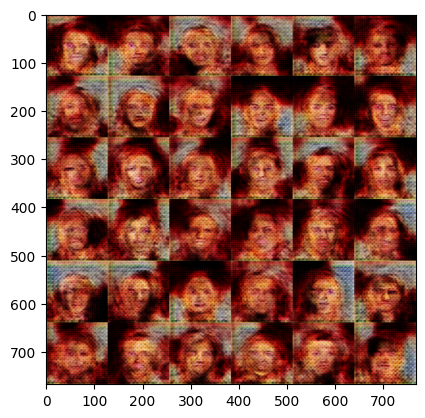

Training Progress:  40%|████      | 6000/15000 [32:11<1:06:49,  2.24step/s]

****************************************************************************************************
1/1 [==============================] - 0s 17ms/step


Training Progress:  40%|████      | 6001/15000 [32:11<1:00:50,  2.47step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|████      | 6002/15000 [32:12<56:20,  2.66step/s]  

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|████      | 6003/15000 [32:12<53:12,  2.82step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|████      | 6004/15000 [32:12<53:14,  2.82step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  40%|████      | 6005/15000 [32:13<51:29,  2.91step/s]

1/1 [==============================] - 0s 28ms/step


Training Progress:  40%|████      | 6006/15000 [32:13<55:15,  2.71step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  40%|████      | 6007/15000 [32:13<57:18,  2.62step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  40%|████      | 6008/15000 [32:14<1:00:20,  2.48step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  40%|████      | 6009/15000 [32:14<56:08,  2.67step/s]  

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|████      | 6010/15000 [32:15<53:00,  2.83step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|████      | 6011/15000 [32:15<52:32,  2.85step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|████      | 6012/15000 [32:15<50:30,  2.97step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|████      | 6013/15000 [32:15<49:11,  3.04step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|████      | 6014/15000 [32:16<48:10,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|████      | 6015/15000 [32:16<47:37,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|████      | 6016/15000 [32:16<47:08,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  40%|████      | 6017/15000 [32:17<47:04,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  40%|████      | 6018/15000 [32:17<46:45,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  40%|████      | 6019/15000 [32:17<46:34,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  40%|████      | 6020/15000 [32:18<46:26,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|████      | 6021/15000 [32:18<46:21,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|████      | 6022/15000 [32:18<47:47,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|████      | 6023/15000 [32:19<47:13,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|████      | 6024/15000 [32:19<48:19,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|████      | 6025/15000 [32:19<47:36,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|████      | 6026/15000 [32:20<47:04,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|████      | 6027/15000 [32:20<47:02,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|████      | 6028/15000 [32:20<46:38,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|████      | 6029/15000 [32:21<48:09,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|████      | 6030/15000 [32:21<47:23,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|████      | 6031/15000 [32:21<47:05,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|████      | 6032/15000 [32:21<46:39,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  40%|████      | 6033/15000 [32:22<46:29,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|████      | 6034/15000 [32:22<46:26,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|████      | 6035/15000 [32:22<46:40,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  40%|████      | 6036/15000 [32:23<46:43,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  40%|████      | 6037/15000 [32:23<46:34,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|████      | 6038/15000 [32:23<46:22,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|████      | 6039/15000 [32:24<46:15,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|████      | 6040/15000 [32:24<46:09,  3.24step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:  40%|████      | 6041/15000 [32:24<45:58,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|████      | 6042/15000 [32:25<45:52,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|████      | 6043/15000 [32:25<45:51,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|████      | 6044/15000 [32:25<45:55,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  40%|████      | 6045/15000 [32:25<46:11,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  40%|████      | 6046/15000 [32:26<46:09,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|████      | 6047/15000 [32:26<46:15,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|████      | 6048/15000 [32:26<46:05,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|████      | 6049/15000 [32:27<45:59,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|████      | 6050/15000 [32:27<45:52,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|████      | 6051/15000 [32:27<45:50,  3.25step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  40%|████      | 6052/15000 [32:28<45:50,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|████      | 6053/15000 [32:28<45:51,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  40%|████      | 6054/15000 [32:28<46:00,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|████      | 6055/15000 [32:29<45:59,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|████      | 6056/15000 [32:29<45:49,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|████      | 6057/15000 [32:29<45:55,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  40%|████      | 6058/15000 [32:29<45:49,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|████      | 6059/15000 [32:30<45:46,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  40%|████      | 6060/15000 [32:30<45:48,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  40%|████      | 6061/15000 [32:30<45:53,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|████      | 6062/15000 [32:31<45:43,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|████      | 6063/15000 [32:31<45:40,  3.26step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  40%|████      | 6064/15000 [32:31<47:29,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|████      | 6065/15000 [32:32<46:57,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|████      | 6066/15000 [32:32<46:37,  3.19step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  40%|████      | 6067/15000 [32:32<48:50,  3.05step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|████      | 6068/15000 [32:33<47:51,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  40%|████      | 6069/15000 [32:33<47:14,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|████      | 6070/15000 [32:33<46:42,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|████      | 6071/15000 [32:34<46:28,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  40%|████      | 6072/15000 [32:34<46:10,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|████      | 6073/15000 [32:34<46:20,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  40%|████      | 6074/15000 [32:34<46:12,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  40%|████      | 6075/15000 [32:35<46:07,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  41%|████      | 6076/15000 [32:35<46:09,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████      | 6077/15000 [32:35<45:59,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████      | 6078/15000 [32:36<45:48,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████      | 6079/15000 [32:36<47:28,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████      | 6080/15000 [32:36<46:51,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████      | 6081/15000 [32:37<46:30,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  41%|████      | 6082/15000 [32:37<46:28,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  41%|████      | 6083/15000 [32:37<48:03,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████      | 6084/15000 [32:38<47:18,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  41%|████      | 6085/15000 [32:38<46:54,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  41%|████      | 6086/15000 [32:38<48:05,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████      | 6087/15000 [32:39<47:32,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████      | 6088/15000 [32:39<47:27,  3.13step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  41%|████      | 6089/15000 [32:39<47:11,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  41%|████      | 6090/15000 [32:40<46:47,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████      | 6091/15000 [32:40<46:41,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████      | 6092/15000 [32:40<46:24,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████      | 6093/15000 [32:40<46:10,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████      | 6094/15000 [32:41<45:58,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████      | 6095/15000 [32:41<45:56,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████      | 6096/15000 [32:41<45:47,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████      | 6097/15000 [32:42<45:40,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  41%|████      | 6098/15000 [32:42<45:43,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████      | 6099/15000 [32:42<47:26,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  41%|████      | 6100/15000 [32:43<46:53,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████      | 6101/15000 [32:43<46:51,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████      | 6102/15000 [32:43<48:05,  3.08step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  41%|████      | 6103/15000 [32:44<47:21,  3.13step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  41%|████      | 6104/15000 [32:44<46:58,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████      | 6105/15000 [32:44<50:34,  2.93step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  41%|████      | 6106/15000 [32:45<55:36,  2.67step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  41%|████      | 6107/15000 [32:45<54:16,  2.73step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  41%|████      | 6108/15000 [32:46<54:40,  2.71step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████      | 6109/15000 [32:46<51:57,  2.85step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████      | 6110/15000 [32:46<50:16,  2.95step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  41%|████      | 6111/15000 [32:46<48:58,  3.03step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████      | 6112/15000 [32:47<47:54,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  41%|████      | 6113/15000 [32:47<47:14,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  41%|████      | 6114/15000 [32:47<46:44,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  41%|████      | 6115/15000 [32:48<46:39,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████      | 6116/15000 [32:48<46:16,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████      | 6117/15000 [32:48<46:03,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████      | 6118/15000 [32:49<45:48,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  41%|████      | 6119/15000 [32:49<45:57,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  41%|████      | 6120/15000 [32:49<45:49,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████      | 6121/15000 [32:50<45:43,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████      | 6122/15000 [32:50<47:09,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████      | 6123/15000 [32:50<46:44,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████      | 6124/15000 [32:50<46:13,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████      | 6125/15000 [32:51<45:57,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████      | 6126/15000 [32:51<45:42,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████      | 6127/15000 [32:51<45:36,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  41%|████      | 6128/15000 [32:52<45:41,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  41%|████      | 6129/15000 [32:52<45:42,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  41%|████      | 6130/15000 [32:52<45:35,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████      | 6131/15000 [32:53<45:32,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████      | 6132/15000 [32:53<45:27,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████      | 6133/15000 [32:53<45:32,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████      | 6134/15000 [32:54<45:24,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  41%|████      | 6135/15000 [32:54<45:37,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████      | 6136/15000 [32:54<45:32,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████      | 6137/15000 [32:54<45:28,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████      | 6138/15000 [32:55<45:36,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████      | 6139/15000 [32:55<45:32,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████      | 6140/15000 [32:55<45:26,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  41%|████      | 6141/15000 [32:56<45:28,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████      | 6142/15000 [32:56<46:58,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████      | 6143/15000 [32:56<46:29,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████      | 6144/15000 [32:57<46:09,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████      | 6145/15000 [32:57<45:58,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████      | 6146/15000 [32:57<45:50,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  41%|████      | 6147/15000 [32:58<46:00,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████      | 6148/15000 [32:58<45:55,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████      | 6149/15000 [32:58<45:48,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████      | 6150/15000 [32:59<45:41,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████      | 6151/15000 [32:59<45:35,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████      | 6152/15000 [32:59<47:14,  3.12step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  41%|████      | 6153/15000 [33:00<47:01,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████      | 6154/15000 [33:00<46:40,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  41%|████      | 6155/15000 [33:00<46:20,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  41%|████      | 6156/15000 [33:00<46:27,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  41%|████      | 6157/15000 [33:01<46:15,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████      | 6158/15000 [33:01<46:01,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████      | 6159/15000 [33:01<45:55,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████      | 6160/15000 [33:02<45:47,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████      | 6161/15000 [33:02<47:18,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  41%|████      | 6162/15000 [33:02<47:05,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████      | 6163/15000 [33:03<46:39,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████      | 6164/15000 [33:03<46:23,  3.17step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  41%|████      | 6165/15000 [33:03<46:52,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  41%|████      | 6166/15000 [33:04<48:08,  3.06step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  41%|████      | 6167/15000 [33:04<47:24,  3.11step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  41%|████      | 6168/15000 [33:04<47:02,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████      | 6169/15000 [33:05<46:36,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████      | 6170/15000 [33:05<46:19,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████      | 6171/15000 [33:05<46:05,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  41%|████      | 6172/15000 [33:06<46:01,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████      | 6173/15000 [33:06<45:51,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████      | 6174/15000 [33:06<47:27,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  41%|████      | 6175/15000 [33:06<47:10,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  41%|████      | 6176/15000 [33:07<46:44,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  41%|████      | 6177/15000 [33:07<46:27,  3.16step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  41%|████      | 6178/15000 [33:07<46:17,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████      | 6179/15000 [33:08<46:01,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████      | 6180/15000 [33:08<45:50,  3.21step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  41%|████      | 6181/15000 [33:08<46:07,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  41%|████      | 6182/15000 [33:09<46:01,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████      | 6183/15000 [33:09<45:51,  3.20step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  41%|████      | 6184/15000 [33:09<46:10,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  41%|████      | 6185/15000 [33:10<47:36,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  41%|████      | 6186/15000 [33:10<47:04,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████      | 6187/15000 [33:10<48:06,  3.05step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  41%|████▏     | 6188/15000 [33:11<47:26,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████▏     | 6189/15000 [33:11<46:43,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████▏     | 6190/15000 [33:11<46:12,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████▏     | 6191/15000 [33:12<45:53,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████▏     | 6192/15000 [33:12<47:24,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  41%|████▏     | 6193/15000 [33:12<47:23,  3.10step/s]

1/1 [==============================] - 0s 30ms/step


Training Progress:  41%|████▏     | 6194/15000 [33:13<51:04,  2.87step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  41%|████▏     | 6195/15000 [33:13<49:24,  2.97step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  41%|████▏     | 6196/15000 [33:13<48:13,  3.04step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████▏     | 6197/15000 [33:14<47:20,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  41%|████▏     | 6198/15000 [33:14<46:45,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  41%|████▏     | 6199/15000 [33:14<46:18,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  41%|████▏     | 6200/15000 [33:14<46:02,  3.19step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:  41%|████▏     | 6201/15000 [33:15<45:36,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████▏     | 6202/15000 [33:15<45:44,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████▏     | 6203/15000 [33:15<45:39,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  41%|████▏     | 6204/15000 [33:16<51:02,  2.87step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  41%|████▏     | 6205/15000 [33:16<53:52,  2.72step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  41%|████▏     | 6206/15000 [33:17<54:17,  2.70step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  41%|████▏     | 6207/15000 [33:17<52:48,  2.78step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████▏     | 6208/15000 [33:17<50:31,  2.90step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  41%|████▏     | 6209/15000 [33:18<50:30,  2.90step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████▏     | 6210/15000 [33:18<49:06,  2.98step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████▏     | 6211/15000 [33:18<47:53,  3.06step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  41%|████▏     | 6212/15000 [33:19<47:19,  3.10step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  41%|████▏     | 6213/15000 [33:19<46:49,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████▏     | 6214/15000 [33:19<46:17,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  41%|████▏     | 6215/15000 [33:20<47:30,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████▏     | 6216/15000 [33:20<46:46,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████▏     | 6217/15000 [33:20<46:13,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████▏     | 6218/15000 [33:20<45:49,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████▏     | 6219/15000 [33:21<45:29,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████▏     | 6220/15000 [33:21<45:13,  3.24step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  41%|████▏     | 6221/15000 [33:21<45:35,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████▏     | 6222/15000 [33:22<45:24,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████▏     | 6223/15000 [33:22<45:17,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  41%|████▏     | 6224/15000 [33:22<45:33,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  42%|████▏     | 6225/15000 [33:23<46:06,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  42%|████▏     | 6226/15000 [33:23<45:47,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6227/15000 [33:23<45:28,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6228/15000 [33:24<45:19,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6229/15000 [33:24<45:13,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6230/15000 [33:24<45:18,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  42%|████▏     | 6231/15000 [33:24<45:09,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  42%|████▏     | 6232/15000 [33:25<45:05,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  42%|████▏     | 6233/15000 [33:25<45:06,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6234/15000 [33:25<44:59,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6235/15000 [33:26<44:51,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6236/15000 [33:26<44:45,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6237/15000 [33:26<44:44,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6238/15000 [33:27<44:39,  3.27step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  42%|████▏     | 6239/15000 [33:27<46:31,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  42%|████▏     | 6240/15000 [33:27<47:38,  3.06step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  42%|████▏     | 6241/15000 [33:28<46:46,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6242/15000 [33:28<46:13,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6243/15000 [33:28<47:24,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6244/15000 [33:29<46:33,  3.13step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  42%|████▏     | 6245/15000 [33:29<46:05,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6246/15000 [33:29<45:40,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6247/15000 [33:29<45:21,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6248/15000 [33:30<45:07,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  42%|████▏     | 6249/15000 [33:30<46:48,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  42%|████▏     | 6250/15000 [33:30<46:13,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6251/15000 [33:31<45:45,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6252/15000 [33:31<45:24,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  42%|████▏     | 6253/15000 [33:31<45:15,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6254/15000 [33:32<44:57,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6255/15000 [33:32<45:08,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  42%|████▏     | 6256/15000 [33:32<47:17,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6257/15000 [33:33<46:26,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  42%|████▏     | 6258/15000 [33:33<47:52,  3.04step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  42%|████▏     | 6259/15000 [33:33<47:05,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  42%|████▏     | 6260/15000 [33:34<46:26,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  42%|████▏     | 6261/15000 [33:34<47:33,  3.06step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  42%|████▏     | 6262/15000 [33:34<46:50,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  42%|████▏     | 6263/15000 [33:35<46:16,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6264/15000 [33:35<45:48,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6265/15000 [33:35<45:25,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6266/15000 [33:36<46:47,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  42%|████▏     | 6267/15000 [33:36<46:17,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6268/15000 [33:36<45:49,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  42%|████▏     | 6269/15000 [33:36<45:28,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6270/15000 [33:37<45:12,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6271/15000 [33:37<45:03,  3.23step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  42%|████▏     | 6272/15000 [33:37<44:55,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6273/15000 [33:38<44:44,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6274/15000 [33:38<44:37,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6275/15000 [33:38<44:34,  3.26step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  42%|████▏     | 6276/15000 [33:39<44:46,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  42%|████▏     | 6277/15000 [33:39<44:45,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  42%|████▏     | 6278/15000 [33:39<44:42,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  42%|████▏     | 6279/15000 [33:40<44:45,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6280/15000 [33:40<44:42,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6281/15000 [33:40<44:37,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6282/15000 [33:40<44:37,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6283/15000 [33:41<44:36,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6284/15000 [33:41<44:34,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6285/15000 [33:41<44:30,  3.26step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  42%|████▏     | 6286/15000 [33:42<44:44,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  42%|████▏     | 6287/15000 [33:42<44:44,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  42%|████▏     | 6288/15000 [33:42<44:41,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  42%|████▏     | 6289/15000 [33:43<45:39,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  42%|████▏     | 6290/15000 [33:43<47:03,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  42%|████▏     | 6291/15000 [33:43<46:15,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6292/15000 [33:44<45:41,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  42%|████▏     | 6293/15000 [33:44<45:21,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6294/15000 [33:44<45:03,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  42%|████▏     | 6295/15000 [33:45<45:11,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  42%|████▏     | 6296/15000 [33:45<45:00,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  42%|████▏     | 6297/15000 [33:45<44:51,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6298/15000 [33:45<44:48,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6299/15000 [33:46<44:40,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  42%|████▏     | 6300/15000 [33:46<44:38,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6301/15000 [33:46<44:32,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6302/15000 [33:47<44:24,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6303/15000 [33:47<44:22,  3.27step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  42%|████▏     | 6304/15000 [33:47<49:39,  2.92step/s]

1/1 [==============================] - 0s 32ms/step


Training Progress:  42%|████▏     | 6305/15000 [33:48<53:07,  2.73step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  42%|████▏     | 6306/15000 [33:48<55:01,  2.63step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6307/15000 [33:49<51:50,  2.80step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6308/15000 [33:49<49:37,  2.92step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6309/15000 [33:49<49:44,  2.91step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  42%|████▏     | 6310/15000 [33:49<48:30,  2.99step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  42%|████▏     | 6311/15000 [33:50<47:23,  3.06step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6312/15000 [33:50<46:29,  3.11step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  42%|████▏     | 6313/15000 [33:50<46:11,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  42%|████▏     | 6314/15000 [33:51<45:51,  3.16step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  42%|████▏     | 6315/15000 [33:51<47:08,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  42%|████▏     | 6316/15000 [33:51<46:32,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6317/15000 [33:52<45:56,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6318/15000 [33:52<45:34,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6319/15000 [33:52<45:10,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  42%|████▏     | 6320/15000 [33:53<45:02,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6321/15000 [33:53<44:58,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6322/15000 [33:53<44:54,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  42%|████▏     | 6323/15000 [33:54<46:42,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  42%|████▏     | 6324/15000 [33:54<46:03,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6325/15000 [33:54<45:37,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6326/15000 [33:55<45:21,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6327/15000 [33:55<45:05,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6328/15000 [33:55<44:52,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  42%|████▏     | 6329/15000 [33:55<44:53,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6330/15000 [33:56<44:53,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6331/15000 [33:56<44:43,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6332/15000 [33:56<46:30,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6333/15000 [33:57<45:56,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  42%|████▏     | 6334/15000 [33:57<45:36,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6335/15000 [33:57<45:08,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6336/15000 [33:58<44:54,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6337/15000 [33:58<46:22,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  42%|████▏     | 6338/15000 [33:58<45:50,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6339/15000 [33:59<45:26,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  42%|████▏     | 6340/15000 [33:59<45:07,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  42%|████▏     | 6341/15000 [33:59<46:49,  3.08step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  42%|████▏     | 6342/15000 [34:00<46:23,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6343/15000 [34:00<45:54,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6344/15000 [34:00<45:27,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6345/15000 [34:01<45:11,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6346/15000 [34:01<44:57,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  42%|████▏     | 6347/15000 [34:01<44:49,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  42%|████▏     | 6348/15000 [34:01<44:47,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6349/15000 [34:02<44:39,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6350/15000 [34:02<44:49,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6351/15000 [34:02<47:03,  3.06step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6352/15000 [34:03<47:49,  3.01step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6353/15000 [34:03<46:48,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6354/15000 [34:03<46:16,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6355/15000 [34:04<45:39,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  42%|████▏     | 6356/15000 [34:04<45:19,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6357/15000 [34:04<45:06,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6358/15000 [34:05<44:52,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6359/15000 [34:05<44:44,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6360/15000 [34:05<44:50,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6361/15000 [34:06<44:47,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6362/15000 [34:06<44:37,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6363/15000 [34:06<44:36,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6364/15000 [34:06<44:31,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6365/15000 [34:07<44:35,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  42%|████▏     | 6366/15000 [34:07<44:35,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  42%|████▏     | 6367/15000 [34:07<44:40,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6368/15000 [34:08<44:33,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  42%|████▏     | 6369/15000 [34:08<44:44,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  42%|████▏     | 6370/15000 [34:08<46:09,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6371/15000 [34:09<45:46,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6372/15000 [34:09<45:17,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6373/15000 [34:09<44:56,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▏     | 6374/15000 [34:10<44:44,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  42%|████▎     | 6375/15000 [34:10<44:34,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6376/15000 [34:10<44:27,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6377/15000 [34:11<44:31,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  43%|████▎     | 6378/15000 [34:11<46:14,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  43%|████▎     | 6379/15000 [34:11<45:40,  3.15step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  43%|████▎     | 6380/15000 [34:12<45:27,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  43%|████▎     | 6381/15000 [34:12<45:09,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  43%|████▎     | 6382/15000 [34:12<46:26,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6383/15000 [34:13<46:47,  3.07step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6384/15000 [34:13<46:04,  3.12step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  43%|████▎     | 6385/15000 [34:13<45:47,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  43%|████▎     | 6386/15000 [34:13<45:22,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6387/15000 [34:14<46:47,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  43%|████▎     | 6388/15000 [34:14<47:37,  3.01step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  43%|████▎     | 6389/15000 [34:14<46:37,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6390/15000 [34:15<45:53,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6391/15000 [34:15<45:23,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6392/15000 [34:15<45:06,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6393/15000 [34:16<44:48,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6394/15000 [34:16<44:33,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6395/15000 [34:16<44:17,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6396/15000 [34:17<44:15,  3.24step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  43%|████▎     | 6397/15000 [34:17<46:03,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  43%|████▎     | 6398/15000 [34:17<45:31,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6399/15000 [34:18<45:17,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6400/15000 [34:18<45:00,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6401/15000 [34:18<44:39,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  43%|████▎     | 6402/15000 [34:19<47:44,  3.00step/s]

1/1 [==============================] - 0s 27ms/step


Training Progress:  43%|████▎     | 6403/15000 [34:19<51:18,  2.79step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  43%|████▎     | 6404/15000 [34:19<53:37,  2.67step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  43%|████▎     | 6405/15000 [34:20<53:32,  2.68step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6406/15000 [34:20<50:53,  2.81step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6407/15000 [34:20<48:52,  2.93step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  43%|████▎     | 6408/15000 [34:21<47:30,  3.01step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6409/15000 [34:21<46:21,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6410/15000 [34:21<45:37,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  43%|████▎     | 6411/15000 [34:22<45:12,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6412/15000 [34:22<46:22,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6413/15000 [34:22<47:40,  3.00step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  43%|████▎     | 6414/15000 [34:23<47:02,  3.04step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  43%|████▎     | 6415/15000 [34:23<46:30,  3.08step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  43%|████▎     | 6416/15000 [34:23<45:51,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  43%|████▎     | 6417/15000 [34:24<45:27,  3.15step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  43%|████▎     | 6418/15000 [34:24<45:17,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6419/15000 [34:24<44:51,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  43%|████▎     | 6420/15000 [34:24<44:38,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  43%|████▎     | 6421/15000 [34:25<44:24,  3.22step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  43%|████▎     | 6422/15000 [34:25<44:21,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  43%|████▎     | 6423/15000 [34:25<44:13,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  43%|████▎     | 6424/15000 [34:26<44:27,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  43%|████▎     | 6425/15000 [34:26<44:19,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6426/15000 [34:26<44:17,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6427/15000 [34:27<44:13,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6428/15000 [34:27<44:12,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6429/15000 [34:27<44:02,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6430/15000 [34:28<45:42,  3.12step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  43%|████▎     | 6431/15000 [34:28<47:07,  3.03step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6432/15000 [34:28<46:15,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6433/15000 [34:29<45:35,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  43%|████▎     | 6434/15000 [34:29<45:35,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  43%|████▎     | 6435/15000 [34:29<45:17,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  43%|████▎     | 6436/15000 [34:30<45:07,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6437/15000 [34:30<44:42,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  43%|████▎     | 6438/15000 [34:30<44:32,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6439/15000 [34:31<45:53,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  43%|████▎     | 6440/15000 [34:31<45:26,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6441/15000 [34:31<44:56,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  43%|████▎     | 6442/15000 [34:31<44:48,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6443/15000 [34:32<44:41,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  43%|████▎     | 6444/15000 [34:32<47:38,  2.99step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  43%|████▎     | 6445/15000 [34:32<46:50,  3.04step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  43%|████▎     | 6446/15000 [34:33<47:37,  2.99step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  43%|████▎     | 6447/15000 [34:33<46:30,  3.06step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6448/15000 [34:33<45:45,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  43%|████▎     | 6449/15000 [34:34<45:16,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6450/15000 [34:34<44:51,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6451/15000 [34:34<44:33,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  43%|████▎     | 6452/15000 [34:35<44:43,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  43%|████▎     | 6453/15000 [34:35<44:39,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6454/15000 [34:35<44:27,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  43%|████▎     | 6455/15000 [34:36<44:21,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6456/15000 [34:36<44:08,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6457/15000 [34:36<44:02,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6458/15000 [34:36<43:54,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6459/15000 [34:37<43:54,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6460/15000 [34:37<43:52,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  43%|████▎     | 6461/15000 [34:37<44:02,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  43%|████▎     | 6462/15000 [34:38<44:02,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  43%|████▎     | 6463/15000 [34:38<45:31,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  43%|████▎     | 6464/15000 [34:38<48:10,  2.95step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6465/15000 [34:39<46:54,  3.03step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6466/15000 [34:39<45:56,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6467/15000 [34:39<45:19,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6468/15000 [34:40<44:57,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  43%|████▎     | 6469/15000 [34:40<44:39,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  43%|████▎     | 6470/15000 [34:40<45:52,  3.10step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  43%|████▎     | 6471/15000 [34:41<45:34,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  43%|████▎     | 6472/15000 [34:41<45:02,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6473/15000 [34:41<44:35,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6474/15000 [34:42<45:58,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  43%|████▎     | 6475/15000 [34:42<45:18,  3.14step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  43%|████▎     | 6476/15000 [34:42<45:13,  3.14step/s]

1/1 [==============================] - 0s 33ms/step


Training Progress:  43%|████▎     | 6477/15000 [34:43<48:13,  2.95step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  43%|████▎     | 6478/15000 [34:43<46:54,  3.03step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6479/15000 [34:43<45:59,  3.09step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  43%|████▎     | 6480/15000 [34:44<45:37,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  43%|████▎     | 6481/15000 [34:44<45:13,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  43%|████▎     | 6482/15000 [34:44<44:42,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6483/15000 [34:45<44:23,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  43%|████▎     | 6484/15000 [34:45<44:05,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6485/15000 [34:45<45:27,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6486/15000 [34:45<44:56,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6487/15000 [34:46<44:27,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6488/15000 [34:46<44:13,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  43%|████▎     | 6489/15000 [34:46<44:12,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6490/15000 [34:47<44:09,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6491/15000 [34:47<43:58,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6492/15000 [34:47<43:53,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6493/15000 [34:48<43:47,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6494/15000 [34:48<43:44,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6495/15000 [34:48<45:12,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6496/15000 [34:49<44:46,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  43%|████▎     | 6497/15000 [34:49<44:28,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  43%|████▎     | 6498/15000 [34:49<44:31,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6499/15000 [34:50<44:15,  3.20step/s]

1/1 [==============================] - 0s 16ms/step
****************************************************************************************************
6500/15000: d_loss: 0.125292,  g_loss: 0.006312
2/2 [==============================] - 0s 20ms/step


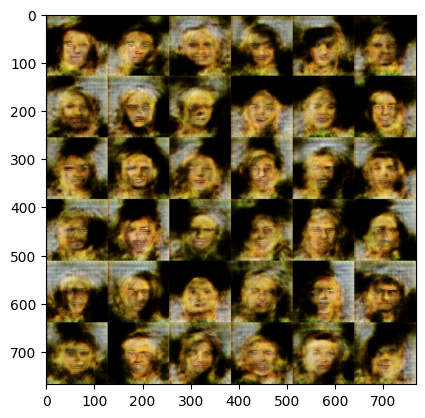

Training Progress:  43%|████▎     | 6500/15000 [34:50<1:10:02,  2.02step/s]

****************************************************************************************************
1/1 [==============================] - 0s 25ms/step


Training Progress:  43%|████▎     | 6501/15000 [34:51<1:08:25,  2.07step/s]

1/1 [==============================] - 0s 27ms/step


Training Progress:  43%|████▎     | 6502/15000 [34:51<1:05:24,  2.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6503/15000 [34:52<59:00,  2.40step/s]  

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6504/15000 [34:52<54:24,  2.60step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6505/15000 [34:52<51:25,  2.75step/s]

1/1 [==============================] - 0s 34ms/step


Training Progress:  43%|████▎     | 6506/15000 [34:53<52:56,  2.67step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6507/15000 [34:53<50:13,  2.82step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6508/15000 [34:53<48:16,  2.93step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6509/15000 [34:54<46:54,  3.02step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  43%|████▎     | 6510/15000 [34:54<46:06,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  43%|████▎     | 6511/15000 [34:54<45:39,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  43%|████▎     | 6512/15000 [34:55<46:36,  3.04step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6513/15000 [34:55<45:44,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6514/15000 [34:55<45:04,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6515/15000 [34:55<44:35,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6516/15000 [34:56<44:19,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6517/15000 [34:56<44:09,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6518/15000 [34:56<43:58,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6519/15000 [34:57<43:54,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6520/15000 [34:57<43:58,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  43%|████▎     | 6521/15000 [34:57<43:53,  3.22step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  43%|████▎     | 6522/15000 [34:58<44:04,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  43%|████▎     | 6523/15000 [34:58<44:03,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  43%|████▎     | 6524/15000 [34:58<43:57,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▎     | 6525/15000 [34:59<45:25,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▎     | 6526/15000 [34:59<46:31,  3.04step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  44%|████▎     | 6527/15000 [34:59<45:43,  3.09step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  44%|████▎     | 6528/15000 [35:00<45:24,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  44%|████▎     | 6529/15000 [35:00<46:37,  3.03step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▎     | 6530/15000 [35:00<45:43,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  44%|████▎     | 6531/15000 [35:01<45:12,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  44%|████▎     | 6532/15000 [35:01<44:48,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▎     | 6533/15000 [35:01<44:29,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▎     | 6534/15000 [35:02<45:41,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▎     | 6535/15000 [35:02<44:59,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▎     | 6536/15000 [35:02<44:34,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  44%|████▎     | 6537/15000 [35:02<44:22,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  44%|████▎     | 6538/15000 [35:03<44:06,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  44%|████▎     | 6539/15000 [35:03<44:08,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  44%|████▎     | 6540/15000 [35:03<44:03,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  44%|████▎     | 6541/15000 [35:04<43:53,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▎     | 6542/15000 [35:04<43:43,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▎     | 6543/15000 [35:04<43:35,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  44%|████▎     | 6544/15000 [35:05<43:37,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▎     | 6545/15000 [35:05<43:32,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  44%|████▎     | 6546/15000 [35:05<43:33,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  44%|████▎     | 6547/15000 [35:06<43:30,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▎     | 6548/15000 [35:06<43:49,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  44%|████▎     | 6549/15000 [35:06<43:41,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▎     | 6550/15000 [35:06<43:36,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▎     | 6551/15000 [35:07<43:31,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▎     | 6552/15000 [35:07<43:29,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▎     | 6553/15000 [35:07<43:26,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▎     | 6554/15000 [35:08<43:26,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▎     | 6555/15000 [35:08<43:19,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  44%|████▎     | 6556/15000 [35:08<43:20,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  44%|████▎     | 6557/15000 [35:09<43:30,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▎     | 6558/15000 [35:09<43:28,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▎     | 6559/15000 [35:09<43:18,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▎     | 6560/15000 [35:10<43:18,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▎     | 6561/15000 [35:10<43:19,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▎     | 6562/15000 [35:10<43:19,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▍     | 6563/15000 [35:10<43:16,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  44%|████▍     | 6564/15000 [35:11<43:24,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▍     | 6565/15000 [35:11<43:18,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  44%|████▍     | 6566/15000 [35:11<43:33,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  44%|████▍     | 6567/15000 [35:12<45:02,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  44%|████▍     | 6568/15000 [35:12<44:35,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  44%|████▍     | 6569/15000 [35:12<47:37,  2.95step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  44%|████▍     | 6570/15000 [35:13<46:33,  3.02step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  44%|████▍     | 6571/15000 [35:13<45:41,  3.07step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▍     | 6572/15000 [35:13<44:56,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▍     | 6573/15000 [35:14<44:19,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  44%|████▍     | 6574/15000 [35:14<44:09,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  44%|████▍     | 6575/15000 [35:14<43:56,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  44%|████▍     | 6576/15000 [35:15<44:06,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  44%|████▍     | 6577/15000 [35:15<43:50,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▍     | 6578/15000 [35:15<43:39,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  44%|████▍     | 6579/15000 [35:16<43:34,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▍     | 6580/15000 [35:16<43:29,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▍     | 6581/15000 [35:16<44:52,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▍     | 6582/15000 [35:17<44:22,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▍     | 6583/15000 [35:17<45:29,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▍     | 6584/15000 [35:17<44:54,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  44%|████▍     | 6585/15000 [35:18<46:02,  3.05step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  44%|████▍     | 6586/15000 [35:18<45:14,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▍     | 6587/15000 [35:18<46:06,  3.04step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▍     | 6588/15000 [35:18<45:12,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▍     | 6589/15000 [35:19<44:36,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▍     | 6590/15000 [35:19<44:16,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  44%|████▍     | 6591/15000 [35:19<44:00,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▍     | 6592/15000 [35:20<44:09,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  44%|████▍     | 6593/15000 [35:20<44:02,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  44%|████▍     | 6594/15000 [35:20<44:06,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  44%|████▍     | 6595/15000 [35:21<43:48,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  44%|████▍     | 6596/15000 [35:21<43:36,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▍     | 6597/15000 [35:21<43:21,  3.23step/s]

1/1 [==============================] - 0s 27ms/step


Training Progress:  44%|████▍     | 6598/15000 [35:22<47:53,  2.92step/s]

1/1 [==============================] - 0s 28ms/step


Training Progress:  44%|████▍     | 6599/15000 [35:22<49:23,  2.84step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  44%|████▍     | 6600/15000 [35:23<53:52,  2.60step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  44%|████▍     | 6601/15000 [35:23<52:56,  2.64step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  44%|████▍     | 6602/15000 [35:23<50:05,  2.79step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  44%|████▍     | 6603/15000 [35:23<48:12,  2.90step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  44%|████▍     | 6604/15000 [35:24<46:58,  2.98step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  44%|████▍     | 6605/15000 [35:24<45:50,  3.05step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▍     | 6606/15000 [35:24<45:03,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▍     | 6607/15000 [35:25<44:22,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▍     | 6608/15000 [35:25<45:33,  3.07step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▍     | 6609/15000 [35:25<44:42,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▍     | 6610/15000 [35:26<45:45,  3.06step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▍     | 6611/15000 [35:26<44:47,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▍     | 6612/15000 [35:26<44:13,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▍     | 6613/15000 [35:27<45:32,  3.07step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▍     | 6614/15000 [35:27<44:51,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▍     | 6615/15000 [35:27<44:13,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  44%|████▍     | 6616/15000 [35:28<43:52,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▍     | 6617/15000 [35:28<43:34,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▍     | 6618/15000 [35:28<43:27,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▍     | 6619/15000 [35:29<43:08,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▍     | 6620/15000 [35:29<43:07,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▍     | 6621/15000 [35:29<42:58,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▍     | 6622/15000 [35:30<44:42,  3.12step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  44%|████▍     | 6623/15000 [35:30<44:10,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▍     | 6624/15000 [35:30<43:47,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▍     | 6625/15000 [35:30<43:29,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▍     | 6626/15000 [35:31<43:22,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▍     | 6627/15000 [35:31<43:10,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▍     | 6628/15000 [35:31<43:05,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▍     | 6629/15000 [35:32<42:54,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▍     | 6630/15000 [35:32<42:55,  3.25step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  44%|████▍     | 6631/15000 [35:32<45:48,  3.04step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  44%|████▍     | 6632/15000 [35:33<45:10,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▍     | 6633/15000 [35:33<44:27,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  44%|████▍     | 6634/15000 [35:33<44:05,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▍     | 6635/15000 [35:34<43:42,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▍     | 6636/15000 [35:34<45:00,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▍     | 6637/15000 [35:34<45:54,  3.04step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▍     | 6638/15000 [35:35<45:03,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▍     | 6639/15000 [35:35<44:22,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  44%|████▍     | 6640/15000 [35:35<44:11,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  44%|████▍     | 6641/15000 [35:36<43:48,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  44%|████▍     | 6642/15000 [35:36<43:43,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  44%|████▍     | 6643/15000 [35:36<43:27,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  44%|████▍     | 6644/15000 [35:36<44:50,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▍     | 6645/15000 [35:37<44:15,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▍     | 6646/15000 [35:37<43:56,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▍     | 6647/15000 [35:37<43:35,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  44%|████▍     | 6648/15000 [35:38<43:25,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▍     | 6649/15000 [35:38<43:11,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  44%|████▍     | 6650/15000 [35:38<43:23,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  44%|████▍     | 6651/15000 [35:39<43:15,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  44%|████▍     | 6652/15000 [35:39<43:14,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  44%|████▍     | 6653/15000 [35:39<43:06,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▍     | 6654/15000 [35:40<43:02,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▍     | 6655/15000 [35:40<44:33,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  44%|████▍     | 6656/15000 [35:40<44:02,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▍     | 6657/15000 [35:41<43:41,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▍     | 6658/15000 [35:41<44:59,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  44%|████▍     | 6659/15000 [35:41<46:02,  3.02step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▍     | 6660/15000 [35:42<46:40,  2.98step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  44%|████▍     | 6661/15000 [35:42<45:35,  3.05step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▍     | 6662/15000 [35:42<46:26,  2.99step/s]

1/1 [==============================] - 0s 40ms/step


Training Progress:  44%|████▍     | 6663/15000 [35:43<46:58,  2.96step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  44%|████▍     | 6664/15000 [35:43<45:51,  3.03step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▍     | 6665/15000 [35:43<44:49,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▍     | 6666/15000 [35:43<44:15,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▍     | 6667/15000 [35:44<43:44,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  44%|████▍     | 6668/15000 [35:44<45:16,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  44%|████▍     | 6669/15000 [35:44<44:31,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  44%|████▍     | 6670/15000 [35:45<44:10,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▍     | 6671/15000 [35:45<43:44,  3.17step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  44%|████▍     | 6672/15000 [35:45<43:45,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▍     | 6673/15000 [35:46<43:28,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  44%|████▍     | 6674/15000 [35:46<43:16,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  44%|████▍     | 6675/15000 [35:46<43:04,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  45%|████▍     | 6676/15000 [35:47<43:00,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  45%|████▍     | 6677/15000 [35:47<43:05,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  45%|████▍     | 6678/15000 [35:47<43:02,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  45%|████▍     | 6679/15000 [35:48<42:53,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  45%|████▍     | 6680/15000 [35:48<42:52,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  45%|████▍     | 6681/15000 [35:48<42:46,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  45%|████▍     | 6682/15000 [35:48<42:47,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  45%|████▍     | 6683/15000 [35:49<42:40,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  45%|████▍     | 6684/15000 [35:49<42:41,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  45%|████▍     | 6685/15000 [35:49<42:39,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  45%|████▍     | 6686/15000 [35:50<42:59,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  45%|████▍     | 6687/15000 [35:50<43:07,  3.21step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  45%|████▍     | 6688/15000 [35:51<55:34,  2.49step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  45%|████▍     | 6689/15000 [35:51<51:56,  2.67step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  45%|████▍     | 6690/15000 [35:51<49:29,  2.80step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  45%|████▍     | 6691/15000 [35:52<47:39,  2.91step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  45%|████▍     | 6692/15000 [35:52<48:22,  2.86step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  45%|████▍     | 6693/15000 [35:52<47:16,  2.93step/s]

1/1 [==============================] - 0s 29ms/step


Training Progress:  45%|████▍     | 6694/15000 [35:53<47:27,  2.92step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  45%|████▍     | 6695/15000 [35:53<49:58,  2.77step/s]

1/1 [==============================] - 0s 30ms/step


Training Progress:  45%|████▍     | 6696/15000 [35:53<50:03,  2.76step/s]

1/1 [==============================] - 0s 28ms/step


Training Progress:  45%|████▍     | 6697/15000 [35:54<54:14,  2.55step/s]

1/1 [==============================] - 0s 28ms/step


Training Progress:  45%|████▍     | 6698/15000 [35:54<53:59,  2.56step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  45%|████▍     | 6699/15000 [35:55<50:48,  2.72step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  45%|████▍     | 6700/15000 [35:55<48:43,  2.84step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  45%|████▍     | 6701/15000 [35:55<47:13,  2.93step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  45%|████▍     | 6702/15000 [35:55<46:08,  3.00step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  45%|████▍     | 6703/15000 [35:56<45:19,  3.05step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  45%|████▍     | 6704/15000 [35:56<44:52,  3.08step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  45%|████▍     | 6705/15000 [35:56<44:31,  3.11step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  45%|████▍     | 6706/15000 [35:57<44:42,  3.09step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  45%|████▍     | 6707/15000 [35:57<45:52,  3.01step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  45%|████▍     | 6708/15000 [35:57<45:23,  3.04step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  45%|████▍     | 6709/15000 [35:58<44:52,  3.08step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  45%|████▍     | 6710/15000 [35:58<46:01,  3.00step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  45%|████▍     | 6711/15000 [35:58<45:15,  3.05step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  45%|████▍     | 6712/15000 [35:59<44:49,  3.08step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  45%|████▍     | 6713/15000 [35:59<46:00,  3.00step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  45%|████▍     | 6714/15000 [35:59<45:24,  3.04step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  45%|████▍     | 6715/15000 [36:00<46:37,  2.96step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  45%|████▍     | 6716/15000 [36:00<45:43,  3.02step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  45%|████▍     | 6717/15000 [36:00<45:02,  3.06step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  45%|████▍     | 6718/15000 [36:01<44:33,  3.10step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  45%|████▍     | 6719/15000 [36:01<44:12,  3.12step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  45%|████▍     | 6720/15000 [36:01<44:07,  3.13step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  45%|████▍     | 6721/15000 [36:02<45:25,  3.04step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  45%|████▍     | 6722/15000 [36:02<44:54,  3.07step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  45%|████▍     | 6723/15000 [36:02<44:29,  3.10step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  45%|████▍     | 6724/15000 [36:03<44:35,  3.09step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  45%|████▍     | 6725/15000 [36:03<44:14,  3.12step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  45%|████▍     | 6726/15000 [36:03<44:08,  3.12step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  45%|████▍     | 6727/15000 [36:04<45:32,  3.03step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  45%|████▍     | 6728/15000 [36:04<45:11,  3.05step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  45%|████▍     | 6729/15000 [36:04<44:40,  3.09step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  45%|████▍     | 6730/15000 [36:05<44:24,  3.10step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  45%|████▍     | 6731/15000 [36:05<44:10,  3.12step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  45%|████▍     | 6732/15000 [36:05<44:05,  3.13step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  45%|████▍     | 6733/15000 [36:06<44:10,  3.12step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  45%|████▍     | 6734/15000 [36:06<44:03,  3.13step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  45%|████▍     | 6735/15000 [36:06<43:52,  3.14step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  45%|████▍     | 6736/15000 [36:07<43:50,  3.14step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  45%|████▍     | 6737/15000 [36:07<43:45,  3.15step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  45%|████▍     | 6738/15000 [36:07<43:49,  3.14step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  45%|████▍     | 6739/15000 [36:07<43:49,  3.14step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  45%|████▍     | 6740/15000 [36:08<43:57,  3.13step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  45%|████▍     | 6741/15000 [36:08<43:52,  3.14step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  45%|████▍     | 6742/15000 [36:08<44:05,  3.12step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  45%|████▍     | 6743/15000 [36:09<43:55,  3.13step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  45%|████▍     | 6744/15000 [36:09<43:56,  3.13step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  45%|████▍     | 6745/15000 [36:09<43:52,  3.14step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  45%|████▍     | 6746/15000 [36:10<44:30,  3.09step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  45%|████▍     | 6747/15000 [36:10<44:15,  3.11step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  45%|████▍     | 6748/15000 [36:10<44:18,  3.10step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  45%|████▍     | 6749/15000 [36:11<44:08,  3.11step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  45%|████▌     | 6750/15000 [36:11<44:03,  3.12step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  45%|████▌     | 6751/15000 [36:11<44:13,  3.11step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  45%|████▌     | 6752/15000 [36:12<44:10,  3.11step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  45%|████▌     | 6753/15000 [36:12<44:06,  3.12step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  45%|████▌     | 6754/15000 [36:12<45:57,  2.99step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  45%|████▌     | 6755/15000 [36:13<45:04,  3.05step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  45%|████▌     | 6756/15000 [36:13<46:02,  2.98step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  45%|████▌     | 6757/15000 [36:13<45:08,  3.04step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  45%|████▌     | 6758/15000 [36:14<44:34,  3.08step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  45%|████▌     | 6759/15000 [36:14<44:13,  3.11step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  45%|████▌     | 6760/15000 [36:14<44:24,  3.09step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  45%|████▌     | 6761/15000 [36:15<44:04,  3.12step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  45%|████▌     | 6762/15000 [36:15<43:52,  3.13step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  45%|████▌     | 6763/15000 [36:15<43:40,  3.14step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  45%|████▌     | 6764/15000 [36:16<43:41,  3.14step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  45%|████▌     | 6765/15000 [36:16<43:43,  3.14step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  45%|████▌     | 6766/15000 [36:16<43:36,  3.15step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  45%|████▌     | 6767/15000 [36:16<43:26,  3.16step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  45%|████▌     | 6768/15000 [36:17<43:25,  3.16step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  45%|████▌     | 6769/15000 [36:17<43:40,  3.14step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  45%|████▌     | 6770/15000 [36:17<43:37,  3.14step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  45%|████▌     | 6771/15000 [36:18<43:24,  3.16step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  45%|████▌     | 6772/15000 [36:18<43:20,  3.16step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  45%|████▌     | 6773/15000 [36:18<43:11,  3.17step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  45%|████▌     | 6774/15000 [36:19<43:09,  3.18step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  45%|████▌     | 6775/15000 [36:19<43:12,  3.17step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  45%|████▌     | 6776/15000 [36:19<43:07,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  45%|████▌     | 6777/15000 [36:20<42:57,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  45%|████▌     | 6778/15000 [36:20<43:16,  3.17step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  45%|████▌     | 6779/15000 [36:20<43:13,  3.17step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  45%|████▌     | 6780/15000 [36:21<43:08,  3.18step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  45%|████▌     | 6781/15000 [36:21<42:58,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  45%|████▌     | 6782/15000 [36:21<44:23,  3.08step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  45%|████▌     | 6783/15000 [36:22<43:50,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  45%|████▌     | 6784/15000 [36:22<43:24,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  45%|████▌     | 6785/15000 [36:22<43:00,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  45%|████▌     | 6786/15000 [36:22<43:48,  3.12step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  45%|████▌     | 6787/15000 [36:23<43:24,  3.15step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  45%|████▌     | 6788/15000 [36:23<43:40,  3.13step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  45%|████▌     | 6789/15000 [36:23<43:24,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  45%|████▌     | 6790/15000 [36:24<43:15,  3.16step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  45%|████▌     | 6791/15000 [36:24<43:00,  3.18step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  45%|████▌     | 6792/15000 [36:24<45:37,  3.00step/s]

1/1 [==============================] - 0s 28ms/step


Training Progress:  45%|████▌     | 6793/15000 [36:25<49:19,  2.77step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  45%|████▌     | 6794/15000 [36:25<51:37,  2.65step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  45%|████▌     | 6795/15000 [36:26<51:22,  2.66step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  45%|████▌     | 6796/15000 [36:26<48:46,  2.80step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  45%|████▌     | 6797/15000 [36:26<47:02,  2.91step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  45%|████▌     | 6798/15000 [36:27<45:39,  2.99step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  45%|████▌     | 6799/15000 [36:27<44:35,  3.07step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  45%|████▌     | 6800/15000 [36:27<43:52,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  45%|████▌     | 6801/15000 [36:28<43:20,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  45%|████▌     | 6802/15000 [36:28<42:52,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  45%|████▌     | 6803/15000 [36:28<42:39,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  45%|████▌     | 6804/15000 [36:28<43:54,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  45%|████▌     | 6805/15000 [36:29<43:19,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  45%|████▌     | 6806/15000 [36:29<43:10,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  45%|████▌     | 6807/15000 [36:29<42:50,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  45%|████▌     | 6808/15000 [36:30<42:32,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  45%|████▌     | 6809/15000 [36:30<42:27,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  45%|████▌     | 6810/15000 [36:30<42:20,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  45%|████▌     | 6811/15000 [36:31<42:16,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  45%|████▌     | 6812/15000 [36:31<43:40,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  45%|████▌     | 6813/15000 [36:31<43:11,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  45%|████▌     | 6814/15000 [36:32<42:51,  3.18step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  45%|████▌     | 6815/15000 [36:32<42:57,  3.18step/s]

1/1 [==============================] - 0s 33ms/step


Training Progress:  45%|████▌     | 6816/15000 [36:32<44:25,  3.07step/s]

1/1 [==============================] - 0s 32ms/step


Training Progress:  45%|████▌     | 6817/15000 [36:33<46:52,  2.91step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  45%|████▌     | 6818/15000 [36:33<46:57,  2.90step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  45%|████▌     | 6819/15000 [36:33<45:34,  2.99step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  45%|████▌     | 6820/15000 [36:34<44:26,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  45%|████▌     | 6821/15000 [36:34<43:44,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  45%|████▌     | 6822/15000 [36:34<43:10,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  45%|████▌     | 6823/15000 [36:35<42:51,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  45%|████▌     | 6824/15000 [36:35<42:34,  3.20step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  46%|████▌     | 6825/15000 [36:35<42:49,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  46%|████▌     | 6826/15000 [36:35<42:38,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  46%|████▌     | 6827/15000 [36:36<42:32,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  46%|████▌     | 6828/15000 [36:36<42:20,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  46%|████▌     | 6829/15000 [36:36<42:15,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  46%|████▌     | 6830/15000 [36:37<42:08,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  46%|████▌     | 6831/15000 [36:37<43:39,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  46%|████▌     | 6832/15000 [36:37<43:06,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  46%|████▌     | 6833/15000 [36:38<42:44,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  46%|████▌     | 6834/15000 [36:38<42:37,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  46%|████▌     | 6835/15000 [36:38<42:30,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  46%|████▌     | 6836/15000 [36:39<42:19,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  46%|████▌     | 6837/15000 [36:39<42:17,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  46%|████▌     | 6838/15000 [36:39<42:08,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  46%|████▌     | 6839/15000 [36:40<42:07,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  46%|████▌     | 6840/15000 [36:40<42:01,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  46%|████▌     | 6841/15000 [36:40<41:59,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  46%|████▌     | 6842/15000 [36:40<41:54,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  46%|████▌     | 6843/15000 [36:41<42:11,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  46%|████▌     | 6844/15000 [36:41<42:12,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  46%|████▌     | 6845/15000 [36:41<42:13,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  46%|████▌     | 6846/15000 [36:42<42:03,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  46%|████▌     | 6847/15000 [36:42<42:11,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  46%|████▌     | 6848/15000 [36:42<44:10,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  46%|████▌     | 6849/15000 [36:43<43:35,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  46%|████▌     | 6850/15000 [36:43<43:03,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  46%|████▌     | 6851/15000 [36:43<42:41,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  46%|████▌     | 6852/15000 [36:44<42:35,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  46%|████▌     | 6853/15000 [36:44<43:53,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  46%|████▌     | 6854/15000 [36:44<43:18,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  46%|████▌     | 6855/15000 [36:45<42:54,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  46%|████▌     | 6856/15000 [36:45<42:31,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  46%|████▌     | 6857/15000 [36:45<42:21,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  46%|████▌     | 6858/15000 [36:46<42:14,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  46%|████▌     | 6859/15000 [36:46<42:11,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  46%|████▌     | 6860/15000 [36:46<42:07,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  46%|████▌     | 6861/15000 [36:46<43:40,  3.11step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  46%|████▌     | 6862/15000 [36:47<43:33,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  46%|████▌     | 6863/15000 [36:47<43:15,  3.13step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  46%|████▌     | 6864/15000 [36:47<42:54,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  46%|████▌     | 6865/15000 [36:48<42:37,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  46%|████▌     | 6866/15000 [36:48<42:27,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  46%|████▌     | 6867/15000 [36:48<42:14,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  46%|████▌     | 6868/15000 [36:49<42:04,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  46%|████▌     | 6869/15000 [36:49<42:00,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  46%|████▌     | 6870/15000 [36:49<42:03,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  46%|████▌     | 6871/15000 [36:50<42:14,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  46%|████▌     | 6872/15000 [36:50<42:08,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  46%|████▌     | 6873/15000 [36:50<42:09,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  46%|████▌     | 6874/15000 [36:51<42:03,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  46%|████▌     | 6875/15000 [36:51<42:01,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  46%|████▌     | 6876/15000 [36:51<41:56,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  46%|████▌     | 6877/15000 [36:51<41:58,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  46%|████▌     | 6878/15000 [36:52<41:56,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  46%|████▌     | 6879/15000 [36:52<41:59,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  46%|████▌     | 6880/15000 [36:52<42:50,  3.16step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  46%|████▌     | 6881/15000 [36:53<42:40,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  46%|████▌     | 6882/15000 [36:53<43:50,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  46%|████▌     | 6883/15000 [36:53<43:16,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  46%|████▌     | 6884/15000 [36:54<42:44,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  46%|████▌     | 6885/15000 [36:54<42:25,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  46%|████▌     | 6886/15000 [36:54<42:09,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  46%|████▌     | 6887/15000 [36:55<42:01,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  46%|████▌     | 6888/15000 [36:55<43:24,  3.11step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  46%|████▌     | 6889/15000 [36:55<43:11,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  46%|████▌     | 6890/15000 [36:56<42:50,  3.16step/s]

1/1 [==============================] - 0s 27ms/step


Training Progress:  46%|████▌     | 6891/15000 [36:56<47:29,  2.85step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  46%|████▌     | 6892/15000 [36:56<51:09,  2.64step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  46%|████▌     | 6893/15000 [36:57<52:38,  2.57step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  46%|████▌     | 6894/15000 [36:57<49:16,  2.74step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  46%|████▌     | 6895/15000 [36:57<47:01,  2.87step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  46%|████▌     | 6896/15000 [36:58<45:20,  2.98step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  46%|████▌     | 6897/15000 [36:58<44:19,  3.05step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  46%|████▌     | 6898/15000 [36:58<43:26,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  46%|████▌     | 6899/15000 [36:59<43:09,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  46%|████▌     | 6900/15000 [36:59<42:38,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  46%|████▌     | 6901/15000 [36:59<42:26,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  46%|████▌     | 6902/15000 [37:00<43:35,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  46%|████▌     | 6903/15000 [37:00<43:01,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  46%|████▌     | 6904/15000 [37:00<43:00,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  46%|████▌     | 6905/15000 [37:01<42:47,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  46%|████▌     | 6906/15000 [37:01<42:29,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  46%|████▌     | 6907/15000 [37:01<42:16,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  46%|████▌     | 6908/15000 [37:02<42:25,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  46%|████▌     | 6909/15000 [37:02<42:27,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  46%|████▌     | 6910/15000 [37:02<42:16,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  46%|████▌     | 6911/15000 [37:03<42:46,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  46%|████▌     | 6912/15000 [37:03<42:21,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  46%|████▌     | 6913/15000 [37:03<42:12,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  46%|████▌     | 6914/15000 [37:03<41:57,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  46%|████▌     | 6915/15000 [37:04<41:55,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  46%|████▌     | 6916/15000 [37:04<41:57,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  46%|████▌     | 6917/15000 [37:04<42:08,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  46%|████▌     | 6918/15000 [37:05<43:30,  3.10step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  46%|████▌     | 6919/15000 [37:05<43:12,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  46%|████▌     | 6920/15000 [37:05<42:42,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  46%|████▌     | 6921/15000 [37:06<42:27,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  46%|████▌     | 6922/15000 [37:06<42:11,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  46%|████▌     | 6923/15000 [37:06<42:06,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  46%|████▌     | 6924/15000 [37:07<41:53,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  46%|████▌     | 6925/15000 [37:07<43:17,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  46%|████▌     | 6926/15000 [37:07<42:53,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  46%|████▌     | 6927/15000 [37:08<42:37,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  46%|████▌     | 6928/15000 [37:08<42:15,  3.18step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  46%|████▌     | 6929/15000 [37:08<42:12,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  46%|████▌     | 6930/15000 [37:08<41:56,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  46%|████▌     | 6931/15000 [37:09<41:50,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  46%|████▌     | 6932/15000 [37:09<43:12,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  46%|████▌     | 6933/15000 [37:09<42:44,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  46%|████▌     | 6934/15000 [37:10<42:23,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  46%|████▌     | 6935/15000 [37:10<42:05,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  46%|████▌     | 6936/15000 [37:10<43:43,  3.07step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  46%|████▌     | 6937/15000 [37:11<43:16,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  46%|████▋     | 6938/15000 [37:11<42:50,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  46%|████▋     | 6939/15000 [37:11<42:32,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  46%|████▋     | 6940/15000 [37:12<42:15,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  46%|████▋     | 6941/15000 [37:12<42:00,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  46%|████▋     | 6942/15000 [37:12<43:32,  3.08step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  46%|████▋     | 6943/15000 [37:13<43:10,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  46%|████▋     | 6944/15000 [37:13<42:37,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  46%|████▋     | 6945/15000 [37:13<42:34,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  46%|████▋     | 6946/15000 [37:14<42:13,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  46%|████▋     | 6947/15000 [37:14<42:02,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  46%|████▋     | 6948/15000 [37:14<41:50,  3.21step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  46%|████▋     | 6949/15000 [37:14<41:59,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  46%|████▋     | 6950/15000 [37:15<41:44,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  46%|████▋     | 6951/15000 [37:15<41:40,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  46%|████▋     | 6952/15000 [37:15<41:31,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  46%|████▋     | 6953/15000 [37:16<41:29,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  46%|████▋     | 6954/15000 [37:16<41:34,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  46%|████▋     | 6955/15000 [37:16<41:38,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  46%|████▋     | 6956/15000 [37:17<41:32,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  46%|████▋     | 6957/15000 [37:17<41:33,  3.23step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  46%|████▋     | 6958/15000 [37:17<41:47,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  46%|████▋     | 6959/15000 [37:18<41:59,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  46%|████▋     | 6960/15000 [37:18<43:11,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  46%|████▋     | 6961/15000 [37:18<42:43,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  46%|████▋     | 6962/15000 [37:19<42:15,  3.17step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  46%|████▋     | 6963/15000 [37:19<42:18,  3.17step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  46%|████▋     | 6964/15000 [37:19<42:36,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  46%|████▋     | 6965/15000 [37:20<43:52,  3.05step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  46%|████▋     | 6966/15000 [37:20<43:05,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  46%|████▋     | 6967/15000 [37:20<42:40,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  46%|████▋     | 6968/15000 [37:20<42:13,  3.17step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  46%|████▋     | 6969/15000 [37:21<42:03,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  46%|████▋     | 6970/15000 [37:21<41:51,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  46%|████▋     | 6971/15000 [37:21<41:48,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  46%|████▋     | 6972/15000 [37:22<41:37,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  46%|████▋     | 6973/15000 [37:22<41:54,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  46%|████▋     | 6974/15000 [37:22<43:27,  3.08step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  46%|████▋     | 6975/15000 [37:23<42:52,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  47%|████▋     | 6976/15000 [37:23<42:23,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  47%|████▋     | 6977/15000 [37:23<42:08,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  47%|████▋     | 6978/15000 [37:24<41:51,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  47%|████▋     | 6979/15000 [37:24<41:50,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  47%|████▋     | 6980/15000 [37:24<41:39,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  47%|████▋     | 6981/15000 [37:25<41:32,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  47%|████▋     | 6982/15000 [37:25<41:38,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  47%|████▋     | 6983/15000 [37:25<41:43,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  47%|████▋     | 6984/15000 [37:25<41:35,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  47%|████▋     | 6985/15000 [37:26<41:32,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  47%|████▋     | 6986/15000 [37:26<41:25,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  47%|████▋     | 6987/15000 [37:26<41:25,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  47%|████▋     | 6988/15000 [37:27<41:15,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  47%|████▋     | 6989/15000 [37:27<41:30,  3.22step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  47%|████▋     | 6990/15000 [37:27<44:20,  3.01step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  47%|████▋     | 6991/15000 [37:28<47:46,  2.79step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  47%|████▋     | 6992/15000 [37:28<49:55,  2.67step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  47%|████▋     | 6993/15000 [37:29<47:40,  2.80step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  47%|████▋     | 6994/15000 [37:29<45:40,  2.92step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  47%|████▋     | 6995/15000 [37:29<44:18,  3.01step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  47%|████▋     | 6996/15000 [37:30<43:16,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  47%|████▋     | 6997/15000 [37:30<42:32,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  47%|████▋     | 6998/15000 [37:30<42:04,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  47%|████▋     | 6999/15000 [37:30<41:46,  3.19step/s]

1/1 [==============================] - 0s 17ms/step
****************************************************************************************************
7000/15000: d_loss: 0.127802,  g_loss: 0.034513
2/2 [==============================] - 0s 20ms/step


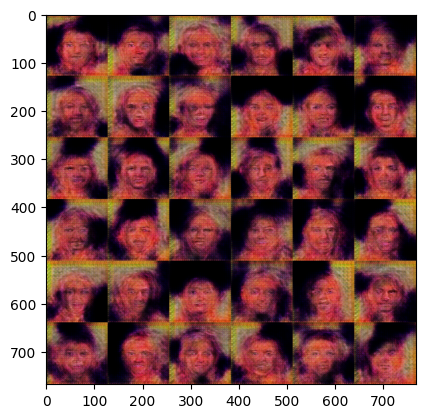

Training Progress:  47%|████▋     | 7000/15000 [37:31<58:24,  2.28step/s]

****************************************************************************************************
1/1 [==============================] - 0s 16ms/step


Training Progress:  47%|████▋     | 7001/15000 [37:31<53:29,  2.49step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  47%|████▋     | 7002/15000 [37:32<49:51,  2.67step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  47%|████▋     | 7003/15000 [37:32<48:03,  2.77step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  47%|████▋     | 7004/15000 [37:32<47:33,  2.80step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  47%|████▋     | 7005/15000 [37:33<45:39,  2.92step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  47%|████▋     | 7006/15000 [37:33<44:19,  3.01step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  47%|████▋     | 7007/15000 [37:33<43:28,  3.06step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  47%|████▋     | 7008/15000 [37:34<42:48,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  47%|████▋     | 7009/15000 [37:34<42:19,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  47%|████▋     | 7010/15000 [37:34<42:03,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  47%|████▋     | 7011/15000 [37:35<41:47,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  47%|████▋     | 7012/15000 [37:35<41:37,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  47%|████▋     | 7013/15000 [37:35<41:43,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  47%|████▋     | 7014/15000 [37:36<41:37,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  47%|████▋     | 7015/15000 [37:36<41:30,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  47%|████▋     | 7016/15000 [37:36<41:25,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  47%|████▋     | 7017/15000 [37:36<41:18,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  47%|████▋     | 7018/15000 [37:37<41:12,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  47%|████▋     | 7019/15000 [37:37<41:15,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  47%|████▋     | 7020/15000 [37:37<41:19,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  47%|████▋     | 7021/15000 [37:38<41:15,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  47%|████▋     | 7022/15000 [37:38<41:26,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  47%|████▋     | 7023/15000 [37:38<41:23,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  47%|████▋     | 7024/15000 [37:39<41:22,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  47%|████▋     | 7025/15000 [37:39<41:19,  3.22step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  47%|████▋     | 7026/15000 [37:39<41:39,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  47%|████▋     | 7027/15000 [37:40<41:29,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  47%|████▋     | 7028/15000 [37:40<41:21,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  47%|████▋     | 7029/15000 [37:40<41:16,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  47%|████▋     | 7030/15000 [37:41<41:09,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  47%|████▋     | 7031/15000 [37:41<41:20,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  47%|████▋     | 7032/15000 [37:41<41:18,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  47%|████▋     | 7033/15000 [37:41<41:16,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  47%|████▋     | 7034/15000 [37:42<41:13,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  47%|████▋     | 7035/15000 [37:42<42:37,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  47%|████▋     | 7036/15000 [37:42<43:42,  3.04step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  47%|████▋     | 7037/15000 [37:43<42:59,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  47%|████▋     | 7038/15000 [37:43<42:27,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  47%|████▋     | 7039/15000 [37:43<42:01,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  47%|████▋     | 7040/15000 [37:44<41:57,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  47%|████▋     | 7041/15000 [37:44<41:48,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  47%|████▋     | 7042/15000 [37:44<41:37,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  47%|████▋     | 7043/15000 [37:45<41:27,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  47%|████▋     | 7044/15000 [37:45<41:20,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  47%|████▋     | 7045/15000 [37:45<41:18,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  47%|████▋     | 7046/15000 [37:46<41:10,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  47%|████▋     | 7047/15000 [37:46<41:05,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  47%|████▋     | 7048/15000 [37:46<41:05,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  47%|████▋     | 7049/15000 [37:47<42:33,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  47%|████▋     | 7050/15000 [37:47<42:19,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  47%|████▋     | 7051/15000 [37:47<42:03,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  47%|████▋     | 7052/15000 [37:47<41:43,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  47%|████▋     | 7053/15000 [37:48<41:36,  3.18step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  47%|████▋     | 7054/15000 [37:48<41:35,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  47%|████▋     | 7055/15000 [37:48<41:31,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  47%|████▋     | 7056/15000 [37:49<41:17,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  47%|████▋     | 7057/15000 [37:49<41:10,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  47%|████▋     | 7058/15000 [37:49<41:09,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  47%|████▋     | 7059/15000 [37:50<41:21,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  47%|████▋     | 7060/15000 [37:50<41:14,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  47%|████▋     | 7061/15000 [37:50<41:15,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  47%|████▋     | 7062/15000 [37:51<41:10,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  47%|████▋     | 7063/15000 [37:51<41:10,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  47%|████▋     | 7064/15000 [37:51<41:02,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  47%|████▋     | 7065/15000 [37:52<41:04,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  47%|████▋     | 7066/15000 [37:52<41:01,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  47%|████▋     | 7067/15000 [37:52<41:00,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  47%|████▋     | 7068/15000 [37:52<41:35,  3.18step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  47%|████▋     | 7069/15000 [37:53<41:29,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  47%|████▋     | 7070/15000 [37:53<41:19,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  47%|████▋     | 7071/15000 [37:53<41:11,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  47%|████▋     | 7072/15000 [37:54<41:06,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  47%|████▋     | 7073/15000 [37:54<41:02,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  47%|████▋     | 7074/15000 [37:54<41:01,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  47%|████▋     | 7075/15000 [37:55<40:51,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  47%|████▋     | 7076/15000 [37:55<40:44,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  47%|████▋     | 7077/15000 [37:55<40:55,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  47%|████▋     | 7078/15000 [37:56<40:50,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  47%|████▋     | 7079/15000 [37:56<40:47,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  47%|████▋     | 7080/15000 [37:56<40:40,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  47%|████▋     | 7081/15000 [37:56<40:40,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  47%|████▋     | 7082/15000 [37:57<40:34,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  47%|████▋     | 7083/15000 [37:57<40:36,  3.25step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  47%|████▋     | 7084/15000 [37:57<40:35,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  47%|████▋     | 7085/15000 [37:58<40:33,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  47%|████▋     | 7086/15000 [37:58<40:31,  3.26step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  47%|████▋     | 7087/15000 [37:58<40:52,  3.23step/s]

1/1 [==============================] - 0s 30ms/step


Training Progress:  47%|████▋     | 7088/15000 [37:59<43:30,  3.03step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  47%|████▋     | 7089/15000 [37:59<48:27,  2.72step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  47%|████▋     | 7090/15000 [38:00<51:43,  2.55step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  47%|████▋     | 7091/15000 [38:00<48:50,  2.70step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  47%|████▋     | 7092/15000 [38:00<46:19,  2.84step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  47%|████▋     | 7093/15000 [38:01<44:35,  2.96step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  47%|████▋     | 7094/15000 [38:01<43:18,  3.04step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  47%|████▋     | 7095/15000 [38:01<42:25,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  47%|████▋     | 7096/15000 [38:01<42:03,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  47%|████▋     | 7097/15000 [38:02<41:34,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  47%|████▋     | 7098/15000 [38:02<41:14,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  47%|████▋     | 7099/15000 [38:02<42:23,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  47%|████▋     | 7100/15000 [38:03<43:12,  3.05step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  47%|████▋     | 7101/15000 [38:03<42:22,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  47%|████▋     | 7102/15000 [38:03<42:06,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  47%|████▋     | 7103/15000 [38:04<41:55,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  47%|████▋     | 7104/15000 [38:04<41:34,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  47%|████▋     | 7105/15000 [38:04<41:34,  3.17step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  47%|████▋     | 7106/15000 [38:05<41:22,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  47%|████▋     | 7107/15000 [38:05<42:42,  3.08step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  47%|████▋     | 7108/15000 [38:05<42:20,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  47%|████▋     | 7109/15000 [38:06<41:56,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  47%|████▋     | 7110/15000 [38:06<41:36,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  47%|████▋     | 7111/15000 [38:06<42:50,  3.07step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  47%|████▋     | 7112/15000 [38:07<43:36,  3.01step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  47%|████▋     | 7113/15000 [38:07<42:51,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  47%|████▋     | 7114/15000 [38:07<42:26,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  47%|████▋     | 7115/15000 [38:08<41:54,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  47%|████▋     | 7116/15000 [38:08<41:29,  3.17step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  47%|████▋     | 7117/15000 [38:08<41:17,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  47%|████▋     | 7118/15000 [38:09<42:35,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  47%|████▋     | 7119/15000 [38:09<42:00,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  47%|████▋     | 7120/15000 [38:09<41:37,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  47%|████▋     | 7121/15000 [38:09<41:21,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  47%|████▋     | 7122/15000 [38:10<41:05,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  47%|████▋     | 7123/15000 [38:10<43:48,  3.00step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  47%|████▋     | 7124/15000 [38:10<43:13,  3.04step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  48%|████▊     | 7125/15000 [38:11<42:29,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  48%|████▊     | 7126/15000 [38:11<41:57,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7127/15000 [38:11<41:36,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7128/15000 [38:12<41:13,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7129/15000 [38:12<40:57,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  48%|████▊     | 7130/15000 [38:12<42:46,  3.07step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7131/15000 [38:13<42:06,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7132/15000 [38:13<41:37,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  48%|████▊     | 7133/15000 [38:13<41:33,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7134/15000 [38:14<41:16,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  48%|████▊     | 7135/15000 [38:14<41:02,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7136/15000 [38:14<40:53,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  48%|████▊     | 7137/15000 [38:15<40:48,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7138/15000 [38:15<40:43,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7139/15000 [38:15<40:39,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7140/15000 [38:15<40:31,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7141/15000 [38:16<40:23,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  48%|████▊     | 7142/15000 [38:16<40:37,  3.22step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  48%|████▊     | 7143/15000 [38:16<40:40,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  48%|████▊     | 7144/15000 [38:17<40:40,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  48%|████▊     | 7145/15000 [38:17<40:35,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  48%|████▊     | 7146/15000 [38:17<40:42,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7147/15000 [38:18<40:42,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  48%|████▊     | 7148/15000 [38:18<40:43,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  48%|████▊     | 7149/15000 [38:18<40:38,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7150/15000 [38:19<40:37,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  48%|████▊     | 7151/15000 [38:19<40:49,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  48%|████▊     | 7152/15000 [38:19<40:45,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  48%|████▊     | 7153/15000 [38:20<40:47,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  48%|████▊     | 7154/15000 [38:20<42:04,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7155/15000 [38:20<41:30,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7156/15000 [38:20<41:13,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  48%|████▊     | 7157/15000 [38:21<40:57,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7158/15000 [38:21<40:47,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  48%|████▊     | 7159/15000 [38:21<40:41,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7160/15000 [38:22<40:35,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  48%|████▊     | 7161/15000 [38:22<40:37,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  48%|████▊     | 7162/15000 [38:22<42:25,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7163/15000 [38:23<41:40,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7164/15000 [38:23<41:19,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7165/15000 [38:23<40:51,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7166/15000 [38:24<40:44,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7167/15000 [38:24<40:31,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7168/15000 [38:24<40:26,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7169/15000 [38:25<40:17,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7170/15000 [38:25<40:21,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  48%|████▊     | 7171/15000 [38:25<40:17,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7172/15000 [38:25<40:17,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7173/15000 [38:26<41:34,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7174/15000 [38:26<41:03,  3.18step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  48%|████▊     | 7175/15000 [38:26<40:45,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7176/15000 [38:27<40:27,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7177/15000 [38:27<40:12,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7178/15000 [38:27<40:08,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7179/15000 [38:28<40:12,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7180/15000 [38:28<40:06,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7181/15000 [38:28<40:02,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7182/15000 [38:29<41:29,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7183/15000 [38:29<42:23,  3.07step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7184/15000 [38:29<41:36,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  48%|████▊     | 7185/15000 [38:30<41:06,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7186/15000 [38:30<40:45,  3.20step/s]

1/1 [==============================] - 0s 32ms/step


Training Progress:  48%|████▊     | 7187/15000 [38:30<44:49,  2.90step/s]

1/1 [==============================] - 0s 29ms/step


Training Progress:  48%|████▊     | 7188/15000 [38:31<49:18,  2.64step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  48%|████▊     | 7189/15000 [38:31<49:14,  2.64step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  48%|████▊     | 7190/15000 [38:31<48:17,  2.70step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7191/15000 [38:32<45:44,  2.85step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7192/15000 [38:32<44:09,  2.95step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  48%|████▊     | 7193/15000 [38:32<43:16,  3.01step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7194/15000 [38:33<42:10,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7195/15000 [38:33<41:26,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  48%|████▊     | 7196/15000 [38:33<40:53,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7197/15000 [38:34<40:32,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  48%|████▊     | 7198/15000 [38:34<40:33,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  48%|████▊     | 7199/15000 [38:34<41:51,  3.11step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  48%|████▊     | 7200/15000 [38:35<41:17,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  48%|████▊     | 7201/15000 [38:35<40:59,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  48%|████▊     | 7202/15000 [38:35<40:40,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7203/15000 [38:36<40:21,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7204/15000 [38:36<40:06,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7205/15000 [38:36<41:24,  3.14step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  48%|████▊     | 7206/15000 [38:36<40:55,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7207/15000 [38:37<40:44,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7208/15000 [38:37<40:23,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  48%|████▊     | 7209/15000 [38:37<40:11,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7210/15000 [38:38<39:58,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7211/15000 [38:38<39:48,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7212/15000 [38:38<39:44,  3.27step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  48%|████▊     | 7213/15000 [38:39<39:49,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7214/15000 [38:39<39:50,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7215/15000 [38:39<39:42,  3.27step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7216/15000 [38:40<39:58,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  48%|████▊     | 7217/15000 [38:40<39:53,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  48%|████▊     | 7218/15000 [38:40<39:54,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7219/15000 [38:41<41:17,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7220/15000 [38:41<40:54,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7221/15000 [38:41<40:33,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7222/15000 [38:41<40:19,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7223/15000 [38:42<40:04,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  48%|████▊     | 7224/15000 [38:42<40:08,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  48%|████▊     | 7225/15000 [38:42<40:28,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7226/15000 [38:43<40:20,  3.21step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  48%|████▊     | 7227/15000 [38:43<40:38,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7228/15000 [38:43<40:25,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7229/15000 [38:44<40:24,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7230/15000 [38:44<40:11,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7231/15000 [38:44<40:00,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7232/15000 [38:45<40:04,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7233/15000 [38:45<39:56,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7234/15000 [38:45<39:52,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  48%|████▊     | 7235/15000 [38:45<41:27,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  48%|████▊     | 7236/15000 [38:46<40:59,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7237/15000 [38:46<40:36,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7238/15000 [38:46<40:18,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7239/15000 [38:47<40:04,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7240/15000 [38:47<39:59,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  48%|████▊     | 7241/15000 [38:47<39:50,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7242/15000 [38:48<39:48,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7243/15000 [38:48<39:43,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7244/15000 [38:48<39:57,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  48%|████▊     | 7245/15000 [38:49<39:55,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  48%|████▊     | 7246/15000 [38:49<39:58,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7247/15000 [38:49<41:14,  3.13step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  48%|████▊     | 7248/15000 [38:50<40:57,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7249/15000 [38:50<40:30,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7250/15000 [38:50<40:17,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7251/15000 [38:50<40:05,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  48%|████▊     | 7252/15000 [38:51<40:03,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  48%|████▊     | 7253/15000 [38:51<40:07,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  48%|████▊     | 7254/15000 [38:51<40:06,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  48%|████▊     | 7255/15000 [38:52<40:00,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7256/15000 [38:52<40:10,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7257/15000 [38:52<39:58,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7258/15000 [38:53<40:14,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7259/15000 [38:53<39:58,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7260/15000 [38:53<39:53,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  48%|████▊     | 7261/15000 [38:54<39:55,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  48%|████▊     | 7262/15000 [38:54<41:25,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  48%|████▊     | 7263/15000 [38:54<42:15,  3.05step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7264/15000 [38:55<41:34,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7265/15000 [38:55<40:57,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7266/15000 [38:55<40:32,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7267/15000 [38:55<40:13,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7268/15000 [38:56<40:04,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  48%|████▊     | 7269/15000 [38:56<39:50,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7270/15000 [38:56<41:07,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  48%|████▊     | 7271/15000 [38:57<40:34,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  48%|████▊     | 7272/15000 [38:57<40:27,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  48%|████▊     | 7273/15000 [38:57<40:14,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7274/15000 [38:58<39:56,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  48%|████▊     | 7275/15000 [38:58<39:43,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▊     | 7276/15000 [38:58<39:34,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▊     | 7277/15000 [38:59<39:34,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▊     | 7278/15000 [38:59<39:28,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▊     | 7279/15000 [38:59<39:24,  3.27step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  49%|████▊     | 7280/15000 [39:00<39:34,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  49%|████▊     | 7281/15000 [39:00<39:42,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  49%|████▊     | 7282/15000 [39:00<39:41,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  49%|████▊     | 7283/15000 [39:00<39:36,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  49%|████▊     | 7284/15000 [39:01<39:31,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▊     | 7285/15000 [39:01<39:26,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▊     | 7286/15000 [39:01<40:57,  3.14step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  49%|████▊     | 7287/15000 [39:02<43:16,  2.97step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  49%|████▊     | 7288/15000 [39:02<47:37,  2.70step/s]

1/1 [==============================] - 0s 38ms/step


Training Progress:  49%|████▊     | 7289/15000 [39:03<49:42,  2.59step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  49%|████▊     | 7290/15000 [39:03<46:57,  2.74step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  49%|████▊     | 7291/15000 [39:03<44:41,  2.87step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  49%|████▊     | 7292/15000 [39:04<43:15,  2.97step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▊     | 7293/15000 [39:04<43:26,  2.96step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▊     | 7294/15000 [39:04<42:08,  3.05step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▊     | 7295/15000 [39:05<41:21,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▊     | 7296/15000 [39:05<40:41,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▊     | 7297/15000 [39:05<40:12,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▊     | 7298/15000 [39:05<39:52,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  49%|████▊     | 7299/15000 [39:06<39:57,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  49%|████▊     | 7300/15000 [39:06<41:13,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  49%|████▊     | 7301/15000 [39:06<40:42,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▊     | 7302/15000 [39:07<40:20,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▊     | 7303/15000 [39:07<40:01,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▊     | 7304/15000 [39:07<39:46,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▊     | 7305/15000 [39:08<39:34,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  49%|████▊     | 7306/15000 [39:08<39:30,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▊     | 7307/15000 [39:08<39:23,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▊     | 7308/15000 [39:09<39:33,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▊     | 7309/15000 [39:09<39:36,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▊     | 7310/15000 [39:09<40:52,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▊     | 7311/15000 [39:10<40:22,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  49%|████▊     | 7312/15000 [39:10<40:04,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▉     | 7313/15000 [39:10<39:45,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▉     | 7314/15000 [39:10<39:30,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▉     | 7315/15000 [39:11<39:21,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▉     | 7316/15000 [39:11<39:11,  3.27step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  49%|████▉     | 7317/15000 [39:11<39:11,  3.27step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  49%|████▉     | 7318/15000 [39:12<39:21,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  49%|████▉     | 7319/15000 [39:12<39:22,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▉     | 7320/15000 [39:12<41:02,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▉     | 7321/15000 [39:13<40:53,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▉     | 7322/15000 [39:13<40:24,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▉     | 7323/15000 [39:13<40:06,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  49%|████▉     | 7324/15000 [39:14<39:52,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▉     | 7325/15000 [39:14<39:36,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▉     | 7326/15000 [39:14<39:25,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  49%|████▉     | 7327/15000 [39:14<39:31,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▉     | 7328/15000 [39:15<39:27,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▉     | 7329/15000 [39:15<39:20,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▉     | 7330/15000 [39:15<39:15,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▉     | 7331/15000 [39:16<39:14,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▉     | 7332/15000 [39:16<39:10,  3.26step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  49%|████▉     | 7333/15000 [39:16<39:09,  3.26step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  49%|████▉     | 7334/15000 [39:17<39:08,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▉     | 7335/15000 [39:17<39:03,  3.27step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▉     | 7336/15000 [39:17<39:12,  3.26step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  49%|████▉     | 7337/15000 [39:18<39:17,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  49%|████▉     | 7338/15000 [39:18<39:15,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▉     | 7339/15000 [39:18<39:12,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▉     | 7340/15000 [39:18<39:06,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▉     | 7341/15000 [39:19<39:03,  3.27step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▉     | 7342/15000 [39:19<38:59,  3.27step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  49%|████▉     | 7343/15000 [39:19<39:11,  3.26step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  49%|████▉     | 7344/15000 [39:20<39:09,  3.26step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  49%|████▉     | 7345/15000 [39:20<39:21,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▉     | 7346/15000 [39:20<39:27,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  49%|████▉     | 7347/15000 [39:21<40:47,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▉     | 7348/15000 [39:21<40:16,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▉     | 7349/15000 [39:21<39:54,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▉     | 7350/15000 [39:22<39:49,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▉     | 7351/15000 [39:22<39:46,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▉     | 7352/15000 [39:22<39:51,  3.20step/s]

1/1 [==============================] - 0s 29ms/step


Training Progress:  49%|████▉     | 7353/15000 [39:23<41:57,  3.04step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▉     | 7354/15000 [39:23<41:02,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  49%|████▉     | 7355/15000 [39:23<42:18,  3.01step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  49%|████▉     | 7356/15000 [39:24<41:27,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  49%|████▉     | 7357/15000 [39:24<40:48,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▉     | 7358/15000 [39:24<40:14,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▉     | 7359/15000 [39:24<41:16,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▉     | 7360/15000 [39:25<40:35,  3.14step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  49%|████▉     | 7361/15000 [39:25<40:15,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▉     | 7362/15000 [39:25<39:48,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▉     | 7363/15000 [39:26<39:39,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▉     | 7364/15000 [39:26<39:35,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▉     | 7365/15000 [39:26<39:35,  3.21step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  49%|████▉     | 7366/15000 [39:27<39:27,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▉     | 7367/15000 [39:27<39:21,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▉     | 7368/15000 [39:27<39:08,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▉     | 7369/15000 [39:28<39:12,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▉     | 7370/15000 [39:28<39:09,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▉     | 7371/15000 [39:28<39:09,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  49%|████▉     | 7372/15000 [39:28<39:05,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  49%|████▉     | 7373/15000 [39:29<40:45,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▉     | 7374/15000 [39:29<40:12,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▉     | 7375/15000 [39:29<39:53,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▉     | 7376/15000 [39:30<39:32,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▉     | 7377/15000 [39:30<39:25,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  49%|████▉     | 7378/15000 [39:30<39:14,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▉     | 7379/15000 [39:31<39:18,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▉     | 7380/15000 [39:31<39:09,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▉     | 7381/15000 [39:31<39:08,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▉     | 7382/15000 [39:32<38:59,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▉     | 7383/15000 [39:32<39:12,  3.24step/s]

1/1 [==============================] - 0s 27ms/step


Training Progress:  49%|████▉     | 7384/15000 [39:32<40:38,  3.12step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  49%|████▉     | 7385/15000 [39:33<41:27,  3.06step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▉     | 7386/15000 [39:33<40:59,  3.10step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  49%|████▉     | 7387/15000 [39:33<44:54,  2.83step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  49%|████▉     | 7388/15000 [39:34<47:07,  2.69step/s]

1/1 [==============================] - 0s 23ms/step


Training Progress:  49%|████▉     | 7389/15000 [39:34<48:24,  2.62step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  49%|████▉     | 7390/15000 [39:34<45:36,  2.78step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▉     | 7391/15000 [39:35<43:40,  2.90step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  49%|████▉     | 7392/15000 [39:35<42:28,  2.98step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  49%|████▉     | 7393/15000 [39:35<41:25,  3.06step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  49%|████▉     | 7394/15000 [39:36<40:48,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▉     | 7395/15000 [39:36<40:14,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  49%|████▉     | 7396/15000 [39:36<39:56,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▉     | 7397/15000 [39:37<39:47,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  49%|████▉     | 7398/15000 [39:37<39:29,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▉     | 7399/15000 [39:37<39:22,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▉     | 7400/15000 [39:38<39:11,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▉     | 7401/15000 [39:38<39:21,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  49%|████▉     | 7402/15000 [39:38<40:40,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  49%|████▉     | 7403/15000 [39:39<41:33,  3.05step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▉     | 7404/15000 [39:39<42:08,  3.00step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▉     | 7405/15000 [39:39<41:10,  3.07step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▉     | 7406/15000 [39:40<40:31,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  49%|████▉     | 7407/15000 [39:40<40:02,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▉     | 7408/15000 [39:40<39:41,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▉     | 7409/15000 [39:40<39:26,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▉     | 7410/15000 [39:41<39:29,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  49%|████▉     | 7411/15000 [39:41<39:20,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  49%|████▉     | 7412/15000 [39:41<39:13,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▉     | 7413/15000 [39:42<39:07,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▉     | 7414/15000 [39:42<39:01,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▉     | 7415/15000 [39:42<40:13,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▉     | 7416/15000 [39:43<39:48,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  49%|████▉     | 7417/15000 [39:43<39:35,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▉     | 7418/15000 [39:43<39:23,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  49%|████▉     | 7419/15000 [39:44<39:13,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  49%|████▉     | 7420/15000 [39:44<39:19,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  49%|████▉     | 7421/15000 [39:44<39:11,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  49%|████▉     | 7422/15000 [39:44<39:05,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  49%|████▉     | 7423/15000 [39:45<38:58,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  49%|████▉     | 7424/15000 [39:45<39:00,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|████▉     | 7425/15000 [39:45<39:03,  3.23step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  50%|████▉     | 7426/15000 [39:46<39:04,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  50%|████▉     | 7427/15000 [39:46<39:03,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  50%|████▉     | 7428/15000 [39:46<38:56,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|████▉     | 7429/15000 [39:47<39:05,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|████▉     | 7430/15000 [39:47<39:03,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  50%|████▉     | 7431/15000 [39:47<38:57,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|████▉     | 7432/15000 [39:48<38:53,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|████▉     | 7433/15000 [39:48<39:05,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  50%|████▉     | 7434/15000 [39:48<39:02,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  50%|████▉     | 7435/15000 [39:49<38:58,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  50%|████▉     | 7436/15000 [39:49<39:12,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|████▉     | 7437/15000 [39:49<39:09,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  50%|████▉     | 7438/15000 [39:49<39:19,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|████▉     | 7439/15000 [39:50<39:18,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  50%|████▉     | 7440/15000 [39:50<39:27,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|████▉     | 7441/15000 [39:50<39:21,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|████▉     | 7442/15000 [39:51<40:40,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  50%|████▉     | 7443/15000 [39:51<40:05,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  50%|████▉     | 7444/15000 [39:51<39:44,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|████▉     | 7445/15000 [39:52<39:31,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|████▉     | 7446/15000 [39:52<40:44,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|████▉     | 7447/15000 [39:52<40:37,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|████▉     | 7448/15000 [39:53<40:12,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|████▉     | 7449/15000 [39:53<39:57,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|████▉     | 7450/15000 [39:53<39:46,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  50%|████▉     | 7451/15000 [39:54<39:29,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  50%|████▉     | 7452/15000 [39:54<40:46,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  50%|████▉     | 7453/15000 [39:54<40:09,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  50%|████▉     | 7454/15000 [39:55<39:43,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  50%|████▉     | 7455/15000 [39:55<39:25,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  50%|████▉     | 7456/15000 [39:55<39:17,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|████▉     | 7457/15000 [39:56<40:41,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  50%|████▉     | 7458/15000 [39:56<40:11,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  50%|████▉     | 7459/15000 [39:56<41:06,  3.06step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|████▉     | 7460/15000 [39:56<40:27,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  50%|████▉     | 7461/15000 [39:57<39:55,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|████▉     | 7462/15000 [39:57<39:36,  3.17step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  50%|████▉     | 7463/15000 [39:57<39:20,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  50%|████▉     | 7464/15000 [39:58<39:12,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  50%|████▉     | 7465/15000 [39:58<38:59,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|████▉     | 7466/15000 [39:58<39:11,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|████▉     | 7467/15000 [39:59<39:02,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|████▉     | 7468/15000 [39:59<39:03,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  50%|████▉     | 7469/15000 [39:59<38:57,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|████▉     | 7470/15000 [40:00<39:02,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|████▉     | 7471/15000 [40:00<38:54,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  50%|████▉     | 7472/15000 [40:00<40:13,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  50%|████▉     | 7473/15000 [40:01<41:00,  3.06step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  50%|████▉     | 7474/15000 [40:01<40:18,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|████▉     | 7475/15000 [40:01<39:54,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|████▉     | 7476/15000 [40:02<39:39,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|████▉     | 7477/15000 [40:02<39:27,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  50%|████▉     | 7478/15000 [40:02<39:17,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|████▉     | 7479/15000 [40:02<39:18,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|████▉     | 7480/15000 [40:03<39:32,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  50%|████▉     | 7481/15000 [40:03<39:15,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  50%|████▉     | 7482/15000 [40:03<39:09,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  50%|████▉     | 7483/15000 [40:04<38:56,  3.22step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  50%|████▉     | 7484/15000 [40:04<39:16,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  50%|████▉     | 7485/15000 [40:04<40:39,  3.08step/s]

1/1 [==============================] - 0s 27ms/step


Training Progress:  50%|████▉     | 7486/15000 [40:05<43:11,  2.90step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  50%|████▉     | 7487/15000 [40:05<47:02,  2.66step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  50%|████▉     | 7488/15000 [40:06<47:10,  2.65step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  50%|████▉     | 7489/15000 [40:06<44:36,  2.81step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|████▉     | 7490/15000 [40:06<42:48,  2.92step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|████▉     | 7491/15000 [40:07<41:35,  3.01step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  50%|████▉     | 7492/15000 [40:07<42:15,  2.96step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|████▉     | 7493/15000 [40:07<41:10,  3.04step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  50%|████▉     | 7494/15000 [40:07<40:45,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|████▉     | 7495/15000 [40:08<40:07,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|████▉     | 7496/15000 [40:08<39:43,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|████▉     | 7497/15000 [40:08<39:25,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  50%|████▉     | 7498/15000 [40:09<39:14,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|████▉     | 7499/15000 [40:09<39:00,  3.20step/s]

1/1 [==============================] - 0s 16ms/step
****************************************************************************************************
7500/15000: d_loss: 0.120711,  g_loss: 0.006868
2/2 [==============================] - 0s 20ms/step


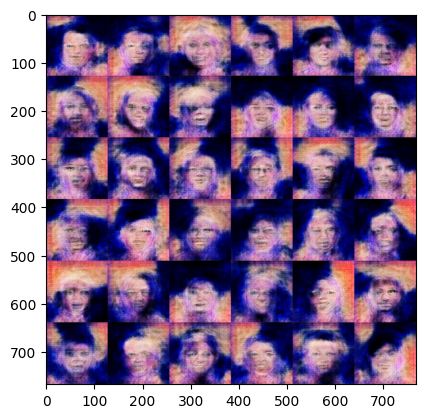

Training Progress:  50%|█████     | 7500/15000 [40:10<56:02,  2.23step/s]

****************************************************************************************************
1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|█████     | 7501/15000 [40:10<51:07,  2.44step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  50%|█████     | 7502/15000 [40:10<47:30,  2.63step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|█████     | 7503/15000 [40:11<44:47,  2.79step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|█████     | 7504/15000 [40:11<42:58,  2.91step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  50%|█████     | 7505/15000 [40:11<41:41,  3.00step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|█████     | 7506/15000 [40:12<41:04,  3.04step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|█████     | 7507/15000 [40:12<40:24,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  50%|█████     | 7508/15000 [40:12<41:28,  3.01step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|█████     | 7509/15000 [40:13<40:34,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  50%|█████     | 7510/15000 [40:13<41:29,  3.01step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  50%|█████     | 7511/15000 [40:13<40:32,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  50%|█████     | 7512/15000 [40:14<39:58,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|█████     | 7513/15000 [40:14<39:27,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  50%|█████     | 7514/15000 [40:14<40:36,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|█████     | 7515/15000 [40:15<40:11,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|█████     | 7516/15000 [40:15<39:44,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|█████     | 7517/15000 [40:15<39:21,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  50%|█████     | 7518/15000 [40:16<39:05,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|█████     | 7519/15000 [40:16<40:14,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  50%|█████     | 7520/15000 [40:16<39:40,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|█████     | 7521/15000 [40:16<39:16,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|█████     | 7522/15000 [40:17<39:04,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  50%|█████     | 7523/15000 [40:17<38:49,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  50%|█████     | 7524/15000 [40:17<38:44,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|█████     | 7525/15000 [40:18<38:52,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|█████     | 7526/15000 [40:18<38:50,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|█████     | 7527/15000 [40:18<38:40,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|█████     | 7528/15000 [40:19<38:42,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  50%|█████     | 7529/15000 [40:19<38:43,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  50%|█████     | 7530/15000 [40:19<38:43,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|█████     | 7531/15000 [40:20<38:39,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  50%|█████     | 7532/15000 [40:20<38:37,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  50%|█████     | 7533/15000 [40:20<38:34,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|█████     | 7534/15000 [40:21<38:47,  3.21step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  50%|█████     | 7535/15000 [40:21<38:52,  3.20step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  50%|█████     | 7536/15000 [40:21<39:06,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|█████     | 7537/15000 [40:21<39:01,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  50%|█████     | 7538/15000 [40:22<38:53,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  50%|█████     | 7539/15000 [40:22<38:42,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|█████     | 7540/15000 [40:22<40:07,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|█████     | 7541/15000 [40:23<39:34,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|█████     | 7542/15000 [40:23<39:15,  3.17step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  50%|█████     | 7543/15000 [40:23<39:12,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|█████     | 7544/15000 [40:24<39:04,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|█████     | 7545/15000 [40:24<38:52,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  50%|█████     | 7546/15000 [40:24<38:53,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|█████     | 7547/15000 [40:25<38:47,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|█████     | 7548/15000 [40:25<40:15,  3.09step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  50%|█████     | 7549/15000 [40:25<39:46,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|█████     | 7550/15000 [40:26<39:23,  3.15step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  50%|█████     | 7551/15000 [40:26<39:09,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|█████     | 7552/15000 [40:26<40:33,  3.06step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|█████     | 7553/15000 [40:27<39:54,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|█████     | 7554/15000 [40:27<40:59,  3.03step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|█████     | 7555/15000 [40:27<40:12,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|█████     | 7556/15000 [40:28<39:40,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|█████     | 7557/15000 [40:28<39:12,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  50%|█████     | 7558/15000 [40:28<38:56,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|█████     | 7559/15000 [40:28<38:46,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  50%|█████     | 7560/15000 [40:29<38:38,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  50%|█████     | 7561/15000 [40:29<38:25,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  50%|█████     | 7562/15000 [40:29<38:34,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|█████     | 7563/15000 [40:30<38:31,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|█████     | 7564/15000 [40:30<38:33,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|█████     | 7565/15000 [40:30<38:28,  3.22step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  50%|█████     | 7566/15000 [40:31<38:53,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  50%|█████     | 7567/15000 [40:31<38:41,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|█████     | 7568/15000 [40:31<38:36,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|█████     | 7569/15000 [40:32<39:49,  3.11step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  50%|█████     | 7570/15000 [40:32<39:27,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|█████     | 7571/15000 [40:32<40:17,  3.07step/s]

1/1 [==============================] - 0s 35ms/step


Training Progress:  50%|█████     | 7572/15000 [40:33<41:19,  3.00step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  50%|█████     | 7573/15000 [40:33<40:33,  3.05step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  50%|█████     | 7574/15000 [40:33<39:54,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  50%|█████     | 7575/15000 [40:34<39:23,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  51%|█████     | 7576/15000 [40:34<39:02,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  51%|█████     | 7577/15000 [40:34<40:00,  3.09step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  51%|█████     | 7578/15000 [40:34<39:29,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  51%|█████     | 7579/15000 [40:35<39:05,  3.16step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  51%|█████     | 7580/15000 [40:35<39:11,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  51%|█████     | 7581/15000 [40:35<38:57,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  51%|█████     | 7582/15000 [40:36<41:32,  2.98step/s]

1/1 [==============================] - 0s 27ms/step


Training Progress:  51%|█████     | 7583/15000 [40:36<44:21,  2.79step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  51%|█████     | 7584/15000 [40:37<46:22,  2.66step/s]

1/1 [==============================] - 0s 27ms/step


Training Progress:  51%|█████     | 7585/15000 [40:37<46:24,  2.66step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  51%|█████     | 7586/15000 [40:37<43:54,  2.81step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  51%|█████     | 7587/15000 [40:38<42:10,  2.93step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  51%|█████     | 7588/15000 [40:38<41:02,  3.01step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  51%|█████     | 7589/15000 [40:38<40:20,  3.06step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  51%|█████     | 7590/15000 [40:39<39:54,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  51%|█████     | 7591/15000 [40:39<39:24,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  51%|█████     | 7592/15000 [40:39<39:02,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  51%|█████     | 7593/15000 [40:39<38:42,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  51%|█████     | 7594/15000 [40:40<38:32,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  51%|█████     | 7595/15000 [40:40<38:28,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  51%|█████     | 7596/15000 [40:40<38:21,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  51%|█████     | 7597/15000 [40:41<38:15,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  51%|█████     | 7598/15000 [40:41<38:13,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  51%|█████     | 7599/15000 [40:41<38:21,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  51%|█████     | 7600/15000 [40:42<38:22,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  51%|█████     | 7601/15000 [40:42<39:42,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  51%|█████     | 7602/15000 [40:42<39:17,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  51%|█████     | 7603/15000 [40:43<39:02,  3.16step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  51%|█████     | 7604/15000 [40:43<38:54,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  51%|█████     | 7605/15000 [40:43<38:37,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  51%|█████     | 7606/15000 [40:44<38:30,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  51%|█████     | 7607/15000 [40:44<38:21,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  51%|█████     | 7608/15000 [40:44<38:29,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  51%|█████     | 7609/15000 [40:44<38:20,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  51%|█████     | 7610/15000 [40:45<38:15,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  51%|█████     | 7611/15000 [40:45<38:06,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  51%|█████     | 7612/15000 [40:45<38:05,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  51%|█████     | 7613/15000 [40:46<37:58,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  51%|█████     | 7614/15000 [40:46<39:17,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  51%|█████     | 7615/15000 [40:46<38:56,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  51%|█████     | 7616/15000 [40:47<38:36,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  51%|█████     | 7617/15000 [40:47<38:32,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  51%|█████     | 7618/15000 [40:47<38:20,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  51%|█████     | 7619/15000 [40:48<38:09,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  51%|█████     | 7620/15000 [40:48<38:05,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  51%|█████     | 7621/15000 [40:48<37:59,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  51%|█████     | 7622/15000 [40:49<37:54,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  51%|█████     | 7623/15000 [40:49<37:54,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  51%|█████     | 7624/15000 [40:49<37:47,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  51%|█████     | 7625/15000 [40:49<37:46,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  51%|█████     | 7626/15000 [40:50<37:59,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  51%|█████     | 7627/15000 [40:50<37:56,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  51%|█████     | 7628/15000 [40:50<37:56,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  51%|█████     | 7629/15000 [40:51<39:15,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  51%|█████     | 7630/15000 [40:51<38:53,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  51%|█████     | 7631/15000 [40:51<38:43,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  51%|█████     | 7632/15000 [40:52<38:22,  3.20step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  51%|█████     | 7633/15000 [40:52<38:35,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  51%|█████     | 7634/15000 [40:52<39:39,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  51%|█████     | 7635/15000 [40:53<39:46,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  51%|█████     | 7636/15000 [40:53<39:24,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  51%|█████     | 7637/15000 [40:53<39:00,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  51%|█████     | 7638/15000 [40:54<38:37,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  51%|█████     | 7639/15000 [40:54<38:40,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  51%|█████     | 7640/15000 [40:54<38:23,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  51%|█████     | 7641/15000 [40:55<38:08,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  51%|█████     | 7642/15000 [40:55<38:07,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  51%|█████     | 7643/15000 [40:55<38:08,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  51%|█████     | 7644/15000 [40:55<38:02,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  51%|█████     | 7645/15000 [40:56<38:18,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  51%|█████     | 7646/15000 [40:56<38:17,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  51%|█████     | 7647/15000 [40:56<38:13,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  51%|█████     | 7648/15000 [40:57<38:09,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  51%|█████     | 7649/15000 [40:57<38:20,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  51%|█████     | 7650/15000 [40:57<38:11,  3.21step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  51%|█████     | 7651/15000 [40:58<38:14,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  51%|█████     | 7652/15000 [40:58<38:12,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  51%|█████     | 7653/15000 [40:58<39:23,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  51%|█████     | 7654/15000 [40:59<39:07,  3.13step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  51%|█████     | 7655/15000 [40:59<38:58,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  51%|█████     | 7656/15000 [40:59<38:40,  3.16step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  51%|█████     | 7657/15000 [41:00<38:38,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  51%|█████     | 7658/15000 [41:00<38:23,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  51%|█████     | 7659/15000 [41:00<38:12,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  51%|█████     | 7660/15000 [41:00<38:07,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  51%|█████     | 7661/15000 [41:01<38:02,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  51%|█████     | 7662/15000 [41:01<37:56,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  51%|█████     | 7663/15000 [41:01<38:12,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  51%|█████     | 7664/15000 [41:02<38:10,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  51%|█████     | 7665/15000 [41:02<38:12,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  51%|█████     | 7666/15000 [41:02<38:05,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  51%|█████     | 7667/15000 [41:03<38:01,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  51%|█████     | 7668/15000 [41:03<37:58,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  51%|█████     | 7669/15000 [41:03<37:56,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  51%|█████     | 7670/15000 [41:04<37:47,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  51%|█████     | 7671/15000 [41:04<39:07,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  51%|█████     | 7672/15000 [41:04<38:41,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  51%|█████     | 7673/15000 [41:05<38:39,  3.16step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  51%|█████     | 7674/15000 [41:05<39:51,  3.06step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  51%|█████     | 7675/15000 [41:05<39:12,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  51%|█████     | 7676/15000 [41:06<38:41,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  51%|█████     | 7677/15000 [41:06<38:17,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  51%|█████     | 7678/15000 [41:06<38:03,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  51%|█████     | 7679/15000 [41:06<37:55,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  51%|█████     | 7680/15000 [41:07<37:46,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  51%|█████     | 7681/15000 [41:07<39:10,  3.11step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  51%|█████     | 7682/15000 [41:08<42:50,  2.85step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  51%|█████     | 7683/15000 [41:08<46:16,  2.63step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  51%|█████     | 7684/15000 [41:08<47:15,  2.58step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  51%|█████     | 7685/15000 [41:09<44:20,  2.75step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  51%|█████     | 7686/15000 [41:09<42:17,  2.88step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  51%|█████     | 7687/15000 [41:09<40:50,  2.98step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  51%|█████▏    | 7688/15000 [41:10<39:48,  3.06step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  51%|█████▏    | 7689/15000 [41:10<40:28,  3.01step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  51%|█████▏    | 7690/15000 [41:10<39:35,  3.08step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  51%|█████▏    | 7691/15000 [41:11<39:05,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  51%|█████▏    | 7692/15000 [41:11<38:37,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  51%|█████▏    | 7693/15000 [41:11<38:15,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  51%|█████▏    | 7694/15000 [41:11<38:02,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  51%|█████▏    | 7695/15000 [41:12<37:48,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  51%|█████▏    | 7696/15000 [41:12<37:37,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  51%|█████▏    | 7697/15000 [41:12<38:53,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  51%|█████▏    | 7698/15000 [41:13<38:27,  3.16step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  51%|█████▏    | 7699/15000 [41:13<38:30,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  51%|█████▏    | 7700/15000 [41:13<38:35,  3.15step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  51%|█████▏    | 7701/15000 [41:14<49:11,  2.47step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  51%|█████▏    | 7702/15000 [41:14<47:14,  2.57step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  51%|█████▏    | 7703/15000 [41:15<44:30,  2.73step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  51%|█████▏    | 7704/15000 [41:15<42:35,  2.85step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  51%|█████▏    | 7705/15000 [41:15<41:15,  2.95step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  51%|█████▏    | 7706/15000 [41:16<40:21,  3.01step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  51%|█████▏    | 7707/15000 [41:16<39:44,  3.06step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  51%|█████▏    | 7708/15000 [41:16<39:15,  3.10step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  51%|█████▏    | 7709/15000 [41:17<38:58,  3.12step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  51%|█████▏    | 7710/15000 [41:17<39:03,  3.11step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  51%|█████▏    | 7711/15000 [41:17<39:01,  3.11step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  51%|█████▏    | 7712/15000 [41:18<39:01,  3.11step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  51%|█████▏    | 7713/15000 [41:18<38:46,  3.13step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  51%|█████▏    | 7714/15000 [41:18<38:41,  3.14step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  51%|█████▏    | 7715/15000 [41:18<38:38,  3.14step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  51%|█████▏    | 7716/15000 [41:19<38:33,  3.15step/s]

1/1 [==============================] - 0s 23ms/step


Training Progress:  51%|█████▏    | 7717/15000 [41:19<38:31,  3.15step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  51%|█████▏    | 7718/15000 [41:19<38:32,  3.15step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  51%|█████▏    | 7719/15000 [41:20<38:50,  3.12step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  51%|█████▏    | 7720/15000 [41:20<38:42,  3.13step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  51%|█████▏    | 7721/15000 [41:20<38:38,  3.14step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  51%|█████▏    | 7722/15000 [41:21<38:33,  3.15step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  51%|█████▏    | 7723/15000 [41:21<38:31,  3.15step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  51%|█████▏    | 7724/15000 [41:21<38:34,  3.14step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  52%|█████▏    | 7725/15000 [41:22<38:32,  3.15step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  52%|█████▏    | 7726/15000 [41:22<38:32,  3.14step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  52%|█████▏    | 7727/15000 [41:22<40:16,  3.01step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  52%|█████▏    | 7728/15000 [41:23<40:31,  2.99step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  52%|█████▏    | 7729/15000 [41:23<39:54,  3.04step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  52%|█████▏    | 7730/15000 [41:23<40:48,  2.97step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  52%|█████▏    | 7731/15000 [41:24<40:03,  3.02step/s]

1/1 [==============================] - 0s 23ms/step


Training Progress:  52%|█████▏    | 7732/15000 [41:24<39:38,  3.06step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  52%|█████▏    | 7733/15000 [41:24<39:12,  3.09step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  52%|█████▏    | 7734/15000 [41:25<40:13,  3.01step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  52%|█████▏    | 7735/15000 [41:25<39:38,  3.05step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  52%|█████▏    | 7736/15000 [41:25<40:37,  2.98step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  52%|█████▏    | 7737/15000 [41:26<41:29,  2.92step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  52%|█████▏    | 7738/15000 [41:26<40:32,  2.99step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  52%|█████▏    | 7739/15000 [41:26<39:47,  3.04step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  52%|█████▏    | 7740/15000 [41:27<39:18,  3.08step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  52%|█████▏    | 7741/15000 [41:27<38:56,  3.11step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  52%|█████▏    | 7742/15000 [41:27<38:40,  3.13step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  52%|█████▏    | 7743/15000 [41:28<38:29,  3.14step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  52%|█████▏    | 7744/15000 [41:28<39:39,  3.05step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  52%|█████▏    | 7745/15000 [41:28<40:29,  2.99step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  52%|█████▏    | 7746/15000 [41:29<40:00,  3.02step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  52%|█████▏    | 7747/15000 [41:29<39:21,  3.07step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  52%|█████▏    | 7748/15000 [41:29<38:55,  3.10step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  52%|█████▏    | 7749/15000 [41:30<38:40,  3.13step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  52%|█████▏    | 7750/15000 [41:30<38:32,  3.14step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  52%|█████▏    | 7751/15000 [41:30<39:51,  3.03step/s]

1/1 [==============================] - 0s 23ms/step


Training Progress:  52%|█████▏    | 7752/15000 [41:31<39:36,  3.05step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  52%|█████▏    | 7753/15000 [41:31<39:09,  3.08step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  52%|█████▏    | 7754/15000 [41:31<38:55,  3.10step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  52%|█████▏    | 7755/15000 [41:31<38:57,  3.10step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  52%|█████▏    | 7756/15000 [41:32<38:41,  3.12step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  52%|█████▏    | 7757/15000 [41:32<38:42,  3.12step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  52%|█████▏    | 7758/15000 [41:32<39:57,  3.02step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  52%|█████▏    | 7759/15000 [41:33<39:24,  3.06step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  52%|█████▏    | 7760/15000 [41:33<39:07,  3.08step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  52%|█████▏    | 7761/15000 [41:33<38:50,  3.11step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  52%|█████▏    | 7762/15000 [41:34<38:33,  3.13step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  52%|█████▏    | 7763/15000 [41:34<38:47,  3.11step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  52%|█████▏    | 7764/15000 [41:34<38:51,  3.10step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  52%|█████▏    | 7765/15000 [41:35<38:40,  3.12step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  52%|█████▏    | 7766/15000 [41:35<38:41,  3.12step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  52%|█████▏    | 7767/15000 [41:35<38:31,  3.13step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  52%|█████▏    | 7768/15000 [41:36<38:20,  3.14step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  52%|█████▏    | 7769/15000 [41:36<38:12,  3.15step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  52%|█████▏    | 7770/15000 [41:36<38:01,  3.17step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  52%|█████▏    | 7771/15000 [41:37<37:57,  3.17step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  52%|█████▏    | 7772/15000 [41:37<37:55,  3.18step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  52%|█████▏    | 7773/15000 [41:37<37:49,  3.18step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  52%|█████▏    | 7774/15000 [41:38<38:05,  3.16step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  52%|█████▏    | 7775/15000 [41:38<37:59,  3.17step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  52%|█████▏    | 7776/15000 [41:38<37:58,  3.17step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  52%|█████▏    | 7777/15000 [41:39<40:34,  2.97step/s]

1/1 [==============================] - 0s 28ms/step


Training Progress:  52%|█████▏    | 7778/15000 [41:39<44:53,  2.68step/s]

1/1 [==============================] - 0s 29ms/step


Training Progress:  52%|█████▏    | 7779/15000 [41:39<45:08,  2.67step/s]

1/1 [==============================] - 0s 29ms/step


Training Progress:  52%|█████▏    | 7780/15000 [41:40<45:30,  2.64step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  52%|█████▏    | 7781/15000 [41:40<44:24,  2.71step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  52%|█████▏    | 7782/15000 [41:40<42:17,  2.84step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  52%|█████▏    | 7783/15000 [41:41<41:05,  2.93step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  52%|█████▏    | 7784/15000 [41:41<40:07,  3.00step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  52%|█████▏    | 7785/15000 [41:41<39:22,  3.05step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  52%|█████▏    | 7786/15000 [41:42<38:46,  3.10step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  52%|█████▏    | 7787/15000 [41:42<38:25,  3.13step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  52%|█████▏    | 7788/15000 [41:42<38:08,  3.15step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  52%|█████▏    | 7789/15000 [41:43<37:57,  3.17step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  52%|█████▏    | 7790/15000 [41:43<37:49,  3.18step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  52%|█████▏    | 7791/15000 [41:43<38:02,  3.16step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  52%|█████▏    | 7792/15000 [41:44<38:11,  3.15step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  52%|█████▏    | 7793/15000 [41:44<38:00,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  52%|█████▏    | 7794/15000 [41:44<37:51,  3.17step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  52%|█████▏    | 7795/15000 [41:45<37:45,  3.18step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  52%|█████▏    | 7796/15000 [41:45<37:35,  3.19step/s]

1/1 [==============================] - 0s 39ms/step


Training Progress:  52%|█████▏    | 7797/15000 [41:45<38:15,  3.14step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  52%|█████▏    | 7798/15000 [41:45<37:55,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  52%|█████▏    | 7799/15000 [41:46<37:37,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  52%|█████▏    | 7800/15000 [41:46<37:31,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  52%|█████▏    | 7801/15000 [41:46<37:39,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  52%|█████▏    | 7802/15000 [41:47<37:36,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  52%|█████▏    | 7803/15000 [41:47<37:28,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  52%|█████▏    | 7804/15000 [41:47<37:23,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  52%|█████▏    | 7805/15000 [41:48<37:19,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  52%|█████▏    | 7806/15000 [41:48<37:14,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  52%|█████▏    | 7807/15000 [41:48<37:06,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  52%|█████▏    | 7808/15000 [41:49<37:00,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  52%|█████▏    | 7809/15000 [41:49<36:54,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  52%|█████▏    | 7810/15000 [41:49<36:53,  3.25step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  52%|█████▏    | 7811/15000 [41:50<37:13,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  52%|█████▏    | 7812/15000 [41:50<37:09,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  52%|█████▏    | 7813/15000 [41:50<38:35,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  52%|█████▏    | 7814/15000 [41:50<38:04,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  52%|█████▏    | 7815/15000 [41:51<37:43,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  52%|█████▏    | 7816/15000 [41:51<37:24,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  52%|█████▏    | 7817/15000 [41:51<37:14,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  52%|█████▏    | 7818/15000 [41:52<37:05,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  52%|█████▏    | 7819/15000 [41:52<37:17,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  52%|█████▏    | 7820/15000 [41:52<37:24,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  52%|█████▏    | 7821/15000 [41:53<37:13,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  52%|█████▏    | 7822/15000 [41:53<37:10,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  52%|█████▏    | 7823/15000 [41:53<37:11,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  52%|█████▏    | 7824/15000 [41:54<37:08,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  52%|█████▏    | 7825/15000 [41:54<36:59,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  52%|█████▏    | 7826/15000 [41:54<36:54,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  52%|█████▏    | 7827/15000 [41:54<36:49,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  52%|█████▏    | 7828/15000 [41:55<36:46,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  52%|█████▏    | 7829/15000 [41:55<37:00,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  52%|█████▏    | 7830/15000 [41:55<37:33,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  52%|█████▏    | 7831/15000 [41:56<37:23,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  52%|█████▏    | 7832/15000 [41:56<37:17,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  52%|█████▏    | 7833/15000 [41:56<37:07,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  52%|█████▏    | 7834/15000 [41:57<37:02,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  52%|█████▏    | 7835/15000 [41:57<36:59,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  52%|█████▏    | 7836/15000 [41:57<36:56,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  52%|█████▏    | 7837/15000 [41:58<38:23,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  52%|█████▏    | 7838/15000 [41:58<38:05,  3.13step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  52%|█████▏    | 7839/15000 [41:58<37:51,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  52%|█████▏    | 7840/15000 [41:59<37:32,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  52%|█████▏    | 7841/15000 [41:59<37:21,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  52%|█████▏    | 7842/15000 [41:59<37:08,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  52%|█████▏    | 7843/15000 [42:00<37:07,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  52%|█████▏    | 7844/15000 [42:00<36:57,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  52%|█████▏    | 7845/15000 [42:00<36:50,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  52%|█████▏    | 7846/15000 [42:00<36:43,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  52%|█████▏    | 7847/15000 [42:01<36:40,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  52%|█████▏    | 7848/15000 [42:01<36:55,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  52%|█████▏    | 7849/15000 [42:01<36:56,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  52%|█████▏    | 7850/15000 [42:02<36:51,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  52%|█████▏    | 7851/15000 [42:02<38:04,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  52%|█████▏    | 7852/15000 [42:02<37:41,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  52%|█████▏    | 7853/15000 [42:03<37:40,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  52%|█████▏    | 7854/15000 [42:03<37:24,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  52%|█████▏    | 7855/15000 [42:03<37:10,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  52%|█████▏    | 7856/15000 [42:04<36:59,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  52%|█████▏    | 7857/15000 [42:04<37:11,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  52%|█████▏    | 7858/15000 [42:04<38:27,  3.09step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  52%|█████▏    | 7859/15000 [42:05<38:03,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  52%|█████▏    | 7860/15000 [42:05<37:35,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  52%|█████▏    | 7861/15000 [42:05<38:33,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  52%|█████▏    | 7862/15000 [42:05<37:58,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  52%|█████▏    | 7863/15000 [42:06<37:29,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  52%|█████▏    | 7864/15000 [42:06<37:07,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  52%|█████▏    | 7865/15000 [42:06<36:58,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  52%|█████▏    | 7866/15000 [42:07<37:00,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  52%|█████▏    | 7867/15000 [42:07<37:00,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  52%|█████▏    | 7868/15000 [42:07<38:07,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  52%|█████▏    | 7869/15000 [42:08<37:38,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  52%|█████▏    | 7870/15000 [42:08<37:23,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  52%|█████▏    | 7871/15000 [42:08<37:14,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  52%|█████▏    | 7872/15000 [42:09<37:10,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  52%|█████▏    | 7873/15000 [42:09<37:00,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  52%|█████▏    | 7874/15000 [42:09<36:52,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  52%|█████▎    | 7875/15000 [42:10<36:59,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  53%|█████▎    | 7876/15000 [42:10<38:04,  3.12step/s]

1/1 [==============================] - 0s 41ms/step


Training Progress:  53%|█████▎    | 7877/15000 [42:10<41:59,  2.83step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  53%|█████▎    | 7878/15000 [42:11<44:07,  2.69step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  53%|█████▎    | 7879/15000 [42:11<45:37,  2.60step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  53%|█████▎    | 7880/15000 [42:11<43:00,  2.76step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  53%|█████▎    | 7881/15000 [42:12<41:06,  2.89step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  53%|█████▎    | 7882/15000 [42:12<39:52,  2.98step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  53%|█████▎    | 7883/15000 [42:12<39:18,  3.02step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  53%|█████▎    | 7884/15000 [42:13<38:24,  3.09step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  53%|█████▎    | 7885/15000 [42:13<39:08,  3.03step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  53%|█████▎    | 7886/15000 [42:13<38:20,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  53%|█████▎    | 7887/15000 [42:14<37:50,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  53%|█████▎    | 7888/15000 [42:14<37:25,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  53%|█████▎    | 7889/15000 [42:14<37:13,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  53%|█████▎    | 7890/15000 [42:15<36:59,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  53%|█████▎    | 7891/15000 [42:15<36:51,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  53%|█████▎    | 7892/15000 [42:15<36:44,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  53%|█████▎    | 7893/15000 [42:16<38:06,  3.11step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  53%|█████▎    | 7894/15000 [42:16<38:07,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  53%|█████▎    | 7895/15000 [42:16<37:42,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  53%|█████▎    | 7896/15000 [42:16<37:17,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  53%|█████▎    | 7897/15000 [42:17<37:07,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  53%|█████▎    | 7898/15000 [42:17<36:56,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  53%|█████▎    | 7899/15000 [42:17<36:54,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  53%|█████▎    | 7900/15000 [42:18<36:51,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  53%|█████▎    | 7901/15000 [42:18<36:47,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  53%|█████▎    | 7902/15000 [42:18<36:41,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  53%|█████▎    | 7903/15000 [42:19<36:49,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  53%|█████▎    | 7904/15000 [42:19<37:59,  3.11step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  53%|█████▎    | 7905/15000 [42:19<37:42,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  53%|█████▎    | 7906/15000 [42:20<37:19,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  53%|█████▎    | 7907/15000 [42:20<37:17,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  53%|█████▎    | 7908/15000 [42:20<37:04,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  53%|█████▎    | 7909/15000 [42:21<36:56,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  53%|█████▎    | 7910/15000 [42:21<36:54,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  53%|█████▎    | 7911/15000 [42:21<36:57,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  53%|█████▎    | 7912/15000 [42:22<37:08,  3.18step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  53%|█████▎    | 7913/15000 [42:22<37:04,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  53%|█████▎    | 7914/15000 [42:22<36:53,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  53%|█████▎    | 7915/15000 [42:22<36:47,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  53%|█████▎    | 7916/15000 [42:23<36:38,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  53%|█████▎    | 7917/15000 [42:23<36:37,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  53%|█████▎    | 7918/15000 [42:23<36:39,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  53%|█████▎    | 7919/15000 [42:24<36:42,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  53%|█████▎    | 7920/15000 [42:24<36:46,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  53%|█████▎    | 7921/15000 [42:24<36:42,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  53%|█████▎    | 7922/15000 [42:25<36:50,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  53%|█████▎    | 7923/15000 [42:25<36:43,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  53%|█████▎    | 7924/15000 [42:25<36:39,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  53%|█████▎    | 7925/15000 [42:26<36:31,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  53%|█████▎    | 7926/15000 [42:26<37:45,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  53%|█████▎    | 7927/15000 [42:26<37:16,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  53%|█████▎    | 7928/15000 [42:27<37:01,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  53%|█████▎    | 7929/15000 [42:27<36:51,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  53%|█████▎    | 7930/15000 [42:27<37:58,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  53%|█████▎    | 7931/15000 [42:27<37:44,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  53%|█████▎    | 7932/15000 [42:28<37:19,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  53%|█████▎    | 7933/15000 [42:28<37:00,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  53%|█████▎    | 7934/15000 [42:28<36:43,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  53%|█████▎    | 7935/15000 [42:29<36:35,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  53%|█████▎    | 7936/15000 [42:29<36:27,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  53%|█████▎    | 7937/15000 [42:29<36:26,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  53%|█████▎    | 7938/15000 [42:30<36:20,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  53%|█████▎    | 7939/15000 [42:30<37:36,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  53%|█████▎    | 7940/15000 [42:30<38:38,  3.05step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  53%|█████▎    | 7941/15000 [42:31<37:58,  3.10step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  53%|█████▎    | 7942/15000 [42:31<37:31,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  53%|█████▎    | 7943/15000 [42:31<37:11,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  53%|█████▎    | 7944/15000 [42:32<36:53,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  53%|█████▎    | 7945/15000 [42:32<36:41,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  53%|█████▎    | 7946/15000 [42:32<37:07,  3.17step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  53%|█████▎    | 7947/15000 [42:33<38:42,  3.04step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  53%|█████▎    | 7948/15000 [42:33<37:55,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  53%|█████▎    | 7949/15000 [42:33<37:37,  3.12step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  53%|█████▎    | 7950/15000 [42:33<37:20,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  53%|█████▎    | 7951/15000 [42:34<37:09,  3.16step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  53%|█████▎    | 7952/15000 [42:34<37:17,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  53%|█████▎    | 7953/15000 [42:34<37:06,  3.16step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  53%|█████▎    | 7954/15000 [42:35<36:57,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  53%|█████▎    | 7955/15000 [42:35<36:52,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  53%|█████▎    | 7956/15000 [42:35<36:39,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  53%|█████▎    | 7957/15000 [42:36<36:31,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  53%|█████▎    | 7958/15000 [42:36<36:24,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  53%|█████▎    | 7959/15000 [42:36<36:36,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  53%|█████▎    | 7960/15000 [42:37<36:31,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  53%|█████▎    | 7961/15000 [42:37<36:30,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  53%|█████▎    | 7962/15000 [42:37<36:30,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  53%|█████▎    | 7963/15000 [42:38<36:23,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  53%|█████▎    | 7964/15000 [42:38<36:15,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  53%|█████▎    | 7965/15000 [42:38<36:19,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  53%|█████▎    | 7966/15000 [42:38<36:22,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  53%|█████▎    | 7967/15000 [42:39<36:22,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  53%|█████▎    | 7968/15000 [42:39<36:31,  3.21step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  53%|█████▎    | 7969/15000 [42:39<36:38,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  53%|█████▎    | 7970/15000 [42:40<36:35,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  53%|█████▎    | 7971/15000 [42:40<36:28,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  53%|█████▎    | 7972/15000 [42:40<36:23,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  53%|█████▎    | 7973/15000 [42:41<36:19,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  53%|█████▎    | 7974/15000 [42:41<36:13,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  53%|█████▎    | 7975/15000 [42:41<36:10,  3.24step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  53%|█████▎    | 7976/15000 [42:42<38:48,  3.02step/s]

1/1 [==============================] - 0s 23ms/step


Training Progress:  53%|█████▎    | 7977/15000 [42:42<43:17,  2.70step/s]

1/1 [==============================] - 0s 27ms/step


Training Progress:  53%|█████▎    | 7978/15000 [42:42<43:01,  2.72step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  53%|█████▎    | 7979/15000 [42:43<42:52,  2.73step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  53%|█████▎    | 7980/15000 [42:43<40:54,  2.86step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  53%|█████▎    | 7981/15000 [42:43<39:24,  2.97step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  53%|█████▎    | 7982/15000 [42:44<38:18,  3.05step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  53%|█████▎    | 7983/15000 [42:44<37:37,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  53%|█████▎    | 7984/15000 [42:44<37:13,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  53%|█████▎    | 7985/15000 [42:45<36:54,  3.17step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  53%|█████▎    | 7986/15000 [42:45<36:56,  3.16step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  53%|█████▎    | 7987/15000 [42:45<36:51,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  53%|█████▎    | 7988/15000 [42:46<36:42,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  53%|█████▎    | 7989/15000 [42:46<36:33,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  53%|█████▎    | 7990/15000 [42:46<36:25,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  53%|█████▎    | 7991/15000 [42:47<36:21,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  53%|█████▎    | 7992/15000 [42:47<36:22,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  53%|█████▎    | 7993/15000 [42:47<36:20,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  53%|█████▎    | 7994/15000 [42:48<37:35,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  53%|█████▎    | 7995/15000 [42:48<37:07,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  53%|█████▎    | 7996/15000 [42:48<36:58,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  53%|█████▎    | 7997/15000 [42:48<36:44,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  53%|█████▎    | 7998/15000 [42:49<36:29,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  53%|█████▎    | 7999/15000 [42:49<36:22,  3.21step/s]

1/1 [==============================] - 0s 16ms/step
****************************************************************************************************
8000/15000: d_loss: 0.142655,  g_loss: 0.005677
2/2 [==============================] - 0s 20ms/step


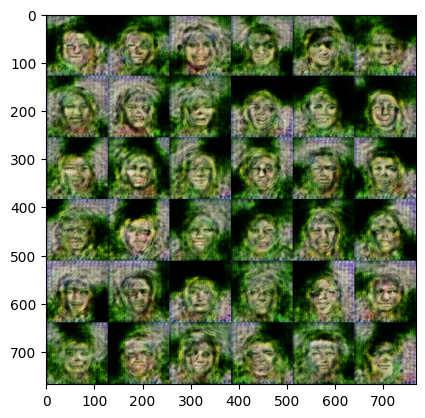

Training Progress:  53%|█████▎    | 8000/15000 [42:50<50:41,  2.30step/s]

****************************************************************************************************
1/1 [==============================] - 0s 16ms/step


Training Progress:  53%|█████▎    | 8001/15000 [42:50<46:57,  2.48step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  53%|█████▎    | 8002/15000 [42:50<43:34,  2.68step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  53%|█████▎    | 8003/15000 [42:51<41:16,  2.83step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  53%|█████▎    | 8004/15000 [42:51<39:35,  2.95step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  53%|█████▎    | 8005/15000 [42:51<38:24,  3.03step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  53%|█████▎    | 8006/15000 [42:52<37:38,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  53%|█████▎    | 8007/15000 [42:52<38:28,  3.03step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  53%|█████▎    | 8008/15000 [42:52<39:06,  2.98step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  53%|█████▎    | 8009/15000 [42:53<38:11,  3.05step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  53%|█████▎    | 8010/15000 [42:53<37:31,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  53%|█████▎    | 8011/15000 [42:53<37:02,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  53%|█████▎    | 8012/15000 [42:54<36:38,  3.18step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  53%|█████▎    | 8013/15000 [42:54<36:31,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  53%|█████▎    | 8014/15000 [42:54<36:23,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  53%|█████▎    | 8015/15000 [42:55<36:19,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  53%|█████▎    | 8016/15000 [42:55<36:17,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  53%|█████▎    | 8017/15000 [42:55<36:30,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  53%|█████▎    | 8018/15000 [42:55<36:29,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  53%|█████▎    | 8019/15000 [42:56<36:22,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  53%|█████▎    | 8020/15000 [42:56<36:13,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  53%|█████▎    | 8021/15000 [42:56<36:11,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  53%|█████▎    | 8022/15000 [42:57<36:02,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  53%|█████▎    | 8023/15000 [42:57<37:18,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  53%|█████▎    | 8024/15000 [42:57<38:08,  3.05step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  54%|█████▎    | 8025/15000 [42:58<37:24,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  54%|█████▎    | 8026/15000 [42:58<36:52,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  54%|█████▎    | 8027/15000 [42:58<36:49,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  54%|█████▎    | 8028/15000 [42:59<36:32,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  54%|█████▎    | 8029/15000 [42:59<36:20,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  54%|█████▎    | 8030/15000 [42:59<36:13,  3.21step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  54%|█████▎    | 8031/15000 [43:00<36:22,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  54%|█████▎    | 8032/15000 [43:00<36:15,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  54%|█████▎    | 8033/15000 [43:00<36:11,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  54%|█████▎    | 8034/15000 [43:00<36:06,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  54%|█████▎    | 8035/15000 [43:01<36:04,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  54%|█████▎    | 8036/15000 [43:01<36:12,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  54%|█████▎    | 8037/15000 [43:01<36:12,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  54%|█████▎    | 8038/15000 [43:02<36:08,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  54%|█████▎    | 8039/15000 [43:02<36:12,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  54%|█████▎    | 8040/15000 [43:02<37:31,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  54%|█████▎    | 8041/15000 [43:03<36:59,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  54%|█████▎    | 8042/15000 [43:03<36:36,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  54%|█████▎    | 8043/15000 [43:03<36:23,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  54%|█████▎    | 8044/15000 [43:04<36:14,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  54%|█████▎    | 8045/15000 [43:04<36:19,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  54%|█████▎    | 8046/15000 [43:04<36:13,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  54%|█████▎    | 8047/15000 [43:05<36:04,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  54%|█████▎    | 8048/15000 [43:05<35:57,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  54%|█████▎    | 8049/15000 [43:05<35:51,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  54%|█████▎    | 8050/15000 [43:06<35:50,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  54%|█████▎    | 8051/15000 [43:06<35:44,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  54%|█████▎    | 8052/15000 [43:06<37:00,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  54%|█████▎    | 8053/15000 [43:06<36:48,  3.15step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  54%|█████▎    | 8054/15000 [43:07<36:46,  3.15step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  54%|█████▎    | 8055/15000 [43:07<36:38,  3.16step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  54%|█████▎    | 8056/15000 [43:07<36:27,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  54%|█████▎    | 8057/15000 [43:08<36:18,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  54%|█████▎    | 8058/15000 [43:08<36:05,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  54%|█████▎    | 8059/15000 [43:08<36:01,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  54%|█████▎    | 8060/15000 [43:09<37:11,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  54%|█████▎    | 8061/15000 [43:09<36:42,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  54%|█████▎    | 8062/15000 [43:09<36:18,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  54%|█████▍    | 8063/15000 [43:10<36:07,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  54%|█████▍    | 8064/15000 [43:10<36:06,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  54%|█████▍    | 8065/15000 [43:10<36:00,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  54%|█████▍    | 8066/15000 [43:11<35:52,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  54%|█████▍    | 8067/15000 [43:11<35:46,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  54%|█████▍    | 8068/15000 [43:11<35:37,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  54%|█████▍    | 8069/15000 [43:11<35:34,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  54%|█████▍    | 8070/15000 [43:12<35:28,  3.26step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  54%|█████▍    | 8071/15000 [43:12<35:42,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  54%|█████▍    | 8072/15000 [43:12<35:58,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  54%|█████▍    | 8073/15000 [43:13<37:24,  3.09step/s]

1/1 [==============================] - 0s 30ms/step


Training Progress:  54%|█████▍    | 8074/15000 [43:13<38:38,  2.99step/s]

1/1 [==============================] - 0s 29ms/step


Training Progress:  54%|█████▍    | 8075/15000 [43:14<41:59,  2.75step/s]

1/1 [==============================] - 0s 27ms/step


Training Progress:  54%|█████▍    | 8076/15000 [43:14<43:34,  2.65step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  54%|█████▍    | 8077/15000 [43:14<43:02,  2.68step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  54%|█████▍    | 8078/15000 [43:15<40:41,  2.83step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  54%|█████▍    | 8079/15000 [43:15<40:25,  2.85step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  54%|█████▍    | 8080/15000 [43:15<38:49,  2.97step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  54%|█████▍    | 8081/15000 [43:16<39:10,  2.94step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  54%|█████▍    | 8082/15000 [43:16<38:08,  3.02step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  54%|█████▍    | 8083/15000 [43:16<37:20,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  54%|█████▍    | 8084/15000 [43:17<36:41,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  54%|█████▍    | 8085/15000 [43:17<36:17,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  54%|█████▍    | 8086/15000 [43:17<35:56,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  54%|█████▍    | 8087/15000 [43:17<35:46,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  54%|█████▍    | 8088/15000 [43:18<35:36,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  54%|█████▍    | 8089/15000 [43:18<35:32,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  54%|█████▍    | 8090/15000 [43:18<35:32,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  54%|█████▍    | 8091/15000 [43:19<37:03,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  54%|█████▍    | 8092/15000 [43:19<36:33,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  54%|█████▍    | 8093/15000 [43:19<36:19,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  54%|█████▍    | 8094/15000 [43:20<36:03,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  54%|█████▍    | 8095/15000 [43:20<35:55,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  54%|█████▍    | 8096/15000 [43:20<35:41,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  54%|█████▍    | 8097/15000 [43:21<35:43,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  54%|█████▍    | 8098/15000 [43:21<35:34,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  54%|█████▍    | 8099/15000 [43:21<35:34,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  54%|█████▍    | 8100/15000 [43:22<35:29,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  54%|█████▍    | 8101/15000 [43:22<35:45,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  54%|█████▍    | 8102/15000 [43:22<35:40,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  54%|█████▍    | 8103/15000 [43:22<37:07,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  54%|█████▍    | 8104/15000 [43:23<36:33,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  54%|█████▍    | 8105/15000 [43:23<36:13,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  54%|█████▍    | 8106/15000 [43:23<35:51,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  54%|█████▍    | 8107/15000 [43:24<35:51,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  54%|█████▍    | 8108/15000 [43:24<35:41,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  54%|█████▍    | 8109/15000 [43:24<35:28,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  54%|█████▍    | 8110/15000 [43:25<35:40,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  54%|█████▍    | 8111/15000 [43:25<35:35,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  54%|█████▍    | 8112/15000 [43:25<35:36,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  54%|█████▍    | 8113/15000 [43:26<35:31,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  54%|█████▍    | 8114/15000 [43:26<35:38,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  54%|█████▍    | 8115/15000 [43:26<35:29,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  54%|█████▍    | 8116/15000 [43:26<35:30,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  54%|█████▍    | 8117/15000 [43:27<35:25,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  54%|█████▍    | 8118/15000 [43:27<35:27,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  54%|█████▍    | 8119/15000 [43:27<35:38,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  54%|█████▍    | 8120/15000 [43:28<35:41,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  54%|█████▍    | 8121/15000 [43:28<35:37,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  54%|█████▍    | 8122/15000 [43:28<35:38,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  54%|█████▍    | 8123/15000 [43:29<35:27,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  54%|█████▍    | 8124/15000 [43:29<35:22,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  54%|█████▍    | 8125/15000 [43:29<35:13,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  54%|█████▍    | 8126/15000 [43:30<35:16,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  54%|█████▍    | 8127/15000 [43:30<35:17,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  54%|█████▍    | 8128/15000 [43:30<35:34,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  54%|█████▍    | 8129/15000 [43:31<35:32,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  54%|█████▍    | 8130/15000 [43:31<36:48,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  54%|█████▍    | 8131/15000 [43:31<36:18,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  54%|█████▍    | 8132/15000 [43:31<36:10,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  54%|█████▍    | 8133/15000 [43:32<35:56,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  54%|█████▍    | 8134/15000 [43:32<37:04,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  54%|█████▍    | 8135/15000 [43:32<36:53,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  54%|█████▍    | 8136/15000 [43:33<36:27,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  54%|█████▍    | 8137/15000 [43:33<35:58,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  54%|█████▍    | 8138/15000 [43:33<35:58,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  54%|█████▍    | 8139/15000 [43:34<35:46,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  54%|█████▍    | 8140/15000 [43:34<35:41,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  54%|█████▍    | 8141/15000 [43:34<35:29,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  54%|█████▍    | 8142/15000 [43:35<36:44,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  54%|█████▍    | 8143/15000 [43:35<36:24,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  54%|█████▍    | 8144/15000 [43:35<36:03,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  54%|█████▍    | 8145/15000 [43:36<37:00,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  54%|█████▍    | 8146/15000 [43:36<36:31,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  54%|█████▍    | 8147/15000 [43:36<36:16,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  54%|█████▍    | 8148/15000 [43:37<35:59,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  54%|█████▍    | 8149/15000 [43:37<35:43,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  54%|█████▍    | 8150/15000 [43:37<35:38,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  54%|█████▍    | 8151/15000 [43:37<35:31,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  54%|█████▍    | 8152/15000 [43:38<35:35,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  54%|█████▍    | 8153/15000 [43:38<35:32,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  54%|█████▍    | 8154/15000 [43:38<35:34,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  54%|█████▍    | 8155/15000 [43:39<35:27,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  54%|█████▍    | 8156/15000 [43:39<36:58,  3.08step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  54%|█████▍    | 8157/15000 [43:39<36:30,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  54%|█████▍    | 8158/15000 [43:40<36:14,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  54%|█████▍    | 8159/15000 [43:40<35:54,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  54%|█████▍    | 8160/15000 [43:40<35:44,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  54%|█████▍    | 8161/15000 [43:41<35:27,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  54%|█████▍    | 8162/15000 [43:41<35:19,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  54%|█████▍    | 8163/15000 [43:41<35:06,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  54%|█████▍    | 8164/15000 [43:42<35:07,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  54%|█████▍    | 8165/15000 [43:42<35:13,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  54%|█████▍    | 8166/15000 [43:42<35:16,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  54%|█████▍    | 8167/15000 [43:43<37:01,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  54%|█████▍    | 8168/15000 [43:43<36:29,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  54%|█████▍    | 8169/15000 [43:43<37:19,  3.05step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  54%|█████▍    | 8170/15000 [43:44<36:44,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  54%|█████▍    | 8171/15000 [43:44<37:31,  3.03step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  54%|█████▍    | 8172/15000 [43:44<38:00,  2.99step/s]

1/1 [==============================] - 0s 28ms/step


Training Progress:  54%|█████▍    | 8173/15000 [43:45<41:03,  2.77step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  54%|█████▍    | 8174/15000 [43:45<41:29,  2.74step/s]

1/1 [==============================] - 0s 27ms/step


Training Progress:  55%|█████▍    | 8175/15000 [43:45<43:20,  2.62step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  55%|█████▍    | 8176/15000 [43:46<42:44,  2.66step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  55%|█████▍    | 8177/15000 [43:46<40:21,  2.82step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  55%|█████▍    | 8178/15000 [43:46<40:01,  2.84step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  55%|█████▍    | 8179/15000 [43:47<38:27,  2.96step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  55%|█████▍    | 8180/15000 [43:47<37:25,  3.04step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  55%|█████▍    | 8181/15000 [43:47<36:36,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  55%|█████▍    | 8182/15000 [43:48<36:10,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  55%|█████▍    | 8183/15000 [43:48<35:46,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  55%|█████▍    | 8184/15000 [43:48<35:45,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  55%|█████▍    | 8185/15000 [43:49<35:29,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  55%|█████▍    | 8186/15000 [43:49<35:25,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  55%|█████▍    | 8187/15000 [43:49<35:15,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  55%|█████▍    | 8188/15000 [43:50<35:19,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  55%|█████▍    | 8189/15000 [43:50<35:12,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  55%|█████▍    | 8190/15000 [43:50<35:09,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  55%|█████▍    | 8191/15000 [43:50<36:17,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  55%|█████▍    | 8192/15000 [43:51<36:02,  3.15step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  55%|█████▍    | 8193/15000 [43:51<35:57,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  55%|█████▍    | 8194/15000 [43:51<35:45,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  55%|█████▍    | 8195/15000 [43:52<35:37,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  55%|█████▍    | 8196/15000 [43:52<35:28,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  55%|█████▍    | 8197/15000 [43:52<35:20,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  55%|█████▍    | 8198/15000 [43:53<35:21,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  55%|█████▍    | 8199/15000 [43:53<36:25,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  55%|█████▍    | 8200/15000 [43:53<36:01,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  55%|█████▍    | 8201/15000 [43:54<35:41,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  55%|█████▍    | 8202/15000 [43:54<35:40,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  55%|█████▍    | 8203/15000 [43:54<35:22,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  55%|█████▍    | 8204/15000 [43:55<35:22,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  55%|█████▍    | 8205/15000 [43:55<35:16,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  55%|█████▍    | 8206/15000 [43:55<35:11,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  55%|█████▍    | 8207/15000 [43:55<35:05,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  55%|█████▍    | 8208/15000 [43:56<35:03,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  55%|█████▍    | 8209/15000 [43:56<34:56,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  55%|█████▍    | 8210/15000 [43:56<36:08,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  55%|█████▍    | 8211/15000 [43:57<35:46,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  55%|█████▍    | 8212/15000 [43:57<35:43,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  55%|█████▍    | 8213/15000 [43:57<35:24,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  55%|█████▍    | 8214/15000 [43:58<35:21,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  55%|█████▍    | 8215/15000 [43:58<35:15,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  55%|█████▍    | 8216/15000 [43:58<35:17,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  55%|█████▍    | 8217/15000 [43:59<35:09,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  55%|█████▍    | 8218/15000 [43:59<35:00,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  55%|█████▍    | 8219/15000 [43:59<34:51,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  55%|█████▍    | 8220/15000 [44:00<34:58,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  55%|█████▍    | 8221/15000 [44:00<35:01,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  55%|█████▍    | 8222/15000 [44:00<34:59,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  55%|█████▍    | 8223/15000 [44:00<34:53,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  55%|█████▍    | 8224/15000 [44:01<34:54,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  55%|█████▍    | 8225/15000 [44:01<34:49,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  55%|█████▍    | 8226/15000 [44:01<34:49,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  55%|█████▍    | 8227/15000 [44:02<34:46,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  55%|█████▍    | 8228/15000 [44:02<34:45,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  55%|█████▍    | 8229/15000 [44:02<35:55,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  55%|█████▍    | 8230/15000 [44:03<35:45,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  55%|█████▍    | 8231/15000 [44:03<35:29,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  55%|█████▍    | 8232/15000 [44:03<35:21,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  55%|█████▍    | 8233/15000 [44:04<35:13,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  55%|█████▍    | 8234/15000 [44:04<35:09,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  55%|█████▍    | 8235/15000 [44:04<34:57,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  55%|█████▍    | 8236/15000 [44:05<34:54,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  55%|█████▍    | 8237/15000 [44:05<34:52,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  55%|█████▍    | 8238/15000 [44:05<34:56,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  55%|█████▍    | 8239/15000 [44:05<35:08,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  55%|█████▍    | 8240/15000 [44:06<35:11,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  55%|█████▍    | 8241/15000 [44:06<35:07,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  55%|█████▍    | 8242/15000 [44:06<35:04,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  55%|█████▍    | 8243/15000 [44:07<35:08,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  55%|█████▍    | 8244/15000 [44:07<35:04,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  55%|█████▍    | 8245/15000 [44:07<34:56,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  55%|█████▍    | 8246/15000 [44:08<34:56,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  55%|█████▍    | 8247/15000 [44:08<34:54,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  55%|█████▍    | 8248/15000 [44:08<34:53,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  55%|█████▍    | 8249/15000 [44:09<35:03,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  55%|█████▌    | 8250/15000 [44:09<35:04,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  55%|█████▌    | 8251/15000 [44:09<34:59,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  55%|█████▌    | 8252/15000 [44:09<34:57,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  55%|█████▌    | 8253/15000 [44:10<34:51,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  55%|█████▌    | 8254/15000 [44:10<34:52,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  55%|█████▌    | 8255/15000 [44:10<34:47,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  55%|█████▌    | 8256/15000 [44:11<34:54,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  55%|█████▌    | 8257/15000 [44:11<34:48,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  55%|█████▌    | 8258/15000 [44:11<35:04,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  55%|█████▌    | 8259/15000 [44:12<36:08,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  55%|█████▌    | 8260/15000 [44:12<35:47,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  55%|█████▌    | 8261/15000 [44:12<35:28,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  55%|█████▌    | 8262/15000 [44:13<36:30,  3.08step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  55%|█████▌    | 8263/15000 [44:13<37:08,  3.02step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  55%|█████▌    | 8264/15000 [44:13<36:35,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  55%|█████▌    | 8265/15000 [44:14<36:00,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  55%|█████▌    | 8266/15000 [44:14<35:39,  3.15step/s]

1/1 [==============================] - 0s 28ms/step


Training Progress:  55%|█████▌    | 8267/15000 [44:14<37:11,  3.02step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  55%|█████▌    | 8268/15000 [44:15<36:32,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  55%|█████▌    | 8269/15000 [44:15<35:57,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  55%|█████▌    | 8270/15000 [44:15<36:47,  3.05step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  55%|█████▌    | 8271/15000 [44:16<36:07,  3.10step/s]

1/1 [==============================] - 0s 33ms/step


Training Progress:  55%|█████▌    | 8272/15000 [44:16<40:42,  2.76step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  55%|█████▌    | 8273/15000 [44:16<41:04,  2.73step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  55%|█████▌    | 8274/15000 [44:17<42:38,  2.63step/s]

1/1 [==============================] - 0s 27ms/step


Training Progress:  55%|█████▌    | 8275/15000 [44:17<42:01,  2.67step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  55%|█████▌    | 8276/15000 [44:18<40:04,  2.80step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  55%|█████▌    | 8277/15000 [44:18<38:33,  2.91step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  55%|█████▌    | 8278/15000 [44:18<37:31,  2.99step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  55%|█████▌    | 8279/15000 [44:18<36:36,  3.06step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  55%|█████▌    | 8280/15000 [44:19<36:06,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  55%|█████▌    | 8281/15000 [44:19<35:36,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  55%|█████▌    | 8282/15000 [44:19<35:22,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  55%|█████▌    | 8283/15000 [44:20<35:01,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  55%|█████▌    | 8284/15000 [44:20<34:52,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  55%|█████▌    | 8285/15000 [44:20<34:43,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  55%|█████▌    | 8286/15000 [44:21<34:54,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  55%|█████▌    | 8287/15000 [44:21<34:55,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  55%|█████▌    | 8288/15000 [44:21<34:48,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  55%|█████▌    | 8289/15000 [44:22<34:41,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  55%|█████▌    | 8290/15000 [44:22<34:45,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  55%|█████▌    | 8291/15000 [44:22<34:36,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  55%|█████▌    | 8292/15000 [44:22<35:21,  3.16step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  55%|█████▌    | 8293/15000 [44:23<35:14,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  55%|█████▌    | 8294/15000 [44:23<35:05,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  55%|█████▌    | 8295/15000 [44:23<35:08,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  55%|█████▌    | 8296/15000 [44:24<35:06,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  55%|█████▌    | 8297/15000 [44:24<34:56,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  55%|█████▌    | 8298/15000 [44:24<34:51,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  55%|█████▌    | 8299/15000 [44:25<35:06,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  55%|█████▌    | 8300/15000 [44:25<34:58,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  55%|█████▌    | 8301/15000 [44:25<34:52,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  55%|█████▌    | 8302/15000 [44:26<34:52,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  55%|█████▌    | 8303/15000 [44:26<34:44,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  55%|█████▌    | 8304/15000 [44:26<34:55,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  55%|█████▌    | 8305/15000 [44:27<34:51,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  55%|█████▌    | 8306/15000 [44:27<34:47,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  55%|█████▌    | 8307/15000 [44:27<34:41,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  55%|█████▌    | 8308/15000 [44:27<34:40,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  55%|█████▌    | 8309/15000 [44:28<34:36,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  55%|█████▌    | 8310/15000 [44:28<34:34,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  55%|█████▌    | 8311/15000 [44:28<34:36,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  55%|█████▌    | 8312/15000 [44:29<34:40,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  55%|█████▌    | 8313/15000 [44:29<34:50,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  55%|█████▌    | 8314/15000 [44:29<36:01,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  55%|█████▌    | 8315/15000 [44:30<35:34,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  55%|█████▌    | 8316/15000 [44:30<35:17,  3.16step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  55%|█████▌    | 8317/15000 [44:30<35:05,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  55%|█████▌    | 8318/15000 [44:31<34:59,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  55%|█████▌    | 8319/15000 [44:31<35:58,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  55%|█████▌    | 8320/15000 [44:31<35:35,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  55%|█████▌    | 8321/15000 [44:32<35:15,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  55%|█████▌    | 8322/15000 [44:32<35:05,  3.17step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  55%|█████▌    | 8323/15000 [44:32<37:40,  2.95step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  55%|█████▌    | 8324/15000 [44:33<37:13,  2.99step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▌    | 8325/15000 [44:33<36:22,  3.06step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▌    | 8326/15000 [44:33<35:52,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▌    | 8327/15000 [44:34<35:25,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▌    | 8328/15000 [44:34<35:22,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▌    | 8329/15000 [44:34<35:09,  3.16step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  56%|█████▌    | 8330/15000 [44:35<35:04,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  56%|█████▌    | 8331/15000 [44:35<36:02,  3.08step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▌    | 8332/15000 [44:35<36:56,  3.01step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  56%|█████▌    | 8333/15000 [44:36<36:13,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▌    | 8334/15000 [44:36<36:59,  3.00step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▌    | 8335/15000 [44:36<38:32,  2.88step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▌    | 8336/15000 [44:37<37:20,  2.97step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  56%|█████▌    | 8337/15000 [44:37<36:29,  3.04step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▌    | 8338/15000 [44:37<35:53,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▌    | 8339/15000 [44:38<36:38,  3.03step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▌    | 8340/15000 [44:38<36:04,  3.08step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▌    | 8341/15000 [44:38<35:49,  3.10step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  56%|█████▌    | 8342/15000 [44:38<35:29,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▌    | 8343/15000 [44:39<35:08,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▌    | 8344/15000 [44:39<34:58,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  56%|█████▌    | 8345/15000 [44:39<34:43,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▌    | 8346/15000 [44:40<34:40,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▌    | 8347/15000 [44:40<34:30,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  56%|█████▌    | 8348/15000 [44:40<34:26,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  56%|█████▌    | 8349/15000 [44:41<35:32,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▌    | 8350/15000 [44:41<36:37,  3.03step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  56%|█████▌    | 8351/15000 [44:41<35:57,  3.08step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  56%|█████▌    | 8352/15000 [44:42<35:36,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▌    | 8353/15000 [44:42<36:26,  3.04step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  56%|█████▌    | 8354/15000 [44:42<35:49,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▌    | 8355/15000 [44:43<35:49,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▌    | 8356/15000 [44:43<35:25,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  56%|█████▌    | 8357/15000 [44:43<35:06,  3.15step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  56%|█████▌    | 8358/15000 [44:44<35:02,  3.16step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  56%|█████▌    | 8359/15000 [44:44<34:48,  3.18step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  56%|█████▌    | 8360/15000 [44:44<34:53,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▌    | 8361/15000 [44:45<34:45,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▌    | 8362/15000 [44:45<34:38,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▌    | 8363/15000 [44:45<34:33,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  56%|█████▌    | 8364/15000 [44:45<34:30,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  56%|█████▌    | 8365/15000 [44:46<35:34,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▌    | 8366/15000 [44:46<35:13,  3.14step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  56%|█████▌    | 8367/15000 [44:46<34:58,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▌    | 8368/15000 [44:47<34:52,  3.17step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  56%|█████▌    | 8369/15000 [44:47<35:00,  3.16step/s]

1/1 [==============================] - 0s 31ms/step


Training Progress:  56%|█████▌    | 8370/15000 [44:47<37:38,  2.94step/s]

1/1 [==============================] - 0s 27ms/step


Training Progress:  56%|█████▌    | 8371/15000 [44:48<40:07,  2.75step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  56%|█████▌    | 8372/15000 [44:48<40:38,  2.72step/s]

1/1 [==============================] - 0s 29ms/step


Training Progress:  56%|█████▌    | 8373/15000 [44:49<41:04,  2.69step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▌    | 8374/15000 [44:49<40:19,  2.74step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  56%|█████▌    | 8375/15000 [44:49<38:32,  2.86step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▌    | 8376/15000 [44:50<37:20,  2.96step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  56%|█████▌    | 8377/15000 [44:50<36:27,  3.03step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▌    | 8378/15000 [44:50<35:59,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▌    | 8379/15000 [44:51<35:32,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▌    | 8380/15000 [44:51<35:10,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▌    | 8381/15000 [44:51<34:57,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▌    | 8382/15000 [44:51<34:44,  3.17step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  56%|█████▌    | 8383/15000 [44:52<35:48,  3.08step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  56%|█████▌    | 8384/15000 [44:52<35:20,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▌    | 8385/15000 [44:52<36:43,  3.00step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▌    | 8386/15000 [44:53<35:57,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▌    | 8387/15000 [44:53<35:33,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▌    | 8388/15000 [44:53<35:12,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▌    | 8389/15000 [44:54<34:58,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  56%|█████▌    | 8390/15000 [44:54<34:41,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▌    | 8391/15000 [44:54<34:36,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  56%|█████▌    | 8392/15000 [44:55<34:27,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  56%|█████▌    | 8393/15000 [44:55<34:19,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  56%|█████▌    | 8394/15000 [44:55<34:16,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▌    | 8395/15000 [44:56<34:14,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  56%|█████▌    | 8396/15000 [44:56<35:25,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  56%|█████▌    | 8397/15000 [44:56<35:11,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▌    | 8398/15000 [44:57<34:54,  3.15step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  56%|█████▌    | 8399/15000 [44:57<34:52,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▌    | 8400/15000 [44:57<34:42,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  56%|█████▌    | 8401/15000 [44:57<34:28,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  56%|█████▌    | 8402/15000 [44:58<34:20,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▌    | 8403/15000 [44:58<34:15,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  56%|█████▌    | 8404/15000 [44:58<34:13,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▌    | 8405/15000 [44:59<34:08,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▌    | 8406/15000 [44:59<34:22,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  56%|█████▌    | 8407/15000 [44:59<34:27,  3.19step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  56%|█████▌    | 8408/15000 [45:00<34:42,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▌    | 8409/15000 [45:00<34:32,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▌    | 8410/15000 [45:00<34:24,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▌    | 8411/15000 [45:01<34:20,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▌    | 8412/15000 [45:01<34:18,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  56%|█████▌    | 8413/15000 [45:01<34:13,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  56%|█████▌    | 8414/15000 [45:02<34:09,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  56%|█████▌    | 8415/15000 [45:02<34:21,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▌    | 8416/15000 [45:02<34:36,  3.17step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  56%|█████▌    | 8417/15000 [45:03<36:02,  3.04step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  56%|█████▌    | 8418/15000 [45:03<36:42,  2.99step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▌    | 8419/15000 [45:03<35:55,  3.05step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▌    | 8420/15000 [45:04<35:22,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▌    | 8421/15000 [45:04<34:54,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  56%|█████▌    | 8422/15000 [45:04<34:36,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  56%|█████▌    | 8423/15000 [45:04<34:21,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▌    | 8424/15000 [45:05<35:32,  3.08step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▌    | 8425/15000 [45:05<35:04,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  56%|█████▌    | 8426/15000 [45:05<34:44,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▌    | 8427/15000 [45:06<34:32,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▌    | 8428/15000 [45:06<35:31,  3.08step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  56%|█████▌    | 8429/15000 [45:06<35:06,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  56%|█████▌    | 8430/15000 [45:07<34:47,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▌    | 8431/15000 [45:07<34:33,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▌    | 8432/15000 [45:07<34:23,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▌    | 8433/15000 [45:08<34:10,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  56%|█████▌    | 8434/15000 [45:08<35:26,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▌    | 8435/15000 [45:08<34:59,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▌    | 8436/15000 [45:09<35:52,  3.05step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  56%|█████▌    | 8437/15000 [45:09<35:21,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▋    | 8438/15000 [45:09<34:56,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  56%|█████▋    | 8439/15000 [45:10<35:50,  3.05step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▋    | 8440/15000 [45:10<35:17,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▋    | 8441/15000 [45:10<34:52,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  56%|█████▋    | 8442/15000 [45:11<34:34,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▋    | 8443/15000 [45:11<34:32,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▋    | 8444/15000 [45:11<34:22,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▋    | 8445/15000 [45:11<34:15,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  56%|█████▋    | 8446/15000 [45:12<34:09,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▋    | 8447/15000 [45:12<34:05,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▋    | 8448/15000 [45:12<35:16,  3.10step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  56%|█████▋    | 8449/15000 [45:13<34:51,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▋    | 8450/15000 [45:13<34:39,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  56%|█████▋    | 8451/15000 [45:13<34:23,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▋    | 8452/15000 [45:14<34:25,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▋    | 8453/15000 [45:14<34:18,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▋    | 8454/15000 [45:14<34:12,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▋    | 8455/15000 [45:15<34:06,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▋    | 8456/15000 [45:15<34:07,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  56%|█████▋    | 8457/15000 [45:15<34:01,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▋    | 8458/15000 [45:16<34:02,  3.20step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  56%|█████▋    | 8459/15000 [45:16<34:15,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▋    | 8460/15000 [45:16<34:22,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▋    | 8461/15000 [45:17<34:26,  3.16step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  56%|█████▋    | 8462/15000 [45:17<34:21,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▋    | 8463/15000 [45:17<34:13,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▋    | 8464/15000 [45:17<34:06,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  56%|█████▋    | 8465/15000 [45:18<33:58,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  56%|█████▋    | 8466/15000 [45:18<33:56,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  56%|█████▋    | 8467/15000 [45:18<33:52,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▋    | 8468/15000 [45:19<33:55,  3.21step/s]

1/1 [==============================] - 0s 27ms/step


Training Progress:  56%|█████▋    | 8469/15000 [45:19<38:42,  2.81step/s]

1/1 [==============================] - 0s 27ms/step


Training Progress:  56%|█████▋    | 8470/15000 [45:20<39:28,  2.76step/s]

1/1 [==============================] - 0s 28ms/step


Training Progress:  56%|█████▋    | 8471/15000 [45:20<40:31,  2.69step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▋    | 8472/15000 [45:20<38:32,  2.82step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▋    | 8473/15000 [45:21<37:06,  2.93step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  56%|█████▋    | 8474/15000 [45:21<36:05,  3.01step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  56%|█████▋    | 8475/15000 [45:21<35:20,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  57%|█████▋    | 8476/15000 [45:21<34:52,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8477/15000 [45:22<34:36,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  57%|█████▋    | 8478/15000 [45:22<34:26,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  57%|█████▋    | 8479/15000 [45:22<35:24,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8480/15000 [45:23<35:08,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8481/15000 [45:23<34:45,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8482/15000 [45:23<34:27,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8483/15000 [45:24<34:16,  3.17step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  57%|█████▋    | 8484/15000 [45:24<35:22,  3.07step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  57%|█████▋    | 8485/15000 [45:24<36:01,  3.01step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8486/15000 [45:25<35:18,  3.07step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  57%|█████▋    | 8487/15000 [45:25<34:58,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  57%|█████▋    | 8488/15000 [45:25<34:33,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8489/15000 [45:26<34:24,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8490/15000 [45:26<34:15,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8491/15000 [45:26<34:04,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8492/15000 [45:27<35:11,  3.08step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8493/15000 [45:27<34:38,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8494/15000 [45:27<34:23,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8495/15000 [45:28<34:07,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8496/15000 [45:28<33:59,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  57%|█████▋    | 8497/15000 [45:28<33:47,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8498/15000 [45:28<33:59,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  57%|█████▋    | 8499/15000 [45:29<33:54,  3.20step/s]

1/1 [==============================] - 0s 17ms/step
****************************************************************************************************
8500/15000: d_loss: 0.126605,  g_loss: 0.001803
2/2 [==============================] - 0s 20ms/step


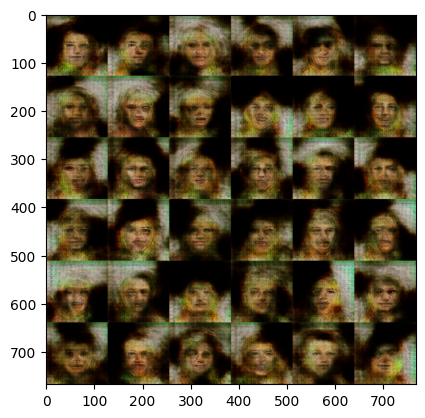

Training Progress:  57%|█████▋    | 8500/15000 [45:30<48:15,  2.24step/s]

****************************************************************************************************
1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8501/15000 [45:30<44:06,  2.46step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8502/15000 [45:30<41:09,  2.63step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8503/15000 [45:31<40:03,  2.70step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8504/15000 [45:31<38:14,  2.83step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8505/15000 [45:31<37:57,  2.85step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  57%|█████▋    | 8506/15000 [45:32<36:44,  2.95step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8507/15000 [45:32<35:47,  3.02step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8508/15000 [45:32<36:21,  2.98step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8509/15000 [45:33<36:12,  2.99step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  57%|█████▋    | 8510/15000 [45:33<36:38,  2.95step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8511/15000 [45:33<35:53,  3.01step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8512/15000 [45:33<35:17,  3.06step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8513/15000 [45:34<34:45,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  57%|█████▋    | 8514/15000 [45:34<34:22,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8515/15000 [45:34<34:05,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8516/15000 [45:35<33:54,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  57%|█████▋    | 8517/15000 [45:35<33:53,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8518/15000 [45:35<33:44,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  57%|█████▋    | 8519/15000 [45:36<33:36,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8520/15000 [45:36<33:42,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  57%|█████▋    | 8521/15000 [45:36<33:37,  3.21step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  57%|█████▋    | 8522/15000 [45:37<33:47,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  57%|█████▋    | 8523/15000 [45:37<33:38,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  57%|█████▋    | 8524/15000 [45:37<33:32,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  57%|█████▋    | 8525/15000 [45:38<33:26,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8526/15000 [45:38<33:24,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8527/15000 [45:38<33:26,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8528/15000 [45:38<33:28,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  57%|█████▋    | 8529/15000 [45:39<33:48,  3.19step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  57%|█████▋    | 8530/15000 [45:39<33:47,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8531/15000 [45:39<33:47,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  57%|█████▋    | 8532/15000 [45:40<33:48,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8533/15000 [45:40<33:43,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8534/15000 [45:40<33:38,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  57%|█████▋    | 8535/15000 [45:41<34:41,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8536/15000 [45:41<34:25,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8537/15000 [45:41<33:58,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8538/15000 [45:42<33:46,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8539/15000 [45:42<33:52,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8540/15000 [45:42<33:45,  3.19step/s]

1/1 [==============================] - 0s 42ms/step


Training Progress:  57%|█████▋    | 8541/15000 [45:43<36:33,  2.94step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  57%|█████▋    | 8542/15000 [45:43<35:35,  3.02step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  57%|█████▋    | 8543/15000 [45:43<34:49,  3.09step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  57%|█████▋    | 8544/15000 [45:44<34:40,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8545/15000 [45:44<34:16,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8546/15000 [45:44<33:59,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8547/15000 [45:44<33:46,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8548/15000 [45:45<33:49,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8549/15000 [45:45<36:04,  2.98step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8550/15000 [45:46<35:16,  3.05step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  57%|█████▋    | 8551/15000 [45:46<34:36,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8552/15000 [45:46<34:19,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  57%|█████▋    | 8553/15000 [45:46<33:54,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8554/15000 [45:47<33:43,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  57%|█████▋    | 8555/15000 [45:47<33:35,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8556/15000 [45:47<33:30,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8557/15000 [45:48<33:33,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8558/15000 [45:48<34:44,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8559/15000 [45:48<34:16,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  57%|█████▋    | 8560/15000 [45:49<35:10,  3.05step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8561/15000 [45:49<34:35,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  57%|█████▋    | 8562/15000 [45:49<34:11,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8563/15000 [45:50<33:54,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  57%|█████▋    | 8564/15000 [45:50<33:44,  3.18step/s]

1/1 [==============================] - 0s 41ms/step


Training Progress:  57%|█████▋    | 8565/15000 [45:50<37:45,  2.84step/s]

1/1 [==============================] - 0s 23ms/step


Training Progress:  57%|█████▋    | 8566/15000 [45:51<40:00,  2.68step/s]

1/1 [==============================] - 0s 31ms/step


Training Progress:  57%|█████▋    | 8567/15000 [45:51<41:35,  2.58step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  57%|█████▋    | 8568/15000 [45:52<39:40,  2.70step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  57%|█████▋    | 8569/15000 [45:52<37:40,  2.84step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  57%|█████▋    | 8570/15000 [45:52<36:24,  2.94step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  57%|█████▋    | 8571/15000 [45:52<35:44,  3.00step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  57%|█████▋    | 8572/15000 [45:53<34:57,  3.07step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  57%|█████▋    | 8573/15000 [45:53<35:30,  3.02step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8574/15000 [45:53<34:50,  3.07step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  57%|█████▋    | 8575/15000 [45:54<34:20,  3.12step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  57%|█████▋    | 8576/15000 [45:54<34:15,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8577/15000 [45:54<33:56,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8578/15000 [45:55<34:57,  3.06step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8579/15000 [45:55<34:23,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8580/15000 [45:55<34:02,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8581/15000 [45:56<33:44,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8582/15000 [45:56<33:31,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  57%|█████▋    | 8583/15000 [45:56<33:16,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  57%|█████▋    | 8584/15000 [45:57<33:12,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8585/15000 [45:57<33:20,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8586/15000 [45:57<33:20,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8587/15000 [45:58<33:13,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  57%|█████▋    | 8588/15000 [45:58<33:09,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8589/15000 [45:58<33:03,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  57%|█████▋    | 8590/15000 [45:58<33:03,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  57%|█████▋    | 8591/15000 [45:59<34:10,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8592/15000 [45:59<33:50,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8593/15000 [45:59<33:40,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8594/15000 [46:00<33:36,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8595/15000 [46:00<33:23,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  57%|█████▋    | 8596/15000 [46:00<33:23,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8597/15000 [46:01<33:21,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  57%|█████▋    | 8598/15000 [46:01<33:21,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8599/15000 [46:01<33:11,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  57%|█████▋    | 8600/15000 [46:02<33:04,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  57%|█████▋    | 8601/15000 [46:02<34:01,  3.13step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  57%|█████▋    | 8602/15000 [46:02<33:39,  3.17step/s]

1/1 [==============================] - 0s 32ms/step


Training Progress:  57%|█████▋    | 8603/15000 [46:03<34:44,  3.07step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  57%|█████▋    | 8604/15000 [46:03<34:16,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8605/15000 [46:03<33:54,  3.14step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  57%|█████▋    | 8606/15000 [46:04<33:40,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  57%|█████▋    | 8607/15000 [46:04<33:18,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  57%|█████▋    | 8608/15000 [46:04<33:13,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  57%|█████▋    | 8609/15000 [46:04<33:05,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8610/15000 [46:05<33:00,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  57%|█████▋    | 8611/15000 [46:05<33:02,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  57%|█████▋    | 8612/15000 [46:05<32:55,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8613/15000 [46:06<34:09,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  57%|█████▋    | 8614/15000 [46:06<33:48,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  57%|█████▋    | 8615/15000 [46:06<33:25,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8616/15000 [46:07<33:14,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  57%|█████▋    | 8617/15000 [46:07<33:01,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  57%|█████▋    | 8618/15000 [46:07<32:56,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  57%|█████▋    | 8619/15000 [46:08<32:51,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  57%|█████▋    | 8620/15000 [46:08<32:50,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8621/15000 [46:08<32:45,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  57%|█████▋    | 8622/15000 [46:08<32:55,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  57%|█████▋    | 8623/15000 [46:09<32:52,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  57%|█████▋    | 8624/15000 [46:09<32:51,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  57%|█████▊    | 8625/15000 [46:09<32:44,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  58%|█████▊    | 8626/15000 [46:10<32:45,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  58%|█████▊    | 8627/15000 [46:10<32:40,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  58%|█████▊    | 8628/15000 [46:10<33:48,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  58%|█████▊    | 8629/15000 [46:11<33:23,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  58%|█████▊    | 8630/15000 [46:11<33:06,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  58%|█████▊    | 8631/15000 [46:11<33:01,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  58%|█████▊    | 8632/15000 [46:12<32:57,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  58%|█████▊    | 8633/15000 [46:12<34:02,  3.12step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  58%|█████▊    | 8634/15000 [46:12<33:57,  3.12step/s]

1/1 [==============================] - 0s 31ms/step


Training Progress:  58%|█████▊    | 8635/15000 [46:13<34:32,  3.07step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  58%|█████▊    | 8636/15000 [46:13<34:00,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  58%|█████▊    | 8637/15000 [46:13<34:48,  3.05step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  58%|█████▊    | 8638/15000 [46:14<34:10,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  58%|█████▊    | 8639/15000 [46:14<33:37,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  58%|█████▊    | 8640/15000 [46:14<34:38,  3.06step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  58%|█████▊    | 8641/15000 [46:15<33:59,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  58%|█████▊    | 8642/15000 [46:15<33:32,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  58%|█████▊    | 8643/15000 [46:15<33:09,  3.20step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:  58%|█████▊    | 8644/15000 [46:15<32:59,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  58%|█████▊    | 8645/15000 [46:16<33:00,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  58%|█████▊    | 8646/15000 [46:16<32:57,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  58%|█████▊    | 8647/15000 [46:16<32:53,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  58%|█████▊    | 8648/15000 [46:17<32:46,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  58%|█████▊    | 8649/15000 [46:17<32:38,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  58%|█████▊    | 8650/15000 [46:17<32:48,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  58%|█████▊    | 8651/15000 [46:18<32:44,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  58%|█████▊    | 8652/15000 [46:18<32:40,  3.24step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  58%|█████▊    | 8653/15000 [46:18<32:39,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  58%|█████▊    | 8654/15000 [46:19<32:38,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  58%|█████▊    | 8655/15000 [46:19<32:33,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  58%|█████▊    | 8656/15000 [46:19<32:33,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  58%|█████▊    | 8657/15000 [46:19<32:29,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  58%|█████▊    | 8658/15000 [46:20<32:34,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  58%|█████▊    | 8659/15000 [46:20<32:38,  3.24step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  58%|█████▊    | 8660/15000 [46:20<32:47,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  58%|█████▊    | 8661/15000 [46:21<32:50,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  58%|█████▊    | 8662/15000 [46:21<32:43,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  58%|█████▊    | 8663/15000 [46:21<33:45,  3.13step/s]

1/1 [==============================] - 0s 31ms/step


Training Progress:  58%|█████▊    | 8664/15000 [46:22<36:33,  2.89step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  58%|█████▊    | 8665/15000 [46:22<38:32,  2.74step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  58%|█████▊    | 8666/15000 [46:23<40:41,  2.59step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  58%|█████▊    | 8667/15000 [46:23<40:16,  2.62step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  58%|█████▊    | 8668/15000 [46:23<38:04,  2.77step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  58%|█████▊    | 8669/15000 [46:24<36:30,  2.89step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  58%|█████▊    | 8670/15000 [46:24<35:19,  2.99step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  58%|█████▊    | 8671/15000 [46:24<35:32,  2.97step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  58%|█████▊    | 8672/15000 [46:25<34:30,  3.06step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  58%|█████▊    | 8673/15000 [46:25<33:48,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  58%|█████▊    | 8674/15000 [46:25<33:20,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  58%|█████▊    | 8675/15000 [46:25<32:59,  3.20step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:  58%|█████▊    | 8676/15000 [46:26<32:40,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  58%|█████▊    | 8677/15000 [46:26<32:49,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  58%|█████▊    | 8678/15000 [46:26<32:38,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  58%|█████▊    | 8679/15000 [46:27<33:42,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  58%|█████▊    | 8680/15000 [46:27<34:27,  3.06step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  58%|█████▊    | 8681/15000 [46:27<34:55,  3.02step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  58%|█████▊    | 8682/15000 [46:28<34:07,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  58%|█████▊    | 8683/15000 [46:28<33:33,  3.14step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  58%|█████▊    | 8684/15000 [46:28<33:14,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  58%|█████▊    | 8685/15000 [46:29<32:57,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  58%|█████▊    | 8686/15000 [46:29<33:58,  3.10step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  58%|█████▊    | 8687/15000 [46:29<33:43,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  58%|█████▊    | 8688/15000 [46:30<33:15,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  58%|█████▊    | 8689/15000 [46:30<32:54,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  58%|█████▊    | 8690/15000 [46:30<32:44,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  58%|█████▊    | 8691/15000 [46:31<32:33,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  58%|█████▊    | 8692/15000 [46:31<32:27,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  58%|█████▊    | 8693/15000 [46:31<32:25,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  58%|█████▊    | 8694/15000 [46:31<32:25,  3.24step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  58%|█████▊    | 8695/15000 [46:32<33:39,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  58%|█████▊    | 8696/15000 [46:32<34:33,  3.04step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  58%|█████▊    | 8697/15000 [46:32<34:24,  3.05step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  58%|█████▊    | 8698/15000 [46:33<33:48,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  58%|█████▊    | 8699/15000 [46:33<33:18,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  58%|█████▊    | 8700/15000 [46:33<33:00,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  58%|█████▊    | 8701/15000 [46:34<32:42,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  58%|█████▊    | 8702/15000 [46:34<32:30,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  58%|█████▊    | 8703/15000 [46:34<32:23,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  58%|█████▊    | 8704/15000 [46:35<32:16,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  58%|█████▊    | 8705/15000 [46:35<32:24,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  58%|█████▊    | 8706/15000 [46:35<32:20,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  58%|█████▊    | 8707/15000 [46:36<32:14,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  58%|█████▊    | 8708/15000 [46:36<32:10,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  58%|█████▊    | 8709/15000 [46:36<32:06,  3.27step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  58%|█████▊    | 8710/15000 [46:37<33:24,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  58%|█████▊    | 8711/15000 [46:37<33:02,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  58%|█████▊    | 8712/15000 [46:37<32:56,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  58%|█████▊    | 8713/15000 [46:37<33:50,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  58%|█████▊    | 8714/15000 [46:38<33:28,  3.13step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  58%|█████▊    | 8715/15000 [46:38<42:16,  2.48step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  58%|█████▊    | 8716/15000 [46:39<39:28,  2.65step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  58%|█████▊    | 8717/15000 [46:39<37:29,  2.79step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  58%|█████▊    | 8718/15000 [46:39<36:14,  2.89step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  58%|█████▊    | 8719/15000 [46:40<35:14,  2.97step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  58%|█████▊    | 8720/15000 [46:40<34:33,  3.03step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  58%|█████▊    | 8721/15000 [46:40<34:07,  3.07step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  58%|█████▊    | 8722/15000 [46:41<33:47,  3.10step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  58%|█████▊    | 8723/15000 [46:41<33:30,  3.12step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  58%|█████▊    | 8724/15000 [46:41<33:28,  3.12step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  58%|█████▊    | 8725/15000 [46:42<33:19,  3.14step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  58%|█████▊    | 8726/15000 [46:42<33:10,  3.15step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  58%|█████▊    | 8727/15000 [46:42<34:26,  3.04step/s]

1/1 [==============================] - 0s 44ms/step


Training Progress:  58%|█████▊    | 8728/15000 [46:43<35:57,  2.91step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  58%|█████▊    | 8729/15000 [46:43<35:02,  2.98step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  58%|█████▊    | 8730/15000 [46:43<34:27,  3.03step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  58%|█████▊    | 8731/15000 [46:44<33:59,  3.07step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  58%|█████▊    | 8732/15000 [46:44<34:43,  3.01step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  58%|█████▊    | 8733/15000 [46:44<35:30,  2.94step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  58%|█████▊    | 8734/15000 [46:45<35:55,  2.91step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  58%|█████▊    | 8735/15000 [46:45<35:00,  2.98step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  58%|█████▊    | 8736/15000 [46:45<34:22,  3.04step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  58%|█████▊    | 8737/15000 [46:46<33:56,  3.08step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  58%|█████▊    | 8738/15000 [46:46<33:44,  3.09step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  58%|█████▊    | 8739/15000 [46:46<33:28,  3.12step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  58%|█████▊    | 8740/15000 [46:46<33:17,  3.13step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  58%|█████▊    | 8741/15000 [46:47<33:13,  3.14step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  58%|█████▊    | 8742/15000 [46:47<33:24,  3.12step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  58%|█████▊    | 8743/15000 [46:47<33:19,  3.13step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  58%|█████▊    | 8744/15000 [46:48<33:12,  3.14step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  58%|█████▊    | 8745/15000 [46:48<33:04,  3.15step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  58%|█████▊    | 8746/15000 [46:48<32:56,  3.16step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  58%|█████▊    | 8747/15000 [46:49<32:54,  3.17step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  58%|█████▊    | 8748/15000 [46:49<32:50,  3.17step/s]

1/1 [==============================] - 0s 23ms/step


Training Progress:  58%|█████▊    | 8749/15000 [46:49<32:52,  3.17step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  58%|█████▊    | 8750/15000 [46:50<33:57,  3.07step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  58%|█████▊    | 8751/15000 [46:50<33:49,  3.08step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  58%|█████▊    | 8752/15000 [46:50<34:44,  3.00step/s]

1/1 [==============================] - 0s 23ms/step


Training Progress:  58%|█████▊    | 8753/15000 [46:51<34:17,  3.04step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  58%|█████▊    | 8754/15000 [46:51<33:53,  3.07step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  58%|█████▊    | 8755/15000 [46:51<35:54,  2.90step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  58%|█████▊    | 8756/15000 [46:52<36:06,  2.88step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  58%|█████▊    | 8757/15000 [46:52<35:06,  2.96step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  58%|█████▊    | 8758/15000 [46:52<35:00,  2.97step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  58%|█████▊    | 8759/15000 [46:53<34:20,  3.03step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  58%|█████▊    | 8760/15000 [46:53<36:44,  2.83step/s]

1/1 [==============================] - 0s 37ms/step


Training Progress:  58%|█████▊    | 8761/15000 [46:54<38:59,  2.67step/s]

1/1 [==============================] - 0s 30ms/step


Training Progress:  58%|█████▊    | 8762/15000 [46:54<41:37,  2.50step/s]

1/1 [==============================] - 0s 28ms/step


Training Progress:  58%|█████▊    | 8763/15000 [46:54<40:59,  2.54step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  58%|█████▊    | 8764/15000 [46:55<38:29,  2.70step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  58%|█████▊    | 8765/15000 [46:55<36:43,  2.83step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  58%|█████▊    | 8766/15000 [46:55<35:32,  2.92step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  58%|█████▊    | 8767/15000 [46:56<34:41,  2.99step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  58%|█████▊    | 8768/15000 [46:56<34:05,  3.05step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  58%|█████▊    | 8769/15000 [46:56<33:51,  3.07step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  58%|█████▊    | 8770/15000 [46:57<33:30,  3.10step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  58%|█████▊    | 8771/15000 [46:57<33:18,  3.12step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  58%|█████▊    | 8772/15000 [46:57<33:06,  3.14step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  58%|█████▊    | 8773/15000 [46:58<34:08,  3.04step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  58%|█████▊    | 8774/15000 [46:58<34:47,  2.98step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  58%|█████▊    | 8775/15000 [46:58<34:11,  3.03step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  59%|█████▊    | 8776/15000 [46:59<34:47,  2.98step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  59%|█████▊    | 8777/15000 [46:59<34:06,  3.04step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  59%|█████▊    | 8778/15000 [46:59<33:45,  3.07step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  59%|█████▊    | 8779/15000 [47:00<33:35,  3.09step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  59%|█████▊    | 8780/15000 [47:00<33:13,  3.12step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  59%|█████▊    | 8781/15000 [47:00<33:00,  3.14step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  59%|█████▊    | 8782/15000 [47:00<32:50,  3.16step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  59%|█████▊    | 8783/15000 [47:01<32:49,  3.16step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  59%|█████▊    | 8784/15000 [47:01<32:39,  3.17step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  59%|█████▊    | 8785/15000 [47:01<32:37,  3.18step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  59%|█████▊    | 8786/15000 [47:02<32:33,  3.18step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  59%|█████▊    | 8787/15000 [47:02<32:34,  3.18step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  59%|█████▊    | 8788/15000 [47:02<34:32,  3.00step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  59%|█████▊    | 8789/15000 [47:03<33:59,  3.05step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  59%|█████▊    | 8790/15000 [47:03<33:22,  3.10step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  59%|█████▊    | 8791/15000 [47:03<33:05,  3.13step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  59%|█████▊    | 8792/15000 [47:04<32:48,  3.15step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  59%|█████▊    | 8793/15000 [47:04<32:52,  3.15step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  59%|█████▊    | 8794/15000 [47:04<32:36,  3.17step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  59%|█████▊    | 8795/15000 [47:05<32:33,  3.18step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  59%|█████▊    | 8796/15000 [47:05<32:29,  3.18step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  59%|█████▊    | 8797/15000 [47:05<33:42,  3.07step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  59%|█████▊    | 8798/15000 [47:06<33:15,  3.11step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  59%|█████▊    | 8799/15000 [47:06<33:01,  3.13step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  59%|█████▊    | 8800/15000 [47:06<32:43,  3.16step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  59%|█████▊    | 8801/15000 [47:07<32:34,  3.17step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  59%|█████▊    | 8802/15000 [47:07<32:26,  3.18step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  59%|█████▊    | 8803/15000 [47:07<32:23,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  59%|█████▊    | 8804/15000 [47:07<32:14,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  59%|█████▊    | 8805/15000 [47:08<33:22,  3.09step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  59%|█████▊    | 8806/15000 [47:08<33:09,  3.11step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  59%|█████▊    | 8807/15000 [47:08<32:50,  3.14step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  59%|█████▊    | 8808/15000 [47:09<32:37,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  59%|█████▊    | 8809/15000 [47:09<32:28,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  59%|█████▊    | 8810/15000 [47:09<33:27,  3.08step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  59%|█████▊    | 8811/15000 [47:10<33:01,  3.12step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  59%|█████▊    | 8812/15000 [47:10<32:43,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  59%|█████▉    | 8813/15000 [47:10<32:29,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  59%|█████▉    | 8814/15000 [47:11<33:24,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  59%|█████▉    | 8815/15000 [47:11<33:12,  3.10step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  59%|█████▉    | 8816/15000 [47:11<32:49,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  59%|█████▉    | 8817/15000 [47:12<32:35,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  59%|█████▉    | 8818/15000 [47:12<32:19,  3.19step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  59%|█████▉    | 8819/15000 [47:12<33:35,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  59%|█████▉    | 8820/15000 [47:13<33:40,  3.06step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  59%|█████▉    | 8821/15000 [47:13<33:04,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  59%|█████▉    | 8822/15000 [47:13<32:37,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  59%|█████▉    | 8823/15000 [47:14<32:16,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  59%|█████▉    | 8824/15000 [47:14<31:59,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  59%|█████▉    | 8825/15000 [47:14<32:13,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  59%|█████▉    | 8826/15000 [47:14<32:05,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  59%|█████▉    | 8827/15000 [47:15<31:59,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  59%|█████▉    | 8828/15000 [47:15<31:48,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  59%|█████▉    | 8829/15000 [47:15<31:46,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  59%|█████▉    | 8830/15000 [47:16<31:39,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  59%|█████▉    | 8831/15000 [47:16<31:43,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  59%|█████▉    | 8832/15000 [47:16<31:36,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  59%|█████▉    | 8833/15000 [47:17<31:37,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  59%|█████▉    | 8834/15000 [47:17<31:46,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  59%|█████▉    | 8835/15000 [47:17<31:50,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  59%|█████▉    | 8836/15000 [47:18<31:50,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  59%|█████▉    | 8837/15000 [47:18<31:47,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  59%|█████▉    | 8838/15000 [47:18<31:38,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  59%|█████▉    | 8839/15000 [47:18<31:39,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  59%|█████▉    | 8840/15000 [47:19<31:40,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  59%|█████▉    | 8841/15000 [47:19<31:40,  3.24step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  59%|█████▉    | 8842/15000 [47:19<31:39,  3.24step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  59%|█████▉    | 8843/15000 [47:20<33:00,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  59%|█████▉    | 8844/15000 [47:20<33:43,  3.04step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  59%|█████▉    | 8845/15000 [47:20<34:15,  3.00step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  59%|█████▉    | 8846/15000 [47:21<34:30,  2.97step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  59%|█████▉    | 8847/15000 [47:21<34:46,  2.95step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  59%|█████▉    | 8848/15000 [47:21<33:47,  3.03step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  59%|█████▉    | 8849/15000 [47:22<33:06,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  59%|█████▉    | 8850/15000 [47:22<32:35,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  59%|█████▉    | 8851/15000 [47:22<32:28,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  59%|█████▉    | 8852/15000 [47:23<32:25,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  59%|█████▉    | 8853/15000 [47:23<32:13,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  59%|█████▉    | 8854/15000 [47:23<32:03,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  59%|█████▉    | 8855/15000 [47:24<31:55,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  59%|█████▉    | 8856/15000 [47:24<31:45,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  59%|█████▉    | 8857/15000 [47:24<31:39,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  59%|█████▉    | 8858/15000 [47:25<33:28,  3.06step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  59%|█████▉    | 8859/15000 [47:25<35:02,  2.92step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  59%|█████▉    | 8860/15000 [47:25<37:03,  2.76step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  59%|█████▉    | 8861/15000 [47:26<38:27,  2.66step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  59%|█████▉    | 8862/15000 [47:26<36:34,  2.80step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  59%|█████▉    | 8863/15000 [47:26<35:12,  2.91step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  59%|█████▉    | 8864/15000 [47:27<34:03,  3.00step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  59%|█████▉    | 8865/15000 [47:27<33:16,  3.07step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  59%|█████▉    | 8866/15000 [47:27<32:39,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  59%|█████▉    | 8867/15000 [47:28<32:25,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  59%|█████▉    | 8868/15000 [47:28<32:07,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  59%|█████▉    | 8869/15000 [47:28<31:51,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  59%|█████▉    | 8870/15000 [47:29<31:43,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  59%|█████▉    | 8871/15000 [47:29<31:46,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  59%|█████▉    | 8872/15000 [47:29<31:40,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  59%|█████▉    | 8873/15000 [47:30<32:40,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  59%|█████▉    | 8874/15000 [47:30<32:16,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  59%|█████▉    | 8875/15000 [47:30<31:55,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  59%|█████▉    | 8876/15000 [47:30<31:43,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  59%|█████▉    | 8877/15000 [47:31<31:35,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  59%|█████▉    | 8878/15000 [47:31<31:33,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  59%|█████▉    | 8879/15000 [47:31<32:31,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  59%|█████▉    | 8880/15000 [47:32<33:22,  3.06step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  59%|█████▉    | 8881/15000 [47:32<32:49,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  59%|█████▉    | 8882/15000 [47:32<33:37,  3.03step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  59%|█████▉    | 8883/15000 [47:33<32:58,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  59%|█████▉    | 8884/15000 [47:33<32:26,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  59%|█████▉    | 8885/15000 [47:33<32:07,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  59%|█████▉    | 8886/15000 [47:34<32:54,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  59%|█████▉    | 8887/15000 [47:34<33:25,  3.05step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  59%|█████▉    | 8888/15000 [47:34<33:48,  3.01step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  59%|█████▉    | 8889/15000 [47:35<33:09,  3.07step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  59%|█████▉    | 8890/15000 [47:35<32:42,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  59%|█████▉    | 8891/15000 [47:35<32:15,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  59%|█████▉    | 8892/15000 [47:36<31:57,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  59%|█████▉    | 8893/15000 [47:36<31:47,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  59%|█████▉    | 8894/15000 [47:36<31:34,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  59%|█████▉    | 8895/15000 [47:37<31:29,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  59%|█████▉    | 8896/15000 [47:37<31:31,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  59%|█████▉    | 8897/15000 [47:37<31:27,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  59%|█████▉    | 8898/15000 [47:37<31:32,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  59%|█████▉    | 8899/15000 [47:38<31:35,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  59%|█████▉    | 8900/15000 [47:38<31:36,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  59%|█████▉    | 8901/15000 [47:38<31:34,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  59%|█████▉    | 8902/15000 [47:39<31:30,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  59%|█████▉    | 8903/15000 [47:39<32:33,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  59%|█████▉    | 8904/15000 [47:39<32:18,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  59%|█████▉    | 8905/15000 [47:40<31:56,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  59%|█████▉    | 8906/15000 [47:40<31:45,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  59%|█████▉    | 8907/15000 [47:40<31:31,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  59%|█████▉    | 8908/15000 [47:41<31:36,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  59%|█████▉    | 8909/15000 [47:41<31:27,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  59%|█████▉    | 8910/15000 [47:41<31:26,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  59%|█████▉    | 8911/15000 [47:42<31:25,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  59%|█████▉    | 8912/15000 [47:42<31:22,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  59%|█████▉    | 8913/15000 [47:42<31:13,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  59%|█████▉    | 8914/15000 [47:42<32:22,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  59%|█████▉    | 8915/15000 [47:43<31:57,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  59%|█████▉    | 8916/15000 [47:43<31:41,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  59%|█████▉    | 8917/15000 [47:43<31:37,  3.21step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  59%|█████▉    | 8918/15000 [47:44<31:42,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  59%|█████▉    | 8919/15000 [47:44<31:27,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  59%|█████▉    | 8920/15000 [47:44<31:21,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  59%|█████▉    | 8921/15000 [47:45<31:12,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  59%|█████▉    | 8922/15000 [47:45<31:10,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  59%|█████▉    | 8923/15000 [47:45<31:12,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  59%|█████▉    | 8924/15000 [47:46<31:23,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|█████▉    | 8925/15000 [47:46<31:13,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  60%|█████▉    | 8926/15000 [47:46<31:29,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  60%|█████▉    | 8927/15000 [47:46<31:26,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  60%|█████▉    | 8928/15000 [47:47<31:26,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|█████▉    | 8929/15000 [47:47<31:20,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  60%|█████▉    | 8930/15000 [47:47<31:25,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|█████▉    | 8931/15000 [47:48<31:17,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|█████▉    | 8932/15000 [47:48<31:17,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|█████▉    | 8933/15000 [47:48<31:08,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|█████▉    | 8934/15000 [47:49<31:08,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  60%|█████▉    | 8935/15000 [47:49<31:03,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|█████▉    | 8936/15000 [47:49<31:16,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  60%|█████▉    | 8937/15000 [47:50<31:19,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  60%|█████▉    | 8938/15000 [47:50<31:19,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|█████▉    | 8939/15000 [47:50<32:19,  3.13step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  60%|█████▉    | 8940/15000 [47:51<32:01,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|█████▉    | 8941/15000 [47:51<31:44,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|█████▉    | 8942/15000 [47:51<31:33,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|█████▉    | 8943/15000 [47:51<31:24,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|█████▉    | 8944/15000 [47:52<31:21,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|█████▉    | 8945/15000 [47:52<32:27,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  60%|█████▉    | 8946/15000 [47:52<32:23,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  60%|█████▉    | 8947/15000 [47:53<32:00,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|█████▉    | 8948/15000 [47:53<31:45,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|█████▉    | 8949/15000 [47:53<31:27,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|█████▉    | 8950/15000 [47:54<31:21,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|█████▉    | 8951/15000 [47:54<31:11,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|█████▉    | 8952/15000 [47:54<31:07,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|█████▉    | 8953/15000 [47:55<31:02,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|█████▉    | 8954/15000 [47:55<32:17,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  60%|█████▉    | 8955/15000 [47:55<31:53,  3.16step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  60%|█████▉    | 8956/15000 [47:56<31:44,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|█████▉    | 8957/15000 [47:56<33:44,  2.99step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  60%|█████▉    | 8958/15000 [47:56<36:39,  2.75step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  60%|█████▉    | 8959/15000 [47:57<39:01,  2.58step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  60%|█████▉    | 8960/15000 [47:57<38:34,  2.61step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  60%|█████▉    | 8961/15000 [47:57<36:36,  2.75step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|█████▉    | 8962/15000 [47:58<35:01,  2.87step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  60%|█████▉    | 8963/15000 [47:58<33:54,  2.97step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  60%|█████▉    | 8964/15000 [47:58<33:06,  3.04step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|█████▉    | 8965/15000 [47:59<32:24,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|█████▉    | 8966/15000 [47:59<31:57,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  60%|█████▉    | 8967/15000 [47:59<31:39,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  60%|█████▉    | 8968/15000 [48:00<31:27,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|█████▉    | 8969/15000 [48:00<31:12,  3.22step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:  60%|█████▉    | 8970/15000 [48:00<31:03,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|█████▉    | 8971/15000 [48:01<31:00,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|█████▉    | 8972/15000 [48:01<30:57,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  60%|█████▉    | 8973/15000 [48:01<31:00,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  60%|█████▉    | 8974/15000 [48:02<31:03,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  60%|█████▉    | 8975/15000 [48:02<30:59,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|█████▉    | 8976/15000 [48:02<30:58,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  60%|█████▉    | 8977/15000 [48:02<32:06,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|█████▉    | 8978/15000 [48:03<31:49,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|█████▉    | 8979/15000 [48:03<31:30,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|█████▉    | 8980/15000 [48:03<31:26,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  60%|█████▉    | 8981/15000 [48:04<31:20,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  60%|█████▉    | 8982/15000 [48:04<32:33,  3.08step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  60%|█████▉    | 8983/15000 [48:04<32:00,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  60%|█████▉    | 8984/15000 [48:05<31:47,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|█████▉    | 8985/15000 [48:05<31:36,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|█████▉    | 8986/15000 [48:05<31:23,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|█████▉    | 8987/15000 [48:06<31:13,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|█████▉    | 8988/15000 [48:06<31:08,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|█████▉    | 8989/15000 [48:06<30:57,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|█████▉    | 8990/15000 [48:07<30:59,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|█████▉    | 8991/15000 [48:07<31:02,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  60%|█████▉    | 8992/15000 [48:07<31:03,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|█████▉    | 8993/15000 [48:07<30:56,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|█████▉    | 8994/15000 [48:08<30:57,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  60%|█████▉    | 8995/15000 [48:08<30:52,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  60%|█████▉    | 8996/15000 [48:08<30:52,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  60%|█████▉    | 8997/15000 [48:09<30:49,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|█████▉    | 8998/15000 [48:09<30:49,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|█████▉    | 8999/15000 [48:09<30:43,  3.25step/s]

1/1 [==============================] - 0s 17ms/step
****************************************************************************************************
9000/15000: d_loss: 0.152157,  g_loss: 0.000023
2/2 [==============================] - 0s 20ms/step


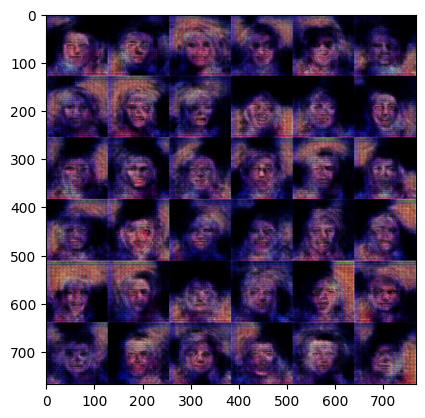

Training Progress:  60%|██████    | 9000/15000 [48:10<44:22,  2.25step/s]

****************************************************************************************************
1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|██████    | 9001/15000 [48:10<40:30,  2.47step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|██████    | 9002/15000 [48:11<37:34,  2.66step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  60%|██████    | 9003/15000 [48:11<35:42,  2.80step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  60%|██████    | 9004/15000 [48:11<34:14,  2.92step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  60%|██████    | 9005/15000 [48:12<33:15,  3.00step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|██████    | 9006/15000 [48:12<32:27,  3.08step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  60%|██████    | 9007/15000 [48:12<33:14,  3.01step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  60%|██████    | 9008/15000 [48:13<33:13,  3.01step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|██████    | 9009/15000 [48:13<32:28,  3.07step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|██████    | 9010/15000 [48:13<31:55,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  60%|██████    | 9011/15000 [48:14<31:32,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|██████    | 9012/15000 [48:14<31:17,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  60%|██████    | 9013/15000 [48:14<31:23,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|██████    | 9014/15000 [48:14<31:16,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  60%|██████    | 9015/15000 [48:15<31:08,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|██████    | 9016/15000 [48:15<31:03,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|██████    | 9017/15000 [48:15<30:55,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|██████    | 9018/15000 [48:16<30:48,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  60%|██████    | 9019/15000 [48:16<30:49,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  60%|██████    | 9020/15000 [48:16<30:46,  3.24step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  60%|██████    | 9021/15000 [48:17<30:47,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|██████    | 9022/15000 [48:17<30:53,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|██████    | 9023/15000 [48:17<31:07,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  60%|██████    | 9024/15000 [48:18<30:59,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|██████    | 9025/15000 [48:18<30:56,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|██████    | 9026/15000 [48:18<30:51,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|██████    | 9027/15000 [48:18<30:52,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  60%|██████    | 9028/15000 [48:19<30:49,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|██████    | 9029/15000 [48:19<30:50,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|██████    | 9030/15000 [48:19<30:50,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  60%|██████    | 9031/15000 [48:20<31:58,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  60%|██████    | 9032/15000 [48:20<32:44,  3.04step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|██████    | 9033/15000 [48:20<32:00,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|██████    | 9034/15000 [48:21<31:35,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|██████    | 9035/15000 [48:21<31:13,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|██████    | 9036/15000 [48:21<30:56,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  60%|██████    | 9037/15000 [48:22<30:52,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|██████    | 9038/15000 [48:22<30:47,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|██████    | 9039/15000 [48:22<30:59,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  60%|██████    | 9040/15000 [48:23<32:49,  3.03step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  60%|██████    | 9041/15000 [48:23<32:17,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|██████    | 9042/15000 [48:23<31:46,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|██████    | 9043/15000 [48:24<31:20,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|██████    | 9044/15000 [48:24<31:02,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|██████    | 9045/15000 [48:24<30:48,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|██████    | 9046/15000 [48:24<30:42,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|██████    | 9047/15000 [48:25<30:36,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|██████    | 9048/15000 [48:25<31:38,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|██████    | 9049/15000 [48:25<31:11,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|██████    | 9050/15000 [48:26<31:10,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  60%|██████    | 9051/15000 [48:26<30:59,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|██████    | 9052/15000 [48:26<31:51,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|██████    | 9053/15000 [48:27<31:26,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  60%|██████    | 9054/15000 [48:27<31:07,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|██████    | 9055/15000 [48:27<33:32,  2.95step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  60%|██████    | 9056/15000 [48:28<35:41,  2.78step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  60%|██████    | 9057/15000 [48:28<37:04,  2.67step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  60%|██████    | 9058/15000 [48:29<37:03,  2.67step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  60%|██████    | 9059/15000 [48:29<35:10,  2.81step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  60%|██████    | 9060/15000 [48:29<33:44,  2.93step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|██████    | 9061/15000 [48:30<32:43,  3.02step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|██████    | 9062/15000 [48:30<31:57,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|██████    | 9063/15000 [48:30<31:26,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|██████    | 9064/15000 [48:30<31:04,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|██████    | 9065/15000 [48:31<30:53,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|██████    | 9066/15000 [48:31<31:46,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  60%|██████    | 9067/15000 [48:31<32:21,  3.06step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  60%|██████    | 9068/15000 [48:32<31:56,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  60%|██████    | 9069/15000 [48:32<31:38,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  60%|██████    | 9070/15000 [48:32<32:34,  3.03step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|██████    | 9071/15000 [48:33<31:51,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|██████    | 9072/15000 [48:33<31:23,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|██████    | 9073/15000 [48:33<31:01,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|██████    | 9074/15000 [48:34<30:49,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  60%|██████    | 9075/15000 [48:34<30:37,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  61%|██████    | 9076/15000 [48:34<30:29,  3.24step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  61%|██████    | 9077/15000 [48:35<30:46,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████    | 9078/15000 [48:35<30:38,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████    | 9079/15000 [48:35<30:32,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  61%|██████    | 9080/15000 [48:36<31:32,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████    | 9081/15000 [48:36<31:09,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████    | 9082/15000 [48:36<30:50,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████    | 9083/15000 [48:36<30:40,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████    | 9084/15000 [48:37<30:32,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████    | 9085/15000 [48:37<30:26,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████    | 9086/15000 [48:37<30:20,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  61%|██████    | 9087/15000 [48:38<30:30,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  61%|██████    | 9088/15000 [48:38<30:28,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  61%|██████    | 9089/15000 [48:38<30:27,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████    | 9090/15000 [48:39<30:22,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████    | 9091/15000 [48:39<30:16,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████    | 9092/15000 [48:39<30:11,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████    | 9093/15000 [48:40<30:08,  3.27step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████    | 9094/15000 [48:40<30:07,  3.27step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████    | 9095/15000 [48:40<31:12,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  61%|██████    | 9096/15000 [48:40<31:01,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████    | 9097/15000 [48:41<30:49,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████    | 9098/15000 [48:41<31:41,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████    | 9099/15000 [48:41<32:18,  3.04step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  61%|██████    | 9100/15000 [48:42<32:45,  3.00step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████    | 9101/15000 [48:42<32:05,  3.06step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  61%|██████    | 9102/15000 [48:42<31:40,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  61%|██████    | 9103/15000 [48:43<32:24,  3.03step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████    | 9104/15000 [48:43<32:47,  3.00step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  61%|██████    | 9105/15000 [48:43<32:16,  3.04step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  61%|██████    | 9106/15000 [48:44<31:49,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████    | 9107/15000 [48:44<32:28,  3.02step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████    | 9108/15000 [48:44<31:46,  3.09step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  61%|██████    | 9109/15000 [48:45<31:21,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████    | 9110/15000 [48:45<30:59,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████    | 9111/15000 [48:45<30:44,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████    | 9112/15000 [48:46<31:38,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████    | 9113/15000 [48:46<31:13,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████    | 9114/15000 [48:46<31:03,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  61%|██████    | 9115/15000 [48:47<30:48,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  61%|██████    | 9116/15000 [48:47<30:33,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████    | 9117/15000 [48:47<30:25,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████    | 9118/15000 [48:48<30:18,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  61%|██████    | 9119/15000 [48:48<30:15,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████    | 9120/15000 [48:48<30:07,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████    | 9121/15000 [48:48<30:15,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████    | 9122/15000 [48:49<30:23,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  61%|██████    | 9123/15000 [48:49<31:42,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  61%|██████    | 9124/15000 [48:49<31:26,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  61%|██████    | 9125/15000 [48:50<31:09,  3.14step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  61%|██████    | 9126/15000 [48:50<30:54,  3.17step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  61%|██████    | 9127/15000 [48:50<30:47,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████    | 9128/15000 [48:51<30:35,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████    | 9129/15000 [48:51<30:29,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████    | 9130/15000 [48:51<31:26,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████    | 9131/15000 [48:52<31:04,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  61%|██████    | 9132/15000 [48:52<30:48,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  61%|██████    | 9133/15000 [48:52<30:59,  3.15step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  61%|██████    | 9134/15000 [48:53<31:33,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████    | 9135/15000 [48:53<31:09,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████    | 9136/15000 [48:53<30:47,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████    | 9137/15000 [48:54<30:32,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████    | 9138/15000 [48:54<30:21,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████    | 9139/15000 [48:54<30:16,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  61%|██████    | 9140/15000 [48:54<30:12,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  61%|██████    | 9141/15000 [48:55<30:17,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  61%|██████    | 9142/15000 [48:55<30:20,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  61%|██████    | 9143/15000 [48:55<31:22,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████    | 9144/15000 [48:56<30:57,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  61%|██████    | 9145/15000 [48:56<31:51,  3.06step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████    | 9146/15000 [48:56<31:13,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████    | 9147/15000 [48:57<30:50,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████    | 9148/15000 [48:57<30:31,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  61%|██████    | 9149/15000 [48:57<30:26,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████    | 9150/15000 [48:58<30:17,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  61%|██████    | 9151/15000 [48:58<30:28,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  61%|██████    | 9152/15000 [48:58<30:18,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  61%|██████    | 9153/15000 [48:59<30:17,  3.22step/s]

1/1 [==============================] - 0s 28ms/step


Training Progress:  61%|██████    | 9154/15000 [48:59<33:32,  2.90step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  61%|██████    | 9155/15000 [48:59<35:38,  2.73step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  61%|██████    | 9156/15000 [49:00<38:03,  2.56step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  61%|██████    | 9157/15000 [49:00<36:23,  2.68step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████    | 9158/15000 [49:01<35:31,  2.74step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  61%|██████    | 9159/15000 [49:01<34:01,  2.86step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████    | 9160/15000 [49:01<32:47,  2.97step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████    | 9161/15000 [49:01<32:06,  3.03step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  61%|██████    | 9162/15000 [49:02<31:27,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  61%|██████    | 9163/15000 [49:02<32:09,  3.03step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████    | 9164/15000 [49:02<32:35,  2.98step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████    | 9165/15000 [49:03<32:57,  2.95step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  61%|██████    | 9166/15000 [49:03<32:03,  3.03step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████    | 9167/15000 [49:03<31:26,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████    | 9168/15000 [49:04<30:55,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████    | 9169/15000 [49:04<30:34,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████    | 9170/15000 [49:04<30:28,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  61%|██████    | 9171/15000 [49:05<30:29,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  61%|██████    | 9172/15000 [49:05<30:29,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  61%|██████    | 9173/15000 [49:05<30:23,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  61%|██████    | 9174/15000 [49:06<31:16,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  61%|██████    | 9175/15000 [49:06<30:54,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████    | 9176/15000 [49:06<30:31,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████    | 9177/15000 [49:07<30:21,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████    | 9178/15000 [49:07<30:13,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  61%|██████    | 9179/15000 [49:07<30:19,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████    | 9180/15000 [49:07<30:15,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████    | 9181/15000 [49:08<30:05,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████    | 9182/15000 [49:08<30:05,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████    | 9183/15000 [49:08<29:52,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  61%|██████    | 9184/15000 [49:09<29:55,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████    | 9185/15000 [49:09<29:48,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████    | 9186/15000 [49:09<29:47,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████    | 9187/15000 [49:10<29:42,  3.26step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  61%|██████▏   | 9188/15000 [49:10<29:54,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  61%|██████▏   | 9189/15000 [49:10<29:52,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████▏   | 9190/15000 [49:11<29:52,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████▏   | 9191/15000 [49:11<29:47,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████▏   | 9192/15000 [49:11<29:48,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  61%|██████▏   | 9193/15000 [49:11<29:47,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████▏   | 9194/15000 [49:12<29:51,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████▏   | 9195/15000 [49:12<29:46,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████▏   | 9196/15000 [49:12<30:58,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  61%|██████▏   | 9197/15000 [49:13<30:35,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  61%|██████▏   | 9198/15000 [49:13<30:34,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  61%|██████▏   | 9199/15000 [49:13<30:20,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████▏   | 9200/15000 [49:14<30:11,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  61%|██████▏   | 9201/15000 [49:14<30:03,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████▏   | 9202/15000 [49:14<29:59,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████▏   | 9203/15000 [49:15<29:49,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  61%|██████▏   | 9204/15000 [49:15<29:50,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████▏   | 9205/15000 [49:15<29:44,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████▏   | 9206/15000 [49:16<29:47,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  61%|██████▏   | 9207/15000 [49:16<29:59,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  61%|██████▏   | 9208/15000 [49:16<29:58,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████▏   | 9209/15000 [49:17<30:56,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  61%|██████▏   | 9210/15000 [49:17<30:39,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████▏   | 9211/15000 [49:17<30:22,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████▏   | 9212/15000 [49:17<30:12,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████▏   | 9213/15000 [49:18<29:59,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  61%|██████▏   | 9214/15000 [49:18<30:06,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████▏   | 9215/15000 [49:18<29:59,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████▏   | 9216/15000 [49:19<30:03,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████▏   | 9217/15000 [49:19<29:53,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  61%|██████▏   | 9218/15000 [49:19<29:52,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  61%|██████▏   | 9219/15000 [49:20<29:50,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████▏   | 9220/15000 [49:20<29:47,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████▏   | 9221/15000 [49:20<29:39,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████▏   | 9222/15000 [49:21<30:41,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████▏   | 9223/15000 [49:21<30:22,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  61%|██████▏   | 9224/15000 [49:21<30:10,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  62%|██████▏   | 9225/15000 [49:21<30:05,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  62%|██████▏   | 9226/15000 [49:22<30:01,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  62%|██████▏   | 9227/15000 [49:22<29:51,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9228/15000 [49:22<30:00,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9229/15000 [49:23<29:52,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  62%|██████▏   | 9230/15000 [49:23<29:50,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9231/15000 [49:23<29:49,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9232/15000 [49:24<29:46,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  62%|██████▏   | 9233/15000 [49:24<29:52,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  62%|██████▏   | 9234/15000 [49:24<29:48,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9235/15000 [49:25<29:56,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9236/15000 [49:25<29:52,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  62%|██████▏   | 9237/15000 [49:25<29:49,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  62%|██████▏   | 9238/15000 [49:26<29:48,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  62%|██████▏   | 9239/15000 [49:26<29:48,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  62%|██████▏   | 9240/15000 [49:26<29:45,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9241/15000 [49:26<29:40,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9242/15000 [49:27<29:37,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9243/15000 [49:27<29:36,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9244/15000 [49:27<29:42,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9245/15000 [49:28<29:40,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  62%|██████▏   | 9246/15000 [49:28<29:40,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9247/15000 [49:28<29:38,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9248/15000 [49:29<29:34,  3.24step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  62%|██████▏   | 9249/15000 [49:29<29:47,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9250/15000 [49:29<30:41,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9251/15000 [49:30<30:21,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9252/15000 [49:30<30:09,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  62%|██████▏   | 9253/15000 [49:30<31:16,  3.06step/s]

1/1 [==============================] - 0s 27ms/step


Training Progress:  62%|██████▏   | 9254/15000 [49:31<35:13,  2.72step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  62%|██████▏   | 9255/15000 [49:31<36:31,  2.62step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  62%|██████▏   | 9256/15000 [49:32<36:21,  2.63step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9257/15000 [49:32<34:21,  2.79step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9258/15000 [49:32<33:00,  2.90step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  62%|██████▏   | 9259/15000 [49:32<32:13,  2.97step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9260/15000 [49:33<31:22,  3.05step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9261/15000 [49:33<30:43,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  62%|██████▏   | 9262/15000 [49:33<30:29,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  62%|██████▏   | 9263/15000 [49:34<30:08,  3.17step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  62%|██████▏   | 9264/15000 [49:34<29:59,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9265/15000 [49:34<29:44,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9266/15000 [49:35<29:35,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9267/15000 [49:35<29:31,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9268/15000 [49:35<29:23,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  62%|██████▏   | 9269/15000 [49:36<29:25,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  62%|██████▏   | 9270/15000 [49:36<29:33,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9271/15000 [49:36<29:27,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  62%|██████▏   | 9272/15000 [49:36<29:35,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  62%|██████▏   | 9273/15000 [49:37<29:30,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9274/15000 [49:37<30:29,  3.13step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  62%|██████▏   | 9275/15000 [49:37<30:10,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  62%|██████▏   | 9276/15000 [49:38<30:54,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9277/15000 [49:38<30:29,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9278/15000 [49:38<30:10,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  62%|██████▏   | 9279/15000 [49:39<29:57,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9280/15000 [49:39<29:55,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  62%|██████▏   | 9281/15000 [49:39<29:54,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9282/15000 [49:40<29:41,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9283/15000 [49:40<29:33,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  62%|██████▏   | 9284/15000 [49:40<29:29,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9285/15000 [49:41<29:24,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9286/15000 [49:41<29:23,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9287/15000 [49:41<30:21,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9288/15000 [49:41<30:02,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9289/15000 [49:42<29:54,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  62%|██████▏   | 9290/15000 [49:42<29:50,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  62%|██████▏   | 9291/15000 [49:42<30:02,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  62%|██████▏   | 9292/15000 [49:43<29:49,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  62%|██████▏   | 9293/15000 [49:43<29:44,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9294/15000 [49:43<29:39,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9295/15000 [49:44<29:27,  3.23step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:  62%|██████▏   | 9296/15000 [49:44<29:26,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9297/15000 [49:44<29:21,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9298/15000 [49:45<29:13,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9299/15000 [49:45<29:24,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  62%|██████▏   | 9300/15000 [49:45<29:18,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  62%|██████▏   | 9301/15000 [49:46<29:19,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  62%|██████▏   | 9302/15000 [49:46<29:17,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9303/15000 [49:46<29:19,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9304/15000 [49:46<29:18,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9305/15000 [49:47<29:16,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9306/15000 [49:47<29:20,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  62%|██████▏   | 9307/15000 [49:47<30:21,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9308/15000 [49:48<29:57,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  62%|██████▏   | 9309/15000 [49:48<29:53,  3.17step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  62%|██████▏   | 9310/15000 [49:48<29:42,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  62%|██████▏   | 9311/15000 [49:49<29:34,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  62%|██████▏   | 9312/15000 [49:49<29:24,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9313/15000 [49:49<29:19,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9314/15000 [49:50<29:15,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9315/15000 [49:50<29:17,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9316/15000 [49:50<29:15,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9317/15000 [49:50<29:10,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9318/15000 [49:51<30:21,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9319/15000 [49:51<29:54,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9320/15000 [49:51<30:40,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9321/15000 [49:52<30:13,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9322/15000 [49:52<29:48,  3.18step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  62%|██████▏   | 9323/15000 [49:52<30:42,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9324/15000 [49:53<30:11,  3.13step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  62%|██████▏   | 9325/15000 [49:53<30:06,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9326/15000 [49:53<29:48,  3.17step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  62%|██████▏   | 9327/15000 [49:54<29:52,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  62%|██████▏   | 9328/15000 [49:54<29:41,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9329/15000 [49:54<29:33,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9330/15000 [49:55<29:28,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9331/15000 [49:55<29:27,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  62%|██████▏   | 9332/15000 [49:55<29:22,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9333/15000 [49:56<29:14,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9334/15000 [49:56<29:11,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9335/15000 [49:56<30:08,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  62%|██████▏   | 9336/15000 [49:57<29:56,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  62%|██████▏   | 9337/15000 [49:57<29:44,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  62%|██████▏   | 9338/15000 [49:57<29:32,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9339/15000 [49:57<29:22,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9340/15000 [49:58<29:12,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9341/15000 [49:58<29:05,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9342/15000 [49:58<29:01,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9343/15000 [49:59<28:57,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9344/15000 [49:59<29:59,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9345/15000 [49:59<29:38,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  62%|██████▏   | 9346/15000 [50:00<29:36,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  62%|██████▏   | 9347/15000 [50:00<29:21,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9348/15000 [50:00<29:11,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9349/15000 [50:01<29:04,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9350/15000 [50:01<28:59,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9351/15000 [50:01<29:56,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9352/15000 [50:02<29:33,  3.18step/s]

1/1 [==============================] - 0s 28ms/step


Training Progress:  62%|██████▏   | 9353/15000 [50:02<32:38,  2.88step/s]

1/1 [==============================] - 0s 34ms/step


Training Progress:  62%|██████▏   | 9354/15000 [50:02<36:13,  2.60step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  62%|██████▏   | 9355/15000 [50:03<36:58,  2.54step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  62%|██████▏   | 9356/15000 [50:03<34:31,  2.72step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9357/15000 [50:03<32:49,  2.86step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9358/15000 [50:04<31:33,  2.98step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9359/15000 [50:04<30:51,  3.05step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  62%|██████▏   | 9360/15000 [50:04<30:17,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9361/15000 [50:05<29:50,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9362/15000 [50:05<29:40,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9363/15000 [50:05<29:29,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  62%|██████▏   | 9364/15000 [50:06<29:30,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  62%|██████▏   | 9365/15000 [50:06<29:31,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9366/15000 [50:06<29:21,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  62%|██████▏   | 9367/15000 [50:07<29:19,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9368/15000 [50:07<29:13,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  62%|██████▏   | 9369/15000 [50:07<29:10,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9370/15000 [50:07<29:01,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  62%|██████▏   | 9371/15000 [50:08<29:00,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9372/15000 [50:08<29:01,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▏   | 9373/15000 [50:08<29:01,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  62%|██████▏   | 9374/15000 [50:09<29:05,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  62%|██████▎   | 9375/15000 [50:09<29:08,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  63%|██████▎   | 9376/15000 [50:09<29:05,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9377/15000 [50:10<28:59,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9378/15000 [50:10<28:57,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9379/15000 [50:10<28:50,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9380/15000 [50:11<28:48,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9381/15000 [50:11<28:45,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9382/15000 [50:11<28:42,  3.26step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  63%|██████▎   | 9383/15000 [50:11<28:52,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9384/15000 [50:12<28:51,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9385/15000 [50:12<28:55,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9386/15000 [50:12<30:05,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9387/15000 [50:13<29:39,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  63%|██████▎   | 9388/15000 [50:13<29:19,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9389/15000 [50:13<30:09,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9390/15000 [50:14<29:45,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9391/15000 [50:14<29:30,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9392/15000 [50:14<29:28,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  63%|██████▎   | 9393/15000 [50:15<29:22,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  63%|██████▎   | 9394/15000 [50:15<29:14,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9395/15000 [50:15<29:05,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  63%|██████▎   | 9396/15000 [50:16<29:02,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9397/15000 [50:16<28:56,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9398/15000 [50:16<28:52,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9399/15000 [50:16<28:49,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9400/15000 [50:17<28:49,  3.24step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  63%|██████▎   | 9401/15000 [50:17<29:04,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  63%|██████▎   | 9402/15000 [50:17<29:10,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9403/15000 [50:18<29:03,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9404/15000 [50:18<29:03,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9405/15000 [50:18<28:57,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9406/15000 [50:19<28:54,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  63%|██████▎   | 9407/15000 [50:19<28:50,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9408/15000 [50:19<28:50,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9409/15000 [50:20<28:47,  3.24step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  63%|██████▎   | 9410/15000 [50:20<28:59,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9411/15000 [50:20<28:54,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  63%|██████▎   | 9412/15000 [50:21<28:53,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9413/15000 [50:21<28:49,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9414/15000 [50:21<28:45,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9415/15000 [50:21<28:43,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9416/15000 [50:22<28:40,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9417/15000 [50:22<29:35,  3.15step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  63%|██████▎   | 9418/15000 [50:22<30:26,  3.06step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9419/15000 [50:23<29:48,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  63%|██████▎   | 9420/15000 [50:23<29:40,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  63%|██████▎   | 9421/15000 [50:23<29:19,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  63%|██████▎   | 9422/15000 [50:24<29:10,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9423/15000 [50:24<29:55,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9424/15000 [50:24<29:33,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9425/15000 [50:25<29:13,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  63%|██████▎   | 9426/15000 [50:25<29:04,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  63%|██████▎   | 9427/15000 [50:25<28:59,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9428/15000 [50:26<28:50,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  63%|██████▎   | 9429/15000 [50:26<28:51,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  63%|██████▎   | 9430/15000 [50:26<28:50,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9431/15000 [50:26<28:45,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9432/15000 [50:27<28:42,  3.23step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  63%|██████▎   | 9433/15000 [50:27<28:42,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9434/15000 [50:27<28:40,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9435/15000 [50:28<28:32,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9436/15000 [50:28<28:30,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9437/15000 [50:28<28:28,  3.26step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  63%|██████▎   | 9438/15000 [50:29<28:40,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  63%|██████▎   | 9439/15000 [50:29<28:42,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  63%|██████▎   | 9440/15000 [50:29<28:43,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9441/15000 [50:30<28:39,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9442/15000 [50:30<28:38,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9443/15000 [50:30<28:32,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9444/15000 [50:31<28:33,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9445/15000 [50:31<28:31,  3.25step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  63%|██████▎   | 9446/15000 [50:31<28:31,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  63%|██████▎   | 9447/15000 [50:31<29:37,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9448/15000 [50:32<29:18,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9449/15000 [50:32<30:06,  3.07step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9450/15000 [50:32<29:37,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9451/15000 [50:33<29:18,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  63%|██████▎   | 9452/15000 [50:33<29:16,  3.16step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  63%|██████▎   | 9453/15000 [50:33<32:06,  2.88step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  63%|██████▎   | 9454/15000 [50:34<32:56,  2.81step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  63%|██████▎   | 9455/15000 [50:34<34:33,  2.67step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  63%|██████▎   | 9456/15000 [50:35<32:46,  2.82step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  63%|██████▎   | 9457/15000 [50:35<31:38,  2.92step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9458/15000 [50:35<30:44,  3.00step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9459/15000 [50:36<30:02,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  63%|██████▎   | 9460/15000 [50:36<29:39,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9461/15000 [50:36<29:14,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9462/15000 [50:36<29:59,  3.08step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  63%|██████▎   | 9463/15000 [50:37<29:33,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9464/15000 [50:37<29:16,  3.15step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  63%|██████▎   | 9465/15000 [50:37<29:12,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  63%|██████▎   | 9466/15000 [50:38<29:10,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  63%|██████▎   | 9467/15000 [50:38<28:57,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9468/15000 [50:38<28:50,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  63%|██████▎   | 9469/15000 [50:39<28:44,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9470/15000 [50:39<28:45,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  63%|██████▎   | 9471/15000 [50:39<28:45,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  63%|██████▎   | 9472/15000 [50:40<29:44,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  63%|██████▎   | 9473/15000 [50:40<29:20,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9474/15000 [50:40<29:05,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  63%|██████▎   | 9475/15000 [50:41<28:59,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9476/15000 [50:41<28:48,  3.20step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  63%|██████▎   | 9477/15000 [50:41<28:49,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9478/15000 [50:41<28:41,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9479/15000 [50:42<28:34,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9480/15000 [50:42<28:29,  3.23step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  63%|██████▎   | 9481/15000 [50:42<28:36,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  63%|██████▎   | 9482/15000 [50:43<28:32,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  63%|██████▎   | 9483/15000 [50:43<28:30,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9484/15000 [50:43<28:32,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  63%|██████▎   | 9485/15000 [50:44<28:29,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  63%|██████▎   | 9486/15000 [50:44<28:36,  3.21step/s]

1/1 [==============================] - 0s 30ms/step


Training Progress:  63%|██████▎   | 9487/15000 [50:44<29:56,  3.07step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9488/15000 [50:45<29:23,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9489/15000 [50:45<29:59,  3.06step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9490/15000 [50:45<29:27,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9491/15000 [50:46<30:03,  3.05step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  63%|██████▎   | 9492/15000 [50:46<29:31,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9493/15000 [50:46<29:04,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  63%|██████▎   | 9494/15000 [50:47<28:59,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9495/15000 [50:47<29:44,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9496/15000 [50:47<29:22,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9497/15000 [50:48<28:57,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9498/15000 [50:48<28:40,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  63%|██████▎   | 9499/15000 [50:48<28:38,  3.20step/s]

1/1 [==============================] - 0s 16ms/step
****************************************************************************************************
9500/15000: d_loss: 0.145548,  g_loss: 0.003270
2/2 [==============================] - 0s 20ms/step


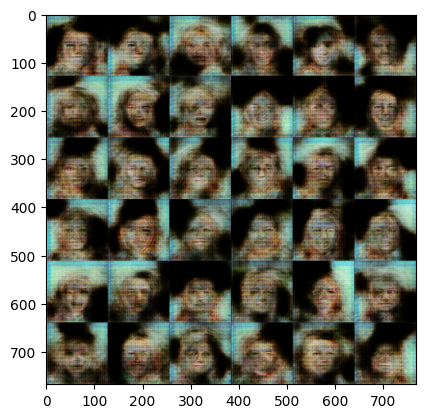

Training Progress:  63%|██████▎   | 9500/15000 [50:49<39:44,  2.31step/s]

****************************************************************************************************
1/1 [==============================] - 0s 17ms/step


Training Progress:  63%|██████▎   | 9501/15000 [50:49<36:30,  2.51step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9502/15000 [50:49<34:13,  2.68step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9503/15000 [50:50<32:26,  2.82step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9504/15000 [50:50<31:10,  2.94step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  63%|██████▎   | 9505/15000 [50:50<30:19,  3.02step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  63%|██████▎   | 9506/15000 [50:51<29:50,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  63%|██████▎   | 9507/15000 [50:51<30:28,  3.00step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  63%|██████▎   | 9508/15000 [50:51<29:57,  3.05step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9509/15000 [50:52<29:25,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9510/15000 [50:52<29:09,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9511/15000 [50:52<28:51,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  63%|██████▎   | 9512/15000 [50:53<29:04,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  63%|██████▎   | 9513/15000 [50:53<28:50,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  63%|██████▎   | 9514/15000 [50:53<28:39,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  63%|██████▎   | 9515/15000 [50:54<28:45,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  63%|██████▎   | 9516/15000 [50:54<29:39,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9517/15000 [50:54<29:16,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9518/15000 [50:55<28:55,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9519/15000 [50:55<28:42,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9520/15000 [50:55<28:31,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  63%|██████▎   | 9521/15000 [50:55<28:24,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9522/15000 [50:56<28:20,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  63%|██████▎   | 9523/15000 [50:56<28:16,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  63%|██████▎   | 9524/15000 [50:56<28:14,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  64%|██████▎   | 9525/15000 [50:57<28:23,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  64%|██████▎   | 9526/15000 [50:57<28:21,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  64%|██████▎   | 9527/15000 [50:57<28:21,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  64%|██████▎   | 9528/15000 [50:58<28:30,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  64%|██████▎   | 9529/15000 [50:58<28:24,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  64%|██████▎   | 9530/15000 [50:58<28:22,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  64%|██████▎   | 9531/15000 [50:59<28:17,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  64%|██████▎   | 9532/15000 [50:59<28:15,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  64%|██████▎   | 9533/15000 [50:59<28:15,  3.23step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  64%|██████▎   | 9534/15000 [51:00<29:31,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  64%|██████▎   | 9535/15000 [51:00<29:05,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  64%|██████▎   | 9536/15000 [51:00<28:50,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  64%|██████▎   | 9537/15000 [51:00<28:35,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  64%|██████▎   | 9538/15000 [51:01<28:32,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  64%|██████▎   | 9539/15000 [51:01<28:25,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  64%|██████▎   | 9540/15000 [51:01<28:21,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  64%|██████▎   | 9541/15000 [51:02<28:15,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  64%|██████▎   | 9542/15000 [51:02<29:13,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  64%|██████▎   | 9543/15000 [51:02<29:12,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  64%|██████▎   | 9544/15000 [51:03<28:53,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  64%|██████▎   | 9545/15000 [51:03<28:41,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  64%|██████▎   | 9546/15000 [51:03<28:35,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  64%|██████▎   | 9547/15000 [51:04<28:21,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  64%|██████▎   | 9548/15000 [51:04<28:12,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  64%|██████▎   | 9549/15000 [51:04<28:07,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  64%|██████▎   | 9550/15000 [51:05<30:39,  2.96step/s]

1/1 [==============================] - 0s 29ms/step


Training Progress:  64%|██████▎   | 9551/15000 [51:05<32:54,  2.76step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  64%|██████▎   | 9552/15000 [51:06<35:23,  2.57step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  64%|██████▎   | 9553/15000 [51:06<34:40,  2.62step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  64%|██████▎   | 9554/15000 [51:06<32:43,  2.77step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  64%|██████▎   | 9555/15000 [51:06<31:21,  2.89step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  64%|██████▎   | 9556/15000 [51:07<30:19,  2.99step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  64%|██████▎   | 9557/15000 [51:07<29:38,  3.06step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  64%|██████▎   | 9558/15000 [51:07<30:09,  3.01step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  64%|██████▎   | 9559/15000 [51:08<29:33,  3.07step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  64%|██████▎   | 9560/15000 [51:08<29:03,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  64%|██████▎   | 9561/15000 [51:08<28:44,  3.15step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  64%|██████▎   | 9562/15000 [51:09<28:40,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  64%|██████▍   | 9563/15000 [51:09<28:33,  3.17step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  64%|██████▍   | 9564/15000 [51:09<29:25,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  64%|██████▍   | 9565/15000 [51:10<28:58,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  64%|██████▍   | 9566/15000 [51:10<28:41,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  64%|██████▍   | 9567/15000 [51:10<28:32,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  64%|██████▍   | 9568/15000 [51:11<29:17,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  64%|██████▍   | 9569/15000 [51:11<29:47,  3.04step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  64%|██████▍   | 9570/15000 [51:11<29:15,  3.09step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  64%|██████▍   | 9571/15000 [51:12<29:00,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  64%|██████▍   | 9572/15000 [51:12<29:38,  3.05step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  64%|██████▍   | 9573/15000 [51:12<29:22,  3.08step/s]

1/1 [==============================] - 0s 31ms/step


Training Progress:  64%|██████▍   | 9574/15000 [51:13<29:57,  3.02step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  64%|██████▍   | 9575/15000 [51:13<29:24,  3.08step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  64%|██████▍   | 9576/15000 [51:13<29:04,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  64%|██████▍   | 9577/15000 [51:14<28:48,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  64%|██████▍   | 9578/15000 [51:14<28:31,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  64%|██████▍   | 9579/15000 [51:14<28:20,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  64%|██████▍   | 9580/15000 [51:15<29:21,  3.08step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  64%|██████▍   | 9581/15000 [51:15<28:56,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  64%|██████▍   | 9582/15000 [51:15<28:39,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  64%|██████▍   | 9583/15000 [51:15<28:27,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  64%|██████▍   | 9584/15000 [51:16<28:14,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  64%|██████▍   | 9585/15000 [51:16<28:08,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  64%|██████▍   | 9586/15000 [51:16<28:01,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  64%|██████▍   | 9587/15000 [51:17<28:02,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  64%|██████▍   | 9588/15000 [51:17<27:58,  3.22step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  64%|██████▍   | 9589/15000 [51:17<28:10,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  64%|██████▍   | 9590/15000 [51:18<28:07,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  64%|██████▍   | 9591/15000 [51:18<28:03,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  64%|██████▍   | 9592/15000 [51:18<27:56,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  64%|██████▍   | 9593/15000 [51:19<27:57,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  64%|██████▍   | 9594/15000 [51:19<27:54,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  64%|██████▍   | 9595/15000 [51:19<27:55,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  64%|██████▍   | 9596/15000 [51:19<27:52,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  64%|██████▍   | 9597/15000 [51:20<27:51,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  64%|██████▍   | 9598/15000 [51:20<27:45,  3.24step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  64%|██████▍   | 9599/15000 [51:20<27:56,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  64%|██████▍   | 9600/15000 [51:21<27:53,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  64%|██████▍   | 9601/15000 [51:21<28:50,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  64%|██████▍   | 9602/15000 [51:21<28:30,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  64%|██████▍   | 9603/15000 [51:22<28:15,  3.18step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  64%|██████▍   | 9604/15000 [51:22<28:07,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  64%|██████▍   | 9605/15000 [51:22<29:00,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  64%|██████▍   | 9606/15000 [51:23<28:50,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  64%|██████▍   | 9607/15000 [51:23<28:32,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  64%|██████▍   | 9608/15000 [51:23<28:28,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  64%|██████▍   | 9609/15000 [51:24<28:18,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  64%|██████▍   | 9610/15000 [51:24<28:08,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  64%|██████▍   | 9611/15000 [51:24<28:01,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  64%|██████▍   | 9612/15000 [51:25<27:54,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  64%|██████▍   | 9613/15000 [51:25<27:48,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  64%|██████▍   | 9614/15000 [51:25<27:43,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  64%|██████▍   | 9615/15000 [51:25<27:40,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  64%|██████▍   | 9616/15000 [51:26<27:37,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  64%|██████▍   | 9617/15000 [51:26<27:48,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  64%|██████▍   | 9618/15000 [51:26<27:53,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  64%|██████▍   | 9619/15000 [51:27<27:49,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  64%|██████▍   | 9620/15000 [51:27<28:42,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  64%|██████▍   | 9621/15000 [51:27<28:21,  3.16step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  64%|██████▍   | 9622/15000 [51:28<28:12,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  64%|██████▍   | 9623/15000 [51:28<28:02,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  64%|██████▍   | 9624/15000 [51:28<27:50,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  64%|██████▍   | 9625/15000 [51:29<27:43,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  64%|██████▍   | 9626/15000 [51:29<27:47,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  64%|██████▍   | 9627/15000 [51:29<27:44,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  64%|██████▍   | 9628/15000 [51:29<27:39,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  64%|██████▍   | 9629/15000 [51:30<27:33,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  64%|██████▍   | 9630/15000 [51:30<27:47,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  64%|██████▍   | 9631/15000 [51:30<27:41,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  64%|██████▍   | 9632/15000 [51:31<27:40,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  64%|██████▍   | 9633/15000 [51:31<28:37,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  64%|██████▍   | 9634/15000 [51:31<28:28,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  64%|██████▍   | 9635/15000 [51:32<28:11,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  64%|██████▍   | 9636/15000 [51:32<29:08,  3.07step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  64%|██████▍   | 9637/15000 [51:32<28:57,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  64%|██████▍   | 9638/15000 [51:33<29:33,  3.02step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  64%|██████▍   | 9639/15000 [51:33<28:57,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  64%|██████▍   | 9640/15000 [51:33<29:34,  3.02step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  64%|██████▍   | 9641/15000 [51:34<28:56,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  64%|██████▍   | 9642/15000 [51:34<28:34,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  64%|██████▍   | 9643/15000 [51:34<28:13,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  64%|██████▍   | 9644/15000 [51:35<28:00,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  64%|██████▍   | 9645/15000 [51:35<28:00,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  64%|██████▍   | 9646/15000 [51:35<27:59,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  64%|██████▍   | 9647/15000 [51:36<27:51,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  64%|██████▍   | 9648/15000 [51:36<27:56,  3.19step/s]

1/1 [==============================] - 0s 39ms/step


Training Progress:  64%|██████▍   | 9649/15000 [51:36<30:10,  2.96step/s]

1/1 [==============================] - 0s 27ms/step


Training Progress:  64%|██████▍   | 9650/15000 [51:37<32:14,  2.77step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  64%|██████▍   | 9651/15000 [51:37<31:34,  2.82step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  64%|██████▍   | 9652/15000 [51:37<30:44,  2.90step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  64%|██████▍   | 9653/15000 [51:38<29:38,  3.01step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  64%|██████▍   | 9654/15000 [51:38<29:09,  3.06step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  64%|██████▍   | 9655/15000 [51:38<28:38,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  64%|██████▍   | 9656/15000 [51:39<28:22,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  64%|██████▍   | 9657/15000 [51:39<28:02,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  64%|██████▍   | 9658/15000 [51:39<27:47,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  64%|██████▍   | 9659/15000 [51:40<28:34,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  64%|██████▍   | 9660/15000 [51:40<28:11,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  64%|██████▍   | 9661/15000 [51:40<27:52,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  64%|██████▍   | 9662/15000 [51:40<27:48,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  64%|██████▍   | 9663/15000 [51:41<27:48,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  64%|██████▍   | 9664/15000 [51:41<27:41,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  64%|██████▍   | 9665/15000 [51:41<27:35,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  64%|██████▍   | 9666/15000 [51:42<27:34,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  64%|██████▍   | 9667/15000 [51:42<28:28,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  64%|██████▍   | 9668/15000 [51:42<28:09,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  64%|██████▍   | 9669/15000 [51:43<27:50,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  64%|██████▍   | 9670/15000 [51:43<27:40,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  64%|██████▍   | 9671/15000 [51:43<27:33,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  64%|██████▍   | 9672/15000 [51:44<27:33,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  64%|██████▍   | 9673/15000 [51:44<28:32,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  64%|██████▍   | 9674/15000 [51:44<28:18,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  64%|██████▍   | 9675/15000 [51:45<29:03,  3.05step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  65%|██████▍   | 9676/15000 [51:45<29:34,  3.00step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  65%|██████▍   | 9677/15000 [51:45<28:55,  3.07step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  65%|██████▍   | 9678/15000 [51:46<28:29,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  65%|██████▍   | 9679/15000 [51:46<28:07,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  65%|██████▍   | 9680/15000 [51:46<27:53,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  65%|██████▍   | 9681/15000 [51:46<27:41,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  65%|██████▍   | 9682/15000 [51:47<27:41,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  65%|██████▍   | 9683/15000 [51:47<27:34,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  65%|██████▍   | 9684/15000 [51:47<27:30,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  65%|██████▍   | 9685/15000 [51:48<28:22,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  65%|██████▍   | 9686/15000 [51:48<28:00,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  65%|██████▍   | 9687/15000 [51:48<28:42,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  65%|██████▍   | 9688/15000 [51:49<28:12,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  65%|██████▍   | 9689/15000 [51:49<27:53,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  65%|██████▍   | 9690/15000 [51:49<27:41,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  65%|██████▍   | 9691/15000 [51:50<27:43,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  65%|██████▍   | 9692/15000 [51:50<27:36,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  65%|██████▍   | 9693/15000 [51:50<27:29,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  65%|██████▍   | 9694/15000 [51:51<27:27,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  65%|██████▍   | 9695/15000 [51:51<27:21,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  65%|██████▍   | 9696/15000 [51:51<27:21,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  65%|██████▍   | 9697/15000 [51:51<27:22,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  65%|██████▍   | 9698/15000 [51:52<27:18,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  65%|██████▍   | 9699/15000 [51:52<27:22,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  65%|██████▍   | 9700/15000 [51:52<27:38,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  65%|██████▍   | 9701/15000 [51:53<27:33,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  65%|██████▍   | 9702/15000 [51:53<27:26,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  65%|██████▍   | 9703/15000 [51:53<27:20,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  65%|██████▍   | 9704/15000 [51:54<27:17,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  65%|██████▍   | 9705/15000 [51:54<27:18,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  65%|██████▍   | 9706/15000 [51:54<27:11,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  65%|██████▍   | 9707/15000 [51:55<28:10,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  65%|██████▍   | 9708/15000 [51:55<27:47,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  65%|██████▍   | 9709/15000 [51:55<27:37,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  65%|██████▍   | 9710/15000 [51:56<27:39,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  65%|██████▍   | 9711/15000 [51:56<27:30,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  65%|██████▍   | 9712/15000 [51:56<27:19,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  65%|██████▍   | 9713/15000 [51:56<27:17,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  65%|██████▍   | 9714/15000 [51:57<27:13,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  65%|██████▍   | 9715/15000 [51:57<27:10,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  65%|██████▍   | 9716/15000 [51:57<27:08,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  65%|██████▍   | 9717/15000 [51:58<27:03,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  65%|██████▍   | 9718/15000 [51:58<26:59,  3.26step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  65%|██████▍   | 9719/15000 [51:58<27:11,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  65%|██████▍   | 9720/15000 [51:59<27:09,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  65%|██████▍   | 9721/15000 [51:59<27:06,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  65%|██████▍   | 9722/15000 [51:59<27:03,  3.25step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  65%|██████▍   | 9723/15000 [52:00<27:10,  3.24step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  65%|██████▍   | 9724/15000 [52:00<27:22,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  65%|██████▍   | 9725/15000 [52:00<27:17,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  65%|██████▍   | 9726/15000 [52:00<27:19,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  65%|██████▍   | 9727/15000 [52:01<27:11,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  65%|██████▍   | 9728/15000 [52:01<27:17,  3.22step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  65%|██████▍   | 9729/15000 [52:02<34:54,  2.52step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  65%|██████▍   | 9730/15000 [52:02<33:37,  2.61step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  65%|██████▍   | 9731/15000 [52:02<31:52,  2.75step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  65%|██████▍   | 9732/15000 [52:03<30:37,  2.87step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  65%|██████▍   | 9733/15000 [52:03<29:42,  2.95step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  65%|██████▍   | 9734/15000 [52:03<29:08,  3.01step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  65%|██████▍   | 9735/15000 [52:04<28:39,  3.06step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  65%|██████▍   | 9736/15000 [52:04<28:26,  3.09step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  65%|██████▍   | 9737/15000 [52:04<28:15,  3.10step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  65%|██████▍   | 9738/15000 [52:05<29:17,  2.99step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  65%|██████▍   | 9739/15000 [52:05<28:48,  3.04step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  65%|██████▍   | 9740/15000 [52:05<29:23,  2.98step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  65%|██████▍   | 9741/15000 [52:06<28:55,  3.03step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  65%|██████▍   | 9742/15000 [52:06<28:33,  3.07step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  65%|██████▍   | 9743/15000 [52:06<28:45,  3.05step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  65%|██████▍   | 9744/15000 [52:07<28:25,  3.08step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  65%|██████▍   | 9745/15000 [52:07<28:09,  3.11step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  65%|██████▍   | 9746/15000 [52:07<28:02,  3.12step/s]

1/1 [==============================] - 0s 37ms/step


Training Progress:  65%|██████▍   | 9747/15000 [52:08<30:08,  2.91step/s]

1/1 [==============================] - 0s 30ms/step


Training Progress:  65%|██████▍   | 9748/15000 [52:08<32:24,  2.70step/s]

1/1 [==============================] - 0s 29ms/step


Training Progress:  65%|██████▍   | 9749/15000 [52:08<32:43,  2.67step/s]

1/1 [==============================] - 0s 30ms/step


Training Progress:  65%|██████▌   | 9750/15000 [52:09<32:45,  2.67step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  65%|██████▌   | 9751/15000 [52:09<31:14,  2.80step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  65%|██████▌   | 9752/15000 [52:09<30:13,  2.89step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  65%|██████▌   | 9753/15000 [52:10<29:22,  2.98step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  65%|██████▌   | 9754/15000 [52:10<28:48,  3.04step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  65%|██████▌   | 9755/15000 [52:10<28:26,  3.07step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  65%|██████▌   | 9756/15000 [52:11<28:28,  3.07step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  65%|██████▌   | 9757/15000 [52:11<28:10,  3.10step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  65%|██████▌   | 9758/15000 [52:11<27:58,  3.12step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  65%|██████▌   | 9759/15000 [52:12<27:48,  3.14step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  65%|██████▌   | 9760/15000 [52:12<27:43,  3.15step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  65%|██████▌   | 9761/15000 [52:12<28:00,  3.12step/s]

1/1 [==============================] - 0s 30ms/step


Training Progress:  65%|██████▌   | 9762/15000 [52:13<28:44,  3.04step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  65%|██████▌   | 9763/15000 [52:13<28:19,  3.08step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  65%|██████▌   | 9764/15000 [52:13<29:03,  3.00step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  65%|██████▌   | 9765/15000 [52:14<28:45,  3.03step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  65%|██████▌   | 9766/15000 [52:14<29:18,  2.98step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  65%|██████▌   | 9767/15000 [52:14<28:41,  3.04step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  65%|██████▌   | 9768/15000 [52:15<28:37,  3.05step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  65%|██████▌   | 9769/15000 [52:15<28:14,  3.09step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  65%|██████▌   | 9770/15000 [52:15<28:00,  3.11step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  65%|██████▌   | 9771/15000 [52:16<27:52,  3.13step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  65%|██████▌   | 9772/15000 [52:16<27:45,  3.14step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  65%|██████▌   | 9773/15000 [52:16<28:32,  3.05step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  65%|██████▌   | 9774/15000 [52:17<28:31,  3.05step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  65%|██████▌   | 9775/15000 [52:17<28:10,  3.09step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  65%|██████▌   | 9776/15000 [52:17<28:00,  3.11step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  65%|██████▌   | 9777/15000 [52:18<28:47,  3.02step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  65%|██████▌   | 9778/15000 [52:18<28:19,  3.07step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  65%|██████▌   | 9779/15000 [52:18<27:58,  3.11step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  65%|██████▌   | 9780/15000 [52:18<27:48,  3.13step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  65%|██████▌   | 9781/15000 [52:19<27:38,  3.15step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  65%|██████▌   | 9782/15000 [52:19<27:37,  3.15step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  65%|██████▌   | 9783/15000 [52:19<27:43,  3.14step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  65%|██████▌   | 9784/15000 [52:20<27:39,  3.14step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  65%|██████▌   | 9785/15000 [52:20<27:32,  3.16step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  65%|██████▌   | 9786/15000 [52:20<27:33,  3.15step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  65%|██████▌   | 9787/15000 [52:21<27:31,  3.16step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  65%|██████▌   | 9788/15000 [52:21<27:33,  3.15step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  65%|██████▌   | 9789/15000 [52:21<28:21,  3.06step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  65%|██████▌   | 9790/15000 [52:22<28:02,  3.10step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  65%|██████▌   | 9791/15000 [52:22<28:39,  3.03step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  65%|██████▌   | 9792/15000 [52:22<28:28,  3.05step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  65%|██████▌   | 9793/15000 [52:23<28:11,  3.08step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  65%|██████▌   | 9794/15000 [52:23<27:56,  3.10step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  65%|██████▌   | 9795/15000 [52:23<27:45,  3.13step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  65%|██████▌   | 9796/15000 [52:24<27:34,  3.14step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  65%|██████▌   | 9797/15000 [52:24<27:32,  3.15step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  65%|██████▌   | 9798/15000 [52:24<27:20,  3.17step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  65%|██████▌   | 9799/15000 [52:25<27:10,  3.19step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  65%|██████▌   | 9800/15000 [52:25<27:09,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  65%|██████▌   | 9801/15000 [52:25<27:13,  3.18step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  65%|██████▌   | 9802/15000 [52:25<27:12,  3.18step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  65%|██████▌   | 9803/15000 [52:26<27:09,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  65%|██████▌   | 9804/15000 [52:26<27:09,  3.19step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  65%|██████▌   | 9805/15000 [52:26<27:05,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  65%|██████▌   | 9806/15000 [52:27<27:16,  3.17step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  65%|██████▌   | 9807/15000 [52:27<27:14,  3.18step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  65%|██████▌   | 9808/15000 [52:27<27:09,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  65%|██████▌   | 9809/15000 [52:28<27:01,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  65%|██████▌   | 9810/15000 [52:28<27:08,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  65%|██████▌   | 9811/15000 [52:28<27:03,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  65%|██████▌   | 9812/15000 [52:29<27:00,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  65%|██████▌   | 9813/15000 [52:29<26:55,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  65%|██████▌   | 9814/15000 [52:29<26:55,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  65%|██████▌   | 9815/15000 [52:30<26:59,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  65%|██████▌   | 9816/15000 [52:30<26:54,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  65%|██████▌   | 9817/15000 [52:30<26:49,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  65%|██████▌   | 9818/15000 [52:30<26:48,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  65%|██████▌   | 9819/15000 [52:31<26:46,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  65%|██████▌   | 9820/15000 [52:31<26:58,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  65%|██████▌   | 9821/15000 [52:31<26:51,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  65%|██████▌   | 9822/15000 [52:32<26:51,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  65%|██████▌   | 9823/15000 [52:32<26:50,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  65%|██████▌   | 9824/15000 [52:32<26:57,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  66%|██████▌   | 9825/15000 [52:33<27:51,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  66%|██████▌   | 9826/15000 [52:33<27:46,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  66%|██████▌   | 9827/15000 [52:33<27:37,  3.12step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  66%|██████▌   | 9828/15000 [52:34<27:22,  3.15step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  66%|██████▌   | 9829/15000 [52:34<27:27,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  66%|██████▌   | 9830/15000 [52:34<27:17,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  66%|██████▌   | 9831/15000 [52:35<27:08,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  66%|██████▌   | 9832/15000 [52:35<28:03,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  66%|██████▌   | 9833/15000 [52:35<27:36,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  66%|██████▌   | 9834/15000 [52:36<27:23,  3.14step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  66%|██████▌   | 9835/15000 [52:36<27:16,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  66%|██████▌   | 9836/15000 [52:36<27:06,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  66%|██████▌   | 9837/15000 [52:36<26:56,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  66%|██████▌   | 9838/15000 [52:37<28:01,  3.07step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  66%|██████▌   | 9839/15000 [52:37<27:41,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  66%|██████▌   | 9840/15000 [52:37<27:43,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  66%|██████▌   | 9841/15000 [52:38<27:19,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  66%|██████▌   | 9842/15000 [52:38<27:00,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  66%|██████▌   | 9843/15000 [52:38<26:50,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  66%|██████▌   | 9844/15000 [52:39<27:42,  3.10step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  66%|██████▌   | 9845/15000 [52:39<31:07,  2.76step/s]

1/1 [==============================] - 0s 31ms/step


Training Progress:  66%|██████▌   | 9846/15000 [52:40<31:54,  2.69step/s]

1/1 [==============================] - 0s 29ms/step


Training Progress:  66%|██████▌   | 9847/15000 [52:40<33:26,  2.57step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  66%|██████▌   | 9848/15000 [52:40<31:24,  2.73step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  66%|██████▌   | 9849/15000 [52:41<29:58,  2.86step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  66%|██████▌   | 9850/15000 [52:41<28:52,  2.97step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  66%|██████▌   | 9851/15000 [52:41<28:08,  3.05step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  66%|██████▌   | 9852/15000 [52:42<27:41,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  66%|██████▌   | 9853/15000 [52:42<27:14,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  66%|██████▌   | 9854/15000 [52:42<26:59,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  66%|██████▌   | 9855/15000 [52:43<28:07,  3.05step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  66%|██████▌   | 9856/15000 [52:43<27:37,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  66%|██████▌   | 9857/15000 [52:43<27:29,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  66%|██████▌   | 9858/15000 [52:43<27:14,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  66%|██████▌   | 9859/15000 [52:44<26:58,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  66%|██████▌   | 9860/15000 [52:44<26:50,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  66%|██████▌   | 9861/15000 [52:44<27:36,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  66%|██████▌   | 9862/15000 [52:45<27:15,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  66%|██████▌   | 9863/15000 [52:45<26:57,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  66%|██████▌   | 9864/15000 [52:45<26:45,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  66%|██████▌   | 9865/15000 [52:46<26:35,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  66%|██████▌   | 9866/15000 [52:46<26:39,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  66%|██████▌   | 9867/15000 [52:46<26:34,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  66%|██████▌   | 9868/15000 [52:47<26:28,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  66%|██████▌   | 9869/15000 [52:47<27:16,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  66%|██████▌   | 9870/15000 [52:47<26:55,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  66%|██████▌   | 9871/15000 [52:48<26:43,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  66%|██████▌   | 9872/15000 [52:48<26:33,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  66%|██████▌   | 9873/15000 [52:48<26:30,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  66%|██████▌   | 9874/15000 [52:49<27:24,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  66%|██████▌   | 9875/15000 [52:49<27:13,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  66%|██████▌   | 9876/15000 [52:49<26:59,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  66%|██████▌   | 9877/15000 [52:49<26:48,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  66%|██████▌   | 9878/15000 [52:50<27:34,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  66%|██████▌   | 9879/15000 [52:50<27:11,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  66%|██████▌   | 9880/15000 [52:50<26:57,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  66%|██████▌   | 9881/15000 [52:51<27:46,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  66%|██████▌   | 9882/15000 [52:51<27:18,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  66%|██████▌   | 9883/15000 [52:51<26:59,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  66%|██████▌   | 9884/15000 [52:52<26:53,  3.17step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  66%|██████▌   | 9885/15000 [52:52<27:43,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  66%|██████▌   | 9886/15000 [52:52<28:18,  3.01step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  66%|██████▌   | 9887/15000 [52:53<27:40,  3.08step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  66%|██████▌   | 9888/15000 [52:53<27:18,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  66%|██████▌   | 9889/15000 [52:53<27:00,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  66%|██████▌   | 9890/15000 [52:54<26:50,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  66%|██████▌   | 9891/15000 [52:54<26:38,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  66%|██████▌   | 9892/15000 [52:54<26:30,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  66%|██████▌   | 9893/15000 [52:55<26:27,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  66%|██████▌   | 9894/15000 [52:55<26:33,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  66%|██████▌   | 9895/15000 [52:55<26:28,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  66%|██████▌   | 9896/15000 [52:55<26:22,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  66%|██████▌   | 9897/15000 [52:56<26:20,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  66%|██████▌   | 9898/15000 [52:56<26:18,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  66%|██████▌   | 9899/15000 [52:56<26:20,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  66%|██████▌   | 9900/15000 [52:57<26:18,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  66%|██████▌   | 9901/15000 [52:57<26:17,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  66%|██████▌   | 9902/15000 [52:57<26:15,  3.24step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  66%|██████▌   | 9903/15000 [52:58<26:37,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  66%|██████▌   | 9904/15000 [52:58<26:34,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  66%|██████▌   | 9905/15000 [52:58<26:31,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  66%|██████▌   | 9906/15000 [52:59<26:29,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  66%|██████▌   | 9907/15000 [52:59<26:23,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  66%|██████▌   | 9908/15000 [52:59<26:19,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  66%|██████▌   | 9909/15000 [53:00<26:19,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  66%|██████▌   | 9910/15000 [53:00<26:19,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  66%|██████▌   | 9911/15000 [53:00<26:13,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  66%|██████▌   | 9912/15000 [53:00<26:21,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  66%|██████▌   | 9913/15000 [53:01<26:16,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  66%|██████▌   | 9914/15000 [53:01<26:15,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  66%|██████▌   | 9915/15000 [53:01<26:16,  3.23step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  66%|██████▌   | 9916/15000 [53:02<27:15,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  66%|██████▌   | 9917/15000 [53:02<27:54,  3.04step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  66%|██████▌   | 9918/15000 [53:02<27:48,  3.05step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  66%|██████▌   | 9919/15000 [53:03<27:25,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  66%|██████▌   | 9920/15000 [53:03<27:02,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  66%|██████▌   | 9921/15000 [53:03<26:55,  3.14step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  66%|██████▌   | 9922/15000 [53:04<26:47,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  66%|██████▌   | 9923/15000 [53:04<26:35,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  66%|██████▌   | 9924/15000 [53:04<26:30,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  66%|██████▌   | 9925/15000 [53:05<26:24,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  66%|██████▌   | 9926/15000 [53:05<26:20,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  66%|██████▌   | 9927/15000 [53:05<26:14,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  66%|██████▌   | 9928/15000 [53:05<26:12,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  66%|██████▌   | 9929/15000 [53:06<26:08,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  66%|██████▌   | 9930/15000 [53:06<26:06,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  66%|██████▌   | 9931/15000 [53:06<26:15,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  66%|██████▌   | 9932/15000 [53:07<26:12,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  66%|██████▌   | 9933/15000 [53:07<26:10,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  66%|██████▌   | 9934/15000 [53:07<26:09,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  66%|██████▌   | 9935/15000 [53:08<26:06,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  66%|██████▌   | 9936/15000 [53:08<26:05,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  66%|██████▌   | 9937/15000 [53:08<26:01,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  66%|██████▋   | 9938/15000 [53:09<26:03,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  66%|██████▋   | 9939/15000 [53:09<26:54,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  66%|██████▋   | 9940/15000 [53:09<26:46,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  66%|██████▋   | 9941/15000 [53:10<26:29,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  66%|██████▋   | 9942/15000 [53:10<26:22,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  66%|██████▋   | 9943/15000 [53:10<28:12,  2.99step/s]

1/1 [==============================] - 0s 42ms/step


Training Progress:  66%|██████▋   | 9944/15000 [53:11<29:48,  2.83step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  66%|██████▋   | 9945/15000 [53:11<32:10,  2.62step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  66%|██████▋   | 9946/15000 [53:11<32:07,  2.62step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  66%|██████▋   | 9947/15000 [53:12<30:12,  2.79step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  66%|██████▋   | 9948/15000 [53:12<29:00,  2.90step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  66%|██████▋   | 9949/15000 [53:12<28:23,  2.97step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  66%|██████▋   | 9950/15000 [53:13<27:45,  3.03step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  66%|██████▋   | 9951/15000 [53:13<27:09,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  66%|██████▋   | 9952/15000 [53:13<26:54,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  66%|██████▋   | 9953/15000 [53:14<26:31,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  66%|██████▋   | 9954/15000 [53:14<26:19,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  66%|██████▋   | 9955/15000 [53:14<26:07,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  66%|██████▋   | 9956/15000 [53:15<26:03,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  66%|██████▋   | 9957/15000 [53:15<25:54,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  66%|██████▋   | 9958/15000 [53:15<26:00,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  66%|██████▋   | 9959/15000 [53:15<25:54,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  66%|██████▋   | 9960/15000 [53:16<26:45,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  66%|██████▋   | 9961/15000 [53:16<26:25,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  66%|██████▋   | 9962/15000 [53:16<26:15,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  66%|██████▋   | 9963/15000 [53:17<26:12,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  66%|██████▋   | 9964/15000 [53:17<27:01,  3.10step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  66%|██████▋   | 9965/15000 [53:17<26:42,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  66%|██████▋   | 9966/15000 [53:18<26:28,  3.17step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  66%|██████▋   | 9967/15000 [53:18<26:18,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  66%|██████▋   | 9968/15000 [53:18<26:21,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  66%|██████▋   | 9969/15000 [53:19<26:10,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  66%|██████▋   | 9970/15000 [53:19<26:04,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  66%|██████▋   | 9971/15000 [53:19<25:54,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  66%|██████▋   | 9972/15000 [53:20<25:57,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  66%|██████▋   | 9973/15000 [53:20<25:54,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  66%|██████▋   | 9974/15000 [53:20<25:55,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  66%|██████▋   | 9975/15000 [53:21<25:55,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 9976/15000 [53:21<25:54,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  67%|██████▋   | 9977/15000 [53:21<26:01,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 9978/15000 [53:21<25:53,  3.23step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  67%|██████▋   | 9979/15000 [53:22<25:53,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  67%|██████▋   | 9980/15000 [53:22<25:50,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 9981/15000 [53:22<26:47,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  67%|██████▋   | 9982/15000 [53:23<26:34,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  67%|██████▋   | 9983/15000 [53:23<26:17,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 9984/15000 [53:23<26:03,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 9985/15000 [53:24<25:53,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  67%|██████▋   | 9986/15000 [53:24<25:53,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 9987/15000 [53:24<25:44,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 9988/15000 [53:25<25:39,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 9989/15000 [53:25<25:37,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 9990/15000 [53:25<25:33,  3.27step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 9991/15000 [53:25<25:29,  3.28step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  67%|██████▋   | 9992/15000 [53:26<25:30,  3.27step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 9993/15000 [53:26<25:31,  3.27step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:  67%|██████▋   | 9994/15000 [53:26<25:29,  3.27step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  67%|██████▋   | 9995/15000 [53:27<25:35,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 9996/15000 [53:27<25:35,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 9997/15000 [53:27<25:32,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 9998/15000 [53:28<26:23,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  67%|██████▋   | 9999/15000 [53:28<26:07,  3.19step/s]

1/1 [==============================] - 0s 16ms/step
****************************************************************************************************
10000/15000: d_loss: 0.144479,  g_loss: 0.069194
2/2 [==============================] - 0s 20ms/step


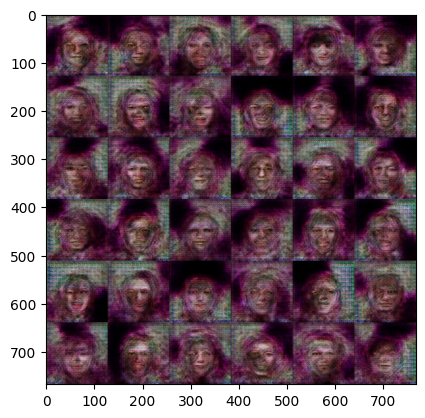

Training Progress:  67%|██████▋   | 10000/15000 [53:29<36:24,  2.29step/s]

****************************************************************************************************
1/1 [==============================] - 0s 17ms/step


Training Progress:  67%|██████▋   | 10001/15000 [53:29<33:22,  2.50step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10002/15000 [53:29<31:02,  2.68step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10003/15000 [53:30<30:17,  2.75step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  67%|██████▋   | 10004/15000 [53:30<28:55,  2.88step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10005/15000 [53:30<27:56,  2.98step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10006/15000 [53:31<28:05,  2.96step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10007/15000 [53:31<27:20,  3.04step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10008/15000 [53:31<26:57,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  67%|██████▋   | 10009/15000 [53:32<26:37,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10010/15000 [53:32<26:18,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  67%|██████▋   | 10011/15000 [53:32<26:07,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10012/15000 [53:32<26:07,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10013/15000 [53:33<25:57,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  67%|██████▋   | 10014/15000 [53:33<25:53,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10015/15000 [53:33<25:45,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10016/15000 [53:34<25:38,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10017/15000 [53:34<25:45,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10018/15000 [53:34<25:44,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  67%|██████▋   | 10019/15000 [53:35<25:41,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10020/15000 [53:35<25:42,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10021/15000 [53:35<25:38,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10022/15000 [53:36<25:35,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10023/15000 [53:36<25:34,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  67%|██████▋   | 10024/15000 [53:36<25:35,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10025/15000 [53:36<25:32,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  67%|██████▋   | 10026/15000 [53:37<25:40,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  67%|██████▋   | 10027/15000 [53:37<25:41,  3.23step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  67%|██████▋   | 10028/15000 [53:37<25:46,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10029/15000 [53:38<25:40,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  67%|██████▋   | 10030/15000 [53:38<25:37,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10031/15000 [53:38<25:36,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10032/15000 [53:39<25:36,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10033/15000 [53:39<25:32,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10034/15000 [53:39<25:32,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  67%|██████▋   | 10035/15000 [53:40<26:28,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  67%|██████▋   | 10036/15000 [53:40<26:22,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10037/15000 [53:40<26:07,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10038/15000 [53:41<26:49,  3.08step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  67%|██████▋   | 10039/15000 [53:41<26:27,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10040/15000 [53:41<26:08,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10041/15000 [53:41<25:55,  3.19step/s]

1/1 [==============================] - 0s 27ms/step


Training Progress:  67%|██████▋   | 10042/15000 [53:42<28:54,  2.86step/s]

1/1 [==============================] - 0s 39ms/step


Training Progress:  67%|██████▋   | 10043/15000 [53:42<30:50,  2.68step/s]

1/1 [==============================] - 0s 23ms/step


Training Progress:  67%|██████▋   | 10044/15000 [53:43<30:48,  2.68step/s]

1/1 [==============================] - 0s 30ms/step


Training Progress:  67%|██████▋   | 10045/15000 [53:43<31:05,  2.66step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  67%|██████▋   | 10046/15000 [53:43<29:27,  2.80step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10047/15000 [53:44<28:13,  2.92step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  67%|██████▋   | 10048/15000 [53:44<28:14,  2.92step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  67%|██████▋   | 10049/15000 [53:44<27:26,  3.01step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10050/15000 [53:45<26:47,  3.08step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  67%|██████▋   | 10051/15000 [53:45<26:25,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10052/15000 [53:45<26:05,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10053/15000 [53:46<26:52,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  67%|██████▋   | 10054/15000 [53:46<26:35,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10055/15000 [53:46<27:08,  3.04step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  67%|██████▋   | 10056/15000 [53:47<26:39,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10057/15000 [53:47<26:14,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10058/15000 [53:47<26:52,  3.06step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10059/15000 [53:48<26:24,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10060/15000 [53:48<26:09,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10061/15000 [53:48<25:49,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10062/15000 [53:49<25:41,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  67%|██████▋   | 10063/15000 [53:49<25:41,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  67%|██████▋   | 10064/15000 [53:49<25:37,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10065/15000 [53:49<25:28,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10066/15000 [53:50<25:27,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  67%|██████▋   | 10067/15000 [53:50<25:27,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10068/15000 [53:50<25:26,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10069/15000 [53:51<25:17,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10070/15000 [53:51<25:14,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  67%|██████▋   | 10071/15000 [53:51<25:12,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10072/15000 [53:52<25:14,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10073/15000 [53:52<25:21,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10074/15000 [53:52<25:24,  3.23step/s]

1/1 [==============================] - 0s 27ms/step


Training Progress:  67%|██████▋   | 10075/15000 [53:53<26:42,  3.07step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10076/15000 [53:53<26:17,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  67%|██████▋   | 10077/15000 [53:53<25:56,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10078/15000 [53:53<25:42,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  67%|██████▋   | 10079/15000 [53:54<25:37,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10080/15000 [53:54<25:29,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10081/15000 [53:54<25:20,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  67%|██████▋   | 10082/15000 [53:55<25:28,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  67%|██████▋   | 10083/15000 [53:55<25:24,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10084/15000 [53:55<26:15,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10085/15000 [53:56<25:55,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10086/15000 [53:56<25:43,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10087/15000 [53:56<25:34,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10088/15000 [53:57<25:25,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10089/15000 [53:57<25:19,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10090/15000 [53:57<25:17,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  67%|██████▋   | 10091/15000 [53:58<25:19,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  67%|██████▋   | 10092/15000 [53:58<25:20,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  67%|██████▋   | 10093/15000 [53:58<26:10,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10094/15000 [53:59<25:50,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  67%|██████▋   | 10095/15000 [53:59<25:36,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10096/15000 [53:59<26:17,  3.11step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  67%|██████▋   | 10097/15000 [53:59<26:50,  3.04step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10098/15000 [54:00<26:22,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10099/15000 [54:00<25:56,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  67%|██████▋   | 10100/15000 [54:00<25:50,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10101/15000 [54:01<25:34,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10102/15000 [54:01<26:21,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10103/15000 [54:01<25:55,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10104/15000 [54:02<25:38,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10105/15000 [54:02<25:28,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  67%|██████▋   | 10106/15000 [54:02<25:24,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  67%|██████▋   | 10107/15000 [54:03<25:31,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  67%|██████▋   | 10108/15000 [54:03<25:23,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10109/15000 [54:03<25:16,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  67%|██████▋   | 10110/15000 [54:04<25:22,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  67%|██████▋   | 10111/15000 [54:04<26:12,  3.11step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  67%|██████▋   | 10112/15000 [54:04<25:52,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10113/15000 [54:05<25:33,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10114/15000 [54:05<25:20,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10115/15000 [54:05<25:12,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10116/15000 [54:05<25:05,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10117/15000 [54:06<25:02,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10118/15000 [54:06<25:52,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10119/15000 [54:06<25:41,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  67%|██████▋   | 10120/15000 [54:07<25:27,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10121/15000 [54:07<25:17,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10122/15000 [54:07<25:14,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10123/15000 [54:08<25:07,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  67%|██████▋   | 10124/15000 [54:08<25:09,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10125/15000 [54:08<25:04,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10126/15000 [54:09<25:06,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10127/15000 [54:09<25:01,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  68%|██████▊   | 10128/15000 [54:09<25:11,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  68%|██████▊   | 10129/15000 [54:09<25:05,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10130/15000 [54:10<25:03,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10131/15000 [54:10<24:59,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10132/15000 [54:10<24:57,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10133/15000 [54:11<24:52,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10134/15000 [54:11<24:55,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10135/15000 [54:11<24:51,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10136/15000 [54:12<24:52,  3.26step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  68%|██████▊   | 10137/15000 [54:12<25:01,  3.24step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  68%|██████▊   | 10138/15000 [54:12<25:16,  3.21step/s]

1/1 [==============================] - 0s 30ms/step


Training Progress:  68%|██████▊   | 10139/15000 [54:13<26:01,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10140/15000 [54:13<25:41,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  68%|██████▊   | 10141/15000 [54:13<25:35,  3.16step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  68%|██████▊   | 10142/15000 [54:14<27:23,  2.96step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  68%|██████▊   | 10143/15000 [54:14<29:19,  2.76step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  68%|██████▊   | 10144/15000 [54:14<30:36,  2.64step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  68%|██████▊   | 10145/15000 [54:15<28:54,  2.80step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  68%|██████▊   | 10146/15000 [54:15<28:36,  2.83step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10147/15000 [54:15<27:36,  2.93step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10148/15000 [54:16<26:48,  3.02step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10149/15000 [54:16<27:06,  2.98step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10150/15000 [54:16<26:27,  3.05step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10151/15000 [54:17<25:54,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10152/15000 [54:17<25:33,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10153/15000 [54:17<25:17,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10154/15000 [54:18<25:14,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10155/15000 [54:18<25:06,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  68%|██████▊   | 10156/15000 [54:18<25:10,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10157/15000 [54:19<25:04,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10158/15000 [54:19<24:58,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10159/15000 [54:19<24:52,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10160/15000 [54:19<24:52,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10161/15000 [54:20<24:48,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  68%|██████▊   | 10162/15000 [54:20<24:48,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10163/15000 [54:20<24:43,  3.26step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  68%|██████▊   | 10164/15000 [54:21<24:47,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  68%|██████▊   | 10165/15000 [54:21<25:48,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10166/15000 [54:21<25:29,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  68%|██████▊   | 10167/15000 [54:22<25:13,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  68%|██████▊   | 10168/15000 [54:22<26:04,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10169/15000 [54:22<25:39,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10170/15000 [54:23<26:41,  3.02step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  68%|██████▊   | 10171/15000 [54:23<26:26,  3.04step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  68%|██████▊   | 10172/15000 [54:23<26:00,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  68%|██████▊   | 10173/15000 [54:24<26:32,  3.03step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  68%|██████▊   | 10174/15000 [54:24<27:03,  2.97step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10175/15000 [54:24<27:10,  2.96step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  68%|██████▊   | 10176/15000 [54:25<26:31,  3.03step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10177/15000 [54:25<26:50,  2.99step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10178/15000 [54:25<26:12,  3.07step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10179/15000 [54:26<25:43,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10180/15000 [54:26<25:32,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  68%|██████▊   | 10181/15000 [54:26<25:13,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10182/15000 [54:27<25:04,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10183/15000 [54:27<24:55,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  68%|██████▊   | 10184/15000 [54:27<25:00,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10185/15000 [54:27<24:53,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10186/15000 [54:28<24:48,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10187/15000 [54:28<24:41,  3.25step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  68%|██████▊   | 10188/15000 [54:28<24:47,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  68%|██████▊   | 10189/15000 [54:29<24:45,  3.24step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  68%|██████▊   | 10190/15000 [54:29<24:46,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10191/15000 [54:29<24:42,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10192/15000 [54:30<24:42,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  68%|██████▊   | 10193/15000 [54:30<25:42,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  68%|██████▊   | 10194/15000 [54:30<25:33,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  68%|██████▊   | 10195/15000 [54:31<25:13,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10196/15000 [54:31<25:00,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10197/15000 [54:31<24:49,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10198/15000 [54:31<24:42,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10199/15000 [54:32<24:35,  3.25step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  68%|██████▊   | 10200/15000 [54:32<24:46,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  68%|██████▊   | 10201/15000 [54:32<25:41,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  68%|██████▊   | 10202/15000 [54:33<25:32,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  68%|██████▊   | 10203/15000 [54:33<25:17,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  68%|██████▊   | 10204/15000 [54:33<25:08,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10205/15000 [54:34<24:56,  3.20step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  68%|██████▊   | 10206/15000 [54:34<24:51,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10207/15000 [54:34<24:48,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10208/15000 [54:35<24:40,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10209/15000 [54:35<24:34,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10210/15000 [54:35<24:34,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  68%|██████▊   | 10211/15000 [54:36<25:35,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  68%|██████▊   | 10212/15000 [54:36<25:20,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10213/15000 [54:36<25:06,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10214/15000 [54:37<25:50,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10215/15000 [54:37<25:27,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  68%|██████▊   | 10216/15000 [54:37<25:11,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10217/15000 [54:37<24:56,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10218/15000 [54:38<24:53,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10219/15000 [54:38<24:48,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10220/15000 [54:38<24:43,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10221/15000 [54:39<24:46,  3.22step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  68%|██████▊   | 10222/15000 [54:39<24:44,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10223/15000 [54:39<24:37,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10224/15000 [54:40<24:32,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10225/15000 [54:40<24:32,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10226/15000 [54:40<24:31,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10227/15000 [54:41<24:32,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10228/15000 [54:41<24:30,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10229/15000 [54:41<24:29,  3.25step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  68%|██████▊   | 10230/15000 [54:41<24:45,  3.21step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  68%|██████▊   | 10231/15000 [54:42<25:39,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10232/15000 [54:42<25:15,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10233/15000 [54:42<25:09,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10234/15000 [54:43<24:57,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  68%|██████▊   | 10235/15000 [54:43<25:41,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10236/15000 [54:43<25:15,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10237/15000 [54:44<24:57,  3.18step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  68%|██████▊   | 10238/15000 [54:44<24:55,  3.18step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  68%|██████▊   | 10239/15000 [54:44<25:58,  3.05step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  68%|██████▊   | 10240/15000 [54:45<27:43,  2.86step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  68%|██████▊   | 10241/15000 [54:45<30:17,  2.62step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  68%|██████▊   | 10242/15000 [54:46<31:01,  2.56step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  68%|██████▊   | 10243/15000 [54:46<30:25,  2.61step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10244/15000 [54:46<28:35,  2.77step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10245/15000 [54:47<27:20,  2.90step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10246/15000 [54:47<26:30,  2.99step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10247/15000 [54:47<25:53,  3.06step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  68%|██████▊   | 10248/15000 [54:48<25:34,  3.10step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  68%|██████▊   | 10249/15000 [54:48<26:08,  3.03step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10250/15000 [54:48<25:35,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10251/15000 [54:49<25:13,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  68%|██████▊   | 10252/15000 [54:49<25:00,  3.17step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  68%|██████▊   | 10253/15000 [54:49<24:56,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  68%|██████▊   | 10254/15000 [54:49<24:53,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  68%|██████▊   | 10255/15000 [54:50<24:47,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  68%|██████▊   | 10256/15000 [54:50<24:42,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  68%|██████▊   | 10257/15000 [54:50<24:34,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10258/15000 [54:51<24:38,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10259/15000 [54:51<24:34,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10260/15000 [54:51<25:21,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  68%|██████▊   | 10261/15000 [54:52<25:04,  3.15step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  68%|██████▊   | 10262/15000 [54:52<24:52,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10263/15000 [54:52<24:41,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10264/15000 [54:53<24:42,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10265/15000 [54:53<24:33,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10266/15000 [54:53<24:25,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  68%|██████▊   | 10267/15000 [54:54<24:30,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  68%|██████▊   | 10268/15000 [54:54<24:27,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10269/15000 [54:54<24:26,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10270/15000 [54:54<24:21,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10271/15000 [54:55<24:21,  3.24step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  68%|██████▊   | 10272/15000 [54:55<24:21,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10273/15000 [54:55<24:19,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10274/15000 [54:56<24:14,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  68%|██████▊   | 10275/15000 [54:56<24:14,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  69%|██████▊   | 10276/15000 [54:56<24:20,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  69%|██████▊   | 10277/15000 [54:57<24:20,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▊   | 10278/15000 [54:57<24:15,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▊   | 10279/15000 [54:57<24:16,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  69%|██████▊   | 10280/15000 [54:58<24:12,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▊   | 10281/15000 [54:58<24:09,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▊   | 10282/15000 [54:58<24:06,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▊   | 10283/15000 [54:58<24:09,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▊   | 10284/15000 [54:59<24:09,  3.25step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  69%|██████▊   | 10285/15000 [54:59<24:22,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  69%|██████▊   | 10286/15000 [54:59<24:27,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▊   | 10287/15000 [55:00<24:22,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▊   | 10288/15000 [55:00<24:15,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▊   | 10289/15000 [55:00<24:12,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▊   | 10290/15000 [55:01<24:04,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▊   | 10291/15000 [55:01<24:03,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▊   | 10292/15000 [55:01<24:00,  3.27step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▊   | 10293/15000 [55:02<23:56,  3.28step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▊   | 10294/15000 [55:02<23:54,  3.28step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  69%|██████▊   | 10295/15000 [55:02<24:17,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  69%|██████▊   | 10296/15000 [55:02<24:32,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  69%|██████▊   | 10297/15000 [55:03<24:23,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  69%|██████▊   | 10298/15000 [55:03<24:17,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▊   | 10299/15000 [55:03<24:08,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▊   | 10300/15000 [55:04<24:03,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▊   | 10301/15000 [55:04<24:03,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▊   | 10302/15000 [55:04<24:01,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▊   | 10303/15000 [55:05<23:59,  3.26step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  69%|██████▊   | 10304/15000 [55:05<24:07,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  69%|██████▊   | 10305/15000 [55:05<24:04,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  69%|██████▊   | 10306/15000 [55:06<24:02,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▊   | 10307/15000 [55:06<24:01,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▊   | 10308/15000 [55:06<23:59,  3.26step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  69%|██████▊   | 10309/15000 [55:06<24:01,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▊   | 10310/15000 [55:07<23:58,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▊   | 10311/15000 [55:07<24:50,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  69%|██████▊   | 10312/15000 [55:07<24:36,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▉   | 10313/15000 [55:08<24:29,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▉   | 10314/15000 [55:08<24:19,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▉   | 10315/15000 [55:08<24:11,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▉   | 10316/15000 [55:09<24:05,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▉   | 10317/15000 [55:09<24:49,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▉   | 10318/15000 [55:09<24:30,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▉   | 10319/15000 [55:10<24:16,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▉   | 10320/15000 [55:10<24:11,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▉   | 10321/15000 [55:10<24:04,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▉   | 10322/15000 [55:11<24:07,  3.23step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  69%|██████▉   | 10323/15000 [55:11<24:09,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▉   | 10324/15000 [55:11<24:05,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  69%|██████▉   | 10325/15000 [55:11<24:50,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▉   | 10326/15000 [55:12<24:31,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▉   | 10327/15000 [55:12<25:10,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▉   | 10328/15000 [55:12<25:45,  3.02step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▉   | 10329/15000 [55:13<25:09,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▉   | 10330/15000 [55:13<24:49,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▉   | 10331/15000 [55:13<24:28,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  69%|██████▉   | 10332/15000 [55:14<25:16,  3.08step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  69%|██████▉   | 10333/15000 [55:14<24:53,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  69%|██████▉   | 10334/15000 [55:14<24:37,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  69%|██████▉   | 10335/15000 [55:15<24:25,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  69%|██████▉   | 10336/15000 [55:15<24:18,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▉   | 10337/15000 [55:15<24:12,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▉   | 10338/15000 [55:16<24:04,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▉   | 10339/15000 [55:16<24:46,  3.14step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  69%|██████▉   | 10340/15000 [55:16<26:06,  2.98step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  69%|██████▉   | 10341/15000 [55:17<28:03,  2.77step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  69%|██████▉   | 10342/15000 [55:17<30:05,  2.58step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  69%|██████▉   | 10343/15000 [55:18<28:25,  2.73step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▉   | 10344/15000 [55:18<26:58,  2.88step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  69%|██████▉   | 10345/15000 [55:18<26:01,  2.98step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▉   | 10346/15000 [55:18<25:27,  3.05step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▉   | 10347/15000 [55:19<25:02,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▉   | 10348/15000 [55:19<25:34,  3.03step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▉   | 10349/15000 [55:19<25:02,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  69%|██████▉   | 10350/15000 [55:20<24:52,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▉   | 10351/15000 [55:20<24:31,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▉   | 10352/15000 [55:20<25:08,  3.08step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  69%|██████▉   | 10353/15000 [55:21<25:36,  3.02step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▉   | 10354/15000 [55:21<25:57,  2.98step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▉   | 10355/15000 [55:21<25:15,  3.06step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▉   | 10356/15000 [55:22<24:52,  3.11step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  69%|██████▉   | 10357/15000 [55:22<24:34,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▉   | 10358/15000 [55:22<25:11,  3.07step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▉   | 10359/15000 [55:23<24:54,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  69%|██████▉   | 10360/15000 [55:23<24:35,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▉   | 10361/15000 [55:23<24:19,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▉   | 10362/15000 [55:24<24:12,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  69%|██████▉   | 10363/15000 [55:24<24:10,  3.20step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  69%|██████▉   | 10364/15000 [55:24<24:06,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▉   | 10365/15000 [55:24<23:59,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  69%|██████▉   | 10366/15000 [55:25<24:27,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  69%|██████▉   | 10367/15000 [55:25<24:19,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▉   | 10368/15000 [55:25<24:10,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  69%|██████▉   | 10369/15000 [55:26<24:09,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  69%|██████▉   | 10370/15000 [55:26<24:06,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  69%|██████▉   | 10371/15000 [55:26<24:04,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▉   | 10372/15000 [55:27<23:59,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▉   | 10373/15000 [55:27<23:52,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▉   | 10374/15000 [55:27<23:49,  3.24step/s]

1/1 [==============================] - 0s 23ms/step


Training Progress:  69%|██████▉   | 10375/15000 [55:28<24:40,  3.12step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  69%|██████▉   | 10376/15000 [55:28<24:26,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▉   | 10377/15000 [55:28<24:10,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▉   | 10378/15000 [55:29<24:09,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▉   | 10379/15000 [55:29<23:58,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  69%|██████▉   | 10380/15000 [55:29<23:56,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▉   | 10381/15000 [55:29<23:47,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▉   | 10382/15000 [55:30<23:46,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▉   | 10383/15000 [55:30<23:41,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▉   | 10384/15000 [55:30<23:44,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  69%|██████▉   | 10385/15000 [55:31<23:41,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▉   | 10386/15000 [55:31<23:41,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  69%|██████▉   | 10387/15000 [55:31<23:46,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  69%|██████▉   | 10388/15000 [55:32<23:48,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  69%|██████▉   | 10389/15000 [55:32<23:54,  3.21step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  69%|██████▉   | 10390/15000 [55:32<24:33,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  69%|██████▉   | 10391/15000 [55:33<24:29,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▉   | 10392/15000 [55:33<24:13,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▉   | 10393/15000 [55:33<24:02,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▉   | 10394/15000 [55:34<23:54,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▉   | 10395/15000 [55:34<23:44,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▉   | 10396/15000 [55:34<23:53,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  69%|██████▉   | 10397/15000 [55:34<23:47,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  69%|██████▉   | 10398/15000 [55:35<23:47,  3.22step/s]

1/1 [==============================] - 0s 28ms/step


Training Progress:  69%|██████▉   | 10399/15000 [55:35<24:17,  3.16step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:  69%|██████▉   | 10400/15000 [55:35<24:04,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  69%|██████▉   | 10401/15000 [55:36<23:54,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  69%|██████▉   | 10402/15000 [55:36<23:52,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  69%|██████▉   | 10403/15000 [55:36<23:53,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▉   | 10404/15000 [55:37<23:48,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▉   | 10405/15000 [55:37<23:40,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  69%|██████▉   | 10406/15000 [55:37<23:48,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  69%|██████▉   | 10407/15000 [55:38<23:43,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▉   | 10408/15000 [55:38<25:20,  3.02step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▉   | 10409/15000 [55:38<24:47,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▉   | 10410/15000 [55:39<24:27,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▉   | 10411/15000 [55:39<24:08,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  69%|██████▉   | 10412/15000 [55:39<24:56,  3.07step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▉   | 10413/15000 [55:40<24:29,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▉   | 10414/15000 [55:40<24:13,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▉   | 10415/15000 [55:40<24:05,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  69%|██████▉   | 10416/15000 [55:40<23:58,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▉   | 10417/15000 [55:41<23:50,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  69%|██████▉   | 10418/15000 [55:41<23:50,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▉   | 10419/15000 [55:41<23:41,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  69%|██████▉   | 10420/15000 [55:42<24:31,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  69%|██████▉   | 10421/15000 [55:42<24:14,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  69%|██████▉   | 10422/15000 [55:42<25:09,  3.03step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  69%|██████▉   | 10423/15000 [55:43<24:36,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  69%|██████▉   | 10424/15000 [55:43<24:25,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  70%|██████▉   | 10425/15000 [55:43<24:07,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|██████▉   | 10426/15000 [55:44<23:55,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|██████▉   | 10427/15000 [55:44<23:42,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|██████▉   | 10428/15000 [55:44<23:41,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  70%|██████▉   | 10429/15000 [55:45<23:41,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|██████▉   | 10430/15000 [55:45<23:34,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|██████▉   | 10431/15000 [55:45<23:28,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|██████▉   | 10432/15000 [55:46<23:28,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  70%|██████▉   | 10433/15000 [55:46<23:35,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  70%|██████▉   | 10434/15000 [55:46<23:40,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  70%|██████▉   | 10435/15000 [55:46<23:41,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  70%|██████▉   | 10436/15000 [55:47<23:41,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|██████▉   | 10437/15000 [55:47<24:28,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|██████▉   | 10438/15000 [55:47<24:11,  3.14step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  70%|██████▉   | 10439/15000 [55:48<27:15,  2.79step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  70%|██████▉   | 10440/15000 [55:48<28:37,  2.65step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  70%|██████▉   | 10441/15000 [55:49<29:19,  2.59step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|██████▉   | 10442/15000 [55:49<27:34,  2.75step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  70%|██████▉   | 10443/15000 [55:49<26:27,  2.87step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  70%|██████▉   | 10444/15000 [55:50<25:34,  2.97step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  70%|██████▉   | 10445/15000 [55:50<24:53,  3.05step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|██████▉   | 10446/15000 [55:50<24:29,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  70%|██████▉   | 10447/15000 [55:51<24:06,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|██████▉   | 10448/15000 [55:51<23:51,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  70%|██████▉   | 10449/15000 [55:51<23:39,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|██████▉   | 10450/15000 [55:51<23:34,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  70%|██████▉   | 10451/15000 [55:52<23:31,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|██████▉   | 10452/15000 [55:52<23:37,  3.21step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  70%|██████▉   | 10453/15000 [55:52<23:40,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|██████▉   | 10454/15000 [55:53<24:25,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|██████▉   | 10455/15000 [55:53<24:03,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|██████▉   | 10456/15000 [55:53<23:50,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|██████▉   | 10457/15000 [55:54<23:41,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|██████▉   | 10458/15000 [55:54<23:34,  3.21step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  70%|██████▉   | 10459/15000 [55:54<23:32,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|██████▉   | 10460/15000 [55:55<23:25,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  70%|██████▉   | 10461/15000 [55:55<23:25,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  70%|██████▉   | 10462/15000 [55:55<23:24,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|██████▉   | 10463/15000 [55:56<23:41,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  70%|██████▉   | 10464/15000 [55:56<23:35,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|██████▉   | 10465/15000 [55:56<23:25,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  70%|██████▉   | 10466/15000 [55:56<23:24,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|██████▉   | 10467/15000 [55:57<24:08,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|██████▉   | 10468/15000 [55:57<23:53,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|██████▉   | 10469/15000 [55:57<23:39,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  70%|██████▉   | 10470/15000 [55:58<23:42,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  70%|██████▉   | 10471/15000 [55:58<23:33,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  70%|██████▉   | 10472/15000 [55:58<23:30,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|██████▉   | 10473/15000 [55:59<23:24,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  70%|██████▉   | 10474/15000 [55:59<23:22,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|██████▉   | 10475/15000 [55:59<23:19,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|██████▉   | 10476/15000 [56:00<23:15,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|██████▉   | 10477/15000 [56:00<23:12,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|██████▉   | 10478/15000 [56:00<23:07,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|██████▉   | 10479/15000 [56:01<23:08,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  70%|██████▉   | 10480/15000 [56:01<23:15,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  70%|██████▉   | 10481/15000 [56:01<23:12,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|██████▉   | 10482/15000 [56:01<23:09,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  70%|██████▉   | 10483/15000 [56:02<23:15,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|██████▉   | 10484/15000 [56:02<23:19,  3.23step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  70%|██████▉   | 10485/15000 [56:02<23:43,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|██████▉   | 10486/15000 [56:03<23:33,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|██████▉   | 10487/15000 [56:03<23:26,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|██████▉   | 10488/15000 [56:03<23:19,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|██████▉   | 10489/15000 [56:04<23:29,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  70%|██████▉   | 10490/15000 [56:04<23:22,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|██████▉   | 10491/15000 [56:04<23:14,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|██████▉   | 10492/15000 [56:05<23:11,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  70%|██████▉   | 10493/15000 [56:05<23:14,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  70%|██████▉   | 10494/15000 [56:05<23:10,  3.24step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:  70%|██████▉   | 10495/15000 [56:05<23:05,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|██████▉   | 10496/15000 [56:06<23:54,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  70%|██████▉   | 10497/15000 [56:06<23:39,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  70%|██████▉   | 10498/15000 [56:06<23:32,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|██████▉   | 10499/15000 [56:07<23:22,  3.21step/s]

1/1 [==============================] - 0s 16ms/step
****************************************************************************************************
10500/15000: d_loss: 0.136978,  g_loss: 0.003159
2/2 [==============================] - 0s 20ms/step


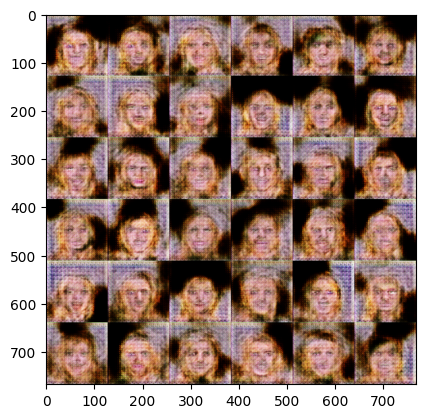

Training Progress:  70%|███████   | 10500/15000 [56:07<32:12,  2.33step/s]

****************************************************************************************************
1/1 [==============================] - 0s 17ms/step


Training Progress:  70%|███████   | 10501/15000 [56:08<29:41,  2.53step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|███████   | 10502/15000 [56:08<27:44,  2.70step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|███████   | 10503/15000 [56:08<27:07,  2.76step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  70%|███████   | 10504/15000 [56:09<25:54,  2.89step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|███████   | 10505/15000 [56:09<25:51,  2.90step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|███████   | 10506/15000 [56:09<25:08,  2.98step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|███████   | 10507/15000 [56:10<24:29,  3.06step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  70%|███████   | 10508/15000 [56:10<24:04,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|███████   | 10509/15000 [56:10<23:45,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  70%|███████   | 10510/15000 [56:11<23:40,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  70%|███████   | 10511/15000 [56:11<23:30,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  70%|███████   | 10512/15000 [56:11<23:22,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|███████   | 10513/15000 [56:12<23:14,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|███████   | 10514/15000 [56:12<23:10,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|███████   | 10515/15000 [56:12<23:05,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|███████   | 10516/15000 [56:13<24:24,  3.06step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|███████   | 10517/15000 [56:13<23:57,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|███████   | 10518/15000 [56:13<23:44,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|███████   | 10519/15000 [56:13<23:27,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  70%|███████   | 10520/15000 [56:14<23:29,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|███████   | 10521/15000 [56:14<23:22,  3.19step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  70%|███████   | 10522/15000 [56:14<23:20,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|███████   | 10523/15000 [56:15<23:14,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|███████   | 10524/15000 [56:15<23:08,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|███████   | 10525/15000 [56:15<23:03,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  70%|███████   | 10526/15000 [56:16<23:02,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  70%|███████   | 10527/15000 [56:16<23:00,  3.24step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  70%|███████   | 10528/15000 [56:16<23:05,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  70%|███████   | 10529/15000 [56:17<23:10,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  70%|███████   | 10530/15000 [56:17<23:08,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|███████   | 10531/15000 [56:17<23:52,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  70%|███████   | 10532/15000 [56:18<23:39,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|███████   | 10533/15000 [56:18<23:29,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  70%|███████   | 10534/15000 [56:18<23:21,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|███████   | 10535/15000 [56:18<23:12,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|███████   | 10536/15000 [56:19<23:05,  3.22step/s]

1/1 [==============================] - 0s 27ms/step


Training Progress:  70%|███████   | 10537/15000 [56:19<25:16,  2.94step/s]

1/1 [==============================] - 0s 28ms/step


Training Progress:  70%|███████   | 10538/15000 [56:20<27:18,  2.72step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  70%|███████   | 10539/15000 [56:20<29:05,  2.56step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  70%|███████   | 10540/15000 [56:20<27:40,  2.69step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|███████   | 10541/15000 [56:21<26:14,  2.83step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  70%|███████   | 10542/15000 [56:21<25:16,  2.94step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  70%|███████   | 10543/15000 [56:21<24:35,  3.02step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  70%|███████   | 10544/15000 [56:22<24:14,  3.06step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  70%|███████   | 10545/15000 [56:22<24:38,  3.01step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|███████   | 10546/15000 [56:22<25:05,  2.96step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  70%|███████   | 10547/15000 [56:23<24:44,  3.00step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  70%|███████   | 10548/15000 [56:23<24:09,  3.07step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  70%|███████   | 10549/15000 [56:23<23:51,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|███████   | 10550/15000 [56:24<23:29,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|███████   | 10551/15000 [56:24<23:18,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|███████   | 10552/15000 [56:24<23:05,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|███████   | 10553/15000 [56:25<23:45,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|███████   | 10554/15000 [56:25<23:31,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|███████   | 10555/15000 [56:25<23:17,  3.18step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  70%|███████   | 10556/15000 [56:25<24:24,  3.03step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|███████   | 10557/15000 [56:26<24:04,  3.08step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  70%|███████   | 10558/15000 [56:26<23:38,  3.13step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  70%|███████   | 10559/15000 [56:26<23:26,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|███████   | 10560/15000 [56:27<23:12,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  70%|███████   | 10561/15000 [56:27<23:07,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|███████   | 10562/15000 [56:27<22:58,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|███████   | 10563/15000 [56:28<22:50,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|███████   | 10564/15000 [56:28<22:45,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|███████   | 10565/15000 [56:28<24:19,  3.04step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  70%|███████   | 10566/15000 [56:29<23:58,  3.08step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  70%|███████   | 10567/15000 [56:29<23:36,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|███████   | 10568/15000 [56:29<23:16,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  70%|███████   | 10569/15000 [56:30<23:04,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  70%|███████   | 10570/15000 [56:30<22:56,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  70%|███████   | 10571/15000 [56:30<22:50,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  70%|███████   | 10572/15000 [56:30<22:45,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|███████   | 10573/15000 [56:31<22:40,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  70%|███████   | 10574/15000 [56:31<22:40,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  70%|███████   | 10575/15000 [56:31<23:32,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  71%|███████   | 10576/15000 [56:32<23:15,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████   | 10577/15000 [56:32<23:54,  3.08step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  71%|███████   | 10578/15000 [56:32<23:54,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████   | 10579/15000 [56:33<23:27,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████   | 10580/15000 [56:33<23:07,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████   | 10581/15000 [56:33<22:55,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████   | 10582/15000 [56:34<22:46,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████   | 10583/15000 [56:34<22:39,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  71%|███████   | 10584/15000 [56:34<22:43,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████   | 10585/15000 [56:35<22:40,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████   | 10586/15000 [56:35<22:38,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████   | 10587/15000 [56:35<22:37,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████   | 10588/15000 [56:35<22:39,  3.25step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:  71%|███████   | 10589/15000 [56:36<22:34,  3.26step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  71%|███████   | 10590/15000 [56:36<22:33,  3.26step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  71%|███████   | 10591/15000 [56:36<22:39,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████   | 10592/15000 [56:37<23:26,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████   | 10593/15000 [56:37<23:08,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  71%|███████   | 10594/15000 [56:37<23:02,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████   | 10595/15000 [56:38<22:51,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████   | 10596/15000 [56:38<23:32,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████   | 10597/15000 [56:38<23:13,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████   | 10598/15000 [56:39<23:00,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████   | 10599/15000 [56:39<22:50,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████   | 10600/15000 [56:39<22:42,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████   | 10601/15000 [56:40<22:36,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████   | 10602/15000 [56:40<22:32,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████   | 10603/15000 [56:40<22:36,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████   | 10604/15000 [56:40<22:32,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  71%|███████   | 10605/15000 [56:41<22:30,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████   | 10606/15000 [56:41<22:25,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████   | 10607/15000 [56:41<22:23,  3.27step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████   | 10608/15000 [56:42<22:21,  3.27step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████   | 10609/15000 [56:42<22:22,  3.27step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  71%|███████   | 10610/15000 [56:42<23:09,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████   | 10611/15000 [56:43<22:56,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████   | 10612/15000 [56:43<22:53,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████   | 10613/15000 [56:43<22:46,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████   | 10614/15000 [56:44<22:37,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████   | 10615/15000 [56:44<22:34,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████   | 10616/15000 [56:44<22:29,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  71%|███████   | 10617/15000 [56:44<22:28,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████   | 10618/15000 [56:45<22:26,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████   | 10619/15000 [56:45<22:25,  3.26step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:  71%|███████   | 10620/15000 [56:45<23:09,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  71%|███████   | 10621/15000 [56:46<23:03,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  71%|███████   | 10622/15000 [56:46<22:53,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████   | 10623/15000 [56:46<22:44,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████   | 10624/15000 [56:47<22:37,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████   | 10625/15000 [56:47<22:30,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████   | 10626/15000 [56:47<22:26,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  71%|███████   | 10627/15000 [56:48<22:29,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████   | 10628/15000 [56:48<22:25,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████   | 10629/15000 [56:48<22:21,  3.26step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  71%|███████   | 10630/15000 [56:49<22:23,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  71%|███████   | 10631/15000 [56:49<22:31,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████   | 10632/15000 [56:49<23:18,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████   | 10633/15000 [56:49<23:04,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  71%|███████   | 10634/15000 [56:50<23:40,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  71%|███████   | 10635/15000 [56:50<23:14,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████   | 10636/15000 [56:51<25:34,  2.84step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  71%|███████   | 10637/15000 [56:51<26:49,  2.71step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  71%|███████   | 10638/15000 [56:51<28:28,  2.55step/s]

1/1 [==============================] - 0s 23ms/step


Training Progress:  71%|███████   | 10639/15000 [56:52<27:45,  2.62step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  71%|███████   | 10640/15000 [56:52<27:01,  2.69step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  71%|███████   | 10641/15000 [56:52<25:39,  2.83step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████   | 10642/15000 [56:53<24:40,  2.94step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  71%|███████   | 10643/15000 [56:53<24:00,  3.02step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████   | 10644/15000 [56:53<23:29,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████   | 10645/15000 [56:54<23:06,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████   | 10646/15000 [56:54<22:48,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████   | 10647/15000 [56:54<22:38,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████   | 10648/15000 [56:55<22:31,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████   | 10649/15000 [56:55<22:31,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  71%|███████   | 10650/15000 [56:55<23:13,  3.12step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  71%|███████   | 10651/15000 [56:56<22:55,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  71%|███████   | 10652/15000 [56:56<22:40,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████   | 10653/15000 [56:56<22:30,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████   | 10654/15000 [56:56<22:22,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████   | 10655/15000 [56:57<22:17,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████   | 10656/15000 [56:57<23:03,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████   | 10657/15000 [56:57<22:48,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  71%|███████   | 10658/15000 [56:58<22:43,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  71%|███████   | 10659/15000 [56:58<23:23,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████   | 10660/15000 [56:58<22:59,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████   | 10661/15000 [56:59<22:45,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████   | 10662/15000 [56:59<22:34,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████   | 10663/15000 [56:59<23:11,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████   | 10664/15000 [57:00<22:51,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████   | 10665/15000 [57:00<22:36,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████   | 10666/15000 [57:00<22:24,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████   | 10667/15000 [57:01<22:16,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  71%|███████   | 10668/15000 [57:01<22:19,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████   | 10669/15000 [57:01<22:14,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████   | 10670/15000 [57:01<22:09,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████   | 10671/15000 [57:02<22:08,  3.26step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  71%|███████   | 10672/15000 [57:02<22:55,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████   | 10673/15000 [57:02<22:46,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████   | 10674/15000 [57:03<22:34,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████   | 10675/15000 [57:03<22:27,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  71%|███████   | 10676/15000 [57:03<22:26,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████   | 10677/15000 [57:04<22:27,  3.21step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  71%|███████   | 10678/15000 [57:04<22:31,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████   | 10679/15000 [57:04<23:13,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  71%|███████   | 10680/15000 [57:05<23:06,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  71%|███████   | 10681/15000 [57:05<22:51,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  71%|███████   | 10682/15000 [57:05<22:37,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████   | 10683/15000 [57:06<22:30,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████   | 10684/15000 [57:06<22:25,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████   | 10685/15000 [57:06<22:18,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  71%|███████   | 10686/15000 [57:07<22:21,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  71%|███████   | 10687/15000 [57:07<22:22,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  71%|███████▏  | 10688/15000 [57:07<23:06,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████▏  | 10689/15000 [57:07<22:46,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████▏  | 10690/15000 [57:08<22:30,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████▏  | 10691/15000 [57:08<22:22,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████▏  | 10692/15000 [57:08<22:18,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████▏  | 10693/15000 [57:09<22:11,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████▏  | 10694/15000 [57:09<22:04,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  71%|███████▏  | 10695/15000 [57:09<22:11,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  71%|███████▏  | 10696/15000 [57:10<22:13,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████▏  | 10697/15000 [57:10<22:05,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████▏  | 10698/15000 [57:10<22:02,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████▏  | 10699/15000 [57:11<22:01,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████▏  | 10700/15000 [57:11<22:01,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████▏  | 10701/15000 [57:11<21:56,  3.27step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████▏  | 10702/15000 [57:11<21:55,  3.27step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:  71%|███████▏  | 10703/15000 [57:12<21:55,  3.27step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████▏  | 10704/15000 [57:12<22:02,  3.25step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  71%|███████▏  | 10705/15000 [57:12<23:07,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  71%|███████▏  | 10706/15000 [57:13<22:49,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  71%|███████▏  | 10707/15000 [57:13<22:35,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████▏  | 10708/15000 [57:13<22:22,  3.20step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:  71%|███████▏  | 10709/15000 [57:14<22:13,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  71%|███████▏  | 10710/15000 [57:14<22:08,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████▏  | 10711/15000 [57:14<22:12,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  71%|███████▏  | 10712/15000 [57:15<22:13,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████▏  | 10713/15000 [57:15<22:12,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  71%|███████▏  | 10714/15000 [57:15<22:12,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████▏  | 10715/15000 [57:16<22:12,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  71%|███████▏  | 10716/15000 [57:16<22:06,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  71%|███████▏  | 10717/15000 [57:16<22:08,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  71%|███████▏  | 10718/15000 [57:16<22:06,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████▏  | 10719/15000 [57:17<22:04,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████▏  | 10720/15000 [57:17<22:00,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████▏  | 10721/15000 [57:17<22:00,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  71%|███████▏  | 10722/15000 [57:18<22:02,  3.24step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  71%|███████▏  | 10723/15000 [57:18<22:12,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  71%|███████▏  | 10724/15000 [57:18<22:10,  3.21step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  72%|███████▏  | 10725/15000 [57:19<22:12,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  72%|███████▏  | 10726/15000 [57:19<22:03,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  72%|███████▏  | 10727/15000 [57:19<22:02,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  72%|███████▏  | 10728/15000 [57:20<22:00,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  72%|███████▏  | 10729/15000 [57:20<22:00,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  72%|███████▏  | 10730/15000 [57:20<21:56,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  72%|███████▏  | 10731/15000 [57:20<21:51,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  72%|███████▏  | 10732/15000 [57:21<21:54,  3.25step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  72%|███████▏  | 10733/15000 [57:21<22:42,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  72%|███████▏  | 10734/15000 [57:21<22:27,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  72%|███████▏  | 10735/15000 [57:22<23:47,  2.99step/s]

1/1 [==============================] - 0s 45ms/step


Training Progress:  72%|███████▏  | 10736/15000 [57:22<25:25,  2.80step/s]

1/1 [==============================] - 0s 60ms/step


Training Progress:  72%|███████▏  | 10737/15000 [57:23<27:16,  2.60step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  72%|███████▏  | 10738/15000 [57:23<27:54,  2.54step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  72%|███████▏  | 10739/15000 [57:23<26:14,  2.71step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  72%|███████▏  | 10740/15000 [57:24<25:09,  2.82step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  72%|███████▏  | 10741/15000 [57:24<24:07,  2.94step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  72%|███████▏  | 10742/15000 [57:24<23:37,  3.00step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  72%|███████▏  | 10743/15000 [57:25<23:08,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  72%|███████▏  | 10744/15000 [57:25<22:51,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  72%|███████▏  | 10745/15000 [57:25<22:34,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  72%|███████▏  | 10746/15000 [57:26<22:26,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  72%|███████▏  | 10747/15000 [57:26<22:18,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  72%|███████▏  | 10748/15000 [57:26<22:11,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  72%|███████▏  | 10749/15000 [57:27<22:49,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  72%|███████▏  | 10750/15000 [57:27<22:33,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  72%|███████▏  | 10751/15000 [57:27<22:27,  3.15step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  72%|███████▏  | 10752/15000 [57:28<28:39,  2.47step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  72%|███████▏  | 10753/15000 [57:28<26:43,  2.65step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  72%|███████▏  | 10754/15000 [57:28<25:25,  2.78step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  72%|███████▏  | 10755/15000 [57:29<25:58,  2.72step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  72%|███████▏  | 10756/15000 [57:29<24:55,  2.84step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  72%|███████▏  | 10757/15000 [57:29<24:07,  2.93step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  72%|███████▏  | 10758/15000 [57:30<24:22,  2.90step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  72%|███████▏  | 10759/15000 [57:30<23:41,  2.98step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  72%|███████▏  | 10760/15000 [57:30<23:18,  3.03step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  72%|███████▏  | 10761/15000 [57:31<23:08,  3.05step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  72%|███████▏  | 10762/15000 [57:31<23:39,  2.98step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  72%|███████▏  | 10763/15000 [57:31<23:10,  3.05step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  72%|███████▏  | 10764/15000 [57:32<23:46,  2.97step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  72%|███████▏  | 10765/15000 [57:32<24:12,  2.92step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  72%|███████▏  | 10766/15000 [57:32<23:42,  2.98step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  72%|███████▏  | 10767/15000 [57:33<23:13,  3.04step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  72%|███████▏  | 10768/15000 [57:33<22:54,  3.08step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  72%|███████▏  | 10769/15000 [57:33<22:42,  3.10step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  72%|███████▏  | 10770/15000 [57:34<22:47,  3.09step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  72%|███████▏  | 10771/15000 [57:34<22:37,  3.11step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  72%|███████▏  | 10772/15000 [57:34<23:16,  3.03step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  72%|███████▏  | 10773/15000 [57:35<22:54,  3.07step/s]

1/1 [==============================] - 0s 23ms/step


Training Progress:  72%|███████▏  | 10774/15000 [57:35<22:49,  3.09step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  72%|███████▏  | 10775/15000 [57:35<22:35,  3.12step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  72%|███████▏  | 10776/15000 [57:36<22:33,  3.12step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  72%|███████▏  | 10777/15000 [57:36<22:28,  3.13step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  72%|███████▏  | 10778/15000 [57:36<22:26,  3.13step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  72%|███████▏  | 10779/15000 [57:37<22:29,  3.13step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  72%|███████▏  | 10780/15000 [57:37<22:24,  3.14step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  72%|███████▏  | 10781/15000 [57:37<22:18,  3.15step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  72%|███████▏  | 10782/15000 [57:38<22:15,  3.16step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  72%|███████▏  | 10783/15000 [57:38<22:10,  3.17step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  72%|███████▏  | 10784/15000 [57:38<22:09,  3.17step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  72%|███████▏  | 10785/15000 [57:38<22:06,  3.18step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  72%|███████▏  | 10786/15000 [57:39<22:08,  3.17step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  72%|███████▏  | 10787/15000 [57:39<22:05,  3.18step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  72%|███████▏  | 10788/15000 [57:39<23:01,  3.05step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  72%|███████▏  | 10789/15000 [57:40<22:41,  3.09step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  72%|███████▏  | 10790/15000 [57:40<22:32,  3.11step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  72%|███████▏  | 10791/15000 [57:40<22:25,  3.13step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  72%|███████▏  | 10792/15000 [57:41<22:21,  3.14step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  72%|███████▏  | 10793/15000 [57:41<22:18,  3.14step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  72%|███████▏  | 10794/15000 [57:41<22:17,  3.14step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  72%|███████▏  | 10795/15000 [57:42<22:13,  3.15step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  72%|███████▏  | 10796/15000 [57:42<22:12,  3.15step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  72%|███████▏  | 10797/15000 [57:42<22:21,  3.13step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  72%|███████▏  | 10798/15000 [57:43<22:20,  3.14step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  72%|███████▏  | 10799/15000 [57:43<22:13,  3.15step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  72%|███████▏  | 10800/15000 [57:43<22:12,  3.15step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  72%|███████▏  | 10801/15000 [57:44<22:06,  3.17step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  72%|███████▏  | 10802/15000 [57:44<22:55,  3.05step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  72%|███████▏  | 10803/15000 [57:44<22:39,  3.09step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  72%|███████▏  | 10804/15000 [57:45<22:29,  3.11step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  72%|███████▏  | 10805/15000 [57:45<23:07,  3.02step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  72%|███████▏  | 10806/15000 [57:45<23:00,  3.04step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  72%|███████▏  | 10807/15000 [57:46<22:44,  3.07step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  72%|███████▏  | 10808/15000 [57:46<23:17,  3.00step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  72%|███████▏  | 10809/15000 [57:46<22:54,  3.05step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  72%|███████▏  | 10810/15000 [57:47<22:40,  3.08step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  72%|███████▏  | 10811/15000 [57:47<22:30,  3.10step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  72%|███████▏  | 10812/15000 [57:47<22:23,  3.12step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  72%|███████▏  | 10813/15000 [57:48<22:13,  3.14step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  72%|███████▏  | 10814/15000 [57:48<22:08,  3.15step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  72%|███████▏  | 10815/15000 [57:48<22:54,  3.04step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  72%|███████▏  | 10816/15000 [57:48<22:43,  3.07step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  72%|███████▏  | 10817/15000 [57:49<22:34,  3.09step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  72%|███████▏  | 10818/15000 [57:49<22:18,  3.13step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  72%|███████▏  | 10819/15000 [57:49<22:19,  3.12step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  72%|███████▏  | 10820/15000 [57:50<22:07,  3.15step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  72%|███████▏  | 10821/15000 [57:50<22:45,  3.06step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  72%|███████▏  | 10822/15000 [57:50<22:28,  3.10step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  72%|███████▏  | 10823/15000 [57:51<23:48,  2.92step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  72%|███████▏  | 10824/15000 [57:51<23:18,  2.99step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  72%|███████▏  | 10825/15000 [57:51<22:52,  3.04step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  72%|███████▏  | 10826/15000 [57:52<22:32,  3.09step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  72%|███████▏  | 10827/15000 [57:52<22:17,  3.12step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  72%|███████▏  | 10828/15000 [57:52<22:21,  3.11step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  72%|███████▏  | 10829/15000 [57:53<22:12,  3.13step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  72%|███████▏  | 10830/15000 [57:53<22:04,  3.15step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  72%|███████▏  | 10831/15000 [57:53<22:55,  3.03step/s]

1/1 [==============================] - 0s 30ms/step


Training Progress:  72%|███████▏  | 10832/15000 [57:54<24:46,  2.80step/s]

1/1 [==============================] - 0s 28ms/step


Training Progress:  72%|███████▏  | 10833/15000 [57:54<26:04,  2.66step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  72%|███████▏  | 10834/15000 [57:55<26:51,  2.58step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  72%|███████▏  | 10835/15000 [57:55<25:20,  2.74step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  72%|███████▏  | 10836/15000 [57:55<24:13,  2.86step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  72%|███████▏  | 10837/15000 [57:56<23:26,  2.96step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  72%|███████▏  | 10838/15000 [57:56<22:50,  3.04step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  72%|███████▏  | 10839/15000 [57:56<22:26,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  72%|███████▏  | 10840/15000 [57:56<22:05,  3.14step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  72%|███████▏  | 10841/15000 [57:57<21:57,  3.16step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  72%|███████▏  | 10842/15000 [57:57<21:55,  3.16step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  72%|███████▏  | 10843/15000 [57:57<21:50,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  72%|███████▏  | 10844/15000 [57:58<21:40,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  72%|███████▏  | 10845/15000 [57:58<21:36,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  72%|███████▏  | 10846/15000 [57:58<21:31,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  72%|███████▏  | 10847/15000 [57:59<21:30,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  72%|███████▏  | 10848/15000 [57:59<21:27,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  72%|███████▏  | 10849/15000 [57:59<22:12,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  72%|███████▏  | 10850/15000 [58:00<21:57,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  72%|███████▏  | 10851/15000 [58:00<22:32,  3.07step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  72%|███████▏  | 10852/15000 [58:00<22:21,  3.09step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  72%|███████▏  | 10853/15000 [58:01<22:07,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  72%|███████▏  | 10854/15000 [58:01<21:52,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  72%|███████▏  | 10855/15000 [58:01<21:44,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  72%|███████▏  | 10856/15000 [58:02<21:34,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  72%|███████▏  | 10857/15000 [58:02<21:31,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  72%|███████▏  | 10858/15000 [58:02<22:14,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  72%|███████▏  | 10859/15000 [58:03<23:05,  2.99step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  72%|███████▏  | 10860/15000 [58:03<22:30,  3.06step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  72%|███████▏  | 10861/15000 [58:03<22:18,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  72%|███████▏  | 10862/15000 [58:03<21:58,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  72%|███████▏  | 10863/15000 [58:04<21:48,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  72%|███████▏  | 10864/15000 [58:04<22:20,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  72%|███████▏  | 10865/15000 [58:04<22:01,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  72%|███████▏  | 10866/15000 [58:05<21:45,  3.17step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  72%|███████▏  | 10867/15000 [58:05<21:45,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  72%|███████▏  | 10868/15000 [58:05<21:34,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  72%|███████▏  | 10869/15000 [58:06<21:28,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  72%|███████▏  | 10870/15000 [58:06<21:28,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  72%|███████▏  | 10871/15000 [58:06<21:28,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  72%|███████▏  | 10872/15000 [58:07<21:19,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  72%|███████▏  | 10873/15000 [58:07<21:18,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  72%|███████▏  | 10874/15000 [58:07<21:12,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  72%|███████▎  | 10875/15000 [58:08<21:10,  3.25step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  73%|███████▎  | 10876/15000 [58:08<21:08,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 10877/15000 [58:08<21:08,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  73%|███████▎  | 10878/15000 [58:08<21:09,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  73%|███████▎  | 10879/15000 [58:09<21:18,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  73%|███████▎  | 10880/15000 [58:09<21:58,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 10881/15000 [58:09<21:44,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  73%|███████▎  | 10882/15000 [58:10<21:32,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 10883/15000 [58:10<21:26,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  73%|███████▎  | 10884/15000 [58:10<21:19,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 10885/15000 [58:11<21:18,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 10886/15000 [58:11<21:11,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 10887/15000 [58:11<21:09,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  73%|███████▎  | 10888/15000 [58:12<21:07,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 10889/15000 [58:12<21:14,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  73%|███████▎  | 10890/15000 [58:12<21:19,  3.21step/s]

1/1 [==============================] - 0s 30ms/step


Training Progress:  73%|███████▎  | 10891/15000 [58:13<22:02,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 10892/15000 [58:13<21:45,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 10893/15000 [58:13<21:33,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 10894/15000 [58:13<21:23,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 10895/15000 [58:14<21:18,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 10896/15000 [58:14<21:13,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 10897/15000 [58:14<21:10,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 10898/15000 [58:15<21:12,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  73%|███████▎  | 10899/15000 [58:15<21:11,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  73%|███████▎  | 10900/15000 [58:15<21:07,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 10901/15000 [58:16<21:04,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  73%|███████▎  | 10902/15000 [58:16<21:01,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  73%|███████▎  | 10903/15000 [58:16<21:03,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 10904/15000 [58:17<21:00,  3.25step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  73%|███████▎  | 10905/15000 [58:17<21:11,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 10906/15000 [58:17<21:07,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 10907/15000 [58:17<21:13,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 10908/15000 [58:18<21:07,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  73%|███████▎  | 10909/15000 [58:18<21:09,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  73%|███████▎  | 10910/15000 [58:18<21:07,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 10911/15000 [58:19<21:49,  3.12step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  73%|███████▎  | 10912/15000 [58:19<21:39,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  73%|███████▎  | 10913/15000 [58:19<21:33,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  73%|███████▎  | 10914/15000 [58:20<21:25,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  73%|███████▎  | 10915/15000 [58:20<21:22,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  73%|███████▎  | 10916/15000 [58:20<21:24,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  73%|███████▎  | 10917/15000 [58:21<21:17,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  73%|███████▎  | 10918/15000 [58:21<21:16,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 10919/15000 [58:21<21:10,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 10920/15000 [58:22<21:05,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  73%|███████▎  | 10921/15000 [58:22<21:07,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 10922/15000 [58:22<21:15,  3.20step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  73%|███████▎  | 10923/15000 [58:23<22:10,  3.06step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  73%|███████▎  | 10924/15000 [58:23<21:46,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  73%|███████▎  | 10925/15000 [58:23<21:32,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  73%|███████▎  | 10926/15000 [58:23<21:31,  3.16step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  73%|███████▎  | 10927/15000 [58:24<21:29,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 10928/15000 [58:24<21:20,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  73%|███████▎  | 10929/15000 [58:24<21:13,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  73%|███████▎  | 10930/15000 [58:25<21:59,  3.08step/s]

1/1 [==============================] - 0s 35ms/step


Training Progress:  73%|███████▎  | 10931/15000 [58:25<24:52,  2.73step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  73%|███████▎  | 10932/15000 [58:26<26:29,  2.56step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  73%|███████▎  | 10933/15000 [58:26<26:10,  2.59step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  73%|███████▎  | 10934/15000 [58:26<24:37,  2.75step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  73%|███████▎  | 10935/15000 [58:27<23:38,  2.87step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  73%|███████▎  | 10936/15000 [58:27<23:34,  2.87step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 10937/15000 [58:27<23:31,  2.88step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  73%|███████▎  | 10938/15000 [58:28<22:45,  2.97step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 10939/15000 [58:28<22:12,  3.05step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  73%|███████▎  | 10940/15000 [58:28<21:49,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 10941/15000 [58:29<21:30,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 10942/15000 [58:29<21:23,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 10943/15000 [58:29<21:56,  3.08step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  73%|███████▎  | 10944/15000 [58:30<21:40,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  73%|███████▎  | 10945/15000 [58:30<21:29,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  73%|███████▎  | 10946/15000 [58:30<21:16,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  73%|███████▎  | 10947/15000 [58:31<21:12,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  73%|███████▎  | 10948/15000 [58:31<21:46,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 10949/15000 [58:31<22:12,  3.04step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 10950/15000 [58:32<21:42,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 10951/15000 [58:32<21:24,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 10952/15000 [58:32<21:57,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  73%|███████▎  | 10953/15000 [58:32<22:00,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  73%|███████▎  | 10954/15000 [58:33<21:37,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 10955/15000 [58:33<21:20,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 10956/15000 [58:33<21:10,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 10957/15000 [58:34<21:02,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 10958/15000 [58:34<21:38,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  73%|███████▎  | 10959/15000 [58:34<21:22,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 10960/15000 [58:35<21:09,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  73%|███████▎  | 10961/15000 [58:35<21:05,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 10962/15000 [58:35<20:57,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  73%|███████▎  | 10963/15000 [58:36<21:00,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 10964/15000 [58:36<20:58,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 10965/15000 [58:36<20:53,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 10966/15000 [58:37<20:49,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 10967/15000 [58:37<20:48,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 10968/15000 [58:37<20:47,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 10969/15000 [58:37<20:44,  3.24step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:  73%|███████▎  | 10970/15000 [58:38<20:40,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 10971/15000 [58:38<20:37,  3.26step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  73%|███████▎  | 10972/15000 [58:38<20:45,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  73%|███████▎  | 10973/15000 [58:39<20:43,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 10974/15000 [58:39<21:27,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  73%|███████▎  | 10975/15000 [58:39<21:11,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 10976/15000 [58:40<21:02,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 10977/15000 [58:40<20:55,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 10978/15000 [58:40<20:50,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  73%|███████▎  | 10979/15000 [58:41<20:42,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 10980/15000 [58:41<20:39,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  73%|███████▎  | 10981/15000 [58:41<20:41,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  73%|███████▎  | 10982/15000 [58:41<20:40,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 10983/15000 [58:42<20:36,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 10984/15000 [58:42<20:36,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  73%|███████▎  | 10985/15000 [58:42<21:18,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 10986/15000 [58:43<21:04,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 10987/15000 [58:43<20:54,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  73%|███████▎  | 10988/15000 [58:43<20:50,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 10989/15000 [58:44<20:43,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  73%|███████▎  | 10990/15000 [58:44<20:52,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  73%|███████▎  | 10991/15000 [58:44<20:48,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  73%|███████▎  | 10992/15000 [58:45<20:49,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  73%|███████▎  | 10993/15000 [58:45<20:43,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  73%|███████▎  | 10994/15000 [58:45<20:41,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 10995/15000 [58:46<20:38,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 10996/15000 [58:46<20:36,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  73%|███████▎  | 10997/15000 [58:46<20:33,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 10998/15000 [58:47<21:18,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 10999/15000 [58:47<21:02,  3.17step/s]

1/1 [==============================] - 0s 18ms/step
****************************************************************************************************
11000/15000: d_loss: 0.122303,  g_loss: 0.008474
2/2 [==============================] - 0s 20ms/step


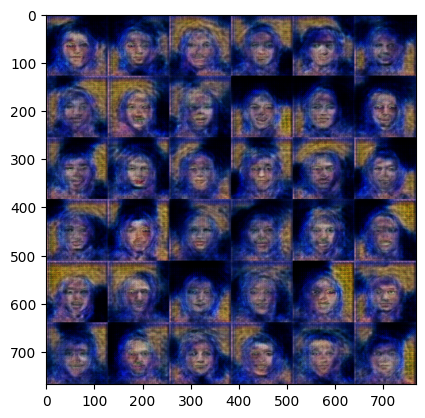

Training Progress:  73%|███████▎  | 11000/15000 [58:48<29:34,  2.25step/s]

****************************************************************************************************
1/1 [==============================] - 0s 17ms/step


Training Progress:  73%|███████▎  | 11001/15000 [58:48<27:01,  2.47step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 11002/15000 [58:48<25:02,  2.66step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  73%|███████▎  | 11003/15000 [58:48<23:43,  2.81step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  73%|███████▎  | 11004/15000 [58:49<22:43,  2.93step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 11005/15000 [58:49<21:59,  3.03step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 11006/15000 [58:49<21:30,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 11007/15000 [58:50<21:10,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 11008/15000 [58:50<20:57,  3.17step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  73%|███████▎  | 11009/15000 [58:50<20:53,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  73%|███████▎  | 11010/15000 [58:51<20:43,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 11011/15000 [58:51<20:38,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 11012/15000 [58:51<20:39,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  73%|███████▎  | 11013/15000 [58:52<20:33,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 11014/15000 [58:52<20:29,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 11015/15000 [58:52<20:27,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 11016/15000 [58:53<20:49,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 11017/15000 [58:53<20:40,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 11018/15000 [58:53<20:33,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 11019/15000 [58:53<20:28,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 11020/15000 [58:54<20:28,  3.24step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  73%|███████▎  | 11021/15000 [58:54<20:38,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  73%|███████▎  | 11022/15000 [58:54<20:35,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  73%|███████▎  | 11023/15000 [58:55<20:33,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  73%|███████▎  | 11024/15000 [58:55<20:29,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▎  | 11025/15000 [58:55<20:24,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▎  | 11026/15000 [58:56<20:21,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▎  | 11027/15000 [58:56<20:20,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▎  | 11028/15000 [58:56<20:23,  3.25step/s]

1/1 [==============================] - 0s 33ms/step


Training Progress:  74%|███████▎  | 11029/15000 [58:57<23:07,  2.86step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  74%|███████▎  | 11030/15000 [58:57<24:24,  2.71step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  74%|███████▎  | 11031/15000 [58:57<24:30,  2.70step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  74%|███████▎  | 11032/15000 [58:58<23:57,  2.76step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▎  | 11033/15000 [58:58<22:49,  2.90step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  74%|███████▎  | 11034/15000 [58:58<22:01,  3.00step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▎  | 11035/15000 [58:59<21:27,  3.08step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  74%|███████▎  | 11036/15000 [58:59<21:04,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▎  | 11037/15000 [58:59<20:49,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  74%|███████▎  | 11038/15000 [59:00<21:19,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  74%|███████▎  | 11039/15000 [59:00<21:01,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  74%|███████▎  | 11040/15000 [59:00<20:54,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▎  | 11041/15000 [59:01<20:41,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  74%|███████▎  | 11042/15000 [59:01<20:33,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▎  | 11043/15000 [59:01<20:28,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▎  | 11044/15000 [59:02<21:03,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  74%|███████▎  | 11045/15000 [59:02<20:47,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  74%|███████▎  | 11046/15000 [59:02<20:39,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  74%|███████▎  | 11047/15000 [59:02<20:36,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▎  | 11048/15000 [59:03<20:28,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  74%|███████▎  | 11049/15000 [59:03<21:12,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  74%|███████▎  | 11050/15000 [59:03<20:54,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▎  | 11051/15000 [59:04<20:42,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  74%|███████▎  | 11052/15000 [59:04<20:32,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▎  | 11053/15000 [59:04<21:08,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  74%|███████▎  | 11054/15000 [59:05<20:52,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  74%|███████▎  | 11055/15000 [59:05<20:45,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▎  | 11056/15000 [59:05<20:41,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▎  | 11057/15000 [59:06<20:30,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  74%|███████▎  | 11058/15000 [59:06<20:33,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▎  | 11059/15000 [59:06<20:24,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▎  | 11060/15000 [59:07<20:22,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▎  | 11061/15000 [59:07<21:00,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  74%|███████▎  | 11062/15000 [59:07<21:32,  3.05step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▍  | 11063/15000 [59:08<21:05,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  74%|███████▍  | 11064/15000 [59:08<20:51,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▍  | 11065/15000 [59:08<20:35,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▍  | 11066/15000 [59:08<20:28,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  74%|███████▍  | 11067/15000 [59:09<20:28,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▍  | 11068/15000 [59:09<20:27,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▍  | 11069/15000 [59:09<20:18,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  74%|███████▍  | 11070/15000 [59:10<20:16,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▍  | 11071/15000 [59:10<20:13,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  74%|███████▍  | 11072/15000 [59:10<20:15,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▍  | 11073/15000 [59:11<20:10,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▍  | 11074/15000 [59:11<20:07,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▍  | 11075/15000 [59:11<20:03,  3.26step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  74%|███████▍  | 11076/15000 [59:12<20:04,  3.26step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  74%|███████▍  | 11077/15000 [59:12<20:10,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  74%|███████▍  | 11078/15000 [59:12<20:12,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  74%|███████▍  | 11079/15000 [59:12<20:29,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▍  | 11080/15000 [59:13<20:23,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▍  | 11081/15000 [59:13<20:17,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  74%|███████▍  | 11082/15000 [59:13<20:17,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▍  | 11083/15000 [59:14<20:12,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▍  | 11084/15000 [59:14<20:11,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▍  | 11085/15000 [59:14<20:07,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  74%|███████▍  | 11086/15000 [59:15<20:17,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  74%|███████▍  | 11087/15000 [59:15<20:14,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▍  | 11088/15000 [59:15<20:13,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▍  | 11089/15000 [59:16<20:10,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  74%|███████▍  | 11090/15000 [59:16<20:10,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▍  | 11091/15000 [59:16<20:08,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  74%|███████▍  | 11092/15000 [59:17<20:07,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▍  | 11093/15000 [59:17<20:05,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▍  | 11094/15000 [59:17<20:48,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▍  | 11095/15000 [59:17<20:40,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  74%|███████▍  | 11096/15000 [59:18<20:31,  3.17step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  74%|███████▍  | 11097/15000 [59:18<20:22,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  74%|███████▍  | 11098/15000 [59:18<21:00,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▍  | 11099/15000 [59:19<20:39,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  74%|███████▍  | 11100/15000 [59:19<20:31,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  74%|███████▍  | 11101/15000 [59:19<20:21,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▍  | 11102/15000 [59:20<20:13,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▍  | 11103/15000 [59:20<20:47,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  74%|███████▍  | 11104/15000 [59:20<20:41,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  74%|███████▍  | 11105/15000 [59:21<20:30,  3.16step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  74%|███████▍  | 11106/15000 [59:21<20:32,  3.16step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  74%|███████▍  | 11107/15000 [59:21<20:23,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  74%|███████▍  | 11108/15000 [59:22<20:19,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  74%|███████▍  | 11109/15000 [59:22<20:57,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▍  | 11110/15000 [59:22<20:42,  3.13step/s]

1/1 [==============================] - 0s 38ms/step


Training Progress:  74%|███████▍  | 11111/15000 [59:23<21:52,  2.96step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  74%|███████▍  | 11112/15000 [59:23<21:21,  3.03step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▍  | 11113/15000 [59:23<20:58,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  74%|███████▍  | 11114/15000 [59:24<20:48,  3.11step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  74%|███████▍  | 11115/15000 [59:24<21:24,  3.02step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  74%|███████▍  | 11116/15000 [59:24<20:59,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▍  | 11117/15000 [59:25<20:39,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▍  | 11118/15000 [59:25<20:28,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▍  | 11119/15000 [59:25<20:19,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▍  | 11120/15000 [59:25<20:09,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▍  | 11121/15000 [59:26<20:02,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  74%|███████▍  | 11122/15000 [59:26<20:04,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  74%|███████▍  | 11123/15000 [59:26<20:07,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  74%|███████▍  | 11124/15000 [59:27<20:05,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▍  | 11125/15000 [59:27<19:59,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▍  | 11126/15000 [59:27<19:56,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▍  | 11127/15000 [59:28<20:39,  3.12step/s]

1/1 [==============================] - 0s 28ms/step


Training Progress:  74%|███████▍  | 11128/15000 [59:28<23:15,  2.77step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  74%|███████▍  | 11129/15000 [59:29<24:53,  2.59step/s]

1/1 [==============================] - 0s 27ms/step


Training Progress:  74%|███████▍  | 11130/15000 [59:29<24:42,  2.61step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▍  | 11131/15000 [59:29<23:13,  2.78step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  74%|███████▍  | 11132/15000 [59:30<22:22,  2.88step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  74%|███████▍  | 11133/15000 [59:30<21:36,  2.98step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▍  | 11134/15000 [59:30<21:07,  3.05step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▍  | 11135/15000 [59:30<20:41,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  74%|███████▍  | 11136/15000 [59:31<20:25,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▍  | 11137/15000 [59:31<20:12,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▍  | 11138/15000 [59:31<20:50,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▍  | 11139/15000 [59:32<20:28,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▍  | 11140/15000 [59:32<20:17,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  74%|███████▍  | 11141/15000 [59:32<20:22,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  74%|███████▍  | 11142/15000 [59:33<20:14,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  74%|███████▍  | 11143/15000 [59:33<20:08,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▍  | 11144/15000 [59:33<20:03,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▍  | 11145/15000 [59:34<19:57,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  74%|███████▍  | 11146/15000 [59:34<20:39,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  74%|███████▍  | 11147/15000 [59:34<20:22,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▍  | 11148/15000 [59:35<20:12,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▍  | 11149/15000 [59:35<20:03,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  74%|███████▍  | 11150/15000 [59:35<20:02,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  74%|███████▍  | 11151/15000 [59:35<20:05,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  74%|███████▍  | 11152/15000 [59:36<20:02,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  74%|███████▍  | 11153/15000 [59:36<20:00,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▍  | 11154/15000 [59:36<19:56,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▍  | 11155/15000 [59:37<19:51,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▍  | 11156/15000 [59:37<19:49,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▍  | 11157/15000 [59:37<19:45,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▍  | 11158/15000 [59:38<19:44,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  74%|███████▍  | 11159/15000 [59:38<19:42,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▍  | 11160/15000 [59:38<20:30,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▍  | 11161/15000 [59:39<20:57,  3.05step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▍  | 11162/15000 [59:39<21:21,  2.99step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▍  | 11163/15000 [59:39<20:50,  3.07step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▍  | 11164/15000 [59:40<20:31,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▍  | 11165/15000 [59:40<20:15,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▍  | 11166/15000 [59:40<20:08,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  74%|███████▍  | 11167/15000 [59:41<19:59,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▍  | 11168/15000 [59:41<19:58,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  74%|███████▍  | 11169/15000 [59:41<20:00,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  74%|███████▍  | 11170/15000 [59:42<20:39,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▍  | 11171/15000 [59:42<20:18,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  74%|███████▍  | 11172/15000 [59:42<20:10,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▍  | 11173/15000 [59:42<20:40,  3.08step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  74%|███████▍  | 11174/15000 [59:43<20:24,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  74%|███████▍  | 11175/15000 [59:43<20:53,  3.05step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  75%|███████▍  | 11176/15000 [59:43<20:33,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  75%|███████▍  | 11177/15000 [59:44<20:15,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  75%|███████▍  | 11178/15000 [59:44<20:14,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  75%|███████▍  | 11179/15000 [59:44<20:03,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  75%|███████▍  | 11180/15000 [59:45<19:59,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  75%|███████▍  | 11181/15000 [59:45<19:56,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  75%|███████▍  | 11182/15000 [59:45<19:51,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  75%|███████▍  | 11183/15000 [59:46<19:48,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  75%|███████▍  | 11184/15000 [59:46<19:47,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  75%|███████▍  | 11185/15000 [59:46<19:40,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  75%|███████▍  | 11186/15000 [59:47<19:42,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  75%|███████▍  | 11187/15000 [59:47<19:39,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  75%|███████▍  | 11188/15000 [59:47<19:45,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  75%|███████▍  | 11189/15000 [59:47<19:41,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  75%|███████▍  | 11190/15000 [59:48<19:40,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  75%|███████▍  | 11191/15000 [59:48<19:34,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  75%|███████▍  | 11192/15000 [59:48<19:34,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  75%|███████▍  | 11193/15000 [59:49<20:15,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  75%|███████▍  | 11194/15000 [59:49<20:03,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  75%|███████▍  | 11195/15000 [59:49<19:51,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  75%|███████▍  | 11196/15000 [59:50<19:43,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  75%|███████▍  | 11197/15000 [59:50<19:42,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  75%|███████▍  | 11198/15000 [59:50<19:39,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  75%|███████▍  | 11199/15000 [59:51<19:35,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  75%|███████▍  | 11200/15000 [59:51<19:34,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  75%|███████▍  | 11201/15000 [59:51<20:17,  3.12step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  75%|███████▍  | 11202/15000 [59:52<20:07,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  75%|███████▍  | 11203/15000 [59:52<19:55,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  75%|███████▍  | 11204/15000 [59:52<19:48,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  75%|███████▍  | 11205/15000 [59:53<20:46,  3.05step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  75%|███████▍  | 11206/15000 [59:53<20:31,  3.08step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  75%|███████▍  | 11207/15000 [59:53<20:13,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  75%|███████▍  | 11208/15000 [59:53<20:02,  3.15step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  75%|███████▍  | 11209/15000 [59:54<20:04,  3.15step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  75%|███████▍  | 11210/15000 [59:54<20:01,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  75%|███████▍  | 11211/15000 [59:54<19:50,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  75%|███████▍  | 11212/15000 [59:55<20:26,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  75%|███████▍  | 11213/15000 [59:55<20:47,  3.04step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  75%|███████▍  | 11214/15000 [59:55<20:22,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  75%|███████▍  | 11215/15000 [59:56<20:11,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  75%|███████▍  | 11216/15000 [59:56<19:59,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  75%|███████▍  | 11217/15000 [59:56<19:49,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  75%|███████▍  | 11218/15000 [59:57<19:44,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  75%|███████▍  | 11219/15000 [59:57<19:39,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  75%|███████▍  | 11220/15000 [59:57<19:35,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  75%|███████▍  | 11221/15000 [59:58<19:30,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  75%|███████▍  | 11222/15000 [59:58<19:30,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  75%|███████▍  | 11223/15000 [59:58<20:06,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  75%|███████▍  | 11224/15000 [59:59<19:55,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  75%|███████▍  | 11225/15000 [59:59<20:30,  3.07step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  75%|███████▍  | 11226/15000 [59:59<22:12,  2.83step/s]

1/1 [==============================] - 0s 27ms/step


Training Progress:  75%|███████▍  | 11227/15000 [1:00:00<24:08,  2.61step/s]

1/1 [==============================] - 0s 28ms/step


Training Progress:  75%|███████▍  | 11228/15000 [1:00:00<24:36,  2.56step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  75%|███████▍  | 11229/15000 [1:00:00<22:58,  2.74step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  75%|███████▍  | 11230/15000 [1:00:01<21:49,  2.88step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  75%|███████▍  | 11231/15000 [1:00:01<21:01,  2.99step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  75%|███████▍  | 11232/15000 [1:00:01<20:29,  3.06step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  75%|███████▍  | 11233/15000 [1:00:02<20:04,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  75%|███████▍  | 11234/15000 [1:00:02<19:56,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  75%|███████▍  | 11235/15000 [1:00:02<20:33,  3.05step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  75%|███████▍  | 11236/15000 [1:00:03<20:52,  3.00step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  75%|███████▍  | 11237/15000 [1:00:03<20:20,  3.08step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  75%|███████▍  | 11238/15000 [1:00:03<20:04,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  75%|███████▍  | 11239/15000 [1:00:04<19:56,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  75%|███████▍  | 11240/15000 [1:00:04<19:43,  3.18step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  75%|███████▍  | 11241/15000 [1:00:04<19:35,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  75%|███████▍  | 11242/15000 [1:00:05<20:09,  3.11step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  75%|███████▍  | 11243/15000 [1:00:05<20:11,  3.10step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  75%|███████▍  | 11244/15000 [1:00:05<20:02,  3.12step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  75%|███████▍  | 11245/15000 [1:00:06<19:52,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  75%|███████▍  | 11246/15000 [1:00:06<19:42,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  75%|███████▍  | 11247/15000 [1:00:06<19:36,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  75%|███████▍  | 11248/15000 [1:00:06<19:28,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  75%|███████▍  | 11249/15000 [1:00:07<19:23,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  75%|███████▌  | 11250/15000 [1:00:07<19:21,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  75%|███████▌  | 11251/15000 [1:00:07<19:23,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  75%|███████▌  | 11252/15000 [1:00:08<19:24,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  75%|███████▌  | 11253/15000 [1:00:08<19:18,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  75%|███████▌  | 11254/15000 [1:00:08<19:18,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  75%|███████▌  | 11255/15000 [1:00:09<19:17,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  75%|███████▌  | 11256/15000 [1:00:09<19:12,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  75%|███████▌  | 11257/15000 [1:00:09<19:08,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  75%|███████▌  | 11258/15000 [1:00:10<19:08,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  75%|███████▌  | 11259/15000 [1:00:10<19:09,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  75%|███████▌  | 11260/15000 [1:00:10<19:10,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  75%|███████▌  | 11261/15000 [1:00:10<19:06,  3.26step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  75%|███████▌  | 11262/15000 [1:00:11<19:14,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  75%|███████▌  | 11263/15000 [1:00:11<19:15,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  75%|███████▌  | 11264/15000 [1:00:11<19:14,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  75%|███████▌  | 11265/15000 [1:00:12<19:13,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  75%|███████▌  | 11266/15000 [1:00:12<19:14,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  75%|███████▌  | 11267/15000 [1:00:12<19:17,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  75%|███████▌  | 11268/15000 [1:00:13<19:19,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  75%|███████▌  | 11269/15000 [1:00:13<19:18,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  75%|███████▌  | 11270/15000 [1:00:13<19:19,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  75%|███████▌  | 11271/15000 [1:00:14<19:19,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  75%|███████▌  | 11272/15000 [1:00:14<19:19,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  75%|███████▌  | 11273/15000 [1:00:14<19:13,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  75%|███████▌  | 11274/15000 [1:00:15<19:13,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  75%|███████▌  | 11275/15000 [1:00:15<19:09,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  75%|███████▌  | 11276/15000 [1:00:15<19:12,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  75%|███████▌  | 11277/15000 [1:00:15<19:11,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  75%|███████▌  | 11278/15000 [1:00:16<19:11,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  75%|███████▌  | 11279/15000 [1:00:16<19:08,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  75%|███████▌  | 11280/15000 [1:00:16<19:18,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  75%|███████▌  | 11281/15000 [1:00:17<19:17,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  75%|███████▌  | 11282/15000 [1:00:17<19:16,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  75%|███████▌  | 11283/15000 [1:00:17<19:12,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  75%|███████▌  | 11284/15000 [1:00:18<19:13,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  75%|███████▌  | 11285/15000 [1:00:18<19:08,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  75%|███████▌  | 11286/15000 [1:00:18<19:06,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  75%|███████▌  | 11287/15000 [1:00:19<19:01,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  75%|███████▌  | 11288/15000 [1:00:19<19:02,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  75%|███████▌  | 11289/15000 [1:00:19<19:07,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  75%|███████▌  | 11290/15000 [1:00:19<19:06,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  75%|███████▌  | 11291/15000 [1:00:20<19:01,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  75%|███████▌  | 11292/15000 [1:00:20<19:00,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  75%|███████▌  | 11293/15000 [1:00:20<18:57,  3.26step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  75%|███████▌  | 11294/15000 [1:00:21<18:58,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  75%|███████▌  | 11295/15000 [1:00:21<19:00,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  75%|███████▌  | 11296/15000 [1:00:21<18:59,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  75%|███████▌  | 11297/15000 [1:00:22<19:00,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  75%|███████▌  | 11298/15000 [1:00:22<19:01,  3.24step/s]

1/1 [==============================] - 0s 23ms/step


Training Progress:  75%|███████▌  | 11299/15000 [1:00:22<19:54,  3.10step/s]

1/1 [==============================] - 0s 28ms/step


Training Progress:  75%|███████▌  | 11300/15000 [1:00:23<20:50,  2.96step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  75%|███████▌  | 11301/15000 [1:00:23<20:14,  3.05step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  75%|███████▌  | 11302/15000 [1:00:23<19:50,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  75%|███████▌  | 11303/15000 [1:00:24<19:32,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  75%|███████▌  | 11304/15000 [1:00:24<19:23,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  75%|███████▌  | 11305/15000 [1:00:24<19:12,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  75%|███████▌  | 11306/15000 [1:00:24<19:05,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  75%|███████▌  | 11307/15000 [1:00:25<19:01,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  75%|███████▌  | 11308/15000 [1:00:25<19:05,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  75%|███████▌  | 11309/15000 [1:00:25<19:03,  3.23step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  75%|███████▌  | 11310/15000 [1:00:26<19:06,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  75%|███████▌  | 11311/15000 [1:00:26<19:02,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  75%|███████▌  | 11312/15000 [1:00:26<19:03,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  75%|███████▌  | 11313/15000 [1:00:27<19:00,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  75%|███████▌  | 11314/15000 [1:00:27<19:00,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  75%|███████▌  | 11315/15000 [1:00:27<18:58,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  75%|███████▌  | 11316/15000 [1:00:28<19:03,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  75%|███████▌  | 11317/15000 [1:00:28<19:11,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  75%|███████▌  | 11318/15000 [1:00:28<19:06,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  75%|███████▌  | 11319/15000 [1:00:29<19:01,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  75%|███████▌  | 11320/15000 [1:00:29<18:58,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  75%|███████▌  | 11321/15000 [1:00:29<18:58,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  75%|███████▌  | 11322/15000 [1:00:29<19:35,  3.13step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  75%|███████▌  | 11323/15000 [1:00:30<20:17,  3.02step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  75%|███████▌  | 11324/15000 [1:00:30<20:03,  3.05step/s]

1/1 [==============================] - 0s 36ms/step


Training Progress:  76%|███████▌  | 11325/15000 [1:00:31<21:52,  2.80step/s]

1/1 [==============================] - 0s 27ms/step


Training Progress:  76%|███████▌  | 11326/15000 [1:00:31<23:14,  2.64step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  76%|███████▌  | 11327/15000 [1:00:31<24:02,  2.55step/s]

1/1 [==============================] - 0s 27ms/step


Training Progress:  76%|███████▌  | 11328/15000 [1:00:32<23:29,  2.60step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  76%|███████▌  | 11329/15000 [1:00:32<22:49,  2.68step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  76%|███████▌  | 11330/15000 [1:00:32<21:59,  2.78step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  76%|███████▌  | 11331/15000 [1:00:33<21:42,  2.82step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  76%|███████▌  | 11332/15000 [1:00:33<20:51,  2.93step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  76%|███████▌  | 11333/15000 [1:00:33<20:20,  3.00step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  76%|███████▌  | 11334/15000 [1:00:34<19:53,  3.07step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  76%|███████▌  | 11335/15000 [1:00:34<19:36,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  76%|███████▌  | 11336/15000 [1:00:34<19:33,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  76%|███████▌  | 11337/15000 [1:00:35<20:04,  3.04step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  76%|███████▌  | 11338/15000 [1:00:35<19:48,  3.08step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  76%|███████▌  | 11339/15000 [1:00:35<19:32,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  76%|███████▌  | 11340/15000 [1:00:36<19:20,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  76%|███████▌  | 11341/15000 [1:00:36<19:11,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  76%|███████▌  | 11342/15000 [1:00:36<19:04,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  76%|███████▌  | 11343/15000 [1:00:37<19:01,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  76%|███████▌  | 11344/15000 [1:00:37<18:57,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  76%|███████▌  | 11345/15000 [1:00:37<19:02,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  76%|███████▌  | 11346/15000 [1:00:38<18:57,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  76%|███████▌  | 11347/15000 [1:00:38<18:55,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  76%|███████▌  | 11348/15000 [1:00:38<18:51,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  76%|███████▌  | 11349/15000 [1:00:38<18:48,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  76%|███████▌  | 11350/15000 [1:00:39<18:47,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  76%|███████▌  | 11351/15000 [1:00:39<18:46,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  76%|███████▌  | 11352/15000 [1:00:39<19:26,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  76%|███████▌  | 11353/15000 [1:00:40<19:52,  3.06step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  76%|███████▌  | 11354/15000 [1:00:40<19:38,  3.09step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  76%|███████▌  | 11355/15000 [1:00:40<19:22,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  76%|███████▌  | 11356/15000 [1:00:41<19:14,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  76%|███████▌  | 11357/15000 [1:00:41<19:07,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  76%|███████▌  | 11358/15000 [1:00:41<19:01,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  76%|███████▌  | 11359/15000 [1:00:42<18:56,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  76%|███████▌  | 11360/15000 [1:00:42<20:12,  3.00step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  76%|███████▌  | 11361/15000 [1:00:42<20:26,  2.97step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  76%|███████▌  | 11362/15000 [1:00:43<19:58,  3.04step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  76%|███████▌  | 11363/15000 [1:00:43<19:43,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  76%|███████▌  | 11364/15000 [1:00:43<19:27,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  76%|███████▌  | 11365/15000 [1:00:44<19:15,  3.15step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  76%|███████▌  | 11366/15000 [1:00:44<19:09,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  76%|███████▌  | 11367/15000 [1:00:44<19:41,  3.07step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  76%|███████▌  | 11368/15000 [1:00:45<20:03,  3.02step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  76%|███████▌  | 11369/15000 [1:00:45<19:40,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  76%|███████▌  | 11370/15000 [1:00:45<19:22,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  76%|███████▌  | 11371/15000 [1:00:46<19:12,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  76%|███████▌  | 11372/15000 [1:00:46<19:02,  3.17step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  76%|███████▌  | 11373/15000 [1:00:46<19:05,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  76%|███████▌  | 11374/15000 [1:00:46<19:01,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  76%|███████▌  | 11375/15000 [1:00:47<18:54,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  76%|███████▌  | 11376/15000 [1:00:47<18:53,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  76%|███████▌  | 11377/15000 [1:00:47<18:51,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  76%|███████▌  | 11378/15000 [1:00:48<18:46,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  76%|███████▌  | 11379/15000 [1:00:48<18:43,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  76%|███████▌  | 11380/15000 [1:00:48<18:47,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  76%|███████▌  | 11381/15000 [1:00:49<18:43,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  76%|███████▌  | 11382/15000 [1:00:49<18:50,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  76%|███████▌  | 11383/15000 [1:00:49<18:51,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  76%|███████▌  | 11384/15000 [1:00:50<18:49,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  76%|███████▌  | 11385/15000 [1:00:50<18:45,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  76%|███████▌  | 11386/15000 [1:00:50<18:42,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  76%|███████▌  | 11387/15000 [1:00:51<18:39,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  76%|███████▌  | 11388/15000 [1:00:51<18:38,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  76%|███████▌  | 11389/15000 [1:00:51<18:35,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  76%|███████▌  | 11390/15000 [1:00:51<18:37,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  76%|███████▌  | 11391/15000 [1:00:52<19:23,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  76%|███████▌  | 11392/15000 [1:00:52<19:12,  3.13step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  76%|███████▌  | 11393/15000 [1:00:52<19:45,  3.04step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  76%|███████▌  | 11394/15000 [1:00:53<19:25,  3.09step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  76%|███████▌  | 11395/15000 [1:00:53<19:17,  3.12step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  76%|███████▌  | 11396/15000 [1:00:53<19:09,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  76%|███████▌  | 11397/15000 [1:00:54<19:00,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  76%|███████▌  | 11398/15000 [1:00:54<18:52,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  76%|███████▌  | 11399/15000 [1:00:54<18:47,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  76%|███████▌  | 11400/15000 [1:00:55<18:50,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  76%|███████▌  | 11401/15000 [1:00:55<18:48,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  76%|███████▌  | 11402/15000 [1:00:55<18:44,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  76%|███████▌  | 11403/15000 [1:00:56<18:44,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  76%|███████▌  | 11404/15000 [1:00:56<18:41,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  76%|███████▌  | 11405/15000 [1:00:56<18:38,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  76%|███████▌  | 11406/15000 [1:00:57<19:12,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  76%|███████▌  | 11407/15000 [1:00:57<19:01,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  76%|███████▌  | 11408/15000 [1:00:57<18:51,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  76%|███████▌  | 11409/15000 [1:00:57<18:46,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  76%|███████▌  | 11410/15000 [1:00:58<18:46,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  76%|███████▌  | 11411/15000 [1:00:58<18:43,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  76%|███████▌  | 11412/15000 [1:00:58<18:42,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  76%|███████▌  | 11413/15000 [1:00:59<18:41,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  76%|███████▌  | 11414/15000 [1:00:59<18:35,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  76%|███████▌  | 11415/15000 [1:00:59<18:34,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  76%|███████▌  | 11416/15000 [1:01:00<18:30,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  76%|███████▌  | 11417/15000 [1:01:00<19:06,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  76%|███████▌  | 11418/15000 [1:01:00<19:32,  3.05step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  76%|███████▌  | 11419/15000 [1:01:01<19:20,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  76%|███████▌  | 11420/15000 [1:01:01<19:03,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  76%|███████▌  | 11421/15000 [1:01:01<18:51,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  76%|███████▌  | 11422/15000 [1:01:02<18:42,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  76%|███████▌  | 11423/15000 [1:01:02<19:42,  3.02step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  76%|███████▌  | 11424/15000 [1:01:02<21:12,  2.81step/s]

1/1 [==============================] - 0s 27ms/step


Training Progress:  76%|███████▌  | 11425/15000 [1:01:03<23:03,  2.58step/s]

1/1 [==============================] - 0s 27ms/step


Training Progress:  76%|███████▌  | 11426/15000 [1:01:03<22:57,  2.59step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  76%|███████▌  | 11427/15000 [1:01:04<21:39,  2.75step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  76%|███████▌  | 11428/15000 [1:01:04<20:46,  2.87step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  76%|███████▌  | 11429/15000 [1:01:04<20:04,  2.96step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  76%|███████▌  | 11430/15000 [1:01:04<20:13,  2.94step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  76%|███████▌  | 11431/15000 [1:01:05<20:19,  2.93step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  76%|███████▌  | 11432/15000 [1:01:05<20:32,  2.89step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  76%|███████▌  | 11433/15000 [1:01:05<19:54,  2.99step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  76%|███████▌  | 11434/15000 [1:01:06<19:28,  3.05step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  76%|███████▌  | 11435/15000 [1:01:06<19:45,  3.01step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  76%|███████▌  | 11436/15000 [1:01:06<19:19,  3.07step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  76%|███████▌  | 11437/15000 [1:01:07<19:05,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  76%|███████▋  | 11438/15000 [1:01:07<18:51,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  76%|███████▋  | 11439/15000 [1:01:07<19:17,  3.08step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  76%|███████▋  | 11440/15000 [1:01:08<18:57,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  76%|███████▋  | 11441/15000 [1:01:08<19:20,  3.07step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  76%|███████▋  | 11442/15000 [1:01:08<19:00,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  76%|███████▋  | 11443/15000 [1:01:09<18:45,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  76%|███████▋  | 11444/15000 [1:01:09<18:33,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  76%|███████▋  | 11445/15000 [1:01:09<18:26,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  76%|███████▋  | 11446/15000 [1:01:10<18:23,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  76%|███████▋  | 11447/15000 [1:01:10<18:26,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  76%|███████▋  | 11448/15000 [1:01:10<18:24,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  76%|███████▋  | 11449/15000 [1:01:11<18:21,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  76%|███████▋  | 11450/15000 [1:01:11<18:20,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  76%|███████▋  | 11451/15000 [1:01:11<18:16,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  76%|███████▋  | 11452/15000 [1:01:11<18:14,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  76%|███████▋  | 11453/15000 [1:01:12<18:12,  3.25step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  76%|███████▋  | 11454/15000 [1:01:12<18:25,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  76%|███████▋  | 11455/15000 [1:01:12<18:27,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  76%|███████▋  | 11456/15000 [1:01:13<18:26,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  76%|███████▋  | 11457/15000 [1:01:13<18:20,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  76%|███████▋  | 11458/15000 [1:01:13<18:19,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  76%|███████▋  | 11459/15000 [1:01:14<18:13,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  76%|███████▋  | 11460/15000 [1:01:14<18:10,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  76%|███████▋  | 11461/15000 [1:01:14<18:08,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  76%|███████▋  | 11462/15000 [1:01:15<18:09,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  76%|███████▋  | 11463/15000 [1:01:15<18:08,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  76%|███████▋  | 11464/15000 [1:01:15<18:05,  3.26step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  76%|███████▋  | 11465/15000 [1:01:15<18:14,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  76%|███████▋  | 11466/15000 [1:01:16<18:11,  3.24step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  76%|███████▋  | 11467/15000 [1:01:16<18:10,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  76%|███████▋  | 11468/15000 [1:01:16<18:09,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  76%|███████▋  | 11469/15000 [1:01:17<18:09,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  76%|███████▋  | 11470/15000 [1:01:17<18:44,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  76%|███████▋  | 11471/15000 [1:01:17<18:33,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  76%|███████▋  | 11472/15000 [1:01:18<19:01,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  76%|███████▋  | 11473/15000 [1:01:18<18:41,  3.14step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  76%|███████▋  | 11474/15000 [1:01:18<18:37,  3.16step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  76%|███████▋  | 11475/15000 [1:01:19<18:33,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  77%|███████▋  | 11476/15000 [1:01:19<18:23,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11477/15000 [1:01:19<18:14,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11478/15000 [1:01:20<18:13,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11479/15000 [1:01:20<18:10,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  77%|███████▋  | 11480/15000 [1:01:20<18:08,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11481/15000 [1:01:20<18:06,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11482/15000 [1:01:21<18:01,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11483/15000 [1:01:21<17:58,  3.26step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  77%|███████▋  | 11484/15000 [1:01:21<18:03,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  77%|███████▋  | 11485/15000 [1:01:22<18:02,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11486/15000 [1:01:22<18:00,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11487/15000 [1:01:22<17:59,  3.26step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  77%|███████▋  | 11488/15000 [1:01:23<17:59,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  77%|███████▋  | 11489/15000 [1:01:23<17:59,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  77%|███████▋  | 11490/15000 [1:01:23<17:58,  3.25step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  77%|███████▋  | 11491/15000 [1:01:24<18:04,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  77%|███████▋  | 11492/15000 [1:01:24<18:06,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  77%|███████▋  | 11493/15000 [1:01:24<18:09,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  77%|███████▋  | 11494/15000 [1:01:24<18:06,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11495/15000 [1:01:25<18:03,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11496/15000 [1:01:25<17:59,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11497/15000 [1:01:25<18:35,  3.14step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  77%|███████▋  | 11498/15000 [1:01:26<18:31,  3.15step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  77%|███████▋  | 11499/15000 [1:01:26<18:26,  3.17step/s]

1/1 [==============================] - 0s 19ms/step
****************************************************************************************************
11500/15000: d_loss: 0.125835,  g_loss: 0.016967
2/2 [==============================] - 0s 20ms/step


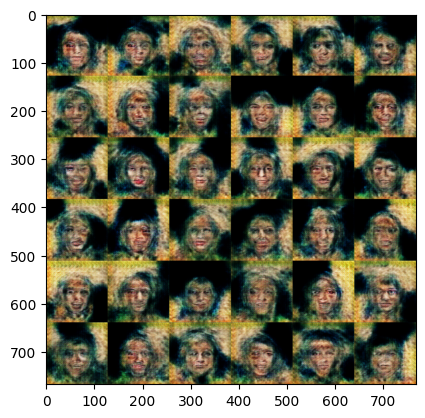

Training Progress:  77%|███████▋  | 11500/15000 [1:01:27<26:00,  2.24step/s]

****************************************************************************************************
1/1 [==============================] - 0s 18ms/step


Training Progress:  77%|███████▋  | 11501/15000 [1:01:27<23:46,  2.45step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11502/15000 [1:01:27<22:01,  2.65step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11503/15000 [1:01:28<20:44,  2.81step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11504/15000 [1:01:28<19:52,  2.93step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11505/15000 [1:01:28<19:20,  3.01step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11506/15000 [1:01:29<18:56,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  77%|███████▋  | 11507/15000 [1:01:29<18:37,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11508/15000 [1:01:29<18:22,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11509/15000 [1:01:30<18:15,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  77%|███████▋  | 11510/15000 [1:01:30<18:44,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11511/15000 [1:01:30<18:28,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  77%|███████▋  | 11512/15000 [1:01:31<18:17,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  77%|███████▋  | 11513/15000 [1:01:31<18:12,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11514/15000 [1:01:31<18:06,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  77%|███████▋  | 11515/15000 [1:01:31<18:07,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11516/15000 [1:01:32<18:02,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  77%|███████▋  | 11517/15000 [1:01:32<18:36,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  77%|███████▋  | 11518/15000 [1:01:32<18:30,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  77%|███████▋  | 11519/15000 [1:01:33<18:17,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11520/15000 [1:01:33<18:07,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11521/15000 [1:01:33<18:41,  3.10step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  77%|███████▋  | 11522/15000 [1:01:34<20:13,  2.87step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  77%|███████▋  | 11523/15000 [1:01:34<21:14,  2.73step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  77%|███████▋  | 11524/15000 [1:01:35<21:30,  2.69step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  77%|███████▋  | 11525/15000 [1:01:35<20:25,  2.84step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  77%|███████▋  | 11526/15000 [1:01:35<19:39,  2.94step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  77%|███████▋  | 11527/15000 [1:01:36<19:10,  3.02step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  77%|███████▋  | 11528/15000 [1:01:36<18:46,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11529/15000 [1:01:36<18:26,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  77%|███████▋  | 11530/15000 [1:01:36<18:16,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11531/15000 [1:01:37<18:06,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11532/15000 [1:01:37<18:02,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  77%|███████▋  | 11533/15000 [1:01:37<18:02,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  77%|███████▋  | 11534/15000 [1:01:38<17:58,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  77%|███████▋  | 11535/15000 [1:01:38<17:53,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  77%|███████▋  | 11536/15000 [1:01:38<17:51,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  77%|███████▋  | 11537/15000 [1:01:39<17:49,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  77%|███████▋  | 11538/15000 [1:01:39<17:47,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11539/15000 [1:01:39<17:44,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11540/15000 [1:01:40<17:50,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11541/15000 [1:01:40<17:47,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  77%|███████▋  | 11542/15000 [1:01:40<17:51,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11543/15000 [1:01:40<17:48,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  77%|███████▋  | 11544/15000 [1:01:41<17:47,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11545/15000 [1:01:41<17:42,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11546/15000 [1:01:41<18:19,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11547/15000 [1:01:42<18:03,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11548/15000 [1:01:42<17:54,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11549/15000 [1:01:42<18:31,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11550/15000 [1:01:43<18:15,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11551/15000 [1:01:43<18:00,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11552/15000 [1:01:43<17:59,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  77%|███████▋  | 11553/15000 [1:01:44<17:52,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11554/15000 [1:01:44<17:45,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11555/15000 [1:01:44<17:39,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11556/15000 [1:01:45<17:39,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11557/15000 [1:01:45<17:41,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11558/15000 [1:01:45<17:39,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11559/15000 [1:01:45<17:42,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11560/15000 [1:01:46<17:41,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  77%|███████▋  | 11561/15000 [1:01:46<17:46,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  77%|███████▋  | 11562/15000 [1:01:46<17:46,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  77%|███████▋  | 11563/15000 [1:01:47<17:44,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11564/15000 [1:01:47<17:44,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11565/15000 [1:01:47<17:41,  3.24step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  77%|███████▋  | 11566/15000 [1:01:48<17:44,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11567/15000 [1:01:48<18:18,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11568/15000 [1:01:48<18:06,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11569/15000 [1:01:49<17:56,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  77%|███████▋  | 11570/15000 [1:01:49<17:56,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11571/15000 [1:01:49<17:48,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11572/15000 [1:01:50<17:43,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  77%|███████▋  | 11573/15000 [1:01:50<18:14,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11574/15000 [1:01:50<18:02,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11575/15000 [1:01:50<17:51,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11576/15000 [1:01:51<17:46,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11577/15000 [1:01:51<17:39,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11578/15000 [1:01:51<17:38,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11579/15000 [1:01:52<18:14,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  77%|███████▋  | 11580/15000 [1:01:52<18:02,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  77%|███████▋  | 11581/15000 [1:01:52<18:34,  3.07step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11582/15000 [1:01:53<18:13,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  77%|███████▋  | 11583/15000 [1:01:53<18:00,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11584/15000 [1:01:53<17:49,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11585/15000 [1:01:54<17:42,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  77%|███████▋  | 11586/15000 [1:01:54<17:48,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11587/15000 [1:01:54<17:44,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  77%|███████▋  | 11588/15000 [1:01:55<17:46,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  77%|███████▋  | 11589/15000 [1:01:55<17:49,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  77%|███████▋  | 11590/15000 [1:01:55<17:44,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  77%|███████▋  | 11591/15000 [1:01:56<17:42,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11592/15000 [1:01:56<17:41,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11593/15000 [1:01:56<17:37,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11594/15000 [1:01:56<18:14,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  77%|███████▋  | 11595/15000 [1:01:57<18:00,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11596/15000 [1:01:57<17:51,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11597/15000 [1:01:57<17:44,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  77%|███████▋  | 11598/15000 [1:01:58<17:46,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  77%|███████▋  | 11599/15000 [1:01:58<17:50,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  77%|███████▋  | 11600/15000 [1:01:58<17:45,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11601/15000 [1:01:59<18:16,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11602/15000 [1:01:59<18:02,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  77%|███████▋  | 11603/15000 [1:01:59<17:53,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11604/15000 [1:02:00<17:46,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11605/15000 [1:02:00<18:19,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11606/15000 [1:02:00<18:04,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11607/15000 [1:02:01<17:55,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11608/15000 [1:02:01<17:46,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  77%|███████▋  | 11609/15000 [1:02:01<17:39,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11610/15000 [1:02:02<17:33,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11611/15000 [1:02:02<17:28,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11612/15000 [1:02:02<17:28,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  77%|███████▋  | 11613/15000 [1:02:02<18:13,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11614/15000 [1:02:03<17:56,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11615/15000 [1:02:03<17:46,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  77%|███████▋  | 11616/15000 [1:02:03<17:46,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  77%|███████▋  | 11617/15000 [1:02:04<17:45,  3.18step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  77%|███████▋  | 11618/15000 [1:02:04<17:47,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11619/15000 [1:02:04<17:40,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  77%|███████▋  | 11620/15000 [1:02:05<18:10,  3.10step/s]

1/1 [==============================] - 0s 30ms/step


Training Progress:  77%|███████▋  | 11621/15000 [1:02:05<19:52,  2.83step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  77%|███████▋  | 11622/15000 [1:02:05<20:20,  2.77step/s]

1/1 [==============================] - 0s 27ms/step


Training Progress:  77%|███████▋  | 11623/15000 [1:02:06<21:49,  2.58step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  77%|███████▋  | 11624/15000 [1:02:06<21:28,  2.62step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  78%|███████▊  | 11625/15000 [1:02:07<20:15,  2.78step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  78%|███████▊  | 11626/15000 [1:02:07<19:28,  2.89step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11627/15000 [1:02:07<18:50,  2.98step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11628/15000 [1:02:08<18:22,  3.06step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11629/15000 [1:02:08<18:03,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11630/15000 [1:02:08<17:48,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11631/15000 [1:02:08<17:39,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11632/15000 [1:02:09<17:32,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11633/15000 [1:02:09<17:26,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11634/15000 [1:02:09<17:21,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11635/15000 [1:02:10<17:22,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11636/15000 [1:02:10<17:20,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11637/15000 [1:02:10<17:57,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11638/15000 [1:02:11<17:46,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11639/15000 [1:02:11<17:37,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11640/15000 [1:02:11<17:28,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11641/15000 [1:02:12<17:23,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11642/15000 [1:02:12<17:22,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11643/15000 [1:02:12<17:25,  3.21step/s]

1/1 [==============================] - 0s 40ms/step


Training Progress:  78%|███████▊  | 11644/15000 [1:02:13<18:05,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  78%|███████▊  | 11645/15000 [1:02:13<17:51,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  78%|███████▊  | 11646/15000 [1:02:13<17:39,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  78%|███████▊  | 11647/15000 [1:02:14<18:07,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11648/15000 [1:02:14<17:50,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11649/15000 [1:02:14<17:38,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11650/15000 [1:02:14<17:28,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11651/15000 [1:02:15<17:25,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11652/15000 [1:02:15<17:17,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11653/15000 [1:02:15<17:20,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  78%|███████▊  | 11654/15000 [1:02:16<17:23,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  78%|███████▊  | 11655/15000 [1:02:16<17:59,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11656/15000 [1:02:16<18:18,  3.04step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11657/15000 [1:02:17<17:58,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11658/15000 [1:02:17<17:41,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11659/15000 [1:02:17<17:31,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11660/15000 [1:02:18<17:23,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11661/15000 [1:02:18<17:19,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11662/15000 [1:02:18<17:15,  3.22step/s]

1/1 [==============================] - 0s 28ms/step


Training Progress:  78%|███████▊  | 11663/15000 [1:02:19<17:26,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  78%|███████▊  | 11664/15000 [1:02:19<17:24,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  78%|███████▊  | 11665/15000 [1:02:19<17:19,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  78%|███████▊  | 11666/15000 [1:02:19<17:13,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11667/15000 [1:02:20<17:50,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11668/15000 [1:02:20<17:34,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11669/15000 [1:02:20<17:23,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11670/15000 [1:02:21<17:15,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  78%|███████▊  | 11671/15000 [1:02:21<17:49,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  78%|███████▊  | 11672/15000 [1:02:21<17:39,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11673/15000 [1:02:22<17:31,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11674/15000 [1:02:22<17:21,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11675/15000 [1:02:22<17:14,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  78%|███████▊  | 11676/15000 [1:02:23<17:09,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11677/15000 [1:02:23<17:07,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11678/15000 [1:02:23<17:03,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11679/15000 [1:02:24<17:03,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  78%|███████▊  | 11680/15000 [1:02:24<17:06,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  78%|███████▊  | 11681/15000 [1:02:24<17:09,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  78%|███████▊  | 11682/15000 [1:02:24<17:08,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  78%|███████▊  | 11683/15000 [1:02:25<17:11,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  78%|███████▊  | 11684/15000 [1:02:25<17:09,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11685/15000 [1:02:25<17:05,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11686/15000 [1:02:26<17:03,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  78%|███████▊  | 11687/15000 [1:02:26<17:03,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11688/15000 [1:02:26<16:59,  3.25step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:  78%|███████▊  | 11689/15000 [1:02:27<16:56,  3.26step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  78%|███████▊  | 11690/15000 [1:02:27<16:59,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  78%|███████▊  | 11691/15000 [1:02:27<17:36,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11692/15000 [1:02:28<17:21,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11693/15000 [1:02:28<17:11,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11694/15000 [1:02:28<17:41,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11695/15000 [1:02:29<17:26,  3.16step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  78%|███████▊  | 11696/15000 [1:02:29<17:30,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11697/15000 [1:02:29<17:19,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  78%|███████▊  | 11698/15000 [1:02:29<17:13,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  78%|███████▊  | 11699/15000 [1:02:30<17:08,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  78%|███████▊  | 11700/15000 [1:02:30<17:10,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  78%|███████▊  | 11701/15000 [1:02:30<17:08,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11702/15000 [1:02:31<17:04,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11703/15000 [1:02:31<17:03,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11704/15000 [1:02:31<17:01,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11705/15000 [1:02:32<16:55,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11706/15000 [1:02:32<17:29,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  78%|███████▊  | 11707/15000 [1:02:32<17:28,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  78%|███████▊  | 11708/15000 [1:02:33<17:21,  3.16step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  78%|███████▊  | 11709/15000 [1:02:33<17:54,  3.06step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  78%|███████▊  | 11710/15000 [1:02:33<17:38,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11711/15000 [1:02:34<17:23,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11712/15000 [1:02:34<17:50,  3.07step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11713/15000 [1:02:34<18:07,  3.02step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11714/15000 [1:02:35<17:46,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11715/15000 [1:02:35<17:29,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11716/15000 [1:02:35<17:17,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  78%|███████▊  | 11717/15000 [1:02:36<17:09,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  78%|███████▊  | 11718/15000 [1:02:36<17:11,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  78%|███████▊  | 11719/15000 [1:02:36<17:12,  3.18step/s]

1/1 [==============================] - 0s 29ms/step


Training Progress:  78%|███████▊  | 11720/15000 [1:02:37<18:22,  2.98step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  78%|███████▊  | 11721/15000 [1:02:37<20:10,  2.71step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  78%|███████▊  | 11722/15000 [1:02:37<20:14,  2.70step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  78%|███████▊  | 11723/15000 [1:02:38<20:01,  2.73step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  78%|███████▊  | 11724/15000 [1:02:38<19:07,  2.85step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  78%|███████▊  | 11725/15000 [1:02:38<18:25,  2.96step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11726/15000 [1:02:39<17:55,  3.04step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  78%|███████▊  | 11727/15000 [1:02:39<17:40,  3.09step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  78%|███████▊  | 11728/15000 [1:02:39<17:30,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  78%|███████▊  | 11729/15000 [1:02:40<17:16,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  78%|███████▊  | 11730/15000 [1:02:40<17:10,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11731/15000 [1:02:40<17:01,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  78%|███████▊  | 11732/15000 [1:02:41<16:57,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11733/15000 [1:02:41<16:52,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11734/15000 [1:02:41<17:23,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  78%|███████▊  | 11735/15000 [1:02:41<17:09,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11736/15000 [1:02:42<17:00,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11737/15000 [1:02:42<17:02,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  78%|███████▊  | 11738/15000 [1:02:42<17:05,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  78%|███████▊  | 11739/15000 [1:02:43<16:57,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11740/15000 [1:02:43<16:52,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  78%|███████▊  | 11741/15000 [1:02:43<16:49,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11742/15000 [1:02:44<17:25,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11743/15000 [1:02:44<17:47,  3.05step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  78%|███████▊  | 11744/15000 [1:02:44<17:30,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11745/15000 [1:02:45<17:13,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11746/15000 [1:02:45<17:09,  3.16step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  78%|███████▊  | 11747/15000 [1:02:45<17:05,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11748/15000 [1:02:46<16:58,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11749/15000 [1:02:46<16:53,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11750/15000 [1:02:46<16:47,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11751/15000 [1:02:46<16:44,  3.24step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  78%|███████▊  | 11752/15000 [1:02:47<16:53,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  78%|███████▊  | 11753/15000 [1:02:47<16:49,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  78%|███████▊  | 11754/15000 [1:02:47<16:47,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11755/15000 [1:02:48<16:46,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  78%|███████▊  | 11756/15000 [1:02:48<16:45,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  78%|███████▊  | 11757/15000 [1:02:48<16:42,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11758/15000 [1:02:49<16:40,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11759/15000 [1:02:49<16:37,  3.25step/s]

1/1 [==============================] - 0s 29ms/step


Training Progress:  78%|███████▊  | 11760/15000 [1:02:49<16:48,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11761/15000 [1:02:50<17:17,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11762/15000 [1:02:50<17:05,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11763/15000 [1:02:50<16:55,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  78%|███████▊  | 11764/15000 [1:02:51<16:55,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  78%|███████▊  | 11765/15000 [1:02:51<16:50,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11766/15000 [1:02:51<16:46,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11767/15000 [1:02:51<16:41,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11768/15000 [1:02:52<17:12,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11769/15000 [1:02:52<16:59,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  78%|███████▊  | 11770/15000 [1:02:52<17:44,  3.03step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11771/15000 [1:02:53<17:20,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11772/15000 [1:02:53<17:04,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  78%|███████▊  | 11773/15000 [1:02:53<16:55,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  78%|███████▊  | 11774/15000 [1:02:54<16:57,  3.17step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  78%|███████▊  | 11775/15000 [1:02:54<21:46,  2.47step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  79%|███████▊  | 11776/15000 [1:02:55<20:19,  2.64step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  79%|███████▊  | 11777/15000 [1:02:55<19:54,  2.70step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  79%|███████▊  | 11778/15000 [1:02:55<19:06,  2.81step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  79%|███████▊  | 11779/15000 [1:02:56<18:25,  2.91step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  79%|███████▊  | 11780/15000 [1:02:56<17:59,  2.98step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  79%|███████▊  | 11781/15000 [1:02:56<17:39,  3.04step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  79%|███████▊  | 11782/15000 [1:02:57<18:02,  2.97step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  79%|███████▊  | 11783/15000 [1:02:57<17:40,  3.03step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  79%|███████▊  | 11784/15000 [1:02:57<17:33,  3.05step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  79%|███████▊  | 11785/15000 [1:02:58<17:28,  3.07step/s]

1/1 [==============================] - 0s 23ms/step


Training Progress:  79%|███████▊  | 11786/15000 [1:02:58<17:21,  3.08step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  79%|███████▊  | 11787/15000 [1:02:58<17:12,  3.11step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  79%|███████▊  | 11788/15000 [1:02:59<17:08,  3.12step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  79%|███████▊  | 11789/15000 [1:02:59<17:03,  3.14step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  79%|███████▊  | 11790/15000 [1:02:59<17:00,  3.15step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  79%|███████▊  | 11791/15000 [1:03:00<17:35,  3.04step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  79%|███████▊  | 11792/15000 [1:03:00<17:20,  3.08step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  79%|███████▊  | 11793/15000 [1:03:00<17:18,  3.09step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  79%|███████▊  | 11794/15000 [1:03:00<17:10,  3.11step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  79%|███████▊  | 11795/15000 [1:03:01<17:02,  3.13step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  79%|███████▊  | 11796/15000 [1:03:01<17:00,  3.14step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  79%|███████▊  | 11797/15000 [1:03:01<17:29,  3.05step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  79%|███████▊  | 11798/15000 [1:03:02<17:16,  3.09step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  79%|███████▊  | 11799/15000 [1:03:02<17:13,  3.10step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  79%|███████▊  | 11800/15000 [1:03:02<17:12,  3.10step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  79%|███████▊  | 11801/15000 [1:03:03<17:02,  3.13step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  79%|███████▊  | 11802/15000 [1:03:03<17:39,  3.02step/s]

1/1 [==============================] - 0s 23ms/step


Training Progress:  79%|███████▊  | 11803/15000 [1:03:03<17:27,  3.05step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  79%|███████▊  | 11804/15000 [1:03:04<17:14,  3.09step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  79%|███████▊  | 11805/15000 [1:03:04<17:40,  3.01step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  79%|███████▊  | 11806/15000 [1:03:04<17:23,  3.06step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  79%|███████▊  | 11807/15000 [1:03:05<17:11,  3.10step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  79%|███████▊  | 11808/15000 [1:03:05<17:08,  3.10step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  79%|███████▊  | 11809/15000 [1:03:05<17:00,  3.13step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  79%|███████▊  | 11810/15000 [1:03:06<16:56,  3.14step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  79%|███████▊  | 11811/15000 [1:03:06<17:04,  3.11step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  79%|███████▊  | 11812/15000 [1:03:06<16:59,  3.13step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  79%|███████▉  | 11813/15000 [1:03:07<16:53,  3.14step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  79%|███████▉  | 11814/15000 [1:03:07<16:51,  3.15step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  79%|███████▉  | 11815/15000 [1:03:07<16:48,  3.16step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  79%|███████▉  | 11816/15000 [1:03:08<16:48,  3.16step/s]

1/1 [==============================] - 0s 40ms/step


Training Progress:  79%|███████▉  | 11817/15000 [1:03:08<18:13,  2.91step/s]

1/1 [==============================] - 0s 47ms/step


Training Progress:  79%|███████▉  | 11818/15000 [1:03:08<19:28,  2.72step/s]

1/1 [==============================] - 0s 29ms/step


Training Progress:  79%|███████▉  | 11819/15000 [1:03:09<20:16,  2.62step/s]

1/1 [==============================] - 0s 28ms/step


Training Progress:  79%|███████▉  | 11820/15000 [1:03:09<20:11,  2.63step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  79%|███████▉  | 11821/15000 [1:03:10<19:43,  2.69step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  79%|███████▉  | 11822/15000 [1:03:10<19:26,  2.73step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  79%|███████▉  | 11823/15000 [1:03:10<18:38,  2.84step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  79%|███████▉  | 11824/15000 [1:03:11<18:04,  2.93step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  79%|███████▉  | 11825/15000 [1:03:11<17:41,  2.99step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  79%|███████▉  | 11826/15000 [1:03:11<17:24,  3.04step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  79%|███████▉  | 11827/15000 [1:03:11<17:44,  2.98step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  79%|███████▉  | 11828/15000 [1:03:12<17:25,  3.03step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  79%|███████▉  | 11829/15000 [1:03:12<17:51,  2.96step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  79%|███████▉  | 11830/15000 [1:03:13<17:48,  2.97step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  79%|███████▉  | 11831/15000 [1:03:13<17:59,  2.94step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  79%|███████▉  | 11832/15000 [1:03:13<17:37,  3.00step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  79%|███████▉  | 11833/15000 [1:03:13<17:16,  3.06step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  79%|███████▉  | 11834/15000 [1:03:14<17:03,  3.09step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  79%|███████▉  | 11835/15000 [1:03:14<17:27,  3.02step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  79%|███████▉  | 11836/15000 [1:03:14<17:11,  3.07step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  79%|███████▉  | 11837/15000 [1:03:15<17:32,  3.00step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  79%|███████▉  | 11838/15000 [1:03:15<17:19,  3.04step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  79%|███████▉  | 11839/15000 [1:03:15<17:04,  3.08step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  79%|███████▉  | 11840/15000 [1:03:16<16:54,  3.11step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  79%|███████▉  | 11841/15000 [1:03:16<16:46,  3.14step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  79%|███████▉  | 11842/15000 [1:03:16<16:44,  3.14step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  79%|███████▉  | 11843/15000 [1:03:17<16:37,  3.17step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  79%|███████▉  | 11844/15000 [1:03:17<16:34,  3.17step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  79%|███████▉  | 11845/15000 [1:03:17<16:30,  3.19step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  79%|███████▉  | 11846/15000 [1:03:18<16:32,  3.18step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  79%|███████▉  | 11847/15000 [1:03:18<16:38,  3.16step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  79%|███████▉  | 11848/15000 [1:03:18<17:10,  3.06step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  79%|███████▉  | 11849/15000 [1:03:19<16:58,  3.09step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  79%|███████▉  | 11850/15000 [1:03:19<16:51,  3.11step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  79%|███████▉  | 11851/15000 [1:03:19<16:41,  3.14step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  79%|███████▉  | 11852/15000 [1:03:20<16:36,  3.16step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  79%|███████▉  | 11853/15000 [1:03:20<17:05,  3.07step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  79%|███████▉  | 11854/15000 [1:03:20<16:51,  3.11step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  79%|███████▉  | 11855/15000 [1:03:21<16:41,  3.14step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  79%|███████▉  | 11856/15000 [1:03:21<16:40,  3.14step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  79%|███████▉  | 11857/15000 [1:03:21<17:07,  3.06step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  79%|███████▉  | 11858/15000 [1:03:22<16:51,  3.11step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  79%|███████▉  | 11859/15000 [1:03:22<16:47,  3.12step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  79%|███████▉  | 11860/15000 [1:03:22<17:13,  3.04step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  79%|███████▉  | 11861/15000 [1:03:23<17:47,  2.94step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  79%|███████▉  | 11862/15000 [1:03:23<17:20,  3.02step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  79%|███████▉  | 11863/15000 [1:03:23<16:59,  3.08step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  79%|███████▉  | 11864/15000 [1:03:23<16:45,  3.12step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  79%|███████▉  | 11865/15000 [1:03:24<16:41,  3.13step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  79%|███████▉  | 11866/15000 [1:03:24<16:34,  3.15step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  79%|███████▉  | 11867/15000 [1:03:24<16:25,  3.18step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  79%|███████▉  | 11868/15000 [1:03:25<16:23,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  79%|███████▉  | 11869/15000 [1:03:25<16:21,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  79%|███████▉  | 11870/15000 [1:03:25<16:19,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  79%|███████▉  | 11871/15000 [1:03:26<16:15,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  79%|███████▉  | 11872/15000 [1:03:26<16:47,  3.10step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  79%|███████▉  | 11873/15000 [1:03:26<16:34,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  79%|███████▉  | 11874/15000 [1:03:27<16:21,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  79%|███████▉  | 11875/15000 [1:03:27<16:21,  3.18step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  79%|███████▉  | 11876/15000 [1:03:27<16:16,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  79%|███████▉  | 11877/15000 [1:03:28<16:12,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  79%|███████▉  | 11878/15000 [1:03:28<16:08,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  79%|███████▉  | 11879/15000 [1:03:28<16:06,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  79%|███████▉  | 11880/15000 [1:03:28<16:09,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  79%|███████▉  | 11881/15000 [1:03:29<16:08,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  79%|███████▉  | 11882/15000 [1:03:29<16:06,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  79%|███████▉  | 11883/15000 [1:03:29<16:02,  3.24step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  79%|███████▉  | 11884/15000 [1:03:30<16:07,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  79%|███████▉  | 11885/15000 [1:03:30<16:08,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  79%|███████▉  | 11886/15000 [1:03:30<16:05,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  79%|███████▉  | 11887/15000 [1:03:31<16:01,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  79%|███████▉  | 11888/15000 [1:03:31<15:58,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  79%|███████▉  | 11889/15000 [1:03:31<15:55,  3.26step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:  79%|███████▉  | 11890/15000 [1:03:32<15:52,  3.27step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  79%|███████▉  | 11891/15000 [1:03:32<15:49,  3.27step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  79%|███████▉  | 11892/15000 [1:03:32<15:50,  3.27step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  79%|███████▉  | 11893/15000 [1:03:32<16:11,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  79%|███████▉  | 11894/15000 [1:03:33<16:08,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  79%|███████▉  | 11895/15000 [1:03:33<16:02,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  79%|███████▉  | 11896/15000 [1:03:33<15:59,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  79%|███████▉  | 11897/15000 [1:03:34<15:54,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  79%|███████▉  | 11898/15000 [1:03:34<15:54,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  79%|███████▉  | 11899/15000 [1:03:34<15:52,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  79%|███████▉  | 11900/15000 [1:03:35<15:49,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  79%|███████▉  | 11901/15000 [1:03:35<15:50,  3.26step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  79%|███████▉  | 11902/15000 [1:03:35<15:54,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  79%|███████▉  | 11903/15000 [1:03:36<15:53,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  79%|███████▉  | 11904/15000 [1:03:36<15:52,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  79%|███████▉  | 11905/15000 [1:03:36<15:50,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  79%|███████▉  | 11906/15000 [1:03:36<15:49,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  79%|███████▉  | 11907/15000 [1:03:37<15:48,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  79%|███████▉  | 11908/15000 [1:03:37<15:47,  3.26step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  79%|███████▉  | 11909/15000 [1:03:37<15:49,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  79%|███████▉  | 11910/15000 [1:03:38<15:48,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  79%|███████▉  | 11911/15000 [1:03:38<15:46,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  79%|███████▉  | 11912/15000 [1:03:38<15:52,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  79%|███████▉  | 11913/15000 [1:03:39<15:51,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  79%|███████▉  | 11914/15000 [1:03:39<15:50,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  79%|███████▉  | 11915/15000 [1:03:39<17:13,  2.98step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  79%|███████▉  | 11916/15000 [1:03:40<18:52,  2.72step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  79%|███████▉  | 11917/15000 [1:03:40<20:07,  2.55step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  79%|███████▉  | 11918/15000 [1:03:41<19:42,  2.61step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  79%|███████▉  | 11919/15000 [1:03:41<18:31,  2.77step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  79%|███████▉  | 11920/15000 [1:03:41<17:42,  2.90step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  79%|███████▉  | 11921/15000 [1:03:42<17:11,  2.98step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  79%|███████▉  | 11922/15000 [1:03:42<16:46,  3.06step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  79%|███████▉  | 11923/15000 [1:03:42<16:29,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  79%|███████▉  | 11924/15000 [1:03:42<16:21,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  80%|███████▉  | 11925/15000 [1:03:43<16:09,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|███████▉  | 11926/15000 [1:03:43<16:05,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|███████▉  | 11927/15000 [1:03:43<15:59,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|███████▉  | 11928/15000 [1:03:44<15:54,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|███████▉  | 11929/15000 [1:03:44<16:28,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  80%|███████▉  | 11930/15000 [1:03:44<16:19,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|███████▉  | 11931/15000 [1:03:45<16:09,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|███████▉  | 11932/15000 [1:03:45<15:59,  3.20step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  80%|███████▉  | 11933/15000 [1:03:45<16:33,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|███████▉  | 11934/15000 [1:03:46<16:16,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|███████▉  | 11935/15000 [1:03:46<16:06,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|███████▉  | 11936/15000 [1:03:46<15:58,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  80%|███████▉  | 11937/15000 [1:03:47<15:53,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  80%|███████▉  | 11938/15000 [1:03:47<15:48,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  80%|███████▉  | 11939/15000 [1:03:47<16:28,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  80%|███████▉  | 11940/15000 [1:03:48<16:16,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|███████▉  | 11941/15000 [1:03:48<16:06,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  80%|███████▉  | 11942/15000 [1:03:48<15:57,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|███████▉  | 11943/15000 [1:03:48<15:52,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  80%|███████▉  | 11944/15000 [1:03:49<15:46,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|███████▉  | 11945/15000 [1:03:49<15:43,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|███████▉  | 11946/15000 [1:03:49<16:46,  3.03step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|███████▉  | 11947/15000 [1:03:50<16:27,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|███████▉  | 11948/15000 [1:03:50<16:10,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  80%|███████▉  | 11949/15000 [1:03:50<16:05,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  80%|███████▉  | 11950/15000 [1:03:51<15:58,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  80%|███████▉  | 11951/15000 [1:03:51<15:54,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|███████▉  | 11952/15000 [1:03:51<15:47,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|███████▉  | 11953/15000 [1:03:52<15:43,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|███████▉  | 11954/15000 [1:03:52<15:38,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|███████▉  | 11955/15000 [1:03:52<15:42,  3.23step/s]

1/1 [==============================] - 0s 29ms/step


Training Progress:  80%|███████▉  | 11956/15000 [1:03:53<16:03,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|███████▉  | 11957/15000 [1:03:53<15:54,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  80%|███████▉  | 11958/15000 [1:03:53<16:26,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|███████▉  | 11959/15000 [1:03:54<16:12,  3.13step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  80%|███████▉  | 11960/15000 [1:03:54<16:05,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|███████▉  | 11961/15000 [1:03:54<15:56,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  80%|███████▉  | 11962/15000 [1:03:54<15:56,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|███████▉  | 11963/15000 [1:03:55<15:50,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  80%|███████▉  | 11964/15000 [1:03:55<15:51,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|███████▉  | 11965/15000 [1:03:55<15:44,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|███████▉  | 11966/15000 [1:03:56<15:38,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|███████▉  | 11967/15000 [1:03:56<15:40,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  80%|███████▉  | 11968/15000 [1:03:56<16:10,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|███████▉  | 11969/15000 [1:03:57<15:57,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|███████▉  | 11970/15000 [1:03:57<15:50,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|███████▉  | 11971/15000 [1:03:57<15:44,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  80%|███████▉  | 11972/15000 [1:03:58<16:13,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|███████▉  | 11973/15000 [1:03:58<15:59,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  80%|███████▉  | 11974/15000 [1:03:58<16:22,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|███████▉  | 11975/15000 [1:03:59<16:38,  3.03step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|███████▉  | 11976/15000 [1:03:59<16:21,  3.08step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  80%|███████▉  | 11977/15000 [1:03:59<16:08,  3.12step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  80%|███████▉  | 11978/15000 [1:04:00<16:02,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  80%|███████▉  | 11979/15000 [1:04:00<15:52,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|███████▉  | 11980/15000 [1:04:00<15:47,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|███████▉  | 11981/15000 [1:04:00<15:39,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|███████▉  | 11982/15000 [1:04:01<15:33,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|███████▉  | 11983/15000 [1:04:01<15:30,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|███████▉  | 11984/15000 [1:04:01<15:27,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|███████▉  | 11985/15000 [1:04:02<15:23,  3.26step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  80%|███████▉  | 11986/15000 [1:04:02<15:28,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  80%|███████▉  | 11987/15000 [1:04:02<15:30,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  80%|███████▉  | 11988/15000 [1:04:03<16:21,  3.07step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|███████▉  | 11989/15000 [1:04:03<16:34,  3.03step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|███████▉  | 11990/15000 [1:04:03<16:13,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|███████▉  | 11991/15000 [1:04:04<15:59,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|███████▉  | 11992/15000 [1:04:04<15:49,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  80%|███████▉  | 11993/15000 [1:04:04<15:42,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  80%|███████▉  | 11994/15000 [1:04:05<15:39,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  80%|███████▉  | 11995/15000 [1:04:05<15:40,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|███████▉  | 11996/15000 [1:04:05<15:39,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|███████▉  | 11997/15000 [1:04:05<15:33,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|███████▉  | 11998/15000 [1:04:06<16:02,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|███████▉  | 11999/15000 [1:04:06<15:50,  3.16step/s]

1/1 [==============================] - 0s 16ms/step
****************************************************************************************************
12000/15000: d_loss: 0.134638,  g_loss: 0.087423
2/2 [==============================] - 0s 20ms/step


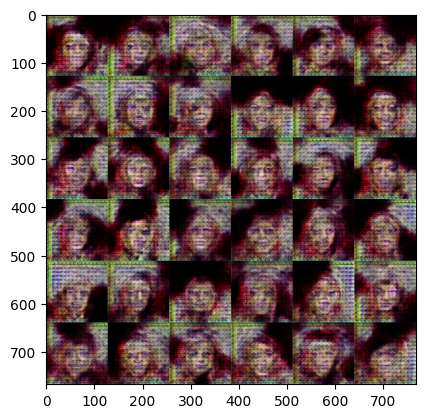

Training Progress:  80%|████████  | 12000/15000 [1:04:07<21:47,  2.29step/s]

****************************************************************************************************
1/1 [==============================] - 0s 17ms/step


Training Progress:  80%|████████  | 12001/15000 [1:04:07<20:02,  2.49step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  80%|████████  | 12002/15000 [1:04:07<18:46,  2.66step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  80%|████████  | 12003/15000 [1:04:08<17:46,  2.81step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:  80%|████████  | 12004/15000 [1:04:08<17:03,  2.93step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|████████  | 12005/15000 [1:04:08<16:33,  3.02step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|████████  | 12006/15000 [1:04:09<16:10,  3.08step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  80%|████████  | 12007/15000 [1:04:09<15:59,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|████████  | 12008/15000 [1:04:09<15:47,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|████████  | 12009/15000 [1:04:10<15:39,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|████████  | 12010/15000 [1:04:10<15:32,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  80%|████████  | 12011/15000 [1:04:10<15:29,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|████████  | 12012/15000 [1:04:11<16:36,  3.00step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  80%|████████  | 12013/15000 [1:04:11<17:15,  2.89step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  80%|████████  | 12014/15000 [1:04:11<18:41,  2.66step/s]

1/1 [==============================] - 0s 23ms/step


Training Progress:  80%|████████  | 12015/15000 [1:04:12<18:37,  2.67step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|████████  | 12016/15000 [1:04:12<17:36,  2.83step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  80%|████████  | 12017/15000 [1:04:12<17:35,  2.83step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|████████  | 12018/15000 [1:04:13<16:54,  2.94step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  80%|████████  | 12019/15000 [1:04:13<16:25,  3.02step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  80%|████████  | 12020/15000 [1:04:13<16:06,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|████████  | 12021/15000 [1:04:14<15:49,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  80%|████████  | 12022/15000 [1:04:14<15:38,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  80%|████████  | 12023/15000 [1:04:14<15:30,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|████████  | 12024/15000 [1:04:15<15:23,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|████████  | 12025/15000 [1:04:15<15:17,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|████████  | 12026/15000 [1:04:15<15:18,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  80%|████████  | 12027/15000 [1:04:16<15:17,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|████████  | 12028/15000 [1:04:16<15:15,  3.25step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  80%|████████  | 12029/15000 [1:04:16<15:14,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|████████  | 12030/15000 [1:04:16<15:12,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|████████  | 12031/15000 [1:04:17<15:11,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|████████  | 12032/15000 [1:04:17<15:11,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  80%|████████  | 12033/15000 [1:04:17<15:11,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|████████  | 12034/15000 [1:04:18<15:09,  3.26step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  80%|████████  | 12035/15000 [1:04:18<15:16,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  80%|████████  | 12036/15000 [1:04:18<15:48,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  80%|████████  | 12037/15000 [1:04:19<15:36,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|████████  | 12038/15000 [1:04:19<15:26,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|████████  | 12039/15000 [1:04:19<15:19,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  80%|████████  | 12040/15000 [1:04:20<15:18,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|████████  | 12041/15000 [1:04:20<15:13,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|████████  | 12042/15000 [1:04:20<15:12,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|████████  | 12043/15000 [1:04:21<15:08,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|████████  | 12044/15000 [1:04:21<15:11,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  80%|████████  | 12045/15000 [1:04:21<15:10,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|████████  | 12046/15000 [1:04:21<15:40,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|████████  | 12047/15000 [1:04:22<15:27,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|████████  | 12048/15000 [1:04:22<15:23,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|████████  | 12049/15000 [1:04:22<15:24,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|████████  | 12050/15000 [1:04:23<15:17,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|████████  | 12051/15000 [1:04:23<15:12,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|████████  | 12052/15000 [1:04:23<15:08,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|████████  | 12053/15000 [1:04:24<15:06,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  80%|████████  | 12054/15000 [1:04:24<15:42,  3.12step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  80%|████████  | 12055/15000 [1:04:24<15:32,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  80%|████████  | 12056/15000 [1:04:25<15:54,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|████████  | 12057/15000 [1:04:25<15:37,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  80%|████████  | 12058/15000 [1:04:25<15:30,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  80%|████████  | 12059/15000 [1:04:26<15:21,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  80%|████████  | 12060/15000 [1:04:26<15:16,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  80%|████████  | 12061/15000 [1:04:26<15:11,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|████████  | 12062/15000 [1:04:26<15:09,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|████████  | 12063/15000 [1:04:27<15:10,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  80%|████████  | 12064/15000 [1:04:27<15:08,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|████████  | 12065/15000 [1:04:27<15:06,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|████████  | 12066/15000 [1:04:28<15:02,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  80%|████████  | 12067/15000 [1:04:28<15:03,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|████████  | 12068/15000 [1:04:28<15:04,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|████████  | 12069/15000 [1:04:29<15:01,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|████████  | 12070/15000 [1:04:29<14:58,  3.26step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  80%|████████  | 12071/15000 [1:04:29<14:57,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  80%|████████  | 12072/15000 [1:04:30<15:01,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  80%|████████  | 12073/15000 [1:04:30<14:59,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  80%|████████  | 12074/15000 [1:04:30<15:00,  3.25step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  80%|████████  | 12075/15000 [1:04:30<15:03,  3.24step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:  81%|████████  | 12076/15000 [1:04:31<14:58,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████  | 12077/15000 [1:04:31<15:26,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████  | 12078/15000 [1:04:31<15:47,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████  | 12079/15000 [1:04:32<15:28,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████  | 12080/15000 [1:04:32<15:17,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  81%|████████  | 12081/15000 [1:04:32<15:51,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  81%|████████  | 12082/15000 [1:04:33<15:34,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████  | 12083/15000 [1:04:33<15:22,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████  | 12084/15000 [1:04:33<15:14,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  81%|████████  | 12085/15000 [1:04:34<15:11,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████  | 12086/15000 [1:04:34<15:04,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  81%|████████  | 12087/15000 [1:04:34<15:03,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████  | 12088/15000 [1:04:35<14:59,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████  | 12089/15000 [1:04:35<15:27,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████  | 12090/15000 [1:04:35<15:16,  3.17step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  81%|████████  | 12091/15000 [1:04:36<15:48,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  81%|████████  | 12092/15000 [1:04:36<15:31,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████  | 12093/15000 [1:04:36<15:18,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  81%|████████  | 12094/15000 [1:04:37<15:41,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████  | 12095/15000 [1:04:37<15:24,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████  | 12096/15000 [1:04:37<15:46,  3.07step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████  | 12097/15000 [1:04:38<15:59,  3.03step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████  | 12098/15000 [1:04:38<15:37,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████  | 12099/15000 [1:04:38<15:21,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  81%|████████  | 12100/15000 [1:04:38<15:46,  3.06step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  81%|████████  | 12101/15000 [1:04:39<16:02,  3.01step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████  | 12102/15000 [1:04:39<15:39,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████  | 12103/15000 [1:04:39<15:21,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████  | 12104/15000 [1:04:40<15:09,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████  | 12105/15000 [1:04:40<15:01,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████  | 12106/15000 [1:04:40<14:54,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  81%|████████  | 12107/15000 [1:04:41<14:51,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  81%|████████  | 12108/15000 [1:04:41<14:51,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  81%|████████  | 12109/15000 [1:04:41<14:53,  3.24step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  81%|████████  | 12110/15000 [1:04:42<14:51,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████  | 12111/15000 [1:04:42<14:47,  3.26step/s]

1/1 [==============================] - 0s 28ms/step


Training Progress:  81%|████████  | 12112/15000 [1:04:42<16:22,  2.94step/s]

1/1 [==============================] - 0s 43ms/step


Training Progress:  81%|████████  | 12113/15000 [1:04:43<17:44,  2.71step/s]

1/1 [==============================] - 0s 23ms/step


Training Progress:  81%|████████  | 12114/15000 [1:04:43<18:48,  2.56step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████  | 12115/15000 [1:04:43<17:40,  2.72step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████  | 12116/15000 [1:04:44<16:45,  2.87step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████  | 12117/15000 [1:04:44<16:08,  2.98step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  81%|████████  | 12118/15000 [1:04:44<15:47,  3.04step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  81%|████████  | 12119/15000 [1:04:45<15:30,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  81%|████████  | 12120/15000 [1:04:45<15:17,  3.14step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  81%|████████  | 12121/15000 [1:04:45<15:10,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████  | 12122/15000 [1:04:46<15:01,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  81%|████████  | 12123/15000 [1:04:46<14:55,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████  | 12124/15000 [1:04:46<14:51,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  81%|████████  | 12125/15000 [1:04:47<14:47,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████  | 12126/15000 [1:04:47<14:44,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  81%|████████  | 12127/15000 [1:04:47<14:42,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████  | 12128/15000 [1:04:47<14:45,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  81%|████████  | 12129/15000 [1:04:48<14:44,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████  | 12130/15000 [1:04:48<14:42,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  81%|████████  | 12131/15000 [1:04:48<14:41,  3.26step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  81%|████████  | 12132/15000 [1:04:49<14:41,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████  | 12133/15000 [1:04:49<14:38,  3.26step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  81%|████████  | 12134/15000 [1:04:49<14:41,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████  | 12135/15000 [1:04:50<15:10,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  81%|████████  | 12136/15000 [1:04:50<15:31,  3.07step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  81%|████████  | 12137/15000 [1:04:50<15:24,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  81%|████████  | 12138/15000 [1:04:51<15:09,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████  | 12139/15000 [1:04:51<15:28,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████  | 12140/15000 [1:04:51<15:12,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████  | 12141/15000 [1:04:52<15:02,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████  | 12142/15000 [1:04:52<14:53,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████  | 12143/15000 [1:04:52<14:55,  3.19step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  81%|████████  | 12144/15000 [1:04:53<15:18,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████  | 12145/15000 [1:04:53<15:10,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  81%|████████  | 12146/15000 [1:04:53<15:35,  3.05step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  81%|████████  | 12147/15000 [1:04:54<15:21,  3.09step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  81%|████████  | 12148/15000 [1:04:54<15:15,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████  | 12149/15000 [1:04:54<15:04,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████  | 12150/15000 [1:04:54<14:58,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████  | 12151/15000 [1:04:55<14:53,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████  | 12152/15000 [1:04:55<14:48,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████  | 12153/15000 [1:04:55<14:46,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  81%|████████  | 12154/15000 [1:04:56<15:15,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  81%|████████  | 12155/15000 [1:04:56<15:09,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  81%|████████  | 12156/15000 [1:04:56<15:04,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████  | 12157/15000 [1:04:57<14:56,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  81%|████████  | 12158/15000 [1:04:57<14:52,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  81%|████████  | 12159/15000 [1:04:57<14:51,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████  | 12160/15000 [1:04:58<14:46,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  81%|████████  | 12161/15000 [1:04:58<14:47,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████  | 12162/15000 [1:04:58<14:42,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  81%|████████  | 12163/15000 [1:04:59<14:43,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████  | 12164/15000 [1:04:59<14:41,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  81%|████████  | 12165/15000 [1:04:59<14:44,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  81%|████████  | 12166/15000 [1:04:59<14:46,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████  | 12167/15000 [1:05:00<14:40,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████  | 12168/15000 [1:05:00<14:38,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  81%|████████  | 12169/15000 [1:05:00<14:38,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████  | 12170/15000 [1:05:01<14:35,  3.23step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  81%|████████  | 12171/15000 [1:05:01<14:37,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  81%|████████  | 12172/15000 [1:05:01<14:34,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████  | 12173/15000 [1:05:02<14:32,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  81%|████████  | 12174/15000 [1:05:02<15:06,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  81%|████████  | 12175/15000 [1:05:02<15:01,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  81%|████████  | 12176/15000 [1:05:03<15:00,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  81%|████████  | 12177/15000 [1:05:03<14:52,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  81%|████████  | 12178/15000 [1:05:03<14:44,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████  | 12179/15000 [1:05:04<14:39,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  81%|████████  | 12180/15000 [1:05:04<14:34,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████  | 12181/15000 [1:05:04<14:31,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████  | 12182/15000 [1:05:04<14:28,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  81%|████████  | 12183/15000 [1:05:05<14:34,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  81%|████████  | 12184/15000 [1:05:05<14:34,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████  | 12185/15000 [1:05:05<14:33,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████  | 12186/15000 [1:05:06<14:28,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████  | 12187/15000 [1:05:06<14:28,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████▏ | 12188/15000 [1:05:06<14:56,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████▏ | 12189/15000 [1:05:07<15:18,  3.06step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████▏ | 12190/15000 [1:05:07<15:01,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  81%|████████▏ | 12191/15000 [1:05:07<14:52,  3.15step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  81%|████████▏ | 12192/15000 [1:05:08<14:48,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  81%|████████▏ | 12193/15000 [1:05:08<14:41,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████▏ | 12194/15000 [1:05:08<14:33,  3.21step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:  81%|████████▏ | 12195/15000 [1:05:09<14:29,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████▏ | 12196/15000 [1:05:09<14:23,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████▏ | 12197/15000 [1:05:09<14:22,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████▏ | 12198/15000 [1:05:09<14:18,  3.27step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████▏ | 12199/15000 [1:05:10<14:18,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████▏ | 12200/15000 [1:05:10<14:17,  3.26step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  81%|████████▏ | 12201/15000 [1:05:10<14:21,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████▏ | 12202/15000 [1:05:11<14:23,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████▏ | 12203/15000 [1:05:11<14:21,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████▏ | 12204/15000 [1:05:11<14:19,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  81%|████████▏ | 12205/15000 [1:05:12<14:20,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████▏ | 12206/15000 [1:05:12<14:17,  3.26step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  81%|████████▏ | 12207/15000 [1:05:12<14:18,  3.25step/s]

1/1 [==============================] - 0s 35ms/step


Training Progress:  81%|████████▏ | 12208/15000 [1:05:13<15:11,  3.06step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████▏ | 12209/15000 [1:05:13<14:56,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████▏ | 12210/15000 [1:05:13<14:44,  3.16step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  81%|████████▏ | 12211/15000 [1:05:14<16:25,  2.83step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  81%|████████▏ | 12212/15000 [1:05:14<17:39,  2.63step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  81%|████████▏ | 12213/15000 [1:05:15<18:38,  2.49step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  81%|████████▏ | 12214/15000 [1:05:15<18:04,  2.57step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████▏ | 12215/15000 [1:05:15<17:26,  2.66step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  81%|████████▏ | 12216/15000 [1:05:16<16:29,  2.81step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████▏ | 12217/15000 [1:05:16<15:49,  2.93step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████▏ | 12218/15000 [1:05:16<15:48,  2.93step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  81%|████████▏ | 12219/15000 [1:05:17<15:21,  3.02step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████▏ | 12220/15000 [1:05:17<15:04,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  81%|████████▏ | 12221/15000 [1:05:17<14:50,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  81%|████████▏ | 12222/15000 [1:05:17<14:38,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████▏ | 12223/15000 [1:05:18<14:30,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  81%|████████▏ | 12224/15000 [1:05:18<14:22,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  82%|████████▏ | 12225/15000 [1:05:18<14:21,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  82%|████████▏ | 12226/15000 [1:05:19<14:21,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12227/15000 [1:05:19<14:19,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12228/15000 [1:05:19<14:16,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  82%|████████▏ | 12229/15000 [1:05:20<14:17,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  82%|████████▏ | 12230/15000 [1:05:20<14:18,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12231/15000 [1:05:20<14:14,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12232/15000 [1:05:21<14:13,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12233/15000 [1:05:21<14:10,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12234/15000 [1:05:21<14:10,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12235/15000 [1:05:21<14:10,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12236/15000 [1:05:22<14:11,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12237/15000 [1:05:22<14:09,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12238/15000 [1:05:22<14:20,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  82%|████████▏ | 12239/15000 [1:05:23<14:22,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  82%|████████▏ | 12240/15000 [1:05:23<14:20,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12241/15000 [1:05:23<14:15,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  82%|████████▏ | 12242/15000 [1:05:24<14:15,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12243/15000 [1:05:24<14:10,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12244/15000 [1:05:24<14:09,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12245/15000 [1:05:25<14:06,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  82%|████████▏ | 12246/15000 [1:05:25<14:08,  3.25step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  82%|████████▏ | 12247/15000 [1:05:25<14:09,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  82%|████████▏ | 12248/15000 [1:05:25<14:15,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  82%|████████▏ | 12249/15000 [1:05:26<14:12,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12250/15000 [1:05:26<14:12,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12251/15000 [1:05:26<14:38,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12252/15000 [1:05:27<14:27,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12253/15000 [1:05:27<14:17,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12254/15000 [1:05:27<14:13,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  82%|████████▏ | 12255/15000 [1:05:28<14:11,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12256/15000 [1:05:28<14:08,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12257/15000 [1:05:28<14:11,  3.22step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  82%|████████▏ | 12258/15000 [1:05:29<14:15,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  82%|████████▏ | 12259/15000 [1:05:29<14:13,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  82%|████████▏ | 12260/15000 [1:05:29<14:16,  3.20step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:  82%|████████▏ | 12261/15000 [1:05:30<14:08,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12262/15000 [1:05:30<14:07,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12263/15000 [1:05:30<14:05,  3.24step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  82%|████████▏ | 12264/15000 [1:05:30<14:05,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12265/15000 [1:05:31<14:02,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12266/15000 [1:05:31<14:06,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  82%|████████▏ | 12267/15000 [1:05:31<14:07,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  82%|████████▏ | 12268/15000 [1:05:32<14:08,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  82%|████████▏ | 12269/15000 [1:05:32<14:07,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12270/15000 [1:05:32<14:45,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12271/15000 [1:05:33<14:29,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12272/15000 [1:05:33<14:21,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  82%|████████▏ | 12273/15000 [1:05:33<14:14,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  82%|████████▏ | 12274/15000 [1:05:34<14:11,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12275/15000 [1:05:34<14:05,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  82%|████████▏ | 12276/15000 [1:05:34<14:09,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12277/15000 [1:05:35<14:06,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12278/15000 [1:05:35<14:04,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  82%|████████▏ | 12279/15000 [1:05:35<14:02,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12280/15000 [1:05:35<14:00,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12281/15000 [1:05:36<14:00,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12282/15000 [1:05:36<13:58,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12283/15000 [1:05:36<13:57,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12284/15000 [1:05:37<13:53,  3.26step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  82%|████████▏ | 12285/15000 [1:05:37<14:00,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  82%|████████▏ | 12286/15000 [1:05:37<13:57,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12287/15000 [1:05:38<13:59,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12288/15000 [1:05:38<13:57,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12289/15000 [1:05:38<13:54,  3.25step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:  82%|████████▏ | 12290/15000 [1:05:39<13:50,  3.26step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:  82%|████████▏ | 12291/15000 [1:05:39<13:49,  3.27step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12292/15000 [1:05:39<13:50,  3.26step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  82%|████████▏ | 12293/15000 [1:05:39<13:56,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12294/15000 [1:05:40<13:59,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  82%|████████▏ | 12295/15000 [1:05:40<13:58,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12296/15000 [1:05:40<13:55,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12297/15000 [1:05:41<14:25,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12298/15000 [1:05:41<14:14,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12299/15000 [1:05:41<14:06,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  82%|████████▏ | 12300/15000 [1:05:42<14:00,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12301/15000 [1:05:42<13:56,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12302/15000 [1:05:42<14:02,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  82%|████████▏ | 12303/15000 [1:05:43<14:20,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  82%|████████▏ | 12304/15000 [1:05:43<14:39,  3.06step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  82%|████████▏ | 12305/15000 [1:05:43<14:29,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  82%|████████▏ | 12306/15000 [1:05:44<14:26,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12307/15000 [1:05:44<14:32,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  82%|████████▏ | 12308/15000 [1:05:44<14:19,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  82%|████████▏ | 12309/15000 [1:05:45<14:12,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12310/15000 [1:05:45<15:06,  2.97step/s]

1/1 [==============================] - 0s 39ms/step


Training Progress:  82%|████████▏ | 12311/15000 [1:05:45<16:56,  2.65step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  82%|████████▏ | 12312/15000 [1:05:46<17:28,  2.56step/s]

1/1 [==============================] - 0s 27ms/step


Training Progress:  82%|████████▏ | 12313/15000 [1:05:46<17:28,  2.56step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  82%|████████▏ | 12314/15000 [1:05:47<16:25,  2.73step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12315/15000 [1:05:47<15:37,  2.86step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12316/15000 [1:05:47<15:32,  2.88step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  82%|████████▏ | 12317/15000 [1:05:47<15:01,  2.98step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12318/15000 [1:05:48<14:38,  3.05step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12319/15000 [1:05:48<14:21,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  82%|████████▏ | 12320/15000 [1:05:48<14:08,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12321/15000 [1:05:49<14:00,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12322/15000 [1:05:49<13:57,  3.20step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  82%|████████▏ | 12323/15000 [1:05:49<13:56,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12324/15000 [1:05:50<13:49,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12325/15000 [1:05:50<13:45,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12326/15000 [1:05:50<13:42,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12327/15000 [1:05:51<13:43,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12328/15000 [1:05:51<13:43,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  82%|████████▏ | 12329/15000 [1:05:51<13:44,  3.24step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  82%|████████▏ | 12330/15000 [1:05:51<13:46,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  82%|████████▏ | 12331/15000 [1:05:52<13:47,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12332/15000 [1:05:52<13:45,  3.23step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  82%|████████▏ | 12333/15000 [1:05:52<13:51,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  82%|████████▏ | 12334/15000 [1:05:53<14:17,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12335/15000 [1:05:53<14:05,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12336/15000 [1:05:53<13:58,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12337/15000 [1:05:54<13:51,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12338/15000 [1:05:54<13:48,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12339/15000 [1:05:54<13:44,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  82%|████████▏ | 12340/15000 [1:05:55<13:48,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  82%|████████▏ | 12341/15000 [1:05:55<13:44,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  82%|████████▏ | 12342/15000 [1:05:55<13:44,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  82%|████████▏ | 12343/15000 [1:05:56<13:44,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  82%|████████▏ | 12344/15000 [1:05:56<14:12,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  82%|████████▏ | 12345/15000 [1:05:56<14:04,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  82%|████████▏ | 12346/15000 [1:05:57<14:27,  3.06step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  82%|████████▏ | 12347/15000 [1:05:57<14:11,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12348/15000 [1:05:57<14:00,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12349/15000 [1:05:57<13:51,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12350/15000 [1:05:58<13:49,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  82%|████████▏ | 12351/15000 [1:05:58<13:43,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12352/15000 [1:05:58<13:42,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12353/15000 [1:05:59<13:36,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12354/15000 [1:05:59<13:33,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12355/15000 [1:05:59<13:30,  3.27step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  82%|████████▏ | 12356/15000 [1:06:00<13:31,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12357/15000 [1:06:00<13:30,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12358/15000 [1:06:00<13:31,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  82%|████████▏ | 12359/15000 [1:06:01<13:35,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  82%|████████▏ | 12360/15000 [1:06:01<13:38,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12361/15000 [1:06:01<13:35,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12362/15000 [1:06:01<13:35,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12363/15000 [1:06:02<13:32,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  82%|████████▏ | 12364/15000 [1:06:02<14:03,  3.13step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  82%|████████▏ | 12365/15000 [1:06:02<14:28,  3.03step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  82%|████████▏ | 12366/15000 [1:06:03<14:13,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12367/15000 [1:06:03<13:58,  3.14step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  82%|████████▏ | 12368/15000 [1:06:03<13:59,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  82%|████████▏ | 12369/15000 [1:06:04<13:49,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12370/15000 [1:06:04<13:44,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  82%|████████▏ | 12371/15000 [1:06:04<13:39,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12372/15000 [1:06:05<13:36,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  82%|████████▏ | 12373/15000 [1:06:05<13:33,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  82%|████████▏ | 12374/15000 [1:06:05<13:32,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  82%|████████▎ | 12375/15000 [1:06:06<13:29,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  83%|████████▎ | 12376/15000 [1:06:06<13:30,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  83%|████████▎ | 12377/15000 [1:06:06<13:32,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  83%|████████▎ | 12378/15000 [1:06:07<13:33,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12379/15000 [1:06:07<13:31,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  83%|████████▎ | 12380/15000 [1:06:07<13:32,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12381/15000 [1:06:07<13:31,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12382/15000 [1:06:08<13:29,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  83%|████████▎ | 12383/15000 [1:06:08<13:27,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12384/15000 [1:06:08<13:26,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12385/15000 [1:06:09<13:52,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12386/15000 [1:06:09<13:43,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12387/15000 [1:06:09<13:38,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  83%|████████▎ | 12388/15000 [1:06:10<13:35,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  83%|████████▎ | 12389/15000 [1:06:10<13:31,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12390/15000 [1:06:10<13:29,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12391/15000 [1:06:11<13:27,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  83%|████████▎ | 12392/15000 [1:06:11<13:28,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12393/15000 [1:06:11<13:25,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12394/15000 [1:06:11<13:25,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12395/15000 [1:06:12<13:21,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  83%|████████▎ | 12396/15000 [1:06:12<13:28,  3.22step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  83%|████████▎ | 12397/15000 [1:06:12<13:34,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12398/15000 [1:06:13<13:31,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12399/15000 [1:06:13<13:25,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  83%|████████▎ | 12400/15000 [1:06:13<13:25,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12401/15000 [1:06:14<13:22,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12402/15000 [1:06:14<13:21,  3.24step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:  83%|████████▎ | 12403/15000 [1:06:14<13:16,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12404/15000 [1:06:15<13:19,  3.25step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  83%|████████▎ | 12405/15000 [1:06:15<13:21,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  83%|████████▎ | 12406/15000 [1:06:15<13:23,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12407/15000 [1:06:15<13:22,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12408/15000 [1:06:16<13:23,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12409/15000 [1:06:16<13:21,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12410/15000 [1:06:16<13:59,  3.09step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  83%|████████▎ | 12411/15000 [1:06:17<15:13,  2.84step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  83%|████████▎ | 12412/15000 [1:06:17<15:30,  2.78step/s]

1/1 [==============================] - 0s 28ms/step


Training Progress:  83%|████████▎ | 12413/15000 [1:06:18<15:52,  2.72step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  83%|████████▎ | 12414/15000 [1:06:18<15:10,  2.84step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  83%|████████▎ | 12415/15000 [1:06:18<14:36,  2.95step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12416/15000 [1:06:19<14:14,  3.02step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  83%|████████▎ | 12417/15000 [1:06:19<13:58,  3.08step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  83%|████████▎ | 12418/15000 [1:06:19<13:47,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  83%|████████▎ | 12419/15000 [1:06:20<13:38,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12420/15000 [1:06:20<13:31,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12421/15000 [1:06:20<13:56,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12422/15000 [1:06:20<13:43,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12423/15000 [1:06:21<13:32,  3.17step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  83%|████████▎ | 12424/15000 [1:06:21<13:35,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  83%|████████▎ | 12425/15000 [1:06:21<13:26,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12426/15000 [1:06:22<13:22,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  83%|████████▎ | 12427/15000 [1:06:22<13:19,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12428/15000 [1:06:22<13:21,  3.21step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  83%|████████▎ | 12429/15000 [1:06:23<13:28,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  83%|████████▎ | 12430/15000 [1:06:23<13:24,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12431/15000 [1:06:23<13:17,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12432/15000 [1:06:24<13:17,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12433/15000 [1:06:24<13:17,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12434/15000 [1:06:24<14:12,  3.01step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12435/15000 [1:06:25<13:54,  3.07step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12436/15000 [1:06:25<13:40,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12437/15000 [1:06:25<13:28,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12438/15000 [1:06:26<13:23,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  83%|████████▎ | 12439/15000 [1:06:26<13:16,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  83%|████████▎ | 12440/15000 [1:06:26<13:21,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12441/15000 [1:06:26<13:19,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  83%|████████▎ | 12442/15000 [1:06:27<14:12,  3.00step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  83%|████████▎ | 12443/15000 [1:06:27<13:53,  3.07step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12444/15000 [1:06:27<13:41,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  83%|████████▎ | 12445/15000 [1:06:28<13:32,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12446/15000 [1:06:28<13:23,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12447/15000 [1:06:28<13:14,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  83%|████████▎ | 12448/15000 [1:06:29<13:16,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12449/15000 [1:06:29<13:09,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12450/15000 [1:06:29<13:08,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12451/15000 [1:06:30<13:09,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  83%|████████▎ | 12452/15000 [1:06:30<13:11,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  83%|████████▎ | 12453/15000 [1:06:30<13:07,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  83%|████████▎ | 12454/15000 [1:06:31<13:11,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12455/15000 [1:06:31<13:09,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12456/15000 [1:06:31<13:07,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  83%|████████▎ | 12457/15000 [1:06:31<13:04,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12458/15000 [1:06:32<13:02,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  83%|████████▎ | 12459/15000 [1:06:32<13:10,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  83%|████████▎ | 12460/15000 [1:06:32<13:14,  3.20step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  83%|████████▎ | 12461/15000 [1:06:33<13:19,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  83%|████████▎ | 12462/15000 [1:06:33<13:16,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  83%|████████▎ | 12463/15000 [1:06:33<13:16,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  83%|████████▎ | 12464/15000 [1:06:34<13:13,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12465/15000 [1:06:34<13:08,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  83%|████████▎ | 12466/15000 [1:06:34<13:07,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  83%|████████▎ | 12467/15000 [1:06:35<13:08,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  83%|████████▎ | 12468/15000 [1:06:35<13:08,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12469/15000 [1:06:35<13:03,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12470/15000 [1:06:36<13:09,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  83%|████████▎ | 12471/15000 [1:06:36<13:07,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12472/15000 [1:06:36<13:09,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12473/15000 [1:06:36<13:03,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  83%|████████▎ | 12474/15000 [1:06:37<13:02,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12475/15000 [1:06:37<12:58,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12476/15000 [1:06:37<12:59,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  83%|████████▎ | 12477/15000 [1:06:38<12:55,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12478/15000 [1:06:38<13:21,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12479/15000 [1:06:38<13:14,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  83%|████████▎ | 12480/15000 [1:06:39<13:10,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12481/15000 [1:06:39<13:03,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12482/15000 [1:06:39<13:00,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12483/15000 [1:06:40<12:55,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12484/15000 [1:06:40<12:55,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12485/15000 [1:06:40<12:52,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12486/15000 [1:06:40<12:53,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12487/15000 [1:06:41<12:50,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12488/15000 [1:06:41<12:57,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  83%|████████▎ | 12489/15000 [1:06:41<12:55,  3.24step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  83%|████████▎ | 12490/15000 [1:06:42<12:56,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12491/15000 [1:06:42<12:53,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12492/15000 [1:06:42<13:28,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  83%|████████▎ | 12493/15000 [1:06:43<13:43,  3.05step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12494/15000 [1:06:43<13:27,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  83%|████████▎ | 12495/15000 [1:06:43<13:16,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12496/15000 [1:06:44<13:05,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12497/15000 [1:06:44<12:59,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12498/15000 [1:06:44<12:59,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12499/15000 [1:06:45<12:55,  3.23step/s]

1/1 [==============================] - 0s 16ms/step
****************************************************************************************************
12500/15000: d_loss: 0.143200,  g_loss: 0.004446
2/2 [==============================] - 0s 20ms/step


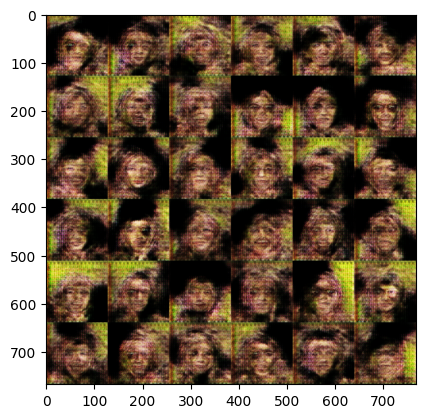

Training Progress:  83%|████████▎ | 12500/15000 [1:06:45<18:25,  2.26step/s]

****************************************************************************************************
1/1 [==============================] - 0s 17ms/step


Training Progress:  83%|████████▎ | 12501/15000 [1:06:46<16:51,  2.47step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  83%|████████▎ | 12502/15000 [1:06:46<15:37,  2.66step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12503/15000 [1:06:46<14:48,  2.81step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12504/15000 [1:06:47<14:12,  2.93step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12505/15000 [1:06:47<13:45,  3.02step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  83%|████████▎ | 12506/15000 [1:06:47<13:30,  3.08step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  83%|████████▎ | 12507/15000 [1:06:47<13:16,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  83%|████████▎ | 12508/15000 [1:06:48<14:05,  2.95step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  83%|████████▎ | 12509/15000 [1:06:48<14:58,  2.77step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  83%|████████▎ | 12510/15000 [1:06:49<16:08,  2.57step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  83%|████████▎ | 12511/15000 [1:06:49<15:57,  2.60step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  83%|████████▎ | 12512/15000 [1:06:49<15:36,  2.66step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  83%|████████▎ | 12513/15000 [1:06:50<14:48,  2.80step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12514/15000 [1:06:50<14:11,  2.92step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  83%|████████▎ | 12515/15000 [1:06:50<13:43,  3.02step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  83%|████████▎ | 12516/15000 [1:06:51<13:30,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  83%|████████▎ | 12517/15000 [1:06:51<13:13,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  83%|████████▎ | 12518/15000 [1:06:51<13:05,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  83%|████████▎ | 12519/15000 [1:06:52<13:29,  3.07step/s]

1/1 [==============================] - 0s 23ms/step


Training Progress:  83%|████████▎ | 12520/15000 [1:06:52<13:22,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  83%|████████▎ | 12521/15000 [1:06:52<13:13,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12522/15000 [1:06:53<13:18,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12523/15000 [1:06:53<13:04,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  83%|████████▎ | 12524/15000 [1:06:53<12:56,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  84%|████████▎ | 12525/15000 [1:06:54<12:50,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  84%|████████▎ | 12526/15000 [1:06:54<12:52,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  84%|████████▎ | 12527/15000 [1:06:54<12:49,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▎ | 12528/15000 [1:06:54<12:46,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  84%|████████▎ | 12529/15000 [1:06:55<12:48,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▎ | 12530/15000 [1:06:55<12:48,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▎ | 12531/15000 [1:06:55<13:11,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▎ | 12532/15000 [1:06:56<13:01,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  84%|████████▎ | 12533/15000 [1:06:56<12:55,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▎ | 12534/15000 [1:06:56<12:50,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▎ | 12535/15000 [1:06:57<12:45,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▎ | 12536/15000 [1:06:57<12:43,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▎ | 12537/15000 [1:06:57<12:40,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▎ | 12538/15000 [1:06:58<13:11,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  84%|████████▎ | 12539/15000 [1:06:58<13:00,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▎ | 12540/15000 [1:06:58<12:55,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▎ | 12541/15000 [1:06:59<12:48,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▎ | 12542/15000 [1:06:59<12:44,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▎ | 12543/15000 [1:06:59<12:40,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  84%|████████▎ | 12544/15000 [1:06:59<12:43,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▎ | 12545/15000 [1:07:00<13:08,  3.11step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  84%|████████▎ | 12546/15000 [1:07:00<13:00,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▎ | 12547/15000 [1:07:00<12:55,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▎ | 12548/15000 [1:07:01<12:51,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  84%|████████▎ | 12549/15000 [1:07:01<12:45,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▎ | 12550/15000 [1:07:01<12:47,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▎ | 12551/15000 [1:07:02<12:44,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▎ | 12552/15000 [1:07:02<12:42,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  84%|████████▎ | 12553/15000 [1:07:02<12:38,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▎ | 12554/15000 [1:07:03<12:39,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▎ | 12555/15000 [1:07:03<12:35,  3.24step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  84%|████████▎ | 12556/15000 [1:07:03<12:44,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  84%|████████▎ | 12557/15000 [1:07:04<12:42,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  84%|████████▎ | 12558/15000 [1:07:04<12:43,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  84%|████████▎ | 12559/15000 [1:07:04<12:41,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  84%|████████▎ | 12560/15000 [1:07:05<12:38,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  84%|████████▎ | 12561/15000 [1:07:05<12:35,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  84%|████████▎ | 12562/15000 [1:07:05<12:37,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▍ | 12563/15000 [1:07:05<12:34,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  84%|████████▍ | 12564/15000 [1:07:06<12:34,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▍ | 12565/15000 [1:07:06<12:32,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  84%|████████▍ | 12566/15000 [1:07:06<12:37,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  84%|████████▍ | 12567/15000 [1:07:07<13:00,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▍ | 12568/15000 [1:07:07<12:53,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▍ | 12569/15000 [1:07:07<12:44,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▍ | 12570/15000 [1:07:08<12:40,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▍ | 12571/15000 [1:07:08<12:35,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▍ | 12572/15000 [1:07:08<13:00,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▍ | 12573/15000 [1:07:09<12:48,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▍ | 12574/15000 [1:07:09<13:07,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▍ | 12575/15000 [1:07:09<12:56,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  84%|████████▍ | 12576/15000 [1:07:10<12:47,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▍ | 12577/15000 [1:07:10<12:40,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▍ | 12578/15000 [1:07:10<12:35,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▍ | 12579/15000 [1:07:10<12:32,  3.22step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:  84%|████████▍ | 12580/15000 [1:07:11<12:55,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  84%|████████▍ | 12581/15000 [1:07:11<12:44,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▍ | 12582/15000 [1:07:11<12:37,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▍ | 12583/15000 [1:07:12<12:32,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  84%|████████▍ | 12584/15000 [1:07:12<12:34,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  84%|████████▍ | 12585/15000 [1:07:12<13:01,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▍ | 12586/15000 [1:07:13<12:51,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▍ | 12587/15000 [1:07:13<12:41,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▍ | 12588/15000 [1:07:13<13:00,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▍ | 12589/15000 [1:07:14<13:15,  3.03step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▍ | 12590/15000 [1:07:14<13:00,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▍ | 12591/15000 [1:07:14<13:13,  3.04step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  84%|████████▍ | 12592/15000 [1:07:15<13:02,  3.08step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  84%|████████▍ | 12593/15000 [1:07:15<12:55,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▍ | 12594/15000 [1:07:15<12:46,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▍ | 12595/15000 [1:07:16<12:37,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▍ | 12596/15000 [1:07:16<12:33,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▍ | 12597/15000 [1:07:16<12:27,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  84%|████████▍ | 12598/15000 [1:07:17<12:26,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  84%|████████▍ | 12599/15000 [1:07:17<12:23,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▍ | 12600/15000 [1:07:17<12:48,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▍ | 12601/15000 [1:07:17<12:38,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▍ | 12602/15000 [1:07:18<12:34,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  84%|████████▍ | 12603/15000 [1:07:18<12:32,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  84%|████████▍ | 12604/15000 [1:07:18<12:28,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  84%|████████▍ | 12605/15000 [1:07:19<12:24,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  84%|████████▍ | 12606/15000 [1:07:19<12:24,  3.21step/s]

1/1 [==============================] - 0s 34ms/step


Training Progress:  84%|████████▍ | 12607/15000 [1:07:19<13:56,  2.86step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  84%|████████▍ | 12608/15000 [1:07:20<14:20,  2.78step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  84%|████████▍ | 12609/15000 [1:07:20<15:24,  2.59step/s]

1/1 [==============================] - 0s 28ms/step


Training Progress:  84%|████████▍ | 12610/15000 [1:07:21<15:13,  2.62step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▍ | 12611/15000 [1:07:21<14:19,  2.78step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▍ | 12612/15000 [1:07:21<13:46,  2.89step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▍ | 12613/15000 [1:07:22<13:17,  2.99step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▍ | 12614/15000 [1:07:22<12:58,  3.06step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▍ | 12615/15000 [1:07:22<13:12,  3.01step/s]

1/1 [==============================] - 0s 28ms/step


Training Progress:  84%|████████▍ | 12616/15000 [1:07:23<13:16,  2.99step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▍ | 12617/15000 [1:07:23<12:57,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  84%|████████▍ | 12618/15000 [1:07:23<12:44,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  84%|████████▍ | 12619/15000 [1:07:24<12:36,  3.15step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  84%|████████▍ | 12620/15000 [1:07:24<12:31,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  84%|████████▍ | 12621/15000 [1:07:24<12:30,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  84%|████████▍ | 12622/15000 [1:07:24<12:26,  3.19step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  84%|████████▍ | 12623/15000 [1:07:25<12:22,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▍ | 12624/15000 [1:07:25<12:17,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▍ | 12625/15000 [1:07:25<12:14,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  84%|████████▍ | 12626/15000 [1:07:26<12:15,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  84%|████████▍ | 12627/15000 [1:07:26<12:13,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  84%|████████▍ | 12628/15000 [1:07:26<12:14,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▍ | 12629/15000 [1:07:27<12:13,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▍ | 12630/15000 [1:07:27<12:14,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  84%|████████▍ | 12631/15000 [1:07:27<12:39,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▍ | 12632/15000 [1:07:28<12:31,  3.15step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  84%|████████▍ | 12633/15000 [1:07:28<12:27,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▍ | 12634/15000 [1:07:28<12:20,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▍ | 12635/15000 [1:07:29<12:16,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▍ | 12636/15000 [1:07:29<12:13,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  84%|████████▍ | 12637/15000 [1:07:29<12:35,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▍ | 12638/15000 [1:07:29<12:24,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▍ | 12639/15000 [1:07:30<12:19,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  84%|████████▍ | 12640/15000 [1:07:30<12:20,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  84%|████████▍ | 12641/15000 [1:07:30<12:14,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  84%|████████▍ | 12642/15000 [1:07:31<12:36,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▍ | 12643/15000 [1:07:31<12:26,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▍ | 12644/15000 [1:07:31<12:17,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▍ | 12645/15000 [1:07:32<12:12,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▍ | 12646/15000 [1:07:32<12:34,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▍ | 12647/15000 [1:07:32<12:25,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▍ | 12648/15000 [1:07:33<12:22,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  84%|████████▍ | 12649/15000 [1:07:33<12:23,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▍ | 12650/15000 [1:07:33<12:41,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  84%|████████▍ | 12651/15000 [1:07:34<12:30,  3.13step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  84%|████████▍ | 12652/15000 [1:07:34<12:23,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  84%|████████▍ | 12653/15000 [1:07:34<12:18,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  84%|████████▍ | 12654/15000 [1:07:35<12:17,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▍ | 12655/15000 [1:07:35<12:13,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  84%|████████▍ | 12656/15000 [1:07:35<12:13,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▍ | 12657/15000 [1:07:35<12:12,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  84%|████████▍ | 12658/15000 [1:07:36<12:13,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  84%|████████▍ | 12659/15000 [1:07:36<12:11,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  84%|████████▍ | 12660/15000 [1:07:36<12:08,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▍ | 12661/15000 [1:07:37<12:04,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▍ | 12662/15000 [1:07:37<12:02,  3.24step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  84%|████████▍ | 12663/15000 [1:07:37<11:59,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▍ | 12664/15000 [1:07:38<11:59,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  84%|████████▍ | 12665/15000 [1:07:38<12:00,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▍ | 12666/15000 [1:07:38<12:00,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  84%|████████▍ | 12667/15000 [1:07:39<12:04,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  84%|████████▍ | 12668/15000 [1:07:39<12:28,  3.11step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  84%|████████▍ | 12669/15000 [1:07:39<12:25,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  84%|████████▍ | 12670/15000 [1:07:40<12:17,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▍ | 12671/15000 [1:07:40<12:08,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▍ | 12672/15000 [1:07:40<12:04,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▍ | 12673/15000 [1:07:40<12:02,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▍ | 12674/15000 [1:07:41<12:01,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  84%|████████▍ | 12675/15000 [1:07:41<11:58,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▍ | 12676/15000 [1:07:41<11:56,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▍ | 12677/15000 [1:07:42<11:57,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▍ | 12678/15000 [1:07:42<11:56,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▍ | 12679/15000 [1:07:42<12:20,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  85%|████████▍ | 12680/15000 [1:07:43<12:12,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  85%|████████▍ | 12681/15000 [1:07:43<12:08,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▍ | 12682/15000 [1:07:43<12:07,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  85%|████████▍ | 12683/15000 [1:07:44<12:03,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  85%|████████▍ | 12684/15000 [1:07:44<12:23,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▍ | 12685/15000 [1:07:44<12:14,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  85%|████████▍ | 12686/15000 [1:07:45<12:11,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  85%|████████▍ | 12687/15000 [1:07:45<12:30,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▍ | 12688/15000 [1:07:45<12:19,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▍ | 12689/15000 [1:07:46<12:12,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▍ | 12690/15000 [1:07:46<12:06,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▍ | 12691/15000 [1:07:46<12:03,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  85%|████████▍ | 12692/15000 [1:07:46<12:00,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▍ | 12693/15000 [1:07:47<11:56,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▍ | 12694/15000 [1:07:47<11:53,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  85%|████████▍ | 12695/15000 [1:07:47<11:56,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▍ | 12696/15000 [1:07:48<11:53,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  85%|████████▍ | 12697/15000 [1:07:48<11:52,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▍ | 12698/15000 [1:07:48<11:49,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▍ | 12699/15000 [1:07:49<12:14,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▍ | 12700/15000 [1:07:49<12:06,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▍ | 12701/15000 [1:07:49<12:01,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▍ | 12702/15000 [1:07:50<12:22,  3.10step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:  85%|████████▍ | 12703/15000 [1:07:50<12:09,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  85%|████████▍ | 12704/15000 [1:07:50<12:06,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  85%|████████▍ | 12705/15000 [1:07:51<12:05,  3.16step/s]

1/1 [==============================] - 0s 27ms/step


Training Progress:  85%|████████▍ | 12706/15000 [1:07:51<12:47,  2.99step/s]

1/1 [==============================] - 0s 27ms/step


Training Progress:  85%|████████▍ | 12707/15000 [1:07:51<13:20,  2.86step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  85%|████████▍ | 12708/15000 [1:07:52<14:27,  2.64step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  85%|████████▍ | 12709/15000 [1:07:52<14:40,  2.60step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▍ | 12710/15000 [1:07:52<14:11,  2.69step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  85%|████████▍ | 12711/15000 [1:07:53<13:26,  2.84step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  85%|████████▍ | 12712/15000 [1:07:53<12:54,  2.96step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▍ | 12713/15000 [1:07:53<12:31,  3.04step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  85%|████████▍ | 12714/15000 [1:07:54<12:20,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  85%|████████▍ | 12715/15000 [1:07:54<12:10,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▍ | 12716/15000 [1:07:54<12:03,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▍ | 12717/15000 [1:07:55<11:56,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▍ | 12718/15000 [1:07:55<11:52,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▍ | 12719/15000 [1:07:55<11:48,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▍ | 12720/15000 [1:07:56<11:45,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  85%|████████▍ | 12721/15000 [1:07:56<11:44,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▍ | 12722/15000 [1:07:56<11:41,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  85%|████████▍ | 12723/15000 [1:07:56<11:46,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▍ | 12724/15000 [1:07:57<11:43,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▍ | 12725/15000 [1:07:57<12:06,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▍ | 12726/15000 [1:07:57<11:56,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  85%|████████▍ | 12727/15000 [1:07:58<11:50,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  85%|████████▍ | 12728/15000 [1:07:58<11:46,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▍ | 12729/15000 [1:07:58<11:41,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▍ | 12730/15000 [1:07:59<11:39,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▍ | 12731/15000 [1:07:59<11:39,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  85%|████████▍ | 12732/15000 [1:07:59<11:42,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  85%|████████▍ | 12733/15000 [1:08:00<11:41,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▍ | 12734/15000 [1:08:00<11:38,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▍ | 12735/15000 [1:08:00<11:34,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▍ | 12736/15000 [1:08:01<11:34,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▍ | 12737/15000 [1:08:01<11:34,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▍ | 12738/15000 [1:08:01<11:32,  3.27step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▍ | 12739/15000 [1:08:01<11:30,  3.28step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  85%|████████▍ | 12740/15000 [1:08:02<11:29,  3.28step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  85%|████████▍ | 12741/15000 [1:08:02<11:33,  3.26step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  85%|████████▍ | 12742/15000 [1:08:02<11:33,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▍ | 12743/15000 [1:08:03<11:32,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▍ | 12744/15000 [1:08:03<11:32,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▍ | 12745/15000 [1:08:03<11:30,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▍ | 12746/15000 [1:08:04<11:30,  3.27step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▍ | 12747/15000 [1:08:04<11:29,  3.27step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▍ | 12748/15000 [1:08:04<11:28,  3.27step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▍ | 12749/15000 [1:08:04<11:29,  3.27step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▌ | 12750/15000 [1:08:05<11:28,  3.27step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  85%|████████▌ | 12751/15000 [1:08:05<11:38,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  85%|████████▌ | 12752/15000 [1:08:05<11:38,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  85%|████████▌ | 12753/15000 [1:08:06<11:37,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▌ | 12754/15000 [1:08:06<11:35,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▌ | 12755/15000 [1:08:06<11:32,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▌ | 12756/15000 [1:08:07<11:30,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  85%|████████▌ | 12757/15000 [1:08:07<11:30,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▌ | 12758/15000 [1:08:07<11:29,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▌ | 12759/15000 [1:08:08<11:53,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  85%|████████▌ | 12760/15000 [1:08:08<12:13,  3.05step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▌ | 12761/15000 [1:08:08<11:59,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▌ | 12762/15000 [1:08:09<11:48,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▌ | 12763/15000 [1:08:09<11:41,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▌ | 12764/15000 [1:08:09<12:00,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▌ | 12765/15000 [1:08:10<11:49,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▌ | 12766/15000 [1:08:10<11:40,  3.19step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  85%|████████▌ | 12767/15000 [1:08:10<11:40,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▌ | 12768/15000 [1:08:10<11:37,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  85%|████████▌ | 12769/15000 [1:08:11<11:37,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  85%|████████▌ | 12770/15000 [1:08:11<11:36,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▌ | 12771/15000 [1:08:11<11:56,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▌ | 12772/15000 [1:08:12<11:44,  3.16step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:  85%|████████▌ | 12773/15000 [1:08:12<11:35,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▌ | 12774/15000 [1:08:12<11:30,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▌ | 12775/15000 [1:08:13<11:28,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  85%|████████▌ | 12776/15000 [1:08:13<11:27,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  85%|████████▌ | 12777/15000 [1:08:13<11:26,  3.24step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  85%|████████▌ | 12778/15000 [1:08:14<11:31,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▌ | 12779/15000 [1:08:14<11:28,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  85%|████████▌ | 12780/15000 [1:08:14<11:33,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▌ | 12781/15000 [1:08:15<11:28,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▌ | 12782/15000 [1:08:15<11:24,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▌ | 12783/15000 [1:08:15<11:24,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▌ | 12784/15000 [1:08:15<11:23,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▌ | 12785/15000 [1:08:16<11:21,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▌ | 12786/15000 [1:08:16<11:20,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▌ | 12787/15000 [1:08:16<11:19,  3.26step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  85%|████████▌ | 12788/15000 [1:08:17<11:24,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  85%|████████▌ | 12789/15000 [1:08:17<11:24,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▌ | 12790/15000 [1:08:17<11:21,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▌ | 12791/15000 [1:08:18<11:21,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▌ | 12792/15000 [1:08:18<11:21,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▌ | 12793/15000 [1:08:18<11:18,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  85%|████████▌ | 12794/15000 [1:08:19<11:17,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▌ | 12795/15000 [1:08:19<11:17,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▌ | 12796/15000 [1:08:19<11:17,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  85%|████████▌ | 12797/15000 [1:08:19<11:18,  3.25step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  85%|████████▌ | 12798/15000 [1:08:20<14:58,  2.45step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  85%|████████▌ | 12799/15000 [1:08:20<13:56,  2.63step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  85%|████████▌ | 12800/15000 [1:08:21<13:14,  2.77step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  85%|████████▌ | 12801/15000 [1:08:21<12:41,  2.89step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  85%|████████▌ | 12802/15000 [1:08:21<12:19,  2.97step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  85%|████████▌ | 12803/15000 [1:08:22<12:05,  3.03step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  85%|████████▌ | 12804/15000 [1:08:22<12:45,  2.87step/s]

1/1 [==============================] - 0s 31ms/step


Training Progress:  85%|████████▌ | 12805/15000 [1:08:23<14:10,  2.58step/s]

1/1 [==============================] - 0s 32ms/step


Training Progress:  85%|████████▌ | 12806/15000 [1:08:23<14:57,  2.44step/s]

1/1 [==============================] - 0s 31ms/step


Training Progress:  85%|████████▌ | 12807/15000 [1:08:23<14:47,  2.47step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  85%|████████▌ | 12808/15000 [1:08:24<13:49,  2.64step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  85%|████████▌ | 12809/15000 [1:08:24<13:06,  2.79step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  85%|████████▌ | 12810/15000 [1:08:24<12:38,  2.89step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  85%|████████▌ | 12811/15000 [1:08:25<12:17,  2.97step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  85%|████████▌ | 12812/15000 [1:08:25<12:02,  3.03step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  85%|████████▌ | 12813/15000 [1:08:25<11:51,  3.07step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  85%|████████▌ | 12814/15000 [1:08:26<11:42,  3.11step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  85%|████████▌ | 12815/15000 [1:08:26<11:39,  3.12step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  85%|████████▌ | 12816/15000 [1:08:26<11:41,  3.11step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  85%|████████▌ | 12817/15000 [1:08:27<12:00,  3.03step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  85%|████████▌ | 12818/15000 [1:08:27<11:50,  3.07step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  85%|████████▌ | 12819/15000 [1:08:27<11:43,  3.10step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  85%|████████▌ | 12820/15000 [1:08:28<11:39,  3.12step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  85%|████████▌ | 12821/15000 [1:08:28<11:36,  3.13step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  85%|████████▌ | 12822/15000 [1:08:28<11:32,  3.15step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  85%|████████▌ | 12823/15000 [1:08:28<11:30,  3.15step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  85%|████████▌ | 12824/15000 [1:08:29<11:52,  3.05step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  86%|████████▌ | 12825/15000 [1:08:29<11:51,  3.06step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  86%|████████▌ | 12826/15000 [1:08:29<11:41,  3.10step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  86%|████████▌ | 12827/15000 [1:08:30<11:36,  3.12step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  86%|████████▌ | 12828/15000 [1:08:30<11:33,  3.13step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  86%|████████▌ | 12829/15000 [1:08:30<11:31,  3.14step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  86%|████████▌ | 12830/15000 [1:08:31<11:28,  3.15step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  86%|████████▌ | 12831/15000 [1:08:31<11:26,  3.16step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  86%|████████▌ | 12832/15000 [1:08:31<11:25,  3.16step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  86%|████████▌ | 12833/15000 [1:08:32<11:23,  3.17step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  86%|████████▌ | 12834/15000 [1:08:32<11:27,  3.15step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  86%|████████▌ | 12835/15000 [1:08:32<12:32,  2.88step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  86%|████████▌ | 12836/15000 [1:08:33<12:11,  2.96step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  86%|████████▌ | 12837/15000 [1:08:33<11:55,  3.02step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  86%|████████▌ | 12838/15000 [1:08:33<11:44,  3.07step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  86%|████████▌ | 12839/15000 [1:08:34<11:38,  3.09step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  86%|████████▌ | 12840/15000 [1:08:34<11:34,  3.11step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  86%|████████▌ | 12841/15000 [1:08:34<11:29,  3.13step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  86%|████████▌ | 12842/15000 [1:08:35<11:25,  3.15step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  86%|████████▌ | 12843/15000 [1:08:35<11:28,  3.13step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  86%|████████▌ | 12844/15000 [1:08:35<11:26,  3.14step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  86%|████████▌ | 12845/15000 [1:08:36<11:26,  3.14step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  86%|████████▌ | 12846/15000 [1:08:36<11:25,  3.14step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  86%|████████▌ | 12847/15000 [1:08:36<11:24,  3.15step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  86%|████████▌ | 12848/15000 [1:08:37<11:23,  3.15step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  86%|████████▌ | 12849/15000 [1:08:37<11:21,  3.16step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  86%|████████▌ | 12850/15000 [1:08:37<11:21,  3.16step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  86%|████████▌ | 12851/15000 [1:08:37<11:20,  3.16step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  86%|████████▌ | 12852/15000 [1:08:38<11:22,  3.15step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  86%|████████▌ | 12853/15000 [1:08:38<11:21,  3.15step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  86%|████████▌ | 12854/15000 [1:08:38<11:19,  3.16step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  86%|████████▌ | 12855/15000 [1:08:39<11:19,  3.16step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  86%|████████▌ | 12856/15000 [1:08:39<11:20,  3.15step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  86%|████████▌ | 12857/15000 [1:08:39<11:20,  3.15step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  86%|████████▌ | 12858/15000 [1:08:40<11:30,  3.10step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  86%|████████▌ | 12859/15000 [1:08:40<11:25,  3.12step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  86%|████████▌ | 12860/15000 [1:08:40<11:28,  3.11step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  86%|████████▌ | 12861/15000 [1:08:41<11:28,  3.11step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  86%|████████▌ | 12862/15000 [1:08:41<11:25,  3.12step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  86%|████████▌ | 12863/15000 [1:08:41<11:22,  3.13step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  86%|████████▌ | 12864/15000 [1:08:42<11:20,  3.14step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  86%|████████▌ | 12865/15000 [1:08:42<11:17,  3.15step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  86%|████████▌ | 12866/15000 [1:08:42<11:19,  3.14step/s]

1/1 [==============================] - 0s 34ms/step


Training Progress:  86%|████████▌ | 12867/15000 [1:08:43<11:45,  3.02step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  86%|████████▌ | 12868/15000 [1:08:43<11:55,  2.98step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  86%|████████▌ | 12869/15000 [1:08:43<12:04,  2.94step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  86%|████████▌ | 12870/15000 [1:08:44<11:50,  3.00step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  86%|████████▌ | 12871/15000 [1:08:44<11:37,  3.05step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  86%|████████▌ | 12872/15000 [1:08:44<11:28,  3.09step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  86%|████████▌ | 12873/15000 [1:08:45<11:21,  3.12step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  86%|████████▌ | 12874/15000 [1:08:45<11:15,  3.15step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  86%|████████▌ | 12875/15000 [1:08:45<11:13,  3.15step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  86%|████████▌ | 12876/15000 [1:08:46<11:11,  3.16step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  86%|████████▌ | 12877/15000 [1:08:46<11:32,  3.07step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  86%|████████▌ | 12878/15000 [1:08:46<11:24,  3.10step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  86%|████████▌ | 12879/15000 [1:08:46<11:22,  3.11step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  86%|████████▌ | 12880/15000 [1:08:47<12:03,  2.93step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  86%|████████▌ | 12881/15000 [1:08:47<11:45,  3.00step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  86%|████████▌ | 12882/15000 [1:08:47<11:31,  3.06step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  86%|████████▌ | 12883/15000 [1:08:48<11:45,  3.00step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  86%|████████▌ | 12884/15000 [1:08:48<11:31,  3.06step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  86%|████████▌ | 12885/15000 [1:08:49<11:43,  3.00step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  86%|████████▌ | 12886/15000 [1:08:49<11:32,  3.05step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  86%|████████▌ | 12887/15000 [1:08:49<11:21,  3.10step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  86%|████████▌ | 12888/15000 [1:08:49<11:19,  3.11step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  86%|████████▌ | 12889/15000 [1:08:50<11:12,  3.14step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  86%|████████▌ | 12890/15000 [1:08:50<11:08,  3.16step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  86%|████████▌ | 12891/15000 [1:08:50<11:06,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  86%|████████▌ | 12892/15000 [1:08:51<11:02,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  86%|████████▌ | 12893/15000 [1:08:51<10:59,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  86%|████████▌ | 12894/15000 [1:08:51<10:57,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  86%|████████▌ | 12895/15000 [1:08:52<10:54,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  86%|████████▌ | 12896/15000 [1:08:52<10:55,  3.21step/s]

1/1 [==============================] - 0s 23ms/step


Training Progress:  86%|████████▌ | 12897/15000 [1:08:52<10:58,  3.19step/s]

1/1 [==============================] - 0s 28ms/step


Training Progress:  86%|████████▌ | 12898/15000 [1:08:53<11:20,  3.09step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  86%|████████▌ | 12899/15000 [1:08:53<11:11,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  86%|████████▌ | 12900/15000 [1:08:53<11:09,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  86%|████████▌ | 12901/15000 [1:08:54<11:01,  3.17step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  86%|████████▌ | 12902/15000 [1:08:54<12:26,  2.81step/s]

1/1 [==============================] - 0s 27ms/step


Training Progress:  86%|████████▌ | 12903/15000 [1:08:54<12:37,  2.77step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  86%|████████▌ | 12904/15000 [1:08:55<13:10,  2.65step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  86%|████████▌ | 12905/15000 [1:08:55<12:27,  2.80step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  86%|████████▌ | 12906/15000 [1:08:55<11:56,  2.92step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  86%|████████▌ | 12907/15000 [1:08:56<11:39,  2.99step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  86%|████████▌ | 12908/15000 [1:08:56<11:24,  3.05step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  86%|████████▌ | 12909/15000 [1:08:56<11:11,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  86%|████████▌ | 12910/15000 [1:08:57<11:04,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  86%|████████▌ | 12911/15000 [1:08:57<11:20,  3.07step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  86%|████████▌ | 12912/15000 [1:08:57<11:09,  3.12step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:  86%|████████▌ | 12913/15000 [1:08:58<10:58,  3.17step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  86%|████████▌ | 12914/15000 [1:08:58<10:55,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  86%|████████▌ | 12915/15000 [1:08:58<10:50,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  86%|████████▌ | 12916/15000 [1:08:59<10:51,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  86%|████████▌ | 12917/15000 [1:08:59<10:47,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  86%|████████▌ | 12918/15000 [1:08:59<10:46,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  86%|████████▌ | 12919/15000 [1:08:59<10:45,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  86%|████████▌ | 12920/15000 [1:09:00<10:44,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  86%|████████▌ | 12921/15000 [1:09:00<10:45,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  86%|████████▌ | 12922/15000 [1:09:00<10:43,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  86%|████████▌ | 12923/15000 [1:09:01<10:39,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  86%|████████▌ | 12924/15000 [1:09:01<10:38,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  86%|████████▌ | 12925/15000 [1:09:01<10:39,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  86%|████████▌ | 12926/15000 [1:09:02<10:39,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  86%|████████▌ | 12927/15000 [1:09:02<10:36,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  86%|████████▌ | 12928/15000 [1:09:02<11:23,  3.03step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  86%|████████▌ | 12929/15000 [1:09:03<11:15,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  86%|████████▌ | 12930/15000 [1:09:03<11:04,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  86%|████████▌ | 12931/15000 [1:09:03<11:15,  3.06step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  86%|████████▌ | 12932/15000 [1:09:04<11:05,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  86%|████████▌ | 12933/15000 [1:09:04<10:54,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  86%|████████▌ | 12934/15000 [1:09:04<11:10,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  86%|████████▌ | 12935/15000 [1:09:05<11:03,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  86%|████████▌ | 12936/15000 [1:09:05<10:56,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  86%|████████▌ | 12937/15000 [1:09:05<11:11,  3.07step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  86%|████████▋ | 12938/15000 [1:09:05<10:59,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  86%|████████▋ | 12939/15000 [1:09:06<10:50,  3.17step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  86%|████████▋ | 12940/15000 [1:09:06<10:57,  3.14step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  86%|████████▋ | 12941/15000 [1:09:06<10:51,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  86%|████████▋ | 12942/15000 [1:09:07<10:47,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  86%|████████▋ | 12943/15000 [1:09:07<10:42,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  86%|████████▋ | 12944/15000 [1:09:07<10:43,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  86%|████████▋ | 12945/15000 [1:09:08<11:01,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  86%|████████▋ | 12946/15000 [1:09:08<11:15,  3.04step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  86%|████████▋ | 12947/15000 [1:09:08<11:02,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  86%|████████▋ | 12948/15000 [1:09:09<10:52,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  86%|████████▋ | 12949/15000 [1:09:09<11:06,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  86%|████████▋ | 12950/15000 [1:09:09<10:54,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  86%|████████▋ | 12951/15000 [1:09:10<10:46,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  86%|████████▋ | 12952/15000 [1:09:10<10:41,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  86%|████████▋ | 12953/15000 [1:09:10<10:39,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  86%|████████▋ | 12954/15000 [1:09:11<10:36,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  86%|████████▋ | 12955/15000 [1:09:11<10:34,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  86%|████████▋ | 12956/15000 [1:09:11<10:33,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  86%|████████▋ | 12957/15000 [1:09:11<10:34,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  86%|████████▋ | 12958/15000 [1:09:12<10:32,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  86%|████████▋ | 12959/15000 [1:09:12<10:29,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  86%|████████▋ | 12960/15000 [1:09:12<10:44,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  86%|████████▋ | 12961/15000 [1:09:13<11:00,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  86%|████████▋ | 12962/15000 [1:09:13<10:57,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  86%|████████▋ | 12963/15000 [1:09:13<10:49,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  86%|████████▋ | 12964/15000 [1:09:14<10:44,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  86%|████████▋ | 12965/15000 [1:09:14<10:39,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  86%|████████▋ | 12966/15000 [1:09:14<10:35,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  86%|████████▋ | 12967/15000 [1:09:15<10:54,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  86%|████████▋ | 12968/15000 [1:09:15<10:45,  3.15step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  86%|████████▋ | 12969/15000 [1:09:15<10:39,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  86%|████████▋ | 12970/15000 [1:09:16<10:34,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  86%|████████▋ | 12971/15000 [1:09:16<10:30,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  86%|████████▋ | 12972/15000 [1:09:16<10:54,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  86%|████████▋ | 12973/15000 [1:09:17<10:45,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  86%|████████▋ | 12974/15000 [1:09:17<11:01,  3.06step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  86%|████████▋ | 12975/15000 [1:09:17<10:48,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  87%|████████▋ | 12976/15000 [1:09:18<10:42,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  87%|████████▋ | 12977/15000 [1:09:18<10:34,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  87%|████████▋ | 12978/15000 [1:09:18<10:52,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  87%|████████▋ | 12979/15000 [1:09:18<10:41,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  87%|████████▋ | 12980/15000 [1:09:19<10:35,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  87%|████████▋ | 12981/15000 [1:09:19<10:31,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  87%|████████▋ | 12982/15000 [1:09:19<10:31,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  87%|████████▋ | 12983/15000 [1:09:20<10:28,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  87%|████████▋ | 12984/15000 [1:09:20<10:26,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  87%|████████▋ | 12985/15000 [1:09:20<10:23,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  87%|████████▋ | 12986/15000 [1:09:21<10:22,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  87%|████████▋ | 12987/15000 [1:09:21<10:42,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  87%|████████▋ | 12988/15000 [1:09:21<10:35,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  87%|████████▋ | 12989/15000 [1:09:22<10:29,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  87%|████████▋ | 12990/15000 [1:09:22<10:30,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  87%|████████▋ | 12991/15000 [1:09:22<10:57,  3.05step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  87%|████████▋ | 12992/15000 [1:09:23<11:07,  3.01step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  87%|████████▋ | 12993/15000 [1:09:23<10:51,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  87%|████████▋ | 12994/15000 [1:09:23<10:41,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  87%|████████▋ | 12995/15000 [1:09:24<10:33,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  87%|████████▋ | 12996/15000 [1:09:24<10:30,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  87%|████████▋ | 12997/15000 [1:09:24<10:28,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  87%|████████▋ | 12998/15000 [1:09:25<10:47,  3.09step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  87%|████████▋ | 12999/15000 [1:09:25<10:41,  3.12step/s]

1/1 [==============================] - 0s 29ms/step
****************************************************************************************************
13000/15000: d_loss: 0.134548,  g_loss: 0.007839
2/2 [==============================] - 0s 20ms/step


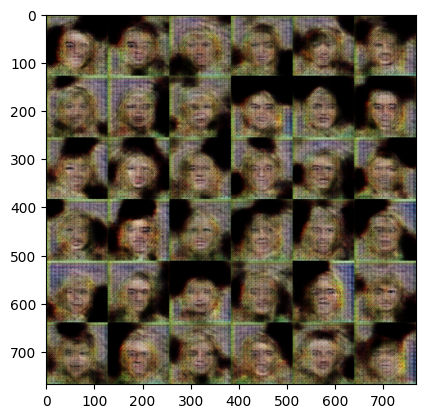

Training Progress:  87%|████████▋ | 13000/15000 [1:09:26<18:10,  1.83step/s]

****************************************************************************************************
1/1 [==============================] - 0s 28ms/step


Training Progress:  87%|████████▋ | 13001/15000 [1:09:26<16:31,  2.02step/s]

1/1 [==============================] - 0s 36ms/step


Training Progress:  87%|████████▋ | 13002/15000 [1:09:27<14:59,  2.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  87%|████████▋ | 13003/15000 [1:09:27<13:37,  2.44step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  87%|████████▋ | 13004/15000 [1:09:27<12:36,  2.64step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  87%|████████▋ | 13005/15000 [1:09:28<11:53,  2.79step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  87%|████████▋ | 13006/15000 [1:09:28<11:23,  2.92step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  87%|████████▋ | 13007/15000 [1:09:28<11:04,  3.00step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  87%|████████▋ | 13008/15000 [1:09:29<11:11,  2.97step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  87%|████████▋ | 13009/15000 [1:09:29<10:53,  3.05step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  87%|████████▋ | 13010/15000 [1:09:29<10:40,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  87%|████████▋ | 13011/15000 [1:09:29<10:31,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  87%|████████▋ | 13012/15000 [1:09:30<10:29,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  87%|████████▋ | 13013/15000 [1:09:30<10:26,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  87%|████████▋ | 13014/15000 [1:09:30<10:23,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  87%|████████▋ | 13015/15000 [1:09:31<10:21,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  87%|████████▋ | 13016/15000 [1:09:31<10:22,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  87%|████████▋ | 13017/15000 [1:09:31<10:22,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  87%|████████▋ | 13018/15000 [1:09:32<10:20,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  87%|████████▋ | 13019/15000 [1:09:32<10:17,  3.21step/s]

1/1 [==============================] - 0s 27ms/step


Training Progress:  87%|████████▋ | 13020/15000 [1:09:32<10:25,  3.17step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  87%|████████▋ | 13021/15000 [1:09:33<10:44,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  87%|████████▋ | 13022/15000 [1:09:33<10:35,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  87%|████████▋ | 13023/15000 [1:09:33<10:28,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  87%|████████▋ | 13024/15000 [1:09:34<10:22,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  87%|████████▋ | 13025/15000 [1:09:34<10:16,  3.20step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:  87%|████████▋ | 13026/15000 [1:09:34<10:13,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  87%|████████▋ | 13027/15000 [1:09:34<10:11,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  87%|████████▋ | 13028/15000 [1:09:35<10:09,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  87%|████████▋ | 13029/15000 [1:09:35<10:11,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  87%|████████▋ | 13030/15000 [1:09:35<10:13,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  87%|████████▋ | 13031/15000 [1:09:36<10:10,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  87%|████████▋ | 13032/15000 [1:09:36<10:11,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  87%|████████▋ | 13033/15000 [1:09:36<10:09,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  87%|████████▋ | 13034/15000 [1:09:37<10:07,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  87%|████████▋ | 13035/15000 [1:09:37<10:06,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  87%|████████▋ | 13036/15000 [1:09:37<10:08,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  87%|████████▋ | 13037/15000 [1:09:38<10:28,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  87%|████████▋ | 13038/15000 [1:09:38<10:21,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  87%|████████▋ | 13039/15000 [1:09:38<10:21,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  87%|████████▋ | 13040/15000 [1:09:39<10:19,  3.16step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  87%|████████▋ | 13041/15000 [1:09:39<10:15,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  87%|████████▋ | 13042/15000 [1:09:39<10:11,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  87%|████████▋ | 13043/15000 [1:09:39<10:07,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  87%|████████▋ | 13044/15000 [1:09:40<10:05,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  87%|████████▋ | 13045/15000 [1:09:40<10:03,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  87%|████████▋ | 13046/15000 [1:09:40<10:02,  3.24step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  87%|████████▋ | 13047/15000 [1:09:41<10:02,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  87%|████████▋ | 13048/15000 [1:09:41<10:00,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  87%|████████▋ | 13049/15000 [1:09:41<10:03,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  87%|████████▋ | 13050/15000 [1:09:42<10:03,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  87%|████████▋ | 13051/15000 [1:09:42<10:02,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  87%|████████▋ | 13052/15000 [1:09:42<10:23,  3.12step/s]

1/1 [==============================] - 0s 27ms/step


Training Progress:  87%|████████▋ | 13053/15000 [1:09:43<10:36,  3.06step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  87%|████████▋ | 13054/15000 [1:09:43<10:26,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  87%|████████▋ | 13055/15000 [1:09:43<10:18,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  87%|████████▋ | 13056/15000 [1:09:44<10:12,  3.17step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  87%|████████▋ | 13057/15000 [1:09:44<10:29,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  87%|████████▋ | 13058/15000 [1:09:44<10:21,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  87%|████████▋ | 13059/15000 [1:09:44<10:13,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  87%|████████▋ | 13060/15000 [1:09:45<10:08,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  87%|████████▋ | 13061/15000 [1:09:45<10:02,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  87%|████████▋ | 13062/15000 [1:09:45<10:01,  3.22step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  87%|████████▋ | 13063/15000 [1:09:46<10:03,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  87%|████████▋ | 13064/15000 [1:09:46<10:01,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  87%|████████▋ | 13065/15000 [1:09:46<10:00,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  87%|████████▋ | 13066/15000 [1:09:47<09:59,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  87%|████████▋ | 13067/15000 [1:09:47<10:00,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  87%|████████▋ | 13068/15000 [1:09:47<09:59,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  87%|████████▋ | 13069/15000 [1:09:48<09:57,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  87%|████████▋ | 13070/15000 [1:09:48<09:56,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  87%|████████▋ | 13071/15000 [1:09:48<09:54,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  87%|████████▋ | 13072/15000 [1:09:49<10:15,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  87%|████████▋ | 13073/15000 [1:09:49<10:08,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  87%|████████▋ | 13074/15000 [1:09:49<10:03,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  87%|████████▋ | 13075/15000 [1:09:49<09:59,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  87%|████████▋ | 13076/15000 [1:09:50<09:57,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  87%|████████▋ | 13077/15000 [1:09:50<10:20,  3.10step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  87%|████████▋ | 13078/15000 [1:09:50<10:16,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  87%|████████▋ | 13079/15000 [1:09:51<10:09,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  87%|████████▋ | 13080/15000 [1:09:51<10:05,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  87%|████████▋ | 13081/15000 [1:09:51<10:02,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  87%|████████▋ | 13082/15000 [1:09:52<10:01,  3.19step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  87%|████████▋ | 13083/15000 [1:09:52<10:01,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  87%|████████▋ | 13084/15000 [1:09:52<10:18,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  87%|████████▋ | 13085/15000 [1:09:53<10:09,  3.14step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  87%|████████▋ | 13086/15000 [1:09:53<10:07,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  87%|████████▋ | 13087/15000 [1:09:53<10:22,  3.07step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  87%|████████▋ | 13088/15000 [1:09:54<10:13,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  87%|████████▋ | 13089/15000 [1:09:54<10:06,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  87%|████████▋ | 13090/15000 [1:09:54<10:02,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  87%|████████▋ | 13091/15000 [1:09:55<09:57,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  87%|████████▋ | 13092/15000 [1:09:55<09:55,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  87%|████████▋ | 13093/15000 [1:09:55<09:52,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  87%|████████▋ | 13094/15000 [1:09:55<09:56,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  87%|████████▋ | 13095/15000 [1:09:56<10:17,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  87%|████████▋ | 13096/15000 [1:09:56<10:08,  3.13step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  87%|████████▋ | 13097/15000 [1:09:57<10:27,  3.03step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  87%|████████▋ | 13098/15000 [1:09:57<11:17,  2.81step/s]

1/1 [==============================] - 0s 23ms/step


Training Progress:  87%|████████▋ | 13099/15000 [1:09:57<11:52,  2.67step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  87%|████████▋ | 13100/15000 [1:09:58<12:14,  2.59step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  87%|████████▋ | 13101/15000 [1:09:58<11:33,  2.74step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  87%|████████▋ | 13102/15000 [1:09:58<10:59,  2.88step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  87%|████████▋ | 13103/15000 [1:09:59<10:37,  2.97step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  87%|████████▋ | 13104/15000 [1:09:59<10:27,  3.02step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  87%|████████▋ | 13105/15000 [1:09:59<10:16,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  87%|████████▋ | 13106/15000 [1:10:00<10:07,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  87%|████████▋ | 13107/15000 [1:10:00<10:01,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  87%|████████▋ | 13108/15000 [1:10:00<09:55,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  87%|████████▋ | 13109/15000 [1:10:01<09:51,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  87%|████████▋ | 13110/15000 [1:10:01<09:48,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  87%|████████▋ | 13111/15000 [1:10:01<10:09,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  87%|████████▋ | 13112/15000 [1:10:02<10:00,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  87%|████████▋ | 13113/15000 [1:10:02<09:56,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  87%|████████▋ | 13114/15000 [1:10:02<09:55,  3.17step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  87%|████████▋ | 13115/15000 [1:10:02<09:53,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  87%|████████▋ | 13116/15000 [1:10:03<09:49,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  87%|████████▋ | 13117/15000 [1:10:03<09:47,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  87%|████████▋ | 13118/15000 [1:10:03<09:44,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  87%|████████▋ | 13119/15000 [1:10:04<09:44,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  87%|████████▋ | 13120/15000 [1:10:04<09:43,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  87%|████████▋ | 13121/15000 [1:10:04<09:43,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  87%|████████▋ | 13122/15000 [1:10:05<09:42,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  87%|████████▋ | 13123/15000 [1:10:05<09:45,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  87%|████████▋ | 13124/15000 [1:10:05<09:43,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  88%|████████▊ | 13125/15000 [1:10:06<09:42,  3.22step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  88%|████████▊ | 13126/15000 [1:10:06<09:42,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  88%|████████▊ | 13127/15000 [1:10:06<09:52,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  88%|████████▊ | 13128/15000 [1:10:07<09:49,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  88%|████████▊ | 13129/15000 [1:10:07<09:47,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  88%|████████▊ | 13130/15000 [1:10:07<09:46,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  88%|████████▊ | 13131/15000 [1:10:07<09:48,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  88%|████████▊ | 13132/15000 [1:10:08<09:50,  3.16step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  88%|████████▊ | 13133/15000 [1:10:08<10:10,  3.06step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  88%|████████▊ | 13134/15000 [1:10:08<10:03,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  88%|████████▊ | 13135/15000 [1:10:09<09:56,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  88%|████████▊ | 13136/15000 [1:10:09<09:50,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  88%|████████▊ | 13137/15000 [1:10:09<09:48,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  88%|████████▊ | 13138/15000 [1:10:10<09:44,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  88%|████████▊ | 13139/15000 [1:10:10<09:43,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  88%|████████▊ | 13140/15000 [1:10:10<09:41,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  88%|████████▊ | 13141/15000 [1:10:11<09:45,  3.17step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  88%|████████▊ | 13142/15000 [1:10:11<09:43,  3.18step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  88%|████████▊ | 13143/15000 [1:10:11<09:43,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  88%|████████▊ | 13144/15000 [1:10:12<09:40,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  88%|████████▊ | 13145/15000 [1:10:12<09:39,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  88%|████████▊ | 13146/15000 [1:10:12<09:38,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  88%|████████▊ | 13147/15000 [1:10:13<10:07,  3.05step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  88%|████████▊ | 13148/15000 [1:10:13<09:56,  3.10step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  88%|████████▊ | 13149/15000 [1:10:13<09:52,  3.13step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  88%|████████▊ | 13150/15000 [1:10:13<09:48,  3.15step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  88%|████████▊ | 13151/15000 [1:10:14<09:48,  3.14step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  88%|████████▊ | 13152/15000 [1:10:14<09:44,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  88%|████████▊ | 13153/15000 [1:10:14<10:04,  3.06step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  88%|████████▊ | 13154/15000 [1:10:15<09:55,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  88%|████████▊ | 13155/15000 [1:10:15<09:50,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  88%|████████▊ | 13156/15000 [1:10:15<09:45,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  88%|████████▊ | 13157/15000 [1:10:16<09:42,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  88%|████████▊ | 13158/15000 [1:10:16<09:39,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  88%|████████▊ | 13159/15000 [1:10:16<09:37,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  88%|████████▊ | 13160/15000 [1:10:17<09:38,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  88%|████████▊ | 13161/15000 [1:10:17<09:37,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  88%|████████▊ | 13162/15000 [1:10:17<09:55,  3.09step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  88%|████████▊ | 13163/15000 [1:10:18<09:49,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  88%|████████▊ | 13164/15000 [1:10:18<09:42,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  88%|████████▊ | 13165/15000 [1:10:18<09:40,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  88%|████████▊ | 13166/15000 [1:10:19<09:36,  3.18step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  88%|████████▊ | 13167/15000 [1:10:19<09:36,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  88%|████████▊ | 13168/15000 [1:10:19<09:33,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  88%|████████▊ | 13169/15000 [1:10:20<09:35,  3.18step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  88%|████████▊ | 13170/15000 [1:10:20<09:34,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  88%|████████▊ | 13171/15000 [1:10:20<09:34,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  88%|████████▊ | 13172/15000 [1:10:20<09:53,  3.08step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  88%|████████▊ | 13173/15000 [1:10:21<09:46,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  88%|████████▊ | 13174/15000 [1:10:21<09:39,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  88%|████████▊ | 13175/15000 [1:10:21<09:36,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  88%|████████▊ | 13176/15000 [1:10:22<09:32,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  88%|████████▊ | 13177/15000 [1:10:22<09:30,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  88%|████████▊ | 13178/15000 [1:10:22<09:34,  3.17step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  88%|████████▊ | 13179/15000 [1:10:23<09:34,  3.17step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  88%|████████▊ | 13180/15000 [1:10:23<09:33,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  88%|████████▊ | 13181/15000 [1:10:23<09:32,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  88%|████████▊ | 13182/15000 [1:10:24<09:29,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  88%|████████▊ | 13183/15000 [1:10:24<09:26,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  88%|████████▊ | 13184/15000 [1:10:24<09:24,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  88%|████████▊ | 13185/15000 [1:10:25<09:23,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  88%|████████▊ | 13186/15000 [1:10:25<09:24,  3.21step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  88%|████████▊ | 13187/15000 [1:10:25<09:25,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  88%|████████▊ | 13188/15000 [1:10:25<09:32,  3.17step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  88%|████████▊ | 13189/15000 [1:10:26<09:51,  3.06step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  88%|████████▊ | 13190/15000 [1:10:26<09:55,  3.04step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  88%|████████▊ | 13191/15000 [1:10:27<10:11,  2.96step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  88%|████████▊ | 13192/15000 [1:10:27<10:02,  3.00step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  88%|████████▊ | 13193/15000 [1:10:27<09:48,  3.07step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  88%|████████▊ | 13194/15000 [1:10:27<09:40,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  88%|████████▊ | 13195/15000 [1:10:28<09:33,  3.15step/s]

1/1 [==============================] - 0s 28ms/step


Training Progress:  88%|████████▊ | 13196/15000 [1:10:28<10:23,  2.89step/s]

1/1 [==============================] - 0s 30ms/step


Training Progress:  88%|████████▊ | 13197/15000 [1:10:29<10:32,  2.85step/s]

1/1 [==============================] - 0s 27ms/step


Training Progress:  88%|████████▊ | 13198/15000 [1:10:29<11:10,  2.69step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  88%|████████▊ | 13199/15000 [1:10:29<11:31,  2.60step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  88%|████████▊ | 13200/15000 [1:10:30<10:52,  2.76step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  88%|████████▊ | 13201/15000 [1:10:30<10:22,  2.89step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  88%|████████▊ | 13202/15000 [1:10:30<10:03,  2.98step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  88%|████████▊ | 13203/15000 [1:10:31<09:48,  3.05step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  88%|████████▊ | 13204/15000 [1:10:31<09:39,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  88%|████████▊ | 13205/15000 [1:10:31<09:31,  3.14step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  88%|████████▊ | 13206/15000 [1:10:32<09:31,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  88%|████████▊ | 13207/15000 [1:10:32<09:26,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  88%|████████▊ | 13208/15000 [1:10:32<09:52,  3.02step/s]

1/1 [==============================] - 0s 33ms/step


Training Progress:  88%|████████▊ | 13209/15000 [1:10:33<10:36,  2.81step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  88%|████████▊ | 13210/15000 [1:10:33<10:18,  2.89step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  88%|████████▊ | 13211/15000 [1:10:33<09:57,  2.99step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  88%|████████▊ | 13212/15000 [1:10:34<09:52,  3.02step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  88%|████████▊ | 13213/15000 [1:10:34<09:56,  2.99step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  88%|████████▊ | 13214/15000 [1:10:34<09:49,  3.03step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  88%|████████▊ | 13215/15000 [1:10:35<09:40,  3.08step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  88%|████████▊ | 13216/15000 [1:10:35<09:38,  3.08step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  88%|████████▊ | 13217/15000 [1:10:35<09:44,  3.05step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  88%|████████▊ | 13218/15000 [1:10:36<09:45,  3.05step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  88%|████████▊ | 13219/15000 [1:10:36<10:09,  2.92step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  88%|████████▊ | 13220/15000 [1:10:36<10:01,  2.96step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  88%|████████▊ | 13221/15000 [1:10:37<10:00,  2.96step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  88%|████████▊ | 13222/15000 [1:10:37<09:55,  2.98step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  88%|████████▊ | 13223/15000 [1:10:37<09:53,  2.99step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  88%|████████▊ | 13224/15000 [1:10:38<09:44,  3.04step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  88%|████████▊ | 13225/15000 [1:10:38<09:34,  3.09step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  88%|████████▊ | 13226/15000 [1:10:38<09:27,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  88%|████████▊ | 13227/15000 [1:10:39<09:20,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  88%|████████▊ | 13228/15000 [1:10:39<09:22,  3.15step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  88%|████████▊ | 13229/15000 [1:10:39<09:32,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  88%|████████▊ | 13230/15000 [1:10:40<09:30,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  88%|████████▊ | 13231/15000 [1:10:40<09:22,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  88%|████████▊ | 13232/15000 [1:10:40<09:17,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  88%|████████▊ | 13233/15000 [1:10:40<09:32,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  88%|████████▊ | 13234/15000 [1:10:41<09:26,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  88%|████████▊ | 13235/15000 [1:10:41<09:20,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  88%|████████▊ | 13236/15000 [1:10:41<09:15,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  88%|████████▊ | 13237/15000 [1:10:42<09:10,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  88%|████████▊ | 13238/15000 [1:10:42<09:06,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  88%|████████▊ | 13239/15000 [1:10:42<09:05,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  88%|████████▊ | 13240/15000 [1:10:43<09:07,  3.22step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  88%|████████▊ | 13241/15000 [1:10:43<09:14,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  88%|████████▊ | 13242/15000 [1:10:43<09:09,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  88%|████████▊ | 13243/15000 [1:10:44<09:11,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  88%|████████▊ | 13244/15000 [1:10:44<09:09,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  88%|████████▊ | 13245/15000 [1:10:44<09:06,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  88%|████████▊ | 13246/15000 [1:10:45<09:03,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  88%|████████▊ | 13247/15000 [1:10:45<09:02,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  88%|████████▊ | 13248/15000 [1:10:45<09:00,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  88%|████████▊ | 13249/15000 [1:10:45<09:00,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  88%|████████▊ | 13250/15000 [1:10:46<09:20,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  88%|████████▊ | 13251/15000 [1:10:46<09:14,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  88%|████████▊ | 13252/15000 [1:10:46<09:31,  3.06step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  88%|████████▊ | 13253/15000 [1:10:47<09:22,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  88%|████████▊ | 13254/15000 [1:10:47<09:14,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  88%|████████▊ | 13255/15000 [1:10:47<09:10,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  88%|████████▊ | 13256/15000 [1:10:48<09:06,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  88%|████████▊ | 13257/15000 [1:10:48<09:03,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  88%|████████▊ | 13258/15000 [1:10:48<09:01,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  88%|████████▊ | 13259/15000 [1:10:49<09:00,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  88%|████████▊ | 13260/15000 [1:10:49<08:57,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  88%|████████▊ | 13261/15000 [1:10:49<08:59,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  88%|████████▊ | 13262/15000 [1:10:50<09:18,  3.11step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  88%|████████▊ | 13263/15000 [1:10:50<09:12,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  88%|████████▊ | 13264/15000 [1:10:50<09:07,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  88%|████████▊ | 13265/15000 [1:10:50<09:05,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  88%|████████▊ | 13266/15000 [1:10:51<09:01,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  88%|████████▊ | 13267/15000 [1:10:51<08:59,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  88%|████████▊ | 13268/15000 [1:10:51<08:57,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  88%|████████▊ | 13269/15000 [1:10:52<08:55,  3.24step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  88%|████████▊ | 13270/15000 [1:10:52<08:57,  3.22step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  88%|████████▊ | 13271/15000 [1:10:52<09:23,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  88%|████████▊ | 13272/15000 [1:10:53<09:13,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  88%|████████▊ | 13273/15000 [1:10:53<09:06,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  88%|████████▊ | 13274/15000 [1:10:53<09:00,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  88%|████████▊ | 13275/15000 [1:10:54<08:57,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▊ | 13276/15000 [1:10:54<08:55,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▊ | 13277/15000 [1:10:54<09:09,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▊ | 13278/15000 [1:10:55<09:02,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▊ | 13279/15000 [1:10:55<08:57,  3.20step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  89%|████████▊ | 13280/15000 [1:10:55<08:58,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  89%|████████▊ | 13281/15000 [1:10:56<09:13,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▊ | 13282/15000 [1:10:56<09:05,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▊ | 13283/15000 [1:10:56<08:59,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▊ | 13284/15000 [1:10:56<08:55,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▊ | 13285/15000 [1:10:57<08:51,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▊ | 13286/15000 [1:10:57<08:49,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▊ | 13287/15000 [1:10:57<08:48,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▊ | 13288/15000 [1:10:58<08:47,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  89%|████████▊ | 13289/15000 [1:10:58<08:50,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▊ | 13290/15000 [1:10:58<09:07,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▊ | 13291/15000 [1:10:59<09:20,  3.05step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▊ | 13292/15000 [1:10:59<09:10,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▊ | 13293/15000 [1:10:59<09:02,  3.15step/s]

1/1 [==============================] - 0s 29ms/step


Training Progress:  89%|████████▊ | 13294/15000 [1:11:00<09:31,  2.98step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  89%|████████▊ | 13295/15000 [1:11:00<10:09,  2.80step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  89%|████████▊ | 13296/15000 [1:11:01<10:54,  2.60step/s]

1/1 [==============================] - 0s 27ms/step


Training Progress:  89%|████████▊ | 13297/15000 [1:11:01<10:43,  2.65step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▊ | 13298/15000 [1:11:01<10:06,  2.80step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  89%|████████▊ | 13299/15000 [1:11:02<09:46,  2.90step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▊ | 13300/15000 [1:11:02<09:26,  3.00step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▊ | 13301/15000 [1:11:02<09:13,  3.07step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▊ | 13302/15000 [1:11:02<09:04,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▊ | 13303/15000 [1:11:03<08:58,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▊ | 13304/15000 [1:11:03<08:51,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▊ | 13305/15000 [1:11:03<08:49,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▊ | 13306/15000 [1:11:04<08:46,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▊ | 13307/15000 [1:11:04<09:02,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  89%|████████▊ | 13308/15000 [1:11:04<08:57,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▊ | 13309/15000 [1:11:05<08:52,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  89%|████████▊ | 13310/15000 [1:11:05<08:50,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▊ | 13311/15000 [1:11:05<08:46,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▊ | 13312/15000 [1:11:06<08:43,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  89%|████████▉ | 13313/15000 [1:11:06<08:43,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▉ | 13314/15000 [1:11:06<08:41,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▉ | 13315/15000 [1:11:06<08:40,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▉ | 13316/15000 [1:11:07<08:42,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  89%|████████▉ | 13317/15000 [1:11:07<08:43,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▉ | 13318/15000 [1:11:07<08:42,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  89%|████████▉ | 13319/15000 [1:11:08<08:42,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▉ | 13320/15000 [1:11:08<08:40,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▉ | 13321/15000 [1:11:08<08:38,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▉ | 13322/15000 [1:11:09<08:39,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  89%|████████▉ | 13323/15000 [1:11:09<08:39,  3.23step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  89%|████████▉ | 13324/15000 [1:11:09<08:41,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▉ | 13325/15000 [1:11:10<08:44,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  89%|████████▉ | 13326/15000 [1:11:10<08:45,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  89%|████████▉ | 13327/15000 [1:11:10<08:42,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▉ | 13328/15000 [1:11:11<08:40,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▉ | 13329/15000 [1:11:11<08:39,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  89%|████████▉ | 13330/15000 [1:11:11<08:37,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▉ | 13331/15000 [1:11:11<08:36,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▉ | 13332/15000 [1:11:12<08:35,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▉ | 13333/15000 [1:11:12<08:52,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  89%|████████▉ | 13334/15000 [1:11:12<09:05,  3.05step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  89%|████████▉ | 13335/15000 [1:11:13<08:59,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  89%|████████▉ | 13336/15000 [1:11:13<08:56,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  89%|████████▉ | 13337/15000 [1:11:13<08:50,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▉ | 13338/15000 [1:11:14<09:04,  3.05step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▉ | 13339/15000 [1:11:14<08:54,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  89%|████████▉ | 13340/15000 [1:11:14<08:48,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▉ | 13341/15000 [1:11:15<08:43,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  89%|████████▉ | 13342/15000 [1:11:15<08:38,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▉ | 13343/15000 [1:11:15<08:34,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  89%|████████▉ | 13344/15000 [1:11:16<08:33,  3.22step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  89%|████████▉ | 13345/15000 [1:11:16<08:36,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▉ | 13346/15000 [1:11:16<08:34,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▉ | 13347/15000 [1:11:17<08:31,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▉ | 13348/15000 [1:11:17<08:29,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▉ | 13349/15000 [1:11:17<08:27,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▉ | 13350/15000 [1:11:17<08:27,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▉ | 13351/15000 [1:11:18<08:28,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▉ | 13352/15000 [1:11:18<08:26,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▉ | 13353/15000 [1:11:18<08:25,  3.26step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  89%|████████▉ | 13354/15000 [1:11:19<08:28,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  89%|████████▉ | 13355/15000 [1:11:19<08:28,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▉ | 13356/15000 [1:11:19<08:44,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▉ | 13357/15000 [1:11:20<08:40,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▉ | 13358/15000 [1:11:20<08:36,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▉ | 13359/15000 [1:11:20<08:38,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▉ | 13360/15000 [1:11:21<08:34,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▉ | 13361/15000 [1:11:21<08:31,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▉ | 13362/15000 [1:11:21<08:29,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  89%|████████▉ | 13363/15000 [1:11:22<08:30,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  89%|████████▉ | 13364/15000 [1:11:22<08:29,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▉ | 13365/15000 [1:11:22<08:46,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▉ | 13366/15000 [1:11:23<09:10,  2.97step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  89%|████████▉ | 13367/15000 [1:11:23<08:59,  3.02step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  89%|████████▉ | 13368/15000 [1:11:23<08:48,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  89%|████████▉ | 13369/15000 [1:11:23<08:40,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  89%|████████▉ | 13370/15000 [1:11:24<08:37,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▉ | 13371/15000 [1:11:24<08:32,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  89%|████████▉ | 13372/15000 [1:11:24<08:29,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  89%|████████▉ | 13373/15000 [1:11:25<08:31,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  89%|████████▉ | 13374/15000 [1:11:25<08:28,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  89%|████████▉ | 13375/15000 [1:11:25<08:27,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  89%|████████▉ | 13376/15000 [1:11:26<08:25,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▉ | 13377/15000 [1:11:26<08:23,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  89%|████████▉ | 13378/15000 [1:11:26<08:40,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▉ | 13379/15000 [1:11:27<08:34,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  89%|████████▉ | 13380/15000 [1:11:27<08:30,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▉ | 13381/15000 [1:11:27<08:26,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  89%|████████▉ | 13382/15000 [1:11:28<08:28,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  89%|████████▉ | 13383/15000 [1:11:28<08:25,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▉ | 13384/15000 [1:11:28<08:23,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  89%|████████▉ | 13385/15000 [1:11:28<08:21,  3.22step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  89%|████████▉ | 13386/15000 [1:11:29<08:21,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▉ | 13387/15000 [1:11:29<08:20,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▉ | 13388/15000 [1:11:29<08:18,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▉ | 13389/15000 [1:11:30<08:17,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  89%|████████▉ | 13390/15000 [1:11:30<08:17,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  89%|████████▉ | 13391/15000 [1:11:30<08:20,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  89%|████████▉ | 13392/15000 [1:11:31<08:17,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▉ | 13393/15000 [1:11:31<08:53,  3.01step/s]

1/1 [==============================] - 0s 28ms/step


Training Progress:  89%|████████▉ | 13394/15000 [1:11:31<09:50,  2.72step/s]

1/1 [==============================] - 0s 28ms/step


Training Progress:  89%|████████▉ | 13395/15000 [1:11:32<10:11,  2.63step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  89%|████████▉ | 13396/15000 [1:11:32<10:11,  2.62step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  89%|████████▉ | 13397/15000 [1:11:33<09:48,  2.73step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▉ | 13398/15000 [1:11:33<09:19,  2.86step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  89%|████████▉ | 13399/15000 [1:11:33<09:00,  2.96step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  89%|████████▉ | 13400/15000 [1:11:34<08:48,  3.03step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  89%|████████▉ | 13401/15000 [1:11:34<08:36,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  89%|████████▉ | 13402/15000 [1:11:34<08:29,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▉ | 13403/15000 [1:11:34<08:23,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▉ | 13404/15000 [1:11:35<08:36,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  89%|████████▉ | 13405/15000 [1:11:35<08:31,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  89%|████████▉ | 13406/15000 [1:11:35<08:26,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▉ | 13407/15000 [1:11:36<08:21,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▉ | 13408/15000 [1:11:36<08:17,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▉ | 13409/15000 [1:11:36<08:15,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  89%|████████▉ | 13410/15000 [1:11:37<08:15,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  89%|████████▉ | 13411/15000 [1:11:37<08:15,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▉ | 13412/15000 [1:11:37<08:13,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▉ | 13413/15000 [1:11:38<08:10,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  89%|████████▉ | 13414/15000 [1:11:38<08:27,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▉ | 13415/15000 [1:11:38<08:20,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▉ | 13416/15000 [1:11:39<08:14,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  89%|████████▉ | 13417/15000 [1:11:39<08:29,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▉ | 13418/15000 [1:11:39<08:26,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  89%|████████▉ | 13419/15000 [1:11:40<08:24,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  89%|████████▉ | 13420/15000 [1:11:40<08:21,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  89%|████████▉ | 13421/15000 [1:11:40<08:19,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▉ | 13422/15000 [1:11:40<08:15,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▉ | 13423/15000 [1:11:41<08:12,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  89%|████████▉ | 13424/15000 [1:11:41<08:09,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|████████▉ | 13425/15000 [1:11:41<08:06,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|████████▉ | 13426/15000 [1:11:42<08:05,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|████████▉ | 13427/15000 [1:11:42<08:02,  3.26step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  90%|████████▉ | 13428/15000 [1:11:42<08:05,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  90%|████████▉ | 13429/15000 [1:11:43<08:07,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|████████▉ | 13430/15000 [1:11:43<08:06,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  90%|████████▉ | 13431/15000 [1:11:43<08:05,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|████████▉ | 13432/15000 [1:11:44<08:04,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  90%|████████▉ | 13433/15000 [1:11:44<08:21,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|████████▉ | 13434/15000 [1:11:44<08:15,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|████████▉ | 13435/15000 [1:11:45<08:10,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  90%|████████▉ | 13436/15000 [1:11:45<08:25,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|████████▉ | 13437/15000 [1:11:45<08:36,  3.03step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|████████▉ | 13438/15000 [1:11:46<08:26,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  90%|████████▉ | 13439/15000 [1:11:46<08:36,  3.02step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|████████▉ | 13440/15000 [1:11:46<08:26,  3.08step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  90%|████████▉ | 13441/15000 [1:11:46<08:17,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|████████▉ | 13442/15000 [1:11:47<08:29,  3.06step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|████████▉ | 13443/15000 [1:11:47<08:19,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|████████▉ | 13444/15000 [1:11:47<08:12,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|████████▉ | 13445/15000 [1:11:48<08:07,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  90%|████████▉ | 13446/15000 [1:11:48<08:04,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|████████▉ | 13447/15000 [1:11:48<08:05,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|████████▉ | 13448/15000 [1:11:49<08:03,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|████████▉ | 13449/15000 [1:11:49<08:00,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  90%|████████▉ | 13450/15000 [1:11:49<08:02,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|████████▉ | 13451/15000 [1:11:50<07:59,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|████████▉ | 13452/15000 [1:11:50<07:59,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|████████▉ | 13453/15000 [1:11:50<08:14,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|████████▉ | 13454/15000 [1:11:51<08:26,  3.06step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|████████▉ | 13455/15000 [1:11:51<08:32,  3.01step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|████████▉ | 13456/15000 [1:11:51<08:23,  3.06step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  90%|████████▉ | 13457/15000 [1:11:52<08:13,  3.12step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  90%|████████▉ | 13458/15000 [1:11:52<08:09,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|████████▉ | 13459/15000 [1:11:52<08:03,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|████████▉ | 13460/15000 [1:11:53<08:08,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|████████▉ | 13461/15000 [1:11:53<08:02,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|████████▉ | 13462/15000 [1:11:53<07:58,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|████████▉ | 13463/15000 [1:11:53<07:55,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|████████▉ | 13464/15000 [1:11:54<07:55,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  90%|████████▉ | 13465/15000 [1:11:54<08:12,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|████████▉ | 13466/15000 [1:11:54<08:06,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  90%|████████▉ | 13467/15000 [1:11:55<08:01,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|████████▉ | 13468/15000 [1:11:55<07:58,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|████████▉ | 13469/15000 [1:11:55<07:54,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|████████▉ | 13470/15000 [1:11:56<07:52,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|████████▉ | 13471/15000 [1:11:56<07:52,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|████████▉ | 13472/15000 [1:11:56<07:51,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|████████▉ | 13473/15000 [1:11:57<08:06,  3.14step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  90%|████████▉ | 13474/15000 [1:11:57<08:05,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  90%|████████▉ | 13475/15000 [1:11:57<08:00,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|████████▉ | 13476/15000 [1:11:58<07:57,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|████████▉ | 13477/15000 [1:11:58<07:52,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|████████▉ | 13478/15000 [1:11:58<07:51,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|████████▉ | 13479/15000 [1:11:58<07:48,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|████████▉ | 13480/15000 [1:11:59<07:47,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|████████▉ | 13481/15000 [1:11:59<07:45,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|████████▉ | 13482/15000 [1:11:59<07:45,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|████████▉ | 13483/15000 [1:12:00<07:44,  3.27step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  90%|████████▉ | 13484/15000 [1:12:00<07:48,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  90%|████████▉ | 13485/15000 [1:12:00<07:47,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|████████▉ | 13486/15000 [1:12:01<07:46,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|████████▉ | 13487/15000 [1:12:01<08:01,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|████████▉ | 13488/15000 [1:12:01<07:56,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|████████▉ | 13489/15000 [1:12:02<07:50,  3.21step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:  90%|████████▉ | 13490/15000 [1:12:02<07:47,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|████████▉ | 13491/15000 [1:12:02<07:45,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|████████▉ | 13492/15000 [1:12:02<08:10,  3.07step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  90%|████████▉ | 13493/15000 [1:12:03<08:39,  2.90step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  90%|████████▉ | 13494/15000 [1:12:03<08:51,  2.83step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  90%|████████▉ | 13495/15000 [1:12:04<09:00,  2.79step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  90%|████████▉ | 13496/15000 [1:12:04<08:40,  2.89step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|████████▉ | 13497/15000 [1:12:04<08:21,  2.99step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|████████▉ | 13498/15000 [1:12:05<08:14,  3.04step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|████████▉ | 13499/15000 [1:12:05<08:05,  3.09step/s]

1/1 [==============================] - 0s 18ms/step
****************************************************************************************************
13500/15000: d_loss: 0.147872,  g_loss: 0.004846
2/2 [==============================] - 0s 20ms/step


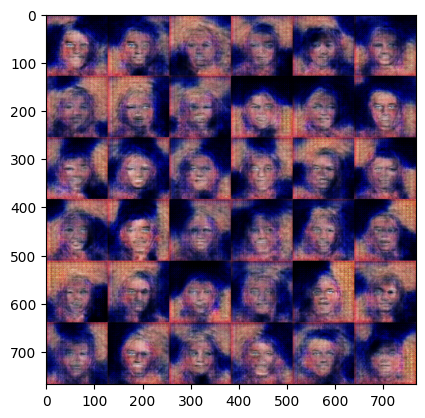

Training Progress:  90%|█████████ | 13500/15000 [1:12:06<11:15,  2.22step/s]

****************************************************************************************************
1/1 [==============================] - 0s 17ms/step


Training Progress:  90%|█████████ | 13501/15000 [1:12:06<10:15,  2.44step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  90%|█████████ | 13502/15000 [1:12:06<09:45,  2.56step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|█████████ | 13503/15000 [1:12:07<09:06,  2.74step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|█████████ | 13504/15000 [1:12:07<08:56,  2.79step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|█████████ | 13505/15000 [1:12:07<08:33,  2.91step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|█████████ | 13506/15000 [1:12:08<08:17,  3.00step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|█████████ | 13507/15000 [1:12:08<08:05,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|█████████ | 13508/15000 [1:12:08<07:57,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|█████████ | 13509/15000 [1:12:08<07:49,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|█████████ | 13510/15000 [1:12:09<07:46,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|█████████ | 13511/15000 [1:12:09<07:42,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|█████████ | 13512/15000 [1:12:09<07:40,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|█████████ | 13513/15000 [1:12:10<07:37,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|█████████ | 13514/15000 [1:12:10<07:37,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|█████████ | 13515/15000 [1:12:10<07:39,  3.23step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  90%|█████████ | 13516/15000 [1:12:11<07:42,  3.21step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  90%|█████████ | 13517/15000 [1:12:11<07:41,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|█████████ | 13518/15000 [1:12:11<07:40,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|█████████ | 13519/15000 [1:12:12<07:37,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|█████████ | 13520/15000 [1:12:12<07:36,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|█████████ | 13521/15000 [1:12:12<07:35,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|█████████ | 13522/15000 [1:12:13<08:00,  3.08step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  90%|█████████ | 13523/15000 [1:12:13<07:55,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|█████████ | 13524/15000 [1:12:13<07:51,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|█████████ | 13525/15000 [1:12:13<07:46,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|█████████ | 13526/15000 [1:12:14<07:41,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|█████████ | 13527/15000 [1:12:14<07:37,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|█████████ | 13528/15000 [1:12:14<07:35,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  90%|█████████ | 13529/15000 [1:12:15<07:35,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|█████████ | 13530/15000 [1:12:15<07:35,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|█████████ | 13531/15000 [1:12:15<07:32,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|█████████ | 13532/15000 [1:12:16<07:33,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  90%|█████████ | 13533/15000 [1:12:16<07:35,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  90%|█████████ | 13534/15000 [1:12:16<07:35,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  90%|█████████ | 13535/15000 [1:12:17<07:32,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  90%|█████████ | 13536/15000 [1:12:17<07:33,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|█████████ | 13537/15000 [1:12:17<07:30,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|█████████ | 13538/15000 [1:12:17<07:30,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|█████████ | 13539/15000 [1:12:18<07:29,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|█████████ | 13540/15000 [1:12:18<07:29,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|█████████ | 13541/15000 [1:12:18<07:28,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  90%|█████████ | 13542/15000 [1:12:19<07:31,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|█████████ | 13543/15000 [1:12:19<07:29,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|█████████ | 13544/15000 [1:12:19<07:29,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  90%|█████████ | 13545/15000 [1:12:20<07:27,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|█████████ | 13546/15000 [1:12:20<07:28,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|█████████ | 13547/15000 [1:12:20<07:43,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|█████████ | 13548/15000 [1:12:21<07:38,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  90%|█████████ | 13549/15000 [1:12:21<07:33,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  90%|█████████ | 13550/15000 [1:12:21<07:31,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|█████████ | 13551/15000 [1:12:22<07:28,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  90%|█████████ | 13552/15000 [1:12:22<07:30,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  90%|█████████ | 13553/15000 [1:12:22<07:29,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|█████████ | 13554/15000 [1:12:22<07:31,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|█████████ | 13555/15000 [1:12:23<07:27,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  90%|█████████ | 13556/15000 [1:12:23<07:27,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|█████████ | 13557/15000 [1:12:23<07:25,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|█████████ | 13558/15000 [1:12:24<07:25,  3.24step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  90%|█████████ | 13559/15000 [1:12:24<07:24,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  90%|█████████ | 13560/15000 [1:12:24<07:25,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  90%|█████████ | 13561/15000 [1:12:25<07:26,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  90%|█████████ | 13562/15000 [1:12:25<07:26,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  90%|█████████ | 13563/15000 [1:12:25<07:25,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|█████████ | 13564/15000 [1:12:26<07:23,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|█████████ | 13565/15000 [1:12:26<07:37,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  90%|█████████ | 13566/15000 [1:12:26<07:35,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|█████████ | 13567/15000 [1:12:27<07:29,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  90%|█████████ | 13568/15000 [1:12:27<07:27,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|█████████ | 13569/15000 [1:12:27<07:24,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  90%|█████████ | 13570/15000 [1:12:27<07:26,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|█████████ | 13571/15000 [1:12:28<07:23,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|█████████ | 13572/15000 [1:12:28<07:22,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  90%|█████████ | 13573/15000 [1:12:28<07:21,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|█████████ | 13574/15000 [1:12:29<07:20,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  90%|█████████ | 13575/15000 [1:12:29<07:18,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  91%|█████████ | 13576/15000 [1:12:29<07:17,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  91%|█████████ | 13577/15000 [1:12:30<07:15,  3.27step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  91%|█████████ | 13578/15000 [1:12:30<07:16,  3.26step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  91%|█████████ | 13579/15000 [1:12:30<07:18,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  91%|█████████ | 13580/15000 [1:12:31<07:18,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  91%|█████████ | 13581/15000 [1:12:31<07:33,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  91%|█████████ | 13582/15000 [1:12:31<07:27,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  91%|█████████ | 13583/15000 [1:12:31<07:24,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  91%|█████████ | 13584/15000 [1:12:32<07:21,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  91%|█████████ | 13585/15000 [1:12:32<07:21,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  91%|█████████ | 13586/15000 [1:12:32<07:22,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  91%|█████████ | 13587/15000 [1:12:33<07:19,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  91%|█████████ | 13588/15000 [1:12:33<07:15,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  91%|█████████ | 13589/15000 [1:12:33<07:18,  3.22step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  91%|█████████ | 13590/15000 [1:12:34<07:19,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  91%|█████████ | 13591/15000 [1:12:34<07:59,  2.94step/s]

1/1 [==============================] - 0s 28ms/step


Training Progress:  91%|█████████ | 13592/15000 [1:12:34<08:15,  2.84step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  91%|█████████ | 13593/15000 [1:12:35<08:42,  2.69step/s]

1/1 [==============================] - 0s 29ms/step


Training Progress:  91%|█████████ | 13594/15000 [1:12:35<08:46,  2.67step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  91%|█████████ | 13595/15000 [1:12:36<08:18,  2.82step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  91%|█████████ | 13596/15000 [1:12:36<08:12,  2.85step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  91%|█████████ | 13597/15000 [1:12:36<07:54,  2.96step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  91%|█████████ | 13598/15000 [1:12:37<07:43,  3.03step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  91%|█████████ | 13599/15000 [1:12:37<07:34,  3.08step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  91%|█████████ | 13600/15000 [1:12:37<07:27,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  91%|█████████ | 13601/15000 [1:12:37<07:22,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  91%|█████████ | 13602/15000 [1:12:38<07:16,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  91%|█████████ | 13603/15000 [1:12:38<07:14,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  91%|█████████ | 13604/15000 [1:12:38<07:11,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  91%|█████████ | 13605/15000 [1:12:39<07:09,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  91%|█████████ | 13606/15000 [1:12:39<07:07,  3.26step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  91%|█████████ | 13607/15000 [1:12:39<07:12,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  91%|█████████ | 13608/15000 [1:12:40<07:11,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  91%|█████████ | 13609/15000 [1:12:40<07:12,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  91%|█████████ | 13610/15000 [1:12:40<07:09,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  91%|█████████ | 13611/15000 [1:12:41<07:08,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  91%|█████████ | 13612/15000 [1:12:41<07:07,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  91%|█████████ | 13613/15000 [1:12:41<07:07,  3.24step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  91%|█████████ | 13614/15000 [1:12:41<07:10,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  91%|█████████ | 13615/15000 [1:12:42<07:07,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  91%|█████████ | 13616/15000 [1:12:42<07:08,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  91%|█████████ | 13617/15000 [1:12:42<07:09,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  91%|█████████ | 13618/15000 [1:12:43<07:07,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  91%|█████████ | 13619/15000 [1:12:43<07:06,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  91%|█████████ | 13620/15000 [1:12:43<07:05,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  91%|█████████ | 13621/15000 [1:12:44<07:04,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  91%|█████████ | 13622/15000 [1:12:44<07:04,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  91%|█████████ | 13623/15000 [1:12:44<07:02,  3.26step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  91%|█████████ | 13624/15000 [1:12:45<07:02,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  91%|█████████ | 13625/15000 [1:12:45<07:01,  3.27step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  91%|█████████ | 13626/15000 [1:12:45<07:03,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  91%|█████████ | 13627/15000 [1:12:45<07:18,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  91%|█████████ | 13628/15000 [1:12:46<07:13,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  91%|█████████ | 13629/15000 [1:12:46<07:10,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  91%|█████████ | 13630/15000 [1:12:46<07:06,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  91%|█████████ | 13631/15000 [1:12:47<07:03,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  91%|█████████ | 13632/15000 [1:12:47<07:01,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  91%|█████████ | 13633/15000 [1:12:47<06:59,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  91%|█████████ | 13634/15000 [1:12:48<06:57,  3.27step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  91%|█████████ | 13635/15000 [1:12:48<07:15,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  91%|█████████ | 13636/15000 [1:12:48<07:09,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  91%|█████████ | 13637/15000 [1:12:49<07:04,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  91%|█████████ | 13638/15000 [1:12:49<07:02,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  91%|█████████ | 13639/15000 [1:12:49<06:59,  3.25step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:  91%|█████████ | 13640/15000 [1:12:49<06:56,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  91%|█████████ | 13641/15000 [1:12:50<06:55,  3.27step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  91%|█████████ | 13642/15000 [1:12:50<06:55,  3.27step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  91%|█████████ | 13643/15000 [1:12:50<06:54,  3.27step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  91%|█████████ | 13644/15000 [1:12:51<06:56,  3.26step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  91%|█████████ | 13645/15000 [1:12:51<06:55,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  91%|█████████ | 13646/15000 [1:12:51<06:54,  3.27step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  91%|█████████ | 13647/15000 [1:12:52<06:53,  3.27step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  91%|█████████ | 13648/15000 [1:12:52<06:54,  3.26step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  91%|█████████ | 13649/15000 [1:12:52<06:56,  3.25step/s]

1/1 [==============================] - 0s 29ms/step


Training Progress:  91%|█████████ | 13650/15000 [1:12:53<07:07,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  91%|█████████ | 13651/15000 [1:12:53<07:03,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  91%|█████████ | 13652/15000 [1:12:53<06:59,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  91%|█████████ | 13653/15000 [1:12:54<06:59,  3.21step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  91%|█████████ | 13654/15000 [1:12:54<07:15,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  91%|█████████ | 13655/15000 [1:12:54<07:09,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  91%|█████████ | 13656/15000 [1:12:54<07:08,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  91%|█████████ | 13657/15000 [1:12:55<07:04,  3.16step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  91%|█████████ | 13658/15000 [1:12:55<07:03,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  91%|█████████ | 13659/15000 [1:12:55<07:04,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  91%|█████████ | 13660/15000 [1:12:56<06:59,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  91%|█████████ | 13661/15000 [1:12:56<06:58,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  91%|█████████ | 13662/15000 [1:12:56<06:56,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  91%|█████████ | 13663/15000 [1:12:57<07:00,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  91%|█████████ | 13664/15000 [1:12:57<06:57,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  91%|█████████ | 13665/15000 [1:12:57<06:55,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  91%|█████████ | 13666/15000 [1:12:58<06:53,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  91%|█████████ | 13667/15000 [1:12:58<06:52,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  91%|█████████ | 13668/15000 [1:12:58<06:51,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  91%|█████████ | 13669/15000 [1:12:59<07:07,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  91%|█████████ | 13670/15000 [1:12:59<07:01,  3.16step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:  91%|█████████ | 13671/15000 [1:12:59<06:56,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  91%|█████████ | 13672/15000 [1:13:00<06:56,  3.19step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  91%|█████████ | 13673/15000 [1:13:00<06:57,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  91%|█████████ | 13674/15000 [1:13:00<06:53,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  91%|█████████ | 13675/15000 [1:13:00<06:51,  3.22step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:  91%|█████████ | 13676/15000 [1:13:01<06:49,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  91%|█████████ | 13677/15000 [1:13:01<06:48,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  91%|█████████ | 13678/15000 [1:13:01<06:46,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  91%|█████████ | 13679/15000 [1:13:02<06:47,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  91%|█████████ | 13680/15000 [1:13:02<06:46,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  91%|█████████ | 13681/15000 [1:13:02<06:51,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  91%|█████████ | 13682/15000 [1:13:03<07:11,  3.06step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  91%|█████████ | 13683/15000 [1:13:03<07:03,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  91%|█████████ | 13684/15000 [1:13:03<06:57,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  91%|█████████ | 13685/15000 [1:13:04<07:08,  3.07step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  91%|█████████ | 13686/15000 [1:13:04<07:00,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  91%|█████████ | 13687/15000 [1:13:04<07:10,  3.05step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  91%|█████████▏| 13688/15000 [1:13:05<07:01,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  91%|█████████▏| 13689/15000 [1:13:05<06:57,  3.14step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  91%|█████████▏| 13690/15000 [1:13:05<06:57,  3.14step/s]

1/1 [==============================] - 0s 31ms/step


Training Progress:  91%|█████████▏| 13691/15000 [1:13:06<07:41,  2.84step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  91%|█████████▏| 13692/15000 [1:13:06<08:10,  2.67step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  91%|█████████▏| 13693/15000 [1:13:06<08:24,  2.59step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  91%|█████████▏| 13694/15000 [1:13:07<07:59,  2.73step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  91%|█████████▏| 13695/15000 [1:13:07<07:35,  2.87step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  91%|█████████▏| 13696/15000 [1:13:07<07:18,  2.98step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  91%|█████████▏| 13697/15000 [1:13:08<07:21,  2.95step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  91%|█████████▏| 13698/15000 [1:13:08<07:07,  3.04step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  91%|█████████▏| 13699/15000 [1:13:08<06:59,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  91%|█████████▏| 13700/15000 [1:13:09<06:54,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  91%|█████████▏| 13701/15000 [1:13:09<07:05,  3.05step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  91%|█████████▏| 13702/15000 [1:13:09<06:57,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  91%|█████████▏| 13703/15000 [1:13:10<06:51,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  91%|█████████▏| 13704/15000 [1:13:10<06:47,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  91%|█████████▏| 13705/15000 [1:13:10<06:44,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  91%|█████████▏| 13706/15000 [1:13:11<06:40,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  91%|█████████▏| 13707/15000 [1:13:11<06:40,  3.23step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  91%|█████████▏| 13708/15000 [1:13:11<06:40,  3.23step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  91%|█████████▏| 13709/15000 [1:13:12<06:45,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  91%|█████████▏| 13710/15000 [1:13:12<06:56,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  91%|█████████▏| 13711/15000 [1:13:12<07:10,  2.99step/s]

1/1 [==============================] - 0s 28ms/step


Training Progress:  91%|█████████▏| 13712/15000 [1:13:13<07:19,  2.93step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  91%|█████████▏| 13713/15000 [1:13:13<07:07,  3.01step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  91%|█████████▏| 13714/15000 [1:13:13<06:59,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  91%|█████████▏| 13715/15000 [1:13:13<06:52,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  91%|█████████▏| 13716/15000 [1:13:14<06:45,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  91%|█████████▏| 13717/15000 [1:13:14<06:41,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  91%|█████████▏| 13718/15000 [1:13:14<06:40,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  91%|█████████▏| 13719/15000 [1:13:15<06:39,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  91%|█████████▏| 13720/15000 [1:13:15<06:36,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  91%|█████████▏| 13721/15000 [1:13:15<06:36,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  91%|█████████▏| 13722/15000 [1:13:16<06:35,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  91%|█████████▏| 13723/15000 [1:13:16<06:35,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  91%|█████████▏| 13724/15000 [1:13:16<06:47,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  92%|█████████▏| 13725/15000 [1:13:17<06:44,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  92%|█████████▏| 13726/15000 [1:13:17<06:39,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  92%|█████████▏| 13727/15000 [1:13:17<06:40,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  92%|█████████▏| 13728/15000 [1:13:18<06:36,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  92%|█████████▏| 13729/15000 [1:13:18<06:34,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  92%|█████████▏| 13730/15000 [1:13:18<06:33,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  92%|█████████▏| 13731/15000 [1:13:18<06:32,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  92%|█████████▏| 13732/15000 [1:13:19<06:30,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  92%|█████████▏| 13733/15000 [1:13:19<06:30,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  92%|█████████▏| 13734/15000 [1:13:19<06:29,  3.25step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:  92%|█████████▏| 13735/15000 [1:13:20<06:42,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  92%|█████████▏| 13736/15000 [1:13:20<06:36,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  92%|█████████▏| 13737/15000 [1:13:20<06:37,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  92%|█████████▏| 13738/15000 [1:13:21<06:32,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  92%|█████████▏| 13739/15000 [1:13:21<06:31,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  92%|█████████▏| 13740/15000 [1:13:21<06:28,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  92%|█████████▏| 13741/15000 [1:13:22<06:28,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  92%|█████████▏| 13742/15000 [1:13:22<06:28,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  92%|█████████▏| 13743/15000 [1:13:22<06:30,  3.21step/s]

1/1 [==============================] - 0s 23ms/step


Training Progress:  92%|█████████▏| 13744/15000 [1:13:23<06:36,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  92%|█████████▏| 13745/15000 [1:13:23<06:33,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  92%|█████████▏| 13746/15000 [1:13:23<06:33,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  92%|█████████▏| 13747/15000 [1:13:23<06:31,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  92%|█████████▏| 13748/15000 [1:13:24<06:28,  3.22step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:  92%|█████████▏| 13749/15000 [1:13:24<06:27,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  92%|█████████▏| 13750/15000 [1:13:24<06:25,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  92%|█████████▏| 13751/15000 [1:13:25<06:24,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  92%|█████████▏| 13752/15000 [1:13:25<06:22,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  92%|█████████▏| 13753/15000 [1:13:25<06:22,  3.26step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:  92%|█████████▏| 13754/15000 [1:13:26<06:20,  3.27step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  92%|█████████▏| 13755/15000 [1:13:26<06:23,  3.24step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  92%|█████████▏| 13756/15000 [1:13:26<06:23,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  92%|█████████▏| 13757/15000 [1:13:27<06:23,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  92%|█████████▏| 13758/15000 [1:13:27<06:21,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  92%|█████████▏| 13759/15000 [1:13:27<06:34,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  92%|█████████▏| 13760/15000 [1:13:27<06:29,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  92%|█████████▏| 13761/15000 [1:13:28<06:26,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  92%|█████████▏| 13762/15000 [1:13:28<06:26,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  92%|█████████▏| 13763/15000 [1:13:28<06:37,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  92%|█████████▏| 13764/15000 [1:13:29<06:33,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  92%|█████████▏| 13765/15000 [1:13:29<06:28,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  92%|█████████▏| 13766/15000 [1:13:29<06:24,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  92%|█████████▏| 13767/15000 [1:13:30<06:22,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  92%|█████████▏| 13768/15000 [1:13:30<06:20,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  92%|█████████▏| 13769/15000 [1:13:30<06:20,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  92%|█████████▏| 13770/15000 [1:13:31<06:31,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  92%|█████████▏| 13771/15000 [1:13:31<06:26,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  92%|█████████▏| 13772/15000 [1:13:31<06:23,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  92%|█████████▏| 13773/15000 [1:13:32<06:21,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  92%|█████████▏| 13774/15000 [1:13:32<06:33,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  92%|█████████▏| 13775/15000 [1:13:32<06:35,  3.10step/s]

1/1 [==============================] - 0s 36ms/step


Training Progress:  92%|█████████▏| 13776/15000 [1:13:33<06:51,  2.98step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  92%|█████████▏| 13777/15000 [1:13:33<06:40,  3.05step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  92%|█████████▏| 13778/15000 [1:13:33<06:32,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  92%|█████████▏| 13779/15000 [1:13:34<06:27,  3.15step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  92%|█████████▏| 13780/15000 [1:13:34<06:26,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  92%|█████████▏| 13781/15000 [1:13:34<06:22,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  92%|█████████▏| 13782/15000 [1:13:34<06:21,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  92%|█████████▏| 13783/15000 [1:13:35<06:21,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  92%|█████████▏| 13784/15000 [1:13:35<06:19,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  92%|█████████▏| 13785/15000 [1:13:35<06:17,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  92%|█████████▏| 13786/15000 [1:13:36<06:15,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  92%|█████████▏| 13787/15000 [1:13:36<06:15,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  92%|█████████▏| 13788/15000 [1:13:36<06:13,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  92%|█████████▏| 13789/15000 [1:13:37<06:12,  3.25step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  92%|█████████▏| 13790/15000 [1:13:37<06:57,  2.90step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  92%|█████████▏| 13791/15000 [1:13:37<07:20,  2.74step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  92%|█████████▏| 13792/15000 [1:13:38<07:24,  2.72step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  92%|█████████▏| 13793/15000 [1:13:38<07:23,  2.72step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  92%|█████████▏| 13794/15000 [1:13:38<07:01,  2.86step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  92%|█████████▏| 13795/15000 [1:13:39<06:45,  2.97step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  92%|█████████▏| 13796/15000 [1:13:39<06:33,  3.06step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  92%|█████████▏| 13797/15000 [1:13:39<06:27,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  92%|█████████▏| 13798/15000 [1:13:40<06:21,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  92%|█████████▏| 13799/15000 [1:13:40<06:17,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  92%|█████████▏| 13800/15000 [1:13:40<06:14,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  92%|█████████▏| 13801/15000 [1:13:41<06:14,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  92%|█████████▏| 13802/15000 [1:13:41<06:12,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  92%|█████████▏| 13803/15000 [1:13:41<06:10,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  92%|█████████▏| 13804/15000 [1:13:42<06:09,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  92%|█████████▏| 13805/15000 [1:13:42<06:08,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  92%|█████████▏| 13806/15000 [1:13:42<06:06,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  92%|█████████▏| 13807/15000 [1:13:43<06:15,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  92%|█████████▏| 13808/15000 [1:13:43<06:12,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  92%|█████████▏| 13809/15000 [1:13:43<06:22,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  92%|█████████▏| 13810/15000 [1:13:43<06:16,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  92%|█████████▏| 13811/15000 [1:13:44<06:14,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  92%|█████████▏| 13812/15000 [1:13:44<06:11,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  92%|█████████▏| 13813/15000 [1:13:44<06:09,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  92%|█████████▏| 13814/15000 [1:13:45<06:07,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  92%|█████████▏| 13815/15000 [1:13:45<06:08,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  92%|█████████▏| 13816/15000 [1:13:45<06:06,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  92%|█████████▏| 13817/15000 [1:13:46<06:05,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  92%|█████████▏| 13818/15000 [1:13:46<06:04,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  92%|█████████▏| 13819/15000 [1:13:46<06:05,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  92%|█████████▏| 13820/15000 [1:13:47<06:05,  3.23step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  92%|█████████▏| 13821/15000 [1:13:47<07:48,  2.52step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  92%|█████████▏| 13822/15000 [1:13:47<07:18,  2.69step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  92%|█████████▏| 13823/15000 [1:13:48<06:59,  2.80step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  92%|█████████▏| 13824/15000 [1:13:48<06:43,  2.91step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  92%|█████████▏| 13825/15000 [1:13:48<06:33,  2.99step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  92%|█████████▏| 13826/15000 [1:13:49<06:25,  3.05step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  92%|█████████▏| 13827/15000 [1:13:49<06:20,  3.08step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  92%|█████████▏| 13828/15000 [1:13:49<06:17,  3.11step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  92%|█████████▏| 13829/15000 [1:13:50<06:14,  3.12step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  92%|█████████▏| 13830/15000 [1:13:50<06:14,  3.13step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  92%|█████████▏| 13831/15000 [1:13:50<06:12,  3.13step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  92%|█████████▏| 13832/15000 [1:13:51<06:10,  3.15step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  92%|█████████▏| 13833/15000 [1:13:51<06:09,  3.15step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  92%|█████████▏| 13834/15000 [1:13:51<06:08,  3.16step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  92%|█████████▏| 13835/15000 [1:13:52<06:07,  3.17step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  92%|█████████▏| 13836/15000 [1:13:52<06:06,  3.17step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  92%|█████████▏| 13837/15000 [1:13:52<06:08,  3.16step/s]

1/1 [==============================] - 0s 35ms/step


Training Progress:  92%|█████████▏| 13838/15000 [1:13:53<06:19,  3.06step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  92%|█████████▏| 13839/15000 [1:13:53<06:18,  3.07step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  92%|█████████▏| 13840/15000 [1:13:53<06:26,  3.00step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  92%|█████████▏| 13841/15000 [1:13:54<06:20,  3.05step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  92%|█████████▏| 13842/15000 [1:13:54<06:16,  3.08step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  92%|█████████▏| 13843/15000 [1:13:54<06:12,  3.10step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  92%|█████████▏| 13844/15000 [1:13:54<06:09,  3.13step/s]

1/1 [==============================] - 0s 23ms/step


Training Progress:  92%|█████████▏| 13845/15000 [1:13:55<06:11,  3.11step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  92%|█████████▏| 13846/15000 [1:13:55<06:07,  3.14step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  92%|█████████▏| 13847/15000 [1:13:55<06:06,  3.15step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  92%|█████████▏| 13848/15000 [1:13:56<06:07,  3.14step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  92%|█████████▏| 13849/15000 [1:13:56<06:18,  3.04step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  92%|█████████▏| 13850/15000 [1:13:56<06:12,  3.09step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  92%|█████████▏| 13851/15000 [1:13:57<06:09,  3.11step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  92%|█████████▏| 13852/15000 [1:13:57<06:06,  3.13step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  92%|█████████▏| 13853/15000 [1:13:57<06:05,  3.14step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  92%|█████████▏| 13854/15000 [1:13:58<06:03,  3.15step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  92%|█████████▏| 13855/15000 [1:13:58<06:16,  3.05step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  92%|█████████▏| 13856/15000 [1:13:58<06:11,  3.08step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  92%|█████████▏| 13857/15000 [1:13:59<06:11,  3.08step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  92%|█████████▏| 13858/15000 [1:13:59<06:06,  3.11step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  92%|█████████▏| 13859/15000 [1:13:59<06:05,  3.12step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  92%|█████████▏| 13860/15000 [1:14:00<06:03,  3.13step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  92%|█████████▏| 13861/15000 [1:14:00<06:02,  3.14step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  92%|█████████▏| 13862/15000 [1:14:00<06:00,  3.16step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  92%|█████████▏| 13863/15000 [1:14:01<05:59,  3.16step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  92%|█████████▏| 13864/15000 [1:14:01<05:58,  3.17step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  92%|█████████▏| 13865/15000 [1:14:01<05:58,  3.17step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  92%|█████████▏| 13866/15000 [1:14:02<06:00,  3.15step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  92%|█████████▏| 13867/15000 [1:14:02<05:58,  3.16step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  92%|█████████▏| 13868/15000 [1:14:02<05:57,  3.17step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  92%|█████████▏| 13869/15000 [1:14:03<06:16,  3.01step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  92%|█████████▏| 13870/15000 [1:14:03<06:09,  3.06step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  92%|█████████▏| 13871/15000 [1:14:03<06:05,  3.09step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  92%|█████████▏| 13872/15000 [1:14:04<06:14,  3.02step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  92%|█████████▏| 13873/15000 [1:14:04<06:09,  3.05step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  92%|█████████▏| 13874/15000 [1:14:04<06:04,  3.09step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  92%|█████████▎| 13875/15000 [1:14:04<06:02,  3.10step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  93%|█████████▎| 13876/15000 [1:14:05<06:00,  3.12step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  93%|█████████▎| 13877/15000 [1:14:05<05:59,  3.13step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  93%|█████████▎| 13878/15000 [1:14:05<05:58,  3.13step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  93%|█████████▎| 13879/15000 [1:14:06<05:56,  3.15step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  93%|█████████▎| 13880/15000 [1:14:06<05:59,  3.11step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  93%|█████████▎| 13881/15000 [1:14:06<05:57,  3.13step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  93%|█████████▎| 13882/15000 [1:14:07<05:55,  3.15step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  93%|█████████▎| 13883/15000 [1:14:07<05:52,  3.17step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  93%|█████████▎| 13884/15000 [1:14:07<06:03,  3.07step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  93%|█████████▎| 13885/15000 [1:14:08<06:12,  2.99step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  93%|█████████▎| 13886/15000 [1:14:08<06:05,  3.05step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  93%|█████████▎| 13887/15000 [1:14:08<06:43,  2.76step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  93%|█████████▎| 13888/15000 [1:14:09<07:01,  2.64step/s]

1/1 [==============================] - 0s 27ms/step


Training Progress:  93%|█████████▎| 13889/15000 [1:14:09<07:12,  2.57step/s]

1/1 [==============================] - 0s 23ms/step


Training Progress:  93%|█████████▎| 13890/15000 [1:14:10<06:51,  2.70step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  93%|█████████▎| 13891/15000 [1:14:10<06:30,  2.84step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  93%|█████████▎| 13892/15000 [1:14:10<06:17,  2.94step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  93%|█████████▎| 13893/15000 [1:14:11<06:09,  3.00step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  93%|█████████▎| 13894/15000 [1:14:11<06:01,  3.06step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  93%|█████████▎| 13895/15000 [1:14:11<05:55,  3.11step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  93%|█████████▎| 13896/15000 [1:14:12<05:52,  3.13step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  93%|█████████▎| 13897/15000 [1:14:12<05:49,  3.16step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  93%|█████████▎| 13898/15000 [1:14:12<05:47,  3.17step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  93%|█████████▎| 13899/15000 [1:14:12<05:57,  3.08step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  93%|█████████▎| 13900/15000 [1:14:13<06:03,  3.02step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  93%|█████████▎| 13901/15000 [1:14:13<05:56,  3.08step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  93%|█████████▎| 13902/15000 [1:14:13<05:54,  3.10step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  93%|█████████▎| 13903/15000 [1:14:14<05:49,  3.14step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  93%|█████████▎| 13904/15000 [1:14:14<05:47,  3.16step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  93%|█████████▎| 13905/15000 [1:14:14<05:44,  3.18step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  93%|█████████▎| 13906/15000 [1:14:15<05:42,  3.19step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  93%|█████████▎| 13907/15000 [1:14:15<05:42,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  93%|█████████▎| 13908/15000 [1:14:15<05:41,  3.19step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  93%|█████████▎| 13909/15000 [1:14:16<05:41,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  93%|█████████▎| 13910/15000 [1:14:16<05:40,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  93%|█████████▎| 13911/15000 [1:14:16<05:41,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  93%|█████████▎| 13912/15000 [1:14:17<05:40,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  93%|█████████▎| 13913/15000 [1:14:17<05:38,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  93%|█████████▎| 13914/15000 [1:14:17<05:37,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  93%|█████████▎| 13915/15000 [1:14:17<05:38,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  93%|█████████▎| 13916/15000 [1:14:18<05:36,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  93%|█████████▎| 13917/15000 [1:14:18<05:46,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  93%|█████████▎| 13918/15000 [1:14:18<05:55,  3.05step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  93%|█████████▎| 13919/15000 [1:14:19<05:49,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  93%|█████████▎| 13920/15000 [1:14:19<05:44,  3.14step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  93%|█████████▎| 13921/15000 [1:14:19<05:45,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  93%|█████████▎| 13922/15000 [1:14:20<05:42,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  93%|█████████▎| 13923/15000 [1:14:20<05:39,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  93%|█████████▎| 13924/15000 [1:14:20<05:38,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  93%|█████████▎| 13925/15000 [1:14:21<05:36,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  93%|█████████▎| 13926/15000 [1:14:21<05:34,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  93%|█████████▎| 13927/15000 [1:14:21<05:33,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  93%|█████████▎| 13928/15000 [1:14:22<05:32,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  93%|█████████▎| 13929/15000 [1:14:22<05:31,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  93%|█████████▎| 13930/15000 [1:14:22<05:33,  3.21step/s]

1/1 [==============================] - 0s 36ms/step


Training Progress:  93%|█████████▎| 13931/15000 [1:14:23<05:54,  3.01step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  93%|█████████▎| 13932/15000 [1:14:23<06:00,  2.97step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  93%|█████████▎| 13933/15000 [1:14:23<05:50,  3.04step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  93%|█████████▎| 13934/15000 [1:14:24<05:44,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  93%|█████████▎| 13935/15000 [1:14:24<05:39,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  93%|█████████▎| 13936/15000 [1:14:24<05:35,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  93%|█████████▎| 13937/15000 [1:14:24<05:31,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  93%|█████████▎| 13938/15000 [1:14:25<05:28,  3.23step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  93%|█████████▎| 13939/15000 [1:14:25<05:29,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  93%|█████████▎| 13940/15000 [1:14:25<05:28,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  93%|█████████▎| 13941/15000 [1:14:26<05:27,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  93%|█████████▎| 13942/15000 [1:14:26<05:26,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  93%|█████████▎| 13943/15000 [1:14:26<05:24,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  93%|█████████▎| 13944/15000 [1:14:27<05:24,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  93%|█████████▎| 13945/15000 [1:14:27<05:25,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  93%|█████████▎| 13946/15000 [1:14:27<05:24,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  93%|█████████▎| 13947/15000 [1:14:28<05:25,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  93%|█████████▎| 13948/15000 [1:14:28<05:25,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  93%|█████████▎| 13949/15000 [1:14:28<05:24,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  93%|█████████▎| 13950/15000 [1:14:29<05:23,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  93%|█████████▎| 13951/15000 [1:14:29<05:22,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  93%|█████████▎| 13952/15000 [1:14:29<05:23,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  93%|█████████▎| 13953/15000 [1:14:29<05:23,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  93%|█████████▎| 13954/15000 [1:14:30<05:23,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  93%|█████████▎| 13955/15000 [1:14:30<05:21,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  93%|█████████▎| 13956/15000 [1:14:30<05:21,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  93%|█████████▎| 13957/15000 [1:14:31<05:20,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  93%|█████████▎| 13958/15000 [1:14:31<05:23,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  93%|█████████▎| 13959/15000 [1:14:31<05:22,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  93%|█████████▎| 13960/15000 [1:14:32<05:21,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  93%|█████████▎| 13961/15000 [1:14:32<05:20,  3.24step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:  93%|█████████▎| 13962/15000 [1:14:32<05:25,  3.19step/s]

1/1 [==============================] - 0s 41ms/step


Training Progress:  93%|█████████▎| 13963/15000 [1:14:33<05:40,  3.04step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  93%|█████████▎| 13964/15000 [1:14:33<05:32,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  93%|█████████▎| 13965/15000 [1:14:33<05:26,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  93%|█████████▎| 13966/15000 [1:14:34<05:35,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  93%|█████████▎| 13967/15000 [1:14:34<05:31,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  93%|█████████▎| 13968/15000 [1:14:34<05:26,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  93%|█████████▎| 13969/15000 [1:14:34<05:23,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  93%|█████████▎| 13970/15000 [1:14:35<05:19,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  93%|█████████▎| 13971/15000 [1:14:35<05:18,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  93%|█████████▎| 13972/15000 [1:14:35<05:16,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  93%|█████████▎| 13973/15000 [1:14:36<05:16,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  93%|█████████▎| 13974/15000 [1:14:36<05:15,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  93%|█████████▎| 13975/15000 [1:14:36<05:26,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  93%|█████████▎| 13976/15000 [1:14:37<05:23,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  93%|█████████▎| 13977/15000 [1:14:37<05:21,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  93%|█████████▎| 13978/15000 [1:14:37<05:18,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  93%|█████████▎| 13979/15000 [1:14:38<05:17,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  93%|█████████▎| 13980/15000 [1:14:38<05:16,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  93%|█████████▎| 13981/15000 [1:14:38<05:17,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  93%|█████████▎| 13982/15000 [1:14:39<05:16,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  93%|█████████▎| 13983/15000 [1:14:39<05:15,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  93%|█████████▎| 13984/15000 [1:14:39<05:13,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  93%|█████████▎| 13985/15000 [1:14:39<05:15,  3.22step/s]

1/1 [==============================] - 0s 31ms/step


Training Progress:  93%|█████████▎| 13986/15000 [1:14:40<05:46,  2.92step/s]

1/1 [==============================] - 0s 28ms/step


Training Progress:  93%|█████████▎| 13987/15000 [1:14:40<06:12,  2.72step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  93%|█████████▎| 13988/15000 [1:14:41<06:24,  2.63step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  93%|█████████▎| 13989/15000 [1:14:41<06:18,  2.67step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  93%|█████████▎| 13990/15000 [1:14:41<06:09,  2.73step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  93%|█████████▎| 13991/15000 [1:14:42<05:51,  2.87step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  93%|█████████▎| 13992/15000 [1:14:42<05:38,  2.98step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  93%|█████████▎| 13993/15000 [1:14:42<05:29,  3.06step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  93%|█████████▎| 13994/15000 [1:14:43<05:26,  3.08step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  93%|█████████▎| 13995/15000 [1:14:43<05:22,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  93%|█████████▎| 13996/15000 [1:14:43<05:18,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  93%|█████████▎| 13997/15000 [1:14:44<05:16,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  93%|█████████▎| 13998/15000 [1:14:44<05:13,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  93%|█████████▎| 13999/15000 [1:14:44<05:11,  3.21step/s]

1/1 [==============================] - 0s 16ms/step
****************************************************************************************************
14000/15000: d_loss: 0.120445,  g_loss: 0.003144
2/2 [==============================] - 0s 20ms/step


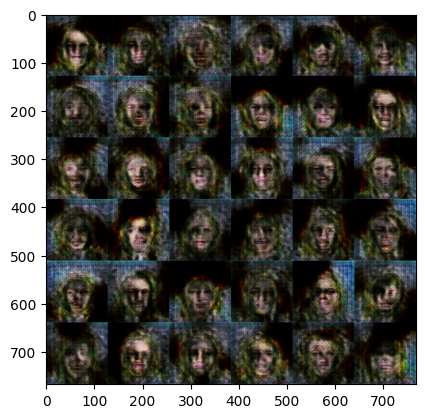

Training Progress:  93%|█████████▎| 14000/15000 [1:14:45<07:18,  2.28step/s]

****************************************************************************************************
1/1 [==============================] - 0s 17ms/step


Training Progress:  93%|█████████▎| 14001/15000 [1:14:45<06:39,  2.50step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  93%|█████████▎| 14002/15000 [1:14:46<06:22,  2.61step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  93%|█████████▎| 14003/15000 [1:14:46<06:00,  2.77step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  93%|█████████▎| 14004/15000 [1:14:46<05:45,  2.89step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  93%|█████████▎| 14005/15000 [1:14:46<05:33,  2.99step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  93%|█████████▎| 14006/15000 [1:14:47<05:24,  3.07step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  93%|█████████▎| 14007/15000 [1:14:47<05:19,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  93%|█████████▎| 14008/15000 [1:14:47<05:14,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  93%|█████████▎| 14009/15000 [1:14:48<05:11,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  93%|█████████▎| 14010/15000 [1:14:48<05:07,  3.22step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:  93%|█████████▎| 14011/15000 [1:14:48<05:05,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  93%|█████████▎| 14012/15000 [1:14:49<05:04,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  93%|█████████▎| 14013/15000 [1:14:49<05:03,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  93%|█████████▎| 14014/15000 [1:14:49<05:02,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  93%|█████████▎| 14015/15000 [1:14:50<05:02,  3.26step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  93%|█████████▎| 14016/15000 [1:14:50<05:03,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  93%|█████████▎| 14017/15000 [1:14:50<05:02,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  93%|█████████▎| 14018/15000 [1:14:50<05:02,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  93%|█████████▎| 14019/15000 [1:14:51<05:01,  3.25step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:  93%|█████████▎| 14020/15000 [1:14:51<05:00,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  93%|█████████▎| 14021/15000 [1:14:51<05:00,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  93%|█████████▎| 14022/15000 [1:14:52<04:59,  3.26step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  93%|█████████▎| 14023/15000 [1:14:52<05:01,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  93%|█████████▎| 14024/15000 [1:14:52<05:09,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  94%|█████████▎| 14025/15000 [1:14:53<05:09,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  94%|█████████▎| 14026/15000 [1:14:53<05:08,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  94%|█████████▎| 14027/15000 [1:14:53<05:04,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  94%|█████████▎| 14028/15000 [1:14:54<05:03,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▎| 14029/15000 [1:14:54<05:01,  3.22step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:  94%|█████████▎| 14030/15000 [1:14:54<04:59,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▎| 14031/15000 [1:14:55<04:57,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  94%|█████████▎| 14032/15000 [1:14:55<04:58,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▎| 14033/15000 [1:14:55<04:58,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▎| 14034/15000 [1:14:55<04:57,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▎| 14035/15000 [1:14:56<04:57,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▎| 14036/15000 [1:14:56<04:56,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▎| 14037/15000 [1:14:56<04:55,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▎| 14038/15000 [1:14:57<04:54,  3.27step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▎| 14039/15000 [1:14:57<04:53,  3.27step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:  94%|█████████▎| 14040/15000 [1:14:57<04:53,  3.27step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▎| 14041/15000 [1:14:58<04:52,  3.27step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▎| 14042/15000 [1:14:58<04:52,  3.27step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▎| 14043/15000 [1:14:58<04:52,  3.28step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▎| 14044/15000 [1:14:59<04:54,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▎| 14045/15000 [1:14:59<04:53,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▎| 14046/15000 [1:14:59<04:52,  3.26step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  94%|█████████▎| 14047/15000 [1:14:59<04:53,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▎| 14048/15000 [1:15:00<04:52,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▎| 14049/15000 [1:15:00<04:51,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▎| 14050/15000 [1:15:00<04:51,  3.26step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  94%|█████████▎| 14051/15000 [1:15:01<05:02,  3.13step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  94%|█████████▎| 14052/15000 [1:15:01<05:01,  3.14step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  94%|█████████▎| 14053/15000 [1:15:01<05:01,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  94%|█████████▎| 14054/15000 [1:15:02<04:59,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  94%|█████████▎| 14055/15000 [1:15:02<04:56,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▎| 14056/15000 [1:15:02<04:57,  3.18step/s]

1/1 [==============================] - 0s 34ms/step


Training Progress:  94%|█████████▎| 14057/15000 [1:15:03<05:06,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  94%|█████████▎| 14058/15000 [1:15:03<05:03,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▎| 14059/15000 [1:15:03<04:58,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▎| 14060/15000 [1:15:04<04:56,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▎| 14061/15000 [1:15:04<04:53,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  94%|█████████▎| 14062/15000 [1:15:04<04:53,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  94%|█████████▍| 14063/15000 [1:15:04<04:54,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  94%|█████████▍| 14064/15000 [1:15:05<04:53,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  94%|█████████▍| 14065/15000 [1:15:05<04:53,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▍| 14066/15000 [1:15:05<05:01,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▍| 14067/15000 [1:15:06<04:57,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  94%|█████████▍| 14068/15000 [1:15:06<05:04,  3.06step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  94%|█████████▍| 14069/15000 [1:15:06<04:59,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▍| 14070/15000 [1:15:07<04:55,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▍| 14071/15000 [1:15:07<04:52,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  94%|█████████▍| 14072/15000 [1:15:07<05:01,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  94%|█████████▍| 14073/15000 [1:15:08<04:56,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▍| 14074/15000 [1:15:08<04:53,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▍| 14075/15000 [1:15:08<04:50,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  94%|█████████▍| 14076/15000 [1:15:09<04:50,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▍| 14077/15000 [1:15:09<04:48,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  94%|█████████▍| 14078/15000 [1:15:09<04:47,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▍| 14079/15000 [1:15:10<04:46,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▍| 14080/15000 [1:15:10<04:44,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▍| 14081/15000 [1:15:10<04:45,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▍| 14082/15000 [1:15:10<04:44,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▍| 14083/15000 [1:15:11<04:43,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▍| 14084/15000 [1:15:11<05:06,  2.99step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  94%|█████████▍| 14085/15000 [1:15:12<05:18,  2.87step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  94%|█████████▍| 14086/15000 [1:15:12<05:44,  2.66step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  94%|█████████▍| 14087/15000 [1:15:12<05:54,  2.57step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  94%|█████████▍| 14088/15000 [1:15:13<05:32,  2.74step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▍| 14089/15000 [1:15:13<05:16,  2.88step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▍| 14090/15000 [1:15:13<05:06,  2.97step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  94%|█████████▍| 14091/15000 [1:15:14<04:58,  3.04step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▍| 14092/15000 [1:15:14<04:51,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▍| 14093/15000 [1:15:14<04:48,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▍| 14094/15000 [1:15:15<04:44,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▍| 14095/15000 [1:15:15<04:42,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  94%|█████████▍| 14096/15000 [1:15:15<04:41,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  94%|█████████▍| 14097/15000 [1:15:16<04:40,  3.22step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:  94%|█████████▍| 14098/15000 [1:15:16<04:39,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▍| 14099/15000 [1:15:16<04:38,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  94%|█████████▍| 14100/15000 [1:15:16<04:50,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▍| 14101/15000 [1:15:17<04:45,  3.14step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  94%|█████████▍| 14102/15000 [1:15:17<04:45,  3.14step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  94%|█████████▍| 14103/15000 [1:15:17<04:48,  3.11step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  94%|█████████▍| 14104/15000 [1:15:18<04:54,  3.04step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  94%|█████████▍| 14105/15000 [1:15:18<04:48,  3.10step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  94%|█████████▍| 14106/15000 [1:15:18<04:46,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▍| 14107/15000 [1:15:19<04:42,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▍| 14108/15000 [1:15:19<04:39,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▍| 14109/15000 [1:15:19<04:39,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▍| 14110/15000 [1:15:20<04:37,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  94%|█████████▍| 14111/15000 [1:15:20<04:38,  3.19step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  94%|█████████▍| 14112/15000 [1:15:20<04:44,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▍| 14113/15000 [1:15:21<04:40,  3.16step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  94%|█████████▍| 14114/15000 [1:15:21<04:40,  3.16step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  94%|█████████▍| 14115/15000 [1:15:21<04:38,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  94%|█████████▍| 14116/15000 [1:15:22<04:36,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▍| 14117/15000 [1:15:22<04:35,  3.21step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  94%|█████████▍| 14118/15000 [1:15:22<04:38,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  94%|█████████▍| 14119/15000 [1:15:23<04:52,  3.02step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  94%|█████████▍| 14120/15000 [1:15:23<04:46,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  94%|█████████▍| 14121/15000 [1:15:23<04:41,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▍| 14122/15000 [1:15:23<04:37,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  94%|█████████▍| 14123/15000 [1:15:24<04:44,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▍| 14124/15000 [1:15:24<04:39,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  94%|█████████▍| 14125/15000 [1:15:24<04:36,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▍| 14126/15000 [1:15:25<04:33,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  94%|█████████▍| 14127/15000 [1:15:25<04:32,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▍| 14128/15000 [1:15:25<04:31,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▍| 14129/15000 [1:15:26<04:29,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  94%|█████████▍| 14130/15000 [1:15:26<04:28,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▍| 14131/15000 [1:15:26<04:29,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▍| 14132/15000 [1:15:27<04:37,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▍| 14133/15000 [1:15:27<04:33,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▍| 14134/15000 [1:15:27<04:31,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▍| 14135/15000 [1:15:28<04:28,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▍| 14136/15000 [1:15:28<04:33,  3.15step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  94%|█████████▍| 14137/15000 [1:15:28<04:33,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  94%|█████████▍| 14138/15000 [1:15:28<04:31,  3.18step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  94%|█████████▍| 14139/15000 [1:15:29<04:29,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▍| 14140/15000 [1:15:29<04:27,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▍| 14141/15000 [1:15:29<04:25,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  94%|█████████▍| 14142/15000 [1:15:30<04:25,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  94%|█████████▍| 14143/15000 [1:15:30<04:24,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▍| 14144/15000 [1:15:30<04:24,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▍| 14145/15000 [1:15:31<04:23,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  94%|█████████▍| 14146/15000 [1:15:31<04:24,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  94%|█████████▍| 14147/15000 [1:15:31<04:38,  3.06step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  94%|█████████▍| 14148/15000 [1:15:32<04:33,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  94%|█████████▍| 14149/15000 [1:15:32<04:30,  3.15step/s]

1/1 [==============================] - 0s 38ms/step


Training Progress:  94%|█████████▍| 14150/15000 [1:15:32<04:36,  3.08step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  94%|█████████▍| 14151/15000 [1:15:33<04:36,  3.07step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▍| 14152/15000 [1:15:33<04:31,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▍| 14153/15000 [1:15:33<04:27,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  94%|█████████▍| 14154/15000 [1:15:34<04:25,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  94%|█████████▍| 14155/15000 [1:15:34<04:24,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  94%|█████████▍| 14156/15000 [1:15:34<04:22,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▍| 14157/15000 [1:15:34<04:21,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▍| 14158/15000 [1:15:35<04:19,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▍| 14159/15000 [1:15:35<04:19,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  94%|█████████▍| 14160/15000 [1:15:35<04:19,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▍| 14161/15000 [1:15:36<04:19,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▍| 14162/15000 [1:15:36<04:18,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▍| 14163/15000 [1:15:36<04:17,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  94%|█████████▍| 14164/15000 [1:15:37<04:18,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  94%|█████████▍| 14165/15000 [1:15:37<04:18,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▍| 14166/15000 [1:15:37<04:17,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▍| 14167/15000 [1:15:38<04:16,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▍| 14168/15000 [1:15:38<04:15,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▍| 14169/15000 [1:15:38<04:14,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▍| 14170/15000 [1:15:38<04:14,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▍| 14171/15000 [1:15:39<04:15,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▍| 14172/15000 [1:15:39<04:15,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  94%|█████████▍| 14173/15000 [1:15:39<04:14,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  94%|█████████▍| 14174/15000 [1:15:40<04:17,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  94%|█████████▍| 14175/15000 [1:15:40<04:16,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  95%|█████████▍| 14176/15000 [1:15:40<04:15,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  95%|█████████▍| 14177/15000 [1:15:41<04:15,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  95%|█████████▍| 14178/15000 [1:15:41<04:14,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  95%|█████████▍| 14179/15000 [1:15:41<04:13,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  95%|█████████▍| 14180/15000 [1:15:42<04:13,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  95%|█████████▍| 14181/15000 [1:15:42<04:12,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  95%|█████████▍| 14182/15000 [1:15:42<04:12,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  95%|█████████▍| 14183/15000 [1:15:43<04:36,  2.96step/s]

1/1 [==============================] - 0s 28ms/step


Training Progress:  95%|█████████▍| 14184/15000 [1:15:43<05:05,  2.67step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  95%|█████████▍| 14185/15000 [1:15:43<05:22,  2.53step/s]

1/1 [==============================] - 0s 23ms/step


Training Progress:  95%|█████████▍| 14186/15000 [1:15:44<05:14,  2.59step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  95%|█████████▍| 14187/15000 [1:15:44<04:55,  2.75step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  95%|█████████▍| 14188/15000 [1:15:44<04:41,  2.89step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  95%|█████████▍| 14189/15000 [1:15:45<04:33,  2.96step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  95%|█████████▍| 14190/15000 [1:15:45<04:34,  2.95step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  95%|█████████▍| 14191/15000 [1:15:45<04:27,  3.02step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  95%|█████████▍| 14192/15000 [1:15:46<04:25,  3.05step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  95%|█████████▍| 14193/15000 [1:15:46<04:22,  3.08step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  95%|█████████▍| 14194/15000 [1:15:46<04:19,  3.10step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  95%|█████████▍| 14195/15000 [1:15:47<04:17,  3.12step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  95%|█████████▍| 14196/15000 [1:15:47<04:24,  3.04step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  95%|█████████▍| 14197/15000 [1:15:47<04:23,  3.05step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  95%|█████████▍| 14198/15000 [1:15:48<04:19,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  95%|█████████▍| 14199/15000 [1:15:48<04:15,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  95%|█████████▍| 14200/15000 [1:15:48<04:13,  3.16step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  95%|█████████▍| 14201/15000 [1:15:49<04:13,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  95%|█████████▍| 14202/15000 [1:15:49<04:11,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  95%|█████████▍| 14203/15000 [1:15:49<04:17,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  95%|█████████▍| 14204/15000 [1:15:50<04:14,  3.13step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  95%|█████████▍| 14205/15000 [1:15:50<04:15,  3.11step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  95%|█████████▍| 14206/15000 [1:15:50<04:22,  3.02step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  95%|█████████▍| 14207/15000 [1:15:51<04:18,  3.07step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  95%|█████████▍| 14208/15000 [1:15:51<04:16,  3.09step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  95%|█████████▍| 14209/15000 [1:15:51<04:14,  3.11step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  95%|█████████▍| 14210/15000 [1:15:52<04:12,  3.13step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  95%|█████████▍| 14211/15000 [1:15:52<04:12,  3.12step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  95%|█████████▍| 14212/15000 [1:15:52<04:13,  3.11step/s]

1/1 [==============================] - 0s 23ms/step


Training Progress:  95%|█████████▍| 14213/15000 [1:15:53<04:17,  3.06step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  95%|█████████▍| 14214/15000 [1:15:53<04:14,  3.08step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  95%|█████████▍| 14215/15000 [1:15:53<04:11,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  95%|█████████▍| 14216/15000 [1:15:53<04:08,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  95%|█████████▍| 14217/15000 [1:15:54<04:14,  3.07step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  95%|█████████▍| 14218/15000 [1:15:54<04:10,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  95%|█████████▍| 14219/15000 [1:15:54<04:06,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  95%|█████████▍| 14220/15000 [1:15:55<04:05,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  95%|█████████▍| 14221/15000 [1:15:55<04:03,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  95%|█████████▍| 14222/15000 [1:15:55<04:02,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  95%|█████████▍| 14223/15000 [1:15:56<04:00,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  95%|█████████▍| 14224/15000 [1:15:56<03:59,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  95%|█████████▍| 14225/15000 [1:15:56<03:58,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  95%|█████████▍| 14226/15000 [1:15:57<03:58,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  95%|█████████▍| 14227/15000 [1:15:57<03:57,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  95%|█████████▍| 14228/15000 [1:15:57<03:56,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  95%|█████████▍| 14229/15000 [1:15:58<03:57,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  95%|█████████▍| 14230/15000 [1:15:58<03:57,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  95%|█████████▍| 14231/15000 [1:15:58<03:55,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  95%|█████████▍| 14232/15000 [1:15:58<04:03,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  95%|█████████▍| 14233/15000 [1:15:59<04:00,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  95%|█████████▍| 14234/15000 [1:15:59<03:59,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  95%|█████████▍| 14235/15000 [1:15:59<03:58,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  95%|█████████▍| 14236/15000 [1:16:00<03:57,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  95%|█████████▍| 14237/15000 [1:16:00<03:55,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  95%|█████████▍| 14238/15000 [1:16:00<03:56,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  95%|█████████▍| 14239/15000 [1:16:01<03:54,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  95%|█████████▍| 14240/15000 [1:16:01<03:54,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  95%|█████████▍| 14241/15000 [1:16:01<03:53,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  95%|█████████▍| 14242/15000 [1:16:02<03:53,  3.25step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  95%|█████████▍| 14243/15000 [1:16:02<03:52,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  95%|█████████▍| 14244/15000 [1:16:02<03:52,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  95%|█████████▍| 14245/15000 [1:16:02<03:53,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  95%|█████████▍| 14246/15000 [1:16:03<03:52,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  95%|█████████▍| 14247/15000 [1:16:03<03:59,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  95%|█████████▍| 14248/15000 [1:16:03<03:58,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  95%|█████████▍| 14249/15000 [1:16:04<03:55,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  95%|█████████▌| 14250/15000 [1:16:04<03:53,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  95%|█████████▌| 14251/15000 [1:16:04<03:51,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  95%|█████████▌| 14252/15000 [1:16:05<03:51,  3.24step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  95%|█████████▌| 14253/15000 [1:16:05<03:51,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  95%|█████████▌| 14254/15000 [1:16:05<03:51,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  95%|█████████▌| 14255/15000 [1:16:06<03:51,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  95%|█████████▌| 14256/15000 [1:16:06<03:52,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  95%|█████████▌| 14257/15000 [1:16:06<03:52,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  95%|█████████▌| 14258/15000 [1:16:07<03:52,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  95%|█████████▌| 14259/15000 [1:16:07<03:51,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  95%|█████████▌| 14260/15000 [1:16:07<03:51,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  95%|█████████▌| 14261/15000 [1:16:07<03:50,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  95%|█████████▌| 14262/15000 [1:16:08<04:00,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  95%|█████████▌| 14263/15000 [1:16:08<03:55,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  95%|█████████▌| 14264/15000 [1:16:08<03:53,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  95%|█████████▌| 14265/15000 [1:16:09<03:50,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  95%|█████████▌| 14266/15000 [1:16:09<03:50,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  95%|█████████▌| 14267/15000 [1:16:09<03:49,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  95%|█████████▌| 14268/15000 [1:16:10<03:47,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  95%|█████████▌| 14269/15000 [1:16:10<03:47,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  95%|█████████▌| 14270/15000 [1:16:10<03:46,  3.22step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  95%|█████████▌| 14271/15000 [1:16:11<03:47,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  95%|█████████▌| 14272/15000 [1:16:11<03:46,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  95%|█████████▌| 14273/15000 [1:16:11<03:45,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  95%|█████████▌| 14274/15000 [1:16:12<03:45,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  95%|█████████▌| 14275/15000 [1:16:12<03:47,  3.19step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  95%|█████████▌| 14276/15000 [1:16:12<03:47,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  95%|█████████▌| 14277/15000 [1:16:13<03:59,  3.02step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  95%|█████████▌| 14278/15000 [1:16:13<04:01,  2.98step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  95%|█████████▌| 14279/15000 [1:16:13<03:56,  3.05step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  95%|█████████▌| 14280/15000 [1:16:14<03:53,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  95%|█████████▌| 14281/15000 [1:16:14<04:07,  2.91step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  95%|█████████▌| 14282/15000 [1:16:14<04:21,  2.75step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  95%|█████████▌| 14283/15000 [1:16:15<04:40,  2.56step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  95%|█████████▌| 14284/15000 [1:16:15<04:44,  2.52step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  95%|█████████▌| 14285/15000 [1:16:16<04:35,  2.59step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  95%|█████████▌| 14286/15000 [1:16:16<04:19,  2.75step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  95%|█████████▌| 14287/15000 [1:16:16<04:08,  2.87step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  95%|█████████▌| 14288/15000 [1:16:16<03:59,  2.98step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  95%|█████████▌| 14289/15000 [1:16:17<03:53,  3.05step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  95%|█████████▌| 14290/15000 [1:16:17<03:48,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  95%|█████████▌| 14291/15000 [1:16:17<03:45,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  95%|█████████▌| 14292/15000 [1:16:18<03:43,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  95%|█████████▌| 14293/15000 [1:16:18<03:43,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  95%|█████████▌| 14294/15000 [1:16:18<03:42,  3.17step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  95%|█████████▌| 14295/15000 [1:16:19<03:50,  3.07step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  95%|█████████▌| 14296/15000 [1:16:19<03:46,  3.11step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  95%|█████████▌| 14297/15000 [1:16:19<03:44,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  95%|█████████▌| 14298/15000 [1:16:20<03:41,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  95%|█████████▌| 14299/15000 [1:16:20<03:41,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  95%|█████████▌| 14300/15000 [1:16:20<03:39,  3.19step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  95%|█████████▌| 14301/15000 [1:16:21<03:39,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  95%|█████████▌| 14302/15000 [1:16:21<03:45,  3.09step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  95%|█████████▌| 14303/15000 [1:16:21<03:52,  3.00step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  95%|█████████▌| 14304/15000 [1:16:22<03:47,  3.07step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  95%|█████████▌| 14305/15000 [1:16:22<03:43,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  95%|█████████▌| 14306/15000 [1:16:22<03:47,  3.05step/s]

1/1 [==============================] - 0s 31ms/step


Training Progress:  95%|█████████▌| 14307/15000 [1:16:23<03:51,  2.99step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  95%|█████████▌| 14308/15000 [1:16:23<03:47,  3.04step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  95%|█████████▌| 14309/15000 [1:16:23<03:42,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  95%|█████████▌| 14310/15000 [1:16:24<03:38,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  95%|█████████▌| 14311/15000 [1:16:24<03:36,  3.18step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  95%|█████████▌| 14312/15000 [1:16:24<03:36,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  95%|█████████▌| 14313/15000 [1:16:24<03:35,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  95%|█████████▌| 14314/15000 [1:16:25<03:34,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  95%|█████████▌| 14315/15000 [1:16:25<03:41,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  95%|█████████▌| 14316/15000 [1:16:25<03:37,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  95%|█████████▌| 14317/15000 [1:16:26<03:35,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  95%|█████████▌| 14318/15000 [1:16:26<03:34,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  95%|█████████▌| 14319/15000 [1:16:26<03:33,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  95%|█████████▌| 14320/15000 [1:16:27<03:31,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  95%|█████████▌| 14321/15000 [1:16:27<03:38,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  95%|█████████▌| 14322/15000 [1:16:27<03:36,  3.14step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  95%|█████████▌| 14323/15000 [1:16:28<03:33,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  95%|█████████▌| 14324/15000 [1:16:28<03:31,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  96%|█████████▌| 14325/15000 [1:16:28<03:30,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  96%|█████████▌| 14326/15000 [1:16:29<03:28,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  96%|█████████▌| 14327/15000 [1:16:29<03:27,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  96%|█████████▌| 14328/15000 [1:16:29<03:26,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  96%|█████████▌| 14329/15000 [1:16:29<03:26,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  96%|█████████▌| 14330/15000 [1:16:30<03:25,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  96%|█████████▌| 14331/15000 [1:16:30<03:26,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  96%|█████████▌| 14332/15000 [1:16:30<03:25,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  96%|█████████▌| 14333/15000 [1:16:31<03:25,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  96%|█████████▌| 14334/15000 [1:16:31<03:25,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  96%|█████████▌| 14335/15000 [1:16:31<03:27,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  96%|█████████▌| 14336/15000 [1:16:32<03:26,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  96%|█████████▌| 14337/15000 [1:16:32<03:25,  3.22step/s]

1/1 [==============================] - 0s 35ms/step


Training Progress:  96%|█████████▌| 14338/15000 [1:16:32<03:31,  3.12step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  96%|█████████▌| 14339/15000 [1:16:33<03:35,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  96%|█████████▌| 14340/15000 [1:16:33<03:32,  3.10step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  96%|█████████▌| 14341/15000 [1:16:33<03:31,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  96%|█████████▌| 14342/15000 [1:16:34<03:28,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  96%|█████████▌| 14343/15000 [1:16:34<03:26,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  96%|█████████▌| 14344/15000 [1:16:34<03:25,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  96%|█████████▌| 14345/15000 [1:16:34<03:24,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  96%|█████████▌| 14346/15000 [1:16:35<03:24,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  96%|█████████▌| 14347/15000 [1:16:35<03:24,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  96%|█████████▌| 14348/15000 [1:16:35<03:23,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  96%|█████████▌| 14349/15000 [1:16:36<03:33,  3.05step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  96%|█████████▌| 14350/15000 [1:16:36<03:33,  3.05step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  96%|█████████▌| 14351/15000 [1:16:36<03:30,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  96%|█████████▌| 14352/15000 [1:16:37<03:26,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  96%|█████████▌| 14353/15000 [1:16:37<03:25,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  96%|█████████▌| 14354/15000 [1:16:37<03:23,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  96%|█████████▌| 14355/15000 [1:16:38<03:22,  3.18step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  96%|█████████▌| 14356/15000 [1:16:38<03:22,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  96%|█████████▌| 14357/15000 [1:16:38<03:28,  3.08step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  96%|█████████▌| 14358/15000 [1:16:39<03:25,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  96%|█████████▌| 14359/15000 [1:16:39<03:24,  3.13step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  96%|█████████▌| 14360/15000 [1:16:39<03:22,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  96%|█████████▌| 14361/15000 [1:16:40<03:21,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  96%|█████████▌| 14362/15000 [1:16:40<03:19,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  96%|█████████▌| 14363/15000 [1:16:40<03:17,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  96%|█████████▌| 14364/15000 [1:16:41<03:17,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  96%|█████████▌| 14365/15000 [1:16:41<03:17,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  96%|█████████▌| 14366/15000 [1:16:41<03:17,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  96%|█████████▌| 14367/15000 [1:16:41<03:23,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  96%|█████████▌| 14368/15000 [1:16:42<03:22,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  96%|█████████▌| 14369/15000 [1:16:42<03:20,  3.15step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  96%|█████████▌| 14370/15000 [1:16:42<03:26,  3.06step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  96%|█████████▌| 14371/15000 [1:16:43<03:22,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  96%|█████████▌| 14372/15000 [1:16:43<03:19,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  96%|█████████▌| 14373/15000 [1:16:43<03:18,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  96%|█████████▌| 14374/15000 [1:16:44<03:17,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  96%|█████████▌| 14375/15000 [1:16:44<03:15,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  96%|█████████▌| 14376/15000 [1:16:44<03:14,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  96%|█████████▌| 14377/15000 [1:16:45<03:14,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  96%|█████████▌| 14378/15000 [1:16:45<03:14,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  96%|█████████▌| 14379/15000 [1:16:45<03:20,  3.10step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  96%|█████████▌| 14380/15000 [1:16:46<03:39,  2.83step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  96%|█████████▌| 14381/15000 [1:16:46<03:45,  2.75step/s]

1/1 [==============================] - 0s 28ms/step


Training Progress:  96%|█████████▌| 14382/15000 [1:16:47<04:00,  2.57step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  96%|█████████▌| 14383/15000 [1:16:47<03:45,  2.74step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  96%|█████████▌| 14384/15000 [1:16:47<03:34,  2.87step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  96%|█████████▌| 14385/15000 [1:16:47<03:26,  2.97step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  96%|█████████▌| 14386/15000 [1:16:48<03:22,  3.03step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  96%|█████████▌| 14387/15000 [1:16:48<03:18,  3.08step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  96%|█████████▌| 14388/15000 [1:16:48<03:16,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  96%|█████████▌| 14389/15000 [1:16:49<03:14,  3.14step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  96%|█████████▌| 14390/15000 [1:16:49<03:13,  3.15step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  96%|█████████▌| 14391/15000 [1:16:49<03:13,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  96%|█████████▌| 14392/15000 [1:16:50<03:18,  3.06step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  96%|█████████▌| 14393/15000 [1:16:50<03:15,  3.10step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  96%|█████████▌| 14394/15000 [1:16:50<03:16,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  96%|█████████▌| 14395/15000 [1:16:51<03:14,  3.12step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  96%|█████████▌| 14396/15000 [1:16:51<03:13,  3.12step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  96%|█████████▌| 14397/15000 [1:16:51<03:12,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  96%|█████████▌| 14398/15000 [1:16:52<03:10,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  96%|█████████▌| 14399/15000 [1:16:52<03:08,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  96%|█████████▌| 14400/15000 [1:16:52<03:08,  3.18step/s]

1/1 [==============================] - 0s 30ms/step


Training Progress:  96%|█████████▌| 14401/15000 [1:16:53<03:19,  3.01step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  96%|█████████▌| 14402/15000 [1:16:53<03:14,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  96%|█████████▌| 14403/15000 [1:16:53<03:11,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  96%|█████████▌| 14404/15000 [1:16:54<03:09,  3.15step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  96%|█████████▌| 14405/15000 [1:16:54<03:09,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  96%|█████████▌| 14406/15000 [1:16:54<03:14,  3.06step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  96%|█████████▌| 14407/15000 [1:16:55<03:10,  3.11step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  96%|█████████▌| 14408/15000 [1:16:55<03:08,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  96%|█████████▌| 14409/15000 [1:16:55<03:06,  3.17step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  96%|█████████▌| 14410/15000 [1:16:55<03:05,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  96%|█████████▌| 14411/15000 [1:16:56<03:04,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  96%|█████████▌| 14412/15000 [1:16:56<03:04,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  96%|█████████▌| 14413/15000 [1:16:56<03:03,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  96%|█████████▌| 14414/15000 [1:16:57<03:03,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  96%|█████████▌| 14415/15000 [1:16:57<03:03,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  96%|█████████▌| 14416/15000 [1:16:57<03:02,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  96%|█████████▌| 14417/15000 [1:16:58<03:07,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  96%|█████████▌| 14418/15000 [1:16:58<03:05,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  96%|█████████▌| 14419/15000 [1:16:58<03:03,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  96%|█████████▌| 14420/15000 [1:16:59<03:02,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  96%|█████████▌| 14421/15000 [1:16:59<03:01,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  96%|█████████▌| 14422/15000 [1:16:59<03:00,  3.20step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  96%|█████████▌| 14423/15000 [1:17:00<03:01,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  96%|█████████▌| 14424/15000 [1:17:00<03:00,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  96%|█████████▌| 14425/15000 [1:17:00<03:05,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  96%|█████████▌| 14426/15000 [1:17:01<03:03,  3.13step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  96%|█████████▌| 14427/15000 [1:17:01<03:01,  3.15step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  96%|█████████▌| 14428/15000 [1:17:01<03:01,  3.15step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  96%|█████████▌| 14429/15000 [1:17:01<03:00,  3.16step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  96%|█████████▌| 14430/15000 [1:17:02<03:00,  3.16step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  96%|█████████▌| 14431/15000 [1:17:02<03:01,  3.14step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  96%|█████████▌| 14432/15000 [1:17:02<03:07,  3.04step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  96%|█████████▌| 14433/15000 [1:17:03<03:10,  2.98step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  96%|█████████▌| 14434/15000 [1:17:03<03:05,  3.04step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  96%|█████████▌| 14435/15000 [1:17:03<03:02,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  96%|█████████▌| 14436/15000 [1:17:04<02:59,  3.14step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  96%|█████████▌| 14437/15000 [1:17:04<02:58,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  96%|█████████▋| 14438/15000 [1:17:04<03:03,  3.06step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  96%|█████████▋| 14439/15000 [1:17:05<03:00,  3.11step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  96%|█████████▋| 14440/15000 [1:17:05<02:58,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  96%|█████████▋| 14441/15000 [1:17:05<02:56,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  96%|█████████▋| 14442/15000 [1:17:06<02:56,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  96%|█████████▋| 14443/15000 [1:17:06<02:55,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  96%|█████████▋| 14444/15000 [1:17:06<02:54,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  96%|█████████▋| 14445/15000 [1:17:07<02:53,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  96%|█████████▋| 14446/15000 [1:17:07<02:52,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  96%|█████████▋| 14447/15000 [1:17:07<02:51,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  96%|█████████▋| 14448/15000 [1:17:07<02:51,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  96%|█████████▋| 14449/15000 [1:17:08<02:50,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  96%|█████████▋| 14450/15000 [1:17:08<02:51,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  96%|█████████▋| 14451/15000 [1:17:08<02:51,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  96%|█████████▋| 14452/15000 [1:17:09<02:51,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  96%|█████████▋| 14453/15000 [1:17:09<02:50,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  96%|█████████▋| 14454/15000 [1:17:09<02:51,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  96%|█████████▋| 14455/15000 [1:17:10<02:50,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  96%|█████████▋| 14456/15000 [1:17:10<02:50,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  96%|█████████▋| 14457/15000 [1:17:10<02:49,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  96%|█████████▋| 14458/15000 [1:17:11<02:54,  3.10step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  96%|█████████▋| 14459/15000 [1:17:11<02:52,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  96%|█████████▋| 14460/15000 [1:17:11<02:57,  3.04step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  96%|█████████▋| 14461/15000 [1:17:12<02:53,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  96%|█████████▋| 14462/15000 [1:17:12<02:51,  3.14step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  96%|█████████▋| 14463/15000 [1:17:12<02:57,  3.03step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  96%|█████████▋| 14464/15000 [1:17:13<02:58,  3.00step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  96%|█████████▋| 14465/15000 [1:17:13<02:54,  3.06step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  96%|█████████▋| 14466/15000 [1:17:13<02:51,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  96%|█████████▋| 14467/15000 [1:17:14<02:49,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  96%|█████████▋| 14468/15000 [1:17:14<02:47,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  96%|█████████▋| 14469/15000 [1:17:14<02:46,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  96%|█████████▋| 14470/15000 [1:17:14<02:46,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  96%|█████████▋| 14471/15000 [1:17:15<02:45,  3.19step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  96%|█████████▋| 14472/15000 [1:17:15<02:45,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  96%|█████████▋| 14473/15000 [1:17:15<02:44,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  96%|█████████▋| 14474/15000 [1:17:16<02:44,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  96%|█████████▋| 14475/15000 [1:17:16<02:49,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14476/15000 [1:17:16<02:47,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  97%|█████████▋| 14477/15000 [1:17:17<02:50,  3.06step/s]

1/1 [==============================] - 0s 29ms/step


Training Progress:  97%|█████████▋| 14478/15000 [1:17:17<03:05,  2.81step/s]

1/1 [==============================] - 0s 28ms/step


Training Progress:  97%|█████████▋| 14479/15000 [1:17:18<03:09,  2.75step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  97%|█████████▋| 14480/15000 [1:17:18<03:23,  2.55step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  97%|█████████▋| 14481/15000 [1:17:18<03:11,  2.71step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  97%|█████████▋| 14482/15000 [1:17:19<03:02,  2.84step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  97%|█████████▋| 14483/15000 [1:17:19<02:55,  2.95step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14484/15000 [1:17:19<02:52,  2.99step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  97%|█████████▋| 14485/15000 [1:17:20<02:54,  2.96step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  97%|█████████▋| 14486/15000 [1:17:20<02:50,  3.01step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  97%|█████████▋| 14487/15000 [1:17:20<02:47,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  97%|█████████▋| 14488/15000 [1:17:21<02:45,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  97%|█████████▋| 14489/15000 [1:17:21<02:43,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14490/15000 [1:17:21<02:46,  3.05step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  97%|█████████▋| 14491/15000 [1:17:22<02:43,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14492/15000 [1:17:22<02:42,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14493/15000 [1:17:22<02:40,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14494/15000 [1:17:23<02:45,  3.05step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  97%|█████████▋| 14495/15000 [1:17:23<02:42,  3.11step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  97%|█████████▋| 14496/15000 [1:17:23<02:40,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  97%|█████████▋| 14497/15000 [1:17:23<02:44,  3.05step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  97%|█████████▋| 14498/15000 [1:17:24<02:41,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  97%|█████████▋| 14499/15000 [1:17:24<02:44,  3.04step/s]

1/1 [==============================] - 0s 16ms/step
****************************************************************************************************
14500/15000: d_loss: 0.129436,  g_loss: 0.037611
2/2 [==============================] - 0s 20ms/step


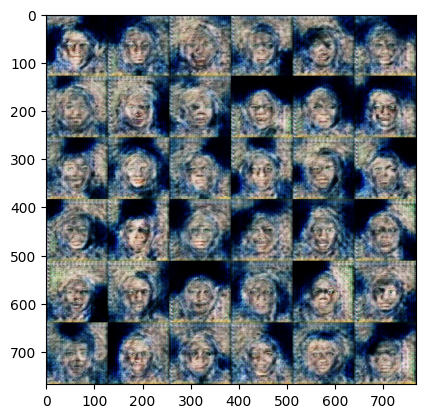

Training Progress:  97%|█████████▋| 14500/15000 [1:17:25<03:47,  2.20step/s]

****************************************************************************************************
1/1 [==============================] - 0s 17ms/step


Training Progress:  97%|█████████▋| 14501/15000 [1:17:25<03:26,  2.42step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  97%|█████████▋| 14502/15000 [1:17:26<03:15,  2.54step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14503/15000 [1:17:26<03:02,  2.72step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  97%|█████████▋| 14504/15000 [1:17:26<02:53,  2.86step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14505/15000 [1:17:26<02:47,  2.96step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14506/15000 [1:17:27<02:41,  3.05step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14507/15000 [1:17:27<02:38,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14508/15000 [1:17:27<02:35,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14509/15000 [1:17:28<02:39,  3.08step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  97%|█████████▋| 14510/15000 [1:17:28<02:37,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14511/15000 [1:17:28<02:34,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14512/15000 [1:17:29<02:38,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  97%|█████████▋| 14513/15000 [1:17:29<02:35,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14514/15000 [1:17:29<02:33,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14515/15000 [1:17:30<02:31,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14516/15000 [1:17:30<02:30,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14517/15000 [1:17:30<02:29,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14518/15000 [1:17:31<02:28,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  97%|█████████▋| 14519/15000 [1:17:31<02:28,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  97%|█████████▋| 14520/15000 [1:17:31<02:28,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14521/15000 [1:17:31<02:32,  3.13step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:  97%|█████████▋| 14522/15000 [1:17:32<02:30,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14523/15000 [1:17:32<02:30,  3.18step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  97%|█████████▋| 14524/15000 [1:17:32<02:34,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14525/15000 [1:17:33<02:31,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14526/15000 [1:17:33<02:28,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14527/15000 [1:17:33<02:27,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14528/15000 [1:17:34<02:26,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  97%|█████████▋| 14529/15000 [1:17:34<02:26,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14530/15000 [1:17:34<02:25,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14531/15000 [1:17:35<02:24,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14532/15000 [1:17:35<02:23,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14533/15000 [1:17:35<02:23,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14534/15000 [1:17:36<02:22,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14535/15000 [1:17:36<02:22,  3.27step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  97%|█████████▋| 14536/15000 [1:17:36<02:22,  3.25step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  97%|█████████▋| 14537/15000 [1:17:36<02:23,  3.22step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  97%|█████████▋| 14538/15000 [1:17:37<02:24,  3.21step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  97%|█████████▋| 14542/15000 [1:17:38<02:21,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14543/15000 [1:17:38<02:20,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14544/15000 [1:17:39<02:19,  3.26step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  97%|█████████▋| 14545/15000 [1:17:39<02:19,  3.26step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  97%|█████████▋| 14546/15000 [1:17:39<02:19,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  97%|█████████▋| 14547/15000 [1:17:40<02:19,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14548/15000 [1:17:40<02:19,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14549/15000 [1:17:40<02:18,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14550/15000 [1:17:40<02:17,  3.27step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14551/15000 [1:17:41<02:17,  3.27step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  97%|█████████▋| 14552/15000 [1:17:41<02:18,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14553/15000 [1:17:41<02:17,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14554/15000 [1:17:42<02:17,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14555/15000 [1:17:42<02:21,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  97%|█████████▋| 14556/15000 [1:17:42<02:20,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  97%|█████████▋| 14557/15000 [1:17:43<02:18,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  97%|█████████▋| 14558/15000 [1:17:43<02:17,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  97%|█████████▋| 14559/15000 [1:17:43<02:16,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14560/15000 [1:17:44<02:16,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14561/15000 [1:17:44<02:15,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14562/15000 [1:17:44<02:14,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14563/15000 [1:17:44<02:14,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14564/15000 [1:17:45<02:13,  3.26step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  97%|█████████▋| 14565/15000 [1:17:45<02:13,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14566/15000 [1:17:45<02:13,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14567/15000 [1:17:46<02:12,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14568/15000 [1:17:46<02:12,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14569/15000 [1:17:46<02:12,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14570/15000 [1:17:47<02:11,  3.27step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14571/15000 [1:17:47<02:15,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14572/15000 [1:17:47<02:14,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14573/15000 [1:17:48<02:12,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  97%|█████████▋| 14574/15000 [1:17:48<02:12,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14575/15000 [1:17:48<02:11,  3.23step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  97%|█████████▋| 14576/15000 [1:17:49<02:25,  2.91step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  97%|█████████▋| 14577/15000 [1:17:49<02:35,  2.72step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  97%|█████████▋| 14578/15000 [1:17:49<02:40,  2.63step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14579/15000 [1:17:50<02:30,  2.80step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  97%|█████████▋| 14580/15000 [1:17:50<02:23,  2.92step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  97%|█████████▋| 14581/15000 [1:17:50<02:19,  3.00step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  97%|█████████▋| 14582/15000 [1:17:51<02:16,  3.07step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  97%|█████████▋| 14583/15000 [1:17:51<02:13,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  97%|█████████▋| 14584/15000 [1:17:51<02:11,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  97%|█████████▋| 14585/15000 [1:17:52<02:15,  3.07step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14586/15000 [1:17:52<02:12,  3.13step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  97%|█████████▋| 14587/15000 [1:17:52<02:12,  3.12step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  97%|█████████▋| 14588/15000 [1:17:53<02:14,  3.07step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14589/15000 [1:17:53<02:11,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  97%|█████████▋| 14590/15000 [1:17:53<02:10,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14591/15000 [1:17:54<02:09,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  97%|█████████▋| 14592/15000 [1:17:54<02:08,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  97%|█████████▋| 14593/15000 [1:17:54<02:08,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  97%|█████████▋| 14594/15000 [1:17:54<02:06,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14595/15000 [1:17:55<02:06,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14596/15000 [1:17:55<02:05,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14597/15000 [1:17:55<02:04,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14598/15000 [1:17:56<02:04,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14599/15000 [1:17:56<02:04,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14600/15000 [1:17:56<02:03,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14601/15000 [1:17:57<02:03,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  97%|█████████▋| 14602/15000 [1:17:57<02:03,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  97%|█████████▋| 14603/15000 [1:17:57<02:03,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  97%|█████████▋| 14604/15000 [1:17:58<02:03,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14605/15000 [1:17:58<02:02,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14606/15000 [1:17:58<02:01,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14607/15000 [1:17:58<02:01,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14608/15000 [1:17:59<02:00,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  97%|█████████▋| 14609/15000 [1:17:59<02:00,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14610/15000 [1:17:59<02:00,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  97%|█████████▋| 14611/15000 [1:18:00<02:00,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  97%|█████████▋| 14612/15000 [1:18:00<02:00,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  97%|█████████▋| 14613/15000 [1:18:00<01:59,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14614/15000 [1:18:01<01:59,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  97%|█████████▋| 14615/15000 [1:18:01<01:58,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14616/15000 [1:18:01<01:58,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14617/15000 [1:18:02<01:58,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14618/15000 [1:18:02<01:57,  3.26step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  97%|█████████▋| 14619/15000 [1:18:02<01:58,  3.21step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  97%|█████████▋| 14620/15000 [1:18:03<02:01,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  97%|█████████▋| 14621/15000 [1:18:03<02:00,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  97%|█████████▋| 14622/15000 [1:18:03<01:58,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14623/15000 [1:18:03<01:57,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  97%|█████████▋| 14624/15000 [1:18:04<01:56,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  98%|█████████▊| 14625/15000 [1:18:04<01:56,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14626/15000 [1:18:04<01:55,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  98%|█████████▊| 14627/15000 [1:18:05<01:55,  3.24step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  98%|█████████▊| 14628/15000 [1:18:05<01:54,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14629/15000 [1:18:05<01:54,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  98%|█████████▊| 14630/15000 [1:18:06<01:54,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  98%|█████████▊| 14631/15000 [1:18:06<01:54,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14632/15000 [1:18:06<01:53,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14633/15000 [1:18:07<01:53,  3.24step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:  98%|█████████▊| 14634/15000 [1:18:07<01:52,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14635/15000 [1:18:07<01:52,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14636/15000 [1:18:07<01:51,  3.27step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:  98%|█████████▊| 14637/15000 [1:18:08<01:54,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14638/15000 [1:18:08<01:53,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14639/15000 [1:18:08<01:52,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14640/15000 [1:18:09<01:51,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14641/15000 [1:18:09<01:51,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14642/15000 [1:18:09<01:50,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14643/15000 [1:18:10<01:50,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14644/15000 [1:18:10<01:49,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14645/15000 [1:18:10<01:49,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14646/15000 [1:18:11<01:53,  3.13step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  98%|█████████▊| 14647/15000 [1:18:11<01:51,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  98%|█████████▊| 14648/15000 [1:18:11<01:51,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  98%|█████████▊| 14649/15000 [1:18:12<01:50,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14650/15000 [1:18:12<01:49,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14651/15000 [1:18:12<01:48,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14652/15000 [1:18:12<01:48,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14653/15000 [1:18:13<01:48,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  98%|█████████▊| 14654/15000 [1:18:13<01:47,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  98%|█████████▊| 14655/15000 [1:18:13<01:46,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14656/15000 [1:18:14<01:46,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14657/15000 [1:18:14<01:45,  3.24step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  98%|█████████▊| 14658/15000 [1:18:14<01:46,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14659/15000 [1:18:15<01:45,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14660/15000 [1:18:15<01:45,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14661/15000 [1:18:15<01:44,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14662/15000 [1:18:16<01:44,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14663/15000 [1:18:16<01:47,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14664/15000 [1:18:16<01:45,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14665/15000 [1:18:17<01:44,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14666/15000 [1:18:17<01:43,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  98%|█████████▊| 14667/15000 [1:18:17<01:44,  3.20step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  98%|█████████▊| 14668/15000 [1:18:17<01:43,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  98%|█████████▊| 14669/15000 [1:18:18<01:43,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14670/15000 [1:18:18<01:42,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  98%|█████████▊| 14671/15000 [1:18:18<01:42,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14672/15000 [1:18:19<01:41,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  98%|█████████▊| 14673/15000 [1:18:19<01:41,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14674/15000 [1:18:19<01:40,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14675/15000 [1:18:20<01:48,  3.01step/s]

1/1 [==============================] - 0s 25ms/step


Training Progress:  98%|█████████▊| 14676/15000 [1:18:20<02:01,  2.67step/s]

1/1 [==============================] - 0s 28ms/step


Training Progress:  98%|█████████▊| 14677/15000 [1:18:21<02:01,  2.67step/s]

1/1 [==============================] - 0s 27ms/step


Training Progress:  98%|█████████▊| 14678/15000 [1:18:21<02:04,  2.58step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  98%|█████████▊| 14679/15000 [1:18:21<01:57,  2.74step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14680/15000 [1:18:22<01:51,  2.87step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  98%|█████████▊| 14681/15000 [1:18:22<01:48,  2.94step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14682/15000 [1:18:22<01:45,  3.01step/s]

1/1 [==============================] - 0s 36ms/step


Training Progress:  98%|█████████▊| 14683/15000 [1:18:23<01:49,  2.90step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14684/15000 [1:18:23<01:45,  2.99step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14685/15000 [1:18:23<01:43,  3.06step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  98%|█████████▊| 14686/15000 [1:18:24<01:44,  3.00step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14687/15000 [1:18:24<01:42,  3.07step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14688/15000 [1:18:24<01:39,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14689/15000 [1:18:24<01:38,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14690/15000 [1:18:25<01:36,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  98%|█████████▊| 14691/15000 [1:18:25<01:36,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  98%|█████████▊| 14692/15000 [1:18:25<01:35,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14693/15000 [1:18:26<01:35,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14694/15000 [1:18:26<01:34,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14695/15000 [1:18:26<01:34,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  98%|█████████▊| 14696/15000 [1:18:27<01:37,  3.12step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  98%|█████████▊| 14697/15000 [1:18:27<01:36,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14698/15000 [1:18:27<01:34,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14699/15000 [1:18:28<01:37,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14700/15000 [1:18:28<01:35,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  98%|█████████▊| 14701/15000 [1:18:28<01:33,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14702/15000 [1:18:29<01:32,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14703/15000 [1:18:29<01:31,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14704/15000 [1:18:29<01:31,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14705/15000 [1:18:29<01:31,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14706/15000 [1:18:30<01:30,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14707/15000 [1:18:30<01:30,  3.25step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  98%|█████████▊| 14708/15000 [1:18:30<01:30,  3.24step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  98%|█████████▊| 14709/15000 [1:18:31<01:29,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14710/15000 [1:18:31<01:29,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14711/15000 [1:18:31<01:29,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14712/15000 [1:18:32<01:28,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  98%|█████████▊| 14713/15000 [1:18:32<01:28,  3.23step/s]

1/1 [==============================] - 0s 37ms/step


Training Progress:  98%|█████████▊| 14714/15000 [1:18:32<01:33,  3.06step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  98%|█████████▊| 14715/15000 [1:18:33<01:32,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14716/15000 [1:18:33<01:30,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14717/15000 [1:18:33<01:30,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14718/15000 [1:18:34<01:28,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14719/15000 [1:18:34<01:27,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  98%|█████████▊| 14720/15000 [1:18:34<01:27,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14721/15000 [1:18:34<01:26,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  98%|█████████▊| 14722/15000 [1:18:35<01:26,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  98%|█████████▊| 14723/15000 [1:18:35<01:26,  3.21step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  98%|█████████▊| 14724/15000 [1:18:35<01:25,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14725/15000 [1:18:36<01:25,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  98%|█████████▊| 14726/15000 [1:18:36<01:24,  3.23step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:  98%|█████████▊| 14727/15000 [1:18:36<01:24,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14728/15000 [1:18:37<01:23,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14729/15000 [1:18:37<01:26,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14730/15000 [1:18:37<01:24,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14731/15000 [1:18:38<01:23,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14732/15000 [1:18:38<01:23,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14733/15000 [1:18:38<01:25,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14734/15000 [1:18:39<01:24,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14735/15000 [1:18:39<01:23,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14736/15000 [1:18:39<01:22,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14737/15000 [1:18:39<01:21,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14738/15000 [1:18:40<01:21,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14739/15000 [1:18:40<01:20,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14740/15000 [1:18:40<01:23,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14741/15000 [1:18:41<01:22,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14742/15000 [1:18:41<01:21,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14743/15000 [1:18:41<01:20,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14744/15000 [1:18:42<01:20,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14745/15000 [1:18:42<01:19,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  98%|█████████▊| 14746/15000 [1:18:42<01:19,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14747/15000 [1:18:43<01:19,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14748/15000 [1:18:43<01:21,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14749/15000 [1:18:43<01:19,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  98%|█████████▊| 14750/15000 [1:18:44<01:20,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14751/15000 [1:18:44<01:18,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14752/15000 [1:18:44<01:20,  3.08step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14753/15000 [1:18:45<01:19,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14754/15000 [1:18:45<01:17,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14755/15000 [1:18:45<01:16,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14756/15000 [1:18:45<01:16,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14757/15000 [1:18:46<01:15,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14758/15000 [1:18:46<01:17,  3.12step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  98%|█████████▊| 14759/15000 [1:18:46<01:19,  3.02step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14760/15000 [1:18:47<01:17,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14761/15000 [1:18:47<01:16,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14762/15000 [1:18:47<01:15,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14763/15000 [1:18:48<01:14,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14764/15000 [1:18:48<01:13,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14765/15000 [1:18:48<01:13,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14766/15000 [1:18:49<01:12,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14767/15000 [1:18:49<01:12,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  98%|█████████▊| 14768/15000 [1:18:49<01:11,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14769/15000 [1:18:50<01:11,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  98%|█████████▊| 14770/15000 [1:18:50<01:11,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14771/15000 [1:18:50<01:11,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14772/15000 [1:18:51<01:10,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14773/15000 [1:18:51<01:10,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  98%|█████████▊| 14774/15000 [1:18:51<01:12,  3.11step/s]

1/1 [==============================] - 0s 27ms/step


Training Progress:  98%|█████████▊| 14775/15000 [1:18:52<01:19,  2.83step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress:  99%|█████████▊| 14776/15000 [1:18:52<01:23,  2.69step/s]

1/1 [==============================] - 0s 23ms/step


Training Progress:  99%|█████████▊| 14777/15000 [1:18:52<01:25,  2.60step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  99%|█████████▊| 14778/15000 [1:18:53<01:20,  2.75step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  99%|█████████▊| 14779/15000 [1:18:53<01:17,  2.87step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  99%|█████████▊| 14780/15000 [1:18:53<01:16,  2.87step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  99%|█████████▊| 14781/15000 [1:18:54<01:14,  2.94step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  99%|█████████▊| 14782/15000 [1:18:54<01:11,  3.03step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  99%|█████████▊| 14783/15000 [1:18:54<01:10,  3.09step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:  99%|█████████▊| 14784/15000 [1:18:55<01:08,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  99%|█████████▊| 14785/15000 [1:18:55<01:07,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  99%|█████████▊| 14786/15000 [1:18:55<01:06,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  99%|█████████▊| 14787/15000 [1:18:56<01:06,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  99%|█████████▊| 14788/15000 [1:18:56<01:05,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  99%|█████████▊| 14789/15000 [1:18:56<01:05,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  99%|█████████▊| 14790/15000 [1:18:57<01:05,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  99%|█████████▊| 14791/15000 [1:18:57<01:07,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  99%|█████████▊| 14792/15000 [1:18:57<01:06,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  99%|█████████▊| 14793/15000 [1:18:58<01:07,  3.05step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  99%|█████████▊| 14794/15000 [1:18:58<01:06,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  99%|█████████▊| 14795/15000 [1:18:58<01:05,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  99%|█████████▊| 14796/15000 [1:18:58<01:04,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  99%|█████████▊| 14797/15000 [1:18:59<01:04,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  99%|█████████▊| 14798/15000 [1:18:59<01:03,  3.19step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  99%|█████████▊| 14799/15000 [1:18:59<01:03,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  99%|█████████▊| 14800/15000 [1:19:00<01:02,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  99%|█████████▊| 14801/15000 [1:19:00<01:03,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  99%|█████████▊| 14802/15000 [1:19:00<01:02,  3.14step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  99%|█████████▊| 14803/15000 [1:19:01<01:01,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  99%|█████████▊| 14804/15000 [1:19:01<01:01,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  99%|█████████▊| 14805/15000 [1:19:01<01:00,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  99%|█████████▊| 14806/15000 [1:19:02<01:00,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  99%|█████████▊| 14807/15000 [1:19:02<01:00,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  99%|█████████▊| 14808/15000 [1:19:02<00:59,  3.21step/s]

1/1 [==============================] - 0s 33ms/step


Training Progress:  99%|█████████▊| 14809/15000 [1:19:03<01:01,  3.11step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  99%|█████████▊| 14810/15000 [1:19:03<01:00,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  99%|█████████▊| 14811/15000 [1:19:03<00:59,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  99%|█████████▊| 14812/15000 [1:19:03<00:58,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  99%|█████████▉| 14813/15000 [1:19:04<00:58,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  99%|█████████▉| 14814/15000 [1:19:04<00:58,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  99%|█████████▉| 14815/15000 [1:19:04<00:57,  3.19step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  99%|█████████▉| 14816/15000 [1:19:05<01:14,  2.47step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  99%|█████████▉| 14817/15000 [1:19:05<01:09,  2.65step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  99%|█████████▉| 14818/15000 [1:19:06<01:05,  2.78step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  99%|█████████▉| 14819/15000 [1:19:06<01:04,  2.80step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  99%|█████████▉| 14820/15000 [1:19:06<01:02,  2.90step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  99%|█████████▉| 14821/15000 [1:19:07<01:00,  2.97step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  99%|█████████▉| 14822/15000 [1:19:07<00:58,  3.02step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  99%|█████████▉| 14823/15000 [1:19:07<00:57,  3.07step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  99%|█████████▉| 14824/15000 [1:19:08<00:56,  3.10step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  99%|█████████▉| 14825/15000 [1:19:08<00:56,  3.08step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  99%|█████████▉| 14826/15000 [1:19:08<00:56,  3.11step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  99%|█████████▉| 14827/15000 [1:19:09<00:57,  3.02step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  99%|█████████▉| 14828/15000 [1:19:09<00:56,  3.06step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  99%|█████████▉| 14829/15000 [1:19:09<00:55,  3.09step/s]

1/1 [==============================] - 0s 24ms/step


Training Progress:  99%|█████████▉| 14830/15000 [1:19:10<00:54,  3.09step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  99%|█████████▉| 14831/15000 [1:19:10<00:54,  3.11step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  99%|█████████▉| 14832/15000 [1:19:10<00:53,  3.12step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  99%|█████████▉| 14833/15000 [1:19:11<00:53,  3.13step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  99%|█████████▉| 14834/15000 [1:19:11<00:53,  3.12step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  99%|█████████▉| 14835/15000 [1:19:11<00:52,  3.13step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  99%|█████████▉| 14836/15000 [1:19:11<00:52,  3.15step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  99%|█████████▉| 14837/15000 [1:19:12<00:51,  3.15step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  99%|█████████▉| 14838/15000 [1:19:12<00:51,  3.15step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  99%|█████████▉| 14839/15000 [1:19:12<00:51,  3.14step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  99%|█████████▉| 14840/15000 [1:19:13<00:50,  3.15step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  99%|█████████▉| 14841/15000 [1:19:13<00:50,  3.16step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  99%|█████████▉| 14842/15000 [1:19:13<00:50,  3.15step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  99%|█████████▉| 14843/15000 [1:19:14<00:50,  3.14step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  99%|█████████▉| 14844/15000 [1:19:14<00:49,  3.14step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  99%|█████████▉| 14845/15000 [1:19:14<00:49,  3.14step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  99%|█████████▉| 14846/15000 [1:19:15<00:48,  3.14step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  99%|█████████▉| 14847/15000 [1:19:15<00:50,  3.04step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  99%|█████████▉| 14848/15000 [1:19:15<00:49,  3.07step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  99%|█████████▉| 14849/15000 [1:19:16<00:48,  3.10step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  99%|█████████▉| 14850/15000 [1:19:16<00:48,  3.11step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  99%|█████████▉| 14851/15000 [1:19:16<00:47,  3.12step/s]

1/1 [==============================] - 0s 22ms/step


Training Progress:  99%|█████████▉| 14852/15000 [1:19:17<00:47,  3.11step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  99%|█████████▉| 14853/15000 [1:19:17<00:47,  3.12step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  99%|█████████▉| 14854/15000 [1:19:17<00:46,  3.14step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  99%|█████████▉| 14855/15000 [1:19:18<00:46,  3.14step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  99%|█████████▉| 14856/15000 [1:19:18<00:45,  3.14step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  99%|█████████▉| 14857/15000 [1:19:18<00:45,  3.14step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  99%|█████████▉| 14858/15000 [1:19:18<00:45,  3.15step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  99%|█████████▉| 14859/15000 [1:19:19<00:44,  3.15step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  99%|█████████▉| 14860/15000 [1:19:19<00:44,  3.15step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  99%|█████████▉| 14861/15000 [1:19:19<00:44,  3.14step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  99%|█████████▉| 14862/15000 [1:19:20<00:43,  3.15step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  99%|█████████▉| 14863/15000 [1:19:20<00:43,  3.15step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  99%|█████████▉| 14864/15000 [1:19:20<00:44,  3.05step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  99%|█████████▉| 14865/15000 [1:19:21<00:43,  3.08step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  99%|█████████▉| 14866/15000 [1:19:21<00:43,  3.10step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  99%|█████████▉| 14867/15000 [1:19:21<00:42,  3.11step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  99%|█████████▉| 14868/15000 [1:19:22<00:42,  3.13step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  99%|█████████▉| 14869/15000 [1:19:22<00:41,  3.12step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  99%|█████████▉| 14870/15000 [1:19:22<00:42,  3.09step/s]

1/1 [==============================] - 0s 33ms/step


Training Progress:  99%|█████████▉| 14871/15000 [1:19:23<00:42,  3.00step/s]

1/1 [==============================] - 0s 32ms/step


Training Progress:  99%|█████████▉| 14872/15000 [1:19:23<00:46,  2.76step/s]

1/1 [==============================] - 0s 28ms/step


Training Progress:  99%|█████████▉| 14873/15000 [1:19:24<00:49,  2.57step/s]

1/1 [==============================] - 0s 29ms/step


Training Progress:  99%|█████████▉| 14874/15000 [1:19:24<00:48,  2.60step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  99%|█████████▉| 14875/15000 [1:19:24<00:45,  2.75step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  99%|█████████▉| 14876/15000 [1:19:25<00:43,  2.86step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  99%|█████████▉| 14877/15000 [1:19:25<00:41,  2.95step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  99%|█████████▉| 14878/15000 [1:19:25<00:41,  2.93step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  99%|█████████▉| 14879/15000 [1:19:26<00:40,  2.98step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  99%|█████████▉| 14880/15000 [1:19:26<00:39,  3.03step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  99%|█████████▉| 14881/15000 [1:19:26<00:38,  3.07step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  99%|█████████▉| 14882/15000 [1:19:27<00:38,  3.10step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  99%|█████████▉| 14883/15000 [1:19:27<00:37,  3.12step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  99%|█████████▉| 14884/15000 [1:19:27<00:36,  3.14step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  99%|█████████▉| 14885/15000 [1:19:27<00:36,  3.16step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  99%|█████████▉| 14886/15000 [1:19:28<00:36,  3.17step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress:  99%|█████████▉| 14887/15000 [1:19:28<00:35,  3.17step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  99%|█████████▉| 14888/15000 [1:19:28<00:35,  3.15step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  99%|█████████▉| 14889/15000 [1:19:29<00:36,  3.06step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  99%|█████████▉| 14890/15000 [1:19:29<00:36,  3.00step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  99%|█████████▉| 14891/15000 [1:19:29<00:35,  3.05step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  99%|█████████▉| 14892/15000 [1:19:30<00:34,  3.09step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  99%|█████████▉| 14893/15000 [1:19:30<00:34,  3.12step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  99%|█████████▉| 14894/15000 [1:19:30<00:33,  3.14step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  99%|█████████▉| 14895/15000 [1:19:31<00:33,  3.16step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  99%|█████████▉| 14896/15000 [1:19:31<00:32,  3.17step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  99%|█████████▉| 14897/15000 [1:19:31<00:32,  3.16step/s]

1/1 [==============================] - 0s 21ms/step


Training Progress:  99%|█████████▉| 14898/15000 [1:19:32<00:32,  3.16step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  99%|█████████▉| 14899/15000 [1:19:32<00:31,  3.17step/s]

1/1 [==============================] - 0s 27ms/step


Training Progress:  99%|█████████▉| 14900/15000 [1:19:32<00:33,  3.00step/s]

1/1 [==============================] - 0s 23ms/step


Training Progress:  99%|█████████▉| 14901/15000 [1:19:33<00:32,  3.03step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  99%|█████████▉| 14902/15000 [1:19:33<00:31,  3.08step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  99%|█████████▉| 14903/15000 [1:19:33<00:31,  3.11step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  99%|█████████▉| 14904/15000 [1:19:34<00:30,  3.13step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  99%|█████████▉| 14905/15000 [1:19:34<00:30,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  99%|█████████▉| 14906/15000 [1:19:34<00:29,  3.16step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  99%|█████████▉| 14907/15000 [1:19:35<00:29,  3.18step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  99%|█████████▉| 14908/15000 [1:19:35<00:28,  3.18step/s]

1/1 [==============================] - 0s 19ms/step


Training Progress:  99%|█████████▉| 14909/15000 [1:19:35<00:28,  3.18step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  99%|█████████▉| 14910/15000 [1:19:35<00:28,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  99%|█████████▉| 14911/15000 [1:19:36<00:27,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  99%|█████████▉| 14912/15000 [1:19:36<00:27,  3.21step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  99%|█████████▉| 14913/15000 [1:19:36<00:27,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  99%|█████████▉| 14914/15000 [1:19:37<00:26,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  99%|█████████▉| 14915/15000 [1:19:37<00:26,  3.23step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress:  99%|█████████▉| 14916/15000 [1:19:37<00:27,  3.09step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  99%|█████████▉| 14917/15000 [1:19:38<00:26,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  99%|█████████▉| 14918/15000 [1:19:38<00:26,  3.15step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  99%|█████████▉| 14919/15000 [1:19:38<00:25,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress:  99%|█████████▉| 14920/15000 [1:19:39<00:25,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  99%|█████████▉| 14921/15000 [1:19:39<00:24,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  99%|█████████▉| 14922/15000 [1:19:39<00:24,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress:  99%|█████████▉| 14923/15000 [1:19:40<00:23,  3.23step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress:  99%|█████████▉| 14924/15000 [1:19:40<00:23,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress: 100%|█████████▉| 14925/15000 [1:19:40<00:23,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress: 100%|█████████▉| 14926/15000 [1:19:40<00:23,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress: 100%|█████████▉| 14927/15000 [1:19:41<00:23,  3.16step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress: 100%|█████████▉| 14928/15000 [1:19:41<00:22,  3.19step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress: 100%|█████████▉| 14929/15000 [1:19:41<00:22,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress: 100%|█████████▉| 14930/15000 [1:19:42<00:22,  3.09step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress: 100%|█████████▉| 14931/15000 [1:19:42<00:22,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress: 100%|█████████▉| 14932/15000 [1:19:42<00:22,  3.04step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress: 100%|█████████▉| 14933/15000 [1:19:43<00:21,  3.10step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress: 100%|█████████▉| 14934/15000 [1:19:43<00:21,  3.13step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress: 100%|█████████▉| 14935/15000 [1:19:43<00:20,  3.15step/s]

1/1 [==============================] - 0s 20ms/step


Training Progress: 100%|█████████▉| 14936/15000 [1:19:44<00:20,  3.18step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress: 100%|█████████▉| 14937/15000 [1:19:44<00:19,  3.20step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress: 100%|█████████▉| 14938/15000 [1:19:44<00:19,  3.22step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress: 100%|█████████▉| 14939/15000 [1:19:45<00:18,  3.24step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress: 100%|█████████▉| 14940/15000 [1:19:45<00:18,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress: 100%|█████████▉| 14941/15000 [1:19:45<00:18,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress: 100%|█████████▉| 14942/15000 [1:19:46<00:17,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress: 100%|█████████▉| 14943/15000 [1:19:46<00:17,  3.22step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress: 100%|█████████▉| 14944/15000 [1:19:46<00:17,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress: 100%|█████████▉| 14945/15000 [1:19:46<00:17,  3.12step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress: 100%|█████████▉| 14946/15000 [1:19:47<00:17,  3.15step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress: 100%|█████████▉| 14947/15000 [1:19:47<00:16,  3.18step/s]

1/1 [==============================] - 0s 18ms/step


Training Progress: 100%|█████████▉| 14948/15000 [1:19:47<00:16,  3.20step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress: 100%|█████████▉| 14949/15000 [1:19:48<00:15,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress: 100%|█████████▉| 14950/15000 [1:19:48<00:15,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress: 100%|█████████▉| 14951/15000 [1:19:48<00:15,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress: 100%|█████████▉| 14952/15000 [1:19:49<00:14,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress: 100%|█████████▉| 14953/15000 [1:19:49<00:14,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress: 100%|█████████▉| 14954/15000 [1:19:49<00:14,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress: 100%|█████████▉| 14955/15000 [1:19:50<00:13,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress: 100%|█████████▉| 14956/15000 [1:19:50<00:13,  3.24step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress: 100%|█████████▉| 14957/15000 [1:19:50<00:13,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress: 100%|█████████▉| 14958/15000 [1:19:50<00:12,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress: 100%|█████████▉| 14959/15000 [1:19:51<00:12,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress: 100%|█████████▉| 14960/15000 [1:19:51<00:12,  3.26step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress: 100%|█████████▉| 14961/15000 [1:19:51<00:11,  3.26step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress: 100%|█████████▉| 14962/15000 [1:19:52<00:11,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress: 100%|█████████▉| 14963/15000 [1:19:52<00:11,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress: 100%|█████████▉| 14964/15000 [1:19:52<00:11,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress: 100%|█████████▉| 14965/15000 [1:19:53<00:10,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress: 100%|█████████▉| 14966/15000 [1:19:53<00:10,  3.22step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress: 100%|█████████▉| 14967/15000 [1:19:53<00:10,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress: 100%|█████████▉| 14968/15000 [1:19:54<00:09,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress: 100%|█████████▉| 14969/15000 [1:19:54<00:09,  3.24step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress: 100%|█████████▉| 14970/15000 [1:19:54<00:10,  2.84step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress: 100%|█████████▉| 14971/15000 [1:19:55<00:11,  2.61step/s]

1/1 [==============================] - 0s 26ms/step


Training Progress: 100%|█████████▉| 14972/15000 [1:19:55<00:11,  2.54step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress: 100%|█████████▉| 14973/15000 [1:19:56<00:09,  2.72step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress: 100%|█████████▉| 14974/15000 [1:19:56<00:09,  2.86step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress: 100%|█████████▉| 14975/15000 [1:19:56<00:08,  2.96step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress: 100%|█████████▉| 14976/15000 [1:19:56<00:07,  3.04step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress: 100%|█████████▉| 14977/15000 [1:19:57<00:07,  3.10step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress: 100%|█████████▉| 14978/15000 [1:19:57<00:06,  3.14step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress: 100%|█████████▉| 14979/15000 [1:19:57<00:06,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress: 100%|█████████▉| 14980/15000 [1:19:58<00:06,  3.17step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress: 100%|█████████▉| 14981/15000 [1:19:58<00:05,  3.19step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress: 100%|█████████▉| 14982/15000 [1:19:58<00:05,  3.21step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress: 100%|█████████▉| 14983/15000 [1:19:59<00:05,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress: 100%|█████████▉| 14984/15000 [1:19:59<00:04,  3.23step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress: 100%|█████████▉| 14985/15000 [1:19:59<00:04,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress: 100%|█████████▉| 14986/15000 [1:20:00<00:04,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress: 100%|█████████▉| 14987/15000 [1:20:00<00:04,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress: 100%|█████████▉| 14988/15000 [1:20:00<00:03,  3.25step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress: 100%|█████████▉| 14989/15000 [1:20:00<00:03,  3.25step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress: 100%|█████████▉| 14990/15000 [1:20:01<00:03,  3.23step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress: 100%|█████████▉| 14991/15000 [1:20:01<00:02,  3.24step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress: 100%|█████████▉| 14992/15000 [1:20:01<00:02,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress: 100%|█████████▉| 14993/15000 [1:20:02<00:02,  3.07step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress: 100%|█████████▉| 14994/15000 [1:20:02<00:01,  3.12step/s]

1/1 [==============================] - 0s 17ms/step


Training Progress: 100%|█████████▉| 14995/15000 [1:20:02<00:01,  3.13step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress: 100%|█████████▉| 14996/15000 [1:20:03<00:01,  3.17step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress: 100%|█████████▉| 14997/15000 [1:20:03<00:00,  3.20step/s]

1/1 [==============================] - 0s 15ms/step


Training Progress: 100%|█████████▉| 14998/15000 [1:20:03<00:00,  3.22step/s]

1/1 [==============================] - 0s 16ms/step


Training Progress: 100%|█████████▉| 14999/15000 [1:20:04<00:00,  3.21step/s]

1/1 [==============================] - 0s 17ms/step
****************************************************************************************************
15000/15000: d_loss: 0.138201,  g_loss: 0.004873
2/2 [==============================] - 0s 20ms/step


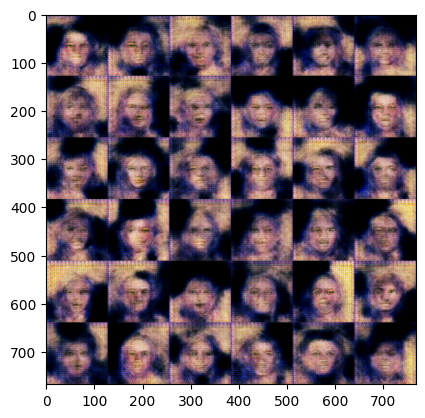

Training Progress: 100%|██████████| 15000/15000 [1:20:04<00:00,  3.12step/s]

****************************************************************************************************


In [15]:
for step in tqdm(range(iters), desc='Training Progress', unit='step'):
    latent_vectors = np.random.normal(size=(batch_size, LATENT_DIM))
    generated = generator.predict(latent_vectors)
    
    
    real = images[start:start + batch_size]

    combined_images = np.concatenate([generated, real])
    
    labels_real = np.zeros((batch_size, 1)) + 0.05 * np.random.random((batch_size, 1))  # Label Smoothing
    labels_fake = np.ones((batch_size, 1)) - 0.05 * np.random.random((batch_size, 1))   # Label Smoothing
    
    labels = np.concatenate([labels_fake, labels_real])
    
    d_loss = discriminator.train_on_batch(combined_images, labels)
    d_losses.append(d_loss)

    latent_vectors = np.random.normal(size=(batch_size, LATENT_DIM))
    misleading_targets = np.zeros((batch_size, 1))

    a_loss = gan.train_on_batch(latent_vectors, misleading_targets)
    a_losses.append(a_loss)

    start += batch_size
    if start > images.shape[0] - batch_size:
        start = 0

    if step % 500 == 499:  # Change from 50 to 500 for image display frequency
        print('*' * 100)
        print('%d/%d: d_loss: %.6f,  g_loss: %.6f' % (step + 1, iters, d_loss, a_loss))
        
        control_image = np.zeros((WIDTH * CONTROL_SIZE_SQRT, HEIGHT * CONTROL_SIZE_SQRT, CHANNELS))
        control_generated = generator.predict(control_vectors)

        for i in range(CONTROL_SIZE_SQRT ** 2):
            x_off = i % CONTROL_SIZE_SQRT
            y_off = i // CONTROL_SIZE_SQRT
            control_image[x_off * WIDTH:(x_off + 1) * WIDTH, y_off * HEIGHT:(y_off + 1) * HEIGHT, :] = control_generated[i, :, :, :]
        im = Img.fromarray(np.uint8((control_image*127.5) + 127.5))
        plt.imshow(im)
        plt.show()
        print('*' * 100)

        # Optionally save images if required
        # im.save(FILE_PATH % (RES_DIR, images_saved))
        # images_saved += 1

# Save the final weights after exiting the loop to ensure only the last version is stored
gan.save_weights('/kaggle/working/gan_final.h5')


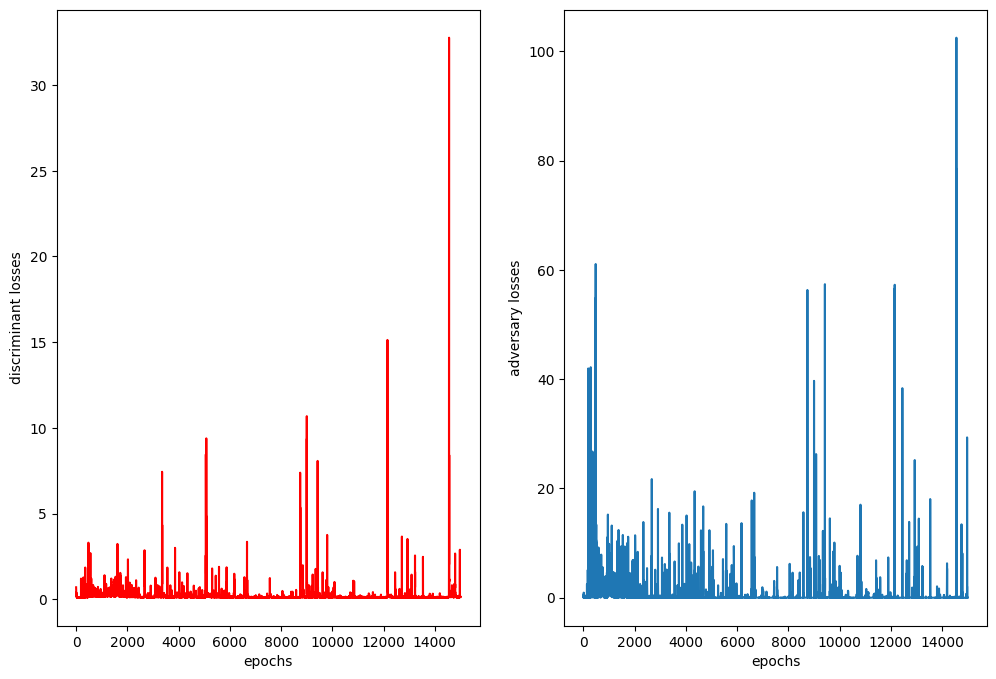

In [16]:
plt.figure(1, figsize=(12, 8))
plt.subplot(121)
plt.plot(d_losses, color='red')
plt.xlabel('epochs')
plt.ylabel('discriminant losses')
plt.subplot(122)
plt.plot(a_losses)
plt.xlabel('epochs')
plt.ylabel('adversary losses')
plt.show()

In [18]:
gan.save_weights('/kaggle/working/gan_simple_final.h5')

1/1 [==============================] - 0s 169ms/step


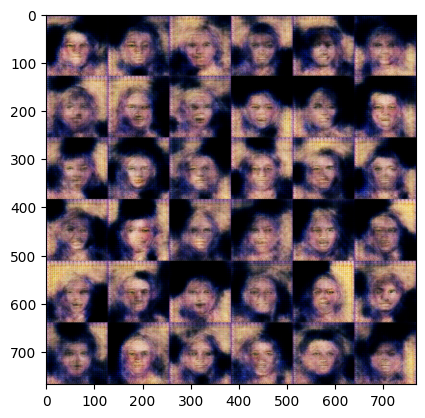

In [19]:
control_image = np.zeros((WIDTH * CONTROL_SIZE_SQRT, HEIGHT * CONTROL_SIZE_SQRT, CHANNELS))
# plt.imshow(np.uint8((control_image*127.5) + 127.5))
# plt.show()
control_generated = generator.predict(control_vectors, batch_size=36)

for i in range(CONTROL_SIZE_SQRT ** 2):
    x_off = i % CONTROL_SIZE_SQRT
    y_off = i // CONTROL_SIZE_SQRT
    control_image[x_off * WIDTH:(x_off + 1) * WIDTH, y_off * HEIGHT:(y_off + 1) * HEIGHT, :] = control_generated[i, :, :, :]
im = Img.fromarray(np.uint8((control_image*127.5) + 127.5))
plt.imshow(im)
plt.show()
im.save('final_test.png')
images_saved += 1

In [20]:
for i in sorted(a_losses)[:25]:
    print(i, a_losses.index(i))

0.0 14555
1.200643142302759e-24 5093
7.750884792884585e-22 5095
1.7970625469745823e-19 5094
1.1393424457085955e-17 12148
8.23379353678877e-17 12157
2.0952553737395155e-16 5088
1.3093185423937535e-15 12166
1.4668757761872363e-15 5096
1.6459996334881161e-15 12158
5.83963233265249e-15 12168
2.7987727017680583e-14 12167
3.0218760978771575e-14 5068
2.72663700428763e-13 5083
3.548504534916369e-13 14553
9.335000220739298e-13 5309
1.584931513289034e-12 5098
2.7983609353354755e-12 12152
8.117812845542804e-12 12165
1.3382727218069768e-11 20
1.728661484790006e-11 12169
1.765884487248126e-11 5089
2.126933351664917e-11 21
2.3624008999023616e-11 12164
3.0745007234544985e-11 9006


1/1 [==============================] - 0s 30ms/step


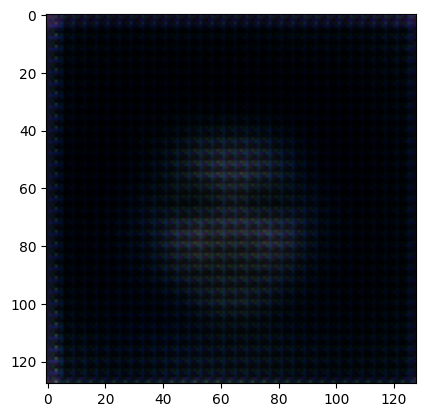

1/1 [==============================] - 0s 17ms/step


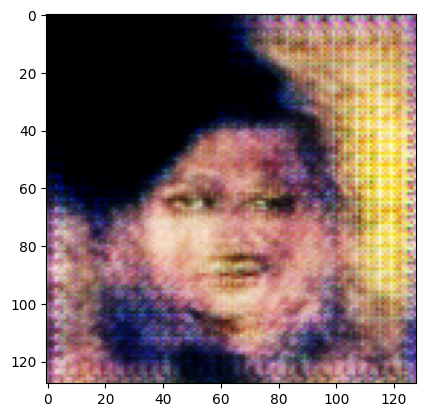

In [21]:
latent_vectors = np.zeros((1, LATENT_DIM))
generated = generator.predict(latent_vectors)

plt.imshow(np.uint8((generated*127.5) + 127.5).reshape(128, 128, 3))
plt.show()

latent_vectors = np.ones((1, LATENT_DIM))
generated = generator.predict(latent_vectors)

plt.imshow(np.uint8((generated*127.5) + 127.5).reshape(128, 128, 3))
plt.show()

1/1 [==============================] - 0s 189ms/step
0.98369133


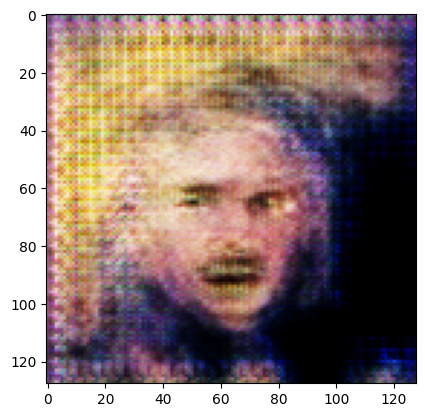

In [22]:
latent_vectors = np.random.normal(size=(1, LATENT_DIM))
generated = generator.predict(latent_vectors)
disc_acc = gan.predict(latent_vectors)
print(disc_acc[0][0])
plt.imshow(np.uint8((generated*127.5) + 127.5).reshape(128, 128, 3))
plt.show()

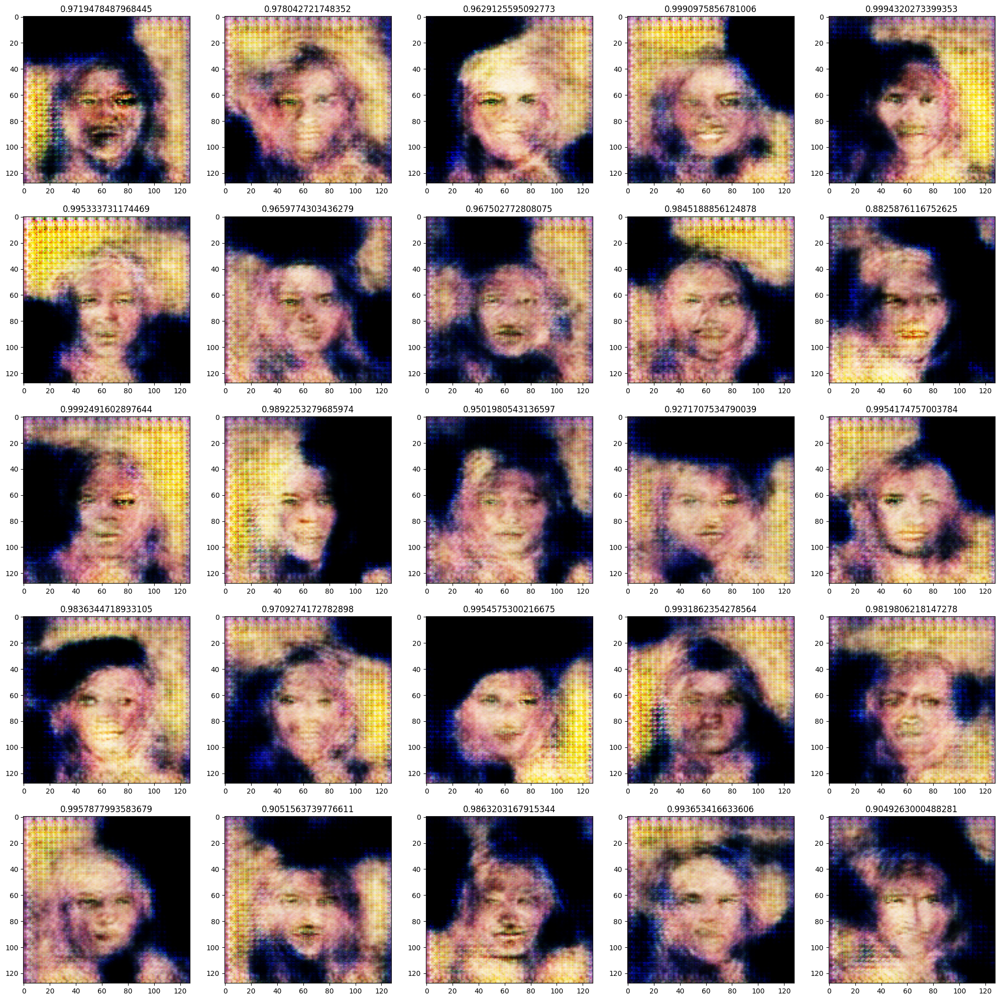

In [23]:
plt.figure(1, figsize=(25, 25))
for i in range(25):
    plt.subplot(5, 5, i+1)
    latent_vectors = np.random.normal(size=(1, LATENT_DIM))
    generated = generator.predict(latent_vectors, verbose=0)
    disc_acc = gan.predict(latent_vectors, verbose=0)
    plt.imshow(np.uint8((generated*127.5) + 127.5).reshape(128, 128, 3))
    plt.title(f'{disc_acc[0][0]}')
plt.show()